In [29]:
import sys
sys.path.insert(0, '../..')
import copy
import numpy as np
from model.base import CovidModel, SimulationParameters, set_parameters, normal_ci
from utils import BasicStatistics, RemovePolicy, Propaganda, setup_city_layout, AddPolicyInfectedRate, confidence_interval, multiple_runs
from model.utils import SocialPolicy

In [30]:
listeners = [
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_ELEMENTARY_SCHOOL,0.025 ,1],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_MIDDLE_SCHOOL, 0.025 ,1],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_HIGH_SCHOOL, 0.025 ,1],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_RETAIL,0.025 ,1],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_FACTORY, 0.025 ,1],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_OFFICE, 0.025 ,1],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_ELEMENTARY_SCHOOL, 0.025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_MIDDLE_SCHOOL, 0.025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_HIGH_SCHOOL,0.025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_RETAIL, 0.025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_FACTORY, 0.025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_OFFICE,0.025 ,21]
]

In [31]:
common_parameters = SimulationParameters(
    mask_user_rate = 0.9, # 0.0,
    mask_efficacy = 0.6, #0.0,
    imune_rate = 0.01,
    initial_infection_rate = 0.01,
    hospitalization_capacity = 0.05,
    latency_period_shape = 3,
    latency_period_scale = 1, 
    incubation_period_shape = 6,
    incubation_period_scale = 1, 
    mild_period_duration_shape = 14,
    mild_period_duration_scale = 1,
    hospitalization_period_duration_shape = 12,
    hospitalization_period_duration_scale = 1,
    symptomatic_isolation_rate = 0.0,
    asymptomatic_contagion_probability = 0.1,
#    asymptomatic_contagion_probability = 0.05,
    risk_tolerance_mean = 0.7,
    risk_tolerance_stdev = 0.2,
    #herding_behavior_mean = 0.7,
    herding_behavior_mean = 0.7,
    herding_behavior_stdev = 0.2,
    allowed_restaurant_capacity = 0.25, #1.0, # valid values: {1.0, 0.50, 0.25}
    spreading_rate = normal_ci(2.41, 3.90, 20),
#    spreading_rate = normal_ci(0.5, 1.5, 20)
    restaurant_count_per_work_district = 40 #100
)

sc = 10

population_size = 1000
simulation_cycles = 360 # days
seed = 31415
np.random.seed(seed)

params = copy.deepcopy(common_parameters)

Save these seeds if you want to rerun a scenario
[354, 7083, 3238, 1060, 7333, 2617, 4635, 9370, 974, 1874, 4563, 2496, 209, 7533, 1648, 1585, 156, 3417, 8747, 1830]
log initialized
Average similarity between family members is 0.9663331239154241 at temperature -1
Average similarity between family and home is 0.9998474068619443 at temperature -1
Average similarity between students and their classroom is 0.7587951487505925 at temperature -1
Average classroom occupancy is 4.461538461538462 and number classrooms is 65
Average similarity between workers is 0.9732395564922565 at temperature -1
Average office occupancy is 3.4479166666666665 and number offices is 192
Average friend similarity for adults: 0.8522119948878346 for kids: 0.7141758178144929
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Build

avg restaurant similarity 0.6549601306877565
avg restaurant similarity 0.6377369101450833
avg restaurant similarity 0.6875577250760161
avg restaurant similarity 0.6690716123244167
avg restaurant similarity 0.6577548266011666
avg restaurant similarity 0.6695473178691183
avg restaurant similarity 0.6903769379541627
avg restaurant similarity 0.6478416635898127
avg restaurant similarity 0.6712794494103776
avg restaurant similarity 0.6801488754611441
avg restaurant similarity 0.6701608066599054
avg restaurant similarity 0.658701108472706
avg restaurant similarity 0.6423525674759782
avg restaurant similarity 0.7013209032327699
avg restaurant similarity 0.6370268276124953
avg restaurant similarity 0.6787241247818694
avg restaurant similarity 0.7113103216390796
avg restaurant similarity 0.6473743972003972
avg restaurant similarity 0.656011740915589
avg restaurant similarity 0.6368278040412221
avg restaurant similarity 0.6661104615159207
avg restaurant similarity 0.6272211184629843
avg restaura

avg restaurant similarity 0.647391204046959
avg restaurant similarity 0.6600081999581598
avg restaurant similarity 0.6796621284347013
avg restaurant similarity 0.6576880645296196
avg restaurant similarity 0.728249998512275
avg restaurant similarity 0.6547126179518734
avg restaurant similarity 0.6803396623580705
avg restaurant similarity 0.6442595885576095
avg restaurant similarity 0.6878565095139203
avg restaurant similarity 0.681956335157279
avg restaurant similarity 0.6514412204199318
avg restaurant similarity 0.6417874136001637
avg restaurant similarity 0.6448639910133102
avg restaurant similarity 0.6615530255161437
avg restaurant similarity 0.6373542660825919
avg restaurant similarity 0.636240162803483
avg restaurant similarity 0.6164545883057113
avg restaurant similarity 0.6518336073186394
avg restaurant similarity 0.6510837294230353
avg restaurant similarity 0.6587126507980335
avg restaurant similarity 0.6404902287548969
avg restaurant similarity 0.6803576986549167
avg restaurant

avg restaurant similarity 0.6444693508287676
avg restaurant similarity 0.6652446234330615
avg restaurant similarity 0.6417598166566042
avg restaurant similarity 0.6548368833971129
avg restaurant similarity 0.6580616945263948
avg restaurant similarity 0.6460569305073516
avg restaurant similarity 0.64763174951489
avg restaurant similarity 0.673558055644276
avg restaurant similarity 0.6670390371253816
avg restaurant similarity 0.6422054338230604
avg restaurant similarity 0.7009491747154085
avg restaurant similarity 0.6684949369849372
avg restaurant similarity 0.6656636849376572
avg restaurant similarity 0.6525723856685434
avg restaurant similarity 0.6916405054930833
avg restaurant similarity 0.6962947726061978
avg restaurant similarity 0.6446919544031617
avg restaurant similarity 0.646491287334596
avg restaurant similarity 0.6587981520827451
avg restaurant similarity 0.603358993252303
avg restaurant similarity 0.602850292961001
avg restaurant similarity 0.6693204895762698
avg restaurant s

avg restaurant similarity 0.64201910384509
avg restaurant similarity 0.6962337321231598
avg restaurant similarity 0.657583250174679
avg restaurant similarity 0.7178677795086643
avg restaurant similarity 0.657181858232255
avg restaurant similarity 0.6600760696019341
avg restaurant similarity 0.6441086048802178
avg restaurant similarity 0.6639134111343667
avg restaurant similarity 0.6533805259990734
avg restaurant similarity 0.6558009465647759
avg restaurant similarity 0.6754702706775929
avg restaurant similarity 0.6895128947240124
avg restaurant similarity 0.6339432100192592
avg restaurant similarity 0.6826881961382305
avg restaurant similarity 0.6182959917330706
avg restaurant similarity 0.6879492006727226
avg restaurant similarity 0.7010220551039564
avg restaurant similarity 0.662182679320545
avg restaurant similarity 0.6221732736373442
avg restaurant similarity 0.6730132972297491
avg restaurant similarity 0.6714280619443287
avg restaurant similarity 0.6269223297590127
avg restaurant 

avg restaurant similarity 0.623296600590726
avg restaurant similarity 0.6597667026296818
avg restaurant similarity 0.6804822340044414
avg restaurant similarity 0.602421764107878
avg restaurant similarity 0.6437101951287171
avg restaurant similarity 0.687466369106948
avg restaurant similarity 0.6821001555722672
avg restaurant similarity 0.6690399409112496
avg restaurant similarity 0.632312880346452
avg restaurant similarity 0.6244236412894698
avg restaurant similarity 0.5727547299612089
avg restaurant similarity 0.6780182517311152
avg restaurant similarity 0.6733244367333568
avg restaurant similarity 0.6689320820064548
avg restaurant similarity 0.6689779155810058
avg restaurant similarity 0.6329151335782347
avg restaurant similarity 0.6445661576795457
avg restaurant similarity 0.6529274061708401
avg restaurant similarity 0.6473610834737623
avg restaurant similarity 0.6528405530870708
avg restaurant similarity 0.6078637457615996
avg restaurant similarity 0.6135513412438139
avg restaurant

avg restaurant similarity 0.6675189101219836
avg restaurant similarity 0.6475186014829595
avg restaurant similarity 0.6691049428472858
avg restaurant similarity 0.6630767179130727
avg restaurant similarity 0.6538683553833141
avg restaurant similarity 0.6011972925794253
avg restaurant similarity 0.6091274680377887
avg restaurant similarity 0.6110500033934009
avg restaurant similarity 0.6091893607697643
avg restaurant similarity 0.6520158023495881
avg restaurant similarity 0.5914546573817517
avg restaurant similarity 0.6628566995705649
avg restaurant similarity 0.6851130599375153
avg restaurant similarity 0.5868732665821857
avg restaurant similarity 0.6307553417748418
avg restaurant similarity 0.6345717271095124
avg restaurant similarity 0.6455679218560564
avg restaurant similarity 0.6138455513163458
avg restaurant similarity 0.6630966322275321
avg restaurant similarity 0.7234847187788525
avg restaurant similarity 0.6748309739050279
avg restaurant similarity 0.6809889695251435
avg restau

avg restaurant similarity 0.7605735186533641
avg restaurant similarity 0.6744541193573073
avg restaurant similarity 0.7010330210220166
avg restaurant similarity 0.7178205145799793
avg restaurant similarity 0.7012168326709065
avg restaurant similarity 0.6570047309135276
avg restaurant similarity 0.6955333092375376
avg restaurant similarity 0.7546798477031655
avg restaurant similarity 0.7128716303025014
avg restaurant similarity 0.7089014484984179
avg restaurant similarity 0.7724082400158632
avg restaurant similarity 0.7268342383836992
avg restaurant similarity 0.6816355537531985
avg restaurant similarity 0.7011739512628765
avg restaurant similarity 0.7185933009604314
avg restaurant similarity 0.6787684352421511
avg restaurant similarity 0.7126842160291171
avg restaurant similarity 0.687416377450801
avg restaurant similarity 0.6376858361726699
avg restaurant similarity 0.6391648120415789
avg restaurant similarity 0.6358986593422961
avg restaurant similarity 0.6829593125240152
avg restaur

avg restaurant similarity 0.7176865391528368
avg restaurant similarity 0.686651849466582
avg restaurant similarity 0.7445075697977549
avg restaurant similarity 0.7250568917059451
avg restaurant similarity 0.719075800449209
avg restaurant similarity 0.7605191728701649
avg restaurant similarity 0.7485137243759472
avg restaurant similarity 0.7002900596346182
avg restaurant similarity 0.6903980110076229
avg restaurant similarity 0.7283142136791242
avg restaurant similarity 0.721707438641397
avg restaurant similarity 0.7860164816928384
avg restaurant similarity 0.6953045999688822
avg restaurant similarity 0.6701066871280893
avg restaurant similarity 0.6861422680424132
avg restaurant similarity 0.6852831319365942
avg restaurant similarity 0.6753874139163679
avg restaurant similarity 0.7156635944128674
avg restaurant similarity 0.6154565535055762
avg restaurant similarity 0.7177932787476292
avg restaurant similarity 0.7399926626116519
avg restaurant similarity 0.677887248357236
avg restaurant

avg restaurant similarity 0.6400269986540905
avg restaurant similarity 0.624719972459443
avg restaurant similarity 0.626857837180898
avg restaurant similarity 0.6875976788220061
avg restaurant similarity 0.7085717758432055
avg restaurant similarity 0.6845761164816286
avg restaurant similarity 0.6698879788804608
avg restaurant similarity 0.691544115320451
avg restaurant similarity 0.7248164476815012
avg restaurant similarity 0.6781000815722373
avg restaurant similarity 0.6734605457268853
avg restaurant similarity 0.6575251049099663
avg restaurant similarity 0.7291535160404171
avg restaurant similarity 0.6587496088411406
avg restaurant similarity 0.7107883365475567
avg restaurant similarity 0.6792340352215508
avg restaurant similarity 0.6510175045409484
avg restaurant similarity 0.6590159174047263
avg restaurant similarity 0.6462423062634538
avg restaurant similarity 0.6480146653818799
avg restaurant similarity 0.6836183632523983
avg restaurant similarity 0.6585807457482193
avg restauran

avg restaurant similarity 0.6471014514768952
avg restaurant similarity 0.6936102627595858
avg restaurant similarity 0.6456146729477193
avg restaurant similarity 0.6868747885288142
avg restaurant similarity 0.6711960823454048
avg restaurant similarity 0.6745036311532655
avg restaurant similarity 0.7428175240042336
avg restaurant similarity 0.6617540222280979
avg restaurant similarity 0.6416571479450826
avg restaurant similarity 0.7024490662092502
avg restaurant similarity 0.6360414183014871
avg restaurant similarity 0.6345727090309272
avg restaurant similarity 0.6664300273898405
avg restaurant similarity 0.6074343847708988
avg restaurant similarity 0.6261756821071054
avg restaurant similarity 0.6590100956705667
avg restaurant similarity 0.6377957089347647
avg restaurant similarity 0.7158535468657828
avg restaurant similarity 0.6389348031048967
avg restaurant similarity 0.650302929979731
avg restaurant similarity 0.6501421295540044
avg restaurant similarity 0.6738251228091487
avg restaur

avg restaurant similarity 0.706531942554468
avg restaurant similarity 0.6864282337879559
avg restaurant similarity 0.6854989190910297
avg restaurant similarity 0.7387793284102554
avg restaurant similarity 0.7366324524700544
avg restaurant similarity 0.7247608812263994
avg restaurant similarity 0.6923248346156049
avg restaurant similarity 0.7135357680555752
avg restaurant similarity 0.701348527732979
avg restaurant similarity 0.7474575553372645
avg restaurant similarity 0.7468499761727578
avg restaurant similarity 0.7341666493296048
avg restaurant similarity 0.6720134301741678
avg restaurant similarity 0.7024376976550447
avg restaurant similarity 0.7187936371936441
avg restaurant similarity 0.7151261883272431
avg restaurant similarity 0.7196221786352989
avg restaurant similarity 0.6981743737082415
avg restaurant similarity 0.6683567632637138
avg restaurant similarity 0.7015544729270587
avg restaurant similarity 0.6888351227229279
avg restaurant similarity 0.6873451857027758
avg restaura

avg restaurant similarity 0.655714257041106
avg restaurant similarity 0.7294816462973249
avg restaurant similarity 0.7121006610836538
avg restaurant similarity 0.7133671944939081
avg restaurant similarity 0.6511972841341631
avg restaurant similarity 0.7152166308973368
avg restaurant similarity 0.6794938543102793
avg restaurant similarity 0.7164373107335613
avg restaurant similarity 0.6778499655638531
avg restaurant similarity 0.6747346922932146
avg restaurant similarity 0.7053635414040271
avg restaurant similarity 0.6924063163742221
avg restaurant similarity 0.6769981755289117
avg restaurant similarity 0.680781811981732
avg restaurant similarity 0.6946345432466907
avg restaurant similarity 0.6671055407326079
avg restaurant similarity 0.7127734178638059
avg restaurant similarity 0.699868701475602
avg restaurant similarity 0.711296400467476
avg restaurant similarity 0.7081939477647669
avg restaurant similarity 0.7205616627037444
avg restaurant similarity 0.7029997412505385
avg restaurant

avg restaurant similarity 0.5757794534341767
avg restaurant similarity 0.6130976209725856
avg restaurant similarity 0.6174942342064539
avg restaurant similarity 0.6649433837529721
avg restaurant similarity 0.6740289267213774
avg restaurant similarity 0.632880912061803
avg restaurant similarity 0.6779159947815723
avg restaurant similarity 0.6675467689561253
avg restaurant similarity 0.6652418815264088
avg restaurant similarity 0.647333772758406
avg restaurant similarity 0.6109905383161095
avg restaurant similarity 0.6351019611981806
avg restaurant similarity 0.6517038150840095
avg restaurant similarity 0.6336453216680743
avg restaurant similarity 0.6562377020494086
avg restaurant similarity 0.6483763968991885
avg restaurant similarity 0.6307474523600965
avg restaurant similarity 0.6557866415678434
avg restaurant similarity 0.6481767687265313
avg restaurant similarity 0.6546262434815935
avg restaurant similarity 0.6683817459823443
avg restaurant similarity 0.686286162374038
avg restauran

avg restaurant similarity 0.6604935590214149
avg restaurant similarity 0.6627519693520784
avg restaurant similarity 0.6520012429970418
avg restaurant similarity 0.6339622031852685
avg restaurant similarity 0.6828644025992043
avg restaurant similarity 0.7098974811832819
avg restaurant similarity 0.6650481658837698
avg restaurant similarity 0.6697294770154043
avg restaurant similarity 0.6552183834172904
avg restaurant similarity 0.7228606295279447
avg restaurant similarity 0.6508029214721225
avg restaurant similarity 0.6398073657674613
avg restaurant similarity 0.5925856160476424
avg restaurant similarity 0.6125162041913204
avg restaurant similarity 0.6502341292297338
avg restaurant similarity 0.6379403448656497
avg restaurant similarity 0.680828968915604
avg restaurant similarity 0.6669686789317342
avg restaurant similarity 0.6762672635243082
avg restaurant similarity 0.7243618885544301
avg restaurant similarity 0.6413066559394829
avg restaurant similarity 0.5941988999724267
avg restaur

avg restaurant similarity 0.7049954457068744
avg restaurant similarity 0.7341294736453061
avg restaurant similarity 0.6690733825283508
avg restaurant similarity 0.7015283615190137
avg restaurant similarity 0.7479134852946537
avg restaurant similarity 0.6832555213217787
avg restaurant similarity 0.7334352120092896
avg restaurant similarity 0.7021480796083471
avg restaurant similarity 0.7137146109633777
avg restaurant similarity 0.715058588516817
avg restaurant similarity 0.6909896796898694
avg restaurant similarity 0.6429026718482151
avg restaurant similarity 0.7036781827017801
avg restaurant similarity 0.7021210800589623
avg restaurant similarity 0.6831132799594954
avg restaurant similarity 0.6763622768472523
avg restaurant similarity 0.6571784044116835
avg restaurant similarity 0.7473000257100708
avg restaurant similarity 0.6693037460203917
avg restaurant similarity 0.6741822241825882
avg restaurant similarity 0.695992101960485
avg restaurant similarity 0.709269458337857
avg restauran

avg restaurant similarity 0.7258561024724427
avg restaurant similarity 0.7214914242248525
avg restaurant similarity 0.6616122942265152
avg restaurant similarity 0.749528903531604
avg restaurant similarity 0.6403234614536875
avg restaurant similarity 0.6825347273483163
avg restaurant similarity 0.7132707184002055
avg restaurant similarity 0.7125148165024066
avg restaurant similarity 0.7365514106990719
avg restaurant similarity 0.6757644563031556
avg restaurant similarity 0.6936239231222858
avg restaurant similarity 0.6998409827173889
avg restaurant similarity 0.7052004956049883
avg restaurant similarity 0.6909927909191642
avg restaurant similarity 0.6794183866510094
avg restaurant similarity 0.6892741437945572
avg restaurant similarity 0.7172165336637327
avg restaurant similarity 0.7453095824434105
avg restaurant similarity 0.7617921722069478
avg restaurant similarity 0.6407949230509875
avg restaurant similarity 0.6457957775250326
avg restaurant similarity 0.7115448984770354
avg restaur

avg restaurant similarity 0.6793021336550412
avg restaurant similarity 0.6920766352866741
avg restaurant similarity 0.6877427011843276
avg restaurant similarity 0.7199827156623886
avg restaurant similarity 0.7097345210919842
avg restaurant similarity 0.6654224800948578
avg restaurant similarity 0.7195591183983804
avg restaurant similarity 0.6701419030392227
avg restaurant similarity 0.6752593420812479
avg restaurant similarity 0.7022466639581986
avg restaurant similarity 0.6881133222665966
avg restaurant similarity 0.668710456360835
avg restaurant similarity 0.6757784019684167
avg restaurant similarity 0.6719699966942282
avg restaurant similarity 0.6603847492078502
avg restaurant similarity 0.6695237057797813
avg restaurant similarity 0.7051843788441275
avg restaurant similarity 0.6687296549285516
avg restaurant similarity 0.7032873668930746
avg restaurant similarity 0.7238509980767214
avg restaurant similarity 0.6737687959539523
avg restaurant similarity 0.7124825055948966
avg restaur

avg restaurant similarity 0.6561435588620768
avg restaurant similarity 0.6590244500227792
avg restaurant similarity 0.6562564386171299
avg restaurant similarity 0.6524897938362667
avg restaurant similarity 0.6608183608309711
avg restaurant similarity 0.6820810401584924
avg restaurant similarity 0.6351298981118778
avg restaurant similarity 0.6768837612338492
avg restaurant similarity 0.6441195788136304
avg restaurant similarity 0.6798387152625659
avg restaurant similarity 0.6949060687447728
avg restaurant similarity 0.7261638870853335
avg restaurant similarity 0.6538675777114528
avg restaurant similarity 0.6976665106258657
avg restaurant similarity 0.628722325918034
avg restaurant similarity 0.6749306162589743
avg restaurant similarity 0.6633363935884125
avg restaurant similarity 0.7098608047288604
avg restaurant similarity 0.658015876139319
avg restaurant similarity 0.6242282132799389
avg restaurant similarity 0.6776740880476199
avg restaurant similarity 0.6236227648615418
avg restaura

avg restaurant similarity 0.573956881647323
avg restaurant similarity 0.6381546379918488
avg restaurant similarity 0.6202744657707477
avg restaurant similarity 0.6253574265339105
avg restaurant similarity 0.6742859086021109
avg restaurant similarity 0.6146816966311408
avg restaurant similarity 0.5727628932720511
avg restaurant similarity 0.6269142294840176
avg restaurant similarity 0.5887808340352937
avg restaurant similarity 0.61380359397196
avg restaurant similarity 0.6283149594155125
avg restaurant similarity 0.6523489906244033
avg restaurant similarity 0.6649297853744166
avg restaurant similarity 0.643398718596262
avg restaurant similarity 0.6873831623008171
avg restaurant similarity 0.6403753000537461
avg restaurant similarity 0.6374310029225705
avg restaurant similarity 0.5800092624998945
avg restaurant similarity 0.6318817187759654
avg restaurant similarity 0.6069329995011241
avg restaurant similarity 0.5793021018093957
avg restaurant similarity 0.5567208098596911
avg restaurant

avg restaurant similarity 0.5855353963632398
avg restaurant similarity 0.6831632996068322
avg restaurant similarity 0.6364332118519761
avg restaurant similarity 0.6621478140994371
avg restaurant similarity 0.6526793368875093
avg restaurant similarity 0.5992395232212836
avg restaurant similarity 0.6350009881706822
avg restaurant similarity 0.6250558423141767
avg restaurant similarity 0.6272380191031729
avg restaurant similarity 0.638005712130767
avg restaurant similarity 0.6103439951774207
avg restaurant similarity 0.6014565209977993
avg restaurant similarity 0.6142991714613915
avg restaurant similarity 0.6257501725438896
avg restaurant similarity 0.6214505701583036
avg restaurant similarity 0.5693647473565492
avg restaurant similarity 0.6099435099331532
avg restaurant similarity 0.5776136533294205
avg restaurant similarity 0.6424404528516328
avg restaurant similarity 0.6855974071228267
avg restaurant similarity 0.6087457522041533
avg restaurant similarity 0.5775319493111198
avg restaur

avg restaurant similarity 0.6128089526394274
avg restaurant similarity 0.7120854025529556
avg restaurant similarity 0.6783501601038262
avg restaurant similarity 0.6815420939833369
avg restaurant similarity 0.662195972384107
avg restaurant similarity 0.7120234291838079
avg restaurant similarity 0.6731557988932185
avg restaurant similarity 0.6667659826546651
avg restaurant similarity 0.6412989536000485
avg restaurant similarity 0.6393523054898544
avg restaurant similarity 0.651353231347659
avg restaurant similarity 0.6625884235732096
avg restaurant similarity 0.6609126437035997
avg restaurant similarity 0.6502486889660982
avg restaurant similarity 0.6716032896653251
avg restaurant similarity 0.6820927191808659
avg restaurant similarity 0.6799360402968142
avg restaurant similarity 0.6809124150270529
avg restaurant similarity 0.6962852062429933
avg restaurant similarity 0.702090871317057
avg restaurant similarity 0.6900959329027566
avg restaurant similarity 0.6567668687761465
avg restauran

avg restaurant similarity 0.6647752188153261
avg restaurant similarity 0.6182127213768249
avg restaurant similarity 0.6448057021782903
avg restaurant similarity 0.6320482666744401
avg restaurant similarity 0.6220880701792095
avg restaurant similarity 0.6489436776232886
avg restaurant similarity 0.5768909994727812
avg restaurant similarity 0.617158890455449
avg restaurant similarity 0.605036642359528
avg restaurant similarity 0.6128938709148856
avg restaurant similarity 0.6092715998593788
avg restaurant similarity 0.7160696800895265
avg restaurant similarity 0.6264665590048333
avg restaurant similarity 0.662512713220484
avg restaurant similarity 0.6435637167247884
avg restaurant similarity 0.6225868586476943
avg restaurant similarity 0.6300761800051665
avg restaurant similarity 0.6969331771501095
avg restaurant similarity 0.5884201149144315
avg restaurant similarity 0.6258418718572888
avg restaurant similarity 0.6949323762702937
avg restaurant similarity 0.6608166128938593
avg restauran

avg restaurant similarity 0.6544628115162663
avg restaurant similarity 0.6792092051673612
avg restaurant similarity 0.6607232841057364
avg restaurant similarity 0.6679697172951161
avg restaurant similarity 0.6591172337942356
avg restaurant similarity 0.6541019146888292
avg restaurant similarity 0.7105308798177842
avg restaurant similarity 0.6815901935529308
avg restaurant similarity 0.6236239973744883
avg restaurant similarity 0.6592200806092318
avg restaurant similarity 0.6291945706959292
avg restaurant similarity 0.631936868832488
avg restaurant similarity 0.660221973140235
avg restaurant similarity 0.652673906863688
avg restaurant similarity 0.6802827196965472
avg restaurant similarity 0.6754987630301859
avg restaurant similarity 0.6372784702167904
avg restaurant similarity 0.6494188049071772
avg restaurant similarity 0.6881872339604266
avg restaurant similarity 0.6551846588339159
avg restaurant similarity 0.6618535969108117
avg restaurant similarity 0.6149973432715545
avg restauran

avg restaurant similarity 0.6802044140474471
avg restaurant similarity 0.6618308716934568
avg restaurant similarity 0.6770494186243706
avg restaurant similarity 0.572702399937739
avg restaurant similarity 0.6047447164737488
avg restaurant similarity 0.6311085362599654
avg restaurant similarity 0.6597394119987391
avg restaurant similarity 0.6832711977866939
avg restaurant similarity 0.6075180495132719
avg restaurant similarity 0.5737375847552916
avg restaurant similarity 0.6246521917743812
avg restaurant similarity 0.6337887499766224
avg restaurant similarity 0.6523704415765331
avg restaurant similarity 0.6588937122402044
avg restaurant similarity 0.649053279873872
avg restaurant similarity 0.600683332390116
avg restaurant similarity 0.6317781706461115
avg restaurant similarity 0.6368187967551795
avg restaurant similarity 0.6287203140244122
avg restaurant similarity 0.6337912924052451
avg restaurant similarity 0.6546808085846303
avg restaurant similarity 0.6512220625232522
avg restauran

avg restaurant similarity 0.6641856482576907
avg restaurant similarity 0.6853579355104936
avg restaurant similarity 0.6809623738434744
avg restaurant similarity 0.6936374680833888
avg restaurant similarity 0.657458512067855
avg restaurant similarity 0.6762414149742421
avg restaurant similarity 0.673110315298955
avg restaurant similarity 0.6372893646178863
avg restaurant similarity 0.6162923602126802
avg restaurant similarity 0.6299958635423984
avg restaurant similarity 0.6776279331542778
avg restaurant similarity 0.6593325583800549
avg restaurant similarity 0.6670757203764804
avg restaurant similarity 0.6623678145670016
avg restaurant similarity 0.6711057129136159
avg restaurant similarity 0.6808510726370683
avg restaurant similarity 0.6336632099391745
avg restaurant similarity 0.6492703317043536
avg restaurant similarity 0.6471999966665235
avg restaurant similarity 0.6554559054363448
avg restaurant similarity 0.6174858666048061
avg restaurant similarity 0.6525217430062967
avg restaura

avg restaurant similarity 0.667689611751388
avg restaurant similarity 0.6657644366644184
avg restaurant similarity 0.6882151002173267
avg restaurant similarity 0.6762081503764892
avg restaurant similarity 0.6541240549898112
avg restaurant similarity 0.673973888394791
avg restaurant similarity 0.6942673523684072
avg restaurant similarity 0.6740348018019439
avg restaurant similarity 0.7036927650517322
avg restaurant similarity 0.6850879766457496
avg restaurant similarity 0.6772322255072486
avg restaurant similarity 0.7011638625239022
avg restaurant similarity 0.7229410691386357
avg restaurant similarity 0.6869961587979685
avg restaurant similarity 0.707240140415096
avg restaurant similarity 0.6898797885546675
avg restaurant similarity 0.6907607277043898
avg restaurant similarity 0.6988288979934404
avg restaurant similarity 0.6664120041664978
avg restaurant similarity 0.7028483979300352
avg restaurant similarity 0.665836219782689
avg restaurant similarity 0.6832784411834817
avg restaurant

avg restaurant similarity 0.7138774779766052
avg restaurant similarity 0.6601785721299476
avg restaurant similarity 0.6936598146044173
avg restaurant similarity 0.6657298362753827
avg restaurant similarity 0.6752324940968937
avg restaurant similarity 0.6961526240804894
avg restaurant similarity 0.6285337662397377
avg restaurant similarity 0.6045756318820169
avg restaurant similarity 0.6256339447085077
avg restaurant similarity 0.631804586499489
avg restaurant similarity 0.6749729189015884
avg restaurant similarity 0.631742359662638
avg restaurant similarity 0.6454607228723551
avg restaurant similarity 0.668430306462404
avg restaurant similarity 0.659800780332905
avg restaurant similarity 0.6752002871535696
avg restaurant similarity 0.6755416427131916
avg restaurant similarity 0.6917641801736523
avg restaurant similarity 0.7281657451256739
avg restaurant similarity 0.660346687039391
avg restaurant similarity 0.637481427700889
avg restaurant similarity 0.6878178600562249
avg restaurant s

avg restaurant similarity 0.7043357082234707
avg restaurant similarity 0.6450643913322835
avg restaurant similarity 0.6578195607391495
avg restaurant similarity 0.6269780636940783
avg restaurant similarity 0.6592510724553959
avg restaurant similarity 0.6195646841185866
avg restaurant similarity 0.5888751194869773
avg restaurant similarity 0.6994101647087135
avg restaurant similarity 0.6273320818913091
avg restaurant similarity 0.6680727691361604
avg restaurant similarity 0.6531119196055121
avg restaurant similarity 0.7045449880559788
avg restaurant similarity 0.6395095097922763
avg restaurant similarity 0.7070291642304871
avg restaurant similarity 0.6995980938570522
avg restaurant similarity 0.6477161137666332
avg restaurant similarity 0.6634504697364686
avg restaurant similarity 0.6296442651846502
avg restaurant similarity 0.6655212022018804
avg restaurant similarity 0.6253725359384533
avg restaurant similarity 0.6382629648435509
avg restaurant similarity 0.6835472728198548
avg restau

avg restaurant similarity 0.6886484287602844
avg restaurant similarity 0.6368288161327611
avg restaurant similarity 0.6783374897237656
avg restaurant similarity 0.6182614426623135
avg restaurant similarity 0.6873732106506336
avg restaurant similarity 0.671215792367049
avg restaurant similarity 0.6414151907870934
avg restaurant similarity 0.6600915285433354
avg restaurant similarity 0.6715865761353225
avg restaurant similarity 0.63397538266916
avg restaurant similarity 0.6624754366570194
avg restaurant similarity 0.6864964105827746
avg restaurant similarity 0.6937601771371037
avg restaurant similarity 0.6990360967635916
avg restaurant similarity 0.6959270544926234
avg restaurant similarity 0.6684004227603697
avg restaurant similarity 0.6648451562618113
avg restaurant similarity 0.6758651571543758
avg restaurant similarity 0.6849979038139674
avg restaurant similarity 0.6670643800257519
avg restaurant similarity 0.6549802621476587
avg restaurant similarity 0.664835325979735
avg restaurant

avg restaurant similarity 0.6614815088363497
avg restaurant similarity 0.6513364436243774
avg restaurant similarity 0.7053598886910017
avg restaurant similarity 0.6728163428443033
avg restaurant similarity 0.6923312822916198
avg restaurant similarity 0.6465751846266704
avg restaurant similarity 0.6484287393135483
avg restaurant similarity 0.6282121259307327
avg restaurant similarity 0.6929019937330262
avg restaurant similarity 0.626909345397447
avg restaurant similarity 0.6599159871074368
avg restaurant similarity 0.6339616960191112
avg restaurant similarity 0.6299149214205716
avg restaurant similarity 0.6824240097389954
avg restaurant similarity 0.689374024375949
avg restaurant similarity 0.6645640250528884
avg restaurant similarity 0.6378195204650972
avg restaurant similarity 0.6833985498550065
avg restaurant similarity 0.6681388130250575
avg restaurant similarity 0.655847511580222
avg restaurant similarity 0.6546972096291959
avg restaurant similarity 0.6748788963021484
avg restauran

avg restaurant similarity 0.6275114352175627
avg restaurant similarity 0.6464932852088852
avg restaurant similarity 0.6660406717554844
avg restaurant similarity 0.6852370515400744
avg restaurant similarity 0.7136485067744198
avg restaurant similarity 0.677128197995167
avg restaurant similarity 0.6858540138925671
avg restaurant similarity 0.6521078080666161
avg restaurant similarity 0.7188795981414339
avg restaurant similarity 0.6827716721139044
avg restaurant similarity 0.7072289231112193
avg restaurant similarity 0.630752873263187
avg restaurant similarity 0.5784084639626608
avg restaurant similarity 0.6933611170330957
avg restaurant similarity 0.6842672223361835
avg restaurant similarity 0.6317257428747587
avg restaurant similarity 0.6531847478192899
avg restaurant similarity 0.6453176131899481
avg restaurant similarity 0.6858992683945045
avg restaurant similarity 0.646841473134618
avg restaurant similarity 0.657686808025504
avg restaurant similarity 0.6135136162431019
avg restaurant

avg restaurant similarity 0.5674587004396765
avg restaurant similarity 0.6980994870481088
avg restaurant similarity 0.6455322016929166
avg restaurant similarity 0.7382766420061403
avg restaurant similarity 0.6964374278741547
avg restaurant similarity 0.6997645856745812
avg restaurant similarity 0.7374948316970406
avg restaurant similarity 0.6174380454654051
avg restaurant similarity 0.7098855367090168
avg restaurant similarity 0.7272594015862046
avg restaurant similarity 0.6847047420227956
avg restaurant similarity 0.7287149636561525
avg restaurant similarity 0.6405360376294716
avg restaurant similarity 0.7338413056697439
avg restaurant similarity 0.6913722120682559
avg restaurant similarity 0.6789627895724336
avg restaurant similarity 0.649811548402444
avg restaurant similarity 0.623525965392654
avg restaurant similarity 0.6185425137837534
avg restaurant similarity 0.7025380453737773
avg restaurant similarity 0.6383385993736116
avg restaurant similarity 0.6320399983822221
avg restaura

avg restaurant similarity 0.5872718591885838
avg restaurant similarity 0.68998402585712
avg restaurant similarity 0.6577401085174002
avg restaurant similarity 0.6815661723322954
avg restaurant similarity 0.687958912900951
avg restaurant similarity 0.6211593301203361
avg restaurant similarity 0.7147321137703034
avg restaurant similarity 0.6291929328415498
avg restaurant similarity 0.668485935286447
avg restaurant similarity 0.6221374253414659
avg restaurant similarity 0.673454067778561
avg restaurant similarity 0.643032949704923
avg restaurant similarity 0.6528213292612318
avg restaurant similarity 0.6052216125831537
avg restaurant similarity 0.6229946451469087
avg restaurant similarity 0.6244221140665446
avg restaurant similarity 0.6911214162226742
avg restaurant similarity 0.6626882729164377
avg restaurant similarity 0.6609439612214287
avg restaurant similarity 0.6483927003715466
avg restaurant similarity 0.6642541217297593
avg restaurant similarity 0.6274758404972389
avg restaurant s

avg restaurant similarity 0.6403658086067389
avg restaurant similarity 0.6135110986041052
avg restaurant similarity 0.6394718737364177
avg restaurant similarity 0.6255254290139354
avg restaurant similarity 0.6181492683469538
avg restaurant similarity 0.6492281993601279
avg restaurant similarity 0.6326649147096564
avg restaurant similarity 0.6887043480082584
avg restaurant similarity 0.6582387437810782
avg restaurant similarity 0.6668299540478108
avg restaurant similarity 0.6486153040280834
avg restaurant similarity 0.6504494004614544
avg restaurant similarity 0.6536128863438335
avg restaurant similarity 0.6633058642625935
avg restaurant similarity 0.6571722841593343
avg restaurant similarity 0.6179803530655105
avg restaurant similarity 0.6655621074661775
avg restaurant similarity 0.6791223763303571
avg restaurant similarity 0.6259205564115695
avg restaurant similarity 0.5348961615444754
avg restaurant similarity 0.6617636688708781
avg restaurant similarity 0.6863779843665296
avg restau

avg restaurant similarity 0.6633475878038738
avg restaurant similarity 0.7394502730353023
avg restaurant similarity 0.7039379842912998
avg restaurant similarity 0.6919731519941005
avg restaurant similarity 0.6802536533414674
avg restaurant similarity 0.7334623949239828
avg restaurant similarity 0.6567648906439603
avg restaurant similarity 0.678298141355287
avg restaurant similarity 0.7135419976677456
avg restaurant similarity 0.7200533453968633
avg restaurant similarity 0.6930268200023388
avg restaurant similarity 0.7554056816668606
avg restaurant similarity 0.667675856478295
avg restaurant similarity 0.6837535153674698
avg restaurant similarity 0.683300532263893
avg restaurant similarity 0.6875950775709095
avg restaurant similarity 0.6922670966116057
avg restaurant similarity 0.6518401122595106
avg restaurant similarity 0.7068092126072858
avg restaurant similarity 0.6855832978676653
avg restaurant similarity 0.7255412798269179
avg restaurant similarity 0.7015945996413783
avg restauran

avg restaurant similarity 0.7292736441948082
avg restaurant similarity 0.7056449603055365
avg restaurant similarity 0.6676782382244272
avg restaurant similarity 0.7329818332629845
avg restaurant similarity 0.6960873653945913
avg restaurant similarity 0.7443471441504235
avg restaurant similarity 0.6772088749831789
avg restaurant similarity 0.6319215477050144
avg restaurant similarity 0.6993681459020807
avg restaurant similarity 0.6778171174830028
avg restaurant similarity 0.7230559420083035
avg restaurant similarity 0.7014985371645348
avg restaurant similarity 0.6959886581343983
avg restaurant similarity 0.6488588111476429
avg restaurant similarity 0.7346213706946446
avg restaurant similarity 0.70327867115546
avg restaurant similarity 0.7319264435883537
avg restaurant similarity 0.696909537335768
avg restaurant similarity 0.7113749894303365
avg restaurant similarity 0.6884303681687168
avg restaurant similarity 0.6597453426811479
avg restaurant similarity 0.6969900258811996
avg restauran

avg restaurant similarity 0.660363744907058
avg restaurant similarity 0.7060243080316428
avg restaurant similarity 0.667520961679875
avg restaurant similarity 0.6798385648480926
avg restaurant similarity 0.6830294170600311
avg restaurant similarity 0.6902450355381651
avg restaurant similarity 0.6689545567145471
avg restaurant similarity 0.6943655735580333
avg restaurant similarity 0.7113626933763593
avg restaurant similarity 0.6467225732478971
avg restaurant similarity 0.7220784265696464
avg restaurant similarity 0.6739620538883206
avg restaurant similarity 0.6584892084103499
avg restaurant similarity 0.6712325339716562
avg restaurant similarity 0.6297738082339165
avg restaurant similarity 0.6942367712297365
avg restaurant similarity 0.6889706604544104
avg restaurant similarity 0.6772800934056802
avg restaurant similarity 0.6406752591010816
avg restaurant similarity 0.6305466027383241
avg restaurant similarity 0.6423859287512377
avg restaurant similarity 0.6916326932121433
avg restaura

avg restaurant similarity 0.7047532014057386
avg restaurant similarity 0.6642212789198034
avg restaurant similarity 0.666616336068505
avg restaurant similarity 0.671603501401235
avg restaurant similarity 0.6834250261638988
avg restaurant similarity 0.6287555285376931
avg restaurant similarity 0.7052095861275488
avg restaurant similarity 0.6800928869249391
avg restaurant similarity 0.6684607803183832
avg restaurant similarity 0.7037735646951957
avg restaurant similarity 0.7147224123307009
avg restaurant similarity 0.6597164492407663
avg restaurant similarity 0.6578687694081561
avg restaurant similarity 0.6751020572739325
avg restaurant similarity 0.6843884336905587
avg restaurant similarity 0.6840735855166152
avg restaurant similarity 0.6429049139144153
avg restaurant similarity 0.6560877829683341
avg restaurant similarity 0.6641566377897347
avg restaurant similarity 0.6870147498391314
avg restaurant similarity 0.6691816072402716
avg restaurant similarity 0.627308907407849
avg restauran

avg restaurant similarity 0.6107501009056017
avg restaurant similarity 0.6166596600354421
avg restaurant similarity 0.5844918413278689
avg restaurant similarity 0.6283988180888581
avg restaurant similarity 0.627021655414874
avg restaurant similarity 0.6236582122040071
avg restaurant similarity 0.6117872442922996
avg restaurant similarity 0.5915180301677039
avg restaurant similarity 0.5943362680948566
avg restaurant similarity 0.5704419977149847
avg restaurant similarity 0.6846673510920632
avg restaurant similarity 0.6143390391016214
avg restaurant similarity 0.6086282835951519
avg restaurant similarity 0.6284447805429191
avg restaurant similarity 0.6017810215968467
avg restaurant similarity 0.6362784125331505
avg restaurant similarity 0.6254669076187637
avg restaurant similarity 0.7083330676895239
avg restaurant similarity 0.6532494046381903
avg restaurant similarity 0.6381160322255949
avg restaurant similarity 0.6300691646153393
avg restaurant similarity 0.6300582114929744
avg restaur

avg restaurant similarity 0.6550763382684656
avg restaurant similarity 0.6345257516204922
avg restaurant similarity 0.6657021280460537
avg restaurant similarity 0.6237713218443061
avg restaurant similarity 0.6108633552639117
avg restaurant similarity 0.6373407294987002
avg restaurant similarity 0.6804991637540521
avg restaurant similarity 0.6393203761979908
avg restaurant similarity 0.6521636544234076
avg restaurant similarity 0.5935098701647349
avg restaurant similarity 0.6555196226155817
avg restaurant similarity 0.6632301059048845
avg restaurant similarity 0.6233060787912839
avg restaurant similarity 0.6607499592656982
avg restaurant similarity 0.6630988952784516
avg restaurant similarity 0.6211303808859734
avg restaurant similarity 0.6121242018563526
avg restaurant similarity 0.6951776695192298
avg restaurant similarity 0.7224370433814623
avg restaurant similarity 0.6428787623782778
avg restaurant similarity 0.6500254952768603
avg restaurant similarity 0.6430072636963129
avg restau

(<function dict.items>, <function dict.items>, <function dict.items>)

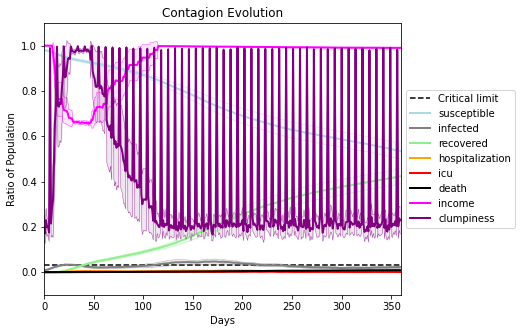

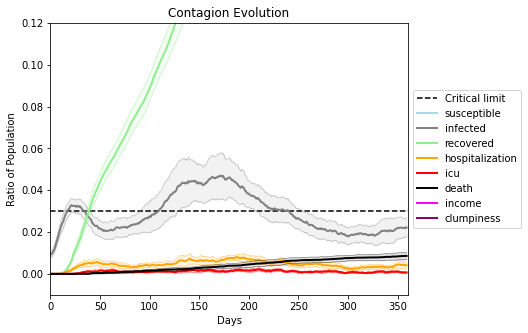

In [4]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -1
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[3085, 978, 386, 2591, 830, 7891, 5000, 9970, 9409, 5940, 2165, 6700, 643, 1377, 5108, 7887, 7159, 7899, 3766, 3845]
Average similarity between family members is 0.9756641694693117 at temperature -0.999
Average similarity between family and home is 0.999861825057582 at temperature -1
Average similarity between students and their classroom is 0.7790563393593529 at temperature -0.999
Average classroom occupancy is 4.126760563380282 and number classrooms is 71
Average similarity between workers is 0.967814925882338 at temperature -0.999
Average office occupancy is 3.6123595505617976 and number offices is 178
Average friend similarity for adults: 0.8599579413558514 for kids: 0.7334443015746878
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
H

avg restaurant similarity 0.6949649318927185
avg restaurant similarity 0.6913860240638013
avg restaurant similarity 0.7153803778167027
avg restaurant similarity 0.7144024336645702
avg restaurant similarity 0.7205413960689777
avg restaurant similarity 0.6800009525042205
avg restaurant similarity 0.6695092606982332
avg restaurant similarity 0.7120116061455607
avg restaurant similarity 0.6944383449719777
avg restaurant similarity 0.6849126010886601
avg restaurant similarity 0.7135468828629948
avg restaurant similarity 0.6553499663105586
avg restaurant similarity 0.6549422028290076
avg restaurant similarity 0.6978688881974229
avg restaurant similarity 0.6800497071984849
avg restaurant similarity 0.6845208188295683
avg restaurant similarity 0.7091059732066484
avg restaurant similarity 0.6839227336876079
avg restaurant similarity 0.6842652085481936
avg restaurant similarity 0.6634225550562252
avg restaurant similarity 0.7167135099665686
avg restaurant similarity 0.6670830382424535
avg restau

avg restaurant similarity 0.7210421531458001
avg restaurant similarity 0.7088044774135851
avg restaurant similarity 0.6889844528064465
avg restaurant similarity 0.631741480558745
avg restaurant similarity 0.6582842928565182
avg restaurant similarity 0.6415253011737877
avg restaurant similarity 0.6535529186727176
avg restaurant similarity 0.6378426221499703
avg restaurant similarity 0.6408719109445958
avg restaurant similarity 0.7206034361264788
avg restaurant similarity 0.7021934471279244
avg restaurant similarity 0.671645017203153
avg restaurant similarity 0.6268014671691373
avg restaurant similarity 0.6156212334651406
avg restaurant similarity 0.6724852662894496
avg restaurant similarity 0.7167394160669167
avg restaurant similarity 0.6679779367132331
avg restaurant similarity 0.6609512867785621
avg restaurant similarity 0.7766050219858692
avg restaurant similarity 0.6941355493125473
avg restaurant similarity 0.7029295016766378
avg restaurant similarity 0.6117226653126321
avg restaura

avg restaurant similarity 0.6467009484436915
avg restaurant similarity 0.6266324145732742
avg restaurant similarity 0.6454689595552778
avg restaurant similarity 0.7361164046107629
avg restaurant similarity 0.6178550316369088
avg restaurant similarity 0.6880899144421716
avg restaurant similarity 0.6809487598476722
avg restaurant similarity 0.6933117786729719
avg restaurant similarity 0.6708226040900238
avg restaurant similarity 0.6485609609309849
avg restaurant similarity 0.6426021552507118
avg restaurant similarity 0.6566600290809937
avg restaurant similarity 0.6317820794280826
avg restaurant similarity 0.6801919043415213
avg restaurant similarity 0.6733680586259335
avg restaurant similarity 0.6376832052344105
avg restaurant similarity 0.6449018842104635
avg restaurant similarity 0.6721145411560426
avg restaurant similarity 0.6694985312743047
avg restaurant similarity 0.704851453185438
avg restaurant similarity 0.6239645759413268
avg restaurant similarity 0.6928592333559286
avg restaur

avg restaurant similarity 0.6813731463055701
avg restaurant similarity 0.693275974926707
avg restaurant similarity 0.6199097694725727
avg restaurant similarity 0.6580749560872879
avg restaurant similarity 0.7200676091551761
avg restaurant similarity 0.70403646175534
avg restaurant similarity 0.6917106188590342
avg restaurant similarity 0.681737845885714
avg restaurant similarity 0.701083523479414
avg restaurant similarity 0.6702682678442349
avg restaurant similarity 0.6217706666782822
avg restaurant similarity 0.6723995984129806
avg restaurant similarity 0.6249425442851507
avg restaurant similarity 0.6000144383689501
avg restaurant similarity 0.6428186833480903
avg restaurant similarity 0.679002688929782
avg restaurant similarity 0.7194613808426097
avg restaurant similarity 0.6857350532006697
avg restaurant similarity 0.6807880371283247
avg restaurant similarity 0.6933625102078054
avg restaurant similarity 0.650351128189923
avg restaurant similarity 0.701420014617007
avg restaurant sim

avg restaurant similarity 0.6257488876024857
avg restaurant similarity 0.6540334396709631
avg restaurant similarity 0.6789649724315563
avg restaurant similarity 0.6401534169237458
avg restaurant similarity 0.6332615305276466
avg restaurant similarity 0.659337043501186
avg restaurant similarity 0.6852445182190253
avg restaurant similarity 0.660524484262754
avg restaurant similarity 0.6354905551443112
avg restaurant similarity 0.6520719071674633
avg restaurant similarity 0.6361975849490176
avg restaurant similarity 0.6980536661605501
avg restaurant similarity 0.7099210438165161
avg restaurant similarity 0.6379349941440684
avg restaurant similarity 0.690159564637061
avg restaurant similarity 0.648200188895095
avg restaurant similarity 0.6595045527887317
avg restaurant similarity 0.6513255899344914
avg restaurant similarity 0.6760195231592139
avg restaurant similarity 0.6436264822173885
avg restaurant similarity 0.650109711429999
avg restaurant similarity 0.6545203768707131
avg restaurant 

avg restaurant similarity 0.6504862998502363
avg restaurant similarity 0.6422852441312706
avg restaurant similarity 0.6244442146583137
avg restaurant similarity 0.6541320562013789
avg restaurant similarity 0.6293565301622593
avg restaurant similarity 0.6487638874762929
avg restaurant similarity 0.6631962493572314
avg restaurant similarity 0.6592344907608374
avg restaurant similarity 0.6607598392744236
avg restaurant similarity 0.6825368649691255
avg restaurant similarity 0.6537822050485084
avg restaurant similarity 0.6513330489463716
avg restaurant similarity 0.6179018434396578
avg restaurant similarity 0.6119963500507967
avg restaurant similarity 0.6109473221770931
avg restaurant similarity 0.6781953387500468
avg restaurant similarity 0.697281302005151
avg restaurant similarity 0.6325349514290654
avg restaurant similarity 0.6471201962004096
avg restaurant similarity 0.6010418093424569
avg restaurant similarity 0.6523519632273398
avg restaurant similarity 0.6651481623295153
avg restaur

avg restaurant similarity 0.6666293960171197
avg restaurant similarity 0.7002455369227268
avg restaurant similarity 0.6425111143567972
avg restaurant similarity 0.6614882974191246
avg restaurant similarity 0.6397796364094576
avg restaurant similarity 0.6814234579338736
avg restaurant similarity 0.6391718519953117
avg restaurant similarity 0.6880804779642032
avg restaurant similarity 0.6450866219973862
avg restaurant similarity 0.706824434700018
avg restaurant similarity 0.6507605256800579
avg restaurant similarity 0.6909002289631064
avg restaurant similarity 0.6691377536704092
avg restaurant similarity 0.6894898868302085
avg restaurant similarity 0.7204822692338647
avg restaurant similarity 0.6657500188354657
avg restaurant similarity 0.6371572477512464
avg restaurant similarity 0.6581820805534728
avg restaurant similarity 0.6597502847165646
avg restaurant similarity 0.6610475314703992
avg restaurant similarity 0.6438257322355325
avg restaurant similarity 0.660892490763449
avg restaura

avg restaurant similarity 0.6573221364751786
avg restaurant similarity 0.7216157753048366
avg restaurant similarity 0.6833850716875214
avg restaurant similarity 0.6721508615515008
avg restaurant similarity 0.6776047632404271
avg restaurant similarity 0.6548045783383638
avg restaurant similarity 0.6094860074515929
avg restaurant similarity 0.6694928909387168
avg restaurant similarity 0.6204263752748402
avg restaurant similarity 0.6775904104183141
avg restaurant similarity 0.7062737691341846
avg restaurant similarity 0.6910781461017311
avg restaurant similarity 0.7324053862578802
avg restaurant similarity 0.6420540344488598
avg restaurant similarity 0.6264249284039505
avg restaurant similarity 0.7334719299398604
avg restaurant similarity 0.5724042749313755
avg restaurant similarity 0.6412501654856827
avg restaurant similarity 0.6500609034588363
avg restaurant similarity 0.6324475467593836
avg restaurant similarity 0.6610974146934706
avg restaurant similarity 0.6640004340388692
avg restau

avg restaurant similarity 0.6598071588803431
avg restaurant similarity 0.6548517002041901
avg restaurant similarity 0.683830100752267
avg restaurant similarity 0.6696347641066807
avg restaurant similarity 0.6400896070995531
avg restaurant similarity 0.6552645294845854
avg restaurant similarity 0.6381566638615135
avg restaurant similarity 0.7027249248395031
avg restaurant similarity 0.6466268808076971
avg restaurant similarity 0.6760034574039969
avg restaurant similarity 0.6744926219963767
avg restaurant similarity 0.674196825485943
avg restaurant similarity 0.6384493841541659
avg restaurant similarity 0.7225275647954864
avg restaurant similarity 0.6925311506043474
avg restaurant similarity 0.6447393900482634
avg restaurant similarity 0.6642940303301592
avg restaurant similarity 0.7299777278330496
avg restaurant similarity 0.6517962253814636
avg restaurant similarity 0.6534081130612147
avg restaurant similarity 0.6171727667826108
avg restaurant similarity 0.6379360685393424
avg restaura

avg restaurant similarity 0.6853472325694216
avg restaurant similarity 0.6347461383727223
avg restaurant similarity 0.6897039939401799
avg restaurant similarity 0.6455804926841829
avg restaurant similarity 0.6090508702391325
avg restaurant similarity 0.6245968237371097
avg restaurant similarity 0.6203111327849231
avg restaurant similarity 0.6580549344815088
avg restaurant similarity 0.6602969742473511
avg restaurant similarity 0.6432248901453901
avg restaurant similarity 0.617285400328881
avg restaurant similarity 0.6703078002819687
avg restaurant similarity 0.6431675055944359
avg restaurant similarity 0.7010577533809034
avg restaurant similarity 0.6738670728065252
avg restaurant similarity 0.6735811878692125
avg restaurant similarity 0.6563494163369783
avg restaurant similarity 0.6254265720352541
avg restaurant similarity 0.6410858443957785
avg restaurant similarity 0.6524251511922589
avg restaurant similarity 0.6704071533955613
avg restaurant similarity 0.6669195494728923
avg restaur

avg restaurant similarity 0.5931578861434457
avg restaurant similarity 0.6680362523493194
avg restaurant similarity 0.6776293323437478
avg restaurant similarity 0.6986177679280593
avg restaurant similarity 0.6862197269584092
avg restaurant similarity 0.6768336612141107
avg restaurant similarity 0.6931589910839675
avg restaurant similarity 0.6755830017564709
avg restaurant similarity 0.6615007648832573
avg restaurant similarity 0.6958632709401764
avg restaurant similarity 0.665178923011936
avg restaurant similarity 0.633593550078009
avg restaurant similarity 0.7305178875275004
avg restaurant similarity 0.6881450986195053
avg restaurant similarity 0.6824198183216943
avg restaurant similarity 0.6640936246458865
avg restaurant similarity 0.6832974759086331
avg restaurant similarity 0.6147632752668603
avg restaurant similarity 0.7727565509952186
avg restaurant similarity 0.6867730181454129
avg restaurant similarity 0.6945366775232329
avg restaurant similarity 0.7681086949262469
avg restaura

avg restaurant similarity 0.7008160488310071
avg restaurant similarity 0.692309808245256
avg restaurant similarity 0.6783120728868558
avg restaurant similarity 0.6351047104571278
avg restaurant similarity 0.654531078275391
avg restaurant similarity 0.7052600914857002
avg restaurant similarity 0.6879244558424293
avg restaurant similarity 0.657732127665912
avg restaurant similarity 0.6658188094849778
avg restaurant similarity 0.710081480482179
avg restaurant similarity 0.65652581860285
avg restaurant similarity 0.6591539795884874
avg restaurant similarity 0.7111327642969903
avg restaurant similarity 0.6940042408712952
avg restaurant similarity 0.6254134763059522
avg restaurant similarity 0.6825187362066918
avg restaurant similarity 0.7108408713713478
avg restaurant similarity 0.6387340815714455
avg restaurant similarity 0.6785655466051452
avg restaurant similarity 0.647668981214203
avg restaurant similarity 0.6017263742836593
avg restaurant similarity 0.6386412956261738
avg restaurant si

avg restaurant similarity 0.657207123973921
avg restaurant similarity 0.6090238034275584
avg restaurant similarity 0.6607309725805326
avg restaurant similarity 0.6169745205774255
avg restaurant similarity 0.6133897979342852
avg restaurant similarity 0.674108582365318
avg restaurant similarity 0.6728793454176569
avg restaurant similarity 0.6174281913887041
avg restaurant similarity 0.6492708910600087
avg restaurant similarity 0.5808380256694858
avg restaurant similarity 0.6515142323554182
avg restaurant similarity 0.6212682146012538
avg restaurant similarity 0.6736151924727753
avg restaurant similarity 0.5874071493621764
avg restaurant similarity 0.6412693786076837
avg restaurant similarity 0.6500299487357126
avg restaurant similarity 0.6605334211182393
avg restaurant similarity 0.6662859106570995
avg restaurant similarity 0.6125815871429345
avg restaurant similarity 0.6232564119823251
avg restaurant similarity 0.6258388419701405
avg restaurant similarity 0.624875786312588
avg restauran

avg restaurant similarity 0.6315795101973382
avg restaurant similarity 0.6247374862675623
avg restaurant similarity 0.6256386807577953
avg restaurant similarity 0.6574523917864736
avg restaurant similarity 0.6118947555787134
avg restaurant similarity 0.6202667660455915
avg restaurant similarity 0.6562709234336417
avg restaurant similarity 0.6131658808300194
avg restaurant similarity 0.6108266818028868
avg restaurant similarity 0.6722779060962051
avg restaurant similarity 0.6913917971350408
avg restaurant similarity 0.6328891537492849
avg restaurant similarity 0.5984787280945516
avg restaurant similarity 0.6535018805450145
avg restaurant similarity 0.6017569108522672
avg restaurant similarity 0.6748935028322353
avg restaurant similarity 0.6715829110134237
avg restaurant similarity 0.6913131656230131
avg restaurant similarity 0.6114964763723246
avg restaurant similarity 0.6181851962319395
avg restaurant similarity 0.6450278096851203
avg restaurant similarity 0.6150227013447908
avg restau

avg restaurant similarity 0.5998747143571457
avg restaurant similarity 0.6412071930861016
avg restaurant similarity 0.7002313145901292
avg restaurant similarity 0.5992760692059202
avg restaurant similarity 0.629881697940385
avg restaurant similarity 0.6255444337247826
avg restaurant similarity 0.6060602817452923
avg restaurant similarity 0.6219467253068508
avg restaurant similarity 0.7021726444577817
avg restaurant similarity 0.6376337510655025
avg restaurant similarity 0.65687307979465
avg restaurant similarity 0.6156418487441823
avg restaurant similarity 0.661013944172841
avg restaurant similarity 0.6458481443148969
avg restaurant similarity 0.6564658622530918
avg restaurant similarity 0.6318592713307241
avg restaurant similarity 0.6977597889750075
avg restaurant similarity 0.6180109851123928
avg restaurant similarity 0.6203132182086549
avg restaurant similarity 0.6561416504948768
avg restaurant similarity 0.6245415925023736
avg restaurant similarity 0.6139086240136064
avg restaurant

avg restaurant similarity 0.6109661748142501
avg restaurant similarity 0.6390042448766452
avg restaurant similarity 0.6425261056470292
avg restaurant similarity 0.6077019700351031
avg restaurant similarity 0.6281012269924567
avg restaurant similarity 0.6432923774471303
avg restaurant similarity 0.6147557481021793
avg restaurant similarity 0.6566927811763599
avg restaurant similarity 0.6317429199338691
avg restaurant similarity 0.686375943714659
avg restaurant similarity 0.6139579864217675
avg restaurant similarity 0.6311723158371931
avg restaurant similarity 0.6345886297623227
avg restaurant similarity 0.6498596781729911
avg restaurant similarity 0.6257946627402184
avg restaurant similarity 0.6755302769173818
avg restaurant similarity 0.6407084660973761
avg restaurant similarity 0.6985937378001248
avg restaurant similarity 0.7324380911239797
avg restaurant similarity 0.6774385052029838
avg restaurant similarity 0.584402154350794
avg restaurant similarity 0.6802787089900874
avg restaura

avg restaurant similarity 0.6551318609112453
avg restaurant similarity 0.653185023509625
avg restaurant similarity 0.6574812651367236
avg restaurant similarity 0.6861816008410533
avg restaurant similarity 0.6912721839076704
avg restaurant similarity 0.6478301849813694
avg restaurant similarity 0.7113720611879397
avg restaurant similarity 0.6906007694575126
avg restaurant similarity 0.7084517722293022
avg restaurant similarity 0.6454057426523931
avg restaurant similarity 0.7071172980646101
avg restaurant similarity 0.6513412730354677
avg restaurant similarity 0.6616959394728326
avg restaurant similarity 0.6529240975760668
avg restaurant similarity 0.652531351861262
avg restaurant similarity 0.6595523854976701
avg restaurant similarity 0.6829542812516753
avg restaurant similarity 0.6883012966767931
avg restaurant similarity 0.6589570216504458
avg restaurant similarity 0.6631204274745098
avg restaurant similarity 0.6385366158707046
avg restaurant similarity 0.6760540270437464
avg restaura

avg restaurant similarity 0.6857851638027244
avg restaurant similarity 0.6812897135855589
avg restaurant similarity 0.6411786294807925
avg restaurant similarity 0.6822108431622882
avg restaurant similarity 0.6503155946528503
avg restaurant similarity 0.6675757043891194
avg restaurant similarity 0.6779485627724858
avg restaurant similarity 0.6893596622046502
avg restaurant similarity 0.6653796882980895
avg restaurant similarity 0.6839079193237763
avg restaurant similarity 0.7039310138474851
avg restaurant similarity 0.709612762600254
avg restaurant similarity 0.6807049835382026
avg restaurant similarity 0.6392806894608528
avg restaurant similarity 0.632909793576096
avg restaurant similarity 0.6777693830884066
avg restaurant similarity 0.7139565852264115
avg restaurant similarity 0.6787302782786024
avg restaurant similarity 0.5946229403210014
avg restaurant similarity 0.6165671589939096
avg restaurant similarity 0.6470718122915191
avg restaurant similarity 0.6582209226621318
avg restaura

avg restaurant similarity 0.6972622038407693
avg restaurant similarity 0.6682690809283799
avg restaurant similarity 0.7161673358003351
avg restaurant similarity 0.714771709722437
avg restaurant similarity 0.6905782543230269
avg restaurant similarity 0.6352814337845839
avg restaurant similarity 0.6870101431963649
avg restaurant similarity 0.6590951242177668
avg restaurant similarity 0.6788192891668159
avg restaurant similarity 0.6544953407182497
avg restaurant similarity 0.6965491024337773
avg restaurant similarity 0.6483730924256832
avg restaurant similarity 0.6918534642055705
avg restaurant similarity 0.669808167596615
avg restaurant similarity 0.676994385916174
avg restaurant similarity 0.7148817412020774
avg restaurant similarity 0.6393712845552937
avg restaurant similarity 0.6776454879017234
avg restaurant similarity 0.6670929087797969
avg restaurant similarity 0.6655669928209123
avg restaurant similarity 0.7274121474547678
avg restaurant similarity 0.6825267050975647
avg restauran

avg restaurant similarity 0.658013165054392
avg restaurant similarity 0.6414866797144729
avg restaurant similarity 0.6364638537677637
avg restaurant similarity 0.5693912084547318
avg restaurant similarity 0.6427109989911306
avg restaurant similarity 0.601932203095185
avg restaurant similarity 0.6584836980742624
avg restaurant similarity 0.7083308447070716
avg restaurant similarity 0.6033239392141369
avg restaurant similarity 0.6433917863520892
avg restaurant similarity 0.6886779528767357
avg restaurant similarity 0.6158168274194584
avg restaurant similarity 0.6589952167737442
avg restaurant similarity 0.6847723197562852
avg restaurant similarity 0.622156828557063
avg restaurant similarity 0.5621407229998551
avg restaurant similarity 0.6387974717355799
avg restaurant similarity 0.6746096500234257
avg restaurant similarity 0.6330980342758232
avg restaurant similarity 0.6578743338212714
avg restaurant similarity 0.6874121584272342
avg restaurant similarity 0.670755993845438
avg restaurant

avg restaurant similarity 0.6750018884956106
avg restaurant similarity 0.6134470345255867
avg restaurant similarity 0.6917034053562031
avg restaurant similarity 0.6564988204052391
avg restaurant similarity 0.7408391884614725
avg restaurant similarity 0.7312560398634196
avg restaurant similarity 0.7115098105769957
avg restaurant similarity 0.6786169516948226
avg restaurant similarity 0.7797434175702298
avg restaurant similarity 0.7782652888280268
avg restaurant similarity 0.7281848605213262
avg restaurant similarity 0.6985535670627001
avg restaurant similarity 0.6237789888709587
avg restaurant similarity 0.7388479322027607
avg restaurant similarity 0.7361786436856934
avg restaurant similarity 0.7450550646657289
avg restaurant similarity 0.6579171304731211
avg restaurant similarity 0.6899745940671399
avg restaurant similarity 0.6993076021759471
avg restaurant similarity 0.690417825985785
avg restaurant similarity 0.6640362690095567
avg restaurant similarity 0.7269296979665124
avg restaur

avg restaurant similarity 0.6819294860664851
avg restaurant similarity 0.6527518759130694
avg restaurant similarity 0.6746857815007491
avg restaurant similarity 0.6329385413455055
avg restaurant similarity 0.7104160766496345
avg restaurant similarity 0.6713832993284089
avg restaurant similarity 0.6546327137588387
avg restaurant similarity 0.7285794852860834
avg restaurant similarity 0.6775079519823498
avg restaurant similarity 0.6831525231314264
avg restaurant similarity 0.6401840429319429
avg restaurant similarity 0.685801111700971
avg restaurant similarity 0.6641158936784191
avg restaurant similarity 0.631970411933144
avg restaurant similarity 0.6362631384409859
avg restaurant similarity 0.5772741259902483
avg restaurant similarity 0.680673860992245
avg restaurant similarity 0.6484976548775989
avg restaurant similarity 0.661253822332299
avg restaurant similarity 0.6905395208556877
avg restaurant similarity 0.6530786868500326
avg restaurant similarity 0.6754270986561944
avg restaurant

avg restaurant similarity 0.6700687577116337
avg restaurant similarity 0.6894943066794886
avg restaurant similarity 0.6339565784691391
avg restaurant similarity 0.7064802775627886
avg restaurant similarity 0.6459252724337068
avg restaurant similarity 0.610857008920066
avg restaurant similarity 0.7109560869342272
avg restaurant similarity 0.6564674221829828
avg restaurant similarity 0.6926731416150783
avg restaurant similarity 0.7101232507415062
avg restaurant similarity 0.6976412660782392
avg restaurant similarity 0.6990933892269774
avg restaurant similarity 0.671134624702861
avg restaurant similarity 0.692002312246492
avg restaurant similarity 0.6764364685627844
avg restaurant similarity 0.6784144405511716
avg restaurant similarity 0.6355148838322725
avg restaurant similarity 0.6967682725302947
avg restaurant similarity 0.6622922954723579
avg restaurant similarity 0.6270719037359228
avg restaurant similarity 0.6668033905500478
avg restaurant similarity 0.6460427643439199
avg restauran

avg restaurant similarity 0.6803392357856549
avg restaurant similarity 0.7306757791900987
avg restaurant similarity 0.6585376268364883
avg restaurant similarity 0.6911917623499393
avg restaurant similarity 0.6819460482893251
avg restaurant similarity 0.7144632712046902
avg restaurant similarity 0.6783096821362274
avg restaurant similarity 0.6968361179741164
avg restaurant similarity 0.6590846679781983
avg restaurant similarity 0.6593760867306556
avg restaurant similarity 0.7174926632959292
avg restaurant similarity 0.6617706672194961
avg restaurant similarity 0.7118982519427307
avg restaurant similarity 0.6852515171263934
avg restaurant similarity 0.6823676633969756
avg restaurant similarity 0.7127660463206416
avg restaurant similarity 0.6678577007285798
avg restaurant similarity 0.6090312407309282
avg restaurant similarity 0.6700926633206595
avg restaurant similarity 0.6787397026240779
avg restaurant similarity 0.729635386427866
avg restaurant similarity 0.6344677852884634
avg restaur

avg restaurant similarity 0.6573028882887222
avg restaurant similarity 0.6617046207674564
avg restaurant similarity 0.6527073780347692
avg restaurant similarity 0.6329492663888024
avg restaurant similarity 0.6584764916970643
avg restaurant similarity 0.6594578622050077
avg restaurant similarity 0.6715563343991321
avg restaurant similarity 0.6645158605823457
avg restaurant similarity 0.6677091221722776
avg restaurant similarity 0.6728310225695536
avg restaurant similarity 0.677805780619647
avg restaurant similarity 0.674678910521379
avg restaurant similarity 0.6888385540568769
avg restaurant similarity 0.6367911668465452
avg restaurant similarity 0.6301614954670897
avg restaurant similarity 0.6553166486357744
avg restaurant similarity 0.6621609889153113
avg restaurant similarity 0.6577840702829202
avg restaurant similarity 0.6156810533249968
avg restaurant similarity 0.6530452699255442
avg restaurant similarity 0.6424803341382286
avg restaurant similarity 0.6377658994383626
avg restaura

avg restaurant similarity 0.6359120750619532
avg restaurant similarity 0.6093427053963414
avg restaurant similarity 0.6438591733437499
avg restaurant similarity 0.6635015463014572
avg restaurant similarity 0.6414195530986643
avg restaurant similarity 0.658499772892123
avg restaurant similarity 0.6752106894746566
avg restaurant similarity 0.6332419373434773
avg restaurant similarity 0.6228097678371577
avg restaurant similarity 0.6690842692215138
avg restaurant similarity 0.6408065789124855
avg restaurant similarity 0.6248931792098645
avg restaurant similarity 0.6645676413565165
avg restaurant similarity 0.6012136100688984
avg restaurant similarity 0.6506142275265667
avg restaurant similarity 0.6462490138943926
avg restaurant similarity 0.6174175579581863
avg restaurant similarity 0.6541174028269271
avg restaurant similarity 0.6746551286163701
avg restaurant similarity 0.6097176772716137
avg restaurant similarity 0.6581710823011802
avg restaurant similarity 0.6616793002983355
avg restaur

avg restaurant similarity 0.7295951251930455
avg restaurant similarity 0.6861429153374106
avg restaurant similarity 0.6751007091418323
avg restaurant similarity 0.6925305822795402
avg restaurant similarity 0.6849882421612373
avg restaurant similarity 0.6413056121785755
avg restaurant similarity 0.676858033726006
avg restaurant similarity 0.6815418396657528
avg restaurant similarity 0.7023308746552787
avg restaurant similarity 0.6809389822361533
avg restaurant similarity 0.6460009217172797
avg restaurant similarity 0.6854306200781858
avg restaurant similarity 0.6987122846002631
avg restaurant similarity 0.716799782231621
avg restaurant similarity 0.72934343389867
avg restaurant similarity 0.6259292761602074
avg restaurant similarity 0.6245617712805085
avg restaurant similarity 0.6362485598982538
avg restaurant similarity 0.6731739174024854
avg restaurant similarity 0.6657640300840366
avg restaurant similarity 0.6952408920765288
avg restaurant similarity 0.7299065804180002
avg restaurant

avg restaurant similarity 0.6751484294827615
avg restaurant similarity 0.6962786885057555
avg restaurant similarity 0.6892681749563107
avg restaurant similarity 0.6993922540249763
avg restaurant similarity 0.6486525710109159
avg restaurant similarity 0.5955588113628535
avg restaurant similarity 0.6662539904026801
avg restaurant similarity 0.6994441657509575
avg restaurant similarity 0.6856125555481931
avg restaurant similarity 0.7102182518093196
avg restaurant similarity 0.6448541494215898
avg restaurant similarity 0.6602801397300252
avg restaurant similarity 0.6818684530316056
avg restaurant similarity 0.6909825749048317
avg restaurant similarity 0.6847700891661523
avg restaurant similarity 0.7036031508730735
avg restaurant similarity 0.6665755436671009
avg restaurant similarity 0.730694550389156
avg restaurant similarity 0.691054943742004
avg restaurant similarity 0.6794539445668214
avg restaurant similarity 0.7394701645225579
avg restaurant similarity 0.7249580145200684
avg restaura

avg restaurant similarity 0.634493025471616
avg restaurant similarity 0.6617247365221233
avg restaurant similarity 0.6932361053722403
avg restaurant similarity 0.6572685439468932
avg restaurant similarity 0.672841585365171
avg restaurant similarity 0.6326917740981914
avg restaurant similarity 0.6873461903103139
avg restaurant similarity 0.6831886013868839
avg restaurant similarity 0.6784955252235249
avg restaurant similarity 0.6993871507841415
avg restaurant similarity 0.6567569479050153
avg restaurant similarity 0.6391654102281911
avg restaurant similarity 0.6752418820453133
avg restaurant similarity 0.6327029905957332
avg restaurant similarity 0.6517958078542047
avg restaurant similarity 0.6975970082768271
avg restaurant similarity 0.6223701875924869
avg restaurant similarity 0.6385795084152426
avg restaurant similarity 0.6507113768458024
avg restaurant similarity 0.6324663391969201
avg restaurant similarity 0.5874011168129205
avg restaurant similarity 0.6346296845333552
avg restaura

avg restaurant similarity 0.6623829718583493
avg restaurant similarity 0.6857196261936576
avg restaurant similarity 0.6696624402927025
avg restaurant similarity 0.6609302588061092
avg restaurant similarity 0.7082120816414044
avg restaurant similarity 0.5983440817724384
avg restaurant similarity 0.7044759690819916
avg restaurant similarity 0.6512332108619115
avg restaurant similarity 0.6501177455324495
avg restaurant similarity 0.6669457558341871
avg restaurant similarity 0.6872736159385617
avg restaurant similarity 0.6869068244147509
avg restaurant similarity 0.6678228934592768
avg restaurant similarity 0.7013964111609987
avg restaurant similarity 0.6903445706152319
avg restaurant similarity 0.6703889895696429
avg restaurant similarity 0.6720387435509434
avg restaurant similarity 0.6540928506186905
avg restaurant similarity 0.6890638256339292
avg restaurant similarity 0.6067403950073641
avg restaurant similarity 0.6670054534764016
avg restaurant similarity 0.6693743386715483
avg restau

avg restaurant similarity 0.6617574778813211
avg restaurant similarity 0.6615213380218791
avg restaurant similarity 0.6551118887477415
avg restaurant similarity 0.6162972173359033
avg restaurant similarity 0.6114291263354319
avg restaurant similarity 0.6323024210850624
avg restaurant similarity 0.6769096811045561
avg restaurant similarity 0.6064418662910268
avg restaurant similarity 0.6536399891975014
avg restaurant similarity 0.6422601703771291
avg restaurant similarity 0.632568987296154
avg restaurant similarity 0.670593026784858
avg restaurant similarity 0.6076007157278692
avg restaurant similarity 0.6435904494636552
avg restaurant similarity 0.6617664001937321
avg restaurant similarity 0.6065782850381223
avg restaurant similarity 0.6244182067386435
avg restaurant similarity 0.584394420537631
avg restaurant similarity 0.6248986291119106
avg restaurant similarity 0.6662413056396138
avg restaurant similarity 0.6419871036676261
avg restaurant similarity 0.5842218747351543
avg restauran

avg restaurant similarity 0.6256728734054843
avg restaurant similarity 0.6448330506254301
avg restaurant similarity 0.6791963036450291
avg restaurant similarity 0.6068547155791224
avg restaurant similarity 0.644204846487892
avg restaurant similarity 0.6791828037297784
avg restaurant similarity 0.6204226947395759
avg restaurant similarity 0.7015610826133941
avg restaurant similarity 0.6581612513830418
avg restaurant similarity 0.6533931244018454
avg restaurant similarity 0.6497064474200466
avg restaurant similarity 0.5939845714926428
avg restaurant similarity 0.6651408365777199
avg restaurant similarity 0.6427262973592235
avg restaurant similarity 0.6379294299844664
avg restaurant similarity 0.6050374272479448
avg restaurant similarity 0.6535363789390747
avg restaurant similarity 0.6389108961342901
avg restaurant similarity 0.6318381864948639
avg restaurant similarity 0.6136947583625416
avg restaurant similarity 0.6979103269055289
avg restaurant similarity 0.5926353691709836
avg restaur

avg restaurant similarity 0.638137348013277
avg restaurant similarity 0.6263181615710204
avg restaurant similarity 0.6325157774348783
avg restaurant similarity 0.6052745686986407
avg restaurant similarity 0.6185740218136918
avg restaurant similarity 0.6004457985800052
avg restaurant similarity 0.6279962475213544
avg restaurant similarity 0.6407633887796839
avg restaurant similarity 0.6146091719414429
avg restaurant similarity 0.6248760146358006
avg restaurant similarity 0.6496774862091155
avg restaurant similarity 0.5986071240896028
avg restaurant similarity 0.6124658293713094
avg restaurant similarity 0.6353522644722965
avg restaurant similarity 0.5991996266399692
avg restaurant similarity 0.5938581451944458
avg restaurant similarity 0.6448641203141702
avg restaurant similarity 0.647184901388151
avg restaurant similarity 0.5932321432604267
avg restaurant similarity 0.6277841082931205
avg restaurant similarity 0.6233206916538492
avg restaurant similarity 0.6596284566856201
avg restaura

avg restaurant similarity 0.6180266911341309
avg restaurant similarity 0.6007259612630763
avg restaurant similarity 0.6201010466548051
avg restaurant similarity 0.5845476644642655
avg restaurant similarity 0.603480268217968
avg restaurant similarity 0.5511252967200605
avg restaurant similarity 0.6768405831170868
avg restaurant similarity 0.5628299813139158
avg restaurant similarity 0.679777864934384
avg restaurant similarity 0.6435230541593298
avg restaurant similarity 0.6182591507718468
avg restaurant similarity 0.6614356461192096
avg restaurant similarity 0.6786202545395763
avg restaurant similarity 0.6554246993459361
avg restaurant similarity 0.6276861903703014
avg restaurant similarity 0.6470893633111041
avg restaurant similarity 0.6189047961157184
avg restaurant similarity 0.5957816920340517
avg restaurant similarity 0.6723896616396181
avg restaurant similarity 0.5532856736600439
avg restaurant similarity 0.5901656673764082
avg restaurant similarity 0.6087126571370145
avg restaura

avg restaurant similarity 0.6153680775151043
avg restaurant similarity 0.6312864957022268
avg restaurant similarity 0.6658413618336663
avg restaurant similarity 0.6466787042262284
avg restaurant similarity 0.6436584154552722
avg restaurant similarity 0.7052818070759354
avg restaurant similarity 0.6259915815026353
avg restaurant similarity 0.6889300740214005
avg restaurant similarity 0.641273474762463
avg restaurant similarity 0.6434608884389749
avg restaurant similarity 0.6257645581846445
avg restaurant similarity 0.6405431608921146
avg restaurant similarity 0.650286420376074
avg restaurant similarity 0.6657227571838961
avg restaurant similarity 0.6726594549731462
avg restaurant similarity 0.649118542092856
avg restaurant similarity 0.6699000635246197
avg restaurant similarity 0.6576891052141536
avg restaurant similarity 0.6673232096339222
avg restaurant similarity 0.6476628580947275
avg restaurant similarity 0.6641482637915099
avg restaurant similarity 0.6289338200204346
avg restauran

avg restaurant similarity 0.6752102545365691
avg restaurant similarity 0.625207109478206
avg restaurant similarity 0.6143807031813697
avg restaurant similarity 0.6168491847356611
avg restaurant similarity 0.652207713998591
avg restaurant similarity 0.6449674764652292
avg restaurant similarity 0.6272555450933004
avg restaurant similarity 0.6676654165100907
avg restaurant similarity 0.6513617228711155
avg restaurant similarity 0.6676531810815803
avg restaurant similarity 0.6041061965881898
avg restaurant similarity 0.6735791313857831
avg restaurant similarity 0.6526843592894863
avg restaurant similarity 0.6711549932704497
avg restaurant similarity 0.678193751155147
avg restaurant similarity 0.6409033504998327
avg restaurant similarity 0.6131828487234995
avg restaurant similarity 0.6421062343787635
avg restaurant similarity 0.6698216226491908
avg restaurant similarity 0.6914275913101754
avg restaurant similarity 0.7330706954073499
avg restaurant similarity 0.698903652564583
avg restaurant

avg restaurant similarity 0.6048617747423765
avg restaurant similarity 0.6492697073245495
avg restaurant similarity 0.6636647459237324
avg restaurant similarity 0.6601377553186618
avg restaurant similarity 0.5951592259950463
avg restaurant similarity 0.6524674466213535
avg restaurant similarity 0.6498596857971042
avg restaurant similarity 0.6434810590959165
avg restaurant similarity 0.665903909806716
avg restaurant similarity 0.6959258195377557
avg restaurant similarity 0.6908001937931556
avg restaurant similarity 0.5965856365748452
avg restaurant similarity 0.6897582058540531
avg restaurant similarity 0.6594152159750186
avg restaurant similarity 0.619798183442673
avg restaurant similarity 0.6924043715245125
avg restaurant similarity 0.6468415222155319
avg restaurant similarity 0.6646012698967314
avg restaurant similarity 0.6349281065699737
avg restaurant similarity 0.6084068217716795
avg restaurant similarity 0.658349361843948
avg restaurant similarity 0.7031538810250422
avg restauran

avg restaurant similarity 0.5914862838194204
avg restaurant similarity 0.6314359320490436
avg restaurant similarity 0.6875895663135662
avg restaurant similarity 0.6767156098090454
avg restaurant similarity 0.6742295746235831
avg restaurant similarity 0.641418919486054
avg restaurant similarity 0.6489494341567815
avg restaurant similarity 0.6658190118851747
avg restaurant similarity 0.6524183569415691
avg restaurant similarity 0.6426627045095362
avg restaurant similarity 0.6423132599552465
avg restaurant similarity 0.6371836958582912
avg restaurant similarity 0.6307903910518413
avg restaurant similarity 0.6229763760095189
avg restaurant similarity 0.7133339648879334
avg restaurant similarity 0.6417729490876445
avg restaurant similarity 0.6406369969235984
avg restaurant similarity 0.6511353555369831
avg restaurant similarity 0.7043919659802627
avg restaurant similarity 0.6644579639091029
avg restaurant similarity 0.6877560056976095
avg restaurant similarity 0.6785867580360261
avg restaur

avg restaurant similarity 0.687071937280852
avg restaurant similarity 0.6732736958050348
avg restaurant similarity 0.6942467635495639
avg restaurant similarity 0.6558866182366796
avg restaurant similarity 0.6829700187357868
avg restaurant similarity 0.6743893611707122
avg restaurant similarity 0.657527065400496
avg restaurant similarity 0.6726352123143646
avg restaurant similarity 0.69810481168847
avg restaurant similarity 0.7301175373614416
avg restaurant similarity 0.7146499763914098
avg restaurant similarity 0.7401061641652853
avg restaurant similarity 0.7237056678226516
avg restaurant similarity 0.703814342610072
avg restaurant similarity 0.6604173269909108
avg restaurant similarity 0.7345111652488159
avg restaurant similarity 0.6580334392627378
avg restaurant similarity 0.7138623411034752
avg restaurant similarity 0.6967592673108052
avg restaurant similarity 0.7509774095630026
avg restaurant similarity 0.7747852763794657
avg restaurant similarity 0.7257110064413801
avg restaurant 

avg restaurant similarity 0.698419635675743
avg restaurant similarity 0.6804739559260758
avg restaurant similarity 0.6750927885674457
avg restaurant similarity 0.6545722465295649
avg restaurant similarity 0.7099353414616506
avg restaurant similarity 0.6848220554609694
avg restaurant similarity 0.636236583920247
avg restaurant similarity 0.7074938045484859
avg restaurant similarity 0.6333626747431822
avg restaurant similarity 0.7435526824550767
avg restaurant similarity 0.730343899559897
avg restaurant similarity 0.6621723005513772
avg restaurant similarity 0.6865401792176771
avg restaurant similarity 0.7190362821795088
avg restaurant similarity 0.682429781299572
avg restaurant similarity 0.7034021722728154
avg restaurant similarity 0.7002339668671759
avg restaurant similarity 0.7056737286166792
avg restaurant similarity 0.6968078030304254
avg restaurant similarity 0.6856353946302434
avg restaurant similarity 0.6698797105274858
avg restaurant similarity 0.6814602935423357
avg restaurant

(<function dict.items>, <function dict.items>, <function dict.items>)

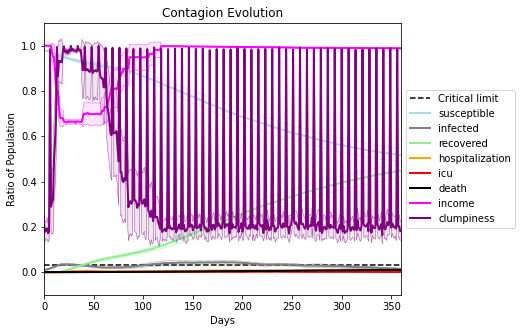

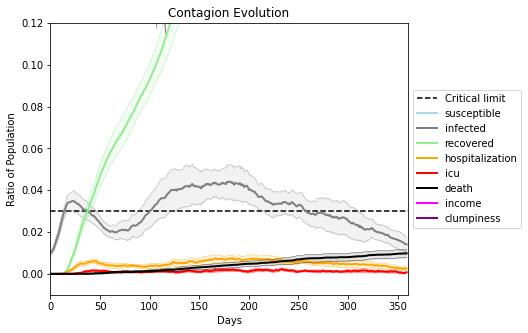

In [5]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.999
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[2981, 3925, 3499, 6199, 9141, 3529, 7082, 5785, 6359, 9454, 5398, 4288, 5918, 8960, 1096, 8944, 5437, 5093, 8598, 4381]
Average similarity between family members is 0.9712391238433518 at temperature -0.998
Average similarity between family and home is 0.999843008910067 at temperature -1
Average similarity between students and their classroom is 0.776581616986399 at temperature -0.998
Average classroom occupancy is 4.446153846153846 and number classrooms is 65
Average similarity between workers is 0.9661686430795134 at temperature -0.998
Average office occupancy is 3.6277777777777778 and number offices is 180
Average friend similarity for adults: 0.861821302722557 for kids: 0.7341475043648806
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Building

avg restaurant similarity 0.6792889086258558
avg restaurant similarity 0.669027126220249
avg restaurant similarity 0.6302633190764595
avg restaurant similarity 0.6632815513687751
avg restaurant similarity 0.6817684183756634
avg restaurant similarity 0.6052713389283084
avg restaurant similarity 0.6440335998035485
avg restaurant similarity 0.6794427310268004
avg restaurant similarity 0.6671993454379173
avg restaurant similarity 0.7052630751934665
avg restaurant similarity 0.6178806368808918
avg restaurant similarity 0.6319791724762667
avg restaurant similarity 0.6453579710902144
avg restaurant similarity 0.7008830014916266
avg restaurant similarity 0.6925749818326542
avg restaurant similarity 0.6110892445970137
avg restaurant similarity 0.6305428401293046
avg restaurant similarity 0.6968345774512822
avg restaurant similarity 0.5950828343820926
avg restaurant similarity 0.667988486885075
avg restaurant similarity 0.6709450224095429
avg restaurant similarity 0.5769500470066179
avg restaura

avg restaurant similarity 0.6675693614671773
avg restaurant similarity 0.6286043615315215
avg restaurant similarity 0.6410293522251521
avg restaurant similarity 0.7021101351060847
avg restaurant similarity 0.6488081794623821
avg restaurant similarity 0.6716357946615618
avg restaurant similarity 0.607806992910825
avg restaurant similarity 0.6085364582589385
avg restaurant similarity 0.6800637095726247
avg restaurant similarity 0.6829603482055284
avg restaurant similarity 0.6665123235313495
avg restaurant similarity 0.6375632162237928
avg restaurant similarity 0.610114285122275
avg restaurant similarity 0.727234063394155
avg restaurant similarity 0.6732090128611001
avg restaurant similarity 0.6092639450362544
avg restaurant similarity 0.6375451730890319
avg restaurant similarity 0.6822719487643396
avg restaurant similarity 0.7194456914206626
avg restaurant similarity 0.6723170441121571
avg restaurant similarity 0.6853174428578859
avg restaurant similarity 0.6422920274509932
avg restauran

avg restaurant similarity 0.6604813684550057
avg restaurant similarity 0.662336129874983
avg restaurant similarity 0.643528262776081
avg restaurant similarity 0.6944920766102773
avg restaurant similarity 0.6769403247349959
avg restaurant similarity 0.6728193811637959
avg restaurant similarity 0.649512722033864
avg restaurant similarity 0.6362822317501974
avg restaurant similarity 0.6634324466799335
avg restaurant similarity 0.6940640989840052
avg restaurant similarity 0.6449546748124172
avg restaurant similarity 0.6437875867185058
avg restaurant similarity 0.6633560963271559
avg restaurant similarity 0.6688519067349842
avg restaurant similarity 0.7006705565346246
avg restaurant similarity 0.6436254930139593
avg restaurant similarity 0.6721883815767822
avg restaurant similarity 0.7054248725497517
avg restaurant similarity 0.661751684259459
avg restaurant similarity 0.6575881424263559
avg restaurant similarity 0.6877497646707466
avg restaurant similarity 0.6771894750573116
avg restaurant

avg restaurant similarity 0.6952242133697201
avg restaurant similarity 0.6842130447835141
avg restaurant similarity 0.6818421006411463
avg restaurant similarity 0.6746672313947745
avg restaurant similarity 0.6122104144859011
avg restaurant similarity 0.6304880135370776
avg restaurant similarity 0.6258576129275818
avg restaurant similarity 0.6753594385841624
avg restaurant similarity 0.6535530842143115
avg restaurant similarity 0.6306328637457694
avg restaurant similarity 0.660244163588103
avg restaurant similarity 0.6538243992304162
avg restaurant similarity 0.650461435691136
avg restaurant similarity 0.6297032039417377
avg restaurant similarity 0.6468027559486121
avg restaurant similarity 0.6185121150504272
avg restaurant similarity 0.6415560266448421
avg restaurant similarity 0.7112508023080711
avg restaurant similarity 0.6564252377301796
avg restaurant similarity 0.6270113098049634
avg restaurant similarity 0.6922821673581877
avg restaurant similarity 0.6373092951559057
avg restaura

avg restaurant similarity 0.6104026184938293
avg restaurant similarity 0.6407102458980241
avg restaurant similarity 0.6571021863206545
avg restaurant similarity 0.6557897943609754
avg restaurant similarity 0.6833483364838105
avg restaurant similarity 0.6493347017887973
avg restaurant similarity 0.6581900897069669
avg restaurant similarity 0.6748423642636586
avg restaurant similarity 0.6966432613411626
avg restaurant similarity 0.6528245461173268
avg restaurant similarity 0.6340135151856993
avg restaurant similarity 0.6410330999518369
avg restaurant similarity 0.6143846066185017
avg restaurant similarity 0.6230049900294363
avg restaurant similarity 0.6647024195341051
avg restaurant similarity 0.6594769606417465
avg restaurant similarity 0.6449667744696806
avg restaurant similarity 0.6372991229110143
avg restaurant similarity 0.6119712354766731
avg restaurant similarity 0.6618279574941283
avg restaurant similarity 0.6136361399127355
avg restaurant similarity 0.6101624205638289
avg restau

avg restaurant similarity 0.6140675764134732
avg restaurant similarity 0.6176001305212993
avg restaurant similarity 0.6772361180879258
avg restaurant similarity 0.6511904090907041
avg restaurant similarity 0.6612782225043259
avg restaurant similarity 0.6596671861181479
avg restaurant similarity 0.635251844692031
avg restaurant similarity 0.6513011652073099
avg restaurant similarity 0.6020107339422378
avg restaurant similarity 0.6557840521027183
avg restaurant similarity 0.6469049513246046
avg restaurant similarity 0.6298625167939994
avg restaurant similarity 0.6442427657744577
avg restaurant similarity 0.613306162471376
avg restaurant similarity 0.6229531851641157
avg restaurant similarity 0.6512940062051535
avg restaurant similarity 0.6967983365261465
avg restaurant similarity 0.6235793180487598
avg restaurant similarity 0.6089026300254913
avg restaurant similarity 0.643031076084492
avg restaurant similarity 0.6243490892632203
avg restaurant similarity 0.6674002708766072
avg restauran

avg restaurant similarity 0.6236480511318009
avg restaurant similarity 0.6363819236791151
avg restaurant similarity 0.6617116320462509
avg restaurant similarity 0.6172342937619838
avg restaurant similarity 0.6432205646685363
avg restaurant similarity 0.7017678088994452
avg restaurant similarity 0.6751314512949165
avg restaurant similarity 0.6440383963680152
avg restaurant similarity 0.5612367154145053
avg restaurant similarity 0.6458558791702225
avg restaurant similarity 0.6822288517155891
avg restaurant similarity 0.5668342249893118
avg restaurant similarity 0.6361002245066062
avg restaurant similarity 0.6165682738019144
avg restaurant similarity 0.6138423942799797
avg restaurant similarity 0.6151600960132324
avg restaurant similarity 0.5981229979004371
avg restaurant similarity 0.5895955959764168
avg restaurant similarity 0.6321120130115316
avg restaurant similarity 0.6846068934817863
avg restaurant similarity 0.5962243064954676
avg restaurant similarity 0.6613075954472442
avg restau

avg restaurant similarity 0.629090820679231
avg restaurant similarity 0.6787929109008433
avg restaurant similarity 0.6806948932508259
avg restaurant similarity 0.6470016249799215
avg restaurant similarity 0.6548618033160702
avg restaurant similarity 0.6152664028134338
avg restaurant similarity 0.6623403566455496
avg restaurant similarity 0.6396654910084469
avg restaurant similarity 0.6513752559439078
avg restaurant similarity 0.5472649855001346
avg restaurant similarity 0.6153211428820186
avg restaurant similarity 0.6608713857345254
avg restaurant similarity 0.6389038110395235
avg restaurant similarity 0.6128059396053516
avg restaurant similarity 0.6620659485837409
avg restaurant similarity 0.6447427922240156
avg restaurant similarity 0.6200106573546674
avg restaurant similarity 0.6200667034127014
avg restaurant similarity 0.6459102919633163
avg restaurant similarity 0.6238771331256899
avg restaurant similarity 0.6496719279310773
avg restaurant similarity 0.6892376406875493
avg restaur

avg restaurant similarity 0.6300290884435729
avg restaurant similarity 0.6616952151541515
avg restaurant similarity 0.7079437613816167
avg restaurant similarity 0.6731235797544778
avg restaurant similarity 0.6719979830462077
avg restaurant similarity 0.6328439327454589
avg restaurant similarity 0.6431797924935247
avg restaurant similarity 0.6432248692135653
avg restaurant similarity 0.6418223820459307
avg restaurant similarity 0.6798464481407044
avg restaurant similarity 0.663769756534409
avg restaurant similarity 0.6629120752713181
avg restaurant similarity 0.6219789038006512
avg restaurant similarity 0.7361836435871758
avg restaurant similarity 0.6943122764460808
avg restaurant similarity 0.649480434105874
avg restaurant similarity 0.6581665390918278
avg restaurant similarity 0.6215183476760668
avg restaurant similarity 0.6298894593557025
avg restaurant similarity 0.6559020591462018
avg restaurant similarity 0.6229558538473418
avg restaurant similarity 0.6620572201944229
avg restaura

avg restaurant similarity 0.5880691264263518
avg restaurant similarity 0.6609699648483147
avg restaurant similarity 0.6225602211943774
avg restaurant similarity 0.6321295263705077
avg restaurant similarity 0.6112080085142038
avg restaurant similarity 0.6454851748867371
avg restaurant similarity 0.6935469592920348
avg restaurant similarity 0.7184284358898504
avg restaurant similarity 0.6471432341266903
avg restaurant similarity 0.672957143511574
avg restaurant similarity 0.6624418570624402
avg restaurant similarity 0.6426353266542624
avg restaurant similarity 0.6647683068743218
avg restaurant similarity 0.6685437664153564
avg restaurant similarity 0.6201763038391486
avg restaurant similarity 0.6487264484428977
avg restaurant similarity 0.6748436400733284
avg restaurant similarity 0.5997731852393053
avg restaurant similarity 0.6713705040530192
avg restaurant similarity 0.6858591307802664
avg restaurant similarity 0.6564715841905135
avg restaurant similarity 0.6523316719240358
avg restaur

avg restaurant similarity 0.6954555755312102
avg restaurant similarity 0.6881348252923629
avg restaurant similarity 0.6793884413702092
avg restaurant similarity 0.6920242828264882
avg restaurant similarity 0.7038840424610917
avg restaurant similarity 0.6743229940355473
avg restaurant similarity 0.6894570226466828
avg restaurant similarity 0.6794357354381034
avg restaurant similarity 0.6903458840130563
avg restaurant similarity 0.6718447542743451
avg restaurant similarity 0.6957434680249359
avg restaurant similarity 0.6930946005718328
avg restaurant similarity 0.7056127205581217
avg restaurant similarity 0.6723247112726031
avg restaurant similarity 0.6846358178855385
avg restaurant similarity 0.6652850499585004
avg restaurant similarity 0.7087531979795273
avg restaurant similarity 0.6627740046718187
avg restaurant similarity 0.6932562501415755
avg restaurant similarity 0.6788100130853044
avg restaurant similarity 0.7312222224692209
avg restaurant similarity 0.7231251648969295
avg restau

avg restaurant similarity 0.7478775025696741
avg restaurant similarity 0.6743437343225702
avg restaurant similarity 0.7132644216321815
avg restaurant similarity 0.7114990264433838
avg restaurant similarity 0.7091289406107558
avg restaurant similarity 0.7000046316933619
avg restaurant similarity 0.6870157408638757
avg restaurant similarity 0.7468594623687373
avg restaurant similarity 0.7073981783945121
avg restaurant similarity 0.6331409431446499
avg restaurant similarity 0.6977464686344519
avg restaurant similarity 0.701953293675926
avg restaurant similarity 0.7201884081888181
avg restaurant similarity 0.6971357088104673
avg restaurant similarity 0.7268413961998532
avg restaurant similarity 0.6722986320318662
avg restaurant similarity 0.6558425609775573
avg restaurant similarity 0.7089203273143992
avg restaurant similarity 0.7067714463224847
avg restaurant similarity 0.7151282263373531
avg restaurant similarity 0.6804979895288811
avg restaurant similarity 0.6739681662934043
avg restaur

avg restaurant similarity 0.6765577316109526
avg restaurant similarity 0.6534949222880277
avg restaurant similarity 0.6155305034025864
avg restaurant similarity 0.6384419857945837
avg restaurant similarity 0.6411313530168952
avg restaurant similarity 0.6569394324454548
avg restaurant similarity 0.6531185150099604
avg restaurant similarity 0.5963260946818391
avg restaurant similarity 0.6099918306654429
avg restaurant similarity 0.6399253136205131
avg restaurant similarity 0.6236835111361742
avg restaurant similarity 0.6434837325344879
avg restaurant similarity 0.7106822918269354
avg restaurant similarity 0.6393760084946593
avg restaurant similarity 0.6361167755170297
avg restaurant similarity 0.6144680417490609
avg restaurant similarity 0.6357396947242817
avg restaurant similarity 0.7197495205408612
avg restaurant similarity 0.648583437725197
avg restaurant similarity 0.6013994489930505
avg restaurant similarity 0.6545665378915384
avg restaurant similarity 0.5779971655384782
avg restaur

avg restaurant similarity 0.6653915035945135
avg restaurant similarity 0.5679260444185118
avg restaurant similarity 0.6291154804320308
avg restaurant similarity 0.6221355134321791
avg restaurant similarity 0.6151812778677044
avg restaurant similarity 0.6182499604763169
avg restaurant similarity 0.6796795085459615
avg restaurant similarity 0.618582503805693
avg restaurant similarity 0.5867342587017051
avg restaurant similarity 0.5651719765022313
avg restaurant similarity 0.6425297037736323
avg restaurant similarity 0.6281089866686159
avg restaurant similarity 0.6135817612048478
avg restaurant similarity 0.6176120951724635
avg restaurant similarity 0.6310411279990267
avg restaurant similarity 0.651098667517726
avg restaurant similarity 0.6471389670464105
avg restaurant similarity 0.7051211325937451
avg restaurant similarity 0.6215239538796821
avg restaurant similarity 0.6324860228022778
avg restaurant similarity 0.6814583539462935
avg restaurant similarity 0.6683363973887207
avg restaura

avg restaurant similarity 0.6595095366999351
avg restaurant similarity 0.7699636244773679
avg restaurant similarity 0.676738137392854
avg restaurant similarity 0.6836237985404233
avg restaurant similarity 0.6550578909372182
avg restaurant similarity 0.6576983331350778
avg restaurant similarity 0.7151131413999654
avg restaurant similarity 0.6805753499035455
avg restaurant similarity 0.6944672388151938
avg restaurant similarity 0.6807055372651087
avg restaurant similarity 0.6523254845174552
avg restaurant similarity 0.6644104076550288
avg restaurant similarity 0.7195395062851702
avg restaurant similarity 0.6995423354755621
avg restaurant similarity 0.6541619958342293
avg restaurant similarity 0.7260688031121612
avg restaurant similarity 0.6903928482112971
avg restaurant similarity 0.7019823047691338
avg restaurant similarity 0.7250331662291657
avg restaurant similarity 0.729311612162755
avg restaurant similarity 0.7000249764926505
avg restaurant similarity 0.6948991450191979
avg restaura

avg restaurant similarity 0.6817585710209565
avg restaurant similarity 0.6709644403929578
avg restaurant similarity 0.7005263003717631
avg restaurant similarity 0.7370204587153694
avg restaurant similarity 0.7134145054995269
avg restaurant similarity 0.7263922841738929
avg restaurant similarity 0.6681538800884923
avg restaurant similarity 0.721132974371649
avg restaurant similarity 0.690753311567864
avg restaurant similarity 0.6906250309213317
avg restaurant similarity 0.6501387855589056
avg restaurant similarity 0.6739621207290715
avg restaurant similarity 0.7476284704868943
avg restaurant similarity 0.6893827591992664
avg restaurant similarity 0.7275567769944634
avg restaurant similarity 0.7027248289414356
avg restaurant similarity 0.6739365325805057
avg restaurant similarity 0.7026624349409123
avg restaurant similarity 0.6997947361826075
avg restaurant similarity 0.7131389862098769
avg restaurant similarity 0.6845523714787429
avg restaurant similarity 0.7268949731049099
avg restaura

avg restaurant similarity 0.7051415438006003
avg restaurant similarity 0.7238370776704286
avg restaurant similarity 0.7201558951238801
avg restaurant similarity 0.7270106575079766
avg restaurant similarity 0.6822389241680676
avg restaurant similarity 0.6486338251397002
avg restaurant similarity 0.697233966493085
avg restaurant similarity 0.6645748235446984
avg restaurant similarity 0.7026396568245639
avg restaurant similarity 0.7036261211178015
avg restaurant similarity 0.6610728213990548
avg restaurant similarity 0.7075708159693432
avg restaurant similarity 0.6540793888535006
avg restaurant similarity 0.6906515931491232
avg restaurant similarity 0.7288232057629627
avg restaurant similarity 0.7155004137141082
avg restaurant similarity 0.6677388685744599
avg restaurant similarity 0.687426355837635
avg restaurant similarity 0.7165033411301169
avg restaurant similarity 0.7040753654126782
avg restaurant similarity 0.6144854590972763
avg restaurant similarity 0.655824351605663
avg restauran

avg restaurant similarity 0.6327549058051579
avg restaurant similarity 0.7359742098955195
avg restaurant similarity 0.6765074015399289
avg restaurant similarity 0.6852034990239276
avg restaurant similarity 0.7070787788923178
avg restaurant similarity 0.6643795911820305
avg restaurant similarity 0.7127880604133552
avg restaurant similarity 0.6721225324106616
avg restaurant similarity 0.7263649387020006
avg restaurant similarity 0.7320147959100061
avg restaurant similarity 0.7543633337835182
avg restaurant similarity 0.7026808496158397
avg restaurant similarity 0.744886099748768
avg restaurant similarity 0.7075219732193809
avg restaurant similarity 0.6954126299898444
avg restaurant similarity 0.7002709113736233
avg restaurant similarity 0.6573609629251471
avg restaurant similarity 0.6714118978424064
avg restaurant similarity 0.6841870460905859
avg restaurant similarity 0.707764361390356
avg restaurant similarity 0.6746066725116248
avg restaurant similarity 0.717844825355747
avg restauran

avg restaurant similarity 0.6696044800328852
avg restaurant similarity 0.6730647126906503
avg restaurant similarity 0.6400889879334102
avg restaurant similarity 0.6700689748913868
avg restaurant similarity 0.6877051480100201
avg restaurant similarity 0.6799507455659145
avg restaurant similarity 0.683207014931153
avg restaurant similarity 0.6506406229312889
avg restaurant similarity 0.639518421460282
avg restaurant similarity 0.682944792728271
avg restaurant similarity 0.6493565033594856
avg restaurant similarity 0.6975451904312124
avg restaurant similarity 0.6055676126483845
avg restaurant similarity 0.6253595882252455
avg restaurant similarity 0.6575257735105099
avg restaurant similarity 0.6822758426910637
avg restaurant similarity 0.6993379067634603
avg restaurant similarity 0.6726962570650854
avg restaurant similarity 0.7090510842297582
avg restaurant similarity 0.7119822959855908
avg restaurant similarity 0.658435079016447
avg restaurant similarity 0.6396384685831795
avg restaurant

avg restaurant similarity 0.7250721172030048
avg restaurant similarity 0.6897862257222496
avg restaurant similarity 0.6822327656062002
avg restaurant similarity 0.6206687092640232
avg restaurant similarity 0.6595135731800437
avg restaurant similarity 0.6521027458643786
avg restaurant similarity 0.6748143180494544
avg restaurant similarity 0.664153367073248
avg restaurant similarity 0.6481144496923594
avg restaurant similarity 0.6442033842127535
avg restaurant similarity 0.5782647007961813
avg restaurant similarity 0.6786322696753712
avg restaurant similarity 0.6581318667881596
avg restaurant similarity 0.6740729902267318
avg restaurant similarity 0.6538527324127019
avg restaurant similarity 0.66601966073868
avg restaurant similarity 0.6820913021848202
avg restaurant similarity 0.6436415400537988
avg restaurant similarity 0.6108097594367763
avg restaurant similarity 0.6337254677324388
avg restaurant similarity 0.6614674829264421
avg restaurant similarity 0.6680994824795009
avg restauran

avg restaurant similarity 0.5634328171775628
avg restaurant similarity 0.6128376703460087
avg restaurant similarity 0.6176665895378608
avg restaurant similarity 0.6309965115109278
avg restaurant similarity 0.6652547197670697
avg restaurant similarity 0.6390049387038435
avg restaurant similarity 0.6192007517191191
avg restaurant similarity 0.5907950665412625
avg restaurant similarity 0.5196438082919743
avg restaurant similarity 0.6123612688000252
avg restaurant similarity 0.6028337066805435
avg restaurant similarity 0.5932743722255004
avg restaurant similarity 0.5698547641565936
avg restaurant similarity 0.5644725050743101
avg restaurant similarity 0.6022052932642109
avg restaurant similarity 0.5673704668985828
avg restaurant similarity 0.6246676158211716
avg restaurant similarity 0.6087146246585198
avg restaurant similarity 0.626026592784016
avg restaurant similarity 0.6123742164728684
avg restaurant similarity 0.590689132587643
avg restaurant similarity 0.5990324897992262
avg restaura

avg restaurant similarity 0.6621911326706232
avg restaurant similarity 0.5805357534781184
avg restaurant similarity 0.5829702476758981
avg restaurant similarity 0.6058036330485081
avg restaurant similarity 0.59543192843686
avg restaurant similarity 0.5571003752501912
avg restaurant similarity 0.6363118933818616
avg restaurant similarity 0.5958213278256569
avg restaurant similarity 0.6313923560114529
avg restaurant similarity 0.5634045641192427
avg restaurant similarity 0.6422459934285142
avg restaurant similarity 0.594328268688879
avg restaurant similarity 0.6108103718878092
avg restaurant similarity 0.5509391578176046
avg restaurant similarity 0.6716774421133884
avg restaurant similarity 0.6137342248731446
avg restaurant similarity 0.6413342852771257
avg restaurant similarity 0.6287689919121516
avg restaurant similarity 0.5273723820684775
avg restaurant similarity 0.5679606693413244
avg restaurant similarity 0.6332276040407324
avg restaurant similarity 0.6226633885547344
avg restauran

avg restaurant similarity 0.6617668711298293
avg restaurant similarity 0.6507628138029866
avg restaurant similarity 0.6672684335726917
avg restaurant similarity 0.7103406792873975
avg restaurant similarity 0.6822691325964414
avg restaurant similarity 0.6610637201645923
avg restaurant similarity 0.6698425975470724
avg restaurant similarity 0.6760264709117092
avg restaurant similarity 0.6239818715567669
avg restaurant similarity 0.6239224776467821
avg restaurant similarity 0.638669111083716
avg restaurant similarity 0.6395935347999371
avg restaurant similarity 0.650252229432208
avg restaurant similarity 0.6809625575477283
avg restaurant similarity 0.6752209519340547
avg restaurant similarity 0.6971674169199621
avg restaurant similarity 0.6917537594051794
avg restaurant similarity 0.6429124091729004
avg restaurant similarity 0.6362102966481712
avg restaurant similarity 0.6064186995624891
avg restaurant similarity 0.6831870553483798
avg restaurant similarity 0.6157865824546709
avg restaura

avg restaurant similarity 0.6730682969944738
avg restaurant similarity 0.6533290383504422
avg restaurant similarity 0.6352506702066846
avg restaurant similarity 0.6522170634316266
avg restaurant similarity 0.6548184886991487
avg restaurant similarity 0.6648831037750423
avg restaurant similarity 0.6814147495693932
avg restaurant similarity 0.6767010436264972
avg restaurant similarity 0.6657174792098514
avg restaurant similarity 0.6692988228963236
avg restaurant similarity 0.6247205399361334
avg restaurant similarity 0.6648523012582753
avg restaurant similarity 0.6796643065935065
avg restaurant similarity 0.7131827932918797
avg restaurant similarity 0.701250146138444
avg restaurant similarity 0.6740711276899262
avg restaurant similarity 0.6658628397067804
avg restaurant similarity 0.6744740388472116
avg restaurant similarity 0.6557492887568358
avg restaurant similarity 0.6668711185058064
avg restaurant similarity 0.6722195411466693
avg restaurant similarity 0.6803110872895458
avg restaur

avg restaurant similarity 0.6734318575329693
avg restaurant similarity 0.586137423196973
avg restaurant similarity 0.6111699152493614
avg restaurant similarity 0.7279009556110893
avg restaurant similarity 0.6737209840386268
avg restaurant similarity 0.6783250749435539
avg restaurant similarity 0.6409847785732044
avg restaurant similarity 0.6745112869375912
avg restaurant similarity 0.6634900644871058
avg restaurant similarity 0.623826549659442
avg restaurant similarity 0.6265467813565878
avg restaurant similarity 0.6747607347216644
avg restaurant similarity 0.6881162575245688
avg restaurant similarity 0.6385834458553407
avg restaurant similarity 0.6562345086985365
avg restaurant similarity 0.5823536600701493
avg restaurant similarity 0.633446128206214
avg restaurant similarity 0.6952242653957547
avg restaurant similarity 0.6943451582005156
avg restaurant similarity 0.6738363132928971
avg restaurant similarity 0.6661934092148797
avg restaurant similarity 0.6422182102921588
avg restauran

avg restaurant similarity 0.6191730670481381
avg restaurant similarity 0.567400513724257
avg restaurant similarity 0.6825038268870358
avg restaurant similarity 0.6680174485492799
avg restaurant similarity 0.651830466237341
avg restaurant similarity 0.6817282903415687
avg restaurant similarity 0.6634208821192329
avg restaurant similarity 0.5907407781473708
avg restaurant similarity 0.6592450010344542
avg restaurant similarity 0.651071083493058
avg restaurant similarity 0.6445201632588639
avg restaurant similarity 0.6493715524501539
avg restaurant similarity 0.6458925617159998
avg restaurant similarity 0.6592332711937577
avg restaurant similarity 0.6556989992399179
avg restaurant similarity 0.572361848194129
avg restaurant similarity 0.6327583010293495
avg restaurant similarity 0.6410085810634384
avg restaurant similarity 0.6835544645714033
avg restaurant similarity 0.6487566572817128
avg restaurant similarity 0.7074112252812131
avg restaurant similarity 0.663845610728119
avg restaurant 

avg restaurant similarity 0.6834646551734295
avg restaurant similarity 0.6987661754638496
avg restaurant similarity 0.7322315306433477
avg restaurant similarity 0.6871179488628455
avg restaurant similarity 0.6787340374069163
avg restaurant similarity 0.6930343142445825
avg restaurant similarity 0.6477338094891639
avg restaurant similarity 0.7055437107004288
avg restaurant similarity 0.5822731076823001
avg restaurant similarity 0.7241901430667345
avg restaurant similarity 0.6618763394231739
avg restaurant similarity 0.6512266873093142
avg restaurant similarity 0.6443019771081
avg restaurant similarity 0.6527012645010534
avg restaurant similarity 0.6834143037401037
avg restaurant similarity 0.6639562062792312
avg restaurant similarity 0.634137337979429
avg restaurant similarity 0.6605226246951542
avg restaurant similarity 0.680365025372086
avg restaurant similarity 0.6815135520290937
avg restaurant similarity 0.6188428307648345
avg restaurant similarity 0.7497360838239125
avg restaurant 

avg restaurant similarity 0.6596989970775624
avg restaurant similarity 0.651190991666953
avg restaurant similarity 0.6600719177314389
avg restaurant similarity 0.6980094856961511
avg restaurant similarity 0.6926665784206779
avg restaurant similarity 0.6260013298365922
avg restaurant similarity 0.7168606312391199
avg restaurant similarity 0.6709278005849015
avg restaurant similarity 0.6344103652542167
avg restaurant similarity 0.6854509129174879
avg restaurant similarity 0.6754139832594492
avg restaurant similarity 0.7327293261052071
avg restaurant similarity 0.685630362063543
avg restaurant similarity 0.6829780607577607
avg restaurant similarity 0.6720193661924553
avg restaurant similarity 0.6918072200036848
avg restaurant similarity 0.6961058911999282
avg restaurant similarity 0.6773678497406217
avg restaurant similarity 0.6556125588711614
avg restaurant similarity 0.6513102650524394
avg restaurant similarity 0.6731259291602202
avg restaurant similarity 0.6694070401570934
avg restaura

avg restaurant similarity 0.6977837972317933
avg restaurant similarity 0.6552092808373198
avg restaurant similarity 0.704919213933565
avg restaurant similarity 0.6841657017897794
avg restaurant similarity 0.7347708966219013
avg restaurant similarity 0.6675996397211422
avg restaurant similarity 0.690034237326189
avg restaurant similarity 0.7336155571076122
avg restaurant similarity 0.7366318129549966
avg restaurant similarity 0.7270209979667429
avg restaurant similarity 0.7129251105748123
avg restaurant similarity 0.7353085972854191
avg restaurant similarity 0.7360266208420874
avg restaurant similarity 0.6643922499804135
avg restaurant similarity 0.6979700275412147
avg restaurant similarity 0.6805477304773553
avg restaurant similarity 0.7169139239978846
avg restaurant similarity 0.7104633177526347
avg restaurant similarity 0.7220359359275741
avg restaurant similarity 0.7189797860229011
avg restaurant similarity 0.7486994048332352
avg restaurant similarity 0.7093329388721014
avg restaura

avg restaurant similarity 0.7162017473117686
avg restaurant similarity 0.6976799382207708
avg restaurant similarity 0.7022367809943405
avg restaurant similarity 0.676145756518256
avg restaurant similarity 0.6993813995935003
avg restaurant similarity 0.7067787275063602
avg restaurant similarity 0.672011977643423
avg restaurant similarity 0.7207195935024087
avg restaurant similarity 0.6784407057037276
avg restaurant similarity 0.6871895239966209
avg restaurant similarity 0.6841474790044147
avg restaurant similarity 0.6808831767829159
avg restaurant similarity 0.7131075611206968
avg restaurant similarity 0.6848194604302383
avg restaurant similarity 0.696301106856285
avg restaurant similarity 0.710911191369478
avg restaurant similarity 0.6770270874140765
avg restaurant similarity 0.7143564360709862
avg restaurant similarity 0.6315288489999822
avg restaurant similarity 0.6812291399977255
avg restaurant similarity 0.6966583883824501
avg restaurant similarity 0.6697457441217973
avg restaurant

avg restaurant similarity 0.6184771305383827
avg restaurant similarity 0.6566088484001606
avg restaurant similarity 0.679561787289787
avg restaurant similarity 0.6563334145456886
avg restaurant similarity 0.6403908542613663
avg restaurant similarity 0.7262289664992178
avg restaurant similarity 0.6621919597301752
avg restaurant similarity 0.6450683303565689
avg restaurant similarity 0.636272412633356
avg restaurant similarity 0.6208637159280477
avg restaurant similarity 0.6770899858934049
avg restaurant similarity 0.6429964170504996
avg restaurant similarity 0.6335756391651987
avg restaurant similarity 0.6772134761936256
avg restaurant similarity 0.6801244411095819
avg restaurant similarity 0.646749498773676
avg restaurant similarity 0.651519800622352
avg restaurant similarity 0.6705227729275304
avg restaurant similarity 0.6608388441129952
avg restaurant similarity 0.634934344684189
avg restaurant similarity 0.5894226259877805
avg restaurant similarity 0.6191786726137711
avg restaurant 

avg restaurant similarity 0.5652809763553044
avg restaurant similarity 0.6545628443486082
avg restaurant similarity 0.6272942625747601
avg restaurant similarity 0.613434081206261
avg restaurant similarity 0.6482641153864709
avg restaurant similarity 0.6499200488558902
avg restaurant similarity 0.6155200569448828
avg restaurant similarity 0.674603265980416
avg restaurant similarity 0.6106905704831446
avg restaurant similarity 0.6301890137383687
avg restaurant similarity 0.6254844827478114
avg restaurant similarity 0.6571238759579495
avg restaurant similarity 0.59074407501863
avg restaurant similarity 0.6742860659064079
avg restaurant similarity 0.6073589210554685
avg restaurant similarity 0.6277796490222005
avg restaurant similarity 0.6643369588434469
avg restaurant similarity 0.6416325031973263
avg restaurant similarity 0.6516077006728834
avg restaurant similarity 0.6225744754829738
avg restaurant similarity 0.6096714239271381
avg restaurant similarity 0.6131274422330236
avg restaurant

avg restaurant similarity 0.687840060307069
avg restaurant similarity 0.6355805752063786
avg restaurant similarity 0.728202897705071
avg restaurant similarity 0.6830217804463754
avg restaurant similarity 0.6883529138038763
avg restaurant similarity 0.6858746814957603
avg restaurant similarity 0.7193922748417656
avg restaurant similarity 0.7001300934623922
avg restaurant similarity 0.7359305446841105
avg restaurant similarity 0.6792123957436363
avg restaurant similarity 0.6247188431978207
avg restaurant similarity 0.6770363684419327
avg restaurant similarity 0.6493060938010546
avg restaurant similarity 0.6776964450743221
avg restaurant similarity 0.6966662553231074
avg restaurant similarity 0.6866597838668482
avg restaurant similarity 0.6991538570978886
avg restaurant similarity 0.6749629849646783
avg restaurant similarity 0.6758440351637476
avg restaurant similarity 0.7115435519621518
avg restaurant similarity 0.7322651119991537
avg restaurant similarity 0.7259287976730603
avg restaura

avg restaurant similarity 0.6970353568321643
avg restaurant similarity 0.6787956438125313
avg restaurant similarity 0.7211168874366668
avg restaurant similarity 0.658961104144323
avg restaurant similarity 0.6686532789373546
avg restaurant similarity 0.6920009110397154
avg restaurant similarity 0.6899286390527479
avg restaurant similarity 0.6535073153626155
avg restaurant similarity 0.7231290647204335
avg restaurant similarity 0.7253105228604254
avg restaurant similarity 0.6503831209201832
avg restaurant similarity 0.7144395317178557
avg restaurant similarity 0.6747688659557132
avg restaurant similarity 0.6984433811147857
avg restaurant similarity 0.6250930647033501
avg restaurant similarity 0.6813144251061743
avg restaurant similarity 0.6453409068863382
avg restaurant similarity 0.6847687387513685
avg restaurant similarity 0.650476131717466
avg restaurant similarity 0.7047884125859633
avg restaurant similarity 0.7069414484420965
avg restaurant similarity 0.6560229328154761
avg restaura

avg restaurant similarity 0.7070648582807613
avg restaurant similarity 0.6774676529008481
avg restaurant similarity 0.6625214493117076
avg restaurant similarity 0.6970837983342895
avg restaurant similarity 0.7072583838642437
avg restaurant similarity 0.6948895830097166
avg restaurant similarity 0.6750333157330262
avg restaurant similarity 0.6603008251892077
avg restaurant similarity 0.7016109169838752
avg restaurant similarity 0.683201164297502
avg restaurant similarity 0.673236739276767
avg restaurant similarity 0.6673920509777203
avg restaurant similarity 0.6867656933746054
avg restaurant similarity 0.7139106426447174
avg restaurant similarity 0.736754566664912
avg restaurant similarity 0.6957687642492442
avg restaurant similarity 0.6172178151194103
avg restaurant similarity 0.711998161615783
avg restaurant similarity 0.6559314559753561
avg restaurant similarity 0.718755705954051
avg restaurant similarity 0.6909212548478401
avg restaurant similarity 0.6834238580528477
avg restaurant 

avg restaurant similarity 0.6898354300816426
avg restaurant similarity 0.6450949039498644
avg restaurant similarity 0.6987162765258189
avg restaurant similarity 0.6982719714913412
avg restaurant similarity 0.6830390150289318
avg restaurant similarity 0.7044562817131556
avg restaurant similarity 0.6976162348538885
avg restaurant similarity 0.6758343283537249
avg restaurant similarity 0.7023788161482578
avg restaurant similarity 0.6615782716412485
avg restaurant similarity 0.7227351465099365
avg restaurant similarity 0.6895919805934205
avg restaurant similarity 0.6720413207494311
avg restaurant similarity 0.701997877148263
avg restaurant similarity 0.6607002310477847
avg restaurant similarity 0.6766034182124386
avg restaurant similarity 0.7295413136568898
avg restaurant similarity 0.7211116106360529
avg restaurant similarity 0.6583277344922588
avg restaurant similarity 0.7199934898703854
avg restaurant similarity 0.6922937130051164
avg restaurant similarity 0.6792879877528857
avg restaur

avg restaurant similarity 0.6830144050155055
avg restaurant similarity 0.6914948947342796
avg restaurant similarity 0.7451446744437182
avg restaurant similarity 0.6758203343410885
avg restaurant similarity 0.6599405297120783
avg restaurant similarity 0.6767687957676273
avg restaurant similarity 0.6980868154458049
avg restaurant similarity 0.6965504754394152
avg restaurant similarity 0.6889978209732416
avg restaurant similarity 0.6990873868342294
avg restaurant similarity 0.6643516835436883
avg restaurant similarity 0.6627470907085301
avg restaurant similarity 0.6601959451696556
avg restaurant similarity 0.7109473928864927
avg restaurant similarity 0.6437616156039688
avg restaurant similarity 0.7378793675574569
avg restaurant similarity 0.7076991424736954
avg restaurant similarity 0.6842422347923997
avg restaurant similarity 0.7154509391496486
avg restaurant similarity 0.6729414694122087
avg restaurant similarity 0.7013129808772934
avg restaurant similarity 0.6982326816225233
avg restau

avg restaurant similarity 0.6720933631166026
avg restaurant similarity 0.7383819630205075
avg restaurant similarity 0.6780577219770704
avg restaurant similarity 0.657759643514642
avg restaurant similarity 0.7035235189220816
avg restaurant similarity 0.7160950703706218
avg restaurant similarity 0.6719299566243532
avg restaurant similarity 0.6840494551986149
avg restaurant similarity 0.6727862451536659
avg restaurant similarity 0.6769453513765878
avg restaurant similarity 0.6634936273415548
avg restaurant similarity 0.6611381176521308
avg restaurant similarity 0.6912907652857214
avg restaurant similarity 0.7160180963557635
avg restaurant similarity 0.7001012479601848
avg restaurant similarity 0.7117926039845888
avg restaurant similarity 0.7136249969106674
avg restaurant similarity 0.6810480716320771
avg restaurant similarity 0.6526554683954339
avg restaurant similarity 0.6907021805567365
avg restaurant similarity 0.7161992769403437
avg restaurant similarity 0.702988794800406
avg restaura

avg restaurant similarity 0.7065661181037268
avg restaurant similarity 0.6819388756976573
avg restaurant similarity 0.6542895491942599
avg restaurant similarity 0.6867645977319176
avg restaurant similarity 0.6953532054562234
avg restaurant similarity 0.7084827434854756
avg restaurant similarity 0.6985983788752547
avg restaurant similarity 0.670060596841153
avg restaurant similarity 0.7073017732617692
avg restaurant similarity 0.6858334945517625
avg restaurant similarity 0.6960033178522927
avg restaurant similarity 0.7006979772863233
avg restaurant similarity 0.6663007454558919
avg restaurant similarity 0.6632140848620449
avg restaurant similarity 0.7060171786057272
avg restaurant similarity 0.6988015298672593
avg restaurant similarity 0.697510127516189
avg restaurant similarity 0.6680806636248877
avg restaurant similarity 0.6119332443590964
avg restaurant similarity 0.6578154925785384
avg restaurant similarity 0.6747767340785215
avg restaurant similarity 0.7253365770761175
avg restaura

avg restaurant similarity 0.7198975127988041
avg restaurant similarity 0.6518713980373244
avg restaurant similarity 0.6749321628991705
avg restaurant similarity 0.7133546822683297
avg restaurant similarity 0.6790113383636814
avg restaurant similarity 0.6721573708047495
avg restaurant similarity 0.6777581255468869
avg restaurant similarity 0.6943694595316989
avg restaurant similarity 0.6810574570356072
avg restaurant similarity 0.6807632591861742
avg restaurant similarity 0.6781026943937449
avg restaurant similarity 0.6719094538215843
avg restaurant similarity 0.7057056241878259
avg restaurant similarity 0.6574234351992049
avg restaurant similarity 0.6943068940447608
avg restaurant similarity 0.6770572608919779
avg restaurant similarity 0.6928836557657739
avg restaurant similarity 0.7292483809286993
avg restaurant similarity 0.6201457406413311
avg restaurant similarity 0.6951584030873187
avg restaurant similarity 0.692616684467175
avg restaurant similarity 0.6864039768678265
avg restaur

(<function dict.items>, <function dict.items>, <function dict.items>)

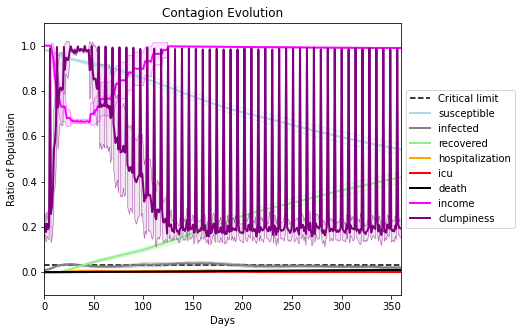

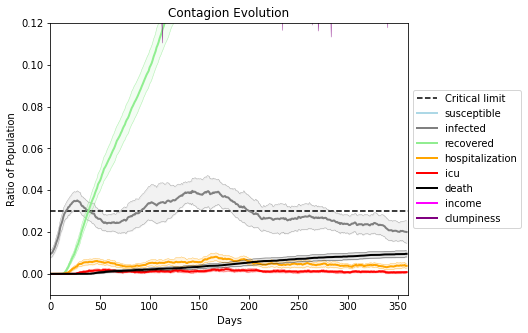

In [6]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.998
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[4281, 2876, 9756, 2360, 357, 9499, 1418, 9036, 8593, 8696, 821, 2442, 4099, 5164, 9750, 223, 7608, 1287, 5074, 2538]
Average similarity between family members is 0.9584032843966843 at temperature -0.9975
Average similarity between family and home is 0.9998521837232297 at temperature -1
Average similarity between students and their classroom is 0.6524488533447808 at temperature -0.9975
Average classroom occupancy is 4.296875 and number classrooms is 64
Average similarity between workers is 0.9471380760856317 at temperature -0.9975
Average office occupancy is 3.5789473684210527 and number offices is 190
Average friend similarity for adults: 0.8653927599877342 for kids: 0.7083747180440643
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homo

avg restaurant similarity 0.5979188795548991
avg restaurant similarity 0.5975595241996388
avg restaurant similarity 0.5663687006580271
avg restaurant similarity 0.6114788850790984
avg restaurant similarity 0.6846547062530153
avg restaurant similarity 0.6564581394164074
avg restaurant similarity 0.7061488310366925
avg restaurant similarity 0.6595350002950212
avg restaurant similarity 0.623305497801299
avg restaurant similarity 0.5892085123048074
avg restaurant similarity 0.6821679982314796
avg restaurant similarity 0.5799544222941962
avg restaurant similarity 0.6540742056222435
avg restaurant similarity 0.6523231999468472
avg restaurant similarity 0.5988625843057127
avg restaurant similarity 0.6804901874700308
avg restaurant similarity 0.5912245480163576
avg restaurant similarity 0.6210913258736981
avg restaurant similarity 0.6513780411633268
avg restaurant similarity 0.5964680783603458
avg restaurant similarity 0.6212708130793905
avg restaurant similarity 0.6125964102958001
avg restaur

avg restaurant similarity 0.6178704950873921
avg restaurant similarity 0.5621507119431065
avg restaurant similarity 0.5426754988486568
avg restaurant similarity 0.6071019157333982
avg restaurant similarity 0.5682023323481473
avg restaurant similarity 0.5841304426867295
avg restaurant similarity 0.557711383802891
avg restaurant similarity 0.5862903702856975
avg restaurant similarity 0.6136644951461491
avg restaurant similarity 0.6465280218924275
avg restaurant similarity 0.5703584585261224
avg restaurant similarity 0.4929702201522004
avg restaurant similarity 0.6062516643950594
avg restaurant similarity 0.5962972576923727
avg restaurant similarity 0.5886478098548902
avg restaurant similarity 0.5909514430515146
avg restaurant similarity 0.6330765161077743
avg restaurant similarity 0.6084374885868877
avg restaurant similarity 0.578658946380008
avg restaurant similarity 0.5901098461474078
avg restaurant similarity 0.5925614955107299
avg restaurant similarity 0.6092248295980406
avg restaura

avg restaurant similarity 0.6488591860498647
avg restaurant similarity 0.6663513761634124
avg restaurant similarity 0.6876906609737299
avg restaurant similarity 0.6536857580937012
avg restaurant similarity 0.6676124958192876
avg restaurant similarity 0.6226998000340652
avg restaurant similarity 0.6452400300895104
avg restaurant similarity 0.6266861644779905
avg restaurant similarity 0.6194591948699545
avg restaurant similarity 0.6889903304928848
avg restaurant similarity 0.6315108282031907
avg restaurant similarity 0.7180977479105254
avg restaurant similarity 0.6988883654244316
avg restaurant similarity 0.656585144747095
avg restaurant similarity 0.6306739185114699
avg restaurant similarity 0.6553681509702483
avg restaurant similarity 0.6679743134740785
avg restaurant similarity 0.6561131288696517
avg restaurant similarity 0.6625668824581349
avg restaurant similarity 0.6469899710972162
avg restaurant similarity 0.6363431093587741
avg restaurant similarity 0.6733989846897126
avg restaur

avg restaurant similarity 0.6641610911239797
avg restaurant similarity 0.6683294636272619
avg restaurant similarity 0.6360498864755417
avg restaurant similarity 0.6400543370138413
avg restaurant similarity 0.6757743266936388
avg restaurant similarity 0.6715902186378127
avg restaurant similarity 0.6917452798435132
avg restaurant similarity 0.6637862454939384
avg restaurant similarity 0.6417012112408055
avg restaurant similarity 0.6754214832343872
avg restaurant similarity 0.6411888687219823
avg restaurant similarity 0.6648443890199439
avg restaurant similarity 0.6516225789751728
avg restaurant similarity 0.6681296245830861
avg restaurant similarity 0.6523477244894802
avg restaurant similarity 0.6803108786922625
avg restaurant similarity 0.6513526694342354
avg restaurant similarity 0.631990389171698
avg restaurant similarity 0.6600029370140449
avg restaurant similarity 0.641432703272024
avg restaurant similarity 0.6284200398199097
avg restaurant similarity 0.6485958976121398
avg restaura

avg restaurant similarity 0.6044593718730601
avg restaurant similarity 0.5829773851407126
avg restaurant similarity 0.5954800166425295
avg restaurant similarity 0.6120246770344313
avg restaurant similarity 0.6038753368330482
avg restaurant similarity 0.6482175699039565
avg restaurant similarity 0.6095500267359988
avg restaurant similarity 0.6071529888421282
avg restaurant similarity 0.5997306913767211
avg restaurant similarity 0.6023614242917361
avg restaurant similarity 0.6361282427110841
avg restaurant similarity 0.5953877956148508
avg restaurant similarity 0.5925093105589812
avg restaurant similarity 0.6082355911536105
avg restaurant similarity 0.5814701125785062
avg restaurant similarity 0.5567518212489961
avg restaurant similarity 0.5797497057132882
avg restaurant similarity 0.583715570121734
avg restaurant similarity 0.6462962119499704
avg restaurant similarity 0.524164276526064
avg restaurant similarity 0.5526018379850404
avg restaurant similarity 0.6077629426326576
avg restaura

avg restaurant similarity 0.5265203024070947
avg restaurant similarity 0.5432238327341843
avg restaurant similarity 0.6276518631524849
avg restaurant similarity 0.5438174149979624
avg restaurant similarity 0.5851913918657656
avg restaurant similarity 0.5869164007919155
avg restaurant similarity 0.5815760038071266
avg restaurant similarity 0.5901982818716114
avg restaurant similarity 0.5107606479679525
avg restaurant similarity 0.6197284490578693
avg restaurant similarity 0.5882674294207975
avg restaurant similarity 0.6071399736642201
avg restaurant similarity 0.5554601017798884
avg restaurant similarity 0.6203210643071988
avg restaurant similarity 0.6288185417981149
avg restaurant similarity 0.6575688638904245
avg restaurant similarity 0.5934633088561455
avg restaurant similarity 0.5881272056335983
avg restaurant similarity 0.5937453327770824
avg restaurant similarity 0.628298154643317
avg restaurant similarity 0.5797196058196434
avg restaurant similarity 0.6372046501374555
avg restaur

avg restaurant similarity 0.6498766345010567
avg restaurant similarity 0.6303427903450601
avg restaurant similarity 0.6489861940898298
avg restaurant similarity 0.6267468794921638
avg restaurant similarity 0.7110628081859222
avg restaurant similarity 0.6070186672027051
avg restaurant similarity 0.6806000547226871
avg restaurant similarity 0.6305061972913342
avg restaurant similarity 0.5962323843154077
avg restaurant similarity 0.6529429125447169
avg restaurant similarity 0.6652186104294826
avg restaurant similarity 0.6050775632627697
avg restaurant similarity 0.6177830151279549
avg restaurant similarity 0.6645915648938279
avg restaurant similarity 0.6476122146164723
avg restaurant similarity 0.6400197315802174
avg restaurant similarity 0.6836855480627998
avg restaurant similarity 0.6474330259511842
avg restaurant similarity 0.6399044659424877
avg restaurant similarity 0.6240193648737254
avg restaurant similarity 0.6232642545609282
avg restaurant similarity 0.6540465226967006
avg restau

avg restaurant similarity 0.6698762114814799
avg restaurant similarity 0.6633938842153554
avg restaurant similarity 0.6624009251570407
avg restaurant similarity 0.6126994116248278
avg restaurant similarity 0.5744451621148315
avg restaurant similarity 0.6118887084471427
avg restaurant similarity 0.6366583178595683
avg restaurant similarity 0.5928555122385252
avg restaurant similarity 0.6532062495901602
avg restaurant similarity 0.5573036485433394
avg restaurant similarity 0.6337609396992718
avg restaurant similarity 0.6626140352240902
avg restaurant similarity 0.6087309818833545
avg restaurant similarity 0.5837825609826561
avg restaurant similarity 0.651836613250842
avg restaurant similarity 0.5930317192086223
avg restaurant similarity 0.6119377414962365
avg restaurant similarity 0.5868761887224453
avg restaurant similarity 0.6010309339622192
avg restaurant similarity 0.5943097412597853
avg restaurant similarity 0.6041918593929254
avg restaurant similarity 0.6065975403953974
avg restaur

avg restaurant similarity 0.642690076669817
avg restaurant similarity 0.6692643984016523
avg restaurant similarity 0.6817947012670436
avg restaurant similarity 0.6960778610450324
avg restaurant similarity 0.6620793170034373
avg restaurant similarity 0.659492365200629
avg restaurant similarity 0.6876817093056588
avg restaurant similarity 0.6596843186815974
avg restaurant similarity 0.646313692988809
avg restaurant similarity 0.6135570205156292
avg restaurant similarity 0.7144143768714919
avg restaurant similarity 0.6537663876283399
avg restaurant similarity 0.6566670108159475
avg restaurant similarity 0.691165783212223
avg restaurant similarity 0.72008093341795
avg restaurant similarity 0.6632958067107745
avg restaurant similarity 0.64344781762728
avg restaurant similarity 0.6864572584119151
avg restaurant similarity 0.6836039304209457
avg restaurant similarity 0.6915448662464715
avg restaurant similarity 0.6866586358155948
avg restaurant similarity 0.6631712968418542
avg restaurant sim

avg restaurant similarity 0.6662004785443537
avg restaurant similarity 0.669870259149554
avg restaurant similarity 0.658289477927926
avg restaurant similarity 0.6657192488169774
avg restaurant similarity 0.6703598966869859
avg restaurant similarity 0.6058693625641469
avg restaurant similarity 0.6374485987391219
avg restaurant similarity 0.6549307959493647
avg restaurant similarity 0.6815609228596308
avg restaurant similarity 0.666720075668937
avg restaurant similarity 0.6716936841453872
avg restaurant similarity 0.6660939820097165
avg restaurant similarity 0.6277161245784003
avg restaurant similarity 0.6399801133972662
avg restaurant similarity 0.7244899637298944
avg restaurant similarity 0.6826344830869491
avg restaurant similarity 0.6747767488303019
avg restaurant similarity 0.6856469795211448
avg restaurant similarity 0.6564251713239748
avg restaurant similarity 0.6763340553598234
avg restaurant similarity 0.7052674797763026
avg restaurant similarity 0.6316959602860501
avg restauran

avg restaurant similarity 0.6151352291520151
avg restaurant similarity 0.5891843386894987
avg restaurant similarity 0.601941921716955
avg restaurant similarity 0.6389538658894012
avg restaurant similarity 0.6040396991249839
avg restaurant similarity 0.6690615957685696
avg restaurant similarity 0.6227701874273079
avg restaurant similarity 0.587444307823815
avg restaurant similarity 0.6647323075278204
avg restaurant similarity 0.6467307751914423
avg restaurant similarity 0.6380681824542793
avg restaurant similarity 0.6370684513114773
avg restaurant similarity 0.6378920131687723
avg restaurant similarity 0.6085568874772878
avg restaurant similarity 0.6345878961453391
avg restaurant similarity 0.6241759399704585
avg restaurant similarity 0.6300867846015921
avg restaurant similarity 0.6583096567200287
avg restaurant similarity 0.6105604808183929
avg restaurant similarity 0.6184013778533399
avg restaurant similarity 0.6783222142026836
avg restaurant similarity 0.7161430305626523
avg restaura

avg restaurant similarity 0.5612021953855748
avg restaurant similarity 0.6608027448531378
avg restaurant similarity 0.6229678065047608
avg restaurant similarity 0.5265164848594769
avg restaurant similarity 0.6070507186331712
avg restaurant similarity 0.5635038999973488
avg restaurant similarity 0.5772889599876252
avg restaurant similarity 0.6690811118650136
avg restaurant similarity 0.6966603335269951
avg restaurant similarity 0.5907705179474992
avg restaurant similarity 0.564832509589639
avg restaurant similarity 0.5481847879630395
avg restaurant similarity 0.588062881612315
avg restaurant similarity 0.5694763543760113
avg restaurant similarity 0.5549376365698393
avg restaurant similarity 0.6304497870411598
avg restaurant similarity 0.582987630095501
avg restaurant similarity 0.5883652231619533
avg restaurant similarity 0.5181438619633406
avg restaurant similarity 0.683085179431764
avg restaurant similarity 0.651175245578855
avg restaurant similarity 0.6259806740533171
avg restaurant 

avg restaurant similarity 0.6670523257056792
avg restaurant similarity 0.6379589369661719
avg restaurant similarity 0.6130293958199984
avg restaurant similarity 0.6098381275340419
avg restaurant similarity 0.6637281806652202
avg restaurant similarity 0.6235446433904024
avg restaurant similarity 0.6383633341832783
avg restaurant similarity 0.6367256953384766
avg restaurant similarity 0.5973859263013326
avg restaurant similarity 0.6547388140914941
avg restaurant similarity 0.6226464017361933
avg restaurant similarity 0.6734458684700342
avg restaurant similarity 0.6157845412185723
avg restaurant similarity 0.6277674120287091
avg restaurant similarity 0.6665246626063523
avg restaurant similarity 0.6077778164242394
avg restaurant similarity 0.5984498918935112
avg restaurant similarity 0.5559772483675676
avg restaurant similarity 0.6508148217184389
avg restaurant similarity 0.6137955381670855
avg restaurant similarity 0.6246279397455131
avg restaurant similarity 0.5988585227031713
avg restau

avg restaurant similarity 0.6051991000583992
avg restaurant similarity 0.6307051424993599
avg restaurant similarity 0.6070325989194616
avg restaurant similarity 0.5926007165343316
avg restaurant similarity 0.7106780184056407
avg restaurant similarity 0.5919148867943009
avg restaurant similarity 0.6077379110901853
avg restaurant similarity 0.6085800253774747
avg restaurant similarity 0.657633985151852
avg restaurant similarity 0.58960310493206
avg restaurant similarity 0.6009973315747804
avg restaurant similarity 0.583560870166697
avg restaurant similarity 0.6722250615001246
avg restaurant similarity 0.6588401724229728
avg restaurant similarity 0.6305102043178248
avg restaurant similarity 0.6649503539197898
avg restaurant similarity 0.6264279642472365
avg restaurant similarity 0.6471004672149974
avg restaurant similarity 0.6460940673159489
avg restaurant similarity 0.6534644255139651
avg restaurant similarity 0.6308363267020612
avg restaurant similarity 0.6913320797961418
avg restaurant

avg restaurant similarity 0.645307951650628
avg restaurant similarity 0.652932999147906
avg restaurant similarity 0.5914664439805242
avg restaurant similarity 0.650246510729143
avg restaurant similarity 0.6850377238760127
avg restaurant similarity 0.62922081792233
avg restaurant similarity 0.6033416193800893
avg restaurant similarity 0.6462652095578829
avg restaurant similarity 0.6371234669616003
avg restaurant similarity 0.6608962828328545
avg restaurant similarity 0.5660916551219966
avg restaurant similarity 0.6005525640322116
avg restaurant similarity 0.6022735090500306
avg restaurant similarity 0.6512453086168752
avg restaurant similarity 0.6111057124462775
avg restaurant similarity 0.6432903496884754
avg restaurant similarity 0.6545849687786274
avg restaurant similarity 0.6490003764238758
avg restaurant similarity 0.6511423843481271
avg restaurant similarity 0.6258236066075737
avg restaurant similarity 0.609352279846841
avg restaurant similarity 0.616320947539712
avg restaurant si

avg restaurant similarity 0.6590725795605855
avg restaurant similarity 0.6632155640719635
avg restaurant similarity 0.6016833884851857
avg restaurant similarity 0.5820788958218972
avg restaurant similarity 0.6632492366586783
avg restaurant similarity 0.620206961531075
avg restaurant similarity 0.59401603092057
avg restaurant similarity 0.590802912341479
avg restaurant similarity 0.6071899701893007
avg restaurant similarity 0.6453915706127593
avg restaurant similarity 0.6205898067108745
avg restaurant similarity 0.6155841641411552
avg restaurant similarity 0.60255857373335
avg restaurant similarity 0.5884100892994942
avg restaurant similarity 0.6087101707875655
avg restaurant similarity 0.5759195177768531
avg restaurant similarity 0.5763918085090055
avg restaurant similarity 0.6516800919789855
avg restaurant similarity 0.6405268372377725
avg restaurant similarity 0.6041708800914474
avg restaurant similarity 0.5667080233147607
avg restaurant similarity 0.5557681599750383
avg restaurant s

avg restaurant similarity 0.6690098943196635
avg restaurant similarity 0.5900170331667557
avg restaurant similarity 0.6398718611751276
avg restaurant similarity 0.6494047968290332
avg restaurant similarity 0.5902893851802703
avg restaurant similarity 0.5931286190435645
avg restaurant similarity 0.6052477682420998
avg restaurant similarity 0.5797152179754905
avg restaurant similarity 0.6376962695564584
avg restaurant similarity 0.5859708735367894
avg restaurant similarity 0.5995729523984036
avg restaurant similarity 0.5512093961737462
avg restaurant similarity 0.5784373272896551
avg restaurant similarity 0.5813058047270719
avg restaurant similarity 0.6123397236647753
avg restaurant similarity 0.6122451896915951
avg restaurant similarity 0.607793931187379
avg restaurant similarity 0.5832568291937069
avg restaurant similarity 0.6058276618006311
avg restaurant similarity 0.5590149173331495
avg restaurant similarity 0.6016582112725807
avg restaurant similarity 0.5913278223976115
avg restaur

avg restaurant similarity 0.6009241610633053
avg restaurant similarity 0.6398528196881429
avg restaurant similarity 0.598585562327007
avg restaurant similarity 0.5878803574054375
avg restaurant similarity 0.641205000365238
avg restaurant similarity 0.6293209193225472
avg restaurant similarity 0.6686786570990209
avg restaurant similarity 0.6228322359933233
avg restaurant similarity 0.620248343207004
avg restaurant similarity 0.6271304083313021
avg restaurant similarity 0.6344837656438196
avg restaurant similarity 0.5775850070314117
avg restaurant similarity 0.7023813169233983
avg restaurant similarity 0.614562786516506
avg restaurant similarity 0.613611288043295
avg restaurant similarity 0.6349029756793656
avg restaurant similarity 0.6461223442588621
avg restaurant similarity 0.5874370065729483
avg restaurant similarity 0.6067820428877188
avg restaurant similarity 0.5675954529920427
avg restaurant similarity 0.6119911867808591
avg restaurant similarity 0.633221089877044
avg restaurant s

avg restaurant similarity 0.6605940525371381
avg restaurant similarity 0.5898465199365621
avg restaurant similarity 0.6506645148229594
avg restaurant similarity 0.624512027466224
avg restaurant similarity 0.6675632567942703
avg restaurant similarity 0.6371097286501287
avg restaurant similarity 0.6137523946846252
avg restaurant similarity 0.6401478670267825
avg restaurant similarity 0.6126760650913364
avg restaurant similarity 0.6165134045440193
avg restaurant similarity 0.6764600033436704
avg restaurant similarity 0.6363155264721561
avg restaurant similarity 0.6001015087144329
avg restaurant similarity 0.6123269321435432
avg restaurant similarity 0.6072614429190553
avg restaurant similarity 0.661987910755408
avg restaurant similarity 0.5948683938477021
avg restaurant similarity 0.6213963881382876
avg restaurant similarity 0.6299576305730795
avg restaurant similarity 0.5966369476417888
avg restaurant similarity 0.623960731911662
avg restaurant similarity 0.6476807585502513
avg restauran

avg restaurant similarity 0.6209658154997008
avg restaurant similarity 0.6480562004359932
avg restaurant similarity 0.6479284717769171
avg restaurant similarity 0.634096985732246
avg restaurant similarity 0.6248635053482545
avg restaurant similarity 0.6256663009991258
avg restaurant similarity 0.6751865508286218
avg restaurant similarity 0.670387130590191
avg restaurant similarity 0.6248873615418337
avg restaurant similarity 0.6427873615456264
avg restaurant similarity 0.5996211135915908
avg restaurant similarity 0.678054737939639
avg restaurant similarity 0.6003010713039753
avg restaurant similarity 0.6399357644643647
avg restaurant similarity 0.6079343541013618
avg restaurant similarity 0.6897266345866293
avg restaurant similarity 0.5694130672442735
avg restaurant similarity 0.6408469048485758
avg restaurant similarity 0.5966587892866966
avg restaurant similarity 0.6775602725009925
avg restaurant similarity 0.6334106077078429
avg restaurant similarity 0.605831378241409
avg restaurant

avg restaurant similarity 0.694991703804683
avg restaurant similarity 0.6541641145740353
avg restaurant similarity 0.6133164095788688
avg restaurant similarity 0.6277594654717228
avg restaurant similarity 0.6555186467430362
avg restaurant similarity 0.6021907750150644
avg restaurant similarity 0.6936102629564498
avg restaurant similarity 0.6231102516628746
avg restaurant similarity 0.642343685364688
avg restaurant similarity 0.6607168411213536
avg restaurant similarity 0.6395490966266284
avg restaurant similarity 0.6594360923983449
avg restaurant similarity 0.6477464394651122
avg restaurant similarity 0.6426619602111018
avg restaurant similarity 0.5915762236705533
avg restaurant similarity 0.6282695935357572
avg restaurant similarity 0.6701256753772045
avg restaurant similarity 0.6148913294512859
avg restaurant similarity 0.6386382992487992
avg restaurant similarity 0.6265909129555286
avg restaurant similarity 0.7086418268632061
avg restaurant similarity 0.6082210733080535
avg restaura

avg restaurant similarity 0.633272302934448
avg restaurant similarity 0.6966262916833478
avg restaurant similarity 0.6485802595425597
avg restaurant similarity 0.6567833300944906
avg restaurant similarity 0.69146206457438
avg restaurant similarity 0.6421001241917936
avg restaurant similarity 0.6470145478580172
avg restaurant similarity 0.6392441399972022
avg restaurant similarity 0.625743927605024
avg restaurant similarity 0.5985915036485566
avg restaurant similarity 0.6321941791256133
avg restaurant similarity 0.6423616390182232
avg restaurant similarity 0.6790442626173736
avg restaurant similarity 0.6469030100623774
avg restaurant similarity 0.6483996640771936
avg restaurant similarity 0.6686043033559733
avg restaurant similarity 0.6819078009725577
avg restaurant similarity 0.6222534222677756
avg restaurant similarity 0.669287274251922
avg restaurant similarity 0.6581346625918968
avg restaurant similarity 0.6773793073264479
avg restaurant similarity 0.64365879916249
avg restaurant si

avg restaurant similarity 0.5905543010425018
avg restaurant similarity 0.6398956988534499
avg restaurant similarity 0.6159667077440208
avg restaurant similarity 0.6710504567210586
avg restaurant similarity 0.5846934770319976
avg restaurant similarity 0.6233459537047804
avg restaurant similarity 0.6417586434404714
avg restaurant similarity 0.6430243319520684
avg restaurant similarity 0.5693725203352741
avg restaurant similarity 0.5824060026788676
avg restaurant similarity 0.5919669795886343
avg restaurant similarity 0.6006116789372021
avg restaurant similarity 0.6713032778793915
avg restaurant similarity 0.586974693000794
avg restaurant similarity 0.6064008833230057
avg restaurant similarity 0.615474647457548
avg restaurant similarity 0.6501266523358888
avg restaurant similarity 0.663677861147707
avg restaurant similarity 0.5675163209687766
avg restaurant similarity 0.6512324167843159
avg restaurant similarity 0.615293206708292
avg restaurant similarity 0.6369335134734454
avg restaurant

avg restaurant similarity 0.6120332902279411
avg restaurant similarity 0.5733974227499178
avg restaurant similarity 0.6506102194424596
avg restaurant similarity 0.6429906936765271
avg restaurant similarity 0.6416682357873722
avg restaurant similarity 0.647338578962096
avg restaurant similarity 0.6033339142290256
avg restaurant similarity 0.6495739911055243
avg restaurant similarity 0.6131912309353093
avg restaurant similarity 0.6032084610964764
avg restaurant similarity 0.6351732993876286
avg restaurant similarity 0.5829665055244927
avg restaurant similarity 0.6793345338913576
avg restaurant similarity 0.6751393238971348
avg restaurant similarity 0.6645316219935419
avg restaurant similarity 0.596667079431931
avg restaurant similarity 0.6072733522102075
avg restaurant similarity 0.5780800666054929
avg restaurant similarity 0.6346765472818486
avg restaurant similarity 0.5936044457698497
avg restaurant similarity 0.6416823586640119
avg restaurant similarity 0.6150055231498365
avg restaura

avg restaurant similarity 0.6183184792829288
avg restaurant similarity 0.5797326691266375
avg restaurant similarity 0.5887368782889755
avg restaurant similarity 0.6056340730629356
avg restaurant similarity 0.6243725848372778
avg restaurant similarity 0.6058527342149134
avg restaurant similarity 0.6171019383804514
avg restaurant similarity 0.5913078912152526
avg restaurant similarity 0.6670664201153389
avg restaurant similarity 0.5783301433077709
avg restaurant similarity 0.6162833392363953
avg restaurant similarity 0.6147125493157685
avg restaurant similarity 0.6219311542634701
avg restaurant similarity 0.6248125915254314
avg restaurant similarity 0.6136936822145564
avg restaurant similarity 0.6073988253356113
avg restaurant similarity 0.6101376259800737
avg restaurant similarity 0.5734164821844149
avg restaurant similarity 0.6152448006696891
avg restaurant similarity 0.5994477281214551
avg restaurant similarity 0.6422216910327972
avg restaurant similarity 0.6299585962170816
avg restau

avg restaurant similarity 0.6598578652541941
avg restaurant similarity 0.6204786579962261
avg restaurant similarity 0.6767515327176276
avg restaurant similarity 0.6006489397526031
avg restaurant similarity 0.6223242077061453
avg restaurant similarity 0.63506186299137
avg restaurant similarity 0.6709567387020765
avg restaurant similarity 0.6424601724352005
avg restaurant similarity 0.6325540069723723
avg restaurant similarity 0.6388896656403672
avg restaurant similarity 0.623856412323534
avg restaurant similarity 0.6227326445304139
avg restaurant similarity 0.634357535069643
avg restaurant similarity 0.6191127799964422
avg restaurant similarity 0.6199423295486698
avg restaurant similarity 0.5886806801064396
avg restaurant similarity 0.634963531881747
avg restaurant similarity 0.552416106625458
avg restaurant similarity 0.5934898700667087
avg restaurant similarity 0.6226171965842237
avg restaurant similarity 0.6211623123533683
avg restaurant similarity 0.6569876741665491
avg restaurant s

avg restaurant similarity 0.624881721884939
avg restaurant similarity 0.6398777015288731
avg restaurant similarity 0.6528552437562554
avg restaurant similarity 0.6875255429072946
avg restaurant similarity 0.6298517756294114
avg restaurant similarity 0.6496668614491297
avg restaurant similarity 0.636498106987839
avg restaurant similarity 0.6209199204430241
avg restaurant similarity 0.5921092572237532
avg restaurant similarity 0.5780059136594081
avg restaurant similarity 0.6515353742053904
avg restaurant similarity 0.6286498656183866
avg restaurant similarity 0.6975809893572829
avg restaurant similarity 0.6543145840184509
avg restaurant similarity 0.64698016286331
avg restaurant similarity 0.6456283042188792
avg restaurant similarity 0.6666101707877705
avg restaurant similarity 0.6386939569051026
avg restaurant similarity 0.6901133266458835
avg restaurant similarity 0.6168933117973245
avg restaurant similarity 0.6548040144412158
avg restaurant similarity 0.6351336461733929
avg restaurant

avg restaurant similarity 0.6513610764164492
avg restaurant similarity 0.6334419927223273
avg restaurant similarity 0.7043763965188835
avg restaurant similarity 0.6304609306779844
avg restaurant similarity 0.6502318063260174
avg restaurant similarity 0.6480902951028559
avg restaurant similarity 0.6712843998541745
avg restaurant similarity 0.6747143457899867
avg restaurant similarity 0.6242618452245396
avg restaurant similarity 0.6208348906488563
avg restaurant similarity 0.663983957542007
avg restaurant similarity 0.6387148561761595
avg restaurant similarity 0.6499121506474472
avg restaurant similarity 0.6794546824415019
avg restaurant similarity 0.6460565469669511
avg restaurant similarity 0.6566191732127452
avg restaurant similarity 0.6368022122120378
avg restaurant similarity 0.6996287732148939
avg restaurant similarity 0.612097155496205
avg restaurant similarity 0.6876736433440483
avg restaurant similarity 0.6722854458831578
avg restaurant similarity 0.6876889945684024
avg restaura

avg restaurant similarity 0.6234702668088452
avg restaurant similarity 0.6318310954624748
avg restaurant similarity 0.6169077182181281
avg restaurant similarity 0.6201635578265001
avg restaurant similarity 0.6409061110519911
avg restaurant similarity 0.5917412596774206
avg restaurant similarity 0.6285487843036993
avg restaurant similarity 0.6153302986930158
avg restaurant similarity 0.6427763681539445
avg restaurant similarity 0.6111310951875751
avg restaurant similarity 0.6050549350484179
avg restaurant similarity 0.6345490089093683
avg restaurant similarity 0.6302602498111977
avg restaurant similarity 0.696593272155189
avg restaurant similarity 0.6456358738914019
avg restaurant similarity 0.5958813962782298
avg restaurant similarity 0.6404861019443467
avg restaurant similarity 0.652355201746477
avg restaurant similarity 0.6410005620360332
avg restaurant similarity 0.5827938396806814
avg restaurant similarity 0.6074132896596718
avg restaurant similarity 0.6331311031480203
avg restaura

avg restaurant similarity 0.6504300913144786
avg restaurant similarity 0.7021664444401404
avg restaurant similarity 0.6463261521820354
avg restaurant similarity 0.6336573741169731
avg restaurant similarity 0.6131887362522609
avg restaurant similarity 0.6361942709808434
avg restaurant similarity 0.6308240392157328
avg restaurant similarity 0.6491498876719093
avg restaurant similarity 0.6206986440367567
avg restaurant similarity 0.7246795662359501
avg restaurant similarity 0.6339879739650551
avg restaurant similarity 0.5744766582768118
avg restaurant similarity 0.6363984073336484
avg restaurant similarity 0.6905426497781236
avg restaurant similarity 0.6100939381542811
avg restaurant similarity 0.6167816101042061
avg restaurant similarity 0.666627872155747
avg restaurant similarity 0.6337967472963724
avg restaurant similarity 0.6364198499335479
avg restaurant similarity 0.6083027252764522
avg restaurant similarity 0.6175587836710245
avg restaurant similarity 0.6811492726149182
avg restaur

avg restaurant similarity 0.6497571734217278
avg restaurant similarity 0.6368539213204403
avg restaurant similarity 0.6659233304076292
avg restaurant similarity 0.66357195780702
avg restaurant similarity 0.6532125756518741
avg restaurant similarity 0.6449181961488055
avg restaurant similarity 0.571008197895415
avg restaurant similarity 0.6396758276710314
avg restaurant similarity 0.6276711607471214
avg restaurant similarity 0.5929610858953532
avg restaurant similarity 0.5991140901744307
avg restaurant similarity 0.6149132648728634
avg restaurant similarity 0.5866097992729715
avg restaurant similarity 0.6240237686245527
avg restaurant similarity 0.591360705741596
avg restaurant similarity 0.607873639446579
avg restaurant similarity 0.6196535016319692
avg restaurant similarity 0.6269322883221708
avg restaurant similarity 0.607141695752626
avg restaurant similarity 0.6366552957634567
avg restaurant similarity 0.6452752510316985
avg restaurant similarity 0.6426327917140264
avg restaurant s

avg restaurant similarity 0.6626280842502525
avg restaurant similarity 0.6714068091324067
avg restaurant similarity 0.6969915562087293
avg restaurant similarity 0.6441687109729184
avg restaurant similarity 0.7015131760376523
avg restaurant similarity 0.6688447221062513
avg restaurant similarity 0.6658543878739658
avg restaurant similarity 0.6441927507423865
avg restaurant similarity 0.6663010004725444
avg restaurant similarity 0.6592476131642276
avg restaurant similarity 0.5962703452514777
avg restaurant similarity 0.6102125056962133
avg restaurant similarity 0.6549583719864494
avg restaurant similarity 0.5689120672117358
avg restaurant similarity 0.6188810314597352
avg restaurant similarity 0.6075409573985013
avg restaurant similarity 0.6408305695127623
avg restaurant similarity 0.6049905348868057
avg restaurant similarity 0.6051326586706304
avg restaurant similarity 0.5705645242682988
avg restaurant similarity 0.6200318855943898
avg restaurant similarity 0.6059903013180118
avg restau

avg restaurant similarity 0.5394784020517176
avg restaurant similarity 0.5989734467390536
avg restaurant similarity 0.5848689452351629
avg restaurant similarity 0.5300550123499
avg restaurant similarity 0.5542629332440706
avg restaurant similarity 0.5464654989320132
avg restaurant similarity 0.6160605045405618
avg restaurant similarity 0.5944810648940545
avg restaurant similarity 0.5869319475951895
avg restaurant similarity 0.5760346498319286
avg restaurant similarity 0.5595059246619182
avg restaurant similarity 0.5417088654920125
avg restaurant similarity 0.5734162113024668
avg restaurant similarity 0.5619693560632409
avg restaurant similarity 0.6407182097125609
avg restaurant similarity 0.6319465387309997
avg restaurant similarity 0.5639900793256238
avg restaurant similarity 0.5934509142135649
avg restaurant similarity 0.6248358155895336
avg restaurant similarity 0.5740039667368768
avg restaurant similarity 0.6551492796885956
avg restaurant similarity 0.6221459162331796
avg restauran

avg restaurant similarity 0.5872813761068317
avg restaurant similarity 0.6069533397146555
avg restaurant similarity 0.5818713906132089
avg restaurant similarity 0.5875871145118629
avg restaurant similarity 0.6037905602364756
avg restaurant similarity 0.6924635872299862
avg restaurant similarity 0.576523163897295
avg restaurant similarity 0.5995074295361172
avg restaurant similarity 0.6414104810079408
avg restaurant similarity 0.5491273661629893
avg restaurant similarity 0.595046874967104
avg restaurant similarity 0.5404332760304753
avg restaurant similarity 0.613126452359444
avg restaurant similarity 0.613795562347619
avg restaurant similarity 0.57153946776822
avg restaurant similarity 0.6205384623443155
avg restaurant similarity 0.6221580520171646
avg restaurant similarity 0.6270424583923563
avg restaurant similarity 0.5810286579394229
avg restaurant similarity 0.6583186180966198
avg restaurant similarity 0.6227482566113904
avg restaurant similarity 0.5627556111534741
avg restaurant s

avg restaurant similarity 0.6343800742803346
avg restaurant similarity 0.5932984760514263
avg restaurant similarity 0.6067625915980999
avg restaurant similarity 0.6043238807023084
avg restaurant similarity 0.6566319779655723
avg restaurant similarity 0.621422175252324
avg restaurant similarity 0.6438111222111647
avg restaurant similarity 0.6094329671655516
avg restaurant similarity 0.6277111720440592
avg restaurant similarity 0.6135103099240866
avg restaurant similarity 0.6402040980481356
avg restaurant similarity 0.5588517539683825
avg restaurant similarity 0.6106638690740163
avg restaurant similarity 0.5940182235661302
avg restaurant similarity 0.6018710156709908
avg restaurant similarity 0.5693144388452959
avg restaurant similarity 0.6020362563940723
avg restaurant similarity 0.5623308839280597
avg restaurant similarity 0.5824569474732039
avg restaurant similarity 0.6220505825667094
avg restaurant similarity 0.6381188791886127
avg restaurant similarity 0.6022134224482247
avg restaur

avg restaurant similarity 0.5800928970300259
avg restaurant similarity 0.6231256284041964
avg restaurant similarity 0.6095307541765027
avg restaurant similarity 0.6042601832610417
avg restaurant similarity 0.6234073436604726
avg restaurant similarity 0.607924220059255
avg restaurant similarity 0.6239044275998264
avg restaurant similarity 0.6304772847547173
avg restaurant similarity 0.6627691676359228
avg restaurant similarity 0.5978972962068722
avg restaurant similarity 0.6052599858638186
avg restaurant similarity 0.6158129248819076
avg restaurant similarity 0.5925523240368624
avg restaurant similarity 0.6285577663243145
avg restaurant similarity 0.6086282770891452
avg restaurant similarity 0.6349473605829998
avg restaurant similarity 0.5780392891148941
avg restaurant similarity 0.6072521303494282
avg restaurant similarity 0.6301589499213098
avg restaurant similarity 0.6495503712975844
avg restaurant similarity 0.5691289113675843
avg restaurant similarity 0.6135893877281363
avg restaur

avg restaurant similarity 0.6663971561254493
avg restaurant similarity 0.6246881510745447
avg restaurant similarity 0.6445351735385999
avg restaurant similarity 0.6433782780118009
avg restaurant similarity 0.6277416279413762
avg restaurant similarity 0.641425859261278
avg restaurant similarity 0.634622697185894
avg restaurant similarity 0.6306367023996486
avg restaurant similarity 0.6751498208793074
avg restaurant similarity 0.6338999852863321
avg restaurant similarity 0.6561934635531868
avg restaurant similarity 0.6485268642495198
avg restaurant similarity 0.6264838726623512
avg restaurant similarity 0.64312784816676
avg restaurant similarity 0.6311072789675607
avg restaurant similarity 0.6558747182530619
avg restaurant similarity 0.626688306541247
avg restaurant similarity 0.6511623082887131
avg restaurant similarity 0.6496077448297548
avg restaurant similarity 0.6269667782554182
avg restaurant similarity 0.6269118673156332
avg restaurant similarity 0.6484306317593411
avg restaurant 

avg restaurant similarity 0.6510436711136918
avg restaurant similarity 0.6790775101228328
avg restaurant similarity 0.685880951848635
avg restaurant similarity 0.7187309263142496
avg restaurant similarity 0.6610945885905937
avg restaurant similarity 0.6488278692981115
avg restaurant similarity 0.6708002099397596
avg restaurant similarity 0.699110531253264
avg restaurant similarity 0.6869739023417929
avg restaurant similarity 0.7008487304396136
avg restaurant similarity 0.6362665756449718
avg restaurant similarity 0.686899012313867
avg restaurant similarity 0.6244107953239789
avg restaurant similarity 0.6681474082598671
avg restaurant similarity 0.6848354263560269
avg restaurant similarity 0.6710487891723638
avg restaurant similarity 0.6678549966594339
avg restaurant similarity 0.6962899612037267
avg restaurant similarity 0.682760071127529
avg restaurant similarity 0.6350755589991849
avg restaurant similarity 0.6662123300365249
avg restaurant similarity 0.6953199214190483
avg restaurant

avg restaurant similarity 0.6785563515913999
avg restaurant similarity 0.6511791425646508
avg restaurant similarity 0.6647545607219285
avg restaurant similarity 0.6522969174470508
avg restaurant similarity 0.6570090312634793
avg restaurant similarity 0.6478485180663918
avg restaurant similarity 0.6955531153090904
avg restaurant similarity 0.6299802991359182
avg restaurant similarity 0.6683702846632171
avg restaurant similarity 0.6267441113403046
avg restaurant similarity 0.7022608393696668
avg restaurant similarity 0.6495894970639838
avg restaurant similarity 0.637516361530603
avg restaurant similarity 0.6150353759151347
avg restaurant similarity 0.6627741687005155
avg restaurant similarity 0.6918002916479982
avg restaurant similarity 0.6848497082021281
avg restaurant similarity 0.6641361702514923
avg restaurant similarity 0.6644277865864857
avg restaurant similarity 0.6851862911458182
avg restaurant similarity 0.6630859604495438
avg restaurant similarity 0.6519361799485824
avg restaur

avg restaurant similarity 0.6316382410412481
avg restaurant similarity 0.6786602558788083
avg restaurant similarity 0.6627955253389468
avg restaurant similarity 0.7002194890920008
avg restaurant similarity 0.6490771519469274
avg restaurant similarity 0.6651491943210024
avg restaurant similarity 0.6219998240483456
avg restaurant similarity 0.6416306278441151
avg restaurant similarity 0.6860277439766741
avg restaurant similarity 0.696775457574639
avg restaurant similarity 0.6479001086880923
avg restaurant similarity 0.6747611922858769
avg restaurant similarity 0.6549177826792132
avg restaurant similarity 0.6464012351474396
avg restaurant similarity 0.6657493745144435
avg restaurant similarity 0.654991391282172
avg restaurant similarity 0.6864537219278822
avg restaurant similarity 0.6558441229126476
avg restaurant similarity 0.6567514282679473
avg restaurant similarity 0.6511027522684101
avg restaurant similarity 0.5890228361248544
avg restaurant similarity 0.6023264423817406
avg restaura

(<function dict.items>, <function dict.items>, <function dict.items>)

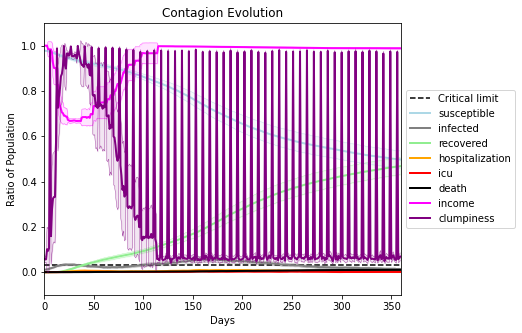

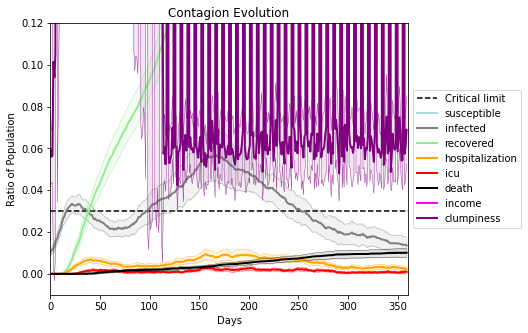

In [7]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.9975
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[4769, 2173, 6179, 2662, 4032, 9906, 9424, 6991, 6229, 3214, 783, 1031, 163, 2371, 8831, 5552, 824, 5859, 2324, 9074]
Average similarity between family members is 0.9496527849446542 at temperature -0.997
Average similarity between family and home is 0.9998588755214253 at temperature -1
Average similarity between students and their classroom is 0.6483968060770227 at temperature -0.997
Average classroom occupancy is 4.246376811594203 and number classrooms is 69
Average similarity between workers is 0.9342995324697879 at temperature -0.997
Average office occupancy is 3.3333333333333335 and number offices is 195
Average friend similarity for adults: 0.8493620803774535 for kids: 0.6955970784244733
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings


avg restaurant similarity 0.5805076415308998
avg restaurant similarity 0.5793668395263506
avg restaurant similarity 0.5802609104152208
avg restaurant similarity 0.6375967068737108
avg restaurant similarity 0.5897754926134563
avg restaurant similarity 0.6120184082724266
avg restaurant similarity 0.6384909306921722
avg restaurant similarity 0.581475278651759
avg restaurant similarity 0.6374069982978162
avg restaurant similarity 0.5809939779463883
avg restaurant similarity 0.6067065635681118
avg restaurant similarity 0.5955475728734497
avg restaurant similarity 0.5817575329333385
avg restaurant similarity 0.6174472375749355
avg restaurant similarity 0.6265010603383324
avg restaurant similarity 0.6013137124922016
avg restaurant similarity 0.5841997443961925
avg restaurant similarity 0.6707498012591163
avg restaurant similarity 0.5790199517476129
avg restaurant similarity 0.6399080430279855
avg restaurant similarity 0.5691182354853673
avg restaurant similarity 0.6415326747471098
avg restaur

avg restaurant similarity 0.6312256277287797
avg restaurant similarity 0.6054647436775641
avg restaurant similarity 0.5824541560103985
avg restaurant similarity 0.6782787328483051
avg restaurant similarity 0.6350639458650017
avg restaurant similarity 0.6691327854507533
avg restaurant similarity 0.5899933771630508
avg restaurant similarity 0.5692072933121459
avg restaurant similarity 0.6250458632921712
avg restaurant similarity 0.5928236038594146
avg restaurant similarity 0.6092193004425098
avg restaurant similarity 0.6504122193374802
avg restaurant similarity 0.6549978016707956
avg restaurant similarity 0.595369622525491
avg restaurant similarity 0.6260586339110228
avg restaurant similarity 0.6245955135896978
avg restaurant similarity 0.6442432761652694
avg restaurant similarity 0.6364397456483861
avg restaurant similarity 0.6134414917048712
avg restaurant similarity 0.6528272703323466
avg restaurant similarity 0.6384029862881814
avg restaurant similarity 0.6511756258732737
avg restaur

avg restaurant similarity 0.6361619686205531
avg restaurant similarity 0.64545847681455
avg restaurant similarity 0.5883359586762631
avg restaurant similarity 0.6332235976415029
avg restaurant similarity 0.6127181204000955
avg restaurant similarity 0.6106842368605843
avg restaurant similarity 0.6035241385984997
avg restaurant similarity 0.644101982814585
avg restaurant similarity 0.5891582576970087
avg restaurant similarity 0.6615842995507595
avg restaurant similarity 0.6474327792477138
avg restaurant similarity 0.629562902373894
avg restaurant similarity 0.6313638315962268
avg restaurant similarity 0.6136768647448132
avg restaurant similarity 0.6030240345797956
avg restaurant similarity 0.6635178323676753
avg restaurant similarity 0.6195965956864097
avg restaurant similarity 0.5781284068800149
avg restaurant similarity 0.6478583786336215
avg restaurant similarity 0.6251343055227222
avg restaurant similarity 0.6075140461481546
avg restaurant similarity 0.6285839534125245
avg restaurant

avg restaurant similarity 0.6410040341942841
avg restaurant similarity 0.6227114371179923
avg restaurant similarity 0.6005476399053788
avg restaurant similarity 0.6394564901919658
avg restaurant similarity 0.6071724152653529
avg restaurant similarity 0.6350625090177296
avg restaurant similarity 0.6145759185612821
avg restaurant similarity 0.6528045080049397
avg restaurant similarity 0.6049936995935716
avg restaurant similarity 0.6143408516313466
avg restaurant similarity 0.5779172053225302
avg restaurant similarity 0.5835593151825206
avg restaurant similarity 0.5646977936183375
avg restaurant similarity 0.5971447750469203
avg restaurant similarity 0.6077348449819966
avg restaurant similarity 0.5905889042773312
avg restaurant similarity 0.614668494479763
avg restaurant similarity 0.5955518284845847
avg restaurant similarity 0.6114004189674568
avg restaurant similarity 0.6224361380401361
avg restaurant similarity 0.6589539198328034
avg restaurant similarity 0.6288590197833344
avg restaur

avg restaurant similarity 0.6037835409988526
avg restaurant similarity 0.5774603600931218
avg restaurant similarity 0.6135754911011072
avg restaurant similarity 0.5927350855192116
avg restaurant similarity 0.6243130941487433
avg restaurant similarity 0.6656192264622969
avg restaurant similarity 0.6279819482363433
avg restaurant similarity 0.6109355550003713
avg restaurant similarity 0.6299792298470681
avg restaurant similarity 0.578918554790572
avg restaurant similarity 0.6632377691206057
avg restaurant similarity 0.6287441310779999
avg restaurant similarity 0.6201130414197861
avg restaurant similarity 0.5880643610188862
avg restaurant similarity 0.6172699502526212
avg restaurant similarity 0.6028821425429685
avg restaurant similarity 0.6095219924164113
avg restaurant similarity 0.6247479863036622
avg restaurant similarity 0.6029876450815296
avg restaurant similarity 0.648937588049737
avg restaurant similarity 0.6949288263648483
avg restaurant similarity 0.6170927543547785
avg restaura

avg restaurant similarity 0.5805417109321668
avg restaurant similarity 0.5674593389164005
avg restaurant similarity 0.5976839299138831
avg restaurant similarity 0.6296193289669887
avg restaurant similarity 0.5576551737385789
avg restaurant similarity 0.6139073426858158
avg restaurant similarity 0.6461279000799173
avg restaurant similarity 0.5839158433401593
avg restaurant similarity 0.594393307568772
avg restaurant similarity 0.6474063867558862
avg restaurant similarity 0.6045690042023195
avg restaurant similarity 0.5962406274814296
avg restaurant similarity 0.6305714714161006
avg restaurant similarity 0.6248342882024533
avg restaurant similarity 0.6476573380985281
avg restaurant similarity 0.6640591362961048
avg restaurant similarity 0.605684010635279
avg restaurant similarity 0.5808061965123296
avg restaurant similarity 0.5952188290605354
avg restaurant similarity 0.5787366618540019
avg restaurant similarity 0.603132872547377
avg restaurant similarity 0.6260398653821779
avg restauran

avg restaurant similarity 0.65777606674602
avg restaurant similarity 0.6417311591634753
avg restaurant similarity 0.6374188592574358
avg restaurant similarity 0.6615300762654542
avg restaurant similarity 0.6145571605034588
avg restaurant similarity 0.6910046524769267
avg restaurant similarity 0.6194649532072667
avg restaurant similarity 0.5606542448428848
avg restaurant similarity 0.6075363437868069
avg restaurant similarity 0.6278945819242138
avg restaurant similarity 0.6978401235940842
avg restaurant similarity 0.6352856790919026
avg restaurant similarity 0.646805892154295
avg restaurant similarity 0.6175045026144423
avg restaurant similarity 0.6246189278798547
avg restaurant similarity 0.6242027382889576
avg restaurant similarity 0.6583640959086083
avg restaurant similarity 0.6556899676822588
avg restaurant similarity 0.6656584392660077
avg restaurant similarity 0.6563528270237591
avg restaurant similarity 0.7076856356729987
avg restaurant similarity 0.7019795340665312
avg restauran

avg restaurant similarity 0.6225954990138366
avg restaurant similarity 0.6117875940150855
avg restaurant similarity 0.6547923583130802
avg restaurant similarity 0.6027741108571081
avg restaurant similarity 0.6623021611758396
avg restaurant similarity 0.6221071428922464
avg restaurant similarity 0.6521265624658348
avg restaurant similarity 0.621196532454027
avg restaurant similarity 0.6794265477018714
avg restaurant similarity 0.6687996661769678
avg restaurant similarity 0.6870302464304533
avg restaurant similarity 0.6502797109893823
avg restaurant similarity 0.6248073280048507
avg restaurant similarity 0.6499512579493325
avg restaurant similarity 0.6381643703280818
avg restaurant similarity 0.6193326459797689
avg restaurant similarity 0.6507034800567807
avg restaurant similarity 0.6290356894952671
avg restaurant similarity 0.6102115630517355
avg restaurant similarity 0.6427345990448771
avg restaurant similarity 0.5900578991243107
avg restaurant similarity 0.6656434778986039
avg restaur

avg restaurant similarity 0.6246787137630578
avg restaurant similarity 0.6586089794118144
avg restaurant similarity 0.6007698914335531
avg restaurant similarity 0.5970519201151885
avg restaurant similarity 0.6202109990154948
avg restaurant similarity 0.6575445279764658
avg restaurant similarity 0.6195008659215974
avg restaurant similarity 0.6448860465657563
avg restaurant similarity 0.6380445716902002
avg restaurant similarity 0.5722573529047709
avg restaurant similarity 0.6114967907505277
avg restaurant similarity 0.6512539212125239
avg restaurant similarity 0.6244329877225144
avg restaurant similarity 0.6053028913248155
avg restaurant similarity 0.6064703045520383
avg restaurant similarity 0.6268498704515216
avg restaurant similarity 0.5635428679921727
avg restaurant similarity 0.6392962880377501
avg restaurant similarity 0.5972295821306849
avg restaurant similarity 0.5755178062718413
avg restaurant similarity 0.6225469011466488
avg restaurant similarity 0.6619594672443749
avg restau

avg restaurant similarity 0.6212558875092672
avg restaurant similarity 0.6339531450380782
avg restaurant similarity 0.5980471364245914
avg restaurant similarity 0.6235643856894832
avg restaurant similarity 0.6102901846771528
avg restaurant similarity 0.6706952391262103
avg restaurant similarity 0.6144516285530687
avg restaurant similarity 0.6624150247392281
avg restaurant similarity 0.5967810099005765
avg restaurant similarity 0.5892222934118956
avg restaurant similarity 0.604775783375218
avg restaurant similarity 0.5813624495861937
avg restaurant similarity 0.6460559833604013
avg restaurant similarity 0.6431649215280169
avg restaurant similarity 0.6070714853076107
avg restaurant similarity 0.6567233252631335
avg restaurant similarity 0.6421433781069928
avg restaurant similarity 0.6056952453230792
avg restaurant similarity 0.6166130936513058
avg restaurant similarity 0.6590952407919438
avg restaurant similarity 0.660948591517306
avg restaurant similarity 0.6700995557133388
avg restaura

avg restaurant similarity 0.6501411979389113
avg restaurant similarity 0.6802185606984615
avg restaurant similarity 0.670179367406161
avg restaurant similarity 0.639328421517276
avg restaurant similarity 0.6854798675939905
avg restaurant similarity 0.6213783115144759
avg restaurant similarity 0.6558550861015121
avg restaurant similarity 0.7253497429806718
avg restaurant similarity 0.6975236501137899
avg restaurant similarity 0.6888513759814062
avg restaurant similarity 0.7051129681709769
avg restaurant similarity 0.6922594577826248
avg restaurant similarity 0.7442395075650022
avg restaurant similarity 0.6409204777279061
avg restaurant similarity 0.6983837028098564
avg restaurant similarity 0.6682716352098569
avg restaurant similarity 0.6636110390432028
avg restaurant similarity 0.6539094170433639
avg restaurant similarity 0.6874606152206023
avg restaurant similarity 0.7254328492744411
avg restaurant similarity 0.7003555230319319
avg restaurant similarity 0.6822302689721425
avg restaura

avg restaurant similarity 0.6156785233441628
avg restaurant similarity 0.6731553843273024
avg restaurant similarity 0.6780942251733827
avg restaurant similarity 0.6497995191876442
avg restaurant similarity 0.6888924706473472
avg restaurant similarity 0.7141646873318549
avg restaurant similarity 0.6823737777162983
avg restaurant similarity 0.620637860521542
avg restaurant similarity 0.662663467738102
avg restaurant similarity 0.6731909310304706
avg restaurant similarity 0.6604819417756322
avg restaurant similarity 0.6356930349297059
avg restaurant similarity 0.6620036754517676
avg restaurant similarity 0.6605382812308113
avg restaurant similarity 0.6865808652769411
avg restaurant similarity 0.6312132847199164
avg restaurant similarity 0.7176288886313457
avg restaurant similarity 0.6541209026042913
avg restaurant similarity 0.7030315222571989
avg restaurant similarity 0.6955579669483901
avg restaurant similarity 0.6541672831605871
avg restaurant similarity 0.6596086588078363
avg restaura

avg restaurant similarity 0.5807360622168543
avg restaurant similarity 0.6320248753842155
avg restaurant similarity 0.6302278972251184
avg restaurant similarity 0.6813450666222515
avg restaurant similarity 0.5941839027969331
avg restaurant similarity 0.6777205666682184
avg restaurant similarity 0.6522794714648964
avg restaurant similarity 0.625712998153245
avg restaurant similarity 0.6461047137209647
avg restaurant similarity 0.5614468913795867
avg restaurant similarity 0.625051779190447
avg restaurant similarity 0.6080333903373548
avg restaurant similarity 0.5832652814901763
avg restaurant similarity 0.6235854908422738
avg restaurant similarity 0.6542180654980165
avg restaurant similarity 0.6794168458111636
avg restaurant similarity 0.6080639861024483
avg restaurant similarity 0.5995917711093408
avg restaurant similarity 0.6650095403846915
avg restaurant similarity 0.6372389560873672
avg restaurant similarity 0.6248409432506639
avg restaurant similarity 0.6477854772988473
avg restaura

avg restaurant similarity 0.57891248479642
avg restaurant similarity 0.6515337655058273
avg restaurant similarity 0.6003128558872227
avg restaurant similarity 0.6532117879814044
avg restaurant similarity 0.5913077872968843
avg restaurant similarity 0.6155731375619555
avg restaurant similarity 0.6542668147934937
avg restaurant similarity 0.6104955060137871
avg restaurant similarity 0.6297257659822877
avg restaurant similarity 0.611113804962375
avg restaurant similarity 0.6133532676447547
avg restaurant similarity 0.6892636138765923
avg restaurant similarity 0.6460183708218457
avg restaurant similarity 0.6460469000603655
avg restaurant similarity 0.6565594996986298
avg restaurant similarity 0.6160936883879208
avg restaurant similarity 0.5824535101094329
avg restaurant similarity 0.687530457911986
avg restaurant similarity 0.5827076299073108
avg restaurant similarity 0.6316302121693176
avg restaurant similarity 0.625560737703944
avg restaurant similarity 0.6096271179931968
avg restaurant 

avg restaurant similarity 0.6042851753218212
avg restaurant similarity 0.6038083852678648
avg restaurant similarity 0.5921038744060597
avg restaurant similarity 0.6275775145682222
avg restaurant similarity 0.5746729928261713
avg restaurant similarity 0.6254710178332283
avg restaurant similarity 0.6132303041069215
avg restaurant similarity 0.605007647573945
avg restaurant similarity 0.6135690029356764
avg restaurant similarity 0.5694322320066416
avg restaurant similarity 0.6032367587864846
avg restaurant similarity 0.6289068258920305
avg restaurant similarity 0.5894221739815803
avg restaurant similarity 0.596776618856571
avg restaurant similarity 0.5667568734327166
avg restaurant similarity 0.6708992903407366
avg restaurant similarity 0.6259947079059
avg restaurant similarity 0.6066816221614417
avg restaurant similarity 0.6192513097850336
avg restaurant similarity 0.5804152302677303
avg restaurant similarity 0.5908570534450791
avg restaurant similarity 0.6025573661986892
avg restaurant 

avg restaurant similarity 0.6156174519951568
avg restaurant similarity 0.6509702691199079
avg restaurant similarity 0.6463777699801783
avg restaurant similarity 0.6558228081033132
avg restaurant similarity 0.6575980551465026
avg restaurant similarity 0.642381841191983
avg restaurant similarity 0.6285459165805464
avg restaurant similarity 0.6388141526436882
avg restaurant similarity 0.644140965339943
avg restaurant similarity 0.5918465856485727
avg restaurant similarity 0.6042536856672295
avg restaurant similarity 0.6036639994332218
avg restaurant similarity 0.6728604906268312
avg restaurant similarity 0.6591589509925316
avg restaurant similarity 0.6401868373818964
avg restaurant similarity 0.6476247758677715
avg restaurant similarity 0.6396345712444836
avg restaurant similarity 0.6158218071436057
avg restaurant similarity 0.6625931982896615
avg restaurant similarity 0.6481223617060262
avg restaurant similarity 0.6127614195435743
avg restaurant similarity 0.6428706170011584
avg restaura

avg restaurant similarity 0.6268924217489719
avg restaurant similarity 0.5967204267489129
avg restaurant similarity 0.6416162988552754
avg restaurant similarity 0.623905373034633
avg restaurant similarity 0.6193359486368746
avg restaurant similarity 0.6468955742131183
avg restaurant similarity 0.6052015700881949
avg restaurant similarity 0.6294313973018364
avg restaurant similarity 0.6692887977382432
avg restaurant similarity 0.6064595696506025
avg restaurant similarity 0.6559900251874825
avg restaurant similarity 0.6507310317885407
avg restaurant similarity 0.6333440748082336
avg restaurant similarity 0.6094790876476318
avg restaurant similarity 0.6755381348729427
avg restaurant similarity 0.6269060565586537
avg restaurant similarity 0.6098223088930655
avg restaurant similarity 0.6378070111364719
avg restaurant similarity 0.62093865840421
avg restaurant similarity 0.588817847658115
avg restaurant similarity 0.6295054482094314
avg restaurant similarity 0.6184473687667449
avg restaurant

avg restaurant similarity 0.6458513009953156
avg restaurant similarity 0.6112709174529298
avg restaurant similarity 0.6265589197907075
avg restaurant similarity 0.5880165861601607
avg restaurant similarity 0.5942040229825551
avg restaurant similarity 0.609371454562416
avg restaurant similarity 0.6507066705645048
avg restaurant similarity 0.5888602543216862
avg restaurant similarity 0.6006722845160031
avg restaurant similarity 0.5947333997630772
avg restaurant similarity 0.6201276102417667
avg restaurant similarity 0.6565397281457604
avg restaurant similarity 0.6167178356545416
avg restaurant similarity 0.6218682766973163
avg restaurant similarity 0.6010113619162709
avg restaurant similarity 0.6529351625787028
avg restaurant similarity 0.6134220922481777
avg restaurant similarity 0.6120441306078135
avg restaurant similarity 0.6530213224702991
avg restaurant similarity 0.6408673771916314
avg restaurant similarity 0.6340003429922667
avg restaurant similarity 0.6077205952142236
avg restaur

avg restaurant similarity 0.6332034093474266
avg restaurant similarity 0.5965010906048702
avg restaurant similarity 0.6462310623210481
avg restaurant similarity 0.6420479217870938
avg restaurant similarity 0.6307809757148651
avg restaurant similarity 0.6650935700879066
avg restaurant similarity 0.590302811458771
avg restaurant similarity 0.6437652094979257
avg restaurant similarity 0.6480805843923041
avg restaurant similarity 0.5987336622528366
avg restaurant similarity 0.6171292449879076
avg restaurant similarity 0.6581931570568461
avg restaurant similarity 0.6111749865920956
avg restaurant similarity 0.5962651063723792
avg restaurant similarity 0.5926494147055842
avg restaurant similarity 0.6638341120016962
avg restaurant similarity 0.6246027867692412
avg restaurant similarity 0.6003895911853895
avg restaurant similarity 0.6527086200283176
avg restaurant similarity 0.6141126569634269
avg restaurant similarity 0.6061763157939127
avg restaurant similarity 0.6498104926326327
avg restaur

avg restaurant similarity 0.5623571141059507
avg restaurant similarity 0.6480375677530842
avg restaurant similarity 0.5997585506863845
avg restaurant similarity 0.5960289622055189
avg restaurant similarity 0.6396719001146717
avg restaurant similarity 0.6396849399206056
avg restaurant similarity 0.6787025940085327
avg restaurant similarity 0.5725197549654846
avg restaurant similarity 0.6487465503625659
avg restaurant similarity 0.6489067740699397
avg restaurant similarity 0.5641998227228474
avg restaurant similarity 0.6321048553314281
avg restaurant similarity 0.5831448178231873
avg restaurant similarity 0.6674153922053915
avg restaurant similarity 0.6530988870261796
avg restaurant similarity 0.661236454985194
avg restaurant similarity 0.6633050533558095
avg restaurant similarity 0.6944759324413857
avg restaurant similarity 0.6489953412288132
avg restaurant similarity 0.6960297298376981
avg restaurant similarity 0.5893653889453576
avg restaurant similarity 0.6421848302635759
avg restaur

avg restaurant similarity 0.5733725071874145
avg restaurant similarity 0.6049748574319146
avg restaurant similarity 0.6404220382835184
avg restaurant similarity 0.6406536197532896
avg restaurant similarity 0.5994631659568764
avg restaurant similarity 0.6285395020021667
avg restaurant similarity 0.6513325149173662
avg restaurant similarity 0.6233730868992313
avg restaurant similarity 0.6258452112029403
avg restaurant similarity 0.6492188672533481
avg restaurant similarity 0.6264811747164767
avg restaurant similarity 0.7011232332202949
avg restaurant similarity 0.6541476735581744
avg restaurant similarity 0.598294354865983
avg restaurant similarity 0.6392637891790655
avg restaurant similarity 0.6463584688235379
avg restaurant similarity 0.6825858301803075
avg restaurant similarity 0.6172133843078638
avg restaurant similarity 0.6432233618762373
avg restaurant similarity 0.6025105363852971
avg restaurant similarity 0.6508286384015908
avg restaurant similarity 0.673570375781276
avg restaura

avg restaurant similarity 0.6248376506820117
avg restaurant similarity 0.6461552926217788
avg restaurant similarity 0.582652903536356
avg restaurant similarity 0.6171442090802962
avg restaurant similarity 0.6452384830888419
avg restaurant similarity 0.5551783427825423
avg restaurant similarity 0.6251510730324302
avg restaurant similarity 0.6104161817424001
avg restaurant similarity 0.6420104847702841
avg restaurant similarity 0.6194471539388622
avg restaurant similarity 0.62444110509275
avg restaurant similarity 0.6329675105488337
avg restaurant similarity 0.6707162778223478
avg restaurant similarity 0.6124521848646037
avg restaurant similarity 0.615249640438984
avg restaurant similarity 0.6671689976654323
avg restaurant similarity 0.621040811687268
avg restaurant similarity 0.6125688360147138
avg restaurant similarity 0.6288994539280877
avg restaurant similarity 0.6261859420290595
avg restaurant similarity 0.6332903773769334
avg restaurant similarity 0.6557566012554751
avg restaurant 

avg restaurant similarity 0.6605865863843199
avg restaurant similarity 0.6104024101064452
avg restaurant similarity 0.6268590909509311
avg restaurant similarity 0.6081255578179734
avg restaurant similarity 0.6538625232902383
avg restaurant similarity 0.6326378649548594
avg restaurant similarity 0.6286040740413418
avg restaurant similarity 0.6181617576765929
avg restaurant similarity 0.613083730168383
avg restaurant similarity 0.6332723136434327
avg restaurant similarity 0.6369265040945028
avg restaurant similarity 0.6313449152547701
avg restaurant similarity 0.6487037417286182
avg restaurant similarity 0.6506925216729278
avg restaurant similarity 0.6272557844594987
avg restaurant similarity 0.6493664405751641
avg restaurant similarity 0.6659483933304317
avg restaurant similarity 0.6158386123643362
avg restaurant similarity 0.6361257721807393
avg restaurant similarity 0.5943846536248197
avg restaurant similarity 0.592716095785682
avg restaurant similarity 0.6097198728905936
avg restaura

avg restaurant similarity 0.6009073649617406
avg restaurant similarity 0.6052386024377704
avg restaurant similarity 0.6453961434740931
avg restaurant similarity 0.5908668355341543
avg restaurant similarity 0.6666569141619274
avg restaurant similarity 0.656585845080593
avg restaurant similarity 0.6559469269666608
avg restaurant similarity 0.6048367692894489
avg restaurant similarity 0.5825224449963036
avg restaurant similarity 0.6245465535077819
avg restaurant similarity 0.6409176663636049
avg restaurant similarity 0.665788962371554
avg restaurant similarity 0.6170325021143221
avg restaurant similarity 0.6210043603643775
avg restaurant similarity 0.6098459593687334
avg restaurant similarity 0.6121910278854852
avg restaurant similarity 0.6597351721689968
avg restaurant similarity 0.6623090436389522
avg restaurant similarity 0.6365828090396645
avg restaurant similarity 0.6837586653195677
avg restaurant similarity 0.6381998073083422
avg restaurant similarity 0.5861423580530275
avg restaura

avg restaurant similarity 0.6361241480203796
avg restaurant similarity 0.6194623858284625
avg restaurant similarity 0.641103371874981
avg restaurant similarity 0.6755170955117648
avg restaurant similarity 0.6918999821722291
avg restaurant similarity 0.6869779770177882
avg restaurant similarity 0.62526170977253
avg restaurant similarity 0.6711964802765462
avg restaurant similarity 0.6362341032287647
avg restaurant similarity 0.6261383283595925
avg restaurant similarity 0.6956854004362778
avg restaurant similarity 0.6431369936174681
avg restaurant similarity 0.6018205122093583
avg restaurant similarity 0.629974595099735
avg restaurant similarity 0.7128554317177078
avg restaurant similarity 0.6878268215734589
avg restaurant similarity 0.6023541194728146
avg restaurant similarity 0.6629698261089783
avg restaurant similarity 0.631639706381291
avg restaurant similarity 0.6740855036947908
avg restaurant similarity 0.7002418040855081
avg restaurant similarity 0.7361639046662216
avg restaurant 

avg restaurant similarity 0.6244283804567083
avg restaurant similarity 0.6687643457312773
avg restaurant similarity 0.6800489752637866
avg restaurant similarity 0.6827773217168018
avg restaurant similarity 0.6630635724345701
avg restaurant similarity 0.6254146645793481
avg restaurant similarity 0.6588128191769509
avg restaurant similarity 0.6875896746676835
avg restaurant similarity 0.5851347130535158
avg restaurant similarity 0.6247994497645594
avg restaurant similarity 0.6323778734674463
avg restaurant similarity 0.6405431248104483
avg restaurant similarity 0.6451764315110562
avg restaurant similarity 0.6207845667723433
avg restaurant similarity 0.6803051674836483
avg restaurant similarity 0.5852226344193228
avg restaurant similarity 0.6873754647033185
avg restaurant similarity 0.6851929097671581
avg restaurant similarity 0.6456974174487822
avg restaurant similarity 0.6770118258760589
avg restaurant similarity 0.6095054823656301
avg restaurant similarity 0.6495386873646244
avg restau

avg restaurant similarity 0.642534046673318
avg restaurant similarity 0.6353646771555095
avg restaurant similarity 0.6870199923931356
avg restaurant similarity 0.6394996118645642
avg restaurant similarity 0.6914849362517065
avg restaurant similarity 0.5828638439051758
avg restaurant similarity 0.6136493113397676
avg restaurant similarity 0.6432389483418784
avg restaurant similarity 0.6310643977651019
avg restaurant similarity 0.6219520659848098
avg restaurant similarity 0.6559588032064217
avg restaurant similarity 0.63061115264654
avg restaurant similarity 0.6492918590908726
avg restaurant similarity 0.6249215528843518
avg restaurant similarity 0.6604981057121099
avg restaurant similarity 0.6190008716507509
avg restaurant similarity 0.6078813414178019
avg restaurant similarity 0.6010961743144119
avg restaurant similarity 0.6323748159365579
avg restaurant similarity 0.7238416084848616
avg restaurant similarity 0.6241539684103664
avg restaurant similarity 0.6248343214518808
avg restauran

avg restaurant similarity 0.6167921135872048
avg restaurant similarity 0.6406725527203436
avg restaurant similarity 0.6246212659970606
avg restaurant similarity 0.6120783021621402
avg restaurant similarity 0.6475267306980704
avg restaurant similarity 0.6670764414165157
avg restaurant similarity 0.6491202897115695
avg restaurant similarity 0.6705400234332739
avg restaurant similarity 0.6696712304773796
avg restaurant similarity 0.6472661286132069
avg restaurant similarity 0.6610224142810284
avg restaurant similarity 0.6389429510832445
avg restaurant similarity 0.6418482409255752
avg restaurant similarity 0.6101512811711225
avg restaurant similarity 0.6527515345444936
avg restaurant similarity 0.6109922708358768
avg restaurant similarity 0.6804648924309789
avg restaurant similarity 0.6112708440968255
avg restaurant similarity 0.6042110038255225
avg restaurant similarity 0.6552892009819495
avg restaurant similarity 0.6684303701085539
avg restaurant similarity 0.698249472613025
avg restaur

avg restaurant similarity 0.6909631388554545
avg restaurant similarity 0.6521246794260854
avg restaurant similarity 0.6540931471772194
avg restaurant similarity 0.6861263508404623
avg restaurant similarity 0.6801072806216524
avg restaurant similarity 0.658420964239284
avg restaurant similarity 0.6345554016390825
avg restaurant similarity 0.6462387915622352
avg restaurant similarity 0.6282798233809769
avg restaurant similarity 0.6404715010327919
avg restaurant similarity 0.6544553618925627
avg restaurant similarity 0.6375594348375283
avg restaurant similarity 0.639559509380475
avg restaurant similarity 0.5950702985319184
avg restaurant similarity 0.6927886653070809
avg restaurant similarity 0.6186252289922991
avg restaurant similarity 0.6169216981143203
avg restaurant similarity 0.6222237722814371
avg restaurant similarity 0.6836030792785788
avg restaurant similarity 0.665155671940978
avg restaurant similarity 0.6104154071619567
avg restaurant similarity 0.6611066485747824
avg restauran

avg restaurant similarity 0.6048025140989397
avg restaurant similarity 0.6557105662006149
avg restaurant similarity 0.6591347717718228
avg restaurant similarity 0.6166832354378597
avg restaurant similarity 0.6461225046403617
avg restaurant similarity 0.635158328731408
avg restaurant similarity 0.5863839285204817
avg restaurant similarity 0.6512941917351704
avg restaurant similarity 0.6454098128696792
avg restaurant similarity 0.6310010982066181
avg restaurant similarity 0.6658885442320434
avg restaurant similarity 0.6178419946903115
avg restaurant similarity 0.5663987916987412
avg restaurant similarity 0.6042807662814902
avg restaurant similarity 0.6416718762875282
avg restaurant similarity 0.5747609979422996
avg restaurant similarity 0.6099113444085165
avg restaurant similarity 0.6405548393342916
avg restaurant similarity 0.6732119550866448
avg restaurant similarity 0.6268419478222594
avg restaurant similarity 0.6394455286794951
avg restaurant similarity 0.6388072164512862
avg restaur

avg restaurant similarity 0.6208806803523423
avg restaurant similarity 0.6083037358233495
avg restaurant similarity 0.6749417451310848
avg restaurant similarity 0.6279663918008039
avg restaurant similarity 0.6142223178213307
avg restaurant similarity 0.6234667506868535
avg restaurant similarity 0.6388767916943343
avg restaurant similarity 0.6297602318238301
avg restaurant similarity 0.7072255695063391
avg restaurant similarity 0.6752913838531714
avg restaurant similarity 0.6820373050431988
avg restaurant similarity 0.6560320108823057
avg restaurant similarity 0.6308699011940452
avg restaurant similarity 0.6376520256140318
avg restaurant similarity 0.6017760103899427
avg restaurant similarity 0.6610220443410052
avg restaurant similarity 0.6354353432924441
avg restaurant similarity 0.6531347595878622
avg restaurant similarity 0.6119492104602405
avg restaurant similarity 0.618657053984524
avg restaurant similarity 0.6487542006418715
avg restaurant similarity 0.5964897272473544
avg restaur

avg restaurant similarity 0.6081136243488968
avg restaurant similarity 0.5684152529002374
avg restaurant similarity 0.6267950431849066
avg restaurant similarity 0.6392487512374847
avg restaurant similarity 0.6496481426420617
avg restaurant similarity 0.6047071364297314
avg restaurant similarity 0.6130758681881028
avg restaurant similarity 0.6998336801250089
avg restaurant similarity 0.6085388554346826
avg restaurant similarity 0.650405726458552
avg restaurant similarity 0.6332345093251341
avg restaurant similarity 0.5863049131856629
avg restaurant similarity 0.641068477298097
avg restaurant similarity 0.6266445324890432
avg restaurant similarity 0.6444741336481674
avg restaurant similarity 0.5810610879103811
avg restaurant similarity 0.6052427786495251
avg restaurant similarity 0.6579428361019604
avg restaurant similarity 0.7399463001485722
avg restaurant similarity 0.6775501787720019
avg restaurant similarity 0.641211590154715
avg restaurant similarity 0.6722805767720332
avg restauran

avg restaurant similarity 0.6141195859107051
avg restaurant similarity 0.6532425621605756
avg restaurant similarity 0.6414383454275877
avg restaurant similarity 0.6091562993934544
avg restaurant similarity 0.6221903202706863
avg restaurant similarity 0.6055471157608703
avg restaurant similarity 0.6389616328940252
avg restaurant similarity 0.6278845092717498
avg restaurant similarity 0.6515747649854188
avg restaurant similarity 0.6330544493500304
avg restaurant similarity 0.6176110624990957
avg restaurant similarity 0.601871647968278
avg restaurant similarity 0.6164390013925166
avg restaurant similarity 0.6022563021525603
avg restaurant similarity 0.6243368407390739
avg restaurant similarity 0.645365328145613
avg restaurant similarity 0.6902186707164195
avg restaurant similarity 0.6097821324539026
avg restaurant similarity 0.6246780795234532
avg restaurant similarity 0.6445264681015471
avg restaurant similarity 0.5859882868929344
avg restaurant similarity 0.623464513708318
avg restauran

avg restaurant similarity 0.6383495569059009
avg restaurant similarity 0.6432783362132856
avg restaurant similarity 0.6353450848469891
avg restaurant similarity 0.672821033287337
avg restaurant similarity 0.6311478158080198
avg restaurant similarity 0.6527785748983062
avg restaurant similarity 0.6222174853361572
avg restaurant similarity 0.6299931808802275
avg restaurant similarity 0.6451914425786008
avg restaurant similarity 0.6180550698527956
avg restaurant similarity 0.7310704810743068
avg restaurant similarity 0.6555156920810002
avg restaurant similarity 0.6605135745828967
avg restaurant similarity 0.6099516499148346
avg restaurant similarity 0.653842936542855
avg restaurant similarity 0.686180783247252
avg restaurant similarity 0.6384705085034258
avg restaurant similarity 0.6871484252889085
avg restaurant similarity 0.5830948007702388
avg restaurant similarity 0.600636767930935
avg restaurant similarity 0.6316093420698103
avg restaurant similarity 0.6243396347095208
avg restaurant

avg restaurant similarity 0.6345877001492325
avg restaurant similarity 0.6238928521837837
avg restaurant similarity 0.6463540393112438
avg restaurant similarity 0.6712850878801186
avg restaurant similarity 0.6501647917438601
avg restaurant similarity 0.6158894345775342
avg restaurant similarity 0.7052955170577094
avg restaurant similarity 0.6108648405933285
avg restaurant similarity 0.6752271504169908
avg restaurant similarity 0.6236816999460725
avg restaurant similarity 0.6771267650575838
avg restaurant similarity 0.6352163182896756
avg restaurant similarity 0.6397999749318115
avg restaurant similarity 0.6725286648732756
avg restaurant similarity 0.6380794044678497
avg restaurant similarity 0.6690718624004142
avg restaurant similarity 0.6028388985947846
avg restaurant similarity 0.616640173828919
avg restaurant similarity 0.681610235242037
avg restaurant similarity 0.6384386214606885
avg restaurant similarity 0.6409643596159948
avg restaurant similarity 0.6901870454462676
avg restaura

avg restaurant similarity 0.7386138175225282
avg restaurant similarity 0.7039950069251709
avg restaurant similarity 0.6371945922553068
avg restaurant similarity 0.6281131559431217
avg restaurant similarity 0.6911292478026282
avg restaurant similarity 0.6760999237858846
avg restaurant similarity 0.6365120701077401
avg restaurant similarity 0.657051403318159
avg restaurant similarity 0.7149708938829739
avg restaurant similarity 0.6215650179538081
avg restaurant similarity 0.6635673074248579
avg restaurant similarity 0.667232907476064
avg restaurant similarity 0.7108537451598
avg restaurant similarity 0.6063529804679574
avg restaurant similarity 0.6955409608063485
avg restaurant similarity 0.6870525444351057
avg restaurant similarity 0.6822461677982191
avg restaurant similarity 0.6524412632425982
avg restaurant similarity 0.6441452161593083
avg restaurant similarity 0.6558539230821763
avg restaurant similarity 0.6693296715842612
avg restaurant similarity 0.6311903954311626
avg restaurant 

avg restaurant similarity 0.6056102469708166
avg restaurant similarity 0.6395439950344645
avg restaurant similarity 0.6328322475016321
avg restaurant similarity 0.7427847221910127
avg restaurant similarity 0.7144102319110684
avg restaurant similarity 0.6518252197151769
avg restaurant similarity 0.6714458313521572
avg restaurant similarity 0.6914336868919878
avg restaurant similarity 0.6653502829623231
avg restaurant similarity 0.6729803302612419
avg restaurant similarity 0.6719457559002932
avg restaurant similarity 0.6976403770987625
avg restaurant similarity 0.7305606922618432
avg restaurant similarity 0.6728304226876896
avg restaurant similarity 0.6926327019702021
avg restaurant similarity 0.6485383755130109
avg restaurant similarity 0.7428787703174623
avg restaurant similarity 0.7084693803324204
avg restaurant similarity 0.663921892510656
avg restaurant similarity 0.6966357022293855
avg restaurant similarity 0.6747819434738827
avg restaurant similarity 0.7034855628831979
avg restaur

avg restaurant similarity 0.734496831414989
avg restaurant similarity 0.6613210057334585
avg restaurant similarity 0.6553160792608246
avg restaurant similarity 0.6709887125586915
avg restaurant similarity 0.6969456699517478
avg restaurant similarity 0.6515866686231916
avg restaurant similarity 0.6533134652429456
avg restaurant similarity 0.6734001707997719
avg restaurant similarity 0.7178675774279791
avg restaurant similarity 0.6503256167328872
avg restaurant similarity 0.710299527816548
avg restaurant similarity 0.7164515048057577
avg restaurant similarity 0.6751850701608395
avg restaurant similarity 0.7090932608540327
avg restaurant similarity 0.6054496915644203
avg restaurant similarity 0.6880907604682707
avg restaurant similarity 0.6450751920431774
avg restaurant similarity 0.7216380530808246
avg restaurant similarity 0.6427225428765632
avg restaurant similarity 0.7004009319114666
avg restaurant similarity 0.6348140319815229
avg restaurant similarity 0.6409922579142184
avg restaura

avg restaurant similarity 0.5912268992883593
avg restaurant similarity 0.6309649488751942
avg restaurant similarity 0.6565220190746115
avg restaurant similarity 0.629962584714356
avg restaurant similarity 0.6526513434391606
avg restaurant similarity 0.606288094580955
avg restaurant similarity 0.6005050186696145
avg restaurant similarity 0.6944419708335676
avg restaurant similarity 0.6432841592873354
avg restaurant similarity 0.574845399334484
avg restaurant similarity 0.6739283720982108
avg restaurant similarity 0.608115883440003
avg restaurant similarity 0.5836262070913438
avg restaurant similarity 0.6134416349382589
avg restaurant similarity 0.6235806232514826
avg restaurant similarity 0.5738853684231777
avg restaurant similarity 0.6151948319450334
avg restaurant similarity 0.6202568032387819
avg restaurant similarity 0.6519701009574164
avg restaurant similarity 0.6101525194751809
avg restaurant similarity 0.6137190018519976
avg restaurant similarity 0.6331048766303139
avg restaurant

avg restaurant similarity 0.5998416858788072
avg restaurant similarity 0.6196023658792338
avg restaurant similarity 0.6034069030237316
avg restaurant similarity 0.6097766790167412
avg restaurant similarity 0.6044810108448052
avg restaurant similarity 0.5990934416721131
avg restaurant similarity 0.6370895850711719
avg restaurant similarity 0.5666179219048327
avg restaurant similarity 0.6282587171640184
avg restaurant similarity 0.5819362878592602
avg restaurant similarity 0.5933068048305966
avg restaurant similarity 0.667320397109368
avg restaurant similarity 0.6342205409580572
avg restaurant similarity 0.6197299923631069
avg restaurant similarity 0.6126158437303955
avg restaurant similarity 0.5884465311498298
avg restaurant similarity 0.6136503644274537
avg restaurant similarity 0.5974076954460039
avg restaurant similarity 0.6116243231851386
avg restaurant similarity 0.5988330453874704
avg restaurant similarity 0.6286274569261995
avg restaurant similarity 0.6384629096483518
avg restaur

(<function dict.items>, <function dict.items>, <function dict.items>)

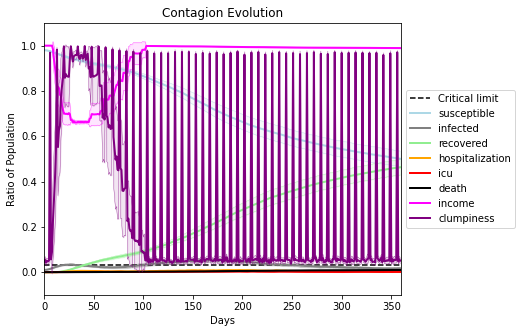

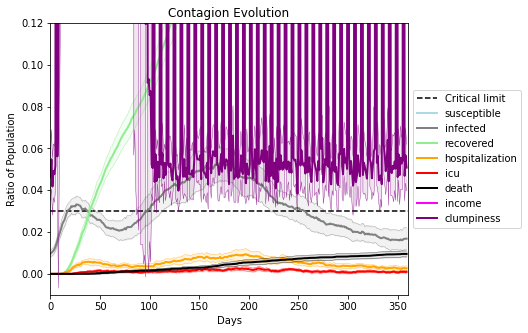

In [8]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.997
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[7048, 5570, 1240, 6195, 3887, 7400, 3221, 5399, 8452, 4420, 8514, 5009, 3381, 5642, 1209, 192, 2222, 1323, 3953, 2481]
Average similarity between family members is 0.9591251676958543 at temperature -0.996
Average similarity between family and home is 0.9998493999760171 at temperature -1
Average similarity between students and their classroom is 0.6723262000418171 at temperature -0.996
Average classroom occupancy is 3.9857142857142858 and number classrooms is 70
Average similarity between workers is 0.9240032567718197 at temperature -0.996
Average office occupancy is 3.308080808080808 and number offices is 198
Average friend similarity for adults: 0.846226285116093 for kids: 0.6890898102025317
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings

avg restaurant similarity 0.6192139145183999
avg restaurant similarity 0.6243619677245145
avg restaurant similarity 0.5902792558058585
avg restaurant similarity 0.6558586599285708
avg restaurant similarity 0.6132620260769668
avg restaurant similarity 0.6627754697611354
avg restaurant similarity 0.6647996303796605
avg restaurant similarity 0.5688041805455286
avg restaurant similarity 0.6813119717678873
avg restaurant similarity 0.6317158315941158
avg restaurant similarity 0.6368565281517179
avg restaurant similarity 0.5881370085146196
avg restaurant similarity 0.6262603049368148
avg restaurant similarity 0.6383971182991016
avg restaurant similarity 0.6206753158423692
avg restaurant similarity 0.5829240157855998
avg restaurant similarity 0.6434111563754275
avg restaurant similarity 0.6811596621318086
avg restaurant similarity 0.6581352499547807
avg restaurant similarity 0.592905912288756
avg restaurant similarity 0.6519704224923212
avg restaurant similarity 0.6322069053466867
avg restaur

avg restaurant similarity 0.6650010147728863
avg restaurant similarity 0.6752446459509467
avg restaurant similarity 0.6830447012739361
avg restaurant similarity 0.6599433041229535
avg restaurant similarity 0.6177935846349464
avg restaurant similarity 0.7003708206274764
avg restaurant similarity 0.6293744169651537
avg restaurant similarity 0.6963037379921585
avg restaurant similarity 0.6687649259628472
avg restaurant similarity 0.623696807093944
avg restaurant similarity 0.6327576095188084
avg restaurant similarity 0.7037524268343638
avg restaurant similarity 0.6108289758112843
avg restaurant similarity 0.6532811624077072
avg restaurant similarity 0.6384973672416135
avg restaurant similarity 0.6233564538267672
avg restaurant similarity 0.6737081497592518
avg restaurant similarity 0.6579675026406367
avg restaurant similarity 0.6654695539171672
avg restaurant similarity 0.5615048122174923
avg restaurant similarity 0.6627571112509056
avg restaurant similarity 0.620174772586525
avg restaura

avg restaurant similarity 0.6215912277607143
avg restaurant similarity 0.6420243775507177
avg restaurant similarity 0.6367310399972015
avg restaurant similarity 0.60550947371933
avg restaurant similarity 0.6399846067135194
avg restaurant similarity 0.5943429821092497
avg restaurant similarity 0.6485851433916372
avg restaurant similarity 0.6475371683623524
avg restaurant similarity 0.6455817612830229
avg restaurant similarity 0.6300944483174608
avg restaurant similarity 0.606836077895784
avg restaurant similarity 0.6356427764222083
avg restaurant similarity 0.6640882726896633
avg restaurant similarity 0.6492262742177567
avg restaurant similarity 0.6292431514424022
avg restaurant similarity 0.6368257839471014
avg restaurant similarity 0.6361641826887315
avg restaurant similarity 0.5894711123068633
avg restaurant similarity 0.6372605245204073
avg restaurant similarity 0.6656014955751924
avg restaurant similarity 0.6179727986001287
avg restaurant similarity 0.6639820868984923
avg restauran

avg restaurant similarity 0.6294374599429654
avg restaurant similarity 0.6305488422878324
avg restaurant similarity 0.621033674413755
avg restaurant similarity 0.5920734929852383
avg restaurant similarity 0.6163706189262909
avg restaurant similarity 0.608714506773228
avg restaurant similarity 0.5646941315733789
avg restaurant similarity 0.618403404056191
avg restaurant similarity 0.6301012464398826
avg restaurant similarity 0.6016687731729979
avg restaurant similarity 0.619597748569542
avg restaurant similarity 0.6316917982222126
avg restaurant similarity 0.5856612538329216
avg restaurant similarity 0.596740767374777
avg restaurant similarity 0.6119999250761828
avg restaurant similarity 0.6144357192999576
avg restaurant similarity 0.5967182872426554
avg restaurant similarity 0.6341304291284301
avg restaurant similarity 0.6282868307009052
avg restaurant similarity 0.5827103007091377
avg restaurant similarity 0.6532810564980587
avg restaurant similarity 0.6136846992976212
avg restaurant 

avg restaurant similarity 0.6511951487775388
avg restaurant similarity 0.6417132539250706
avg restaurant similarity 0.6546194632451386
avg restaurant similarity 0.6285813423417701
avg restaurant similarity 0.584955193677712
avg restaurant similarity 0.6058770234342625
avg restaurant similarity 0.6354892554078714
avg restaurant similarity 0.6261773774747261
avg restaurant similarity 0.6155524755624878
avg restaurant similarity 0.5933221956278566
avg restaurant similarity 0.641879144009943
avg restaurant similarity 0.5653635493565238
avg restaurant similarity 0.6899724870442765
avg restaurant similarity 0.6067788087909736
avg restaurant similarity 0.6363171143842024
avg restaurant similarity 0.613480449085321
avg restaurant similarity 0.640395085679616
avg restaurant similarity 0.6401381423412946
avg restaurant similarity 0.6548544767363889
avg restaurant similarity 0.6416397875387998
avg restaurant similarity 0.5752229352821009
avg restaurant similarity 0.5863336909033804
avg restaurant

avg restaurant similarity 0.6146041839277002
avg restaurant similarity 0.6809239441748635
avg restaurant similarity 0.5969564776706767
avg restaurant similarity 0.6048087175817147
avg restaurant similarity 0.6157156975521267
avg restaurant similarity 0.6417233177726763
avg restaurant similarity 0.6208338217216021
avg restaurant similarity 0.6519451286015728
avg restaurant similarity 0.5960489340827332
avg restaurant similarity 0.6242443728158523
avg restaurant similarity 0.6246933055915381
avg restaurant similarity 0.6202314216293427
avg restaurant similarity 0.662517423913981
avg restaurant similarity 0.5988168232940743
avg restaurant similarity 0.6376285193715112
avg restaurant similarity 0.5714465447219457
avg restaurant similarity 0.6218641325849139
avg restaurant similarity 0.6002379565932997
avg restaurant similarity 0.5978496329444799
avg restaurant similarity 0.6840815544001924
avg restaurant similarity 0.6241639389423057
avg restaurant similarity 0.6391799913403282
avg restaur

avg restaurant similarity 0.6275508889574898
avg restaurant similarity 0.5992067985547486
avg restaurant similarity 0.6254570905371623
avg restaurant similarity 0.6133584919521743
avg restaurant similarity 0.6231476593555109
avg restaurant similarity 0.6175619723842757
avg restaurant similarity 0.6217957391922522
avg restaurant similarity 0.5795051963575238
avg restaurant similarity 0.6276839766977073
avg restaurant similarity 0.5865019935789586
avg restaurant similarity 0.5949252968798672
avg restaurant similarity 0.5981075754511073
avg restaurant similarity 0.6321533296887494
avg restaurant similarity 0.5793714355248544
avg restaurant similarity 0.5839713838678322
avg restaurant similarity 0.6065362220211103
avg restaurant similarity 0.5978357301448806
avg restaurant similarity 0.6282548123629835
avg restaurant similarity 0.6306765709355775
avg restaurant similarity 0.5886227373693962
avg restaurant similarity 0.5923243238961995
avg restaurant similarity 0.633046020795374
avg restaur

avg restaurant similarity 0.6041542516487333
avg restaurant similarity 0.5882160094306665
avg restaurant similarity 0.6162630383152132
avg restaurant similarity 0.6148208138870337
avg restaurant similarity 0.6266168525911505
avg restaurant similarity 0.6028576959665463
avg restaurant similarity 0.6476495243672419
avg restaurant similarity 0.5867332192914867
avg restaurant similarity 0.6194178446249847
avg restaurant similarity 0.5837805497426283
avg restaurant similarity 0.6087747266437357
avg restaurant similarity 0.614097856280698
avg restaurant similarity 0.6000978563269939
avg restaurant similarity 0.6053791089329903
avg restaurant similarity 0.6401804752431445
avg restaurant similarity 0.5839839695402899
avg restaurant similarity 0.5593806996132934
avg restaurant similarity 0.5833837997746832
avg restaurant similarity 0.5577444402717646
avg restaurant similarity 0.6119095409732438
avg restaurant similarity 0.5964926972460858
avg restaurant similarity 0.60411449543717
avg restauran

avg restaurant similarity 0.5764042062519119
avg restaurant similarity 0.6026936507961462
avg restaurant similarity 0.6319755334221574
avg restaurant similarity 0.6046123391989797
avg restaurant similarity 0.615122592872976
avg restaurant similarity 0.6235400626710326
avg restaurant similarity 0.6542903910994096
avg restaurant similarity 0.6610125656702106
avg restaurant similarity 0.6531505148509065
avg restaurant similarity 0.6041428678468598
avg restaurant similarity 0.5963714103507483
avg restaurant similarity 0.5990063259907217
avg restaurant similarity 0.6687993471724307
avg restaurant similarity 0.6225207043501138
avg restaurant similarity 0.6486972438578581
avg restaurant similarity 0.5898088545215944
avg restaurant similarity 0.6424783266757289
avg restaurant similarity 0.6189820678567435
avg restaurant similarity 0.6522562517246812
avg restaurant similarity 0.6336505378886876
avg restaurant similarity 0.6365159261336254
avg restaurant similarity 0.6026579114123543
avg restaur

avg restaurant similarity 0.6360734644615985
avg restaurant similarity 0.6335408707055373
avg restaurant similarity 0.6215440839909357
avg restaurant similarity 0.6139639074424228
avg restaurant similarity 0.6446390602523142
avg restaurant similarity 0.619727624721138
avg restaurant similarity 0.6128841748620261
avg restaurant similarity 0.6352143586112498
avg restaurant similarity 0.5806407549508552
avg restaurant similarity 0.6450145257319619
avg restaurant similarity 0.5775655891693378
avg restaurant similarity 0.6252778763898796
avg restaurant similarity 0.5979530036084565
avg restaurant similarity 0.619711560572124
avg restaurant similarity 0.6149814925466249
avg restaurant similarity 0.5823853969269847
avg restaurant similarity 0.5857778873483938
avg restaurant similarity 0.6405206450286977
avg restaurant similarity 0.6910150961164094
avg restaurant similarity 0.6720548957947238
avg restaurant similarity 0.5938440465563292
avg restaurant similarity 0.6606432449725014
avg restaura

avg restaurant similarity 0.6000383759886451
avg restaurant similarity 0.6424447108006376
avg restaurant similarity 0.630156539861168
avg restaurant similarity 0.5977735179454923
avg restaurant similarity 0.5916357494853087
avg restaurant similarity 0.6166516362562855
avg restaurant similarity 0.6143991634069769
avg restaurant similarity 0.6603896382650842
avg restaurant similarity 0.6689645422215007
avg restaurant similarity 0.6094042270853539
avg restaurant similarity 0.5994774771449728
avg restaurant similarity 0.629659194366276
avg restaurant similarity 0.5908670811407998
avg restaurant similarity 0.5864565378762931
avg restaurant similarity 0.6033427464688704
avg restaurant similarity 0.6406503831025753
avg restaurant similarity 0.5768980677873392
avg restaurant similarity 0.6015624620767496
avg restaurant similarity 0.6358815768459632
avg restaurant similarity 0.6027281144830177
avg restaurant similarity 0.5953581313105792
avg restaurant similarity 0.6007042231398638
avg restaura

avg restaurant similarity 0.6387270797156811
avg restaurant similarity 0.6190166181898531
avg restaurant similarity 0.6366812545506874
avg restaurant similarity 0.6219889040693242
avg restaurant similarity 0.6193176900479802
avg restaurant similarity 0.6537286660060222
avg restaurant similarity 0.6069354353044425
avg restaurant similarity 0.6278309227589979
avg restaurant similarity 0.6111846495558596
avg restaurant similarity 0.6108081681063691
avg restaurant similarity 0.6778245108350394
avg restaurant similarity 0.6558172495222124
avg restaurant similarity 0.6237042651169238
avg restaurant similarity 0.6049242070869957
avg restaurant similarity 0.6193742046805543
avg restaurant similarity 0.6545156316938886
avg restaurant similarity 0.6290000989362206
avg restaurant similarity 0.6497663478510279
avg restaurant similarity 0.5608099063056399
avg restaurant similarity 0.583405991157279
avg restaurant similarity 0.6681712685773485
avg restaurant similarity 0.6761217784800679
avg restaur

avg restaurant similarity 0.5950490544867763
avg restaurant similarity 0.6140176557465877
avg restaurant similarity 0.6328715492069804
avg restaurant similarity 0.6868401367749424
avg restaurant similarity 0.7069620208085383
avg restaurant similarity 0.6856534312177864
avg restaurant similarity 0.6550797064867709
avg restaurant similarity 0.640181986995956
avg restaurant similarity 0.6954820598556508
avg restaurant similarity 0.7020122405657082
avg restaurant similarity 0.7180142024267367
avg restaurant similarity 0.6458342008670398
avg restaurant similarity 0.6523051708076735
avg restaurant similarity 0.6038525054262538
avg restaurant similarity 0.6985028670475824
avg restaurant similarity 0.6511401557379247
avg restaurant similarity 0.602312999498131
avg restaurant similarity 0.644823761373348
avg restaurant similarity 0.7025768953297773
avg restaurant similarity 0.6036532744667608
avg restaurant similarity 0.6395796747247019
avg restaurant similarity 0.68888448895449
avg restaurant 

avg restaurant similarity 0.6354696112695977
avg restaurant similarity 0.5582130148510935
avg restaurant similarity 0.6233300123468055
avg restaurant similarity 0.7217593123033762
avg restaurant similarity 0.6173680827969743
avg restaurant similarity 0.630912860969626
avg restaurant similarity 0.6437984172016964
avg restaurant similarity 0.6814824701180687
avg restaurant similarity 0.6870607800405706
avg restaurant similarity 0.7229748134551246
avg restaurant similarity 0.6694266926492888
avg restaurant similarity 0.6760349298781261
avg restaurant similarity 0.6410615172211007
avg restaurant similarity 0.701444215030066
avg restaurant similarity 0.6849743304108826
avg restaurant similarity 0.6481410382670785
avg restaurant similarity 0.6695452872962323
avg restaurant similarity 0.6457922663793078
avg restaurant similarity 0.6494476764077513
avg restaurant similarity 0.6322047261041343
avg restaurant similarity 0.6619947796747935
avg restaurant similarity 0.6529671680369932
avg restaura

avg restaurant similarity 0.6226774154846176
avg restaurant similarity 0.6110464584051558
avg restaurant similarity 0.6625450320819443
avg restaurant similarity 0.6891150203417334
avg restaurant similarity 0.6116648488583744
avg restaurant similarity 0.6226552145520966
avg restaurant similarity 0.6297092014673985
avg restaurant similarity 0.6232650086167242
avg restaurant similarity 0.635677552930924
avg restaurant similarity 0.6893108425092609
avg restaurant similarity 0.5931666509865979
avg restaurant similarity 0.6165191812841452
avg restaurant similarity 0.5828526320811618
avg restaurant similarity 0.6038288575892982
avg restaurant similarity 0.6388973527137796
avg restaurant similarity 0.6442824408139467
avg restaurant similarity 0.6098594006743469
avg restaurant similarity 0.6428046779311866
avg restaurant similarity 0.6338928247085562
avg restaurant similarity 0.61901819544362
avg restaurant similarity 0.5940655853071151
avg restaurant similarity 0.5844894897294565
avg restauran

avg restaurant similarity 0.6314733688053206
avg restaurant similarity 0.6089916235812927
avg restaurant similarity 0.6156857896072419
avg restaurant similarity 0.6369821015029146
avg restaurant similarity 0.625863555747969
avg restaurant similarity 0.655010851859579
avg restaurant similarity 0.6225452267588589
avg restaurant similarity 0.6369877728075025
avg restaurant similarity 0.6334810758783799
avg restaurant similarity 0.6432030265693167
avg restaurant similarity 0.6794581110977502
avg restaurant similarity 0.6678501831835968
avg restaurant similarity 0.6473727592523957
avg restaurant similarity 0.6763806857046817
avg restaurant similarity 0.6313630486630045
avg restaurant similarity 0.6555038931580882
avg restaurant similarity 0.6422245887656074
avg restaurant similarity 0.6732887088036317
avg restaurant similarity 0.675726445850587
avg restaurant similarity 0.6564595802264833
avg restaurant similarity 0.6562423257547654
avg restaurant similarity 0.6582641875798714
avg restauran

avg restaurant similarity 0.575198397786562
avg restaurant similarity 0.6134159502510793
avg restaurant similarity 0.619214379107433
avg restaurant similarity 0.6026749338628654
avg restaurant similarity 0.6024176718849302
avg restaurant similarity 0.5610089012030297
avg restaurant similarity 0.6126170506547883
avg restaurant similarity 0.6546073943548536
avg restaurant similarity 0.5882007234010327
avg restaurant similarity 0.634738168108572
avg restaurant similarity 0.6508497780407182
avg restaurant similarity 0.6171084879251668
avg restaurant similarity 0.6190694597671164
avg restaurant similarity 0.5777520136147812
avg restaurant similarity 0.6654470688170944
avg restaurant similarity 0.6464352928316721
avg restaurant similarity 0.5899671053580415
avg restaurant similarity 0.6497191157191466
avg restaurant similarity 0.6106043394306679
avg restaurant similarity 0.5852700457132631
avg restaurant similarity 0.6111438606090224
avg restaurant similarity 0.5618939288539234
avg restauran

avg restaurant similarity 0.6831416271346878
avg restaurant similarity 0.6695889397817045
avg restaurant similarity 0.5874413401048282
avg restaurant similarity 0.596632067137547
avg restaurant similarity 0.6242867974035128
avg restaurant similarity 0.6363113046260628
avg restaurant similarity 0.6095431609791517
avg restaurant similarity 0.6508317509173559
avg restaurant similarity 0.595956496530441
avg restaurant similarity 0.557944325434715
avg restaurant similarity 0.612723113709453
avg restaurant similarity 0.6144046236387766
avg restaurant similarity 0.5774689724037803
avg restaurant similarity 0.6290967754609551
avg restaurant similarity 0.6133492814918398
avg restaurant similarity 0.569883912421989
avg restaurant similarity 0.5955485612022166
avg restaurant similarity 0.6456881875178552
avg restaurant similarity 0.6241957499550883
avg restaurant similarity 0.5980310722905207
avg restaurant similarity 0.5779070955931954
avg restaurant similarity 0.62011095782016
avg restaurant si

avg restaurant similarity 0.6569474958943465
avg restaurant similarity 0.6875336928601251
avg restaurant similarity 0.6285684631636637
avg restaurant similarity 0.6215081756371202
avg restaurant similarity 0.6058254937182652
avg restaurant similarity 0.6493976932711943
avg restaurant similarity 0.6135685302858581
avg restaurant similarity 0.663499544131289
avg restaurant similarity 0.6792628960539265
avg restaurant similarity 0.6830734822248492
avg restaurant similarity 0.6696415170373176
avg restaurant similarity 0.68736766615859
avg restaurant similarity 0.657841344678559
avg restaurant similarity 0.6588410262073434
avg restaurant similarity 0.6871169898881221
avg restaurant similarity 0.6496979927221112
avg restaurant similarity 0.6001342449311755
avg restaurant similarity 0.7157127595252846
avg restaurant similarity 0.5956342386716502
avg restaurant similarity 0.6520571160429305
avg restaurant similarity 0.6261695179528814
avg restaurant similarity 0.6959893163749142
avg restaurant

avg restaurant similarity 0.6821340648846789
avg restaurant similarity 0.633522825301945
avg restaurant similarity 0.6536709899478583
avg restaurant similarity 0.6461585371158762
avg restaurant similarity 0.6311419944558104
avg restaurant similarity 0.6457868895843205
avg restaurant similarity 0.6279813938668776
avg restaurant similarity 0.6440931081732392
avg restaurant similarity 0.6101587150618637
avg restaurant similarity 0.6154621696877887
avg restaurant similarity 0.6053050388728874
avg restaurant similarity 0.6311797390936364
avg restaurant similarity 0.6421564347840184
avg restaurant similarity 0.590102358637108
avg restaurant similarity 0.6917548530168326
avg restaurant similarity 0.6271550168607198
avg restaurant similarity 0.6138352321349272
avg restaurant similarity 0.5981708612421563
avg restaurant similarity 0.6300714353240822
avg restaurant similarity 0.6272553907516148
avg restaurant similarity 0.6277429324205774
avg restaurant similarity 0.6427916904300978
avg restaura

avg restaurant similarity 0.5991046747554247
avg restaurant similarity 0.6002971241414776
avg restaurant similarity 0.6136686293431496
avg restaurant similarity 0.6323604963373877
avg restaurant similarity 0.6453630661757194
avg restaurant similarity 0.6341487545845884
avg restaurant similarity 0.6103872176401584
avg restaurant similarity 0.6180042256939415
avg restaurant similarity 0.6159305036270348
avg restaurant similarity 0.6182861286182131
avg restaurant similarity 0.602804150849438
avg restaurant similarity 0.6351141583161602
avg restaurant similarity 0.6187763003525661
avg restaurant similarity 0.6137355282344432
avg restaurant similarity 0.6382387347334125
avg restaurant similarity 0.6431389326304275
avg restaurant similarity 0.5685796961459534
avg restaurant similarity 0.5909335895428648
avg restaurant similarity 0.6197008304710794
avg restaurant similarity 0.5686741193203411
avg restaurant similarity 0.6000241332390279
avg restaurant similarity 0.588324856458773
avg restaura

avg restaurant similarity 0.6297346964959353
avg restaurant similarity 0.6198095855362102
avg restaurant similarity 0.6371667897866411
avg restaurant similarity 0.5953188840732588
avg restaurant similarity 0.6148882151288433
avg restaurant similarity 0.5689371736684362
avg restaurant similarity 0.6588631933147657
avg restaurant similarity 0.5975438690682834
avg restaurant similarity 0.6463588809261865
avg restaurant similarity 0.6245065346879997
avg restaurant similarity 0.6548184071926915
avg restaurant similarity 0.6480841613194007
avg restaurant similarity 0.6164525250509748
avg restaurant similarity 0.6662444922003833
avg restaurant similarity 0.6260887434569518
avg restaurant similarity 0.6712738095721816
avg restaurant similarity 0.5783173869064936
avg restaurant similarity 0.67987063933575
avg restaurant similarity 0.6356929227056425
avg restaurant similarity 0.6631728171512034
avg restaurant similarity 0.6311092733539063
avg restaurant similarity 0.6515711158568491
avg restaura

avg restaurant similarity 0.6062733845141013
avg restaurant similarity 0.6208082685749698
avg restaurant similarity 0.6265201360305129
avg restaurant similarity 0.6358544008043391
avg restaurant similarity 0.5975258034598534
avg restaurant similarity 0.5961621313527384
avg restaurant similarity 0.5623009948221529
avg restaurant similarity 0.5975944586962562
avg restaurant similarity 0.5707298584902406
avg restaurant similarity 0.5903332434868411
avg restaurant similarity 0.6712432008121828
avg restaurant similarity 0.6548404318385459
avg restaurant similarity 0.6276257469930822
avg restaurant similarity 0.5755130837309249
avg restaurant similarity 0.6252585495099262
avg restaurant similarity 0.6161237093628558
avg restaurant similarity 0.5770849671722182
avg restaurant similarity 0.6457664212135973
avg restaurant similarity 0.5578386182972537
avg restaurant similarity 0.6391168748414099
avg restaurant similarity 0.6414710460839843
avg restaurant similarity 0.6612814082456604
avg restau

avg restaurant similarity 0.5893630406919138
avg restaurant similarity 0.560055809248371
avg restaurant similarity 0.6246720453227181
avg restaurant similarity 0.6038597469493814
avg restaurant similarity 0.6476686180412266
avg restaurant similarity 0.6081411293867885
avg restaurant similarity 0.6380578765979598
avg restaurant similarity 0.595885252218605
avg restaurant similarity 0.6586233140290576
avg restaurant similarity 0.6236441889326295
avg restaurant similarity 0.6544564683748849
avg restaurant similarity 0.619345681879696
avg restaurant similarity 0.664602590153544
avg restaurant similarity 0.6197235973119221
avg restaurant similarity 0.6558709045982469
avg restaurant similarity 0.5958611819396237
avg restaurant similarity 0.6344400156515021
avg restaurant similarity 0.6157944689977923
avg restaurant similarity 0.6024217834726884
avg restaurant similarity 0.6037031460633747
avg restaurant similarity 0.6393230096523477
avg restaurant similarity 0.6236174563467216
avg restaurant

avg restaurant similarity 0.5736365940101936
avg restaurant similarity 0.6033819175193574
avg restaurant similarity 0.6024978032965956
avg restaurant similarity 0.5315214141947731
avg restaurant similarity 0.5890277988360416
avg restaurant similarity 0.5941305539596862
avg restaurant similarity 0.6191129681188631
avg restaurant similarity 0.6306967273311784
avg restaurant similarity 0.612739944766594
avg restaurant similarity 0.5994345423783354
avg restaurant similarity 0.6448857318163066
avg restaurant similarity 0.6295082968858353
avg restaurant similarity 0.6124310493584784
avg restaurant similarity 0.5985358733424637
avg restaurant similarity 0.6348690803381749
avg restaurant similarity 0.5822600541734015
avg restaurant similarity 0.576467613838392
avg restaurant similarity 0.6140516036803688
avg restaurant similarity 0.6024878098104554
avg restaurant similarity 0.6085836355729741
avg restaurant similarity 0.6448856716354046
avg restaurant similarity 0.5967759221688219
avg restaura

avg restaurant similarity 0.5991085137557903
avg restaurant similarity 0.6038775974307478
avg restaurant similarity 0.6443647812013749
avg restaurant similarity 0.6509369710353103
avg restaurant similarity 0.6557588145620428
avg restaurant similarity 0.60861368066468
avg restaurant similarity 0.5740152217317721
avg restaurant similarity 0.632618320477641
avg restaurant similarity 0.5562741389097811
avg restaurant similarity 0.5594408161389139
avg restaurant similarity 0.6107236180091412
avg restaurant similarity 0.6168053291386644
avg restaurant similarity 0.6205770909053575
avg restaurant similarity 0.6286484783390184
avg restaurant similarity 0.5836835233310523
avg restaurant similarity 0.5330931208897198
avg restaurant similarity 0.5855923010684716
avg restaurant similarity 0.6096345228557514
avg restaurant similarity 0.6482341498788297
avg restaurant similarity 0.6588861840148127
avg restaurant similarity 0.5717026567229951
avg restaurant similarity 0.5689864223460276
avg restauran

avg restaurant similarity 0.5983955694010132
avg restaurant similarity 0.574467571825412
avg restaurant similarity 0.6314954022692747
avg restaurant similarity 0.6125458262127027
avg restaurant similarity 0.6420378187289248
avg restaurant similarity 0.654221980376115
avg restaurant similarity 0.5955620902983632
avg restaurant similarity 0.6460810185068225
avg restaurant similarity 0.594533060218729
avg restaurant similarity 0.5941210996167742
avg restaurant similarity 0.5927896831316123
avg restaurant similarity 0.5987554174580278
avg restaurant similarity 0.6057301090790365
avg restaurant similarity 0.6029033109301205
avg restaurant similarity 0.6808787403465999
avg restaurant similarity 0.5959347628523626
avg restaurant similarity 0.6111396686523719
avg restaurant similarity 0.6685842185057123
avg restaurant similarity 0.6447141355777245
avg restaurant similarity 0.6113952949769367
avg restaurant similarity 0.6338113433837027
avg restaurant similarity 0.6429407092587175
avg restauran

avg restaurant similarity 0.6249484557499292
avg restaurant similarity 0.6691792329871897
avg restaurant similarity 0.6420497803083967
avg restaurant similarity 0.5936250047733657
avg restaurant similarity 0.641162552036317
avg restaurant similarity 0.6214660712502086
avg restaurant similarity 0.6239836065598747
avg restaurant similarity 0.6609614207247207
avg restaurant similarity 0.6037324987772834
avg restaurant similarity 0.5777549895500822
avg restaurant similarity 0.621943021371786
avg restaurant similarity 0.6048370613129337
avg restaurant similarity 0.6515299614997343
avg restaurant similarity 0.5578673961658915
avg restaurant similarity 0.6472602378563813
avg restaurant similarity 0.6233480938825803
avg restaurant similarity 0.6433525482987562
avg restaurant similarity 0.6977542578658549
avg restaurant similarity 0.6257967486411056
avg restaurant similarity 0.6526742804720495
avg restaurant similarity 0.6266128472047647
avg restaurant similarity 0.6304789152006083
avg restaura

avg restaurant similarity 0.6699365424864037
avg restaurant similarity 0.6122151015446893
avg restaurant similarity 0.6550185567016648
avg restaurant similarity 0.6680586293429929
avg restaurant similarity 0.5820166516893427
avg restaurant similarity 0.6012942484987079
avg restaurant similarity 0.6146189219947152
avg restaurant similarity 0.6193520835723658
avg restaurant similarity 0.6448939200857149
avg restaurant similarity 0.6317594770955995
avg restaurant similarity 0.6192477623039838
avg restaurant similarity 0.6456078744939471
avg restaurant similarity 0.5996114279025297
avg restaurant similarity 0.6316686449858882
avg restaurant similarity 0.595318203235103
avg restaurant similarity 0.6508350351661615
avg restaurant similarity 0.569550260103422
avg restaurant similarity 0.6227831044614346
avg restaurant similarity 0.6393235739045868
avg restaurant similarity 0.6708357219867387
avg restaurant similarity 0.6038542738755597
avg restaurant similarity 0.6295837439150269
avg restaura

avg restaurant similarity 0.6798921217180631
avg restaurant similarity 0.6333540243369574
avg restaurant similarity 0.6178793758916032
avg restaurant similarity 0.6414684321165254
avg restaurant similarity 0.6335351681444986
avg restaurant similarity 0.6588524624691994
avg restaurant similarity 0.5525732739449873
avg restaurant similarity 0.5904913925469728
avg restaurant similarity 0.6650963344214769
avg restaurant similarity 0.6132596028160906
avg restaurant similarity 0.5882992687704134
avg restaurant similarity 0.5925360670509089
avg restaurant similarity 0.61554115094019
avg restaurant similarity 0.6448705261610747
avg restaurant similarity 0.7231886739134742
avg restaurant similarity 0.5864641201880785
avg restaurant similarity 0.6344917900257504
avg restaurant similarity 0.5982931554659402
avg restaurant similarity 0.602227460099961
avg restaurant similarity 0.5754614049370107
avg restaurant similarity 0.5830221668207873
avg restaurant similarity 0.6616406614036633
avg restauran

avg restaurant similarity 0.6132204949030529
avg restaurant similarity 0.6159878198715154
avg restaurant similarity 0.5920300546143349
avg restaurant similarity 0.5845466984441434
avg restaurant similarity 0.5902484954845207
avg restaurant similarity 0.6239716875502564
avg restaurant similarity 0.6231435988416985
avg restaurant similarity 0.6211690814924762
avg restaurant similarity 0.6381625996214364
avg restaurant similarity 0.6341191547665829
avg restaurant similarity 0.5944880230418399
avg restaurant similarity 0.5954495396957213
avg restaurant similarity 0.639466105111416
avg restaurant similarity 0.6400660727810845
avg restaurant similarity 0.5740310972188293
avg restaurant similarity 0.5576443505245554
avg restaurant similarity 0.6235481671354337
avg restaurant similarity 0.6144751903202504
avg restaurant similarity 0.6063022841171617
avg restaurant similarity 0.6190951412537626
avg restaurant similarity 0.615103088045834
avg restaurant similarity 0.602913954067189
avg restauran

avg restaurant similarity 0.6272909532542409
avg restaurant similarity 0.5718672419531015
avg restaurant similarity 0.5781330964996501
avg restaurant similarity 0.593257274481997
avg restaurant similarity 0.6409452534460252
avg restaurant similarity 0.6483601132687616
avg restaurant similarity 0.6132569004003324
avg restaurant similarity 0.5957316056057231
avg restaurant similarity 0.6479754724565164
avg restaurant similarity 0.5939195380611203
avg restaurant similarity 0.6573580613533881
avg restaurant similarity 0.6135356815689404
avg restaurant similarity 0.5615522859638323
avg restaurant similarity 0.6293172349689361
avg restaurant similarity 0.6218670721789162
avg restaurant similarity 0.6326830404891219
avg restaurant similarity 0.6349127332936451
avg restaurant similarity 0.6051952923600618
avg restaurant similarity 0.6240097474627995
avg restaurant similarity 0.6092261489256047
avg restaurant similarity 0.596138147662392
avg restaurant similarity 0.5878172759242511
avg restaura

avg restaurant similarity 0.6227687900680481
avg restaurant similarity 0.6094379637230852
avg restaurant similarity 0.5811688096124079
avg restaurant similarity 0.5461542158077909
avg restaurant similarity 0.5521993547943023
avg restaurant similarity 0.5446132350288089
avg restaurant similarity 0.606338979487496
avg restaurant similarity 0.6119783771248988
avg restaurant similarity 0.617284262884557
avg restaurant similarity 0.5594432431277766
avg restaurant similarity 0.5605885357527628
avg restaurant similarity 0.5990021155018393
avg restaurant similarity 0.6193618131435311
avg restaurant similarity 0.6212722368747784
avg restaurant similarity 0.5904725866339489
avg restaurant similarity 0.5803735879270916
avg restaurant similarity 0.5738729374897891
avg restaurant similarity 0.5930807637101518
avg restaurant similarity 0.6481245671082961
avg restaurant similarity 0.582581489558386
avg restaurant similarity 0.6015722709391114
avg restaurant similarity 0.6128162489181026
avg restauran

avg restaurant similarity 0.5941275169127846
avg restaurant similarity 0.614741476630109
avg restaurant similarity 0.5454754723919258
avg restaurant similarity 0.6212772590675869
avg restaurant similarity 0.5890975991408549
avg restaurant similarity 0.6291138135345709
avg restaurant similarity 0.6147395349951165
avg restaurant similarity 0.6380543614862042
avg restaurant similarity 0.5504586857492197
avg restaurant similarity 0.5804047504442265
avg restaurant similarity 0.5972445087240867
avg restaurant similarity 0.6141599199034322
avg restaurant similarity 0.6307287149342142
avg restaurant similarity 0.5980343823151302
avg restaurant similarity 0.6230332134025984
avg restaurant similarity 0.5794893391326188
avg restaurant similarity 0.6145321905458071
avg restaurant similarity 0.6632332502535377
avg restaurant similarity 0.627625021736738
avg restaurant similarity 0.6044857227494722
avg restaurant similarity 0.5981274445282471
avg restaurant similarity 0.6426200472801145
avg restaura

avg restaurant similarity 0.5626727134491446
avg restaurant similarity 0.6489061965726411
avg restaurant similarity 0.5815341460135525
avg restaurant similarity 0.5672185307390758
avg restaurant similarity 0.5690338957508252
avg restaurant similarity 0.5711345124189398
avg restaurant similarity 0.5821393172736554
avg restaurant similarity 0.5894079625858728
avg restaurant similarity 0.6448165504318789
avg restaurant similarity 0.651176147097934
avg restaurant similarity 0.5917823064286177
avg restaurant similarity 0.66422228783135
avg restaurant similarity 0.5102301267285597
avg restaurant similarity 0.5644388184397416
avg restaurant similarity 0.5959847715783128
avg restaurant similarity 0.5733824256155983
avg restaurant similarity 0.5675175065039402
avg restaurant similarity 0.6020635082369291
avg restaurant similarity 0.5741204372594013
avg restaurant similarity 0.591740743185957
avg restaurant similarity 0.5934205359251545
avg restaurant similarity 0.5667557181373127
avg restaurant

avg restaurant similarity 0.5889370290344036
avg restaurant similarity 0.6478114723625865
avg restaurant similarity 0.5958623406069462
avg restaurant similarity 0.6369719046544047
avg restaurant similarity 0.6021825129477943
avg restaurant similarity 0.575878998713712
avg restaurant similarity 0.5965690197912032
avg restaurant similarity 0.6519411643188121
avg restaurant similarity 0.6444678660174349
avg restaurant similarity 0.6334625677148303
avg restaurant similarity 0.6113839132982055
avg restaurant similarity 0.6534279560993087
avg restaurant similarity 0.5718367579969048
avg restaurant similarity 0.5525517092904779
avg restaurant similarity 0.6013438236929927
avg restaurant similarity 0.6853418499548183
avg restaurant similarity 0.61256095027416
avg restaurant similarity 0.6004332953086666
avg restaurant similarity 0.623532451037851
avg restaurant similarity 0.5798362142022288
avg restaurant similarity 0.6187029509229638
avg restaurant similarity 0.5891969178477601
avg restaurant

avg restaurant similarity 0.5701120225813803
avg restaurant similarity 0.6491730871309757
avg restaurant similarity 0.5961530228594623
avg restaurant similarity 0.6440834889416965
avg restaurant similarity 0.576674969372191
avg restaurant similarity 0.5828820536204692
avg restaurant similarity 0.6108270117223668
avg restaurant similarity 0.5954634022735522
avg restaurant similarity 0.6151276844107302
avg restaurant similarity 0.6129337809231832
avg restaurant similarity 0.6058497153535175
avg restaurant similarity 0.6299567472971497
avg restaurant similarity 0.63453344129683
avg restaurant similarity 0.6095124377590739
avg restaurant similarity 0.5681069014153897
avg restaurant similarity 0.6358011251651898
avg restaurant similarity 0.571668423562151
avg restaurant similarity 0.6179782814658042
avg restaurant similarity 0.6267626094952584
avg restaurant similarity 0.5533042552596871
avg restaurant similarity 0.5865341070292964
avg restaurant similarity 0.5713726994276477
avg restaurant

avg restaurant similarity 0.5925992882533935
avg restaurant similarity 0.5956528336683873
avg restaurant similarity 0.6027946717443186
avg restaurant similarity 0.5920752053855698
avg restaurant similarity 0.612313841583924
avg restaurant similarity 0.6152367339517526
avg restaurant similarity 0.6238496535695628
avg restaurant similarity 0.607400341819567
avg restaurant similarity 0.5963075417174214
avg restaurant similarity 0.5668329559951397
avg restaurant similarity 0.6069442852041047
avg restaurant similarity 0.5793275203976759
avg restaurant similarity 0.603299609641674
avg restaurant similarity 0.6458049759271188
avg restaurant similarity 0.6054178137031339
avg restaurant similarity 0.6178533722255065
avg restaurant similarity 0.5370490180211004
avg restaurant similarity 0.603635719948618
avg restaurant similarity 0.6355496049932152
avg restaurant similarity 0.6019144876711284
avg restaurant similarity 0.6172335659805789
avg restaurant similarity 0.5908107130005189
avg restaurant

avg restaurant similarity 0.6310954875133563
avg restaurant similarity 0.6823135958546751
avg restaurant similarity 0.6854700783719916
avg restaurant similarity 0.6385321879113972
avg restaurant similarity 0.6678932183359161
avg restaurant similarity 0.6593423011476602
avg restaurant similarity 0.6063694437480084
avg restaurant similarity 0.6080006485888517
avg restaurant similarity 0.6245027200253394
avg restaurant similarity 0.6585036122312974
avg restaurant similarity 0.6825979169889977
avg restaurant similarity 0.6243498486024655
avg restaurant similarity 0.6690915853218498
avg restaurant similarity 0.6760287162998961
avg restaurant similarity 0.6602015837083092
avg restaurant similarity 0.6597341233791344
avg restaurant similarity 0.589197989472513
avg restaurant similarity 0.6707895818890632
avg restaurant similarity 0.6223670254099969
avg restaurant similarity 0.6563357196800639
avg restaurant similarity 0.7239073463576784
avg restaurant similarity 0.6002951454207244
avg restaur

avg restaurant similarity 0.6632496479044055
avg restaurant similarity 0.6790612511879426
avg restaurant similarity 0.63302320685056
avg restaurant similarity 0.6547813031196658
avg restaurant similarity 0.629209966405109
avg restaurant similarity 0.6458993074116824
avg restaurant similarity 0.7216118557530755
avg restaurant similarity 0.675273216682787
avg restaurant similarity 0.6262369087734998
avg restaurant similarity 0.659483044991608
avg restaurant similarity 0.6687622038710644
avg restaurant similarity 0.6658247273404082
avg restaurant similarity 0.6379012245677204
avg restaurant similarity 0.6404158227856046
avg restaurant similarity 0.6276811145069162
avg restaurant similarity 0.6938593518508556
avg restaurant similarity 0.6436659369251255
avg restaurant similarity 0.6271876089942535
avg restaurant similarity 0.6337010919695885
avg restaurant similarity 0.6886355933797967
avg restaurant similarity 0.623373075714971
avg restaurant similarity 0.6580590732342804
avg restaurant s

(<function dict.items>, <function dict.items>, <function dict.items>)

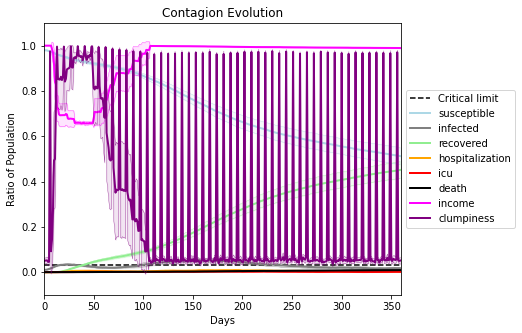

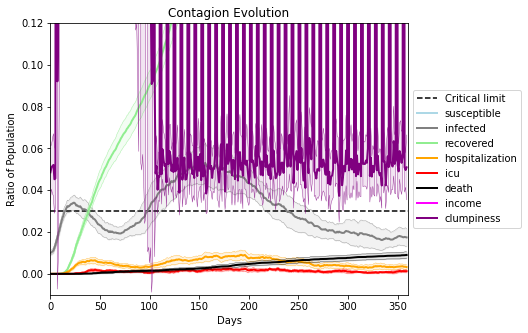

In [9]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.996
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[2844, 1565, 4320, 4977, 2806, 5048, 2422, 8065, 7614, 4028, 9774, 2302, 8271, 4239, 3731, 4137, 2566, 322, 1425, 3400]
Average similarity between family members is 0.9352492546230686 at temperature -0.995
Average similarity between family and home is 0.9998550883794098 at temperature -1
Average similarity between students and their classroom is 0.6028018837646598 at temperature -0.995
Average classroom occupancy is 4.130434782608695 and number classrooms is 69
Average similarity between workers is 0.9018858899534279 at temperature -0.995
Average office occupancy is 3.4583333333333335 and number offices is 192
Average friend similarity for adults: 0.8591045238711728 for kids: 0.6851792095464
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings

avg restaurant similarity 0.655773812175251
avg restaurant similarity 0.5899434484537073
avg restaurant similarity 0.6437936780688126
avg restaurant similarity 0.5494880026443925
avg restaurant similarity 0.660626993124859
avg restaurant similarity 0.5886523823230969
avg restaurant similarity 0.6099188711035892
avg restaurant similarity 0.6047941325510803
avg restaurant similarity 0.6142287234620223
avg restaurant similarity 0.569091032264807
avg restaurant similarity 0.5849650321243939
avg restaurant similarity 0.5873526823003521
avg restaurant similarity 0.5808092905022422
avg restaurant similarity 0.573633970114092
avg restaurant similarity 0.5969345640170637
avg restaurant similarity 0.5761220072991227
avg restaurant similarity 0.6130704185012077
avg restaurant similarity 0.6009425700297064
avg restaurant similarity 0.5666340689989938
avg restaurant similarity 0.6891414874752761
avg restaurant similarity 0.6138855834849722
avg restaurant similarity 0.6980016366150821
avg restaurant

avg restaurant similarity 0.6004214351423252
avg restaurant similarity 0.5830338050916365
avg restaurant similarity 0.5272868775446042
avg restaurant similarity 0.6296994423864514
avg restaurant similarity 0.6099062065623098
avg restaurant similarity 0.6710301891446124
avg restaurant similarity 0.6344519593601748
avg restaurant similarity 0.6645560304180378
avg restaurant similarity 0.6143935824897491
avg restaurant similarity 0.602162444293295
avg restaurant similarity 0.5945955375206321
avg restaurant similarity 0.6044734355157607
avg restaurant similarity 0.615255110655583
avg restaurant similarity 0.6551485635608125
avg restaurant similarity 0.6310290489946467
avg restaurant similarity 0.6432538505990302
avg restaurant similarity 0.5915511227950391
avg restaurant similarity 0.5803375522319705
avg restaurant similarity 0.6165859657478558
avg restaurant similarity 0.6734221059378254
avg restaurant similarity 0.632181857664387
avg restaurant similarity 0.61863669053539
avg restaurant 

avg restaurant similarity 0.5745177255892459
avg restaurant similarity 0.5502178156021393
avg restaurant similarity 0.5263728461851163
avg restaurant similarity 0.5370670198691617
avg restaurant similarity 0.5465999906439521
avg restaurant similarity 0.5275576800428755
avg restaurant similarity 0.5755448781354194
avg restaurant similarity 0.5461886714516097
avg restaurant similarity 0.5432041123227852
avg restaurant similarity 0.5940792904993557
avg restaurant similarity 0.546651347344748
avg restaurant similarity 0.6132898549128563
avg restaurant similarity 0.5620818363266958
avg restaurant similarity 0.5479455933256525
avg restaurant similarity 0.6122097808346463
avg restaurant similarity 0.6057097000642606
avg restaurant similarity 0.5194117294410555
avg restaurant similarity 0.525037930232327
avg restaurant similarity 0.567799603491967
avg restaurant similarity 0.5517374850890862
avg restaurant similarity 0.5508543083475376
avg restaurant similarity 0.5835607646572905
avg restauran

avg restaurant similarity 0.5209120530820404
avg restaurant similarity 0.55611082851552
avg restaurant similarity 0.5797736177012485
avg restaurant similarity 0.5682501774875519
avg restaurant similarity 0.5628435440476158
avg restaurant similarity 0.5349572039975992
avg restaurant similarity 0.5671051141989708
avg restaurant similarity 0.6057142849794374
avg restaurant similarity 0.593996832436186
avg restaurant similarity 0.6023704745695247
avg restaurant similarity 0.5510976527034597
avg restaurant similarity 0.5503786679587886
avg restaurant similarity 0.5950033920915674
avg restaurant similarity 0.597508837025793
avg restaurant similarity 0.5552918494497532
avg restaurant similarity 0.534314263595472
avg restaurant similarity 0.5192667530479176
avg restaurant similarity 0.6021365236734492
avg restaurant similarity 0.6002667598226313
avg restaurant similarity 0.5805631382094122
avg restaurant similarity 0.5464642904939039
avg restaurant similarity 0.6005673510651746
avg restaurant 

avg restaurant similarity 0.5909341785195018
avg restaurant similarity 0.6121511286597361
avg restaurant similarity 0.6345741175086839
avg restaurant similarity 0.5462374497816384
avg restaurant similarity 0.5542427470035345
avg restaurant similarity 0.5472075107062424
avg restaurant similarity 0.5805490277688589
avg restaurant similarity 0.5145257124002321
avg restaurant similarity 0.5731136010828207
avg restaurant similarity 0.6114725846161513
avg restaurant similarity 0.5201185169061406
avg restaurant similarity 0.5623959934284591
avg restaurant similarity 0.5775954203001203
avg restaurant similarity 0.5567490533048407
avg restaurant similarity 0.5652938418372144
avg restaurant similarity 0.580284733652266
avg restaurant similarity 0.5931755508886968
avg restaurant similarity 0.6446608354570438
avg restaurant similarity 0.5666447036272697
avg restaurant similarity 0.599791828502731
avg restaurant similarity 0.5963226210067429
avg restaurant similarity 0.5864885209543372
avg restaura

avg restaurant similarity 0.5569324640295565
avg restaurant similarity 0.6459020225952308
avg restaurant similarity 0.5854053975059353
avg restaurant similarity 0.6233594019629661
avg restaurant similarity 0.5782786188729895
avg restaurant similarity 0.5602145822439963
avg restaurant similarity 0.5967650586644302
avg restaurant similarity 0.5549625127921636
avg restaurant similarity 0.5518160695281706
avg restaurant similarity 0.616639702930591
avg restaurant similarity 0.5612516477680358
avg restaurant similarity 0.5137063819271225
avg restaurant similarity 0.5228702910113645
avg restaurant similarity 0.5887780206358079
avg restaurant similarity 0.5518221511725971
avg restaurant similarity 0.5677691116294813
avg restaurant similarity 0.6058400711316927
avg restaurant similarity 0.5859691056993702
avg restaurant similarity 0.6241826605393537
avg restaurant similarity 0.5640813916527747
avg restaurant similarity 0.5842267618629311
avg restaurant similarity 0.5739032953838689
avg restaur

avg restaurant similarity 0.5892484653107539
avg restaurant similarity 0.5908181783549246
avg restaurant similarity 0.5528899566860579
avg restaurant similarity 0.5937502964860004
avg restaurant similarity 0.5935940485733571
avg restaurant similarity 0.53459696320598
avg restaurant similarity 0.5438840738414438
avg restaurant similarity 0.5898135576652476
avg restaurant similarity 0.5520838704980151
avg restaurant similarity 0.5440301658214052
avg restaurant similarity 0.587601760410285
avg restaurant similarity 0.5944567401053722
avg restaurant similarity 0.5436154438646023
avg restaurant similarity 0.5998641611831937
avg restaurant similarity 0.5525570210802778
avg restaurant similarity 0.5878478597342198
avg restaurant similarity 0.6273760839819308
avg restaurant similarity 0.5211311136794178
avg restaurant similarity 0.5593455548134405
avg restaurant similarity 0.5615788162654621
avg restaurant similarity 0.6084123118944337
avg restaurant similarity 0.5543056180154953
avg restauran

avg restaurant similarity 0.5576681473231939
avg restaurant similarity 0.5244532113392801
avg restaurant similarity 0.5775368953150309
avg restaurant similarity 0.6289697916170278
avg restaurant similarity 0.5728596970952562
avg restaurant similarity 0.5751968732543732
avg restaurant similarity 0.549888885741843
avg restaurant similarity 0.5732806669540759
avg restaurant similarity 0.6422505702341035
avg restaurant similarity 0.5640053127586401
avg restaurant similarity 0.5960293991550358
avg restaurant similarity 0.5598244699761542
avg restaurant similarity 0.5734949160470091
avg restaurant similarity 0.5608034347864824
avg restaurant similarity 0.5648308472108285
avg restaurant similarity 0.5118568514987373
avg restaurant similarity 0.5200806470345047
avg restaurant similarity 0.597759368633955
avg restaurant similarity 0.5708940849584888
avg restaurant similarity 0.5926381906802987
avg restaurant similarity 0.5867592475886466
avg restaurant similarity 0.5916666688862328
avg restaura

avg restaurant similarity 0.6082281591375639
avg restaurant similarity 0.6060741835624417
avg restaurant similarity 0.5594968488997897
avg restaurant similarity 0.6107979571361993
avg restaurant similarity 0.6049419303123581
avg restaurant similarity 0.5955591715116111
avg restaurant similarity 0.5666662603556251
avg restaurant similarity 0.6266474170386093
avg restaurant similarity 0.5385462974262694
avg restaurant similarity 0.54307682976592
avg restaurant similarity 0.5444339412740662
avg restaurant similarity 0.5896652757697731
avg restaurant similarity 0.5918386796903119
avg restaurant similarity 0.5608659021277906
avg restaurant similarity 0.5647931007058642
avg restaurant similarity 0.6013030308321131
avg restaurant similarity 0.5977297327303767
avg restaurant similarity 0.5719837963906724
avg restaurant similarity 0.6293969975137266
avg restaurant similarity 0.5859178240089684
avg restaurant similarity 0.608455592110515
avg restaurant similarity 0.6383127420177392
avg restauran

avg restaurant similarity 0.607157843658944
avg restaurant similarity 0.584036494791595
avg restaurant similarity 0.4995366190628265
avg restaurant similarity 0.5847190734639297
avg restaurant similarity 0.5777869381221902
avg restaurant similarity 0.5483874158565583
avg restaurant similarity 0.6390404405857466
avg restaurant similarity 0.6376552634914145
avg restaurant similarity 0.555097120995414
avg restaurant similarity 0.6418308722530645
avg restaurant similarity 0.6086787443762839
avg restaurant similarity 0.6032173837342074
avg restaurant similarity 0.5921039859672587
avg restaurant similarity 0.5730139681281017
avg restaurant similarity 0.5007463315809478
avg restaurant similarity 0.608361666934606
avg restaurant similarity 0.637809620938204
avg restaurant similarity 0.6108098908825076
avg restaurant similarity 0.6095527970532892
avg restaurant similarity 0.5926400599913672
avg restaurant similarity 0.5776343980431673
avg restaurant similarity 0.6896653977454426
avg restaurant 

avg restaurant similarity 0.6449879515266829
avg restaurant similarity 0.5853426554592014
avg restaurant similarity 0.5513241808168492
avg restaurant similarity 0.6391468072189012
avg restaurant similarity 0.5976826964185308
avg restaurant similarity 0.6090046520686714
avg restaurant similarity 0.6021925979906698
avg restaurant similarity 0.6196360812061201
avg restaurant similarity 0.6390250328113607
avg restaurant similarity 0.5930634057379073
avg restaurant similarity 0.5898016125545035
avg restaurant similarity 0.5311382486846512
avg restaurant similarity 0.6202535605827879
avg restaurant similarity 0.5906755656637809
avg restaurant similarity 0.5922670189763122
avg restaurant similarity 0.5270432219565017
avg restaurant similarity 0.6674348986323161
avg restaurant similarity 0.5713932101983599
avg restaurant similarity 0.5700625812966633
avg restaurant similarity 0.6133846748413244
avg restaurant similarity 0.5846303180983443
avg restaurant similarity 0.578463831027101
avg restaur

avg restaurant similarity 0.5875004356606848
avg restaurant similarity 0.6215382875870145
avg restaurant similarity 0.572985180885156
avg restaurant similarity 0.6180947877867284
avg restaurant similarity 0.6281017511645821
avg restaurant similarity 0.596932579043366
avg restaurant similarity 0.6357394609543886
avg restaurant similarity 0.6274009123085759
avg restaurant similarity 0.5779522406248653
avg restaurant similarity 0.5754015907776995
avg restaurant similarity 0.5990416012456302
avg restaurant similarity 0.5906714115510544
avg restaurant similarity 0.5978784840316532
avg restaurant similarity 0.5532181797574737
avg restaurant similarity 0.5700592194836517
avg restaurant similarity 0.6004657743607329
avg restaurant similarity 0.590963575343493
avg restaurant similarity 0.5932598031525008
avg restaurant similarity 0.6254807864938247
avg restaurant similarity 0.5896495007475502
avg restaurant similarity 0.5653903069666671
avg restaurant similarity 0.6438978216773562
avg restauran

avg restaurant similarity 0.6146018553948958
avg restaurant similarity 0.6009992048886836
avg restaurant similarity 0.5031994345580666
avg restaurant similarity 0.6034234298654649
avg restaurant similarity 0.6084831320824711
avg restaurant similarity 0.5345238331332394
avg restaurant similarity 0.5662509546754048
avg restaurant similarity 0.5684945913258744
avg restaurant similarity 0.5504677089435032
avg restaurant similarity 0.5684495768100146
avg restaurant similarity 0.5312133879609053
avg restaurant similarity 0.6067224069399036
avg restaurant similarity 0.5814888399823195
avg restaurant similarity 0.5392501746271615
avg restaurant similarity 0.547729120871863
avg restaurant similarity 0.5407357084264331
avg restaurant similarity 0.5991157005199337
avg restaurant similarity 0.5374502962305302
avg restaurant similarity 0.584408704932174
avg restaurant similarity 0.570823042789826
avg restaurant similarity 0.5716391555031192
avg restaurant similarity 0.5680118178911511
avg restauran

avg restaurant similarity 0.6070171247989506
avg restaurant similarity 0.5927219772736463
avg restaurant similarity 0.530178368723846
avg restaurant similarity 0.6089836567302634
avg restaurant similarity 0.5377900600852105
avg restaurant similarity 0.583796504316429
avg restaurant similarity 0.5748601333406755
avg restaurant similarity 0.639605440396327
avg restaurant similarity 0.6091904202158278
avg restaurant similarity 0.5729247146190475
avg restaurant similarity 0.6107055837104842
avg restaurant similarity 0.5873674982427989
avg restaurant similarity 0.5994603367301247
avg restaurant similarity 0.5686058583833652
avg restaurant similarity 0.6125580276805302
avg restaurant similarity 0.578802803232052
avg restaurant similarity 0.5648636572357026
avg restaurant similarity 0.5460537699783735
avg restaurant similarity 0.5958367282529148
avg restaurant similarity 0.6657472882646663
avg restaurant similarity 0.634690508346468
avg restaurant similarity 0.611010822819273
avg restaurant s

avg restaurant similarity 0.5404105226258115
avg restaurant similarity 0.556051370978419
avg restaurant similarity 0.5870468118306658
avg restaurant similarity 0.5185400863318684
avg restaurant similarity 0.5200126799892213
avg restaurant similarity 0.5620074305523973
avg restaurant similarity 0.5707715502924204
avg restaurant similarity 0.5528456394609297
avg restaurant similarity 0.590338453641626
avg restaurant similarity 0.5456957982389982
avg restaurant similarity 0.5275915567562904
avg restaurant similarity 0.6054742658701661
avg restaurant similarity 0.6137841534213913
avg restaurant similarity 0.5663482676615028
avg restaurant similarity 0.5446039533045366
avg restaurant similarity 0.5271022677858134
avg restaurant similarity 0.5769788685985245
avg restaurant similarity 0.600094086809864
avg restaurant similarity 0.5297357196362941
avg restaurant similarity 0.5243844320209284
avg restaurant similarity 0.5132309016445061
avg restaurant similarity 0.5494184362583293
avg restauran

avg restaurant similarity 0.5660625831459304
avg restaurant similarity 0.5276059589624353
avg restaurant similarity 0.5801702937638995
avg restaurant similarity 0.5396298740731192
avg restaurant similarity 0.5798319422226607
avg restaurant similarity 0.5141119667020992
avg restaurant similarity 0.5440063947855247
avg restaurant similarity 0.5880868653461322
avg restaurant similarity 0.5206037303910341
avg restaurant similarity 0.5700318895402608
avg restaurant similarity 0.5958520566704487
avg restaurant similarity 0.6819523232183656
avg restaurant similarity 0.5439358121923059
avg restaurant similarity 0.54703772248533
avg restaurant similarity 0.5059089780512126
avg restaurant similarity 0.5674108547276956
avg restaurant similarity 0.5267016662870533
avg restaurant similarity 0.6143909838509315
avg restaurant similarity 0.5885221437439953
avg restaurant similarity 0.607705396741864
avg restaurant similarity 0.5214396572822828
avg restaurant similarity 0.5899492456729108
avg restauran

avg restaurant similarity 0.5592946534786881
avg restaurant similarity 0.547705022850738
avg restaurant similarity 0.5555632534341731
avg restaurant similarity 0.6671511009987379
avg restaurant similarity 0.5935400889599862
avg restaurant similarity 0.589058189958709
avg restaurant similarity 0.6036769495764157
avg restaurant similarity 0.6108395905579248
avg restaurant similarity 0.5720438289311024
avg restaurant similarity 0.5338977120353183
avg restaurant similarity 0.5676930840531431
avg restaurant similarity 0.5845171884132545
avg restaurant similarity 0.5601161322475002
avg restaurant similarity 0.59442737223099
avg restaurant similarity 0.5991918713095593
avg restaurant similarity 0.5542286265389935
avg restaurant similarity 0.61179796956905
avg restaurant similarity 0.5993704227815093
avg restaurant similarity 0.58059902438248
avg restaurant similarity 0.5972951305650229
avg restaurant similarity 0.5886998516429887
avg restaurant similarity 0.6152896522985373
avg restaurant sim

avg restaurant similarity 0.5786372835384748
avg restaurant similarity 0.5624473134031109
avg restaurant similarity 0.5842458359709124
avg restaurant similarity 0.5581256844011983
avg restaurant similarity 0.5613472750071093
avg restaurant similarity 0.6152253472730514
avg restaurant similarity 0.5614189980250892
avg restaurant similarity 0.5566625879435922
avg restaurant similarity 0.5664431430490698
avg restaurant similarity 0.5820298570972833
avg restaurant similarity 0.5484043458096433
avg restaurant similarity 0.6397981863467446
avg restaurant similarity 0.5862023771135026
avg restaurant similarity 0.5546322384031006
avg restaurant similarity 0.5986040189450558
avg restaurant similarity 0.5513236412018773
avg restaurant similarity 0.5640921764382372
avg restaurant similarity 0.566750036119294
avg restaurant similarity 0.6588871850692487
avg restaurant similarity 0.6540540504728779
avg restaurant similarity 0.5344006742587719
avg restaurant similarity 0.6051213160430033
avg restaur

avg restaurant similarity 0.5660937760399037
avg restaurant similarity 0.5074928390120089
avg restaurant similarity 0.5105453463321966
avg restaurant similarity 0.5735151194490012
avg restaurant similarity 0.561128178117247
avg restaurant similarity 0.5789281696994683
avg restaurant similarity 0.5347433916154988
avg restaurant similarity 0.5974117730291721
avg restaurant similarity 0.5401009516284653
avg restaurant similarity 0.5746135523541663
avg restaurant similarity 0.5671848346189475
avg restaurant similarity 0.5868803961417925
avg restaurant similarity 0.5338172978927676
avg restaurant similarity 0.5209909209830553
avg restaurant similarity 0.561714044963249
avg restaurant similarity 0.587481511891834
avg restaurant similarity 0.5368916836556421
avg restaurant similarity 0.5437102655253492
avg restaurant similarity 0.588450420964803
avg restaurant similarity 0.5178762937752117
avg restaurant similarity 0.6020594112863583
avg restaurant similarity 0.5260044012079106
avg restaurant

avg restaurant similarity 0.5922879456687921
avg restaurant similarity 0.6194374100328275
avg restaurant similarity 0.5449536367569425
avg restaurant similarity 0.5949381296356198
avg restaurant similarity 0.569525390068755
avg restaurant similarity 0.5854159149754589
avg restaurant similarity 0.568158242715487
avg restaurant similarity 0.5457751732320085
avg restaurant similarity 0.582464812744609
avg restaurant similarity 0.6029828816332458
avg restaurant similarity 0.5399617000283526
avg restaurant similarity 0.6256553779708428
avg restaurant similarity 0.5117433689856188
avg restaurant similarity 0.5709499582179212
avg restaurant similarity 0.5893784573445089
avg restaurant similarity 0.5579235101939312
avg restaurant similarity 0.589874341071401
avg restaurant similarity 0.5226940026126966
avg restaurant similarity 0.550810348340646
avg restaurant similarity 0.5736297886353944
avg restaurant similarity 0.5825723183962483
avg restaurant similarity 0.6086491235538919
avg restaurant 

avg restaurant similarity 0.5386741052433226
avg restaurant similarity 0.581918470263804
avg restaurant similarity 0.5447677955473074
avg restaurant similarity 0.5545214432575138
avg restaurant similarity 0.5010384550936642
avg restaurant similarity 0.5347330016675014
avg restaurant similarity 0.5078844288764894
avg restaurant similarity 0.5565353751013976
avg restaurant similarity 0.494025311033141
avg restaurant similarity 0.5251000897937739
avg restaurant similarity 0.5609619639228581
avg restaurant similarity 0.5188122891088998
avg restaurant similarity 0.5030503600817302
avg restaurant similarity 0.54737474570217
avg restaurant similarity 0.5303668328150232
avg restaurant similarity 0.5017093510225803
avg restaurant similarity 0.5343759573338718
avg restaurant similarity 0.5368610672609987
avg restaurant similarity 0.5576439515717662
avg restaurant similarity 0.5658366127483953
avg restaurant similarity 0.5508147979728063
avg restaurant similarity 0.5641207170833538
avg restaurant

avg restaurant similarity 0.5262197298070126
avg restaurant similarity 0.5857632495725589
avg restaurant similarity 0.5494540777262875
avg restaurant similarity 0.5006404309367138
avg restaurant similarity 0.5301728909185035
avg restaurant similarity 0.5607080674839692
avg restaurant similarity 0.5520334871401856
avg restaurant similarity 0.5562082504375877
avg restaurant similarity 0.4996371128615313
avg restaurant similarity 0.49198696971300576
avg restaurant similarity 0.5608450893217183
avg restaurant similarity 0.5149920479902299
avg restaurant similarity 0.5377912496096307
avg restaurant similarity 0.5470224309998607
avg restaurant similarity 0.4729341174926561
avg restaurant similarity 0.5368577007701594
avg restaurant similarity 0.5267132318099574
avg restaurant similarity 0.5093795630346566
avg restaurant similarity 0.560499563832214
avg restaurant similarity 0.5455827964252328
avg restaurant similarity 0.5039287600134421
avg restaurant similarity 0.5369709719203514
avg restau

avg restaurant similarity 0.5254139106850546
avg restaurant similarity 0.5429331512654108
avg restaurant similarity 0.5404264296163986
avg restaurant similarity 0.594106602643017
avg restaurant similarity 0.5575528298897662
avg restaurant similarity 0.5326343178514013
avg restaurant similarity 0.5506102226479797
avg restaurant similarity 0.5379850205664861
avg restaurant similarity 0.5074288199056541
avg restaurant similarity 0.5532830305658488
avg restaurant similarity 0.558151328691314
avg restaurant similarity 0.5819333638803668
avg restaurant similarity 0.5794469445834398
avg restaurant similarity 0.5366468416936246
avg restaurant similarity 0.6632234735693796
avg restaurant similarity 0.5040193397496561
avg restaurant similarity 0.6421232572138771
avg restaurant similarity 0.5642613489393805
avg restaurant similarity 0.6034769830923804
avg restaurant similarity 0.5457234719668447
avg restaurant similarity 0.5325162631082055
avg restaurant similarity 0.560088230219088
avg restauran

avg restaurant similarity 0.5740476833500703
avg restaurant similarity 0.5201816128707966
avg restaurant similarity 0.5190146198856251
avg restaurant similarity 0.6160042577000975
avg restaurant similarity 0.5969508634486556
avg restaurant similarity 0.5771766108190939
avg restaurant similarity 0.544829704664449
avg restaurant similarity 0.5872575589438618
avg restaurant similarity 0.5372996744977245
avg restaurant similarity 0.5977201918651505
avg restaurant similarity 0.5848488661837873
avg restaurant similarity 0.5866151145370095
avg restaurant similarity 0.6088320204896762
avg restaurant similarity 0.5362703958775116
avg restaurant similarity 0.5734210072673359
avg restaurant similarity 0.5888594569511794
avg restaurant similarity 0.5301565057950087
avg restaurant similarity 0.5791442387900165
avg restaurant similarity 0.5828164273431437
avg restaurant similarity 0.5354967500318055
avg restaurant similarity 0.5893872534662455
avg restaurant similarity 0.5826017385931017
avg restaur

avg restaurant similarity 0.5065576826809417
avg restaurant similarity 0.600589148242232
avg restaurant similarity 0.5550618326474224
avg restaurant similarity 0.5879276423114173
avg restaurant similarity 0.5610676265940803
avg restaurant similarity 0.5659051505859354
avg restaurant similarity 0.5632990517311223
avg restaurant similarity 0.6037817751180785
avg restaurant similarity 0.5784274513036517
avg restaurant similarity 0.5353937667252245
avg restaurant similarity 0.6040224374437583
avg restaurant similarity 0.5615013237211166
avg restaurant similarity 0.6133070288092963
avg restaurant similarity 0.5538812954720087
avg restaurant similarity 0.4980499420660817
avg restaurant similarity 0.5775102358160323
avg restaurant similarity 0.5658656287506072
avg restaurant similarity 0.5922754968800718
avg restaurant similarity 0.5410298393412367
avg restaurant similarity 0.5533049609923332
avg restaurant similarity 0.5505605530113891
avg restaurant similarity 0.5587091972947081
avg restaur

avg restaurant similarity 0.5870543005928414
avg restaurant similarity 0.6301840804846858
avg restaurant similarity 0.58779077181807
avg restaurant similarity 0.5859161084482873
avg restaurant similarity 0.624210255268207
avg restaurant similarity 0.5925706333936679
avg restaurant similarity 0.5977385211132069
avg restaurant similarity 0.5575567931991254
avg restaurant similarity 0.597808229281968
avg restaurant similarity 0.6113008074463823
avg restaurant similarity 0.6554834303454599
avg restaurant similarity 0.5514775330413014
avg restaurant similarity 0.5998692937092358
avg restaurant similarity 0.5956552544915338
avg restaurant similarity 0.5572531877865461
avg restaurant similarity 0.5454732779917041
avg restaurant similarity 0.607599011313727
avg restaurant similarity 0.6064307528429647
avg restaurant similarity 0.5592342037783747
avg restaurant similarity 0.5631275933307199
avg restaurant similarity 0.5864678385759323
avg restaurant similarity 0.5987246605837245
avg restaurant 

avg restaurant similarity 0.5431320845230736
avg restaurant similarity 0.5608418140884078
avg restaurant similarity 0.5456615400434794
avg restaurant similarity 0.6699785728709485
avg restaurant similarity 0.5900354580217515
avg restaurant similarity 0.5803475022633346
avg restaurant similarity 0.6206256671725592
avg restaurant similarity 0.5679439317823073
avg restaurant similarity 0.6249441312057211
avg restaurant similarity 0.5259174702541999
avg restaurant similarity 0.5517997560963502
avg restaurant similarity 0.5708088665414697
avg restaurant similarity 0.5328718612557114
avg restaurant similarity 0.5839043722390265
avg restaurant similarity 0.5326887780493054
avg restaurant similarity 0.5627769780656087
avg restaurant similarity 0.6047081239512124
avg restaurant similarity 0.6448486060341371
avg restaurant similarity 0.5645716742286081
avg restaurant similarity 0.5420541949209112
avg restaurant similarity 0.5362905062312104
avg restaurant similarity 0.5929219279477097
avg restau

avg restaurant similarity 0.6298075652458511
avg restaurant similarity 0.5769691270334419
avg restaurant similarity 0.6047822113634947
avg restaurant similarity 0.593357006757495
avg restaurant similarity 0.6149386599088621
avg restaurant similarity 0.5125836661975013
avg restaurant similarity 0.5750498825312642
avg restaurant similarity 0.5963096461307263
avg restaurant similarity 0.5469996394813695
avg restaurant similarity 0.5708102280561985
avg restaurant similarity 0.5825526752551397
avg restaurant similarity 0.5975212103275684
avg restaurant similarity 0.607368566795681
avg restaurant similarity 0.6045131146423249
avg restaurant similarity 0.6075255314130253
avg restaurant similarity 0.5826153373579688
avg restaurant similarity 0.5511021780060179
avg restaurant similarity 0.5597326414154492
avg restaurant similarity 0.5527799615374658
avg restaurant similarity 0.6041057009853821
avg restaurant similarity 0.5431589152121215
avg restaurant similarity 0.5614688816392089
avg restaura

avg restaurant similarity 0.6029127621193807
avg restaurant similarity 0.6080049094262399
avg restaurant similarity 0.5439798166973103
avg restaurant similarity 0.5258758665362925
avg restaurant similarity 0.5506760330177461
avg restaurant similarity 0.5468710842756056
avg restaurant similarity 0.5396346769206624
avg restaurant similarity 0.5657148373579205
avg restaurant similarity 0.5890761647662985
avg restaurant similarity 0.5492098929242768
avg restaurant similarity 0.5853209672294594
avg restaurant similarity 0.5588729850826929
avg restaurant similarity 0.5854671514265641
avg restaurant similarity 0.5919915817911682
avg restaurant similarity 0.5159053711902795
avg restaurant similarity 0.5915057043410221
avg restaurant similarity 0.5163513115046391
avg restaurant similarity 0.5921436593470507
avg restaurant similarity 0.5078520290120114
avg restaurant similarity 0.5906642107632951
avg restaurant similarity 0.6276721600885947
avg restaurant similarity 0.5870553736649955
avg restau

avg restaurant similarity 0.5216584489256315
avg restaurant similarity 0.5477746312285522
avg restaurant similarity 0.5351524246729839
avg restaurant similarity 0.5576089452503419
avg restaurant similarity 0.5357191641017711
avg restaurant similarity 0.628267232187824
avg restaurant similarity 0.6006489644149847
avg restaurant similarity 0.5242587196273021
avg restaurant similarity 0.5304769924176354
avg restaurant similarity 0.5410266822616415
avg restaurant similarity 0.5556784046747464
avg restaurant similarity 0.6008277525902713
avg restaurant similarity 0.5854761947422769
avg restaurant similarity 0.6351145010597485
avg restaurant similarity 0.5124447753896907
avg restaurant similarity 0.5980593958935623
avg restaurant similarity 0.5860220736482308
avg restaurant similarity 0.5407308629757409
avg restaurant similarity 0.5848115000042237
avg restaurant similarity 0.5270985967822059
avg restaurant similarity 0.5843613777618389
avg restaurant similarity 0.5512572206894699
avg restaur

avg restaurant similarity 0.5821228276466547
avg restaurant similarity 0.591122585076149
avg restaurant similarity 0.6029709326995452
avg restaurant similarity 0.5479603615097443
avg restaurant similarity 0.5941563441937131
avg restaurant similarity 0.5728242679561686
avg restaurant similarity 0.5846584741655235
avg restaurant similarity 0.5798823696234501
avg restaurant similarity 0.5564645728824119
avg restaurant similarity 0.5728702972412392
avg restaurant similarity 0.5703015373403387
avg restaurant similarity 0.5944250613154616
avg restaurant similarity 0.6085844522177261
avg restaurant similarity 0.6029021811175663
avg restaurant similarity 0.5146633970702134
avg restaurant similarity 0.5759645983431141
avg restaurant similarity 0.6154597969302983
avg restaurant similarity 0.5486993588156843
avg restaurant similarity 0.5901028439478233
avg restaurant similarity 0.5889867024966502
avg restaurant similarity 0.6064669489400489
avg restaurant similarity 0.6095410807533411
avg restaur

avg restaurant similarity 0.598383121244933
avg restaurant similarity 0.5687528886777022
avg restaurant similarity 0.5698101167675939
avg restaurant similarity 0.5615200740435617
avg restaurant similarity 0.5584090702579679
avg restaurant similarity 0.6445481920329279
avg restaurant similarity 0.6145616737596756
avg restaurant similarity 0.5690012248746852
avg restaurant similarity 0.6277765270748115
avg restaurant similarity 0.5514959868378552
avg restaurant similarity 0.6066638120500482
avg restaurant similarity 0.5619478634353045
avg restaurant similarity 0.5839016044870605
avg restaurant similarity 0.6050195691941807
avg restaurant similarity 0.5801333670168037
avg restaurant similarity 0.5732808163875155
avg restaurant similarity 0.591922807881162
avg restaurant similarity 0.5743612772288722
avg restaurant similarity 0.5910292701665262
avg restaurant similarity 0.5604142390559462
avg restaurant similarity 0.5913542439827691
avg restaurant similarity 0.5707077450863609
avg restaura

avg restaurant similarity 0.5769344970688784
avg restaurant similarity 0.6223638550391651
avg restaurant similarity 0.5804540889766131
avg restaurant similarity 0.6359026049487408
avg restaurant similarity 0.583388546564614
avg restaurant similarity 0.6567770826077076
avg restaurant similarity 0.5930483649203797
avg restaurant similarity 0.648118422680162
avg restaurant similarity 0.6445275694635854
avg restaurant similarity 0.5528764856031262
avg restaurant similarity 0.6062189175625314
avg restaurant similarity 0.6481549072745268
avg restaurant similarity 0.5898243875445095
avg restaurant similarity 0.6060766016519881
avg restaurant similarity 0.572231048495679
avg restaurant similarity 0.6073929851297232
avg restaurant similarity 0.5654202441508184
avg restaurant similarity 0.5931918858014322
avg restaurant similarity 0.5631480007635602
avg restaurant similarity 0.5872299805146678
avg restaurant similarity 0.5740236881387194
avg restaurant similarity 0.6538300535682888
avg restauran

avg restaurant similarity 0.5642745321008066
avg restaurant similarity 0.5943396701987478
avg restaurant similarity 0.5879338939243672
avg restaurant similarity 0.5568294895910759
avg restaurant similarity 0.5685807511462054
avg restaurant similarity 0.6368280817380171
avg restaurant similarity 0.6127202864619624
avg restaurant similarity 0.5954799228213415
avg restaurant similarity 0.6063243254136579
avg restaurant similarity 0.5417519705460832
avg restaurant similarity 0.5737665347499695
avg restaurant similarity 0.5960659058607162
avg restaurant similarity 0.5427345479409778
avg restaurant similarity 0.595579126302814
avg restaurant similarity 0.5472331209941086
avg restaurant similarity 0.5946705249857993
avg restaurant similarity 0.6160287462172176
avg restaurant similarity 0.5644821532912652
avg restaurant similarity 0.5988419161528068
avg restaurant similarity 0.5788845191895444
avg restaurant similarity 0.549927370003046
avg restaurant similarity 0.6209190082463638
avg restaura

avg restaurant similarity 0.5574718488198769
avg restaurant similarity 0.6180741184310278
avg restaurant similarity 0.6147961020807478
avg restaurant similarity 0.5660969623085349
avg restaurant similarity 0.5892709629328914
avg restaurant similarity 0.564772744786949
avg restaurant similarity 0.6418689038480477
avg restaurant similarity 0.5901421521624357
avg restaurant similarity 0.5866644755681697
avg restaurant similarity 0.6049873619021846
avg restaurant similarity 0.564069148566459
avg restaurant similarity 0.6232100010770725
avg restaurant similarity 0.6043267680915448
avg restaurant similarity 0.568324220393729
avg restaurant similarity 0.5766914421743776
avg restaurant similarity 0.544249808870612
avg restaurant similarity 0.604072328737413
avg restaurant similarity 0.5640724024626628
avg restaurant similarity 0.5704916447341617
avg restaurant similarity 0.5598469456578348
avg restaurant similarity 0.5871618626181687
avg restaurant similarity 0.6108745442820077
avg restaurant 

avg restaurant similarity 0.6380212703078678
avg restaurant similarity 0.5625766584737871
avg restaurant similarity 0.611881534504868
avg restaurant similarity 0.6152774179272479
avg restaurant similarity 0.5792418028619513
avg restaurant similarity 0.5914019143772498
avg restaurant similarity 0.5987880764853056
avg restaurant similarity 0.6141739020598884
avg restaurant similarity 0.6310195427125507
avg restaurant similarity 0.6195233071319277
avg restaurant similarity 0.5972096812407245
avg restaurant similarity 0.5866656281178588
avg restaurant similarity 0.5844844061421597
avg restaurant similarity 0.5713097993437396
avg restaurant similarity 0.5946990683513909
avg restaurant similarity 0.5595723341295068
avg restaurant similarity 0.5482005914710205
avg restaurant similarity 0.5743176220689138
avg restaurant similarity 0.5800574143085832
avg restaurant similarity 0.5878899359699131
avg restaurant similarity 0.6008416421907599
avg restaurant similarity 0.6112797175011256
avg restaur

avg restaurant similarity 0.6318358840132984
avg restaurant similarity 0.5745882734587962
avg restaurant similarity 0.5945216437700684
avg restaurant similarity 0.6149529562418494
avg restaurant similarity 0.6334502246959183
avg restaurant similarity 0.6244845293282114
avg restaurant similarity 0.5921339552757166
avg restaurant similarity 0.641196839139348
avg restaurant similarity 0.586414361560639
avg restaurant similarity 0.6234518835585346
avg restaurant similarity 0.6139131227255464
avg restaurant similarity 0.5998355649877375
avg restaurant similarity 0.5980686453037095
avg restaurant similarity 0.6066312212403212
avg restaurant similarity 0.5684468424511062
avg restaurant similarity 0.585492641952814
avg restaurant similarity 0.6009181408355854
avg restaurant similarity 0.6060565836464252
avg restaurant similarity 0.5913848453575328
avg restaurant similarity 0.571628428892989
avg restaurant similarity 0.580489153664027
avg restaurant similarity 0.566536707335273
avg restaurant s

avg restaurant similarity 0.613325647524393
avg restaurant similarity 0.6482879284076296
avg restaurant similarity 0.6285921049027691
avg restaurant similarity 0.5858643727771636
avg restaurant similarity 0.6290726087789992
avg restaurant similarity 0.5514236369611936
avg restaurant similarity 0.5818988530544268
avg restaurant similarity 0.5616599295833145
avg restaurant similarity 0.5986596462105322
avg restaurant similarity 0.6075964224293757
avg restaurant similarity 0.5729238929162286
avg restaurant similarity 0.561453030601301
avg restaurant similarity 0.5849167290401959
avg restaurant similarity 0.5849801000452365
avg restaurant similarity 0.6167893645794195
avg restaurant similarity 0.6052077050154409
avg restaurant similarity 0.5848786408914484
avg restaurant similarity 0.5477324694875065
avg restaurant similarity 0.5582789118103746
avg restaurant similarity 0.555137222104564
avg restaurant similarity 0.5188763080946291
avg restaurant similarity 0.5760860701998177
avg restauran

avg restaurant similarity 0.6170218155513717
avg restaurant similarity 0.6031532360481843
avg restaurant similarity 0.5437569730416344
avg restaurant similarity 0.574853905959259
avg restaurant similarity 0.5065187238662424
avg restaurant similarity 0.6018032517359914
avg restaurant similarity 0.6071836118550753
avg restaurant similarity 0.5043703623369151
avg restaurant similarity 0.5753180451935629
avg restaurant similarity 0.5984325638904942
avg restaurant similarity 0.5409068312140988
avg restaurant similarity 0.6274597376857028
avg restaurant similarity 0.5455610183148446
avg restaurant similarity 0.5931022758278339
avg restaurant similarity 0.623486523403563
avg restaurant similarity 0.49718955002106263
avg restaurant similarity 0.5697193491322564
avg restaurant similarity 0.5485678139128003
avg restaurant similarity 0.5965189237286491
avg restaurant similarity 0.5273351253729066
avg restaurant similarity 0.552439038972072
avg restaurant similarity 0.5400096605806233
avg restaura

avg restaurant similarity 0.5660259706683323
avg restaurant similarity 0.6016321944209587
avg restaurant similarity 0.5909872756726029
avg restaurant similarity 0.5316097437563244
avg restaurant similarity 0.601698476343219
avg restaurant similarity 0.557341856815217
avg restaurant similarity 0.5640677705121097
avg restaurant similarity 0.593284692721152
avg restaurant similarity 0.5501544211509725
avg restaurant similarity 0.5454378411030875
avg restaurant similarity 0.5195025141500763
avg restaurant similarity 0.6132793952412177
avg restaurant similarity 0.6341789534140315
avg restaurant similarity 0.5399257385440819
avg restaurant similarity 0.5254005717204326
avg restaurant similarity 0.5685192245876838
avg restaurant similarity 0.4927187669757516
avg restaurant similarity 0.5275890141190417
avg restaurant similarity 0.5770708094483735
avg restaurant similarity 0.5549300972054477
avg restaurant similarity 0.5442435347742787
avg restaurant similarity 0.5641856050454955
avg restauran

(<function dict.items>, <function dict.items>, <function dict.items>)

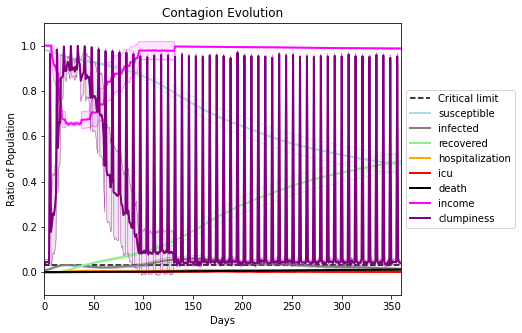

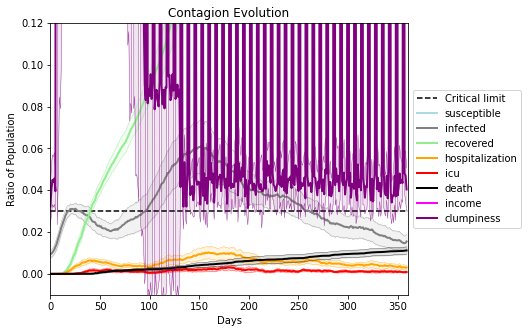

In [10]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.995
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[7863, 4750, 6181, 2949, 1905, 8684, 9974, 9194, 416, 6189, 5375, 7680, 9159, 7483, 7797, 2923, 3721, 4853, 3439, 6974]
Average similarity between family members is 0.9380310479463005 at temperature -0.994
Average similarity between family and home is 0.9998536553949285 at temperature -1
Average similarity between students and their classroom is 0.5896686509729429 at temperature -0.994
Average classroom occupancy is 4.2 and number classrooms is 70
Average similarity between workers is 0.8942634968595985 at temperature -0.994
Average office occupancy is 3.3435897435897437 and number offices is 195
Average friend similarity for adults: 0.8564292850299606 for kids: 0.6938888137471163
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousB

avg restaurant similarity 0.6066978887692199
avg restaurant similarity 0.6021495127330109
avg restaurant similarity 0.6460059364943354
avg restaurant similarity 0.5711635992641008
avg restaurant similarity 0.5759106398548007
avg restaurant similarity 0.5559744206419811
avg restaurant similarity 0.5971721860467293
avg restaurant similarity 0.6212752938410739
avg restaurant similarity 0.5623860714585955
avg restaurant similarity 0.5851624159400911
avg restaurant similarity 0.5697848734703052
avg restaurant similarity 0.5650813371665251
avg restaurant similarity 0.6199135052488071
avg restaurant similarity 0.5781258670679514
avg restaurant similarity 0.5875212631489048
avg restaurant similarity 0.5720608678486392
avg restaurant similarity 0.5624725888583676
avg restaurant similarity 0.5642526067614291
avg restaurant similarity 0.5584753197673543
avg restaurant similarity 0.6013167507062451
avg restaurant similarity 0.5661260679034812
avg restaurant similarity 0.5954854937992194
avg restau

avg restaurant similarity 0.5708566945066591
avg restaurant similarity 0.5563338730155812
avg restaurant similarity 0.607215502141082
avg restaurant similarity 0.5637980662442696
avg restaurant similarity 0.5685677387208713
avg restaurant similarity 0.6152741296395905
avg restaurant similarity 0.5538021589914044
avg restaurant similarity 0.540398937881545
avg restaurant similarity 0.5909567993168955
avg restaurant similarity 0.5380497073256211
avg restaurant similarity 0.5741805098318967
avg restaurant similarity 0.5654599998526985
avg restaurant similarity 0.541660145823423
avg restaurant similarity 0.565459000630072
avg restaurant similarity 0.610954753835215
avg restaurant similarity 0.5623207343065283
avg restaurant similarity 0.6048132071669315
avg restaurant similarity 0.6225619207910285
avg restaurant similarity 0.574991060389246
avg restaurant similarity 0.5978581382405178
avg restaurant similarity 0.5912760721689945
avg restaurant similarity 0.6060477616994135
avg restaurant s

avg restaurant similarity 0.5051727538100005
avg restaurant similarity 0.5947773809518666
avg restaurant similarity 0.6192060813211449
avg restaurant similarity 0.5941895564192268
avg restaurant similarity 0.5944076468604843
avg restaurant similarity 0.6036903516277653
avg restaurant similarity 0.5755396180688646
avg restaurant similarity 0.600597776772069
avg restaurant similarity 0.5736637355510842
avg restaurant similarity 0.5594049432556362
avg restaurant similarity 0.6194013634827726
avg restaurant similarity 0.5971923998780818
avg restaurant similarity 0.6051192686631595
avg restaurant similarity 0.6451592319753272
avg restaurant similarity 0.5700026845211768
avg restaurant similarity 0.5283363910653768
avg restaurant similarity 0.5771770624303026
avg restaurant similarity 0.5904446600012708
avg restaurant similarity 0.5625102591153189
avg restaurant similarity 0.6019498580640401
avg restaurant similarity 0.6228710277207885
avg restaurant similarity 0.5613520884997882
avg restaur

avg restaurant similarity 0.5492369644227971
avg restaurant similarity 0.6090346146213355
avg restaurant similarity 0.590283910747291
avg restaurant similarity 0.593267236276891
avg restaurant similarity 0.6285758621502379
avg restaurant similarity 0.5645548454831515
avg restaurant similarity 0.5758585400926771
avg restaurant similarity 0.5558561001674819
avg restaurant similarity 0.6192847643360756
avg restaurant similarity 0.5043664897904756
avg restaurant similarity 0.5832824243389235
avg restaurant similarity 0.551956416679861
avg restaurant similarity 0.6052913227613796
avg restaurant similarity 0.5386266153193967
avg restaurant similarity 0.6367858186622635
avg restaurant similarity 0.5995678642884051
avg restaurant similarity 0.5700743701261342
avg restaurant similarity 0.563787931364873
avg restaurant similarity 0.6100051011648555
avg restaurant similarity 0.5769978452262168
avg restaurant similarity 0.5656738683293075
avg restaurant similarity 0.58263926855895
avg restaurant s

avg restaurant similarity 0.5262499038484654
avg restaurant similarity 0.5399479152220856
avg restaurant similarity 0.5791024079846577
avg restaurant similarity 0.555344351638454
avg restaurant similarity 0.5393519553332479
avg restaurant similarity 0.5559696167247379
avg restaurant similarity 0.5214090661440167
avg restaurant similarity 0.5966750908182752
avg restaurant similarity 0.5887782375005064
avg restaurant similarity 0.5426341059953267
avg restaurant similarity 0.5022183843071217
avg restaurant similarity 0.5578485584127718
avg restaurant similarity 0.5632639215378712
avg restaurant similarity 0.5402138224054485
avg restaurant similarity 0.5222460574282975
avg restaurant similarity 0.5398364210142453
avg restaurant similarity 0.5443982649103429
avg restaurant similarity 0.5443652318697939
avg restaurant similarity 0.5868450332630695
avg restaurant similarity 0.6541970950909777
avg restaurant similarity 0.5399965111232962
avg restaurant similarity 0.5889138719578015
avg restaur

avg restaurant similarity 0.5025614991644417
avg restaurant similarity 0.6064473284630807
avg restaurant similarity 0.5873188482028844
avg restaurant similarity 0.5064465117866291
avg restaurant similarity 0.5779070541465091
avg restaurant similarity 0.5301462190697864
avg restaurant similarity 0.5544826033385636
avg restaurant similarity 0.5024205395743817
avg restaurant similarity 0.5461686514503721
avg restaurant similarity 0.5165404123717893
avg restaurant similarity 0.5163374143142997
avg restaurant similarity 0.5388658989079128
avg restaurant similarity 0.5918907344183085
avg restaurant similarity 0.5832886951849996
avg restaurant similarity 0.5515461805848931
avg restaurant similarity 0.5597259976370801
avg restaurant similarity 0.6057481599249551
avg restaurant similarity 0.5418474799506374
avg restaurant similarity 0.5572460617906861
avg restaurant similarity 0.5722463692515679
avg restaurant similarity 0.5464085581956866
avg restaurant similarity 0.54120802542802
avg restaura

avg restaurant similarity 0.5346675778432753
avg restaurant similarity 0.5232097224540808
avg restaurant similarity 0.5453048635786375
avg restaurant similarity 0.5144790107014718
avg restaurant similarity 0.539657385966057
avg restaurant similarity 0.5348151703281006
avg restaurant similarity 0.5506404611087824
avg restaurant similarity 0.5898119783391476
avg restaurant similarity 0.5184337092723499
avg restaurant similarity 0.5263049099674694
avg restaurant similarity 0.576713896137807
avg restaurant similarity 0.525728273512685
avg restaurant similarity 0.5794107931327922
avg restaurant similarity 0.5517481507564385
avg restaurant similarity 0.47717974851259315
avg restaurant similarity 0.5567697869325222
avg restaurant similarity 0.5411709188605268
avg restaurant similarity 0.5085301833758723
avg restaurant similarity 0.5180209988459304
avg restaurant similarity 0.6556877081043944
avg restaurant similarity 0.5029652385900358
avg restaurant similarity 0.5593531204713351
avg restaura

avg restaurant similarity 0.5550344423960821
avg restaurant similarity 0.5507813497898054
avg restaurant similarity 0.5213158591267858
avg restaurant similarity 0.5579011220199714
avg restaurant similarity 0.5573360412250682
avg restaurant similarity 0.5016528356672774
avg restaurant similarity 0.5382612768231667
avg restaurant similarity 0.5594289940297769
avg restaurant similarity 0.5323606790601948
avg restaurant similarity 0.5439552530399845
avg restaurant similarity 0.48482197175135044
avg restaurant similarity 0.5937825578914363
avg restaurant similarity 0.5186662283489385
avg restaurant similarity 0.553137230880953
avg restaurant similarity 0.5907085905426502
avg restaurant similarity 0.5604223440428552
avg restaurant similarity 0.5150467088035559
avg restaurant similarity 0.5042325754669857
avg restaurant similarity 0.5834834177428656
avg restaurant similarity 0.538888529624751
avg restaurant similarity 0.5699240716727225
avg restaurant similarity 0.5118946515069194
avg restaur

avg restaurant similarity 0.6273981426317755
avg restaurant similarity 0.5823451713197967
avg restaurant similarity 0.5832176878334333
avg restaurant similarity 0.5845469680697546
avg restaurant similarity 0.5717853549787595
avg restaurant similarity 0.5771779699857725
avg restaurant similarity 0.6610235277784935
avg restaurant similarity 0.6076619768839387
avg restaurant similarity 0.6184539963560827
avg restaurant similarity 0.5843448369699249
avg restaurant similarity 0.589491895555223
avg restaurant similarity 0.5773455878853968
avg restaurant similarity 0.5844035795264598
avg restaurant similarity 0.6115409697283487
avg restaurant similarity 0.5711884739102048
avg restaurant similarity 0.5559735276616815
avg restaurant similarity 0.5436721135822149
avg restaurant similarity 0.5570018605328206
avg restaurant similarity 0.6398207369261573
avg restaurant similarity 0.556783678319476
avg restaurant similarity 0.5825128554393701
avg restaurant similarity 0.6279212598468114
avg restaura

avg restaurant similarity 0.6184644069048125
avg restaurant similarity 0.5423747149950847
avg restaurant similarity 0.5997924271774756
avg restaurant similarity 0.575001146433763
avg restaurant similarity 0.6487099232197479
avg restaurant similarity 0.5549010865102731
avg restaurant similarity 0.557351263986145
avg restaurant similarity 0.6166819721756156
avg restaurant similarity 0.6127379636788268
avg restaurant similarity 0.6327578527764756
avg restaurant similarity 0.5947470207113261
avg restaurant similarity 0.6070739330384101
avg restaurant similarity 0.616291238189875
avg restaurant similarity 0.6210546123848354
avg restaurant similarity 0.5775716748139048
avg restaurant similarity 0.6132062616198888
avg restaurant similarity 0.5684451380140573
avg restaurant similarity 0.5932028750769812
avg restaurant similarity 0.5798707495079392
avg restaurant similarity 0.6136334195401172
avg restaurant similarity 0.6399564324469519
avg restaurant similarity 0.6097671127577714
avg restauran

avg restaurant similarity 0.594829468604555
avg restaurant similarity 0.5690923843072131
avg restaurant similarity 0.5934194181496952
avg restaurant similarity 0.5339780598675574
avg restaurant similarity 0.6008026817201083
avg restaurant similarity 0.5629167015938029
avg restaurant similarity 0.5446216953456171
avg restaurant similarity 0.597906059563688
avg restaurant similarity 0.5597950167651774
avg restaurant similarity 0.592714780423039
avg restaurant similarity 0.503229583757404
avg restaurant similarity 0.5321050862687952
avg restaurant similarity 0.5749154148900157
avg restaurant similarity 0.589541382857723
avg restaurant similarity 0.5504739529421611
avg restaurant similarity 0.5760854995339791
avg restaurant similarity 0.5908958832599974
avg restaurant similarity 0.568731850514625
avg restaurant similarity 0.5500760741845679
avg restaurant similarity 0.530349907471333
avg restaurant similarity 0.5425618754089796
avg restaurant similarity 0.5379644690153778
avg restaurant si

avg restaurant similarity 0.5052529651472942
avg restaurant similarity 0.6040163332512061
avg restaurant similarity 0.568746770940731
avg restaurant similarity 0.5439837936420898
avg restaurant similarity 0.5929536049200456
avg restaurant similarity 0.5002700835666001
avg restaurant similarity 0.5380753524894684
avg restaurant similarity 0.5785633065311357
avg restaurant similarity 0.5301442916083989
avg restaurant similarity 0.5407892039751421
avg restaurant similarity 0.5898599122788918
avg restaurant similarity 0.6168343048377201
avg restaurant similarity 0.5677844293266178
avg restaurant similarity 0.5929162329749675
avg restaurant similarity 0.6233034449265575
avg restaurant similarity 0.5543873605043028
avg restaurant similarity 0.5715056523186665
avg restaurant similarity 0.5655454920405842
avg restaurant similarity 0.5426588418198429
avg restaurant similarity 0.524728668658918
avg restaurant similarity 0.4976653209675632
avg restaurant similarity 0.5571928943431362
avg restaura

avg restaurant similarity 0.5589157027141575
avg restaurant similarity 0.5467046635034596
avg restaurant similarity 0.5937919114267605
avg restaurant similarity 0.6154286087297666
avg restaurant similarity 0.5688942726489332
avg restaurant similarity 0.6208573642266701
avg restaurant similarity 0.5206775805400725
avg restaurant similarity 0.592888336759441
avg restaurant similarity 0.5866765243149848
avg restaurant similarity 0.5807959501844893
avg restaurant similarity 0.547371343682974
avg restaurant similarity 0.522307075501569
avg restaurant similarity 0.5695286989923011
avg restaurant similarity 0.6193914586459651
avg restaurant similarity 0.5551200028392447
avg restaurant similarity 0.5879382872255591
avg restaurant similarity 0.5595051845422949
avg restaurant similarity 0.5768962450223896
avg restaurant similarity 0.5541191154613615
avg restaurant similarity 0.5517813638819893
avg restaurant similarity 0.5991936916811681
avg restaurant similarity 0.5862675687420088
avg restauran

avg restaurant similarity 0.5857383927783341
avg restaurant similarity 0.5868953960328385
avg restaurant similarity 0.5499574816365125
avg restaurant similarity 0.5832752311802457
avg restaurant similarity 0.647272621978172
avg restaurant similarity 0.5373247772313452
avg restaurant similarity 0.5685092615889048
avg restaurant similarity 0.5746530560070754
avg restaurant similarity 0.6066098479699781
avg restaurant similarity 0.5957586609280968
avg restaurant similarity 0.6084660315886024
avg restaurant similarity 0.6271561863320105
avg restaurant similarity 0.6069948737403209
avg restaurant similarity 0.6003211743785265
avg restaurant similarity 0.5720780078020106
avg restaurant similarity 0.5379881284951317
avg restaurant similarity 0.5670225580458467
avg restaurant similarity 0.6249509760211884
avg restaurant similarity 0.5822795386422013
avg restaurant similarity 0.5639893675342141
avg restaurant similarity 0.521046267354581
avg restaurant similarity 0.5758378674810265
avg restaura

avg restaurant similarity 0.6203039612498409
avg restaurant similarity 0.591686578139365
avg restaurant similarity 0.5772992498911528
avg restaurant similarity 0.581702063339342
avg restaurant similarity 0.6605843401269617
avg restaurant similarity 0.5641953714561426
avg restaurant similarity 0.5256540631861796
avg restaurant similarity 0.49190192347554773
avg restaurant similarity 0.5910117756850748
avg restaurant similarity 0.543787698481267
avg restaurant similarity 0.5082410143293792
avg restaurant similarity 0.6419328482667587
avg restaurant similarity 0.5906510350717595
avg restaurant similarity 0.6185529978118698
avg restaurant similarity 0.5093393207862505
avg restaurant similarity 0.5477186219181119
avg restaurant similarity 0.6113726626940779
avg restaurant similarity 0.5668675177508946
avg restaurant similarity 0.5702021368235481
avg restaurant similarity 0.5689628711597897
avg restaurant similarity 0.5919312195691647
avg restaurant similarity 0.6039592871078182
avg restaura

avg restaurant similarity 0.5882382059005568
avg restaurant similarity 0.5627566327753982
avg restaurant similarity 0.5292475806770837
avg restaurant similarity 0.6188298466573121
avg restaurant similarity 0.6985419695064096
avg restaurant similarity 0.5562972150995711
avg restaurant similarity 0.537757023152635
avg restaurant similarity 0.5984555795387864
avg restaurant similarity 0.5442171725955841
avg restaurant similarity 0.5905737033620206
avg restaurant similarity 0.5201392077386968
avg restaurant similarity 0.5746272787061546
avg restaurant similarity 0.5765925890781516
avg restaurant similarity 0.6267933995659967
avg restaurant similarity 0.5446678586154015
avg restaurant similarity 0.634237454143995
avg restaurant similarity 0.5614487811914347
avg restaurant similarity 0.6582066059315624
avg restaurant similarity 0.5077225770163367
avg restaurant similarity 0.5577948737326281
avg restaurant similarity 0.5465060997460821
avg restaurant similarity 0.5820934906674894
avg restaura

avg restaurant similarity 0.5557171780254941
avg restaurant similarity 0.5564072733644919
avg restaurant similarity 0.5324680152023286
avg restaurant similarity 0.5208582321595729
avg restaurant similarity 0.5153857615810012
avg restaurant similarity 0.5594964315518213
avg restaurant similarity 0.5602996299354563
avg restaurant similarity 0.5398572802360286
avg restaurant similarity 0.571108073141311
avg restaurant similarity 0.5718448151299184
avg restaurant similarity 0.5355335363083191
avg restaurant similarity 0.5936080053680843
avg restaurant similarity 0.5609844959200455
avg restaurant similarity 0.5548409605539153
avg restaurant similarity 0.5913654768224531
avg restaurant similarity 0.567729774743264
avg restaurant similarity 0.611350487570775
avg restaurant similarity 0.5799523727349505
avg restaurant similarity 0.5649912034865482
avg restaurant similarity 0.6156372350656417
avg restaurant similarity 0.6187915760631887
avg restaurant similarity 0.5876426271569483
avg restauran

avg restaurant similarity 0.5497499371403023
avg restaurant similarity 0.535126555763722
avg restaurant similarity 0.5727642284214618
avg restaurant similarity 0.5917681686307147
avg restaurant similarity 0.5857442221959795
avg restaurant similarity 0.6822247070068089
avg restaurant similarity 0.5627237824187811
avg restaurant similarity 0.5173572966466398
avg restaurant similarity 0.5826324612827349
avg restaurant similarity 0.589326335965451
avg restaurant similarity 0.5508985636653595
avg restaurant similarity 0.5974855076685246
avg restaurant similarity 0.5936811218251624
avg restaurant similarity 0.5726915255513135
avg restaurant similarity 0.48673015903573247
avg restaurant similarity 0.5687210886735542
avg restaurant similarity 0.5037553349598825
avg restaurant similarity 0.5501160850853172
avg restaurant similarity 0.5646619154972625
avg restaurant similarity 0.6118798883304769
avg restaurant similarity 0.5784286488603521
avg restaurant similarity 0.5470736665664152
avg restaur

avg restaurant similarity 0.6067044026358055
avg restaurant similarity 0.5630900392579736
avg restaurant similarity 0.5746583136673736
avg restaurant similarity 0.600535354497111
avg restaurant similarity 0.6082004735155331
avg restaurant similarity 0.5608027640151491
avg restaurant similarity 0.5981548940592398
avg restaurant similarity 0.6201940129189502
avg restaurant similarity 0.5988512889240649
avg restaurant similarity 0.5972158087069297
avg restaurant similarity 0.5857689115454956
avg restaurant similarity 0.5961972048702714
avg restaurant similarity 0.5773416528522681
avg restaurant similarity 0.5813305975600586
avg restaurant similarity 0.5699386714705016
avg restaurant similarity 0.5505827069751428
avg restaurant similarity 0.585111796074714
avg restaurant similarity 0.5950867892751094
avg restaurant similarity 0.6362487885993177
avg restaurant similarity 0.5736636020111197
avg restaurant similarity 0.5764330187774012
avg restaurant similarity 0.5929191401486442
avg restaura

avg restaurant similarity 0.5722552904479677
avg restaurant similarity 0.5768708097391343
avg restaurant similarity 0.5908922800765174
avg restaurant similarity 0.5884857206156785
avg restaurant similarity 0.5504428119435274
avg restaurant similarity 0.5956995556432911
avg restaurant similarity 0.5678682066956154
avg restaurant similarity 0.5811635957257661
avg restaurant similarity 0.6185254702593205
avg restaurant similarity 0.597126150419936
avg restaurant similarity 0.6130965855167062
avg restaurant similarity 0.5735663431735205
avg restaurant similarity 0.5390187463025699
avg restaurant similarity 0.5476676796506987
avg restaurant similarity 0.5823636076699488
avg restaurant similarity 0.5722233739382316
avg restaurant similarity 0.6071921502804729
avg restaurant similarity 0.6348407703223763
avg restaurant similarity 0.5945770246482998
avg restaurant similarity 0.5755752848071701
avg restaurant similarity 0.5870118301328491
avg restaurant similarity 0.5937354490286325
avg restaur

avg restaurant similarity 0.5268625601421053
avg restaurant similarity 0.5256176465382353
avg restaurant similarity 0.5770822071658039
avg restaurant similarity 0.6038152982319522
avg restaurant similarity 0.5845842998169726
avg restaurant similarity 0.5565688608393544
avg restaurant similarity 0.5608249584046758
avg restaurant similarity 0.5775410883466705
avg restaurant similarity 0.5728690942582135
avg restaurant similarity 0.5482838175715623
avg restaurant similarity 0.5815112973385765
avg restaurant similarity 0.5123317776883888
avg restaurant similarity 0.5429347216259333
avg restaurant similarity 0.5595627185986648
avg restaurant similarity 0.5694328784121112
avg restaurant similarity 0.6606809112551922
avg restaurant similarity 0.5857867776812749
avg restaurant similarity 0.5756596002584572
avg restaurant similarity 0.5735595309117434
avg restaurant similarity 0.5814872792058027
avg restaurant similarity 0.5447481982809137
avg restaurant similarity 0.543801231103593
avg restaur

avg restaurant similarity 0.6388223603978029
avg restaurant similarity 0.5604768908277789
avg restaurant similarity 0.6047176603259143
avg restaurant similarity 0.5323260184386409
avg restaurant similarity 0.5790685443446527
avg restaurant similarity 0.5690425409069413
avg restaurant similarity 0.49562071178878647
avg restaurant similarity 0.6239278512069296
avg restaurant similarity 0.5877817816306111
avg restaurant similarity 0.5363225765801342
avg restaurant similarity 0.5856472679808861
avg restaurant similarity 0.5496962081482226
avg restaurant similarity 0.530838574877532
avg restaurant similarity 0.5682399104223235
avg restaurant similarity 0.5717914580988458
avg restaurant similarity 0.5732469230787122
avg restaurant similarity 0.5074851429226377
avg restaurant similarity 0.595506036074597
avg restaurant similarity 0.5450513376720607
avg restaurant similarity 0.5218301275967571
avg restaurant similarity 0.5913992339638133
avg restaurant similarity 0.6293470243368902
avg restaur

avg restaurant similarity 0.5225970734454335
avg restaurant similarity 0.5435439306580425
avg restaurant similarity 0.5831887910010207
avg restaurant similarity 0.5731463672547906
avg restaurant similarity 0.5162806383574234
avg restaurant similarity 0.5783686021228441
avg restaurant similarity 0.5543611534445599
avg restaurant similarity 0.5646162729094826
avg restaurant similarity 0.565594351375313
avg restaurant similarity 0.5821234178632628
avg restaurant similarity 0.5976045173376334
avg restaurant similarity 0.5506188622672032
avg restaurant similarity 0.5677727600839771
avg restaurant similarity 0.6422930902817279
avg restaurant similarity 0.6141164582406545
avg restaurant similarity 0.5739129595075981
avg restaurant similarity 0.5943140705384676
avg restaurant similarity 0.5375469763045387
avg restaurant similarity 0.5647135146161244
avg restaurant similarity 0.5984995348088662
avg restaurant similarity 0.5646845986362679
avg restaurant similarity 0.5755039633327698
avg restaur

avg restaurant similarity 0.548378107255204
avg restaurant similarity 0.580762712433239
avg restaurant similarity 0.6167369281400709
avg restaurant similarity 0.5820969729147795
avg restaurant similarity 0.5586171038368214
avg restaurant similarity 0.5914556752586966
avg restaurant similarity 0.5855192083120374
avg restaurant similarity 0.56548538711616
avg restaurant similarity 0.5941368782367267
avg restaurant similarity 0.5882853180988822
avg restaurant similarity 0.5035008406353811
avg restaurant similarity 0.5409032640190883
avg restaurant similarity 0.564735093222765
avg restaurant similarity 0.578864322024141
avg restaurant similarity 0.6070809903358899
avg restaurant similarity 0.5934698144700574
avg restaurant similarity 0.5828769197626875
avg restaurant similarity 0.5440602095211285
avg restaurant similarity 0.5573268617880542
avg restaurant similarity 0.5614680963600507
avg restaurant similarity 0.5953060571432882
avg restaurant similarity 0.56424063889628
avg restaurant sim

avg restaurant similarity 0.5609960315954712
avg restaurant similarity 0.6007533647322839
avg restaurant similarity 0.5322493615191165
avg restaurant similarity 0.5676990747049538
avg restaurant similarity 0.5477977606368162
avg restaurant similarity 0.6249061088215359
avg restaurant similarity 0.5856654826273957
avg restaurant similarity 0.5493646651482368
avg restaurant similarity 0.5714886620158445
avg restaurant similarity 0.5998678065090486
avg restaurant similarity 0.545310604384787
avg restaurant similarity 0.5319367473404182
avg restaurant similarity 0.5766453644600877
avg restaurant similarity 0.538388624551142
avg restaurant similarity 0.5875023636206932
avg restaurant similarity 0.5373453583253409
avg restaurant similarity 0.5520590206897795
avg restaurant similarity 0.6001598852078087
avg restaurant similarity 0.5542414081405608
avg restaurant similarity 0.5849994198707127
avg restaurant similarity 0.548575937107549
avg restaurant similarity 0.5825701360496357
avg restauran

avg restaurant similarity 0.5310768662146034
avg restaurant similarity 0.6180778212813115
avg restaurant similarity 0.6288685999822541
avg restaurant similarity 0.5807718367388485
avg restaurant similarity 0.5551915272295829
avg restaurant similarity 0.5106154423883269
avg restaurant similarity 0.549346163828446
avg restaurant similarity 0.5663775685295122
avg restaurant similarity 0.5519536851802855
avg restaurant similarity 0.5127576309274022
avg restaurant similarity 0.5353625294231378
avg restaurant similarity 0.5445957766771309
avg restaurant similarity 0.5369138375187683
avg restaurant similarity 0.5410253967018669
avg restaurant similarity 0.5336978372804216
avg restaurant similarity 0.6239447533700093
avg restaurant similarity 0.5852825277693928
avg restaurant similarity 0.5249715708519453
avg restaurant similarity 0.5388731367865713
avg restaurant similarity 0.54943945983858
avg restaurant similarity 0.5352198878416661
avg restaurant similarity 0.5813800854946581
avg restauran

avg restaurant similarity 0.5729485085314163
avg restaurant similarity 0.5739011301861823
avg restaurant similarity 0.5575475816499544
avg restaurant similarity 0.5859446338061839
avg restaurant similarity 0.5631786050665359
avg restaurant similarity 0.5846048971391813
avg restaurant similarity 0.5736556001195484
avg restaurant similarity 0.5347600966908491
avg restaurant similarity 0.5957784779660575
avg restaurant similarity 0.5648631515144293
avg restaurant similarity 0.6069046676100208
avg restaurant similarity 0.5993139408606192
avg restaurant similarity 0.5894305567459018
avg restaurant similarity 0.5801678644661412
avg restaurant similarity 0.5586202903329766
avg restaurant similarity 0.572510429551099
avg restaurant similarity 0.6118141309040261
avg restaurant similarity 0.5602524431022212
avg restaurant similarity 0.5238423304719707
avg restaurant similarity 0.6336322982852435
avg restaurant similarity 0.5810605367029044
avg restaurant similarity 0.5807759850577081
avg restaur

avg restaurant similarity 0.5728394024338122
avg restaurant similarity 0.5343960279720273
avg restaurant similarity 0.5223854019716532
avg restaurant similarity 0.4934866675616864
avg restaurant similarity 0.5513153502486612
avg restaurant similarity 0.5828084802566834
avg restaurant similarity 0.5701170841611256
avg restaurant similarity 0.5943281104574802
avg restaurant similarity 0.6114282664237658
avg restaurant similarity 0.5310045045102596
avg restaurant similarity 0.5930397917659456
avg restaurant similarity 0.5774762415564276
avg restaurant similarity 0.6362871920089397
avg restaurant similarity 0.5867715166420513
avg restaurant similarity 0.5800294278701198
avg restaurant similarity 0.6515397881600646
avg restaurant similarity 0.5689237708089391
avg restaurant similarity 0.6249940421501582
avg restaurant similarity 0.5811086110577048
avg restaurant similarity 0.570365518209988
avg restaurant similarity 0.5542830325264114
avg restaurant similarity 0.5617032433713043
avg restaur

avg restaurant similarity 0.5827377073969754
avg restaurant similarity 0.5866081816423264
avg restaurant similarity 0.5819056289932409
avg restaurant similarity 0.57491434534162
avg restaurant similarity 0.5497725687639292
avg restaurant similarity 0.5761613478391937
avg restaurant similarity 0.5832185163915131
avg restaurant similarity 0.5994691496386573
avg restaurant similarity 0.5861759299788828
avg restaurant similarity 0.540275900061911
avg restaurant similarity 0.5734480197614442
avg restaurant similarity 0.5479109617036035
avg restaurant similarity 0.5427003554610138
avg restaurant similarity 0.6430898281642159
avg restaurant similarity 0.6118041203727057
avg restaurant similarity 0.5778129338285685
avg restaurant similarity 0.5155405069631631
avg restaurant similarity 0.5500677662947735
avg restaurant similarity 0.6325370435067305
avg restaurant similarity 0.6293963464010426
avg restaurant similarity 0.590498811730718
avg restaurant similarity 0.596205770678156
avg restaurant 

avg restaurant similarity 0.5466068897576392
avg restaurant similarity 0.5792576132465915
avg restaurant similarity 0.5740196921235344
avg restaurant similarity 0.6217475311061895
avg restaurant similarity 0.5882398812846583
avg restaurant similarity 0.5669597153841524
avg restaurant similarity 0.6049706524442406
avg restaurant similarity 0.6121014196999082
avg restaurant similarity 0.615858541391368
avg restaurant similarity 0.5658682826620028
avg restaurant similarity 0.6686508663877061
avg restaurant similarity 0.566323711419236
avg restaurant similarity 0.574903377808864
avg restaurant similarity 0.5987596897593644
avg restaurant similarity 0.5607383577874475
avg restaurant similarity 0.5722391495521785
avg restaurant similarity 0.5667410336674218
avg restaurant similarity 0.58103149611261
avg restaurant similarity 0.5099178743209746
avg restaurant similarity 0.5486994545587895
avg restaurant similarity 0.5448981469190433
avg restaurant similarity 0.6057955761881333
avg restaurant 

avg restaurant similarity 0.5884104267839457
avg restaurant similarity 0.583527153475005
avg restaurant similarity 0.5270702507546884
avg restaurant similarity 0.6159367041650144
avg restaurant similarity 0.5361398532854786
avg restaurant similarity 0.5721523620880686
avg restaurant similarity 0.5684620803966012
avg restaurant similarity 0.5890345575348596
avg restaurant similarity 0.5411037276617323
avg restaurant similarity 0.5678964879910837
avg restaurant similarity 0.5483640503093546
avg restaurant similarity 0.5585261495206254
avg restaurant similarity 0.5752602450415351
avg restaurant similarity 0.5888591759280797
avg restaurant similarity 0.5262410247579846
avg restaurant similarity 0.589931493564728
avg restaurant similarity 0.6207385803626028
avg restaurant similarity 0.5405942756893848
avg restaurant similarity 0.5725548823759371
avg restaurant similarity 0.5182933074938347
avg restaurant similarity 0.5596957475153029
avg restaurant similarity 0.5688736688849697
avg restaura

avg restaurant similarity 0.5624680418343204
avg restaurant similarity 0.5645003444105949
avg restaurant similarity 0.5740954016654789
avg restaurant similarity 0.4646934812037279
avg restaurant similarity 0.5640487367220265
avg restaurant similarity 0.6029804105409059
avg restaurant similarity 0.5409664703489574
avg restaurant similarity 0.5438357527251908
avg restaurant similarity 0.5418701861045572
avg restaurant similarity 0.4981048811719937
avg restaurant similarity 0.51632179379146
avg restaurant similarity 0.5939889883186874
avg restaurant similarity 0.511708345822987
avg restaurant similarity 0.5215573514897877
avg restaurant similarity 0.5308055263856835
avg restaurant similarity 0.5479139682335942
avg restaurant similarity 0.582096205067468
avg restaurant similarity 0.5229947761775567
avg restaurant similarity 0.5765826468733871
avg restaurant similarity 0.5641242631040029
avg restaurant similarity 0.5479000750334541
avg restaurant similarity 0.5296783072088033
avg restaurant

avg restaurant similarity 0.5639097111594977
avg restaurant similarity 0.5919532958966596
avg restaurant similarity 0.5574992574289915
avg restaurant similarity 0.5966650606402464
avg restaurant similarity 0.6209963815267329
avg restaurant similarity 0.6341124558918064
avg restaurant similarity 0.6258614401318529
avg restaurant similarity 0.6078251045467216
avg restaurant similarity 0.5817280236727984
avg restaurant similarity 0.6185024965970163
avg restaurant similarity 0.6129629211140408
avg restaurant similarity 0.5835606675829222
avg restaurant similarity 0.5846509192619268
avg restaurant similarity 0.6317892216699921
avg restaurant similarity 0.5505360199380869
avg restaurant similarity 0.6265494942578717
avg restaurant similarity 0.614066630548362
avg restaurant similarity 0.5740417795612323
avg restaurant similarity 0.6134145067975756
avg restaurant similarity 0.5675781019815007
avg restaurant similarity 0.615565522271029
avg restaurant similarity 0.5325142509326282
avg restaura

avg restaurant similarity 0.5616900578623455
avg restaurant similarity 0.6065112993536794
avg restaurant similarity 0.5547769324202416
avg restaurant similarity 0.5941963108149994
avg restaurant similarity 0.5879280165102101
avg restaurant similarity 0.5572895617510377
avg restaurant similarity 0.5793569366564046
avg restaurant similarity 0.5466078189237059
avg restaurant similarity 0.5445715071307108
avg restaurant similarity 0.5546439980025443
avg restaurant similarity 0.5645271845013223
avg restaurant similarity 0.6097668163817804
avg restaurant similarity 0.5818815166737831
avg restaurant similarity 0.5444831349126321
avg restaurant similarity 0.5908629957427788
avg restaurant similarity 0.5790610873605485
avg restaurant similarity 0.5645507314061878
avg restaurant similarity 0.5680303777163547
avg restaurant similarity 0.5780436861919391
avg restaurant similarity 0.554545220448934
avg restaurant similarity 0.6274541923520611
avg restaurant similarity 0.6373929101940847
avg restaur

avg restaurant similarity 0.5696965265641281
avg restaurant similarity 0.584704245602837
avg restaurant similarity 0.5224063630921492
avg restaurant similarity 0.5590627763774879
avg restaurant similarity 0.570357192504721
avg restaurant similarity 0.5961771065225248
avg restaurant similarity 0.5781307604873027
avg restaurant similarity 0.6030688297973006
avg restaurant similarity 0.5505395465909497
avg restaurant similarity 0.5165087720495687
avg restaurant similarity 0.594076518145974
avg restaurant similarity 0.5890610141086992
avg restaurant similarity 0.5693931943697648
avg restaurant similarity 0.6180617747493831
avg restaurant similarity 0.5758786762816942
avg restaurant similarity 0.5525792351276098
avg restaurant similarity 0.5979393990332389
avg restaurant similarity 0.6061869050763105
avg restaurant similarity 0.5654480364647594
avg restaurant similarity 0.5760055873650165
avg restaurant similarity 0.5692660420145278
avg restaurant similarity 0.6112490029207422
avg restauran

avg restaurant similarity 0.6013916464351148
avg restaurant similarity 0.5644185355410423
avg restaurant similarity 0.5652223589008314
avg restaurant similarity 0.6085590115905921
avg restaurant similarity 0.5807006610755798
avg restaurant similarity 0.6062099211653347
avg restaurant similarity 0.5561354422767073
avg restaurant similarity 0.5545021562486535
avg restaurant similarity 0.6116784699431599
avg restaurant similarity 0.5590141850272682
avg restaurant similarity 0.6282621048538746
avg restaurant similarity 0.6058758524891996
avg restaurant similarity 0.5876482728206162
avg restaurant similarity 0.5963474685764516
avg restaurant similarity 0.5999004386616731
avg restaurant similarity 0.5485650836834347
avg restaurant similarity 0.5399913005984756
avg restaurant similarity 0.5796541670815598
avg restaurant similarity 0.6375019887340672
avg restaurant similarity 0.5987654453288693
avg restaurant similarity 0.5686435406739885
avg restaurant similarity 0.5803715725843717
avg restau

avg restaurant similarity 0.5461027706172625
avg restaurant similarity 0.5874993955142223
avg restaurant similarity 0.6194590203516936
avg restaurant similarity 0.6159756750610903
avg restaurant similarity 0.5503256835176227
avg restaurant similarity 0.6044296100280714
avg restaurant similarity 0.5450001492020078
avg restaurant similarity 0.5931374955754541
avg restaurant similarity 0.6564299022581352
avg restaurant similarity 0.5676996977025718
avg restaurant similarity 0.5877212719787169
avg restaurant similarity 0.5854194992122667
avg restaurant similarity 0.5963769030723164
avg restaurant similarity 0.5870630825358673
avg restaurant similarity 0.5493379527151319
avg restaurant similarity 0.5821373013467774
avg restaurant similarity 0.5717191228530525
avg restaurant similarity 0.5678973930049313
avg restaurant similarity 0.6078578693778636
avg restaurant similarity 0.5745219857896072
avg restaurant similarity 0.611938034981038
avg restaurant similarity 0.5245981497099698
avg restaur

avg restaurant similarity 0.6228335524714554
avg restaurant similarity 0.6692468504732728
avg restaurant similarity 0.5644939913773399
avg restaurant similarity 0.5447248801814373
avg restaurant similarity 0.5902590186048076
avg restaurant similarity 0.6092127625868301
avg restaurant similarity 0.6224188499483957
avg restaurant similarity 0.6300302267047506
avg restaurant similarity 0.5936158958038558
avg restaurant similarity 0.5719418815932783
avg restaurant similarity 0.5810187220424534
avg restaurant similarity 0.6180746334477819
avg restaurant similarity 0.580846001828783
avg restaurant similarity 0.6232801582869402
avg restaurant similarity 0.5791165107195672
avg restaurant similarity 0.5967552720759367
avg restaurant similarity 0.6126337487414586
avg restaurant similarity 0.5531960221146438
avg restaurant similarity 0.6459896512610757
avg restaurant similarity 0.6227269870469558
avg restaurant similarity 0.6177538162108294
avg restaurant similarity 0.6142726176423653
avg restaur

avg restaurant similarity 0.5799569815178024
avg restaurant similarity 0.6145766858491176
avg restaurant similarity 0.6016359061050887
avg restaurant similarity 0.5788582150164697
avg restaurant similarity 0.5611752856106066
avg restaurant similarity 0.5803599746213002
avg restaurant similarity 0.6322539712940277
avg restaurant similarity 0.5515488833919683
avg restaurant similarity 0.5497714666566755
avg restaurant similarity 0.5947555373635987
avg restaurant similarity 0.6037027212015298
avg restaurant similarity 0.6239174139221587
avg restaurant similarity 0.5503284573959589
avg restaurant similarity 0.5732649321192993
avg restaurant similarity 0.6317887317963119
avg restaurant similarity 0.5943707189321497
avg restaurant similarity 0.6005502765384005
avg restaurant similarity 0.5805710261235334
avg restaurant similarity 0.573585328358297
avg restaurant similarity 0.516158714596356
avg restaurant similarity 0.5847451284781321
avg restaurant similarity 0.5902874838578238
avg restaura

avg restaurant similarity 0.5660684525437747
avg restaurant similarity 0.5581079921836274
avg restaurant similarity 0.5951829771057187
avg restaurant similarity 0.5896619824828115
avg restaurant similarity 0.5298176169958524
avg restaurant similarity 0.6321074871124962
avg restaurant similarity 0.510533312929947
avg restaurant similarity 0.5532329198543136
avg restaurant similarity 0.556109399969428
avg restaurant similarity 0.6145942239119797
avg restaurant similarity 0.5614792791601008
avg restaurant similarity 0.638393264438088
avg restaurant similarity 0.5386579996444993
avg restaurant similarity 0.5839506536649328
avg restaurant similarity 0.6125061099194791
avg restaurant similarity 0.6034537892484526
avg restaurant similarity 0.5548689853650199
avg restaurant similarity 0.5798760812727641
avg restaurant similarity 0.5557614855901483
avg restaurant similarity 0.620000159822687
avg restaurant similarity 0.5454959702940434
avg restaurant similarity 0.5686269642652629
avg restaurant

(<function dict.items>, <function dict.items>, <function dict.items>)

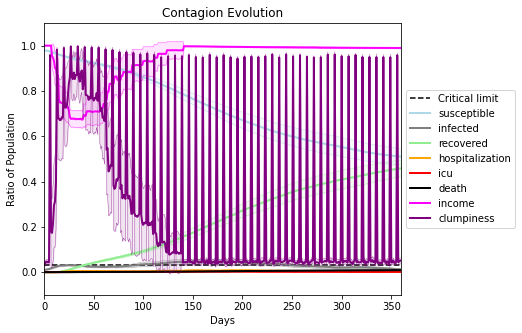

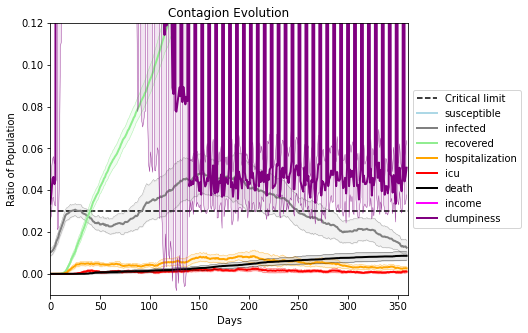

In [11]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.994
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[6077, 4730, 7826, 5901, 9933, 2006, 514, 3801, 5242, 5062, 1300, 5954, 2149, 1325, 3112, 7334, 5605, 9541, 5512, 1814]
Average similarity between family members is 0.9233816676130685 at temperature -0.993
Average similarity between family and home is 0.9998578118238521 at temperature -1
Average similarity between students and their classroom is 0.5696888037321629 at temperature -0.993
Average classroom occupancy is 4.422535211267606 and number classrooms is 71
Average similarity between workers is 0.8833804732840207 at temperature -0.993
Average office occupancy is 3.247422680412371 and number offices is 194
Average friend similarity for adults: 0.842535298292235 for kids: 0.6813341058968705
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Building

avg restaurant similarity 0.6016624427957588
avg restaurant similarity 0.5597973494136763
avg restaurant similarity 0.5914785989768042
avg restaurant similarity 0.5429637020654384
avg restaurant similarity 0.5734969165755975
avg restaurant similarity 0.5759180407600188
avg restaurant similarity 0.6265973849219195
avg restaurant similarity 0.530933284394778
avg restaurant similarity 0.5724537754014773
avg restaurant similarity 0.5679197287272912
avg restaurant similarity 0.5316812491699067
avg restaurant similarity 0.5068375972073957
avg restaurant similarity 0.5661605109659529
avg restaurant similarity 0.5891929350310342
avg restaurant similarity 0.5956017656196981
avg restaurant similarity 0.5882450693192822
avg restaurant similarity 0.5634594474854805
avg restaurant similarity 0.5247427047174142
avg restaurant similarity 0.5756455306294932
avg restaurant similarity 0.5757123356855873
avg restaurant similarity 0.5389272657675933
avg restaurant similarity 0.5305861520554336
avg restaur

avg restaurant similarity 0.5109467046613488
avg restaurant similarity 0.5398588076708266
avg restaurant similarity 0.5623836844744838
avg restaurant similarity 0.569991547080866
avg restaurant similarity 0.48869731521740584
avg restaurant similarity 0.5967577765793227
avg restaurant similarity 0.5457199910809465
avg restaurant similarity 0.5674059644523101
avg restaurant similarity 0.6174371434249522
avg restaurant similarity 0.5350093167707665
avg restaurant similarity 0.5660289185366568
avg restaurant similarity 0.5632142775420811
avg restaurant similarity 0.5088774118837225
avg restaurant similarity 0.5360333852738939
avg restaurant similarity 0.5663804324792607
avg restaurant similarity 0.5453871460105487
avg restaurant similarity 0.5407168224051708
avg restaurant similarity 0.5360253344926613
avg restaurant similarity 0.5524325864696762
avg restaurant similarity 0.530352765925015
avg restaurant similarity 0.5721108673698098
avg restaurant similarity 0.5167566845732048
avg restaur

avg restaurant similarity 0.6131952398146974
avg restaurant similarity 0.5743627722561049
avg restaurant similarity 0.5833204169717912
avg restaurant similarity 0.580466499724686
avg restaurant similarity 0.5783299507147409
avg restaurant similarity 0.5869991398986995
avg restaurant similarity 0.5542067834503194
avg restaurant similarity 0.5969789485184617
avg restaurant similarity 0.4829041645642673
avg restaurant similarity 0.5290797020678373
avg restaurant similarity 0.521514239131997
avg restaurant similarity 0.5492503059717732
avg restaurant similarity 0.5193174789987299
avg restaurant similarity 0.5323698617556153
avg restaurant similarity 0.5088523006218388
avg restaurant similarity 0.5734063134760566
avg restaurant similarity 0.5458905039332791
avg restaurant similarity 0.5529910246189329
avg restaurant similarity 0.5456659931826066
avg restaurant similarity 0.5622122126671767
avg restaurant similarity 0.560414402568717
avg restaurant similarity 0.5676660172311747
avg restauran

avg restaurant similarity 0.5950495614292634
avg restaurant similarity 0.5353848865365051
avg restaurant similarity 0.5040845790906501
avg restaurant similarity 0.517513849215711
avg restaurant similarity 0.5582355673872589
avg restaurant similarity 0.5656198212741168
avg restaurant similarity 0.5741131922440094
avg restaurant similarity 0.5671347769283013
avg restaurant similarity 0.5308424317332627
avg restaurant similarity 0.511405388855818
avg restaurant similarity 0.616054011195715
avg restaurant similarity 0.5215601055398976
avg restaurant similarity 0.4856921232063816
avg restaurant similarity 0.5375483377580567
avg restaurant similarity 0.5673792285503064
avg restaurant similarity 0.5347662359624293
avg restaurant similarity 0.5507954831717069
avg restaurant similarity 0.527081467070124
avg restaurant similarity 0.5915077431904181
avg restaurant similarity 0.5242810366313363
avg restaurant similarity 0.5340255319155142
avg restaurant similarity 0.5016164220024422
avg restaurant

avg restaurant similarity 0.5594949625291008
avg restaurant similarity 0.5464112690936835
avg restaurant similarity 0.5614245331491517
avg restaurant similarity 0.5914199807150052
avg restaurant similarity 0.5826461296001121
avg restaurant similarity 0.5761871429966163
avg restaurant similarity 0.5766681755857481
avg restaurant similarity 0.592160916147791
avg restaurant similarity 0.6294326904306778
avg restaurant similarity 0.6073549316113233
avg restaurant similarity 0.6117999930443394
avg restaurant similarity 0.5862060368420475
avg restaurant similarity 0.5879418968195557
avg restaurant similarity 0.5484139114057865
avg restaurant similarity 0.54219258565091
avg restaurant similarity 0.5721928109822157
avg restaurant similarity 0.5856963592083624
avg restaurant similarity 0.5787703535068115
avg restaurant similarity 0.5676975873108481
avg restaurant similarity 0.5726206756811334
avg restaurant similarity 0.5853681955507894
avg restaurant similarity 0.5575819927712108
avg restauran

avg restaurant similarity 0.5692958530057206
avg restaurant similarity 0.5856434801316278
avg restaurant similarity 0.580125966484132
avg restaurant similarity 0.5684138330217262
avg restaurant similarity 0.5750989979275922
avg restaurant similarity 0.5734432157241165
avg restaurant similarity 0.49996138185480254
avg restaurant similarity 0.536117070936834
avg restaurant similarity 0.5593725650234765
avg restaurant similarity 0.5460685698658422
avg restaurant similarity 0.5376276452918594
avg restaurant similarity 0.5744288332815214
avg restaurant similarity 0.551410494359867
avg restaurant similarity 0.5726885906971811
avg restaurant similarity 0.5222390162879073
avg restaurant similarity 0.5119500443459457
avg restaurant similarity 0.5999481070736903
avg restaurant similarity 0.565758160084811
avg restaurant similarity 0.6126728474509654
avg restaurant similarity 0.5766805656741049
avg restaurant similarity 0.5981666760705585
avg restaurant similarity 0.5402404955754122
avg restauran

avg restaurant similarity 0.49219525856933016
avg restaurant similarity 0.5336232757542744
avg restaurant similarity 0.49689844119556775
avg restaurant similarity 0.49082245009776926
avg restaurant similarity 0.5826472791729449
avg restaurant similarity 0.5439569251351005
avg restaurant similarity 0.5370888493579994
avg restaurant similarity 0.5306596582178045
avg restaurant similarity 0.5541752760911841
avg restaurant similarity 0.5162948178642535
avg restaurant similarity 0.5697007449373774
avg restaurant similarity 0.5278370354837016
avg restaurant similarity 0.5216551867739062
avg restaurant similarity 0.5555809165403293
avg restaurant similarity 0.5821479882177787
avg restaurant similarity 0.559715717380972
avg restaurant similarity 0.5445453848042384
avg restaurant similarity 0.5145832075317761
avg restaurant similarity 0.5596810167332862
avg restaurant similarity 0.5491365124804019
avg restaurant similarity 0.5363358761557583
avg restaurant similarity 0.5917466545106058
avg rest

avg restaurant similarity 0.5316005585134828
avg restaurant similarity 0.48671620360818035
avg restaurant similarity 0.5264384482570578
avg restaurant similarity 0.5606245719467987
avg restaurant similarity 0.5797591899668901
avg restaurant similarity 0.5369360772610096
avg restaurant similarity 0.5056173028321999
avg restaurant similarity 0.5183608223266118
avg restaurant similarity 0.5531239251719542
avg restaurant similarity 0.5293082829177874
avg restaurant similarity 0.6039071562184057
avg restaurant similarity 0.5020150764113073
avg restaurant similarity 0.5655176508438808
avg restaurant similarity 0.5450545693687382
avg restaurant similarity 0.5522090848663858
avg restaurant similarity 0.5316044919486175
avg restaurant similarity 0.4999988305658528
avg restaurant similarity 0.5443477116916903
avg restaurant similarity 0.5188205487405003
avg restaurant similarity 0.517377926593157
avg restaurant similarity 0.5523450297970649
avg restaurant similarity 0.584308958577176
avg restaur

avg restaurant similarity 0.5618994077265347
avg restaurant similarity 0.4449661991159064
avg restaurant similarity 0.5072207160622828
avg restaurant similarity 0.5266440970706269
avg restaurant similarity 0.4871394475585907
avg restaurant similarity 0.5585774000551919
avg restaurant similarity 0.5437638115416448
avg restaurant similarity 0.5019858277930738
avg restaurant similarity 0.5208544181778486
avg restaurant similarity 0.5078634990615956
avg restaurant similarity 0.5290926531379584
avg restaurant similarity 0.43709700808434115
avg restaurant similarity 0.4669230275187238
avg restaurant similarity 0.5467617710529631
avg restaurant similarity 0.4794870793546759
avg restaurant similarity 0.5007224884803924
avg restaurant similarity 0.44431458051026446
avg restaurant similarity 0.5316135648730386
avg restaurant similarity 0.4900574808533662
avg restaurant similarity 0.5491345342053748
avg restaurant similarity 0.5179775891354522
avg restaurant similarity 0.549731521391316
avg resta

avg restaurant similarity 0.5753739531336413
avg restaurant similarity 0.4878969401888256
avg restaurant similarity 0.46990630503259495
avg restaurant similarity 0.5576610591942125
avg restaurant similarity 0.5612739848587722
avg restaurant similarity 0.4968571709243074
avg restaurant similarity 0.5204402623050741
avg restaurant similarity 0.5870437459469947
avg restaurant similarity 0.4878385991122369
avg restaurant similarity 0.529980772569911
avg restaurant similarity 0.46413885080216233
avg restaurant similarity 0.5584847097706369
avg restaurant similarity 0.5604348240080208
avg restaurant similarity 0.5339603399511872
avg restaurant similarity 0.4977024811165875
avg restaurant similarity 0.5873577443424388
avg restaurant similarity 0.5464774471566849
avg restaurant similarity 0.5152324240098894
avg restaurant similarity 0.5053268534252892
avg restaurant similarity 0.5000777450947712
avg restaurant similarity 0.5278653472403753
avg restaurant similarity 0.541629622196212
avg restau

avg restaurant similarity 0.5663134345403438
avg restaurant similarity 0.5685350569644712
avg restaurant similarity 0.5521950874173012
avg restaurant similarity 0.536714179432805
avg restaurant similarity 0.599907445459146
avg restaurant similarity 0.5767126410389228
avg restaurant similarity 0.5523748653511469
avg restaurant similarity 0.5262558600908606
avg restaurant similarity 0.5374351703620537
avg restaurant similarity 0.5425286786664371
avg restaurant similarity 0.591918242269742
avg restaurant similarity 0.5735731462578599
avg restaurant similarity 0.5602318820850742
avg restaurant similarity 0.5413638518197055
avg restaurant similarity 0.5584953738235486
avg restaurant similarity 0.5619479998839491
avg restaurant similarity 0.5368854525959268
avg restaurant similarity 0.5937689072570421
avg restaurant similarity 0.58685033134966
avg restaurant similarity 0.5752568360376529
avg restaurant similarity 0.5893562754608113
avg restaurant similarity 0.525828354305155
avg restaurant s

avg restaurant similarity 0.5714721331257623
avg restaurant similarity 0.5190566411903614
avg restaurant similarity 0.5467951771990065
avg restaurant similarity 0.5270976153848598
avg restaurant similarity 0.5578036679510738
avg restaurant similarity 0.5674402931711686
avg restaurant similarity 0.5645129463864537
avg restaurant similarity 0.5864319858259673
avg restaurant similarity 0.5119904885074518
avg restaurant similarity 0.526291772887103
avg restaurant similarity 0.5889489275294504
avg restaurant similarity 0.590835259577651
avg restaurant similarity 0.5810201074113319
avg restaurant similarity 0.5269043047593758
avg restaurant similarity 0.5850862726011968
avg restaurant similarity 0.5654615436415653
avg restaurant similarity 0.5526445692067492
avg restaurant similarity 0.5444036995271521
avg restaurant similarity 0.6015258632734981
avg restaurant similarity 0.5687119311798828
avg restaurant similarity 0.5246650406535749
avg restaurant similarity 0.5488900115076669
avg restaura

avg restaurant similarity 0.5883109493590138
avg restaurant similarity 0.5290041491890973
avg restaurant similarity 0.6274972366268774
avg restaurant similarity 0.5117154316801417
avg restaurant similarity 0.5238339352409733
avg restaurant similarity 0.5723236916255452
avg restaurant similarity 0.5462617877531654
avg restaurant similarity 0.5267925896574156
avg restaurant similarity 0.5314530836467709
avg restaurant similarity 0.5423659821063488
avg restaurant similarity 0.5627602279209559
avg restaurant similarity 0.5561416329154383
avg restaurant similarity 0.5835356111619067
avg restaurant similarity 0.5525668318749717
avg restaurant similarity 0.5345708880951463
avg restaurant similarity 0.5232412823839397
avg restaurant similarity 0.5219175126980712
avg restaurant similarity 0.5717936628493238
avg restaurant similarity 0.5324935620755585
avg restaurant similarity 0.5263665754001974
avg restaurant similarity 0.5841113400998323
avg restaurant similarity 0.5715635956469081
avg restau

avg restaurant similarity 0.6076641315240182
avg restaurant similarity 0.5746042797467502
avg restaurant similarity 0.5372174654700558
avg restaurant similarity 0.6085255852467061
avg restaurant similarity 0.5465884017701181
avg restaurant similarity 0.6115055712538433
avg restaurant similarity 0.5293229817080332
avg restaurant similarity 0.5376372014576694
avg restaurant similarity 0.6457188802475924
avg restaurant similarity 0.5503209814262708
avg restaurant similarity 0.5285553137080221
avg restaurant similarity 0.5831350921911935
avg restaurant similarity 0.5787373197766293
avg restaurant similarity 0.578812291580724
avg restaurant similarity 0.5103262713845453
avg restaurant similarity 0.5803695454368147
avg restaurant similarity 0.6123839089147022
avg restaurant similarity 0.5866236534059016
avg restaurant similarity 0.5616707329573495
avg restaurant similarity 0.5471415682161035
avg restaurant similarity 0.5806875720746242
avg restaurant similarity 0.5653787349702463
avg restaur

avg restaurant similarity 0.5413864905569299
avg restaurant similarity 0.515691139440767
avg restaurant similarity 0.5414299049937072
avg restaurant similarity 0.5185598092252367
avg restaurant similarity 0.5508410505183843
avg restaurant similarity 0.5489316028328887
avg restaurant similarity 0.542780619806837
avg restaurant similarity 0.5549760612798843
avg restaurant similarity 0.5515860331372913
avg restaurant similarity 0.5609726401890948
avg restaurant similarity 0.5337825798506597
avg restaurant similarity 0.5118050015563032
avg restaurant similarity 0.48717916431055497
avg restaurant similarity 0.4877863153782149
avg restaurant similarity 0.5835754493782231
avg restaurant similarity 0.5436613480393649
avg restaurant similarity 0.5450032439875221
avg restaurant similarity 0.5416319285981733
avg restaurant similarity 0.5540879011420725
avg restaurant similarity 0.5237804483562735
avg restaurant similarity 0.5490659258783402
avg restaurant similarity 0.5419057800944997
avg restaur

avg restaurant similarity 0.5616608517006082
avg restaurant similarity 0.5594745069488496
avg restaurant similarity 0.5456396841867249
avg restaurant similarity 0.581815080550748
avg restaurant similarity 0.5713954708503313
avg restaurant similarity 0.5476863055114489
avg restaurant similarity 0.555620278365359
avg restaurant similarity 0.5301004620844233
avg restaurant similarity 0.5749265509748989
avg restaurant similarity 0.5704878440022939
avg restaurant similarity 0.560088569140796
avg restaurant similarity 0.568348296279315
avg restaurant similarity 0.5483546186970315
avg restaurant similarity 0.5330927058252563
avg restaurant similarity 0.5551400729733987
avg restaurant similarity 0.5389635784970016
avg restaurant similarity 0.5097676859016947
avg restaurant similarity 0.5537006350527106
avg restaurant similarity 0.5307606577398601
avg restaurant similarity 0.565816733986389
avg restaurant similarity 0.5043419618087227
avg restaurant similarity 0.5151022286195951
avg restaurant 

avg restaurant similarity 0.5989489284420808
avg restaurant similarity 0.5812991515914077
avg restaurant similarity 0.5608406510112018
avg restaurant similarity 0.5983015087453853
avg restaurant similarity 0.5531680330500337
avg restaurant similarity 0.5508238284180618
avg restaurant similarity 0.5623912236510167
avg restaurant similarity 0.5663954282443087
avg restaurant similarity 0.5970860954856313
avg restaurant similarity 0.5842116609581166
avg restaurant similarity 0.5357071724417447
avg restaurant similarity 0.5298750926175292
avg restaurant similarity 0.5645066464894847
avg restaurant similarity 0.5637973443103627
avg restaurant similarity 0.5727294495987425
avg restaurant similarity 0.5997093873780747
avg restaurant similarity 0.5288830272956218
avg restaurant similarity 0.572718334178895
avg restaurant similarity 0.5877925225971854
avg restaurant similarity 0.5575899724857019
avg restaurant similarity 0.5301361889422654
avg restaurant similarity 0.5528629374316909
avg restaur

avg restaurant similarity 0.6130710734124002
avg restaurant similarity 0.6223814072871762
avg restaurant similarity 0.5753437580062563
avg restaurant similarity 0.580887966854767
avg restaurant similarity 0.6037247817836195
avg restaurant similarity 0.5676987963472114
avg restaurant similarity 0.6083386045506436
avg restaurant similarity 0.5306257420525079
avg restaurant similarity 0.5900038790546306
avg restaurant similarity 0.5355824348974485
avg restaurant similarity 0.5882150562445562
avg restaurant similarity 0.6075348723488765
avg restaurant similarity 0.5894347639688803
avg restaurant similarity 0.5477647323698783
avg restaurant similarity 0.5644344981020377
avg restaurant similarity 0.528789896330876
avg restaurant similarity 0.5455062595980535
avg restaurant similarity 0.6057705680672035
avg restaurant similarity 0.5692598484453134
avg restaurant similarity 0.579431326846798
avg restaurant similarity 0.5813427172644301
avg restaurant similarity 0.554614282550183
avg restaurant

avg restaurant similarity 0.5479493784756472
avg restaurant similarity 0.6046574765848949
avg restaurant similarity 0.5713656474135873
avg restaurant similarity 0.5665067079506085
avg restaurant similarity 0.5683756880023592
avg restaurant similarity 0.5338706544329989
avg restaurant similarity 0.5342957900650115
avg restaurant similarity 0.5642219637146004
avg restaurant similarity 0.5389202989011929
avg restaurant similarity 0.550543366707666
avg restaurant similarity 0.5667557972871797
avg restaurant similarity 0.584982960245103
avg restaurant similarity 0.5702317913244239
avg restaurant similarity 0.5601990063048373
avg restaurant similarity 0.5486080186835476
avg restaurant similarity 0.5598807021544193
avg restaurant similarity 0.5590098734679726
avg restaurant similarity 0.5409751272212193
avg restaurant similarity 0.5648927489283226
avg restaurant similarity 0.5571630834941984
avg restaurant similarity 0.5397411602424811
avg restaurant similarity 0.5448452708038228
avg restaura

avg restaurant similarity 0.5368890630526092
avg restaurant similarity 0.5761009513341901
avg restaurant similarity 0.5237075821729339
avg restaurant similarity 0.5775740539149218
avg restaurant similarity 0.5642441168259126
avg restaurant similarity 0.5602260707184877
avg restaurant similarity 0.5611649632750327
avg restaurant similarity 0.5545206898855
avg restaurant similarity 0.5326114194855738
avg restaurant similarity 0.5679025365006944
avg restaurant similarity 0.5377931417785772
avg restaurant similarity 0.5407858308799504
avg restaurant similarity 0.6142245368954461
avg restaurant similarity 0.5548974635749631
avg restaurant similarity 0.5841763357637553
avg restaurant similarity 0.5508589332290657
avg restaurant similarity 0.5656368643025397
avg restaurant similarity 0.5436576539003672
avg restaurant similarity 0.5807734273527005
avg restaurant similarity 0.5611161019853976
avg restaurant similarity 0.5828358293846723
avg restaurant similarity 0.5882525419859748
avg restauran

avg restaurant similarity 0.5376943257446325
avg restaurant similarity 0.5832832752340736
avg restaurant similarity 0.5655372980064737
avg restaurant similarity 0.5357639832308448
avg restaurant similarity 0.5672335303195901
avg restaurant similarity 0.5290242754818886
avg restaurant similarity 0.5120091665076787
avg restaurant similarity 0.5726753646019825
avg restaurant similarity 0.5946442247777156
avg restaurant similarity 0.5964589441080639
avg restaurant similarity 0.56034308935646
avg restaurant similarity 0.5633488247595506
avg restaurant similarity 0.5827344213611982
avg restaurant similarity 0.5636262714338979
avg restaurant similarity 0.5827110629737616
avg restaurant similarity 0.5813262973919461
avg restaurant similarity 0.5445153647233055
avg restaurant similarity 0.5484009189535544
avg restaurant similarity 0.5227582851327978
avg restaurant similarity 0.5591004596387381
avg restaurant similarity 0.5674567692287689
avg restaurant similarity 0.5841406467290611
avg restaura

avg restaurant similarity 0.5722879167377802
avg restaurant similarity 0.5469950479996462
avg restaurant similarity 0.5305925559389687
avg restaurant similarity 0.5561188613297329
avg restaurant similarity 0.54625074054396
avg restaurant similarity 0.6085602729057492
avg restaurant similarity 0.5422370963524038
avg restaurant similarity 0.5515612496805637
avg restaurant similarity 0.5338440176275245
avg restaurant similarity 0.5390975756554549
avg restaurant similarity 0.5165094972157606
avg restaurant similarity 0.5594354333784902
avg restaurant similarity 0.570441529188568
avg restaurant similarity 0.5135315130664839
avg restaurant similarity 0.5362271324806794
avg restaurant similarity 0.5733993525318374
avg restaurant similarity 0.5365664785951599
avg restaurant similarity 0.5449051465519755
avg restaurant similarity 0.5293971799597148
avg restaurant similarity 0.5651074445442382
avg restaurant similarity 0.5277754466773994
avg restaurant similarity 0.5570227205594284
avg restauran

avg restaurant similarity 0.5767617812796477
avg restaurant similarity 0.5040108634366606
avg restaurant similarity 0.524287741390897
avg restaurant similarity 0.5559281998926038
avg restaurant similarity 0.5507046613608806
avg restaurant similarity 0.538358969754053
avg restaurant similarity 0.5566660440844192
avg restaurant similarity 0.6140539762909752
avg restaurant similarity 0.5510203079807737
avg restaurant similarity 0.5060948040087749
avg restaurant similarity 0.5776575505388934
avg restaurant similarity 0.5278104323727167
avg restaurant similarity 0.5134240983482661
avg restaurant similarity 0.5249247065739954
avg restaurant similarity 0.5478373565818687
avg restaurant similarity 0.5837933772935775
avg restaurant similarity 0.5437591815844512
avg restaurant similarity 0.5758745317770905
avg restaurant similarity 0.576792068205631
avg restaurant similarity 0.4674790324333441
avg restaurant similarity 0.5570393954519409
avg restaurant similarity 0.5397563272002905
avg restauran

avg restaurant similarity 0.522055825883648
avg restaurant similarity 0.5268783099053717
avg restaurant similarity 0.5484406582869772
avg restaurant similarity 0.49149671985824034
avg restaurant similarity 0.5745425927150285
avg restaurant similarity 0.5357377995607987
avg restaurant similarity 0.5364176019850496
avg restaurant similarity 0.5634831572517397
avg restaurant similarity 0.549191909046326
avg restaurant similarity 0.5857659331380252
avg restaurant similarity 0.5251801816891277
avg restaurant similarity 0.5960164510483751
avg restaurant similarity 0.524069115170014
avg restaurant similarity 0.5090071089124057
avg restaurant similarity 0.5338711284810037
avg restaurant similarity 0.5099258268914671
avg restaurant similarity 0.5706763410674796
avg restaurant similarity 0.6134411330398072
avg restaurant similarity 0.49243239831380947
avg restaurant similarity 0.540724881621286
avg restaurant similarity 0.557456568168839
avg restaurant similarity 0.5209586984657846
avg restauran

avg restaurant similarity 0.5953241402498521
avg restaurant similarity 0.5399940780320603
avg restaurant similarity 0.5254567465160386
avg restaurant similarity 0.504308017660077
avg restaurant similarity 0.5233396532238276
avg restaurant similarity 0.5697473249172085
avg restaurant similarity 0.5489517128758798
avg restaurant similarity 0.5951644266555404
avg restaurant similarity 0.5705365548902164
avg restaurant similarity 0.5315320474975366
avg restaurant similarity 0.5296324157313116
avg restaurant similarity 0.5520562667950348
avg restaurant similarity 0.4944514369707307
avg restaurant similarity 0.5139905820075876
avg restaurant similarity 0.5015740154360343
avg restaurant similarity 0.5359221282416532
avg restaurant similarity 0.5465377730322812
avg restaurant similarity 0.49584898549110357
avg restaurant similarity 0.5632232246857903
avg restaurant similarity 0.5782256324414774
avg restaurant similarity 0.5261139977007665
avg restaurant similarity 0.5461929666499856
avg restau

avg restaurant similarity 0.5276890843077419
avg restaurant similarity 0.5374712643140337
avg restaurant similarity 0.5298426584015509
avg restaurant similarity 0.6220279917499915
avg restaurant similarity 0.5361374399556491
avg restaurant similarity 0.6083708818033999
avg restaurant similarity 0.575511911956102
avg restaurant similarity 0.5417223851858907
avg restaurant similarity 0.5322707945107933
avg restaurant similarity 0.5113715256467462
avg restaurant similarity 0.5535709856766452
avg restaurant similarity 0.5986251428488935
avg restaurant similarity 0.5107951428040638
avg restaurant similarity 0.4897407543479496
avg restaurant similarity 0.5316524527987712
avg restaurant similarity 0.5613476738946939
avg restaurant similarity 0.5311884584062923
avg restaurant similarity 0.6157271198436063
avg restaurant similarity 0.6026871633310223
avg restaurant similarity 0.5667580610002976
avg restaurant similarity 0.5569244886548798
avg restaurant similarity 0.5221833915199535
avg restaur

avg restaurant similarity 0.5768010403667025
avg restaurant similarity 0.5395269377209648
avg restaurant similarity 0.5513670381181651
avg restaurant similarity 0.5925753448112251
avg restaurant similarity 0.582011662501836
avg restaurant similarity 0.6429702494665293
avg restaurant similarity 0.5905227760473615
avg restaurant similarity 0.5611708354940654
avg restaurant similarity 0.5648825621677578
avg restaurant similarity 0.5317937864679254
avg restaurant similarity 0.5604401671115963
avg restaurant similarity 0.5755084002200681
avg restaurant similarity 0.5861460650751263
avg restaurant similarity 0.5844483653294895
avg restaurant similarity 0.5320740368245231
avg restaurant similarity 0.5646196835276014
avg restaurant similarity 0.5953927787202588
avg restaurant similarity 0.5880397989850578
avg restaurant similarity 0.5579259768965534
avg restaurant similarity 0.576392317228089
avg restaurant similarity 0.572876759876274
avg restaurant similarity 0.5666954244021342
avg restauran

avg restaurant similarity 0.5669335532599864
avg restaurant similarity 0.5465887568473662
avg restaurant similarity 0.5762744952590739
avg restaurant similarity 0.5188883365628348
avg restaurant similarity 0.5776931930131557
avg restaurant similarity 0.5333261276493348
avg restaurant similarity 0.518430649570674
avg restaurant similarity 0.5534976430570471
avg restaurant similarity 0.4624158886630637
avg restaurant similarity 0.5161645154821453
avg restaurant similarity 0.5661366190452264
avg restaurant similarity 0.5877710963242562
avg restaurant similarity 0.501930974275711
avg restaurant similarity 0.5800304498137123
avg restaurant similarity 0.5529443826893711
avg restaurant similarity 0.49114111890660145
avg restaurant similarity 0.5115329491773881
avg restaurant similarity 0.5302425363665421
avg restaurant similarity 0.5487065219864172
avg restaurant similarity 0.5530899108873403
avg restaurant similarity 0.5263339492556051
avg restaurant similarity 0.5294525887297196
avg restaur

avg restaurant similarity 0.5182488236976706
avg restaurant similarity 0.5247039687993102
avg restaurant similarity 0.5183069750616495
avg restaurant similarity 0.5477921425272494
avg restaurant similarity 0.5534226083175677
avg restaurant similarity 0.5033560065565147
avg restaurant similarity 0.5466484120586094
avg restaurant similarity 0.5278071705815144
avg restaurant similarity 0.530564418830078
avg restaurant similarity 0.5727075129250175
avg restaurant similarity 0.548632544720649
avg restaurant similarity 0.588431894993956
avg restaurant similarity 0.554765307547485
avg restaurant similarity 0.49802259835142904
avg restaurant similarity 0.5626252300819902
avg restaurant similarity 0.5554981265005431
avg restaurant similarity 0.6075581899263515
avg restaurant similarity 0.5346284738416814
avg restaurant similarity 0.5443294985167815
avg restaurant similarity 0.4761948308780952
avg restaurant similarity 0.5466978144256588
avg restaurant similarity 0.5242733092401262
avg restauran

avg restaurant similarity 0.5769060998481352
avg restaurant similarity 0.4999154169181791
avg restaurant similarity 0.5496420787479822
avg restaurant similarity 0.5616772796496837
avg restaurant similarity 0.5411984424015556
avg restaurant similarity 0.5674282818796142
avg restaurant similarity 0.5745290880526056
avg restaurant similarity 0.5726963199566909
avg restaurant similarity 0.5550063937317131
avg restaurant similarity 0.6207442706034942
avg restaurant similarity 0.5440733978555556
avg restaurant similarity 0.5483981431044551
avg restaurant similarity 0.5261305783301756
avg restaurant similarity 0.5395835319280433
avg restaurant similarity 0.5592147215377178
avg restaurant similarity 0.6044467249037038
avg restaurant similarity 0.5391539836497059
avg restaurant similarity 0.5497460769280321
avg restaurant similarity 0.5584593980923707
avg restaurant similarity 0.6054860254054393
avg restaurant similarity 0.5220026411894434
avg restaurant similarity 0.5493674445944953
avg restau

avg restaurant similarity 0.6342205334363097
avg restaurant similarity 0.6099725513932077
avg restaurant similarity 0.624812399363315
avg restaurant similarity 0.5458563658101308
avg restaurant similarity 0.4967298068812898
avg restaurant similarity 0.573107194586302
avg restaurant similarity 0.4999808607649067
avg restaurant similarity 0.520557944877415
avg restaurant similarity 0.5112264162658806
avg restaurant similarity 0.5589628129602905
avg restaurant similarity 0.5258778065335017
avg restaurant similarity 0.5770119256556302
avg restaurant similarity 0.5898715978763347
avg restaurant similarity 0.5328834231574419
avg restaurant similarity 0.49782219238335335
avg restaurant similarity 0.5809112432211009
avg restaurant similarity 0.5545851064760441
avg restaurant similarity 0.533676080167659
avg restaurant similarity 0.5364193023055674
avg restaurant similarity 0.5653741873598298
avg restaurant similarity 0.5624912011018633
avg restaurant similarity 0.553147702678429
avg restaurant

avg restaurant similarity 0.5200154347833402
avg restaurant similarity 0.5871738591188501
avg restaurant similarity 0.5091744910302284
avg restaurant similarity 0.5679806978225265
avg restaurant similarity 0.6185709647841866
avg restaurant similarity 0.613973775589403
avg restaurant similarity 0.6480059476505047
avg restaurant similarity 0.565134822341407
avg restaurant similarity 0.5552789638473531
avg restaurant similarity 0.5872349978859728
avg restaurant similarity 0.5896658720017446
avg restaurant similarity 0.5658184727967839
avg restaurant similarity 0.5563843366349975
avg restaurant similarity 0.5694980661464535
avg restaurant similarity 0.5638550742100672
avg restaurant similarity 0.6052534414161957
avg restaurant similarity 0.5533678793946979
avg restaurant similarity 0.5614284365404763
avg restaurant similarity 0.5495117226853071
avg restaurant similarity 0.5504308661589612
avg restaurant similarity 0.5999259563699508
avg restaurant similarity 0.5586532053050867
avg restaura

avg restaurant similarity 0.5889655013119305
avg restaurant similarity 0.5583256217356138
avg restaurant similarity 0.5679314181873265
avg restaurant similarity 0.582415436789105
avg restaurant similarity 0.5291458916216929
avg restaurant similarity 0.5731627924130663
avg restaurant similarity 0.587675225133304
avg restaurant similarity 0.5620233715503418
avg restaurant similarity 0.573997733051035
avg restaurant similarity 0.6094152906757183
avg restaurant similarity 0.5715353809351197
avg restaurant similarity 0.5700891366403205
avg restaurant similarity 0.5491853355098499
avg restaurant similarity 0.57767615223862
avg restaurant similarity 0.6156287393726131
avg restaurant similarity 0.6174072895734319
avg restaurant similarity 0.6051983422653101
avg restaurant similarity 0.5455144976065465
avg restaurant similarity 0.5175506341836588
avg restaurant similarity 0.5327417761073125
avg restaurant similarity 0.5891073346956293
avg restaurant similarity 0.600204069197589
avg restaurant s

avg restaurant similarity 0.5219323369676697
avg restaurant similarity 0.5828230520955342
avg restaurant similarity 0.5531415237187041
avg restaurant similarity 0.5989611268645367
avg restaurant similarity 0.6076102796966023
avg restaurant similarity 0.5982444773623358
avg restaurant similarity 0.5749187970061764
avg restaurant similarity 0.5482192638984206
avg restaurant similarity 0.6241326929568002
avg restaurant similarity 0.5896146700255246
avg restaurant similarity 0.5774133647637597
avg restaurant similarity 0.5939613209933043
avg restaurant similarity 0.5698774753726581
avg restaurant similarity 0.6106650345716925
avg restaurant similarity 0.5922431251944038
avg restaurant similarity 0.6001045824655128
avg restaurant similarity 0.6118851271424134
avg restaurant similarity 0.5556470718501393
avg restaurant similarity 0.5695177266830173
avg restaurant similarity 0.584783918504752
avg restaurant similarity 0.5836950632780755
avg restaurant similarity 0.6494638570471784
avg restaur

avg restaurant similarity 0.5178275439299176
avg restaurant similarity 0.545732958371309
avg restaurant similarity 0.5356747362106564
avg restaurant similarity 0.5132170301339283
avg restaurant similarity 0.5472913494492727
avg restaurant similarity 0.5372794598625743
avg restaurant similarity 0.5593047872754836
avg restaurant similarity 0.5671474994089042
avg restaurant similarity 0.605321910090639
avg restaurant similarity 0.5433448464900008
avg restaurant similarity 0.6060569437148975
avg restaurant similarity 0.5612587892737062
avg restaurant similarity 0.5501996553081476
avg restaurant similarity 0.5848025059840908
avg restaurant similarity 0.5884458390505134
avg restaurant similarity 0.6228609882522224
avg restaurant similarity 0.6040903744133882
avg restaurant similarity 0.5631409200821416
avg restaurant similarity 0.5474360409364214
avg restaurant similarity 0.5734587988282582
avg restaurant similarity 0.5744052722562172
avg restaurant similarity 0.6142976920904746
avg restaura

avg restaurant similarity 0.5731191446335433
avg restaurant similarity 0.5482998403103954
avg restaurant similarity 0.5779879649140737
avg restaurant similarity 0.5858631856904504
avg restaurant similarity 0.5717624313180208
avg restaurant similarity 0.5255267638847414
avg restaurant similarity 0.5920913696745261
avg restaurant similarity 0.5837938708016264
avg restaurant similarity 0.5246067294316368
avg restaurant similarity 0.5480790369074245
avg restaurant similarity 0.5262185906917216
avg restaurant similarity 0.6001523499702531
avg restaurant similarity 0.597970776704294
avg restaurant similarity 0.6095309144216925
avg restaurant similarity 0.5814210613197218
avg restaurant similarity 0.5995881037569518
avg restaurant similarity 0.5513612469510013
avg restaurant similarity 0.6451082497340523
avg restaurant similarity 0.5395335019429325
avg restaurant similarity 0.5914720423780703
avg restaurant similarity 0.5529777365671724
avg restaurant similarity 0.5870765006970053
avg restaur

avg restaurant similarity 0.5868149499242682
avg restaurant similarity 0.5388913023888372
avg restaurant similarity 0.556119593226357
avg restaurant similarity 0.6080983256867554
avg restaurant similarity 0.540644880667186
avg restaurant similarity 0.5228606864597227
avg restaurant similarity 0.5463758557486383
avg restaurant similarity 0.5524332862673839
avg restaurant similarity 0.5617639526924744
avg restaurant similarity 0.596121743298269
avg restaurant similarity 0.5770226408174259
avg restaurant similarity 0.5128997313350893
avg restaurant similarity 0.5442407091571853
avg restaurant similarity 0.5581056075530728
avg restaurant similarity 0.6009434526335684
avg restaurant similarity 0.5122490718993739
avg restaurant similarity 0.6051644641359649
avg restaurant similarity 0.5251482408850403
avg restaurant similarity 0.5701201978805694
avg restaurant similarity 0.5965297405859569
avg restaurant similarity 0.5313963725129708
avg restaurant similarity 0.5318748470390882
avg restauran

avg restaurant similarity 0.5639186206494882
avg restaurant similarity 0.5176760578684733
avg restaurant similarity 0.6304300956940528
avg restaurant similarity 0.5995121668850726
avg restaurant similarity 0.5157172472074322
avg restaurant similarity 0.5309125392713449
avg restaurant similarity 0.492093163775376
avg restaurant similarity 0.547214319392278
avg restaurant similarity 0.5684686996368451
avg restaurant similarity 0.5716023627340817
avg restaurant similarity 0.579772994401744
avg restaurant similarity 0.546992784716598
avg restaurant similarity 0.48111652435885144
avg restaurant similarity 0.5394248660318192
avg restaurant similarity 0.5593304741710311
avg restaurant similarity 0.5521102355073197
avg restaurant similarity 0.5330540542195085
avg restaurant similarity 0.5648016575034976
avg restaurant similarity 0.5421049060777674
avg restaurant similarity 0.5342211650160813
avg restaurant similarity 0.5672816744033419
avg restaurant similarity 0.5677789643151313
avg restauran

avg restaurant similarity 0.6425424535874548
avg restaurant similarity 0.6354000579136514
avg restaurant similarity 0.6120909682302855
avg restaurant similarity 0.5999324626336949
avg restaurant similarity 0.6054653368219427
avg restaurant similarity 0.603599205019397
avg restaurant similarity 0.6046927149203462
avg restaurant similarity 0.5821565408724989
avg restaurant similarity 0.5725879656487252
avg restaurant similarity 0.6025569184016708
avg restaurant similarity 0.6087050494328248
avg restaurant similarity 0.5751208288881543
avg restaurant similarity 0.5900656943937804
avg restaurant similarity 0.5918971921621975
avg restaurant similarity 0.5739896852368828
avg restaurant similarity 0.6389564268177982
avg restaurant similarity 0.5810035292149639
avg restaurant similarity 0.5794960186755144
avg restaurant similarity 0.6062016374051851
avg restaurant similarity 0.5643480044143835
avg restaurant similarity 0.6164927127090554
avg restaurant similarity 0.633147986450494
avg restaura

avg restaurant similarity 0.6086623797542657
avg restaurant similarity 0.6031587177440101
avg restaurant similarity 0.6091742518778087
avg restaurant similarity 0.5917286972116386
avg restaurant similarity 0.62653479396071
avg restaurant similarity 0.6319427516209024
avg restaurant similarity 0.6223774073230128
avg restaurant similarity 0.5615217731512582
avg restaurant similarity 0.5828284223717564
avg restaurant similarity 0.621405881407
avg restaurant similarity 0.6068063674179476
avg restaurant similarity 0.5980541944634257
avg restaurant similarity 0.6036419307128078
avg restaurant similarity 0.6243962956548473
avg restaurant similarity 0.595393474499752
avg restaurant similarity 0.5924601469544883
avg restaurant similarity 0.5936472515416112
avg restaurant similarity 0.6288216772260887
avg restaurant similarity 0.6152077500943064
avg restaurant similarity 0.5804964745333426
avg restaurant similarity 0.5829884049766343
avg restaurant similarity 0.5685797616757067
avg restaurant si

(<function dict.items>, <function dict.items>, <function dict.items>)

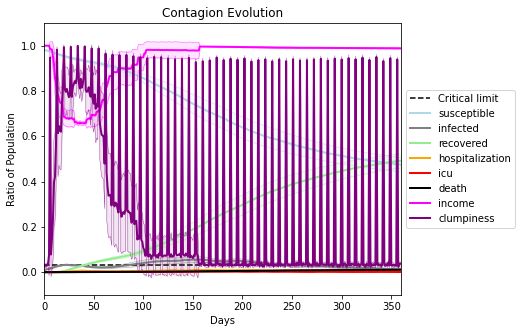

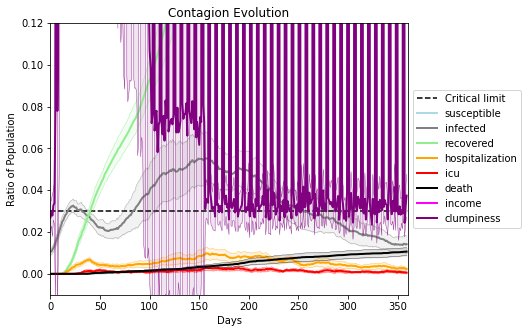

In [32]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.993
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[6469, 5637, 7234, 583, 5726, 8427, 586, 3417, 3208, 4081, 2401, 924, 2190, 7761, 8009, 4917, 4219, 8680, 2084, 2151]
Average similarity between family members is 0.9166959800186686 at temperature -0.992
Average similarity between family and home is 0.9998586697787911 at temperature -1
Average similarity between students and their classroom is 0.5262613104986676 at temperature -0.992
Average classroom occupancy is 4.083333333333333 and number classrooms is 72
Average similarity between workers is 0.8333866898647057 at temperature -0.992
Average office occupancy is 3.4270833333333335 and number offices is 192
Average friend similarity for adults: 0.8436149020280708 for kids: 0.681242660956532
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
H

avg restaurant similarity 0.5798400985579407
avg restaurant similarity 0.5124920050977466
avg restaurant similarity 0.5211384045012852
avg restaurant similarity 0.5430188272791892
avg restaurant similarity 0.5568341400623331
avg restaurant similarity 0.5842497239215554
avg restaurant similarity 0.5524766407017765
avg restaurant similarity 0.5364127408440987
avg restaurant similarity 0.5427378078594459
avg restaurant similarity 0.5556995305019404
avg restaurant similarity 0.6078871993687728
avg restaurant similarity 0.5442916723307488
avg restaurant similarity 0.5291413849807629
avg restaurant similarity 0.505509313479157
avg restaurant similarity 0.5103835600257953
avg restaurant similarity 0.4791921460049964
avg restaurant similarity 0.560024232280816
avg restaurant similarity 0.54219736358569
avg restaurant similarity 0.5206767902311715
avg restaurant similarity 0.46580808275539726
avg restaurant similarity 0.5672872117354731
avg restaurant similarity 0.5356219826352148
avg restauran

avg restaurant similarity 0.5246707117774894
avg restaurant similarity 0.5549842950177174
avg restaurant similarity 0.5166201420391502
avg restaurant similarity 0.5687109495887112
avg restaurant similarity 0.5385045091750881
avg restaurant similarity 0.6214572307696115
avg restaurant similarity 0.47975811853685824
avg restaurant similarity 0.4820014106768972
avg restaurant similarity 0.5022379870050583
avg restaurant similarity 0.5198710333769546
avg restaurant similarity 0.4854862628703219
avg restaurant similarity 0.5211222903667805
avg restaurant similarity 0.5275149772023536
avg restaurant similarity 0.5656842574921169
avg restaurant similarity 0.4778658228762329
avg restaurant similarity 0.59157604031225
avg restaurant similarity 0.5127730224122082
avg restaurant similarity 0.5506691225594161
avg restaurant similarity 0.5234151616564933
avg restaurant similarity 0.4991099261589472
avg restaurant similarity 0.5016534533848832
avg restaurant similarity 0.5286999804179772
avg restaur

avg restaurant similarity 0.5428814575343374
avg restaurant similarity 0.585120548089108
avg restaurant similarity 0.6201827815378131
avg restaurant similarity 0.5384508088452121
avg restaurant similarity 0.5864013478588285
avg restaurant similarity 0.543355522605454
avg restaurant similarity 0.5965609189266879
avg restaurant similarity 0.4999199456467055
avg restaurant similarity 0.6035529358798828
avg restaurant similarity 0.5662293338556074
avg restaurant similarity 0.5596656035569986
avg restaurant similarity 0.5861686040502032
avg restaurant similarity 0.5808851140225821
avg restaurant similarity 0.5271424175915267
avg restaurant similarity 0.5338968830137246
avg restaurant similarity 0.5547769526889401
avg restaurant similarity 0.6096309277032423
avg restaurant similarity 0.5390283370283036
avg restaurant similarity 0.5846993244400284
avg restaurant similarity 0.5395283612138021
avg restaurant similarity 0.5568750806001675
avg restaurant similarity 0.573812367346022
avg restauran

avg restaurant similarity 0.5339995141661896
avg restaurant similarity 0.5813018295448957
avg restaurant similarity 0.5549837513781689
avg restaurant similarity 0.5339765871731671
avg restaurant similarity 0.5641005930130215
avg restaurant similarity 0.5937175359694322
avg restaurant similarity 0.5224411201688729
avg restaurant similarity 0.5172224366834938
avg restaurant similarity 0.5379570640604701
avg restaurant similarity 0.568421828399785
avg restaurant similarity 0.5216616461806594
avg restaurant similarity 0.5629506777865662
avg restaurant similarity 0.6000073052009067
avg restaurant similarity 0.595820296711063
avg restaurant similarity 0.542286768500929
avg restaurant similarity 0.5611783225777682
avg restaurant similarity 0.5777189027506882
avg restaurant similarity 0.6350000133997861
avg restaurant similarity 0.5550518209991016
avg restaurant similarity 0.5266279357365319
avg restaurant similarity 0.5541941059428639
avg restaurant similarity 0.5445670432936901
avg restauran

avg restaurant similarity 0.5535945207807627
avg restaurant similarity 0.5567696051250999
avg restaurant similarity 0.4950581350679424
avg restaurant similarity 0.5331471114011594
avg restaurant similarity 0.4988648892708878
avg restaurant similarity 0.5602804143691477
avg restaurant similarity 0.5943326457146317
avg restaurant similarity 0.5698278655169023
avg restaurant similarity 0.5473945256538043
avg restaurant similarity 0.5175005485435163
avg restaurant similarity 0.5585346059995737
avg restaurant similarity 0.5550208102314073
avg restaurant similarity 0.5434506226335818
avg restaurant similarity 0.5212735990133985
avg restaurant similarity 0.5586913315841502
avg restaurant similarity 0.5509705160292013
avg restaurant similarity 0.5249359276540176
avg restaurant similarity 0.5322558930695973
avg restaurant similarity 0.5956357389016177
avg restaurant similarity 0.5501138863328304
avg restaurant similarity 0.5383217841373636
avg restaurant similarity 0.5461741821898377
avg restau

avg restaurant similarity 0.543352499060447
avg restaurant similarity 0.4727695685307938
avg restaurant similarity 0.5813023338204675
avg restaurant similarity 0.5472666067355992
avg restaurant similarity 0.5463439411743973
avg restaurant similarity 0.5453609826947002
avg restaurant similarity 0.56397340410415
avg restaurant similarity 0.5367412395038919
avg restaurant similarity 0.5496940021043153
avg restaurant similarity 0.5890775294561827
avg restaurant similarity 0.5388924708494117
avg restaurant similarity 0.5592128522777887
avg restaurant similarity 0.5571736382511225
avg restaurant similarity 0.5326897133036341
avg restaurant similarity 0.5471695917123366
avg restaurant similarity 0.5411000960531166
avg restaurant similarity 0.4944411178637053
avg restaurant similarity 0.5345535541694707
avg restaurant similarity 0.5061548938316075
avg restaurant similarity 0.5139462712147148
avg restaurant similarity 0.5284394331369879
avg restaurant similarity 0.5096734869031956
avg restauran

avg restaurant similarity 0.5116206217945
avg restaurant similarity 0.5223989961014043
avg restaurant similarity 0.5192833378076699
avg restaurant similarity 0.49431246982283145
avg restaurant similarity 0.49586188133628806
avg restaurant similarity 0.48168625421401884
avg restaurant similarity 0.5274449622763867
avg restaurant similarity 0.5934748286680044
avg restaurant similarity 0.5255442603521691
avg restaurant similarity 0.5484977838096071
avg restaurant similarity 0.506111715562602
avg restaurant similarity 0.5755567905504168
avg restaurant similarity 0.522044693336894
avg restaurant similarity 0.46632756108767637
avg restaurant similarity 0.5043239013713204
avg restaurant similarity 0.4867128722918169
avg restaurant similarity 0.5154803683707199
avg restaurant similarity 0.5522911145877057
avg restaurant similarity 0.503944636651412
avg restaurant similarity 0.5217344329545683
avg restaurant similarity 0.544904901157072
avg restaurant similarity 0.5423710358616518
avg restauran

avg restaurant similarity 0.5799300628814136
avg restaurant similarity 0.5710818458681
avg restaurant similarity 0.5546602082364323
avg restaurant similarity 0.5533512650218668
avg restaurant similarity 0.5837481749323095
avg restaurant similarity 0.5676462722091363
avg restaurant similarity 0.5683894660633579
avg restaurant similarity 0.5867163875636148
avg restaurant similarity 0.4962201211477098
avg restaurant similarity 0.5084884488588085
avg restaurant similarity 0.5403008432680919
avg restaurant similarity 0.5635589866536924
avg restaurant similarity 0.5560395010371685
avg restaurant similarity 0.5036651254498419
avg restaurant similarity 0.5080962281385499
avg restaurant similarity 0.5868033042376248
avg restaurant similarity 0.5985141240071874
avg restaurant similarity 0.5110731160030941
avg restaurant similarity 0.4891892881537613
avg restaurant similarity 0.4759195924423765
avg restaurant similarity 0.5203237268987183
avg restaurant similarity 0.5374507770468098
avg restauran

avg restaurant similarity 0.5100236999009108
avg restaurant similarity 0.5215531968165263
avg restaurant similarity 0.5320151361889545
avg restaurant similarity 0.5310894216837914
avg restaurant similarity 0.5444837751792343
avg restaurant similarity 0.5161865191326506
avg restaurant similarity 0.5327972795567568
avg restaurant similarity 0.562097572708129
avg restaurant similarity 0.47625708340900863
avg restaurant similarity 0.5099051496296316
avg restaurant similarity 0.5124894159628262
avg restaurant similarity 0.5097549469414375
avg restaurant similarity 0.5188880156392228
avg restaurant similarity 0.48558844611065555
avg restaurant similarity 0.48476980386332136
avg restaurant similarity 0.5316180321361016
avg restaurant similarity 0.5531692481973048
avg restaurant similarity 0.5503822301019939
avg restaurant similarity 0.5043513237071358
avg restaurant similarity 0.5463005086453708
avg restaurant similarity 0.568937656161602
avg restaurant similarity 0.5328595204144515
avg resta

avg restaurant similarity 0.4746413943792928
avg restaurant similarity 0.542993545556285
avg restaurant similarity 0.5408059872009046
avg restaurant similarity 0.5203119188686418
avg restaurant similarity 0.5217911894211839
avg restaurant similarity 0.5082259834555769
avg restaurant similarity 0.4893058107850562
avg restaurant similarity 0.5441594991985049
avg restaurant similarity 0.48467361264310854
avg restaurant similarity 0.5403837068887041
avg restaurant similarity 0.5700525825689783
avg restaurant similarity 0.5597175538244539
avg restaurant similarity 0.5503264109855187
avg restaurant similarity 0.5458038239328424
avg restaurant similarity 0.5464750882825191
avg restaurant similarity 0.5578268564380979
avg restaurant similarity 0.48604506298945815
avg restaurant similarity 0.5385030911337352
avg restaurant similarity 0.4443182361203186
avg restaurant similarity 0.5135815988799214
avg restaurant similarity 0.5155568252842561
avg restaurant similarity 0.501135546036092
avg restau

avg restaurant similarity 0.5109094696372763
avg restaurant similarity 0.5553134062603399
avg restaurant similarity 0.5616104230891166
avg restaurant similarity 0.504781590565009
avg restaurant similarity 0.47486575415359145
avg restaurant similarity 0.46113996847267286
avg restaurant similarity 0.529991779721034
avg restaurant similarity 0.5308530097403902
avg restaurant similarity 0.5912907935673404
avg restaurant similarity 0.5065919782459739
avg restaurant similarity 0.5205286937812281
avg restaurant similarity 0.5744601296871361
avg restaurant similarity 0.5418077156760307
avg restaurant similarity 0.5093013742584761
avg restaurant similarity 0.5166800551479243
avg restaurant similarity 0.5635022803803251
avg restaurant similarity 0.5105777918308048
avg restaurant similarity 0.5774819140507516
avg restaurant similarity 0.5913298665850023
avg restaurant similarity 0.4847413444887942
avg restaurant similarity 0.49895102850055495
avg restaurant similarity 0.5019704073356634
avg resta

avg restaurant similarity 0.5232688974715902
avg restaurant similarity 0.63120588558799
avg restaurant similarity 0.5130360624813496
avg restaurant similarity 0.5351061888407596
avg restaurant similarity 0.5490562334657183
avg restaurant similarity 0.6086875386787673
avg restaurant similarity 0.5757581879789097
avg restaurant similarity 0.5283501388366405
avg restaurant similarity 0.58961014648032
avg restaurant similarity 0.5079824663350441
avg restaurant similarity 0.547854700503803
avg restaurant similarity 0.5512227067641055
avg restaurant similarity 0.537227770236548
avg restaurant similarity 0.5652123955105907
avg restaurant similarity 0.5063537461803923
avg restaurant similarity 0.5640483039647699
avg restaurant similarity 0.523786859617366
avg restaurant similarity 0.5114133776988935
avg restaurant similarity 0.5004220960017182
avg restaurant similarity 0.5517777735694331
avg restaurant similarity 0.5525203682766996
avg restaurant similarity 0.5789962124390853
avg restaurant si

avg restaurant similarity 0.45912103140865707
avg restaurant similarity 0.4776442057460362
avg restaurant similarity 0.5088737603320984
avg restaurant similarity 0.46501404173561156
avg restaurant similarity 0.5097402105769578
avg restaurant similarity 0.535718400764293
avg restaurant similarity 0.5328615197929544
avg restaurant similarity 0.5159506143623132
avg restaurant similarity 0.47756264886380306
avg restaurant similarity 0.5315704205628233
avg restaurant similarity 0.4943101045749791
avg restaurant similarity 0.5299443736202546
avg restaurant similarity 0.5077574844685268
avg restaurant similarity 0.5028122591210351
avg restaurant similarity 0.5036014576300684
avg restaurant similarity 0.4838170550388145
avg restaurant similarity 0.5002146341505731
avg restaurant similarity 0.4886948793833025
avg restaurant similarity 0.4784099363323947
avg restaurant similarity 0.4951248358182825
avg restaurant similarity 0.5492272656541453
avg restaurant similarity 0.5274612804727405
avg rest

avg restaurant similarity 0.5516115304754999
avg restaurant similarity 0.49285544202439324
avg restaurant similarity 0.5303924061385704
avg restaurant similarity 0.4896458904801115
avg restaurant similarity 0.4445260380099911
avg restaurant similarity 0.5223967795824671
avg restaurant similarity 0.5559826724327928
avg restaurant similarity 0.48200063053645315
avg restaurant similarity 0.5744272021680792
avg restaurant similarity 0.46373737326619835
avg restaurant similarity 0.5081678815474299
avg restaurant similarity 0.5417203887907729
avg restaurant similarity 0.49480248810037675
avg restaurant similarity 0.4685335263387838
avg restaurant similarity 0.5075896880764602
avg restaurant similarity 0.4792575508377855
avg restaurant similarity 0.5111571769972616
avg restaurant similarity 0.5672028914973946
avg restaurant similarity 0.4616756221124419
avg restaurant similarity 0.4965833867057227
avg restaurant similarity 0.5253465846110541
avg restaurant similarity 0.4373758700911629
avg re

avg restaurant similarity 0.5228006568651802
avg restaurant similarity 0.5508293234171334
avg restaurant similarity 0.5567196262760941
avg restaurant similarity 0.4995976899756744
avg restaurant similarity 0.5697586541264156
avg restaurant similarity 0.555543210378511
avg restaurant similarity 0.5082092722800973
avg restaurant similarity 0.5377393558432813
avg restaurant similarity 0.5036068975163397
avg restaurant similarity 0.5187039900071976
avg restaurant similarity 0.5301239692644742
avg restaurant similarity 0.5501414526449893
avg restaurant similarity 0.5872276362784702
avg restaurant similarity 0.5357570942269011
avg restaurant similarity 0.483364166770269
avg restaurant similarity 0.5759922986555978
avg restaurant similarity 0.5726735339255011
avg restaurant similarity 0.5746088029868296
avg restaurant similarity 0.5033367676494711
avg restaurant similarity 0.5724446988951742
avg restaurant similarity 0.5565415850265657
avg restaurant similarity 0.5522359915626006
avg restaura

avg restaurant similarity 0.5191377688343999
avg restaurant similarity 0.5496633913434034
avg restaurant similarity 0.5899814973660433
avg restaurant similarity 0.5460747477531767
avg restaurant similarity 0.5530518479194392
avg restaurant similarity 0.5520741041792324
avg restaurant similarity 0.5081909979565762
avg restaurant similarity 0.5922276185979739
avg restaurant similarity 0.530619992576777
avg restaurant similarity 0.5024910865920671
avg restaurant similarity 0.5508532559496698
avg restaurant similarity 0.5463100477548509
avg restaurant similarity 0.48388924461436905
avg restaurant similarity 0.5537632013159443
avg restaurant similarity 0.503271682071818
avg restaurant similarity 0.4874869443345427
avg restaurant similarity 0.5651164504293668
avg restaurant similarity 0.5353371093239424
avg restaurant similarity 0.5344495650921399
avg restaurant similarity 0.5621750574682056
avg restaurant similarity 0.554300837328189
avg restaurant similarity 0.5275535132446242
avg restaura

avg restaurant similarity 0.523283902286298
avg restaurant similarity 0.5376999347404713
avg restaurant similarity 0.5647858670064144
avg restaurant similarity 0.5362096263601176
avg restaurant similarity 0.5433056650554244
avg restaurant similarity 0.5454250738751867
avg restaurant similarity 0.6001186977394597
avg restaurant similarity 0.5417966729533922
avg restaurant similarity 0.5731308186558559
avg restaurant similarity 0.5439806377197384
avg restaurant similarity 0.5470206803252049
avg restaurant similarity 0.5583156370114677
avg restaurant similarity 0.5739751973660381
avg restaurant similarity 0.5279304299895761
avg restaurant similarity 0.5653560430069194
avg restaurant similarity 0.5343229773213476
avg restaurant similarity 0.5721316957080126
avg restaurant similarity 0.5820569061122242
avg restaurant similarity 0.5456797085933861
avg restaurant similarity 0.4950029520831661
avg restaurant similarity 0.553908194428422
avg restaurant similarity 0.527763699847786
avg restauran

avg restaurant similarity 0.5629901211624581
avg restaurant similarity 0.5707773534236669
avg restaurant similarity 0.5310640588604703
avg restaurant similarity 0.5226520008375332
avg restaurant similarity 0.5470661057254701
avg restaurant similarity 0.533571402327633
avg restaurant similarity 0.46660209777991146
avg restaurant similarity 0.577043614205117
avg restaurant similarity 0.639684896199773
avg restaurant similarity 0.5330866579469627
avg restaurant similarity 0.5553442101963032
avg restaurant similarity 0.5889771254487518
avg restaurant similarity 0.5744520905135764
avg restaurant similarity 0.5400435962118323
avg restaurant similarity 0.5287827445569175
avg restaurant similarity 0.5409723878786166
avg restaurant similarity 0.47013827123035623
avg restaurant similarity 0.5012560310142599
avg restaurant similarity 0.5401255768720132
avg restaurant similarity 0.5133541300691294
avg restaurant similarity 0.5467913071882816
avg restaurant similarity 0.5346308217196412
avg restaur

avg restaurant similarity 0.4534078216409383
avg restaurant similarity 0.5281891778002896
avg restaurant similarity 0.539405029206492
avg restaurant similarity 0.5281482641179924
avg restaurant similarity 0.5431762188175006
avg restaurant similarity 0.5822913168158519
avg restaurant similarity 0.5248444649709618
avg restaurant similarity 0.48359720881119506
avg restaurant similarity 0.5480233542016659
avg restaurant similarity 0.5570925721808775
avg restaurant similarity 0.5095687278219233
avg restaurant similarity 0.5156682562508061
avg restaurant similarity 0.527717034864969
avg restaurant similarity 0.5190012111347203
avg restaurant similarity 0.5456308532345173
avg restaurant similarity 0.5619950854216804
avg restaurant similarity 0.519833196963315
avg restaurant similarity 0.46770833149164986
avg restaurant similarity 0.49638331858860757
avg restaurant similarity 0.6064353721633029
avg restaurant similarity 0.5527532375222541
avg restaurant similarity 0.5018278177022011
avg restau

avg restaurant similarity 0.5165201775393736
avg restaurant similarity 0.5501412752027675
avg restaurant similarity 0.5542519582898758
avg restaurant similarity 0.4961711517764957
avg restaurant similarity 0.5423950125355557
avg restaurant similarity 0.5483412613277131
avg restaurant similarity 0.5706190871014584
avg restaurant similarity 0.5237099021900453
avg restaurant similarity 0.5340290287235452
avg restaurant similarity 0.5210798320483114
avg restaurant similarity 0.49886491205519784
avg restaurant similarity 0.5850937214596703
avg restaurant similarity 0.6093668308575906
avg restaurant similarity 0.5234855277050231
avg restaurant similarity 0.5123426454855066
avg restaurant similarity 0.5112422613347063
avg restaurant similarity 0.5162683109775407
avg restaurant similarity 0.5458583255076493
avg restaurant similarity 0.5615933232125321
avg restaurant similarity 0.533845695805852
avg restaurant similarity 0.5107105107332345
avg restaurant similarity 0.5416125307838313
avg restau

avg restaurant similarity 0.5740270010353188
avg restaurant similarity 0.5761000742425855
avg restaurant similarity 0.5374411085578025
avg restaurant similarity 0.5764224437844021
avg restaurant similarity 0.5862160593323473
avg restaurant similarity 0.5565798749401487
avg restaurant similarity 0.6174664925801552
avg restaurant similarity 0.5145281168825255
avg restaurant similarity 0.6036318610003121
avg restaurant similarity 0.584201890395273
avg restaurant similarity 0.6208690027627232
avg restaurant similarity 0.5559476241012574
avg restaurant similarity 0.5574632182273789
avg restaurant similarity 0.5523107265296129
avg restaurant similarity 0.5646039842141735
avg restaurant similarity 0.5582464409009295
avg restaurant similarity 0.598613750134622
avg restaurant similarity 0.608046610083156
avg restaurant similarity 0.5669197668139154
avg restaurant similarity 0.6247647506393837
avg restaurant similarity 0.5651883058299121
avg restaurant similarity 0.572219756717787
avg restaurant

avg restaurant similarity 0.6024046479449277
avg restaurant similarity 0.5751828503982936
avg restaurant similarity 0.567372699290634
avg restaurant similarity 0.5531346086864006
avg restaurant similarity 0.5338771045198829
avg restaurant similarity 0.5776424593632346
avg restaurant similarity 0.5953244880015985
avg restaurant similarity 0.5533367670977982
avg restaurant similarity 0.5770601876737143
avg restaurant similarity 0.6013722603559747
avg restaurant similarity 0.5849875668239469
avg restaurant similarity 0.5464325281494002
avg restaurant similarity 0.5944779727422264
avg restaurant similarity 0.5353831458365955
avg restaurant similarity 0.6277515656286666
avg restaurant similarity 0.5319501307387967
avg restaurant similarity 0.6225184886866064
avg restaurant similarity 0.5931752006291954
avg restaurant similarity 0.5026013688934993
avg restaurant similarity 0.5973107590354573
avg restaurant similarity 0.5697952580376948
avg restaurant similarity 0.5835471841224991
avg restaur

avg restaurant similarity 0.5471446003346262
avg restaurant similarity 0.5260067660375285
avg restaurant similarity 0.5595074084918137
avg restaurant similarity 0.5813583745603185
avg restaurant similarity 0.5760834371266842
avg restaurant similarity 0.5589685456857437
avg restaurant similarity 0.47948346239506723
avg restaurant similarity 0.4493865150530821
avg restaurant similarity 0.4388496346777397
avg restaurant similarity 0.5222083494559567
avg restaurant similarity 0.5425571702138045
avg restaurant similarity 0.557330902016553
avg restaurant similarity 0.49702799219328214
avg restaurant similarity 0.5697698818174068
avg restaurant similarity 0.5103350894230997
avg restaurant similarity 0.5595013379575545
avg restaurant similarity 0.5049552597326946
avg restaurant similarity 0.4898251415741996
avg restaurant similarity 0.48053383964853985
avg restaurant similarity 0.5724295692740106
avg restaurant similarity 0.4932877826107899
avg restaurant similarity 0.513284334841824
avg resta

avg restaurant similarity 0.5006413977996595
avg restaurant similarity 0.4580862625806699
avg restaurant similarity 0.5136081452267507
avg restaurant similarity 0.5218983605079589
avg restaurant similarity 0.5574889840523164
avg restaurant similarity 0.5077337891048385
avg restaurant similarity 0.5210544314127571
avg restaurant similarity 0.4970100983449356
avg restaurant similarity 0.5735101096630996
avg restaurant similarity 0.4996946507676864
avg restaurant similarity 0.5392798229174561
avg restaurant similarity 0.460712641927256
avg restaurant similarity 0.4759722655899256
avg restaurant similarity 0.4678379009029863
avg restaurant similarity 0.5415525503529107
avg restaurant similarity 0.5215698669259798
avg restaurant similarity 0.5298398587170602
avg restaurant similarity 0.574003860607156
avg restaurant similarity 0.5423786145073388
avg restaurant similarity 0.5113840041772804
avg restaurant similarity 0.5327171798476477
avg restaurant similarity 0.5036777163109444
avg restaura

avg restaurant similarity 0.5675077310364792
avg restaurant similarity 0.5264271889409721
avg restaurant similarity 0.5114721630983666
avg restaurant similarity 0.5469095921623179
avg restaurant similarity 0.5246407855078685
avg restaurant similarity 0.5168053628943693
avg restaurant similarity 0.5374755568571429
avg restaurant similarity 0.5297637794372196
avg restaurant similarity 0.6005937894572335
avg restaurant similarity 0.5331962236573481
avg restaurant similarity 0.5075359543282058
avg restaurant similarity 0.5238940288952022
avg restaurant similarity 0.5096029621435483
avg restaurant similarity 0.4933047465222482
avg restaurant similarity 0.5743679280238267
avg restaurant similarity 0.5737176361179906
avg restaurant similarity 0.569801822483376
avg restaurant similarity 0.5175227548925028
avg restaurant similarity 0.5573759117146913
avg restaurant similarity 0.5628060705159295
avg restaurant similarity 0.5269219695369375
avg restaurant similarity 0.5264538066546011
avg restaur

avg restaurant similarity 0.5507715020381323
avg restaurant similarity 0.5844050724948681
avg restaurant similarity 0.6049459471781871
avg restaurant similarity 0.5805704729303496
avg restaurant similarity 0.542569760447584
avg restaurant similarity 0.5439817951981355
avg restaurant similarity 0.5643700674087706
avg restaurant similarity 0.5416685810919531
avg restaurant similarity 0.5252130981884624
avg restaurant similarity 0.5557875044078001
avg restaurant similarity 0.5632217902712618
avg restaurant similarity 0.5591391931163324
avg restaurant similarity 0.5353285652671347
avg restaurant similarity 0.49373536098647913
avg restaurant similarity 0.5002301475807399
avg restaurant similarity 0.5876175819910081
avg restaurant similarity 0.5372124947010297
avg restaurant similarity 0.5728677436910903
avg restaurant similarity 0.5443619258365636
avg restaurant similarity 0.5361566219552651
avg restaurant similarity 0.5520212015202897
avg restaurant similarity 0.5450610373981128
avg restau

avg restaurant similarity 0.5458551472110188
avg restaurant similarity 0.5290442633051754
avg restaurant similarity 0.4383643505910859
avg restaurant similarity 0.5337845114437565
avg restaurant similarity 0.4838806371348392
avg restaurant similarity 0.467858436191085
avg restaurant similarity 0.5379962987219067
avg restaurant similarity 0.5416872494524033
avg restaurant similarity 0.5117448030265976
avg restaurant similarity 0.5075055894617845
avg restaurant similarity 0.5558320836356967
avg restaurant similarity 0.4968787591445204
avg restaurant similarity 0.4804006837761307
avg restaurant similarity 0.5093461559461423
avg restaurant similarity 0.47324215715879175
avg restaurant similarity 0.5295260878522441
avg restaurant similarity 0.5168115068490708
avg restaurant similarity 0.5466270319142157
avg restaurant similarity 0.518508618874331
avg restaurant similarity 0.4923628527962802
avg restaurant similarity 0.48562628168988214
avg restaurant similarity 0.525668051956797
avg restaur

avg restaurant similarity 0.526327504493179
avg restaurant similarity 0.48088504617035527
avg restaurant similarity 0.48709986755932677
avg restaurant similarity 0.47455213927671697
avg restaurant similarity 0.5380143425221888
avg restaurant similarity 0.5214006590625442
avg restaurant similarity 0.5192748345302225
avg restaurant similarity 0.56196382534626
avg restaurant similarity 0.5648227650368567
avg restaurant similarity 0.5004299923731415
avg restaurant similarity 0.5041496933314165
avg restaurant similarity 0.506842217155367
avg restaurant similarity 0.48480380548546936
avg restaurant similarity 0.5604816950437514
avg restaurant similarity 0.5493678582952342
avg restaurant similarity 0.5461145013225693
avg restaurant similarity 0.4516007475755404
avg restaurant similarity 0.48312532579533585
avg restaurant similarity 0.5145001804261733
avg restaurant similarity 0.5370422130866548
avg restaurant similarity 0.5126393823164188
avg restaurant similarity 0.5500794535554626
avg resta

avg restaurant similarity 0.576714557763595
avg restaurant similarity 0.5503458548124734
avg restaurant similarity 0.5427025973614527
avg restaurant similarity 0.5632029589164449
avg restaurant similarity 0.5389192609610594
avg restaurant similarity 0.534222190530594
avg restaurant similarity 0.5533849470270388
avg restaurant similarity 0.5737411396329479
avg restaurant similarity 0.5349668529421264
avg restaurant similarity 0.5016112712443047
avg restaurant similarity 0.5534163365905406
avg restaurant similarity 0.63679744328413
avg restaurant similarity 0.537443395915243
avg restaurant similarity 0.4849293418180065
avg restaurant similarity 0.5021134885767037
avg restaurant similarity 0.5050032085220143
avg restaurant similarity 0.5045554937951736
avg restaurant similarity 0.5578980016179397
avg restaurant similarity 0.5537492442222487
avg restaurant similarity 0.4654098591491811
avg restaurant similarity 0.46701338422630345
avg restaurant similarity 0.5003399024712094
avg restaurant

avg restaurant similarity 0.540450070171033
avg restaurant similarity 0.5051204515333885
avg restaurant similarity 0.4965170276153417
avg restaurant similarity 0.527562750657657
avg restaurant similarity 0.4981499592793836
avg restaurant similarity 0.476428933629566
avg restaurant similarity 0.5074829835494189
avg restaurant similarity 0.5206844163992183
avg restaurant similarity 0.5226850633041747
avg restaurant similarity 0.5051570581756168
avg restaurant similarity 0.4789358279430127
avg restaurant similarity 0.48956539827784035
avg restaurant similarity 0.5798490379898584
avg restaurant similarity 0.533328071466365
avg restaurant similarity 0.5661978054777724
avg restaurant similarity 0.4943732998969373
avg restaurant similarity 0.48582491133377653
avg restaurant similarity 0.504900224610636
avg restaurant similarity 0.491782736357374
avg restaurant similarity 0.48330816998103177
avg restaurant similarity 0.5197614253672239
avg restaurant similarity 0.5605925202894835
avg restauran

avg restaurant similarity 0.5362101419536869
avg restaurant similarity 0.49293641361913126
avg restaurant similarity 0.5550628005114532
avg restaurant similarity 0.5596310308119959
avg restaurant similarity 0.4618192944521261
avg restaurant similarity 0.5391779758313322
avg restaurant similarity 0.5460706140660224
avg restaurant similarity 0.5427669727924646
avg restaurant similarity 0.5458216797208086
avg restaurant similarity 0.4996770412123426
avg restaurant similarity 0.5085755117756072
avg restaurant similarity 0.5249191377102069
avg restaurant similarity 0.4980328723654774
avg restaurant similarity 0.6191501262240996
avg restaurant similarity 0.5307728806461292
avg restaurant similarity 0.5516179126672298
avg restaurant similarity 0.4628679835251908
avg restaurant similarity 0.5728140617642361
avg restaurant similarity 0.537153427033938
avg restaurant similarity 0.5226688543076892
avg restaurant similarity 0.566179216266285
avg restaurant similarity 0.5325569872788785
avg restaur

avg restaurant similarity 0.5102656425895702
avg restaurant similarity 0.5394149626795106
avg restaurant similarity 0.5184432985610705
avg restaurant similarity 0.49757649249769054
avg restaurant similarity 0.5246385826678227
avg restaurant similarity 0.4859747203467891
avg restaurant similarity 0.519137245251727
avg restaurant similarity 0.5454459940484685
avg restaurant similarity 0.5243774638830669
avg restaurant similarity 0.47099046038085296
avg restaurant similarity 0.5172922776548297
avg restaurant similarity 0.5224754241013462
avg restaurant similarity 0.5596793868768977
avg restaurant similarity 0.5459173832670413
avg restaurant similarity 0.5239751316004007
avg restaurant similarity 0.47323214853394485
avg restaurant similarity 0.5512903621671332
avg restaurant similarity 0.5172380639943361
avg restaurant similarity 0.5372259632077759
avg restaurant similarity 0.5175548200654332
avg restaurant similarity 0.508593476559676
avg restaurant similarity 0.5385642515222339
avg resta

avg restaurant similarity 0.5886821520267331
avg restaurant similarity 0.5939671357746478
avg restaurant similarity 0.5059737705193128
avg restaurant similarity 0.5680739512093687
avg restaurant similarity 0.5613895078249054
avg restaurant similarity 0.58207750245668
avg restaurant similarity 0.5398282607301542
avg restaurant similarity 0.5983439384985632
avg restaurant similarity 0.6211485673952518
avg restaurant similarity 0.5773003870993393
avg restaurant similarity 0.5621727185693209
avg restaurant similarity 0.5873163394023281
avg restaurant similarity 0.5857438206648247
avg restaurant similarity 0.5584296890829278
avg restaurant similarity 0.5588023086852648
avg restaurant similarity 0.5723088557747921
avg restaurant similarity 0.5723200492551791
avg restaurant similarity 0.5298854856024218
avg restaurant similarity 0.5500261773010736
avg restaurant similarity 0.5944895837879635
avg restaurant similarity 0.6087649674617863
avg restaurant similarity 0.5600153197979642
avg restaura

avg restaurant similarity 0.5666654454361437
avg restaurant similarity 0.5778468577422124
avg restaurant similarity 0.5270760835251246
avg restaurant similarity 0.5141406942007318
avg restaurant similarity 0.5831160442490149
avg restaurant similarity 0.4950575530637111
avg restaurant similarity 0.5683903898459615
avg restaurant similarity 0.577239454674191
avg restaurant similarity 0.5463295415865163
avg restaurant similarity 0.5397870226201124
avg restaurant similarity 0.5459805314685632
avg restaurant similarity 0.6240005115889742
avg restaurant similarity 0.6042205343992999
avg restaurant similarity 0.5250819130061739
avg restaurant similarity 0.615409455408077
avg restaurant similarity 0.6111188067974697
avg restaurant similarity 0.5956904435285921
avg restaurant similarity 0.559130258935475
avg restaurant similarity 0.6095926213466358
avg restaurant similarity 0.5505749712267988
avg restaurant similarity 0.5183558732323055
avg restaurant similarity 0.48820459382913844
avg restaura

avg restaurant similarity 0.5442026735602917
avg restaurant similarity 0.5408479341841045
avg restaurant similarity 0.5374625525300617
avg restaurant similarity 0.5613245645974685
avg restaurant similarity 0.5892798263018256
avg restaurant similarity 0.5351161775245716
avg restaurant similarity 0.551263949014318
avg restaurant similarity 0.609074544043058
avg restaurant similarity 0.549534882688814
avg restaurant similarity 0.5363037259715343
avg restaurant similarity 0.5854605814864107
avg restaurant similarity 0.6106957299583142
avg restaurant similarity 0.5647376301523213
avg restaurant similarity 0.585350225352723
avg restaurant similarity 0.5703736500215876
avg restaurant similarity 0.5738828710028522
avg restaurant similarity 0.5809603738061958
avg restaurant similarity 0.5293697207869871
avg restaurant similarity 0.5534201950292851
avg restaurant similarity 0.5732056607400904
avg restaurant similarity 0.5154554869281825
avg restaurant similarity 0.5683286360830353
avg restaurant

avg restaurant similarity 0.5401427260222575
avg restaurant similarity 0.5644002578643312
avg restaurant similarity 0.5756688222395596
avg restaurant similarity 0.5718905281696524
avg restaurant similarity 0.5747550401863828
avg restaurant similarity 0.6093737659016659
avg restaurant similarity 0.5967796986286634
avg restaurant similarity 0.5420723260843225
avg restaurant similarity 0.5444124522183112
avg restaurant similarity 0.5749695684021922
avg restaurant similarity 0.6128773480820716
avg restaurant similarity 0.5301122895973698
avg restaurant similarity 0.5805035781025297
avg restaurant similarity 0.5741592325726276
avg restaurant similarity 0.5720797242614437
avg restaurant similarity 0.5838130752010279
avg restaurant similarity 0.5745474911378223
avg restaurant similarity 0.5574517037128199
avg restaurant similarity 0.5513707601042505
avg restaurant similarity 0.5437107283962419
avg restaurant similarity 0.5570514739348362
avg restaurant similarity 0.5337534209190755
avg restau

avg restaurant similarity 0.45624291898100033
avg restaurant similarity 0.512539683945394
avg restaurant similarity 0.543657357846508
avg restaurant similarity 0.4750543394726812
avg restaurant similarity 0.5140827246248553
avg restaurant similarity 0.548778470728996
avg restaurant similarity 0.5099348214042726
avg restaurant similarity 0.5526159874244485
avg restaurant similarity 0.49983307179790776
avg restaurant similarity 0.4955845135224475
avg restaurant similarity 0.5541203346831126
avg restaurant similarity 0.4999446512740955
avg restaurant similarity 0.5339921835162533
avg restaurant similarity 0.5326806986782895
avg restaurant similarity 0.4664577034759147
avg restaurant similarity 0.5476129436328224
avg restaurant similarity 0.5230551495786244
avg restaurant similarity 0.5094542416564298
avg restaurant similarity 0.5331455214771409
avg restaurant similarity 0.5323555910225236
avg restaurant similarity 0.49798995258386564
avg restaurant similarity 0.5094048973507433
avg restau

avg restaurant similarity 0.4609005425555142
avg restaurant similarity 0.41552740456712545
avg restaurant similarity 0.5338652709432238
avg restaurant similarity 0.5666687949568513
avg restaurant similarity 0.5361413230583293
avg restaurant similarity 0.5793642294394125
avg restaurant similarity 0.47385678894510386
avg restaurant similarity 0.48534134572552956
avg restaurant similarity 0.49460172242158573
avg restaurant similarity 0.5131828283637746
avg restaurant similarity 0.5148069248938675
avg restaurant similarity 0.5063854372680935
avg restaurant similarity 0.5282945244937637
avg restaurant similarity 0.511293969941663
avg restaurant similarity 0.4527566524466419
avg restaurant similarity 0.5048903306495506
avg restaurant similarity 0.528033197658501
avg restaurant similarity 0.5002313462229496
avg restaurant similarity 0.5184475727617547
avg restaurant similarity 0.5309169237649745
avg restaurant similarity 0.49004553079945296
avg restaurant similarity 0.49831406750102414
avg re

avg restaurant similarity 0.5271939442079533
avg restaurant similarity 0.5513102546571109
avg restaurant similarity 0.598530337258565
avg restaurant similarity 0.5469110961767819
avg restaurant similarity 0.5612120680843309
avg restaurant similarity 0.5807055744454054
avg restaurant similarity 0.5553348937005876
avg restaurant similarity 0.5749848176666347
avg restaurant similarity 0.5267130389476893
avg restaurant similarity 0.5391352649101971
avg restaurant similarity 0.5702639002498407
avg restaurant similarity 0.4974718444562556
avg restaurant similarity 0.46281739453247694
avg restaurant similarity 0.49009470999646787
avg restaurant similarity 0.5565095208183171
avg restaurant similarity 0.4946361489680519
avg restaurant similarity 0.5599561766523719
avg restaurant similarity 0.5184318954522527
avg restaurant similarity 0.6475701237979484
avg restaurant similarity 0.47747107338601014
avg restaurant similarity 0.434600347157832
avg restaurant similarity 0.5097781838505334
avg resta

avg restaurant similarity 0.519521005794605
avg restaurant similarity 0.536076847870657
avg restaurant similarity 0.5303046451272097
avg restaurant similarity 0.46351031725156844
avg restaurant similarity 0.6432260024034571
avg restaurant similarity 0.5983053007184261
avg restaurant similarity 0.5160371099426406
avg restaurant similarity 0.5972613854125568
avg restaurant similarity 0.508025324973936
avg restaurant similarity 0.5384035986488672
avg restaurant similarity 0.4765904226760562
avg restaurant similarity 0.6137719957389937
avg restaurant similarity 0.5512835560637015
avg restaurant similarity 0.46566475947782543
avg restaurant similarity 0.5017116588517335
avg restaurant similarity 0.46697651576995547
avg restaurant similarity 0.46316882870160686
avg restaurant similarity 0.49834731707792723
avg restaurant similarity 0.4824943071820963
avg restaurant similarity 0.559883067588664
avg restaurant similarity 0.5396453026873899
avg restaurant similarity 0.6802632470868402
avg resta

(<function dict.items>, <function dict.items>, <function dict.items>)

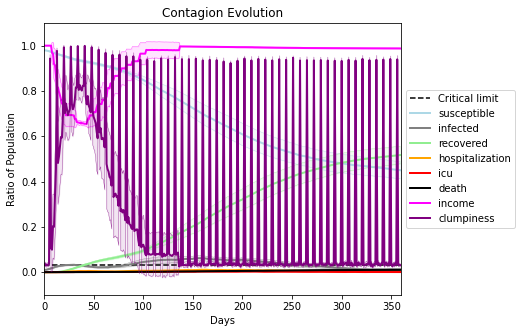

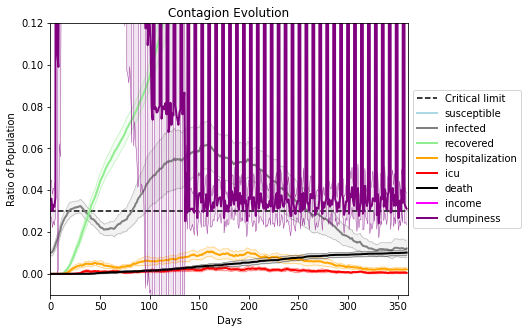

In [33]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.992
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[2192, 3965, 6409, 6657, 3416, 7703, 7251, 5539, 3096, 339, 4293, 3923, 9621, 9294, 2571, 7245, 841, 9770, 7150, 3744]
Average similarity between family members is 0.9124859511902264 at temperature -0.991
Average similarity between family and home is 0.9998598846201538 at temperature -1
Average similarity between students and their classroom is 0.49239096174393604 at temperature -0.991
Average classroom occupancy is 3.914285714285714 and number classrooms is 70
Average similarity between workers is 0.8495752294485815 at temperature -0.991
Average office occupancy is 3.4947368421052634 and number offices is 190
Average friend similarity for adults: 0.8478024943643462 for kids: 0.6541904098107357
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Building

avg restaurant similarity 0.4955705132440635
avg restaurant similarity 0.49502229739822307
avg restaurant similarity 0.5273631779020113
avg restaurant similarity 0.525583858186317
avg restaurant similarity 0.5416841605469382
avg restaurant similarity 0.5383612131595987
avg restaurant similarity 0.5389078951172144
avg restaurant similarity 0.5382016286946968
avg restaurant similarity 0.5346357502349146
avg restaurant similarity 0.5057513812122088
avg restaurant similarity 0.5302117552596731
avg restaurant similarity 0.5220997043686186
avg restaurant similarity 0.5683665631194595
avg restaurant similarity 0.4790903689770905
avg restaurant similarity 0.5355604580207822
avg restaurant similarity 0.5040714313869183
avg restaurant similarity 0.5719106130037501
avg restaurant similarity 0.5163386537049479
avg restaurant similarity 0.4923788173136952
avg restaurant similarity 0.5062790367290557
avg restaurant similarity 0.5506396014678843
avg restaurant similarity 0.61115341884551
avg restaura

avg restaurant similarity 0.5626474060028482
avg restaurant similarity 0.5782413425100515
avg restaurant similarity 0.5459048913100756
avg restaurant similarity 0.5292522145945251
avg restaurant similarity 0.48588558436925455
avg restaurant similarity 0.5493633216465532
avg restaurant similarity 0.5687781020181004
avg restaurant similarity 0.5324547882869612
avg restaurant similarity 0.49202225928541443
avg restaurant similarity 0.5155705950892662
avg restaurant similarity 0.5011199291358419
avg restaurant similarity 0.5124926869616082
avg restaurant similarity 0.5276581042398154
avg restaurant similarity 0.546440578918273
avg restaurant similarity 0.45408638171003174
avg restaurant similarity 0.5674848598815513
avg restaurant similarity 0.529870792947124
avg restaurant similarity 0.5046612840944545
avg restaurant similarity 0.5323128754826234
avg restaurant similarity 0.5066098729727928
avg restaurant similarity 0.5075263621737606
avg restaurant similarity 0.5481319495868352
avg resta

avg restaurant similarity 0.5058957278540104
avg restaurant similarity 0.48847290675429905
avg restaurant similarity 0.5387388800273496
avg restaurant similarity 0.45569437613400277
avg restaurant similarity 0.4806556813524372
avg restaurant similarity 0.5410774770821714
avg restaurant similarity 0.525160830385177
avg restaurant similarity 0.5341896702446999
avg restaurant similarity 0.5510004850208257
avg restaurant similarity 0.5330425821546193
avg restaurant similarity 0.499811444954837
avg restaurant similarity 0.5392293359697389
avg restaurant similarity 0.5563620433470918
avg restaurant similarity 0.4678342563847502
avg restaurant similarity 0.47727738525168867
avg restaurant similarity 0.5029246368850826
avg restaurant similarity 0.5256441575295459
avg restaurant similarity 0.4585375352913269
avg restaurant similarity 0.5274659010860108
avg restaurant similarity 0.4831608617465951
avg restaurant similarity 0.5621169814943134
avg restaurant similarity 0.4726454060421362
avg resta

avg restaurant similarity 0.49855082282294116
avg restaurant similarity 0.5234411437283905
avg restaurant similarity 0.5502644439906632
avg restaurant similarity 0.5288239906696844
avg restaurant similarity 0.5174303055457947
avg restaurant similarity 0.516265462915109
avg restaurant similarity 0.5080814822970746
avg restaurant similarity 0.53845772352815
avg restaurant similarity 0.4747743252458051
avg restaurant similarity 0.5106955441192428
avg restaurant similarity 0.508525663705005
avg restaurant similarity 0.48167842300821384
avg restaurant similarity 0.4898478892646211
avg restaurant similarity 0.5255025840733821
avg restaurant similarity 0.49490580371878723
avg restaurant similarity 0.5289836766985438
avg restaurant similarity 0.4801178230891329
avg restaurant similarity 0.512128735488934
avg restaurant similarity 0.5435897928526788
avg restaurant similarity 0.5176310631194745
avg restaurant similarity 0.5887655886166515
avg restaurant similarity 0.5332773770355553
avg restaura

avg restaurant similarity 0.5874692178406873
avg restaurant similarity 0.4894500572505242
avg restaurant similarity 0.514594533131689
avg restaurant similarity 0.5591361468067529
avg restaurant similarity 0.4947563360980919
avg restaurant similarity 0.5657424920886014
avg restaurant similarity 0.5435180606126849
avg restaurant similarity 0.5240553983525681
avg restaurant similarity 0.4335013266447325
avg restaurant similarity 0.5133708548469823
avg restaurant similarity 0.49205986158421233
avg restaurant similarity 0.48245846917499857
avg restaurant similarity 0.4770085051719106
avg restaurant similarity 0.5159284373368391
avg restaurant similarity 0.5219198528244019
avg restaurant similarity 0.5103166291290584
avg restaurant similarity 0.48416345871533095
avg restaurant similarity 0.5232149594556147
avg restaurant similarity 0.5649328592766345
avg restaurant similarity 0.4516501671477924
avg restaurant similarity 0.4649401736729201
avg restaurant similarity 0.5034766856720526
avg rest

avg restaurant similarity 0.5188632868727678
avg restaurant similarity 0.5297037390492703
avg restaurant similarity 0.5206580253425629
avg restaurant similarity 0.4608101954974482
avg restaurant similarity 0.47447932092797
avg restaurant similarity 0.5101207259482341
avg restaurant similarity 0.5199552089521418
avg restaurant similarity 0.4908732985277815
avg restaurant similarity 0.4930435845485714
avg restaurant similarity 0.4769543154595683
avg restaurant similarity 0.5223689139405814
avg restaurant similarity 0.5565717008932953
avg restaurant similarity 0.5682698152395
avg restaurant similarity 0.5652621427424033
avg restaurant similarity 0.5567183366773455
avg restaurant similarity 0.5205354286228192
avg restaurant similarity 0.496705405868479
avg restaurant similarity 0.47779276267126297
avg restaurant similarity 0.5023024697992793
avg restaurant similarity 0.4934442198368272
avg restaurant similarity 0.547905082920799
avg restaurant similarity 0.5102166697391972
avg restaurant s

avg restaurant similarity 0.5090022760682882
avg restaurant similarity 0.5219957902001211
avg restaurant similarity 0.4818333387976243
avg restaurant similarity 0.5719429106680883
avg restaurant similarity 0.5227164605058361
avg restaurant similarity 0.558017830006676
avg restaurant similarity 0.5041728243377261
avg restaurant similarity 0.5008411065647627
avg restaurant similarity 0.5276320528099466
avg restaurant similarity 0.5018990970075594
avg restaurant similarity 0.5381544862900698
avg restaurant similarity 0.5179546238358069
avg restaurant similarity 0.475793535604286
avg restaurant similarity 0.49411594353481325
avg restaurant similarity 0.48723331132221254
avg restaurant similarity 0.5028786594031449
avg restaurant similarity 0.4739497705484011
avg restaurant similarity 0.5526232398886417
avg restaurant similarity 0.48592733593277965
avg restaurant similarity 0.48913588643641454
avg restaurant similarity 0.5403921928275746
avg restaurant similarity 0.5523384013519961
avg rest

avg restaurant similarity 0.5232849933828734
avg restaurant similarity 0.5207792142046874
avg restaurant similarity 0.5290540088288164
avg restaurant similarity 0.4993858612037415
avg restaurant similarity 0.5320473446897606
avg restaurant similarity 0.5192480225861925
avg restaurant similarity 0.5559386841621412
avg restaurant similarity 0.5216041080253093
avg restaurant similarity 0.5112252132980952
avg restaurant similarity 0.46883113643795626
avg restaurant similarity 0.5575315024980703
avg restaurant similarity 0.4800880133481615
avg restaurant similarity 0.4756364668522024
avg restaurant similarity 0.5089168259318207
avg restaurant similarity 0.5283797979878913
avg restaurant similarity 0.47400530362841903
avg restaurant similarity 0.5017520944530472
avg restaurant similarity 0.5106576363368523
avg restaurant similarity 0.5420168161815583
avg restaurant similarity 0.5385248674578101
avg restaurant similarity 0.5331834009482156
avg restaurant similarity 0.5435483839781373
avg rest

avg restaurant similarity 0.5017808060815397
avg restaurant similarity 0.4862803294822885
avg restaurant similarity 0.47270549764744435
avg restaurant similarity 0.45183808558010113
avg restaurant similarity 0.41995518759642225
avg restaurant similarity 0.4772726791428238
avg restaurant similarity 0.4668420968223597
avg restaurant similarity 0.46308429934860873
avg restaurant similarity 0.5077056143564052
avg restaurant similarity 0.46318061300964813
avg restaurant similarity 0.5606623085538937
avg restaurant similarity 0.5027625370985481
avg restaurant similarity 0.47712006647774424
avg restaurant similarity 0.5052297072802959
avg restaurant similarity 0.5609718625943897
avg restaurant similarity 0.4752351121296503
avg restaurant similarity 0.47897877349533285
avg restaurant similarity 0.4712728811291353
avg restaurant similarity 0.4391765731446415
avg restaurant similarity 0.4927208985836255
avg restaurant similarity 0.52428615413017
avg restaurant similarity 0.4638295616563393
avg r

avg restaurant similarity 0.44871596311112183
avg restaurant similarity 0.5095840608741129
avg restaurant similarity 0.4999139546307338
avg restaurant similarity 0.4793477997115812
avg restaurant similarity 0.4634190043897683
avg restaurant similarity 0.4796872088137166
avg restaurant similarity 0.49609300875631845
avg restaurant similarity 0.47869304997688983
avg restaurant similarity 0.49825846471814983
avg restaurant similarity 0.4597300567093784
avg restaurant similarity 0.4554516305902835
avg restaurant similarity 0.5437196880333177
avg restaurant similarity 0.3897421851762299
avg restaurant similarity 0.46897166063361745
avg restaurant similarity 0.4236316284794099
avg restaurant similarity 0.4714439210943961
avg restaurant similarity 0.4785172309732572
avg restaurant similarity 0.4259131983281714
avg restaurant similarity 0.4595364029358856
avg restaurant similarity 0.48417597203441143
avg restaurant similarity 0.4894741425546862
avg restaurant similarity 0.48287856326998885
avg

avg restaurant similarity 0.5241859377326137
avg restaurant similarity 0.4565637389329856
avg restaurant similarity 0.5025176995504261
avg restaurant similarity 0.4905791505506373
avg restaurant similarity 0.4577290467311333
avg restaurant similarity 0.4799160633367365
avg restaurant similarity 0.5163759380918148
avg restaurant similarity 0.5182091351547775
avg restaurant similarity 0.539742954499345
avg restaurant similarity 0.48673763055202024
avg restaurant similarity 0.5106865869998756
avg restaurant similarity 0.462326198268386
avg restaurant similarity 0.4575690781033522
avg restaurant similarity 0.5101460106130149
avg restaurant similarity 0.46446057136684654
avg restaurant similarity 0.5038135953456804
avg restaurant similarity 0.4761371616752725
avg restaurant similarity 0.5239015498103614
avg restaurant similarity 0.45139432703232624
avg restaurant similarity 0.5820526844474414
avg restaurant similarity 0.48703748998464186
avg restaurant similarity 0.5148141091360416
avg rest

avg restaurant similarity 0.499821346439843
avg restaurant similarity 0.4867562031633388
avg restaurant similarity 0.53079284024146
avg restaurant similarity 0.5145611194790477
avg restaurant similarity 0.4960606759302694
avg restaurant similarity 0.5477337804126333
avg restaurant similarity 0.53210700165007
avg restaurant similarity 0.5135698902924107
avg restaurant similarity 0.5206692537611217
avg restaurant similarity 0.53973824287475
avg restaurant similarity 0.5565125965248334
avg restaurant similarity 0.5257154432664448
avg restaurant similarity 0.5168083082743351
avg restaurant similarity 0.5225159106920034
avg restaurant similarity 0.5003705608197472
avg restaurant similarity 0.4851386453294628
avg restaurant similarity 0.47346582378384783
avg restaurant similarity 0.53353394758256
avg restaurant similarity 0.5274268080572347
avg restaurant similarity 0.4834240653243967
avg restaurant similarity 0.48474421896953357
avg restaurant similarity 0.46615688990985
avg restaurant simi

avg restaurant similarity 0.5630873266042672
avg restaurant similarity 0.5367370604305781
avg restaurant similarity 0.5233123768066551
avg restaurant similarity 0.5204213063268467
avg restaurant similarity 0.5706892243613005
avg restaurant similarity 0.507699662767822
avg restaurant similarity 0.49435944150431754
avg restaurant similarity 0.530662661263502
avg restaurant similarity 0.49674962081425067
avg restaurant similarity 0.5256750236026444
avg restaurant similarity 0.5415095189481364
avg restaurant similarity 0.522012945149476
avg restaurant similarity 0.544497283896277
avg restaurant similarity 0.5609673516378656
avg restaurant similarity 0.5724402267583498
avg restaurant similarity 0.5532888265956415
avg restaurant similarity 0.5238566774729324
avg restaurant similarity 0.5479002578089441
avg restaurant similarity 0.5469897950756717
avg restaurant similarity 0.5434473579996351
avg restaurant similarity 0.5186213773499349
avg restaurant similarity 0.5147110283136357
avg restaura

avg restaurant similarity 0.5375433346446558
avg restaurant similarity 0.5285056111747098
avg restaurant similarity 0.5259759560304769
avg restaurant similarity 0.5562133608919826
avg restaurant similarity 0.5476010251432356
avg restaurant similarity 0.4810511815751098
avg restaurant similarity 0.5202965076860364
avg restaurant similarity 0.4859312976850105
avg restaurant similarity 0.5123148871927604
avg restaurant similarity 0.45172045915284104
avg restaurant similarity 0.5398959446563413
avg restaurant similarity 0.5150671535893391
avg restaurant similarity 0.48215487346186015
avg restaurant similarity 0.5104621017877342
avg restaurant similarity 0.5440035810033799
avg restaurant similarity 0.5435414976609623
avg restaurant similarity 0.5504665317214179
avg restaurant similarity 0.5138497454481717
avg restaurant similarity 0.5014933087780794
avg restaurant similarity 0.5356772957596462
avg restaurant similarity 0.48698938809207687
avg restaurant similarity 0.4840851688161758
avg res

avg restaurant similarity 0.4923207278737825
avg restaurant similarity 0.5001378964376523
avg restaurant similarity 0.5106641411651444
avg restaurant similarity 0.5597566896334079
avg restaurant similarity 0.512425047937451
avg restaurant similarity 0.5053922312874098
avg restaurant similarity 0.49442588527133086
avg restaurant similarity 0.4816653509658618
avg restaurant similarity 0.4918724608922664
avg restaurant similarity 0.5433489503238574
avg restaurant similarity 0.5161505123380921
avg restaurant similarity 0.5220434148181251
avg restaurant similarity 0.520125950077093
avg restaurant similarity 0.48583678745897596
avg restaurant similarity 0.537737678172061
avg restaurant similarity 0.5059385170423379
avg restaurant similarity 0.4747194484453721
avg restaurant similarity 0.5660503419080009
avg restaurant similarity 0.508582708281302
avg restaurant similarity 0.5151744183357148
avg restaurant similarity 0.5470624940503506
avg restaurant similarity 0.5457134712190276
avg restaura

avg restaurant similarity 0.5010447233248686
avg restaurant similarity 0.46750956255810244
avg restaurant similarity 0.45106942142046974
avg restaurant similarity 0.4921717096962013
avg restaurant similarity 0.5354125852333197
avg restaurant similarity 0.5156183274988315
avg restaurant similarity 0.5168704931818464
avg restaurant similarity 0.5253510333560113
avg restaurant similarity 0.5135247439343286
avg restaurant similarity 0.5113980561334956
avg restaurant similarity 0.4766180499600899
avg restaurant similarity 0.4811915229676733
avg restaurant similarity 0.5189906677373852
avg restaurant similarity 0.49222461709116033
avg restaurant similarity 0.5164682912541682
avg restaurant similarity 0.5356291243112259
avg restaurant similarity 0.4974205388388809
avg restaurant similarity 0.5307631752231503
avg restaurant similarity 0.48697437757627576
avg restaurant similarity 0.5258400488060313
avg restaurant similarity 0.514179558622426
avg restaurant similarity 0.4761598058634045
avg res

avg restaurant similarity 0.49620223142468123
avg restaurant similarity 0.4579193216895102
avg restaurant similarity 0.5012307822857398
avg restaurant similarity 0.49145689784542695
avg restaurant similarity 0.5404764956622342
avg restaurant similarity 0.5284346239545403
avg restaurant similarity 0.48551266278517613
avg restaurant similarity 0.5461234972235388
avg restaurant similarity 0.5378301561150263
avg restaurant similarity 0.4992542803509187
avg restaurant similarity 0.5277386083125227
avg restaurant similarity 0.5120174451460178
avg restaurant similarity 0.5040554078243032
avg restaurant similarity 0.5006994746139792
avg restaurant similarity 0.5418992264032021
avg restaurant similarity 0.5114399046607065
avg restaurant similarity 0.47253759602059575
avg restaurant similarity 0.4587438566304881
avg restaurant similarity 0.49496886031950715
avg restaurant similarity 0.5474723823091193
avg restaurant similarity 0.4877019577184784
avg restaurant similarity 0.5725910001776224
avg r

avg restaurant similarity 0.48347744639642665
avg restaurant similarity 0.5300175364169069
avg restaurant similarity 0.5525509139239669
avg restaurant similarity 0.505432816802118
avg restaurant similarity 0.48213035063327697
avg restaurant similarity 0.5426624988908713
avg restaurant similarity 0.5494614006447315
avg restaurant similarity 0.504799953800246
avg restaurant similarity 0.5245175301123762
avg restaurant similarity 0.4745276912206837
avg restaurant similarity 0.4915323934879868
avg restaurant similarity 0.47784815899768557
avg restaurant similarity 0.559002855038541
avg restaurant similarity 0.5633686245115619
avg restaurant similarity 0.5142742851960047
avg restaurant similarity 0.540836925892187
avg restaurant similarity 0.5244831593944981
avg restaurant similarity 0.5189380497448856
avg restaurant similarity 0.5435765845094691
avg restaurant similarity 0.5348801671966347
avg restaurant similarity 0.5090939829369475
avg restaurant similarity 0.543516654807584
avg restaura

avg restaurant similarity 0.4755211328079786
avg restaurant similarity 0.5578388701105033
avg restaurant similarity 0.533632660752378
avg restaurant similarity 0.45971933694387923
avg restaurant similarity 0.489083635809081
avg restaurant similarity 0.5609588386149983
avg restaurant similarity 0.49138400092819834
avg restaurant similarity 0.5151810634353439
avg restaurant similarity 0.52892405634003
avg restaurant similarity 0.5015615992671199
avg restaurant similarity 0.5444501959254534
avg restaurant similarity 0.4995063274865919
avg restaurant similarity 0.5449335416102861
avg restaurant similarity 0.48219055695360347
avg restaurant similarity 0.5116378488307043
avg restaurant similarity 0.49143320433375887
avg restaurant similarity 0.48718881898212185
avg restaurant similarity 0.5420653172338311
avg restaurant similarity 0.46060874052388784
avg restaurant similarity 0.5476824121850371
avg restaurant similarity 0.4914774184601346
avg restaurant similarity 0.5420122839987817
avg rest

avg restaurant similarity 0.5929337930902018
avg restaurant similarity 0.5070311103761487
avg restaurant similarity 0.49489954516781204
avg restaurant similarity 0.5402444001037521
avg restaurant similarity 0.5060252677004249
avg restaurant similarity 0.5078020623052569
avg restaurant similarity 0.5389196160025447
avg restaurant similarity 0.554932395166921
avg restaurant similarity 0.5177365039018118
avg restaurant similarity 0.5625467579945064
avg restaurant similarity 0.5314996908492078
avg restaurant similarity 0.5116577473332291
avg restaurant similarity 0.5284675050908817
avg restaurant similarity 0.5729962722390562
avg restaurant similarity 0.534324765348027
avg restaurant similarity 0.4587228867433895
avg restaurant similarity 0.475409952626007
avg restaurant similarity 0.585411923919263
avg restaurant similarity 0.557847003230121
avg restaurant similarity 0.577561375275868
avg restaurant similarity 0.49813238526409326
avg restaurant similarity 0.5054898679452099
avg restaurant

avg restaurant similarity 0.4933041036549314
avg restaurant similarity 0.5784994381401164
avg restaurant similarity 0.5050270564776074
avg restaurant similarity 0.5213160256558993
avg restaurant similarity 0.47608767114262374
avg restaurant similarity 0.4992853771292821
avg restaurant similarity 0.5336457601824712
avg restaurant similarity 0.5084301964473023
avg restaurant similarity 0.5337705516817417
avg restaurant similarity 0.5577204848967565
avg restaurant similarity 0.5626961095834393
avg restaurant similarity 0.532955775541973
avg restaurant similarity 0.5078260054835934
avg restaurant similarity 0.4886968503438465
avg restaurant similarity 0.5275942509807668
avg restaurant similarity 0.4849290710536797
avg restaurant similarity 0.5390695815093698
avg restaurant similarity 0.5139561140335468
avg restaurant similarity 0.49747435758805375
avg restaurant similarity 0.5280948779247367
avg restaurant similarity 0.457494283189216
avg restaurant similarity 0.5367676966458945
avg restau

avg restaurant similarity 0.5112817896447204
avg restaurant similarity 0.4884034962901651
avg restaurant similarity 0.498260649689259
avg restaurant similarity 0.5429516671823765
avg restaurant similarity 0.5077531421472898
avg restaurant similarity 0.5007367574304111
avg restaurant similarity 0.5202400940745567
avg restaurant similarity 0.5098590548352854
avg restaurant similarity 0.5365189633211479
avg restaurant similarity 0.5110220276293117
avg restaurant similarity 0.5127043696353566
avg restaurant similarity 0.4964476645151
avg restaurant similarity 0.4961910713182474
avg restaurant similarity 0.5225345328258496
avg restaurant similarity 0.5182942017030876
avg restaurant similarity 0.527144283515621
avg restaurant similarity 0.48735020036316085
avg restaurant similarity 0.5220760934043156
avg restaurant similarity 0.5223669947670359
avg restaurant similarity 0.5063024333975952
avg restaurant similarity 0.537458262665032
avg restaurant similarity 0.5904241761840168
avg restaurant 

avg restaurant similarity 0.5111032900902138
avg restaurant similarity 0.5010521655854107
avg restaurant similarity 0.5124806274976446
avg restaurant similarity 0.4750071202189235
avg restaurant similarity 0.5339290695976324
avg restaurant similarity 0.47693373223187235
avg restaurant similarity 0.5091720157978596
avg restaurant similarity 0.5011136629769595
avg restaurant similarity 0.5204820124917391
avg restaurant similarity 0.523513800189202
avg restaurant similarity 0.5259680119747066
avg restaurant similarity 0.5546139050891229
avg restaurant similarity 0.5965883495411511
avg restaurant similarity 0.4753748275351914
avg restaurant similarity 0.5577063642585433
avg restaurant similarity 0.5275145886194907
avg restaurant similarity 0.46883424724885964
avg restaurant similarity 0.5409916941947843
avg restaurant similarity 0.5659373481601484
avg restaurant similarity 0.5835709930442058
avg restaurant similarity 0.45808736298750974
avg restaurant similarity 0.5445438494779474
avg rest

avg restaurant similarity 0.5515939914661158
avg restaurant similarity 0.5366009734402596
avg restaurant similarity 0.5123433373478739
avg restaurant similarity 0.49596052179597705
avg restaurant similarity 0.5657658880737113
avg restaurant similarity 0.4918146258377917
avg restaurant similarity 0.5305534466362307
avg restaurant similarity 0.5142020444392454
avg restaurant similarity 0.5394287926192618
avg restaurant similarity 0.5168640346533194
avg restaurant similarity 0.496567394910928
avg restaurant similarity 0.5393850480980927
avg restaurant similarity 0.5063577052608759
avg restaurant similarity 0.4918451091108646
avg restaurant similarity 0.5042776577700081
avg restaurant similarity 0.4691262797475678
avg restaurant similarity 0.537072060617953
avg restaurant similarity 0.5584012039755428
avg restaurant similarity 0.5573320841057154
avg restaurant similarity 0.5805870741627469
avg restaurant similarity 0.5629941187078936
avg restaurant similarity 0.5301365913485634
avg restaur

avg restaurant similarity 0.5203978872641383
avg restaurant similarity 0.5262895239138383
avg restaurant similarity 0.5556374100338364
avg restaurant similarity 0.5223711992457046
avg restaurant similarity 0.5319058752284465
avg restaurant similarity 0.5305610354565273
avg restaurant similarity 0.5645145103397053
avg restaurant similarity 0.509627384500182
avg restaurant similarity 0.5531023141747146
avg restaurant similarity 0.5298919316031829
avg restaurant similarity 0.4919754536072778
avg restaurant similarity 0.5150868500006268
avg restaurant similarity 0.4383281068659402
avg restaurant similarity 0.5067027234088656
avg restaurant similarity 0.46893250801803626
avg restaurant similarity 0.5635405574214245
avg restaurant similarity 0.5062889698673487
avg restaurant similarity 0.55267052352107
avg restaurant similarity 0.44823346109899415
avg restaurant similarity 0.525832955646448
avg restaurant similarity 0.5339232194195702
avg restaurant similarity 0.5188261460013885
avg restaura

avg restaurant similarity 0.5291887101684706
avg restaurant similarity 0.5370280686672125
avg restaurant similarity 0.5377634915483757
avg restaurant similarity 0.5544433086242726
avg restaurant similarity 0.508972284901612
avg restaurant similarity 0.5657405019136481
avg restaurant similarity 0.49456887021858714
avg restaurant similarity 0.49574904899264755
avg restaurant similarity 0.5673448110389064
avg restaurant similarity 0.5114724221739747
avg restaurant similarity 0.5755822736764349
avg restaurant similarity 0.5302785416575463
avg restaurant similarity 0.48992240361088346
avg restaurant similarity 0.5048122472176019
avg restaurant similarity 0.521532389149822
avg restaurant similarity 0.5206496421277157
avg restaurant similarity 0.487745406055207
avg restaurant similarity 0.49323613262089494
avg restaurant similarity 0.481214404313042
avg restaurant similarity 0.5081284389706952
avg restaurant similarity 0.4837531030666924
avg restaurant similarity 0.49881928397057734
avg resta

avg restaurant similarity 0.5436429819747345
avg restaurant similarity 0.4998999551704307
avg restaurant similarity 0.49108138673807733
avg restaurant similarity 0.5310371967304676
avg restaurant similarity 0.530478350501239
avg restaurant similarity 0.4517240698601053
avg restaurant similarity 0.4261690074642611
avg restaurant similarity 0.5093291782499854
avg restaurant similarity 0.46980715352546143
avg restaurant similarity 0.49666874780292064
avg restaurant similarity 0.4903615397307868
avg restaurant similarity 0.5039381062051022
avg restaurant similarity 0.4666957167360012
avg restaurant similarity 0.4819946831964128
avg restaurant similarity 0.4670785145874354
avg restaurant similarity 0.49296419679055203
avg restaurant similarity 0.5018303730215227
avg restaurant similarity 0.513379226676772
avg restaurant similarity 0.5064202263914338
avg restaurant similarity 0.4929078684854567
avg restaurant similarity 0.4603064979549192
avg restaurant similarity 0.5519874613664572
avg rest

avg restaurant similarity 0.4610527256103347
avg restaurant similarity 0.4396447189866779
avg restaurant similarity 0.5822829722241796
avg restaurant similarity 0.4570892628987721
avg restaurant similarity 0.5288461178979282
avg restaurant similarity 0.46824004026099797
avg restaurant similarity 0.5300770562036985
avg restaurant similarity 0.4840627603930649
avg restaurant similarity 0.5031420093434014
avg restaurant similarity 0.5244207379776002
avg restaurant similarity 0.4794555767006498
avg restaurant similarity 0.48828796905434607
avg restaurant similarity 0.49021543079074775
avg restaurant similarity 0.4937409894094391
avg restaurant similarity 0.4697774295619655
avg restaurant similarity 0.5460078649518436
avg restaurant similarity 0.48203019577091094
avg restaurant similarity 0.5383397107056612
avg restaurant similarity 0.4840975650576931
avg restaurant similarity 0.46323060536787175
avg restaurant similarity 0.521498461172613
avg restaurant similarity 0.47036665642081854
avg r

avg restaurant similarity 0.5189833485719929
avg restaurant similarity 0.5233109158608812
avg restaurant similarity 0.5147045025106851
avg restaurant similarity 0.4973107666758702
avg restaurant similarity 0.5406430772996496
avg restaurant similarity 0.5187195365065079
avg restaurant similarity 0.5406157560085215
avg restaurant similarity 0.537370490571918
avg restaurant similarity 0.5249359244068144
avg restaurant similarity 0.5717485277714358
avg restaurant similarity 0.5301607426335895
avg restaurant similarity 0.5286852171106301
avg restaurant similarity 0.5249619705935792
avg restaurant similarity 0.5000535949919469
avg restaurant similarity 0.5430465307879925
avg restaurant similarity 0.5660012698049028
avg restaurant similarity 0.5853615176129988
avg restaurant similarity 0.4972724851949466
avg restaurant similarity 0.5405031169191785
avg restaurant similarity 0.5607055602635199
avg restaurant similarity 0.6038875961507104
avg restaurant similarity 0.5470904885741888
avg restaur

avg restaurant similarity 0.5106252501244337
avg restaurant similarity 0.5349489996004446
avg restaurant similarity 0.5559805200616521
avg restaurant similarity 0.5167843530558962
avg restaurant similarity 0.556402805909349
avg restaurant similarity 0.48399492991591375
avg restaurant similarity 0.5016071125825822
avg restaurant similarity 0.5128987509258085
avg restaurant similarity 0.4641313803749092
avg restaurant similarity 0.5066927207804989
avg restaurant similarity 0.5509537700453931
avg restaurant similarity 0.5079741407960688
avg restaurant similarity 0.5597640150684586
avg restaurant similarity 0.5234448521731587
avg restaurant similarity 0.5332977437263874
avg restaurant similarity 0.5276643496316038
avg restaurant similarity 0.4916467353237735
avg restaurant similarity 0.5103029575388499
avg restaurant similarity 0.5278547540571068
avg restaurant similarity 0.564503329030343
avg restaurant similarity 0.6137546649381622
avg restaurant similarity 0.5441834263245483
avg restaur

avg restaurant similarity 0.48253467484093193
avg restaurant similarity 0.5306093332147654
avg restaurant similarity 0.5406175905437992
avg restaurant similarity 0.5058160700502112
avg restaurant similarity 0.5364920391296706
avg restaurant similarity 0.5741456581019166
avg restaurant similarity 0.4844350847135095
avg restaurant similarity 0.5253007958687306
avg restaurant similarity 0.6286767568919424
avg restaurant similarity 0.5247908160470508
avg restaurant similarity 0.4779044819777855
avg restaurant similarity 0.5142832997823531
avg restaurant similarity 0.47570584356086804
avg restaurant similarity 0.5629574445429631
avg restaurant similarity 0.49779898031139885
avg restaurant similarity 0.4223706674759192
avg restaurant similarity 0.5161109688905029
avg restaurant similarity 0.5260715657782741
avg restaurant similarity 0.5666421248992136
avg restaurant similarity 0.6029930189640728
avg restaurant similarity 0.5912707657290496
avg restaurant similarity 0.5577866819619021
avg res

avg restaurant similarity 0.5227200301326387
avg restaurant similarity 0.5400249841247019
avg restaurant similarity 0.5870764312095051
avg restaurant similarity 0.5095534371112943
avg restaurant similarity 0.5623443888737709
avg restaurant similarity 0.5274486736669424
avg restaurant similarity 0.48479797470863584
avg restaurant similarity 0.5751735617050692
avg restaurant similarity 0.5653617061467014
avg restaurant similarity 0.550280513744621
avg restaurant similarity 0.5007297004422391
avg restaurant similarity 0.552689396759023
avg restaurant similarity 0.5029365946468228
avg restaurant similarity 0.4860428123914378
avg restaurant similarity 0.5606757621544406
avg restaurant similarity 0.49572893380423194
avg restaurant similarity 0.5540014635293777
avg restaurant similarity 0.5623899674583739
avg restaurant similarity 0.48673820446649607
avg restaurant similarity 0.505681440119488
avg restaurant similarity 0.610647829201877
avg restaurant similarity 0.5253466074803809
avg restaur

avg restaurant similarity 0.5844993354551613
avg restaurant similarity 0.5614270172068387
avg restaurant similarity 0.5729430536096873
avg restaurant similarity 0.5399114851474173
avg restaurant similarity 0.5099560699506644
avg restaurant similarity 0.604919177039136
avg restaurant similarity 0.5014673282556521
avg restaurant similarity 0.5318298953772125
avg restaurant similarity 0.5291728830240244
avg restaurant similarity 0.5857268982285806
avg restaurant similarity 0.5686806554602973
avg restaurant similarity 0.5046378195645289
avg restaurant similarity 0.528111586080415
avg restaurant similarity 0.5629202924920791
avg restaurant similarity 0.5766480378828858
avg restaurant similarity 0.5260096595512247
avg restaurant similarity 0.532298863832793
avg restaurant similarity 0.5419307914980447
avg restaurant similarity 0.5091709907217752
avg restaurant similarity 0.5677295227750194
avg restaurant similarity 0.5831036307709705
avg restaurant similarity 0.5535601398656812
avg restauran

avg restaurant similarity 0.5467785621537263
avg restaurant similarity 0.5523791855430026
avg restaurant similarity 0.5390658900062251
avg restaurant similarity 0.5625521115162239
avg restaurant similarity 0.5318594890208335
avg restaurant similarity 0.5336019273229261
avg restaurant similarity 0.5508307898604394
avg restaurant similarity 0.5444499806770078
avg restaurant similarity 0.5354266619897121
avg restaurant similarity 0.538467665865241
avg restaurant similarity 0.5401018215967122
avg restaurant similarity 0.517891228684547
avg restaurant similarity 0.5260494490400586
avg restaurant similarity 0.5536726619117531
avg restaurant similarity 0.5573642444805366
avg restaurant similarity 0.5127687997008966
avg restaurant similarity 0.5507072544634375
avg restaurant similarity 0.5258111290076706
avg restaurant similarity 0.5718357427719309
avg restaurant similarity 0.5414290488706667
avg restaurant similarity 0.5493506369998514
avg restaurant similarity 0.5140045026511962
avg restaura

avg restaurant similarity 0.46148023238381536
avg restaurant similarity 0.4501100558609245
avg restaurant similarity 0.5149707367304142
avg restaurant similarity 0.5514856417358677
avg restaurant similarity 0.5496781428090268
avg restaurant similarity 0.4720663821205469
avg restaurant similarity 0.5530450028927486
avg restaurant similarity 0.5074389607652421
avg restaurant similarity 0.5226783817993521
avg restaurant similarity 0.44817151998585886
avg restaurant similarity 0.46225416810132575
avg restaurant similarity 0.47981134083650245
avg restaurant similarity 0.457796035493308
avg restaurant similarity 0.49479563250212855
avg restaurant similarity 0.4461383523905054
avg restaurant similarity 0.47709722747112165
avg restaurant similarity 0.4794171112651451
avg restaurant similarity 0.5023258496217166
avg restaurant similarity 0.47098868148512013
avg restaurant similarity 0.4647683423101861
avg restaurant similarity 0.5143178922830275
avg restaurant similarity 0.48493434009043695
avg

avg restaurant similarity 0.4505219220855248
avg restaurant similarity 0.4667103948474983
avg restaurant similarity 0.49818758962054527
avg restaurant similarity 0.48803038115239067
avg restaurant similarity 0.48913141738603866
avg restaurant similarity 0.4498309140868825
avg restaurant similarity 0.42650387488524466
avg restaurant similarity 0.45649678501170177
avg restaurant similarity 0.48215517008492703
avg restaurant similarity 0.4911026245995626
avg restaurant similarity 0.4310162537590298
avg restaurant similarity 0.48114284107691546
avg restaurant similarity 0.43048361480387193
avg restaurant similarity 0.566728935666567
avg restaurant similarity 0.5039827876537227
avg restaurant similarity 0.4535268186691973
avg restaurant similarity 0.42840001404403566
avg restaurant similarity 0.5090650136036907
avg restaurant similarity 0.4707629731136849
avg restaurant similarity 0.44606989079829074
avg restaurant similarity 0.4284869241444928
avg restaurant similarity 0.4325795349431161
a

avg restaurant similarity 0.5618955811823481
avg restaurant similarity 0.5220114225391672
avg restaurant similarity 0.4895447182093865
avg restaurant similarity 0.5248590263102632
avg restaurant similarity 0.548573893529939
avg restaurant similarity 0.5224281455142101
avg restaurant similarity 0.5405341891737123
avg restaurant similarity 0.5472653638535194
avg restaurant similarity 0.5747954054729156
avg restaurant similarity 0.5996586392608314
avg restaurant similarity 0.5914325626496534
avg restaurant similarity 0.5255574706895528
avg restaurant similarity 0.536099562557245
avg restaurant similarity 0.5262241065219319
avg restaurant similarity 0.5445102891555602
avg restaurant similarity 0.5864883308638249
avg restaurant similarity 0.5437171371454046
avg restaurant similarity 0.535971375269265
avg restaurant similarity 0.5950627720195701
avg restaurant similarity 0.5653221271737544
avg restaurant similarity 0.5273589463906847
avg restaurant similarity 0.555907863621451
avg restaurant

avg restaurant similarity 0.5093901061337983
avg restaurant similarity 0.5610904794102834
avg restaurant similarity 0.5281595588617932
avg restaurant similarity 0.5179107500349279
avg restaurant similarity 0.5584813678436179
avg restaurant similarity 0.5505223081410938
avg restaurant similarity 0.5760404688976277
avg restaurant similarity 0.5449338183905935
avg restaurant similarity 0.5367659697947424
avg restaurant similarity 0.5469181519034639
avg restaurant similarity 0.5253343891725648
avg restaurant similarity 0.5355335427883451
avg restaurant similarity 0.5447684366436248
avg restaurant similarity 0.557571998689626
avg restaurant similarity 0.5309762210329496
avg restaurant similarity 0.5528919726802511
avg restaurant similarity 0.6048465356864868
avg restaurant similarity 0.5690651871311622
avg restaurant similarity 0.5284385633666285
avg restaurant similarity 0.5597688562607186
avg restaurant similarity 0.5263307167591914
avg restaurant similarity 0.5796611788763777
avg restaur

avg restaurant similarity 0.5224179668500054
avg restaurant similarity 0.5754758572590216
avg restaurant similarity 0.5374313646265875
avg restaurant similarity 0.5733264317719252
avg restaurant similarity 0.5436169967850684
avg restaurant similarity 0.5383193539390648
avg restaurant similarity 0.5893115427227228
avg restaurant similarity 0.5551926682750373
avg restaurant similarity 0.5758831630980218
avg restaurant similarity 0.5629661558922232
avg restaurant similarity 0.6084491372228529
avg restaurant similarity 0.5069913223749788
avg restaurant similarity 0.5794350954290116
avg restaurant similarity 0.5600982132550305
avg restaurant similarity 0.5682719701454291
avg restaurant similarity 0.5438267036314992
avg restaurant similarity 0.5195038229382862
avg restaurant similarity 0.48560980669403725
avg restaurant similarity 0.5595407476449267
avg restaurant similarity 0.5789937362330524
avg restaurant similarity 0.5698112807279854
avg restaurant similarity 0.5577461302619561
avg resta

avg restaurant similarity 0.5433537585127298
avg restaurant similarity 0.5414616033836178
avg restaurant similarity 0.505111835686441
avg restaurant similarity 0.5623487344468527
avg restaurant similarity 0.5168696491571139
avg restaurant similarity 0.5436404676440189
avg restaurant similarity 0.5185377343066294
avg restaurant similarity 0.4916384656217847
avg restaurant similarity 0.5505510471605208
avg restaurant similarity 0.5684554166501921
avg restaurant similarity 0.5478051735006063
avg restaurant similarity 0.48236219383987433
avg restaurant similarity 0.5844158370985572
avg restaurant similarity 0.579567576868809
avg restaurant similarity 0.5078504739819683
avg restaurant similarity 0.5475116687469597
avg restaurant similarity 0.5401683502205133
avg restaurant similarity 0.5202507698143459
avg restaurant similarity 0.5235973038651297
avg restaurant similarity 0.5443885387701028
avg restaurant similarity 0.5703607312252099
avg restaurant similarity 0.5675778188918285
avg restaur

(<function dict.items>, <function dict.items>, <function dict.items>)

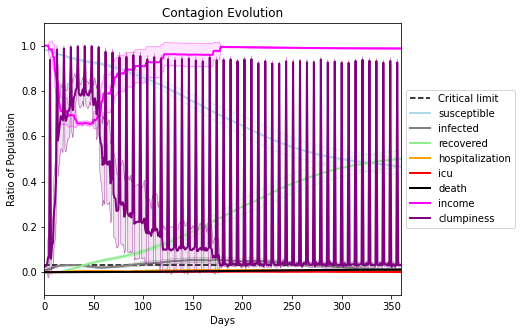

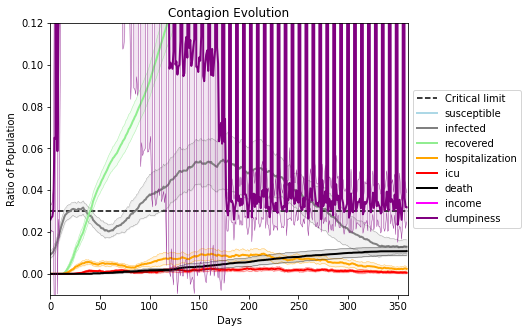

In [34]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.991
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[8821, 318, 8638, 6508, 3428, 2278, 9988, 7057, 521, 1193, 7627, 4471, 9651, 1725, 112, 142, 1836, 5399, 5306, 9527]
Average similarity between family members is 0.9026650286912936 at temperature -0.99
Average similarity between family and home is 0.9998497625355749 at temperature -1
Average similarity between students and their classroom is 0.47703230396674984 at temperature -0.99
Average classroom occupancy is 4.171428571428572 and number classrooms is 70
Average similarity between workers is 0.8175872392576117 at temperature -0.99
Average office occupancy is 3.282828282828283 and number offices is 198
Average friend similarity for adults: 0.8280436195941251 for kids: 0.6434977396471876
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Ho

avg restaurant similarity 0.5447172220797355
avg restaurant similarity 0.5099468532257263
avg restaurant similarity 0.5441178854723485
avg restaurant similarity 0.4528838409164276
avg restaurant similarity 0.5369023058049237
avg restaurant similarity 0.4969788439996938
avg restaurant similarity 0.49716845978532026
avg restaurant similarity 0.5306075340283556
avg restaurant similarity 0.45394145192408636
avg restaurant similarity 0.5232206069095715
avg restaurant similarity 0.44590203578652066
avg restaurant similarity 0.49130501955413675
avg restaurant similarity 0.5272987988402181
avg restaurant similarity 0.4995758043195126
avg restaurant similarity 0.4992735185519779
avg restaurant similarity 0.49840559143728463
avg restaurant similarity 0.5589542153101738
avg restaurant similarity 0.5324907235656501
avg restaurant similarity 0.5429362379072012
avg restaurant similarity 0.514625528448505
avg restaurant similarity 0.5169809185066311
avg restaurant similarity 0.5349658511123079
avg re

avg restaurant similarity 0.5418475228464636
avg restaurant similarity 0.47944089522056915
avg restaurant similarity 0.5865058456879043
avg restaurant similarity 0.5016164908597496
avg restaurant similarity 0.4942026125466232
avg restaurant similarity 0.5022157183769893
avg restaurant similarity 0.5186592710363567
avg restaurant similarity 0.41323659297894033
avg restaurant similarity 0.4216872119937053
avg restaurant similarity 0.5660759323554448
avg restaurant similarity 0.5029307506905591
avg restaurant similarity 0.5245463090169664
avg restaurant similarity 0.46931287361599733
avg restaurant similarity 0.4513942946065596
avg restaurant similarity 0.5470279660300091
avg restaurant similarity 0.49358464957346365
avg restaurant similarity 0.5326307708002985
avg restaurant similarity 0.4480376016126391
avg restaurant similarity 0.5357235616601194
avg restaurant similarity 0.47187974691011153
avg restaurant similarity 0.4924515800839026
avg restaurant similarity 0.5053543587453074
avg r

avg restaurant similarity 0.5580803804203539
avg restaurant similarity 0.5830701697204542
avg restaurant similarity 0.5220400882012987
avg restaurant similarity 0.46235880585616884
avg restaurant similarity 0.5168362893856884
avg restaurant similarity 0.4977933721452854
avg restaurant similarity 0.4896974957607791
avg restaurant similarity 0.4589856970625172
avg restaurant similarity 0.4526233080335129
avg restaurant similarity 0.5016193543890044
avg restaurant similarity 0.4841141953693537
avg restaurant similarity 0.5271897011428369
avg restaurant similarity 0.49020718237870176
avg restaurant similarity 0.4941969116173403
avg restaurant similarity 0.534839375456876
avg restaurant similarity 0.515158423649645
avg restaurant similarity 0.5520602310286944
avg restaurant similarity 0.5297281953129739
avg restaurant similarity 0.4990531433661649
avg restaurant similarity 0.4919812793274903
avg restaurant similarity 0.46925289711767754
avg restaurant similarity 0.4892844470002151
avg resta

avg restaurant similarity 0.5849119781692215
avg restaurant similarity 0.4442451985289631
avg restaurant similarity 0.4981921126065678
avg restaurant similarity 0.4576336628984043
avg restaurant similarity 0.5248049801238788
avg restaurant similarity 0.5270447664213883
avg restaurant similarity 0.5095518047461749
avg restaurant similarity 0.5921728992627595
avg restaurant similarity 0.5908458357437102
avg restaurant similarity 0.5028650800762611
avg restaurant similarity 0.5848084851894572
avg restaurant similarity 0.5282325231945331
avg restaurant similarity 0.5834925279492029
avg restaurant similarity 0.5614253312860596
avg restaurant similarity 0.5728156297602193
avg restaurant similarity 0.5099661157139251
avg restaurant similarity 0.47361688105884014
avg restaurant similarity 0.48639618588146966
avg restaurant similarity 0.4720440209273079
avg restaurant similarity 0.5297728128134911
avg restaurant similarity 0.5095517307806086
avg restaurant similarity 0.5210042901005765
avg rest

avg restaurant similarity 0.48727499115125433
avg restaurant similarity 0.5335569398152117
avg restaurant similarity 0.5373652870204483
avg restaurant similarity 0.6179142945234575
avg restaurant similarity 0.5275071879060351
avg restaurant similarity 0.5423827191921973
avg restaurant similarity 0.4869909339008304
avg restaurant similarity 0.4726687403034266
avg restaurant similarity 0.4718684004374852
avg restaurant similarity 0.4639613437342425
avg restaurant similarity 0.5318288733801815
avg restaurant similarity 0.4957619149902059
avg restaurant similarity 0.4906127688874816
avg restaurant similarity 0.4967462633093961
avg restaurant similarity 0.5046435475388255
avg restaurant similarity 0.548498413651107
avg restaurant similarity 0.506658504133849
avg restaurant similarity 0.5100446883265664
avg restaurant similarity 0.48317434189581265
avg restaurant similarity 0.5122034291644685
avg restaurant similarity 0.5328689576445206
avg restaurant similarity 0.48180722462445486
avg resta

avg restaurant similarity 0.5055737429175026
avg restaurant similarity 0.5066273382548003
avg restaurant similarity 0.5195344334395529
avg restaurant similarity 0.4881319380611245
avg restaurant similarity 0.44591631213390137
avg restaurant similarity 0.4641208633656106
avg restaurant similarity 0.5516486560412879
avg restaurant similarity 0.6092763636839896
avg restaurant similarity 0.5120277683831647
avg restaurant similarity 0.5026898546772242
avg restaurant similarity 0.4942704206145883
avg restaurant similarity 0.49209688089900816
avg restaurant similarity 0.48790179433424224
avg restaurant similarity 0.4599350743601987
avg restaurant similarity 0.54046097000204
avg restaurant similarity 0.4763922075765994
avg restaurant similarity 0.4912188421606739
avg restaurant similarity 0.489726989763818
avg restaurant similarity 0.5215051361215524
avg restaurant similarity 0.53290455719419
avg restaurant similarity 0.539734489107349
avg restaurant similarity 0.514051264906942
avg restaurant

avg restaurant similarity 0.5594961974419201
avg restaurant similarity 0.5037644521351853
avg restaurant similarity 0.4828112654327766
avg restaurant similarity 0.5268101184316464
avg restaurant similarity 0.43621283419357
avg restaurant similarity 0.46369956902425735
avg restaurant similarity 0.5143781530688523
avg restaurant similarity 0.48161976383246097
avg restaurant similarity 0.49282021579717794
avg restaurant similarity 0.4600417791060425
avg restaurant similarity 0.5185949856243381
avg restaurant similarity 0.5098392842949958
avg restaurant similarity 0.4989581516990266
avg restaurant similarity 0.5502569100370054
avg restaurant similarity 0.5001640450762227
avg restaurant similarity 0.5213574509737564
avg restaurant similarity 0.4920874687381186
avg restaurant similarity 0.510896289482848
avg restaurant similarity 0.4939817295786067
avg restaurant similarity 0.45123964227627816
avg restaurant similarity 0.4838838670871245
avg restaurant similarity 0.49265441565595763
avg rest

avg restaurant similarity 0.5004843521097303
avg restaurant similarity 0.46269568029060537
avg restaurant similarity 0.47814827251789027
avg restaurant similarity 0.4614808157360244
avg restaurant similarity 0.4912821110912553
avg restaurant similarity 0.48299429843237096
avg restaurant similarity 0.4343028760658364
avg restaurant similarity 0.4858921698717744
avg restaurant similarity 0.5744861493835166
avg restaurant similarity 0.45979026586031696
avg restaurant similarity 0.5062834304018522
avg restaurant similarity 0.46504167266879654
avg restaurant similarity 0.5237774349663137
avg restaurant similarity 0.5177179118131056
avg restaurant similarity 0.5373070275229683
avg restaurant similarity 0.4509521565638177
avg restaurant similarity 0.4491449399853417
avg restaurant similarity 0.566007971417769
avg restaurant similarity 0.46035241055805204
avg restaurant similarity 0.5083163147470702
avg restaurant similarity 0.49947676454117507
avg restaurant similarity 0.4791935795724547
avg 

avg restaurant similarity 0.5086856852485464
avg restaurant similarity 0.4649310365590063
avg restaurant similarity 0.5261585606979049
avg restaurant similarity 0.5323890370795656
avg restaurant similarity 0.5633855720741026
avg restaurant similarity 0.5188407210036979
avg restaurant similarity 0.48633636034985134
avg restaurant similarity 0.4300849567159757
avg restaurant similarity 0.4629116610788985
avg restaurant similarity 0.5323623932003029
avg restaurant similarity 0.4966271580101032
avg restaurant similarity 0.4669481126853777
avg restaurant similarity 0.4984903957774808
avg restaurant similarity 0.5138444234339878
avg restaurant similarity 0.5097196994951483
avg restaurant similarity 0.5330464223316984
avg restaurant similarity 0.5677345884560013
avg restaurant similarity 0.5225865577036846
avg restaurant similarity 0.5344537364451336
avg restaurant similarity 0.5045987520032322
avg restaurant similarity 0.5255664462445594
avg restaurant similarity 0.5110290000967254
avg resta

avg restaurant similarity 0.5210639977188048
avg restaurant similarity 0.5861897458185837
avg restaurant similarity 0.5327779181617377
avg restaurant similarity 0.5583106751117686
avg restaurant similarity 0.5080125362844166
avg restaurant similarity 0.5385960570316141
avg restaurant similarity 0.5101106162116361
avg restaurant similarity 0.48642584657910837
avg restaurant similarity 0.5337031811244125
avg restaurant similarity 0.5424781467565641
avg restaurant similarity 0.5414066047406536
avg restaurant similarity 0.5543659706937341
avg restaurant similarity 0.48746278607889465
avg restaurant similarity 0.5004929518258772
avg restaurant similarity 0.4703052407037062
avg restaurant similarity 0.5529200878792154
avg restaurant similarity 0.5155786707801385
avg restaurant similarity 0.5280099968216531
avg restaurant similarity 0.5369610637880732
avg restaurant similarity 0.4978676110473807
avg restaurant similarity 0.5405185986231807
avg restaurant similarity 0.5006150653375052
avg rest

avg restaurant similarity 0.493038782157884
avg restaurant similarity 0.4965487388600554
avg restaurant similarity 0.46081732146500476
avg restaurant similarity 0.4896978724046609
avg restaurant similarity 0.5230754950699181
avg restaurant similarity 0.4750133147131058
avg restaurant similarity 0.4829949001073146
avg restaurant similarity 0.49760200878744887
avg restaurant similarity 0.5424795945947998
avg restaurant similarity 0.5149689615326348
avg restaurant similarity 0.526485406752173
avg restaurant similarity 0.4666488194959181
avg restaurant similarity 0.43911706401692496
avg restaurant similarity 0.49718942565161806
avg restaurant similarity 0.48530471927288893
avg restaurant similarity 0.5529346587869733
avg restaurant similarity 0.5305695127327066
avg restaurant similarity 0.43781055159935284
avg restaurant similarity 0.5652404640214366
avg restaurant similarity 0.481841460188428
avg restaurant similarity 0.553495200843909
avg restaurant similarity 0.4957735964043884
avg rest

avg restaurant similarity 0.4484820389911557
avg restaurant similarity 0.48444821908700053
avg restaurant similarity 0.4738120863512393
avg restaurant similarity 0.4613339491824032
avg restaurant similarity 0.4854069734516212
avg restaurant similarity 0.4948590860633215
avg restaurant similarity 0.46901990842054225
avg restaurant similarity 0.5674905276953871
avg restaurant similarity 0.5336999422948037
avg restaurant similarity 0.47496066392532904
avg restaurant similarity 0.5612641069339246
avg restaurant similarity 0.4989675646162301
avg restaurant similarity 0.4421913327084177
avg restaurant similarity 0.512326043375965
avg restaurant similarity 0.515325384152246
avg restaurant similarity 0.5130842497828773
avg restaurant similarity 0.4733397888257692
avg restaurant similarity 0.5135509805822142
avg restaurant similarity 0.524023470414326
avg restaurant similarity 0.5135986769159843
avg restaurant similarity 0.5114676534523267
avg restaurant similarity 0.4818260558428579
avg restau

avg restaurant similarity 0.5218480930067654
avg restaurant similarity 0.5520055574875836
avg restaurant similarity 0.4542088351410581
avg restaurant similarity 0.46724261681752743
avg restaurant similarity 0.4779681288428051
avg restaurant similarity 0.5623426797385791
avg restaurant similarity 0.4604876185266723
avg restaurant similarity 0.5024150050284886
avg restaurant similarity 0.5273801526784321
avg restaurant similarity 0.47984169340844646
avg restaurant similarity 0.4751553904978287
avg restaurant similarity 0.500249455919385
avg restaurant similarity 0.49547081707867646
avg restaurant similarity 0.5351735818290907
avg restaurant similarity 0.4939299077420491
avg restaurant similarity 0.5114103678887898
avg restaurant similarity 0.46729240629902113
avg restaurant similarity 0.4973867682218944
avg restaurant similarity 0.46291038467871987
avg restaurant similarity 0.4302301820931613
avg restaurant similarity 0.5480825100229081
avg restaurant similarity 0.5021125531843151
avg re

avg restaurant similarity 0.47633848372778625
avg restaurant similarity 0.48905198130938954
avg restaurant similarity 0.4862361535389178
avg restaurant similarity 0.4718269725478986
avg restaurant similarity 0.47833055450223333
avg restaurant similarity 0.5526214486987405
avg restaurant similarity 0.4408892414838116
avg restaurant similarity 0.45117008341946924
avg restaurant similarity 0.5250219574341674
avg restaurant similarity 0.5317040668284053
avg restaurant similarity 0.5333996798317371
avg restaurant similarity 0.5088525764613913
avg restaurant similarity 0.5445337372341461
avg restaurant similarity 0.4787816384524556
avg restaurant similarity 0.4881024767791679
avg restaurant similarity 0.4831107536329346
avg restaurant similarity 0.4789346200028464
avg restaurant similarity 0.4467228631891867
avg restaurant similarity 0.4684547028775937
avg restaurant similarity 0.5357225419522942
avg restaurant similarity 0.5141339674466863
avg restaurant similarity 0.5196329712625056
avg re

avg restaurant similarity 0.4931385677436956
avg restaurant similarity 0.5297741227915859
avg restaurant similarity 0.5168061385346819
avg restaurant similarity 0.5234049607297929
avg restaurant similarity 0.5633263797772978
avg restaurant similarity 0.4820202485314534
avg restaurant similarity 0.5118090939674893
avg restaurant similarity 0.5251188089201873
avg restaurant similarity 0.5496058951844238
avg restaurant similarity 0.4967384586980334
avg restaurant similarity 0.5166125958551603
avg restaurant similarity 0.5034312689920026
avg restaurant similarity 0.5158838252365305
avg restaurant similarity 0.4974914351444054
avg restaurant similarity 0.5183914486285998
avg restaurant similarity 0.49310828193920025
avg restaurant similarity 0.4793047646839802
avg restaurant similarity 0.5548869168967075
avg restaurant similarity 0.4711850273759097
avg restaurant similarity 0.557919562334353
avg restaurant similarity 0.5026228894228697
avg restaurant similarity 0.4749851787266014
avg restau

avg restaurant similarity 0.5067701472223152
avg restaurant similarity 0.5005884311378742
avg restaurant similarity 0.5691523105266862
avg restaurant similarity 0.5432245274651496
avg restaurant similarity 0.4978940679713612
avg restaurant similarity 0.5573621889688614
avg restaurant similarity 0.49889732270205084
avg restaurant similarity 0.480895480131445
avg restaurant similarity 0.5838140287967241
avg restaurant similarity 0.5518234959586985
avg restaurant similarity 0.5013870830584793
avg restaurant similarity 0.5252482085968073
avg restaurant similarity 0.5276324316970346
avg restaurant similarity 0.47975776828164385
avg restaurant similarity 0.5362132593898481
avg restaurant similarity 0.4915401889447779
avg restaurant similarity 0.4999861785608906
avg restaurant similarity 0.528234484418176
avg restaurant similarity 0.5159823564958671
avg restaurant similarity 0.4909636835124646
avg restaurant similarity 0.5450275614688253
avg restaurant similarity 0.544460072121112
avg restaur

avg restaurant similarity 0.5149639832992995
avg restaurant similarity 0.45218719474394076
avg restaurant similarity 0.45267621768018185
avg restaurant similarity 0.5002399427743389
avg restaurant similarity 0.4861872070321763
avg restaurant similarity 0.4936601556947619
avg restaurant similarity 0.5384426014560361
avg restaurant similarity 0.4996921074191915
avg restaurant similarity 0.46114028100518073
avg restaurant similarity 0.4332473303464301
avg restaurant similarity 0.45901401274789544
avg restaurant similarity 0.5234169068001163
avg restaurant similarity 0.47331917546469804
avg restaurant similarity 0.44528611406940627
avg restaurant similarity 0.47933160047601786
avg restaurant similarity 0.5119913655772231
avg restaurant similarity 0.5137179009738595
avg restaurant similarity 0.5212521522064866
avg restaurant similarity 0.5086416619888731
avg restaurant similarity 0.5237206912550685
avg restaurant similarity 0.4449237084444979
avg restaurant similarity 0.5493848233048086
avg

avg restaurant similarity 0.49784008246060046
avg restaurant similarity 0.5413548790311757
avg restaurant similarity 0.5119793323622336
avg restaurant similarity 0.5388141912622343
avg restaurant similarity 0.5354337058563207
avg restaurant similarity 0.4876944038475743
avg restaurant similarity 0.5117417027228361
avg restaurant similarity 0.5114098152176101
avg restaurant similarity 0.4987270634123271
avg restaurant similarity 0.4633647473337161
avg restaurant similarity 0.49726185315240684
avg restaurant similarity 0.4464735740744608
avg restaurant similarity 0.5048632622006852
avg restaurant similarity 0.5156220773045227
avg restaurant similarity 0.44571322750663916
avg restaurant similarity 0.5316244258952171
avg restaurant similarity 0.514608838979106
avg restaurant similarity 0.4880519409748668
avg restaurant similarity 0.4772514237983969
avg restaurant similarity 0.4736976533300223
avg restaurant similarity 0.4926220190820152
avg restaurant similarity 0.5127702143481836
avg rest

avg restaurant similarity 0.43560516719480175
avg restaurant similarity 0.4651004573115478
avg restaurant similarity 0.43339873374595594
avg restaurant similarity 0.4627204223624433
avg restaurant similarity 0.4628446001200057
avg restaurant similarity 0.4383648933989118
avg restaurant similarity 0.49152888156779434
avg restaurant similarity 0.46079490470905526
avg restaurant similarity 0.568686371915216
avg restaurant similarity 0.4907442511462065
avg restaurant similarity 0.5017102900142666
avg restaurant similarity 0.5388707281257602
avg restaurant similarity 0.4507904212031902
avg restaurant similarity 0.4614913921225938
avg restaurant similarity 0.4888833300860845
avg restaurant similarity 0.5010066315091544
avg restaurant similarity 0.466218208992518
avg restaurant similarity 0.43274178404706315
avg restaurant similarity 0.5001028422867848
avg restaurant similarity 0.5048993150663645
avg restaurant similarity 0.4834073400002201
avg restaurant similarity 0.4569121742218756
avg res

avg restaurant similarity 0.5218963508485838
avg restaurant similarity 0.48828068625775517
avg restaurant similarity 0.49616535565602427
avg restaurant similarity 0.5492992487140318
avg restaurant similarity 0.5525569462600824
avg restaurant similarity 0.4492877568220015
avg restaurant similarity 0.46795934561834773
avg restaurant similarity 0.5241788587577816
avg restaurant similarity 0.5247106359092711
avg restaurant similarity 0.526131529407029
avg restaurant similarity 0.561061571861544
avg restaurant similarity 0.4267403427643954
avg restaurant similarity 0.5237051957681691
avg restaurant similarity 0.4914689529323447
avg restaurant similarity 0.43944000925450394
avg restaurant similarity 0.4845232828854082
avg restaurant similarity 0.46470186024944077
avg restaurant similarity 0.5571534315451767
avg restaurant similarity 0.5082759838130667
avg restaurant similarity 0.5145944567227521
avg restaurant similarity 0.5031569294058442
avg restaurant similarity 0.49438908815813226
avg re

avg restaurant similarity 0.5362289184671708
avg restaurant similarity 0.5043130208594138
avg restaurant similarity 0.5039409804655751
avg restaurant similarity 0.48397996715768477
avg restaurant similarity 0.4995179620265176
avg restaurant similarity 0.48140850731983337
avg restaurant similarity 0.5359387326129349
avg restaurant similarity 0.4816303614470503
avg restaurant similarity 0.49322431533284283
avg restaurant similarity 0.47351657141004255
avg restaurant similarity 0.5394424577248158
avg restaurant similarity 0.5292003983368381
avg restaurant similarity 0.5035202173776304
avg restaurant similarity 0.5051763231715101
avg restaurant similarity 0.4794213747016332
avg restaurant similarity 0.5051844485604567
avg restaurant similarity 0.45501588399554743
avg restaurant similarity 0.5204392253518612
avg restaurant similarity 0.4985737330348755
avg restaurant similarity 0.45233863727159157
avg restaurant similarity 0.5014521456839676
avg restaurant similarity 0.49589404724405467
avg

avg restaurant similarity 0.557664874245265
avg restaurant similarity 0.5392241799789278
avg restaurant similarity 0.5212417816374649
avg restaurant similarity 0.5869393894179771
avg restaurant similarity 0.5337338965072225
avg restaurant similarity 0.5093087762461532
avg restaurant similarity 0.5786660307790714
avg restaurant similarity 0.5882813636178807
avg restaurant similarity 0.5511149791718962
avg restaurant similarity 0.49556696536311273
avg restaurant similarity 0.5601932780965514
avg restaurant similarity 0.5436044349831448
avg restaurant similarity 0.5557701391388377
avg restaurant similarity 0.5591073207977793
avg restaurant similarity 0.5031188661275636
avg restaurant similarity 0.5593871664111936
avg restaurant similarity 0.5339898072216924
avg restaurant similarity 0.5302223582097455
avg restaurant similarity 0.5391524621040805
avg restaurant similarity 0.4948228228333652
avg restaurant similarity 0.4943040855943349
avg restaurant similarity 0.5307901824342286
avg restau

avg restaurant similarity 0.42367541191267327
avg restaurant similarity 0.4939156204438183
avg restaurant similarity 0.5136628862123821
avg restaurant similarity 0.4766043085237848
avg restaurant similarity 0.4744170041129652
avg restaurant similarity 0.47851074098841356
avg restaurant similarity 0.5316000978477524
avg restaurant similarity 0.5293175599645566
avg restaurant similarity 0.48717466403763593
avg restaurant similarity 0.5247948615114475
avg restaurant similarity 0.4517534014113342
avg restaurant similarity 0.47332850717747266
avg restaurant similarity 0.5185268342360132
avg restaurant similarity 0.4766852493776881
avg restaurant similarity 0.5531937830569293
avg restaurant similarity 0.5059667374941497
avg restaurant similarity 0.5263744360561015
avg restaurant similarity 0.5339867077320795
avg restaurant similarity 0.4835588096203277
avg restaurant similarity 0.4823838905745355
avg restaurant similarity 0.4903847634979968
avg restaurant similarity 0.5077717865230373
avg re

avg restaurant similarity 0.4800639286705912
avg restaurant similarity 0.46817976230086733
avg restaurant similarity 0.5671375699877027
avg restaurant similarity 0.517611862449207
avg restaurant similarity 0.5069103670595321
avg restaurant similarity 0.4586111397947453
avg restaurant similarity 0.523335127626266
avg restaurant similarity 0.5193730228130473
avg restaurant similarity 0.48545129191359476
avg restaurant similarity 0.5030729079204939
avg restaurant similarity 0.47215151989734494
avg restaurant similarity 0.45651926191035136
avg restaurant similarity 0.4769999056739504
avg restaurant similarity 0.47935998155002574
avg restaurant similarity 0.4781315451832336
avg restaurant similarity 0.46340576073676903
avg restaurant similarity 0.4859131844165267
avg restaurant similarity 0.5704670090163035
avg restaurant similarity 0.5459153649789852
avg restaurant similarity 0.4375828414905791
avg restaurant similarity 0.45805402927654787
avg restaurant similarity 0.48348974444182347
avg 

avg restaurant similarity 0.4481782419098376
avg restaurant similarity 0.48976164588131266
avg restaurant similarity 0.49525372788647704
avg restaurant similarity 0.506926637051918
avg restaurant similarity 0.5124837320440622
avg restaurant similarity 0.48856605682841825
avg restaurant similarity 0.5244404223379734
avg restaurant similarity 0.4640583354033755
avg restaurant similarity 0.507512157176446
avg restaurant similarity 0.5111908253241483
avg restaurant similarity 0.502212015832265
avg restaurant similarity 0.5383459709242847
avg restaurant similarity 0.45457363310766297
avg restaurant similarity 0.49412695696070924
avg restaurant similarity 0.5242367511149951
avg restaurant similarity 0.45830738271238536
avg restaurant similarity 0.5271318357786582
avg restaurant similarity 0.5103681619576474
avg restaurant similarity 0.5157867884441306
avg restaurant similarity 0.5019464887193652
avg restaurant similarity 0.4690753756641939
avg restaurant similarity 0.5170052303515486
avg res

avg restaurant similarity 0.5214101857718894
avg restaurant similarity 0.464256563697175
avg restaurant similarity 0.4823849057414869
avg restaurant similarity 0.5015892975308487
avg restaurant similarity 0.49434363766084577
avg restaurant similarity 0.49761676463316024
avg restaurant similarity 0.4950227053650367
avg restaurant similarity 0.5289191467078664
avg restaurant similarity 0.48018523958321463
avg restaurant similarity 0.5446567244381189
avg restaurant similarity 0.5180895368379889
avg restaurant similarity 0.525328514039374
avg restaurant similarity 0.46689037662781446
avg restaurant similarity 0.4670853178562563
avg restaurant similarity 0.49269423552270597
avg restaurant similarity 0.5131011330354357
avg restaurant similarity 0.5239204291006824
avg restaurant similarity 0.467442911257058
avg restaurant similarity 0.5070431917369196
avg restaurant similarity 0.4585352237664702
avg restaurant similarity 0.5165986859324282
avg restaurant similarity 0.5381815313297195
avg rest

avg restaurant similarity 0.5029332929695927
avg restaurant similarity 0.46215349749957213
avg restaurant similarity 0.5327251372810015
avg restaurant similarity 0.4637180664531682
avg restaurant similarity 0.4841184448077979
avg restaurant similarity 0.5000017839863045
avg restaurant similarity 0.4525853379233558
avg restaurant similarity 0.43485340839638964
avg restaurant similarity 0.4942149838331305
avg restaurant similarity 0.5399194763677374
avg restaurant similarity 0.5044096759288125
avg restaurant similarity 0.4571370721544658
avg restaurant similarity 0.46103293038887555
avg restaurant similarity 0.5378769971656366
avg restaurant similarity 0.5388456028694104
avg restaurant similarity 0.4285149630293509
avg restaurant similarity 0.4932426453884231
avg restaurant similarity 0.4990816114016823
avg restaurant similarity 0.4480019367921798
avg restaurant similarity 0.4995259695503627
avg restaurant similarity 0.43617700163388723
avg restaurant similarity 0.5092674469205919
avg re

avg restaurant similarity 0.507218218865002
avg restaurant similarity 0.47696700125565544
avg restaurant similarity 0.46917157728389625
avg restaurant similarity 0.48538841869703725
avg restaurant similarity 0.44029502275234716
avg restaurant similarity 0.5348426252594104
avg restaurant similarity 0.47657783543830845
avg restaurant similarity 0.5037524701487243
avg restaurant similarity 0.47549076091027254
avg restaurant similarity 0.5052354307264352
avg restaurant similarity 0.4455751090703638
avg restaurant similarity 0.48780954742395544
avg restaurant similarity 0.494269491839104
avg restaurant similarity 0.5011281162885795
avg restaurant similarity 0.4992593212020679
avg restaurant similarity 0.46084289123361777
avg restaurant similarity 0.4890616341982339
avg restaurant similarity 0.5331272532034399
avg restaurant similarity 0.4838315600172236
avg restaurant similarity 0.4919909151674818
avg restaurant similarity 0.5347079945684426
avg restaurant similarity 0.5131209813618257
avg 

avg restaurant similarity 0.46759042379154536
avg restaurant similarity 0.47292540467080846
avg restaurant similarity 0.4985169548256615
avg restaurant similarity 0.4786144891143937
avg restaurant similarity 0.5441469578998402
avg restaurant similarity 0.5072476702311022
avg restaurant similarity 0.5515728336689637
avg restaurant similarity 0.4724996032121023
avg restaurant similarity 0.46999863198261665
avg restaurant similarity 0.4874286045612259
avg restaurant similarity 0.48123591140322414
avg restaurant similarity 0.45132464732433886
avg restaurant similarity 0.5501688800868282
avg restaurant similarity 0.4741393359382196
avg restaurant similarity 0.46851382221347476
avg restaurant similarity 0.48770945145189953
avg restaurant similarity 0.47412545973907516
avg restaurant similarity 0.4850364145926389
avg restaurant similarity 0.5231759980945478
avg restaurant similarity 0.4819435161245871
avg restaurant similarity 0.480845664053753
avg restaurant similarity 0.46494357022037536
av

avg restaurant similarity 0.4967334566189083
avg restaurant similarity 0.4715684546074792
avg restaurant similarity 0.46075341478109016
avg restaurant similarity 0.4704341982655122
avg restaurant similarity 0.47475588680163844
avg restaurant similarity 0.41709314628557786
avg restaurant similarity 0.483441618229154
avg restaurant similarity 0.4677291185328033
avg restaurant similarity 0.46139105146862336
avg restaurant similarity 0.5030403365972632
avg restaurant similarity 0.4571221413174873
avg restaurant similarity 0.5139713714356527
avg restaurant similarity 0.519587513935811
avg restaurant similarity 0.5332868157564248
avg restaurant similarity 0.4861543705366783
avg restaurant similarity 0.5056961001573254
avg restaurant similarity 0.46273645108176964
avg restaurant similarity 0.49061989895851366
avg restaurant similarity 0.49974426188892423
avg restaurant similarity 0.4617523880907361
avg restaurant similarity 0.5040600364988214
avg restaurant similarity 0.48495565732235457
avg 

avg restaurant similarity 0.5133888829030812
avg restaurant similarity 0.5253162238286715
avg restaurant similarity 0.4769790399180115
avg restaurant similarity 0.5017949068821552
avg restaurant similarity 0.5088112928830512
avg restaurant similarity 0.47008604970390366
avg restaurant similarity 0.48455767340121697
avg restaurant similarity 0.4783427487767473
avg restaurant similarity 0.5216786641010397
avg restaurant similarity 0.593614301883853
avg restaurant similarity 0.4622030901144615
avg restaurant similarity 0.5053744487662868
avg restaurant similarity 0.5053347285360803
avg restaurant similarity 0.4975156955260942
avg restaurant similarity 0.5223958038456729
avg restaurant similarity 0.4901076343966535
avg restaurant similarity 0.5364744475195824
avg restaurant similarity 0.5189599756075118
avg restaurant similarity 0.48035679122339464
avg restaurant similarity 0.4921643161055428
avg restaurant similarity 0.5046770864389843
avg restaurant similarity 0.5143437457923616
avg rest

avg restaurant similarity 0.5098679809598631
avg restaurant similarity 0.5378029936337742
avg restaurant similarity 0.519334763660697
avg restaurant similarity 0.5430249679733682
avg restaurant similarity 0.5478382310612446
avg restaurant similarity 0.5172252758305297
avg restaurant similarity 0.48725354972749174
avg restaurant similarity 0.5064666974655394
avg restaurant similarity 0.6105614602127504
avg restaurant similarity 0.5158570882952623
avg restaurant similarity 0.4942711306413643
avg restaurant similarity 0.4674030614194051
avg restaurant similarity 0.5551434486590536
avg restaurant similarity 0.5613105225102722
avg restaurant similarity 0.513406566252057
avg restaurant similarity 0.5124107292271911
avg restaurant similarity 0.5422533483608913
avg restaurant similarity 0.48406055219401545
avg restaurant similarity 0.5201232922042369
avg restaurant similarity 0.5379219231245227
avg restaurant similarity 0.4715619083468242
avg restaurant similarity 0.46594365348287975
avg resta

avg restaurant similarity 0.4686162486356484
avg restaurant similarity 0.5404363919713421
avg restaurant similarity 0.5322342789013135
avg restaurant similarity 0.512989392707108
avg restaurant similarity 0.530649405584568
avg restaurant similarity 0.5613962076985776
avg restaurant similarity 0.5106312769438249
avg restaurant similarity 0.6187007657924617
avg restaurant similarity 0.580518696561455
avg restaurant similarity 0.5081995342258215
avg restaurant similarity 0.5353846543860853
avg restaurant similarity 0.5356852240002782
avg restaurant similarity 0.536492626863021
avg restaurant similarity 0.5125733760248343
avg restaurant similarity 0.520424738472387
avg restaurant similarity 0.5359961414723399
avg restaurant similarity 0.544475678066131
avg restaurant similarity 0.5452970645946914
avg restaurant similarity 0.5373188013639578
avg restaurant similarity 0.510111827939613
avg restaurant similarity 0.5571343501624649
avg restaurant similarity 0.578006411200828
avg restaurant sim

avg restaurant similarity 0.4974362709358783
avg restaurant similarity 0.5060091805058797
avg restaurant similarity 0.5162507462834819
avg restaurant similarity 0.4742879825254398
avg restaurant similarity 0.4901373531263548
avg restaurant similarity 0.503631742971955
avg restaurant similarity 0.5333588878712947
avg restaurant similarity 0.5492132240141937
avg restaurant similarity 0.5439113675121156
avg restaurant similarity 0.5396366203099883
avg restaurant similarity 0.5323524309315266
avg restaurant similarity 0.48623579913548126
avg restaurant similarity 0.5477150087925
avg restaurant similarity 0.519915189705468
avg restaurant similarity 0.5170878296761962
avg restaurant similarity 0.49408810303053596
avg restaurant similarity 0.5192859838505659
avg restaurant similarity 0.5493227319632317
avg restaurant similarity 0.5094535941817767
avg restaurant similarity 0.48438622184736096
avg restaurant similarity 0.4975681255508352
avg restaurant similarity 0.4634357475136225
avg restaura

avg restaurant similarity 0.4670313948675969
avg restaurant similarity 0.4905062136390394
avg restaurant similarity 0.49424724902266115
avg restaurant similarity 0.4602893016195556
avg restaurant similarity 0.4401594135503793
avg restaurant similarity 0.4630932440389047
avg restaurant similarity 0.49469848875676886
avg restaurant similarity 0.48248449013283135
avg restaurant similarity 0.4925644686401186
avg restaurant similarity 0.49861891149767473
avg restaurant similarity 0.4879161137912454
avg restaurant similarity 0.4723790999997631
avg restaurant similarity 0.5078268792383476
avg restaurant similarity 0.5248269232145374
avg restaurant similarity 0.566532282717903
avg restaurant similarity 0.4668393630786721
avg restaurant similarity 0.46629968700677155
avg restaurant similarity 0.4783748671018464
avg restaurant similarity 0.46855314077725174
avg restaurant similarity 0.47878546944042605
avg restaurant similarity 0.4971139488301781
avg restaurant similarity 0.4957047148390567
avg 

avg restaurant similarity 0.4965871685879015
avg restaurant similarity 0.5216553404927347
avg restaurant similarity 0.5036319695388535
avg restaurant similarity 0.47741287522086223
avg restaurant similarity 0.49305536173708575
avg restaurant similarity 0.4584520219258405
avg restaurant similarity 0.4645973403819153
avg restaurant similarity 0.5421400183475981
avg restaurant similarity 0.4872170168082033
avg restaurant similarity 0.5104258154048111
avg restaurant similarity 0.4400476374000308
avg restaurant similarity 0.503477044991133
avg restaurant similarity 0.4703201631052354
avg restaurant similarity 0.4894095696995411
avg restaurant similarity 0.41880779603504525
avg restaurant similarity 0.5425398101257456
avg restaurant similarity 0.5182116286235606
avg restaurant similarity 0.4751600714222164
avg restaurant similarity 0.46935467133350955
avg restaurant similarity 0.5075308325136729
avg restaurant similarity 0.5224138271878531
avg restaurant similarity 0.5747749445200024
avg res

avg restaurant similarity 0.5236362749797774
avg restaurant similarity 0.5376871065783501
avg restaurant similarity 0.5429965445856196
avg restaurant similarity 0.5579671882081021
avg restaurant similarity 0.49364325361512873
avg restaurant similarity 0.520065685946851
avg restaurant similarity 0.5100279561448214
avg restaurant similarity 0.5300772738364895
avg restaurant similarity 0.5250033779561277
avg restaurant similarity 0.5561499118052274
avg restaurant similarity 0.5158184586596201
avg restaurant similarity 0.49734643693032626
avg restaurant similarity 0.4982909534491976
avg restaurant similarity 0.525003514928813
avg restaurant similarity 0.5133069772377862
avg restaurant similarity 0.5323414485290971
avg restaurant similarity 0.49417957846389515
avg restaurant similarity 0.5437922135123728
avg restaurant similarity 0.4867542748101154
avg restaurant similarity 0.5229111216296574
avg restaurant similarity 0.4887922577402832
avg restaurant similarity 0.5032080567304344
avg resta

avg restaurant similarity 0.5252483878198949
avg restaurant similarity 0.533383920530484
avg restaurant similarity 0.5264477001106688
avg restaurant similarity 0.562651851379368
avg restaurant similarity 0.5162786695071496
avg restaurant similarity 0.5182656380322919
avg restaurant similarity 0.5424349740428347
avg restaurant similarity 0.5377207459783057
avg restaurant similarity 0.5747370788531266
avg restaurant similarity 0.5800510505698012
avg restaurant similarity 0.5885706327542455
avg restaurant similarity 0.5666030528353677
avg restaurant similarity 0.5353975582748203
avg restaurant similarity 0.5109906142685227
avg restaurant similarity 0.5339288979863503
avg restaurant similarity 0.5740366813747353
avg restaurant similarity 0.5462250249616781
avg restaurant similarity 0.5505300094500545
avg restaurant similarity 0.5458188262805257
avg restaurant similarity 0.5197599171338075
avg restaurant similarity 0.5379088794063542
avg restaurant similarity 0.5190578549232795
avg restaura

avg restaurant similarity 0.5337492287420599
avg restaurant similarity 0.5308651331747983
avg restaurant similarity 0.5800535618215423
avg restaurant similarity 0.5031267470594456
avg restaurant similarity 0.5037880399889108
avg restaurant similarity 0.5210205614803101
avg restaurant similarity 0.5656398201303119
avg restaurant similarity 0.563065331919527
avg restaurant similarity 0.5159890665189177
avg restaurant similarity 0.5143906115712108
avg restaurant similarity 0.5801786659879083
avg restaurant similarity 0.575790531831133
avg restaurant similarity 0.5721050347088014
avg restaurant similarity 0.5357610838461636
avg restaurant similarity 0.5069490044778854
avg restaurant similarity 0.5058927453441334
avg restaurant similarity 0.5320475641801073
avg restaurant similarity 0.5696897996020461
avg restaurant similarity 0.5453838278869877
avg restaurant similarity 0.5191686058737528
avg restaurant similarity 0.5502991801626618
avg restaurant similarity 0.4972858579817468
avg restaura

avg restaurant similarity 0.5860626286756009
avg restaurant similarity 0.49051545732845037
avg restaurant similarity 0.5275516701938242
avg restaurant similarity 0.506896037476017
avg restaurant similarity 0.5414050368487535
avg restaurant similarity 0.5514427385629062
avg restaurant similarity 0.5314520987215648
avg restaurant similarity 0.5079564541331714
avg restaurant similarity 0.5141734205505821
avg restaurant similarity 0.514079159059272
avg restaurant similarity 0.5487852229397687
avg restaurant similarity 0.4765976003439714
avg restaurant similarity 0.5212890293096105
avg restaurant similarity 0.5575330053374944
avg restaurant similarity 0.5016001385369024
avg restaurant similarity 0.5610935347192366
avg restaurant similarity 0.5438683645177586
avg restaurant similarity 0.5108149398942737
avg restaurant similarity 0.5331208475090528
avg restaurant similarity 0.4757982897135112
avg restaurant similarity 0.4948869962249992
avg restaurant similarity 0.5101741845411178
avg restaur

(<function dict.items>, <function dict.items>, <function dict.items>)

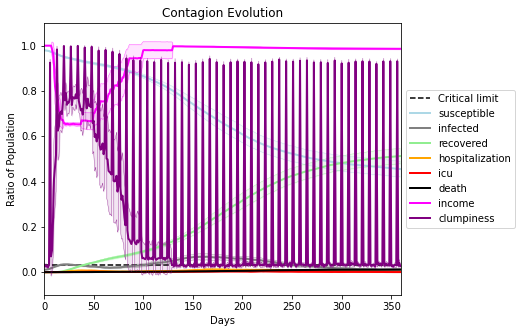

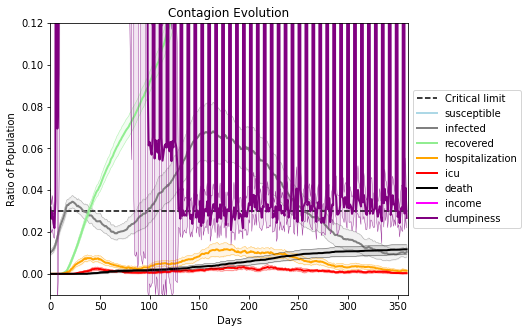

In [35]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.99
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
              [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
], work_home_list = [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
], listeners = listeners)

Save these seeds if you want to rerun a scenario
[561, 249, 7319, 6944, 7623, 4612, 2050, 1612, 237, 6558, 1902, 6990, 4674, 5598, 2820, 6965, 7903, 1810, 6533, 7120]
Average similarity between family members is 0.5588825258132918 at temperature -0.9
Average similarity between family and home is 0.9998550675304001 at temperature -1
Average similarity between students and their classroom is 0.21468913270414336 at temperature -0.9
Average classroom occupancy is 3.8260869565217392 and number classrooms is 69
Average similarity between workers is 0.4648188783261237 at temperature -0.9
Average office occupancy is 3.366336633663366 and number offices is 202
Average friend similarity for adults: 0.6076497999136922 for kids: 0.4443881258056464
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Hom

avg restaurant similarity 0.15900690176960455
avg restaurant similarity 0.11383235239089856
avg restaurant similarity 0.11585615079954786
avg restaurant similarity 0.1167777414407745
avg restaurant similarity 0.10269191028829797
avg restaurant similarity 0.1252960385064501
avg restaurant similarity 0.06857723316800475
avg restaurant similarity 0.09957022348595504
avg restaurant similarity 0.11424885812111778
avg restaurant similarity 0.10410708163832179
avg restaurant similarity 0.15288943114316658
avg restaurant similarity 0.13425053233628614
avg restaurant similarity 0.07774652083003047
avg restaurant similarity 0.13231922103481536
avg restaurant similarity 0.13991826109062863
avg restaurant similarity 0.07608805813850682
avg restaurant similarity 0.0747458009698771
avg restaurant similarity 0.12398369234686837
avg restaurant similarity 0.1313849337331371
avg restaurant similarity 0.14393107170607683
avg restaurant similarity 0.07412039673788631
avg restaurant similarity 0.1214274405

avg restaurant similarity 0.13221741232625797
avg restaurant similarity 0.0823178371049812
avg restaurant similarity 0.09312276911016373
avg restaurant similarity 0.08960203625137933
avg restaurant similarity 0.13920696995423482
avg restaurant similarity 0.12631325670559826
avg restaurant similarity 0.086746157823644
avg restaurant similarity 0.11105198180261219
avg restaurant similarity 0.11233743324540549
avg restaurant similarity 0.13612137128567778
avg restaurant similarity 0.08225714888012996
avg restaurant similarity 0.18836328289626886
avg restaurant similarity 0.1559876171617375
avg restaurant similarity 0.15141644977617985
avg restaurant similarity 0.12637622579738617
avg restaurant similarity 0.10749700433653359
avg restaurant similarity 0.13195360589736038
avg restaurant similarity 0.1024483492940044
avg restaurant similarity 0.18558546509643753
avg restaurant similarity 0.12240504994747245
avg restaurant similarity 0.13697755929655747
avg restaurant similarity 0.10532187780

avg restaurant similarity 0.0824484774246647
avg restaurant similarity 0.08796794339415406
avg restaurant similarity 0.06398813808963673
avg restaurant similarity 0.06446261962461426
avg restaurant similarity 0.0390999926065726
avg restaurant similarity 0.08335954885822447
avg restaurant similarity 0.06616788553094471
avg restaurant similarity 0.02770795403015248
avg restaurant similarity -0.005359573841822861
avg restaurant similarity 0.033355632882638694
avg restaurant similarity 0.10515210621965702
avg restaurant similarity -0.008972998165953169
avg restaurant similarity 0.08243273588647855
avg restaurant similarity 0.06927032514430018
avg restaurant similarity 0.043382454611107624
avg restaurant similarity 0.13886086353533694
avg restaurant similarity 0.028119951487798875
avg restaurant similarity 0.06582490708158552
avg restaurant similarity 0.04475765379239898
avg restaurant similarity 0.07222316535628097
avg restaurant similarity 0.04957678522573215
avg restaurant similarity 0.0

avg restaurant similarity 0.11006395257691197
avg restaurant similarity 0.06605424227320929
avg restaurant similarity 0.05693916142123198
avg restaurant similarity 0.08868104568191185
avg restaurant similarity 0.12008720232455938
avg restaurant similarity 0.060289377478823174
avg restaurant similarity 0.08834792442582394
avg restaurant similarity 0.05364569524474216
avg restaurant similarity 0.12156488702280538
avg restaurant similarity 0.10890583531264007
avg restaurant similarity 0.11264803932551133
avg restaurant similarity 0.040707464305787505
avg restaurant similarity 0.08930399452269171
avg restaurant similarity 0.030898177154430134
avg restaurant similarity 0.0921547104202859
avg restaurant similarity 0.09094755374511045
avg restaurant similarity 0.05051133802675666
avg restaurant similarity 0.06424266848487006
avg restaurant similarity 0.07033818435870647
avg restaurant similarity 0.12103835369204546
avg restaurant similarity 0.10200094859092701
avg restaurant similarity 0.0167

avg restaurant similarity 0.12630627988498278
avg restaurant similarity 0.1337309160292552
avg restaurant similarity 0.09138044276089288
avg restaurant similarity 0.10977076960741453
avg restaurant similarity 0.14466743038552066
avg restaurant similarity 0.06974114439270447
avg restaurant similarity 0.10941077182920159
avg restaurant similarity 0.09212869506757627
avg restaurant similarity 0.060148765036950255
avg restaurant similarity 0.051275061829071385
avg restaurant similarity 0.1152354180102997
avg restaurant similarity 0.06791480691459639
avg restaurant similarity 0.15420729631232136
avg restaurant similarity 0.06185210257675014
avg restaurant similarity 0.12514280388403592
avg restaurant similarity 0.08865136629112763
avg restaurant similarity 0.12072428814436093
avg restaurant similarity 0.10504005233945544
avg restaurant similarity 0.06749316351608785
avg restaurant similarity 0.12374286578459497
avg restaurant similarity 0.14122302832394007
avg restaurant similarity 0.090425

avg restaurant similarity 0.06454182497919543
avg restaurant similarity 0.09275303933853525
avg restaurant similarity 0.1582424518894848
avg restaurant similarity 0.07439432822165316
avg restaurant similarity 0.08429586323487094
avg restaurant similarity 0.10793386207266699
avg restaurant similarity 0.05990947159286688
avg restaurant similarity 0.11634311061934327
avg restaurant similarity 0.04479901639120722
avg restaurant similarity 0.12376289940920751
avg restaurant similarity 0.11615183765486321
avg restaurant similarity 0.1728838813326618
avg restaurant similarity 0.06663835587494875
avg restaurant similarity 0.1239781590194329
avg restaurant similarity 0.13855597511638537
avg restaurant similarity 0.1376942934882299
avg restaurant similarity 0.09143130824042711
avg restaurant similarity 0.07676655608257292
avg restaurant similarity 0.13520909267545098
avg restaurant similarity 0.1233469026709069
avg restaurant similarity 0.08798092637942913
avg restaurant similarity 0.14248339834

avg restaurant similarity 0.09670951603264295
avg restaurant similarity 0.10694994751495915
avg restaurant similarity 0.12955088738070245
avg restaurant similarity 0.10290329057958095
avg restaurant similarity 0.04453236864986781
avg restaurant similarity 0.022246399298866817
avg restaurant similarity 0.1293350225168698
avg restaurant similarity 0.11474393401635018
avg restaurant similarity 0.09254600086116485
avg restaurant similarity 0.008666138605730072
avg restaurant similarity 0.1158887200261646
avg restaurant similarity 0.07063380655521366
avg restaurant similarity 0.08778452749963424
avg restaurant similarity 0.09299967720381981
avg restaurant similarity 0.18249168225772297
avg restaurant similarity 0.09353341401171177
avg restaurant similarity 0.06691932358764138
avg restaurant similarity 0.0513492809550282
avg restaurant similarity 0.1734536099851993
avg restaurant similarity 0.10012024459634897
avg restaurant similarity 0.020737505723968784
avg restaurant similarity 0.0788526

avg restaurant similarity 0.14306096663718967
avg restaurant similarity -0.0067938184685028095
avg restaurant similarity 0.10417021539138362
avg restaurant similarity 0.15922372966912413
avg restaurant similarity 0.10830902422035893
avg restaurant similarity 0.15569704017638064
avg restaurant similarity 0.09498590069277506
avg restaurant similarity 0.07929211696604732
avg restaurant similarity 0.10485218738006083
avg restaurant similarity 0.09526855146939543
avg restaurant similarity 0.10899949854128568
avg restaurant similarity 0.06621436967140455
avg restaurant similarity 0.09833018019514428
avg restaurant similarity 0.10096321450486274
avg restaurant similarity 0.07470252765494317
avg restaurant similarity 0.1085051918935612
avg restaurant similarity 0.07801243313198351
avg restaurant similarity 0.12889941688481343
avg restaurant similarity 0.10981183792698193
avg restaurant similarity 0.07889747602522788
avg restaurant similarity 0.1003720308850508
avg restaurant similarity 0.04215

avg restaurant similarity 0.052863380595114064
avg restaurant similarity 0.13421199014257684
avg restaurant similarity 0.20357697831559962
avg restaurant similarity 0.08550052708366941
avg restaurant similarity 0.11701983651068074
avg restaurant similarity 0.12780032189898227
avg restaurant similarity 0.13422948553139213
avg restaurant similarity 0.1364527697951146
avg restaurant similarity 0.10138233792908283
avg restaurant similarity 0.10908508463166891
avg restaurant similarity 0.12583292506419302
avg restaurant similarity 0.13331130630460808
avg restaurant similarity 0.06055876008461369
avg restaurant similarity 0.10242279675920375
avg restaurant similarity 0.09233145340493035
avg restaurant similarity 0.10478753212407926
avg restaurant similarity 0.1286231530385435
avg restaurant similarity 0.08328178471944168
avg restaurant similarity 0.10949867978615997
avg restaurant similarity 0.07796529535222321
avg restaurant similarity 0.08482564410880994
avg restaurant similarity 0.1826318

avg restaurant similarity 0.09160960281779373
avg restaurant similarity 0.03677925088342858
avg restaurant similarity 0.15031693510207034
avg restaurant similarity 0.09809563874538126
avg restaurant similarity 0.08174616460327176
avg restaurant similarity 0.12258709435325237
avg restaurant similarity 0.07726577310731397
avg restaurant similarity 0.07384594256339737
avg restaurant similarity 0.15808344219582532
avg restaurant similarity 0.11098407119540288
avg restaurant similarity 0.07871164352877773
avg restaurant similarity 0.13676209036813905
avg restaurant similarity 0.08205499245821216
avg restaurant similarity 0.12702555889886208
avg restaurant similarity 0.09610744381697875
avg restaurant similarity 0.093425491035073
avg restaurant similarity 0.10757939364067215
avg restaurant similarity 0.0662893157095347
avg restaurant similarity 0.172187717093167
avg restaurant similarity 0.10787473697441272
avg restaurant similarity 0.11812594870180664
avg restaurant similarity 0.05515511312

avg restaurant similarity 0.14296140336126104
avg restaurant similarity 0.06292595011414369
avg restaurant similarity 0.08165775774720752
avg restaurant similarity 0.07667491159701345
avg restaurant similarity 0.08563538920835309
avg restaurant similarity 0.07731764058396157
avg restaurant similarity 0.08377474227447658
avg restaurant similarity 0.12845974435520416
avg restaurant similarity 0.15843710471052963
avg restaurant similarity 0.1232975391487758
avg restaurant similarity 0.08778200018998344
avg restaurant similarity 0.08524717645217693
avg restaurant similarity 0.1363290136725394
avg restaurant similarity 0.057318224035885504
avg restaurant similarity 0.14543347815488789
avg restaurant similarity 0.07573243479102286
avg restaurant similarity 0.035593629815708586
avg restaurant similarity 0.07429687577809121
avg restaurant similarity 0.16432272138472195
avg restaurant similarity 0.09449238274217908
avg restaurant similarity 0.049209339544682276
avg restaurant similarity 0.12155

avg restaurant similarity 0.11320832513311768
avg restaurant similarity 0.08922295098696371
avg restaurant similarity 0.13144918512547832
avg restaurant similarity 0.09536866280264848
avg restaurant similarity 0.16259831181048154
avg restaurant similarity 0.06674611965398651
avg restaurant similarity 0.06846833030455617
avg restaurant similarity 0.1236698035692749
avg restaurant similarity 0.11619160405837126
avg restaurant similarity 0.1040745901968014
avg restaurant similarity 0.05893365272030689
avg restaurant similarity 0.10662412571043471
avg restaurant similarity 0.17451952658039774
avg restaurant similarity 0.06857849947998054
avg restaurant similarity 0.051232075305581375
avg restaurant similarity 0.09792997546315131
avg restaurant similarity 0.0733703404373669
avg restaurant similarity 0.11681141533297157
avg restaurant similarity 0.06432056747490146
avg restaurant similarity 0.11845197880394003
avg restaurant similarity 0.08215221122404066
avg restaurant similarity 0.14326664

avg restaurant similarity 0.1130183217146757
avg restaurant similarity 0.10705406245991295
avg restaurant similarity 0.12117026323349098
avg restaurant similarity 0.08620352718801609
avg restaurant similarity 0.026364830226366296
avg restaurant similarity 0.03005412168018003
avg restaurant similarity 0.0579492188399318
avg restaurant similarity 0.1324919486408381
avg restaurant similarity 0.05359054894493553
avg restaurant similarity 0.09022497623361124
avg restaurant similarity 0.11682455966350845
avg restaurant similarity 0.09441147307042756
avg restaurant similarity 0.1046310602436687
avg restaurant similarity 0.1389935383966596
avg restaurant similarity 0.05173224442448172
avg restaurant similarity 0.09622748654667261
avg restaurant similarity 0.06173343833589572
avg restaurant similarity 0.013702533362831204
avg restaurant similarity 0.07019862537876918
avg restaurant similarity 0.06917283759901818
avg restaurant similarity 0.10410590502598842
avg restaurant similarity 0.084383025

avg restaurant similarity 0.08197974112594535
avg restaurant similarity 0.15071499894888998
avg restaurant similarity 0.12953731439627467
avg restaurant similarity 0.14211300270410315
avg restaurant similarity 0.11626515324009062
avg restaurant similarity 0.13500935825599128
avg restaurant similarity 0.1393000802242498
avg restaurant similarity 0.12967665705958423
avg restaurant similarity 0.10651913772862173
avg restaurant similarity 0.05550723589373629
avg restaurant similarity 0.11326685640871303
avg restaurant similarity 0.08585153468259928
avg restaurant similarity 0.032905305347326316
avg restaurant similarity 0.021349235833376022
avg restaurant similarity 0.10841279536433987
avg restaurant similarity 0.027531558132769862
avg restaurant similarity 0.09121747234396013
avg restaurant similarity 0.1397245915300171
avg restaurant similarity 0.13199845704833998
avg restaurant similarity 0.11775222519250075
avg restaurant similarity 0.0634624638776402
avg restaurant similarity 0.053576

avg restaurant similarity 0.06885362018016797
avg restaurant similarity 0.09615624997642264
avg restaurant similarity 0.09759099901917559
avg restaurant similarity 0.14208300228209214
avg restaurant similarity 0.10535778634586555
avg restaurant similarity 0.05067932082927667
avg restaurant similarity 0.1103774395393742
avg restaurant similarity 0.12526241533302981
avg restaurant similarity 0.13144339242642855
avg restaurant similarity 0.12554799912333478
avg restaurant similarity 0.10615903616003519
avg restaurant similarity 0.12569449362745103
avg restaurant similarity 0.04125537914139944
avg restaurant similarity 0.040654398543014475
avg restaurant similarity 0.13452296536806965
avg restaurant similarity 0.09491369826677705
avg restaurant similarity 0.12606857267863023
avg restaurant similarity 0.06028058585234624
avg restaurant similarity 0.09768373058892757
avg restaurant similarity 0.12951738128720988
avg restaurant similarity 0.1099131782915272
avg restaurant similarity 0.0725467

avg restaurant similarity 0.11022849624083352
avg restaurant similarity 0.10148508675197208
avg restaurant similarity 0.03625798314825617
avg restaurant similarity 0.1101638411798625
avg restaurant similarity 0.0993422987986131
avg restaurant similarity 0.11761601513136627
avg restaurant similarity 0.1420398216714141
avg restaurant similarity 0.10326014793207905
avg restaurant similarity 0.13113493181579733
avg restaurant similarity 0.10805511320790419
avg restaurant similarity 0.05136415661339148
avg restaurant similarity 0.09475610327720133
avg restaurant similarity 0.0026364596542275457
avg restaurant similarity 0.05705418473717619
avg restaurant similarity 0.11805311395465158
avg restaurant similarity 0.1473527169084002
avg restaurant similarity 0.09353175440258198
avg restaurant similarity 0.09976708039740381
avg restaurant similarity 0.09537542373208023
avg restaurant similarity 0.04318490900669822
avg restaurant similarity 0.12388375195320872
avg restaurant similarity 0.09391962

avg restaurant similarity 0.18909239284421844
avg restaurant similarity 0.11442601220019277
avg restaurant similarity 0.09802055878910622
avg restaurant similarity 0.09686253546261307
avg restaurant similarity 0.10035064461462942
avg restaurant similarity 0.11487662606241997
avg restaurant similarity 0.06444339510584354
avg restaurant similarity 0.18615824453763555
avg restaurant similarity 0.10189280636653954
avg restaurant similarity 0.13994227549068938
avg restaurant similarity 0.11288871392794166
avg restaurant similarity 0.1900138987503631
avg restaurant similarity 0.13626556399590423
avg restaurant similarity 0.10412761000393836
avg restaurant similarity 0.13323248055300557
avg restaurant similarity 0.09066037757900329
avg restaurant similarity 0.14462617375947792
avg restaurant similarity 0.08013891495229447
avg restaurant similarity 0.1323892059055186
avg restaurant similarity 0.09165439458880106
avg restaurant similarity 0.13152439537114619
avg restaurant similarity 0.13435190

avg restaurant similarity 0.15723145099964012
avg restaurant similarity 0.17622773005980638
avg restaurant similarity 0.16362818175125352
avg restaurant similarity 0.12104124235321054
avg restaurant similarity 0.0711249010475437
avg restaurant similarity 0.1195029323188866
avg restaurant similarity 0.0659284998717547
avg restaurant similarity 0.1052435166432765
avg restaurant similarity 0.10518027030116477
avg restaurant similarity 0.15021516461887027
avg restaurant similarity 0.08974983926134238
avg restaurant similarity 0.18352688154128835
avg restaurant similarity 0.1462345223738227
avg restaurant similarity 0.062268455647261065
avg restaurant similarity 0.13582023945431423
avg restaurant similarity 0.07695597053341459
avg restaurant similarity 0.08549976089851725
avg restaurant similarity 0.13366796557327865
avg restaurant similarity 0.16429533883866687
avg restaurant similarity 0.11814892903879688
avg restaurant similarity 0.18361717899149413
avg restaurant similarity 0.1342757956

avg restaurant similarity 0.08282676755041725
avg restaurant similarity 0.14228964661215876
avg restaurant similarity 0.048178649829916716
avg restaurant similarity 0.1301093136358315
avg restaurant similarity 0.1313274849553304
avg restaurant similarity 0.12619304904252102
avg restaurant similarity 0.05836183534649493
avg restaurant similarity 0.1870667519469452
avg restaurant similarity 0.18577234986477292
avg restaurant similarity 0.1658690781588488
avg restaurant similarity 0.12022788194924518
avg restaurant similarity 0.14024494813916902
avg restaurant similarity 0.0566883167254879
avg restaurant similarity 0.05527613581394291
avg restaurant similarity 0.135593199896441
avg restaurant similarity 0.044041228851241045
avg restaurant similarity 0.16011282545302716
avg restaurant similarity 0.12775387659557405
avg restaurant similarity 0.12656316424892988
avg restaurant similarity 0.13824986178875934
avg restaurant similarity 0.16687473278843365
avg restaurant similarity 0.12313317221

avg restaurant similarity 0.08512468259998793
avg restaurant similarity 0.08150838127482496
avg restaurant similarity 0.058622636648440335
avg restaurant similarity 0.14790116515714716
avg restaurant similarity 0.15477091449569208
avg restaurant similarity 0.1246887269474464
avg restaurant similarity 0.10336934382765216
avg restaurant similarity 0.06581126396251917
avg restaurant similarity 0.12621345326852462
avg restaurant similarity 0.1392675391076491
avg restaurant similarity 0.10988844210448838
avg restaurant similarity 0.12549667810771753
avg restaurant similarity 0.04043464661312289
avg restaurant similarity 0.11081420634499446
avg restaurant similarity 0.0651268370164565
avg restaurant similarity 0.14032418124001422
avg restaurant similarity 0.10003722409263034
avg restaurant similarity 0.13985398669128432
avg restaurant similarity 0.09138795738226661
avg restaurant similarity 0.09088982127753617
avg restaurant similarity 0.11248008251659518
avg restaurant similarity 0.15244273

avg restaurant similarity 0.10378207605574956
avg restaurant similarity 0.20854612276030265
avg restaurant similarity 0.07316961562206002
avg restaurant similarity 0.16778772624676724
avg restaurant similarity 0.0695282182513874
avg restaurant similarity 0.12472265405092806
avg restaurant similarity 0.10059821665524009
avg restaurant similarity 0.09842436700347605
avg restaurant similarity 0.11359307501640814
avg restaurant similarity 0.08361268399071242
avg restaurant similarity 0.12974344158379403
avg restaurant similarity 0.1265102033292653
avg restaurant similarity 0.09334489996894385
avg restaurant similarity 0.11865732482211486
avg restaurant similarity 0.14284919028905824
avg restaurant similarity 0.04477333096584891
avg restaurant similarity 0.1219828962302257
avg restaurant similarity 0.1061911895034294
avg restaurant similarity 0.14975855610345107
avg restaurant similarity 0.11833065660925035
avg restaurant similarity 0.06455728180081942
avg restaurant similarity 0.1509748929

avg restaurant similarity 0.11043014433980429
avg restaurant similarity 0.1713247990255358
avg restaurant similarity 0.17381224995523395
avg restaurant similarity 0.09461560226942345
avg restaurant similarity 0.09903772312341744
avg restaurant similarity 0.11488066929785931
avg restaurant similarity 0.10982052900076518
avg restaurant similarity 0.16411896111377125
avg restaurant similarity 0.10441931874334988
avg restaurant similarity 0.14785563664109438
avg restaurant similarity 0.10869419076968444
avg restaurant similarity 0.10524641261319363
avg restaurant similarity 0.0906738619709144
avg restaurant similarity 0.18334879979075952
avg restaurant similarity 0.1704293781328554
avg restaurant similarity 0.14606938486671855
avg restaurant similarity 0.1344674894362553
avg restaurant similarity 0.11305232233979881
avg restaurant similarity 0.15525905571113427
avg restaurant similarity 0.15001859970617518
avg restaurant similarity 0.1807823587680266
avg restaurant similarity 0.06999940651

avg restaurant similarity 0.14319362746994171
avg restaurant similarity 0.11492138235491783
avg restaurant similarity 0.12046646394813469
avg restaurant similarity 0.09420779071603408
avg restaurant similarity 0.19456283196569563
avg restaurant similarity 0.047118944679970715
avg restaurant similarity 0.11637122198370728
avg restaurant similarity 0.13474936384377914
avg restaurant similarity 0.13769821804869398
avg restaurant similarity 0.08603978747925793
avg restaurant similarity 0.06242391164789275
avg restaurant similarity 0.07545464584476858
avg restaurant similarity 0.06540297014393386
avg restaurant similarity 0.0630395369068077
avg restaurant similarity 0.13047937665435977
avg restaurant similarity 0.09912853159313029
avg restaurant similarity 0.19607160313811978
avg restaurant similarity 0.07527648421333737
avg restaurant similarity 0.14221682187202
avg restaurant similarity 0.1475448592748092
avg restaurant similarity 0.11952702189383625
avg restaurant similarity 0.0661365541

avg restaurant similarity 0.1095071705848005
avg restaurant similarity 0.12395048514754135
avg restaurant similarity 0.05875850310273503
avg restaurant similarity 0.11858995242769733
avg restaurant similarity 0.08406198509540365
avg restaurant similarity 0.09756686599547057
avg restaurant similarity 0.06895156358400525
avg restaurant similarity 0.07396399461748918
avg restaurant similarity 0.06551925181318206
avg restaurant similarity 0.0759573452195785
avg restaurant similarity 0.0606291403587344
avg restaurant similarity 0.07649030131904305
avg restaurant similarity 0.10941763893066828
avg restaurant similarity 0.07257884624561516
avg restaurant similarity 0.06284517074646791
avg restaurant similarity 0.1422778504657806
avg restaurant similarity 0.09828573853139598
avg restaurant similarity 0.0736019193061651
avg restaurant similarity 0.11989928831968685
avg restaurant similarity 0.04725170381474584
avg restaurant similarity 0.1660711513075593
avg restaurant similarity 0.088195466012

avg restaurant similarity 0.09689897130859856
avg restaurant similarity 0.13871761394722215
avg restaurant similarity 0.03534408545237327
avg restaurant similarity 0.13496716907299794
avg restaurant similarity 0.11824269470962953
avg restaurant similarity 0.13663377755884445
avg restaurant similarity 0.08557885525281322
avg restaurant similarity 0.08713198814733542
avg restaurant similarity 0.14920813417104922
avg restaurant similarity 0.14563614385269502
avg restaurant similarity 0.09344113705060386
avg restaurant similarity 0.04529133390970371
avg restaurant similarity 0.12058452491387257
avg restaurant similarity 0.051666959157882525
avg restaurant similarity 0.12194994119957522
avg restaurant similarity 0.11789144970724548
avg restaurant similarity 0.08433058047790976
avg restaurant similarity 0.1242269853764163
avg restaurant similarity 0.06547945701176985
avg restaurant similarity 0.05453553941408709
avg restaurant similarity 0.10943777122934979
avg restaurant similarity 0.059500

avg restaurant similarity 0.08269612265241873
avg restaurant similarity 0.055081433400347296
avg restaurant similarity 0.11139573029808608
avg restaurant similarity 0.15951143369252815
avg restaurant similarity 0.0986285816174561
avg restaurant similarity 0.11380508374609916
avg restaurant similarity 0.15813480066963007
avg restaurant similarity 0.14437049472284288
avg restaurant similarity 0.10847989353637226
avg restaurant similarity 0.10552518162303827
avg restaurant similarity 0.0900033118226548
avg restaurant similarity 0.1382161578709239
avg restaurant similarity 0.08147817526812762
avg restaurant similarity 0.06490137989701215
avg restaurant similarity 0.12314723142198639
avg restaurant similarity 0.11590678010490633
avg restaurant similarity 0.07358948836881314
avg restaurant similarity 0.08547812469914803
avg restaurant similarity 0.1125745905472703
avg restaurant similarity 0.1302138477412025
avg restaurant similarity 0.02597833249219973
avg restaurant similarity 0.1737958188

avg restaurant similarity 0.11788133445103434
avg restaurant similarity 0.07893762589114178
avg restaurant similarity 0.17880736304743727
avg restaurant similarity 0.09593217811218287
avg restaurant similarity 0.09533103325814274
avg restaurant similarity 0.019579371091866894
avg restaurant similarity 0.1648913986640589
avg restaurant similarity 0.03716991934475215
avg restaurant similarity 0.1394296471351082
avg restaurant similarity 0.10075019818563012
avg restaurant similarity 0.05768008833373572
avg restaurant similarity 0.051067946782494024
avg restaurant similarity 0.08129533880674442
avg restaurant similarity 0.037403882777799644
avg restaurant similarity 0.026997935042923065
avg restaurant similarity 0.03745097586879736
avg restaurant similarity 0.10299246982751363
avg restaurant similarity 0.13016027289987156
avg restaurant similarity 0.01586966952834816
avg restaurant similarity 0.09285371425449629
avg restaurant similarity 0.1159069199536226
avg restaurant similarity 0.11499

avg restaurant similarity 0.13971050275787872
avg restaurant similarity 0.10543435285287618
avg restaurant similarity 0.12346200331979576
avg restaurant similarity 0.11507543295539031
avg restaurant similarity 0.06346120560678838
avg restaurant similarity 0.03841353710288714
avg restaurant similarity 0.09210868944317457
avg restaurant similarity 0.2207546293875411
avg restaurant similarity 0.15639659762959263
avg restaurant similarity 0.13885745127156565
avg restaurant similarity 0.14068245629241263
avg restaurant similarity 0.07871905094272262
avg restaurant similarity 0.1195701492420346
avg restaurant similarity 0.038817316653903956
avg restaurant similarity 0.07014050328985166
avg restaurant similarity 0.0618236097761139
avg restaurant similarity 0.12140692410452779
avg restaurant similarity 0.08864819382495374
avg restaurant similarity 0.04765842644580609
avg restaurant similarity 0.0626395700566938
avg restaurant similarity 0.14847041513862577
avg restaurant similarity 0.137737214

avg restaurant similarity 0.12190885445511242
avg restaurant similarity 0.08767904894479676
avg restaurant similarity 0.08621825066475099
avg restaurant similarity 0.13493652986937965
avg restaurant similarity 0.10500279793554383
avg restaurant similarity 0.09656978531943744
avg restaurant similarity 0.04955534257632174
avg restaurant similarity 0.0979106194393388
avg restaurant similarity 0.018932845088483904
avg restaurant similarity 0.06704583984482541
avg restaurant similarity 0.0646553362508421
avg restaurant similarity -0.001667188964608293
avg restaurant similarity 0.04746514369603779
avg restaurant similarity 0.10827207558662479
avg restaurant similarity 0.12106399722455553
avg restaurant similarity 0.0685779937226697
avg restaurant similarity 0.12082832770842243
avg restaurant similarity 0.12594052423132254
avg restaurant similarity 0.06754665284566479
avg restaurant similarity 0.17372574917491812
avg restaurant similarity 0.12111627446265977
avg restaurant similarity 0.059492

avg restaurant similarity 0.04543789259362381
avg restaurant similarity 0.015997337256125007
avg restaurant similarity 0.045051593122780995
avg restaurant similarity 0.13219104937205828
avg restaurant similarity 0.03776029010780006
avg restaurant similarity 0.06431954306394305
avg restaurant similarity 0.03989753072768561
avg restaurant similarity 0.12002437937785358
avg restaurant similarity 0.1239403775027049
avg restaurant similarity 0.052241065826075454
avg restaurant similarity 0.1039822362546681
avg restaurant similarity 0.06862676250841004
avg restaurant similarity 0.12379336967056831
avg restaurant similarity 0.025845599058978274
avg restaurant similarity 0.1206205764785976
avg restaurant similarity 0.1764395513915004
avg restaurant similarity 0.06463349252424139
avg restaurant similarity -0.02898125505267219
avg restaurant similarity 0.08987953176416356
avg restaurant similarity 0.059970625558571175
avg restaurant similarity 0.1283302625038532
avg restaurant similarity 0.16588

avg restaurant similarity 0.1032171401594904
avg restaurant similarity 0.09128436289298233
avg restaurant similarity 0.10601179550276014
avg restaurant similarity 0.05016691506425992
avg restaurant similarity 0.050553698787484176
avg restaurant similarity 0.06632290682276798
avg restaurant similarity 0.09894420419068217
avg restaurant similarity 0.057875817520387465
avg restaurant similarity -0.0005130576996343016
avg restaurant similarity 0.09338233555576617
avg restaurant similarity 0.03470706810213478
avg restaurant similarity 0.055316612211577694
avg restaurant similarity 0.035275265919353746
avg restaurant similarity 0.04935019243912175
avg restaurant similarity 0.0033559565839302386
avg restaurant similarity 0.07224319784676408
avg restaurant similarity 0.10291374717268988
avg restaurant similarity 0.08193367170356204
avg restaurant similarity 0.07393949292177003
avg restaurant similarity 0.032204449907340435
avg restaurant similarity 0.10365444111316005
avg restaurant similarity

avg restaurant similarity 0.07324877983680449
avg restaurant similarity 0.052769201576645906
avg restaurant similarity 0.07513377303511044
avg restaurant similarity 0.06856740420175823
avg restaurant similarity 0.03496681244429995
avg restaurant similarity 0.0883090589012438
avg restaurant similarity 0.06513430641422453
avg restaurant similarity 0.07497859346786673
avg restaurant similarity 0.1738375856669876
avg restaurant similarity 0.05308698828816648
avg restaurant similarity 0.07038787455388354
avg restaurant similarity 0.09970041391857808
avg restaurant similarity 0.020875108986201294
avg restaurant similarity 0.1093894716093423
avg restaurant similarity 0.08736431653045432
avg restaurant similarity 0.006850724980903337
avg restaurant similarity 0.056786454885850615
avg restaurant similarity 0.08602777290617508
avg restaurant similarity 0.07730316184717546
avg restaurant similarity 0.010397651951525023
avg restaurant similarity 0.08604612201252396
avg restaurant similarity 0.0941

avg restaurant similarity 0.10309313111828403
avg restaurant similarity 0.04326464189537325
avg restaurant similarity 0.07836585012452173
avg restaurant similarity 0.03346563925238805
avg restaurant similarity 0.07547597240039698
avg restaurant similarity 0.1033466919891848
avg restaurant similarity 0.12216678833687014
avg restaurant similarity 0.08266163913088759
avg restaurant similarity 0.1122213515564528
avg restaurant similarity 0.07763082475690103
avg restaurant similarity 0.0904949469813712
avg restaurant similarity 0.14370757676292784
avg restaurant similarity 0.0757076189153639
avg restaurant similarity 0.110993290547315
avg restaurant similarity 0.1670449657312392
avg restaurant similarity 0.07673003889648028
avg restaurant similarity 0.09617879482077289
avg restaurant similarity 0.1294845211099381
avg restaurant similarity 0.1244659287231
avg restaurant similarity -0.013123030124749179
avg restaurant similarity 0.06321066791263018
avg restaurant similarity 0.1007713787251138

avg restaurant similarity 0.07816147670305246
avg restaurant similarity 0.054938037554803525
avg restaurant similarity 0.06918056948357336
avg restaurant similarity 0.07641639459594458
avg restaurant similarity 0.12248564791931298
avg restaurant similarity 0.11436738848086572
avg restaurant similarity 0.10751277852418446
avg restaurant similarity 0.16055949931450286
avg restaurant similarity 0.05418959748323525
avg restaurant similarity 0.10499198514802834
avg restaurant similarity 0.10748312738224103
avg restaurant similarity 0.059096135651426865
avg restaurant similarity 0.09702295735544161
avg restaurant similarity 0.10499864600213825
avg restaurant similarity 0.07606168952647169
avg restaurant similarity 0.09381873651982575
avg restaurant similarity -0.023784175289328018
avg restaurant similarity 0.05886225762082367
avg restaurant similarity 0.05349619399447897
avg restaurant similarity 0.11787076219170574
avg restaurant similarity 0.14168019494246908
avg restaurant similarity 0.11

avg restaurant similarity 0.11151742714064158
avg restaurant similarity 0.08951386542827884
avg restaurant similarity 0.10589163460112326
avg restaurant similarity 0.06996187227221998
avg restaurant similarity 0.1152621227846987
avg restaurant similarity 0.06954812281482385
avg restaurant similarity 0.03220667338123147
avg restaurant similarity 0.07180025823417474
avg restaurant similarity 0.11015539206687087
avg restaurant similarity 0.11914985256066488
avg restaurant similarity 0.14644688553892443
avg restaurant similarity 0.08128727191833252
avg restaurant similarity 0.10315152201727
avg restaurant similarity 0.13453062977006122
avg restaurant similarity 0.06629091083557019
avg restaurant similarity 0.1293924388891614
avg restaurant similarity 0.046649766681690796
avg restaurant similarity 0.07886670890056956
avg restaurant similarity 0.07152207953968338
avg restaurant similarity 0.12407762359535536
avg restaurant similarity 0.023432418606505852
avg restaurant similarity 0.068280366

avg restaurant similarity 0.1768901768819531
avg restaurant similarity 0.11064319880967487
avg restaurant similarity 0.07725174368383217
avg restaurant similarity 0.06009013739411482
avg restaurant similarity 0.08206757181677347
avg restaurant similarity 0.0723024219561284
avg restaurant similarity 0.06086312514516075
avg restaurant similarity 0.1482656954651181
avg restaurant similarity 0.07323304918352394
avg restaurant similarity 0.1520583287760732
avg restaurant similarity 0.10986758077801018
avg restaurant similarity 0.0956876955892522
avg restaurant similarity 0.0989716388410971
avg restaurant similarity 0.14817665495945645
avg restaurant similarity 0.08214138480825278
avg restaurant similarity 0.07817439915067786
avg restaurant similarity 0.11405008433350686
avg restaurant similarity 0.05923503505468624
avg restaurant similarity 0.10382604243387927
avg restaurant similarity 0.19798920852121044
avg restaurant similarity 0.10963203461808992
avg restaurant similarity 0.161876660440

avg restaurant similarity 0.05024384198704928
avg restaurant similarity 0.09023602125230418
avg restaurant similarity 0.06763622178754708
avg restaurant similarity 0.10783094211028857
avg restaurant similarity 0.11490602321989948
avg restaurant similarity 0.16555825378011252
avg restaurant similarity 0.17093982135762942
avg restaurant similarity 0.1365713987602449
avg restaurant similarity 0.18845261599552865
avg restaurant similarity 0.1393557910675083
avg restaurant similarity 0.10488693598310118
avg restaurant similarity 0.10570943475392254
avg restaurant similarity 0.09410674040248741
avg restaurant similarity 0.06905088649152144
avg restaurant similarity 0.054655125438548495
avg restaurant similarity 0.07710231027574654
avg restaurant similarity 0.0929652827324854
avg restaurant similarity 0.09621167779090467
avg restaurant similarity 0.1178248253013206
avg restaurant similarity 0.13027265405112518
avg restaurant similarity 0.09668949068604446
avg restaurant similarity 0.074267606

avg restaurant similarity 0.09204043904441828
avg restaurant similarity 0.13038205817165688
avg restaurant similarity 0.025315775199655253
avg restaurant similarity 0.032815197425330365
avg restaurant similarity 0.12667937062232912
avg restaurant similarity 0.10750766800055332
avg restaurant similarity 0.08509519938288791
avg restaurant similarity 0.09443941617405113
avg restaurant similarity 0.13388831841291562
avg restaurant similarity 0.05689892697352897
avg restaurant similarity 0.14131973662813363
avg restaurant similarity 0.03938801513285654
avg restaurant similarity 0.08710231905921567
avg restaurant similarity 0.10896920114794802
avg restaurant similarity 0.0734746507591137
avg restaurant similarity 0.07387169186067662
avg restaurant similarity 0.08775516433639198
avg restaurant similarity 0.1694881982399314
avg restaurant similarity 0.06659875355382407
avg restaurant similarity 0.05521400453375685
avg restaurant similarity 0.15120108194954476
avg restaurant similarity 0.118051

avg restaurant similarity 0.11025903883756887
avg restaurant similarity 0.0452845119445867
avg restaurant similarity 0.09647172797182434
avg restaurant similarity -0.018248789376840845
avg restaurant similarity 0.06306773482344635
avg restaurant similarity 0.0801379700635961
avg restaurant similarity 0.0511013362687634
avg restaurant similarity 0.08636955393781431
avg restaurant similarity 0.09945364216219857
avg restaurant similarity 0.14191428322379326
avg restaurant similarity 0.028685584267302017
avg restaurant similarity 0.04268679379604659
avg restaurant similarity 0.06782757676426819
avg restaurant similarity 0.08567170011838088
avg restaurant similarity 0.02451013355236794
avg restaurant similarity 0.11939662452032278
avg restaurant similarity 0.07423690683476142
avg restaurant similarity 0.0817426998126137
avg restaurant similarity 0.023042513636314862
avg restaurant similarity -0.006767072366584569
avg restaurant similarity 0.10954757286090368
avg restaurant similarity -0.002

avg restaurant similarity 0.10224452325153696
avg restaurant similarity 0.14884072074320312
avg restaurant similarity 0.14226531554380603
avg restaurant similarity 0.0632523001990922
avg restaurant similarity 0.07060604484706051
avg restaurant similarity 0.10337122900426768
avg restaurant similarity 0.0536661349700275
avg restaurant similarity 0.05662665445570782
avg restaurant similarity 0.029137710847307034
avg restaurant similarity 0.050958767000306625
avg restaurant similarity 0.0712472201287697
avg restaurant similarity 0.06497512274516187
avg restaurant similarity -0.004886361894689025
avg restaurant similarity 0.08036567247870371
avg restaurant similarity 0.03378742431043117
avg restaurant similarity 0.041810654358332505
avg restaurant similarity 0.08164426327682539
avg restaurant similarity 0.1093241239684235
avg restaurant similarity 0.015574871841415436
avg restaurant similarity 0.040274309172265745
avg restaurant similarity 0.09308146729517223
avg restaurant similarity 0.054

(<function dict.items>, <function dict.items>, <function dict.items>)

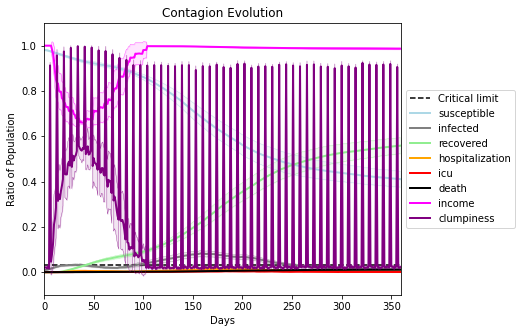

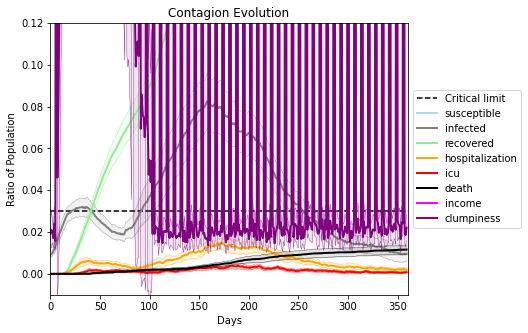

In [36]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.9
params.params['num_communities'] = 100
seeds = [2252]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs=20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],
              work_home_list = 
            
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[2553, 654, 5195, 1317, 6970, 8203, 8675, 8748, 9045, 3647, 8437, 3110, 8850, 7774, 7403, 4007, 5665, 764, 8574, 6629]
Average similarity between family members is 0.43666862797804673 at temperature -0.8
Average similarity between family and home is 0.9998550205669057 at temperature -1
Average similarity between students and their classroom is 0.20072278224626147 at temperature -0.8
Average classroom occupancy is 4.569444444444445 and number classrooms is 72
Average similarity between workers is 0.28323615786374634 at temperature -0.8
Average office occupancy is 3.111111111111111 and number offices is 198
Average friend similarity for adults: 0.48083945352488733 for kids: 0.36607133137954234
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
H

avg restaurant similarity 0.06822371490944647
avg restaurant similarity 0.12912785984121739
avg restaurant similarity 0.018717017020912396
avg restaurant similarity 0.05860690912992359
avg restaurant similarity 0.09997499931331769
avg restaurant similarity 0.07104308596443763
avg restaurant similarity 0.09037921872220402
avg restaurant similarity 0.08190943307754053
avg restaurant similarity 0.06537079496834845
avg restaurant similarity 0.047466664567522986
avg restaurant similarity 0.06670493542083855
avg restaurant similarity 0.05006864818769264
avg restaurant similarity 0.1483970980737007
avg restaurant similarity 0.10204825582062885
avg restaurant similarity 0.10022991219299822
avg restaurant similarity 0.0694434923540476
avg restaurant similarity 0.13420752847058504
avg restaurant similarity 0.09897043477679013
avg restaurant similarity 0.05394606980764624
avg restaurant similarity 0.06576428899634233
avg restaurant similarity 0.020547424387606067
avg restaurant similarity 0.01148

avg restaurant similarity 0.03286087359783485
avg restaurant similarity 0.13325740551200643
avg restaurant similarity 0.06793323637871328
avg restaurant similarity 0.04833954856259417
avg restaurant similarity 0.08122672382989705
avg restaurant similarity 0.03271292744403451
avg restaurant similarity 0.11645074846994935
avg restaurant similarity 0.09837069752777985
avg restaurant similarity 0.10449897966939448
avg restaurant similarity 0.14217247591335086
avg restaurant similarity 0.11149199283657027
avg restaurant similarity 0.03260615859895562
avg restaurant similarity 0.07112171894637162
avg restaurant similarity 0.068407727640384
avg restaurant similarity 0.09498130918376146
avg restaurant similarity 0.0252889008661199
avg restaurant similarity 0.06274581667370814
avg restaurant similarity 0.10939082332917086
avg restaurant similarity 0.13328686898495218
avg restaurant similarity 0.022691505348321907
avg restaurant similarity 0.13558466147973763
avg restaurant similarity 0.07544946

avg restaurant similarity 0.11914178123519498
avg restaurant similarity 0.1030275414552983
avg restaurant similarity 0.13279338501341995
avg restaurant similarity 0.09499385895593221
avg restaurant similarity 0.12624899757748279
avg restaurant similarity 0.11987459891196503
avg restaurant similarity 0.1364768560174074
avg restaurant similarity 0.07660440815889537
avg restaurant similarity 0.11831044964956304
avg restaurant similarity 0.11730502049054027
avg restaurant similarity 0.10355892556449021
avg restaurant similarity 0.11636873841037693
avg restaurant similarity 0.08194595223876573
avg restaurant similarity 0.07544471767990865
avg restaurant similarity 0.05884912048725091
avg restaurant similarity 0.11230931729844543
avg restaurant similarity 0.09355029099050288
avg restaurant similarity 0.12927158463263075
avg restaurant similarity 0.08329997928004067
avg restaurant similarity 0.06891942362907792
avg restaurant similarity 0.06631027061495744
avg restaurant similarity 0.08929363

avg restaurant similarity 0.08177362859115091
avg restaurant similarity 0.04508219256593395
avg restaurant similarity 0.07791387558537102
avg restaurant similarity 0.06036353784286699
avg restaurant similarity 0.05400313565709453
avg restaurant similarity 0.06710677030429751
avg restaurant similarity 0.07288733433060407
avg restaurant similarity 0.07337318707784611
avg restaurant similarity 0.1637568581966158
avg restaurant similarity 0.11740588520389171
avg restaurant similarity 0.018473131493154705
avg restaurant similarity 0.10195919344187757
avg restaurant similarity 0.06748465448463159
avg restaurant similarity 0.07701506545496012
avg restaurant similarity 0.08620688207768207
avg restaurant similarity 0.06865545280021138
avg restaurant similarity 0.050587223296550965
avg restaurant similarity 0.13241539252279275
avg restaurant similarity 0.12800643458243754
avg restaurant similarity 0.14353318631076564
avg restaurant similarity 0.11602686625666311
avg restaurant similarity 0.16203

avg restaurant similarity 0.022519587422205615
avg restaurant similarity 0.03338795072845925
avg restaurant similarity 0.14346882756030788
avg restaurant similarity 0.07638374997079529
avg restaurant similarity 0.05081423330593365
avg restaurant similarity 0.005440423684952698
avg restaurant similarity 0.12596241524477528
avg restaurant similarity 0.12766481023593337
avg restaurant similarity 0.11612689326932986
avg restaurant similarity 0.039084552225443304
avg restaurant similarity 0.09234351714546321
avg restaurant similarity 0.07247660137587562
avg restaurant similarity 0.07404069773206311
avg restaurant similarity 0.15925504253715908
avg restaurant similarity 0.09047979140878064
avg restaurant similarity 0.0637895472023294
avg restaurant similarity 0.08954377948977847
avg restaurant similarity 0.11455975055170341
avg restaurant similarity 0.030631598837343767
avg restaurant similarity 0.1670457824257578
avg restaurant similarity 0.03825644200231669
avg restaurant similarity 0.1433

avg restaurant similarity 0.0980367885116987
avg restaurant similarity 0.06254517253006728
avg restaurant similarity 0.06147312263003816
avg restaurant similarity 0.04252857585583302
avg restaurant similarity -0.012912254168304693
avg restaurant similarity 0.03843424156872554
avg restaurant similarity 0.04761079944885061
avg restaurant similarity 0.06742388007813516
avg restaurant similarity 0.08813399586177607
avg restaurant similarity 0.13932364287099597
avg restaurant similarity 0.08317133394053575
avg restaurant similarity 0.10715337352165608
avg restaurant similarity 0.009519091188122157
avg restaurant similarity -0.0007743165021134218
avg restaurant similarity 0.10398855369158741
avg restaurant similarity 0.1092332140787252
avg restaurant similarity 0.0993320799211245
avg restaurant similarity 0.10308603067408044
avg restaurant similarity 0.027737106371955807
avg restaurant similarity 0.05841133418940764
avg restaurant similarity 0.08294811842123237
avg restaurant similarity 0.13

avg restaurant similarity 0.10166631060621954
avg restaurant similarity 0.08398613989125449
avg restaurant similarity 0.08902484502661162
avg restaurant similarity 0.10939796876500242
avg restaurant similarity 0.06874108495691117
avg restaurant similarity 0.08720151354433696
avg restaurant similarity 0.11299661035035524
avg restaurant similarity 0.052863426002960685
avg restaurant similarity 0.08926455988005473
avg restaurant similarity 0.07420825266658249
avg restaurant similarity 0.04160107205507928
avg restaurant similarity 0.10004721969713766
avg restaurant similarity 0.03278280493424572
avg restaurant similarity 0.11605480330471472
avg restaurant similarity 0.10844821957718098
avg restaurant similarity 0.08252744360529642
avg restaurant similarity 0.09431189937018225
avg restaurant similarity 0.06537468123563978
avg restaurant similarity 0.07397107099243676
avg restaurant similarity 0.0851696734026375
avg restaurant similarity 0.07751692631912176
avg restaurant similarity 0.068554

avg restaurant similarity 0.00972955028504363
avg restaurant similarity 0.10880208117883497
avg restaurant similarity 0.0600575596887005
avg restaurant similarity 0.08311036833161492
avg restaurant similarity 0.10486072798439497
avg restaurant similarity 0.07854611086618832
avg restaurant similarity 0.08456341517251979
avg restaurant similarity 0.13028409691085202
avg restaurant similarity 0.07176785189019247
avg restaurant similarity 0.05907592502844117
avg restaurant similarity 0.09124335467047102
avg restaurant similarity 0.14357602324072344
avg restaurant similarity 0.08475473112869576
avg restaurant similarity 0.13684450286658725
avg restaurant similarity 0.09941385505234888
avg restaurant similarity 0.09447955273398861
avg restaurant similarity 0.07539421887046344
avg restaurant similarity 0.06720502726010304
avg restaurant similarity 0.12151851397405108
avg restaurant similarity 0.08108165662563603
avg restaurant similarity 0.15307065845305065
avg restaurant similarity 0.1420934

avg restaurant similarity 0.0928162351040828
avg restaurant similarity 0.072549081640728
avg restaurant similarity 0.09040962549709045
avg restaurant similarity 0.07842453711277612
avg restaurant similarity 0.053012770700436834
avg restaurant similarity 0.06359853781017336
avg restaurant similarity 0.11600285429657314
avg restaurant similarity 0.03517720921702475
avg restaurant similarity 0.07048504914245636
avg restaurant similarity 0.09878429713695781
avg restaurant similarity 0.13126711415909195
avg restaurant similarity 0.10414186615200031
avg restaurant similarity 0.07717810876895267
avg restaurant similarity 0.0872030923663169
avg restaurant similarity 0.0517785013358605
avg restaurant similarity 0.05117727484796106
avg restaurant similarity 0.08714204342736123
avg restaurant similarity 0.16149726163058323
avg restaurant similarity 0.10743784102226615
avg restaurant similarity 0.1323252957835797
avg restaurant similarity 0.044217491183046805
avg restaurant similarity 0.1377991613

avg restaurant similarity 0.09883826665691242
avg restaurant similarity 0.06393477736146766
avg restaurant similarity 0.10406374023206244
avg restaurant similarity 0.09762955078743304
avg restaurant similarity 0.1469591723403367
avg restaurant similarity 0.07055746493437065
avg restaurant similarity 0.13339656974637215
avg restaurant similarity 0.09813146829243409
avg restaurant similarity 0.04263052467302575
avg restaurant similarity 0.0901806173207481
avg restaurant similarity 0.05908320550054214
avg restaurant similarity 0.057445173462341875
avg restaurant similarity 0.09327436419841245
avg restaurant similarity 0.08478349046821397
avg restaurant similarity 0.10284926918052857
avg restaurant similarity 0.07832992995356196
avg restaurant similarity 0.11515581200643366
avg restaurant similarity 0.0864453852121768
avg restaurant similarity 0.13590975542398862
avg restaurant similarity 0.1041830663479686
avg restaurant similarity 0.04197428202909187
avg restaurant similarity 0.118390879

avg restaurant similarity 0.1738163218203607
avg restaurant similarity 0.11007576736520594
avg restaurant similarity 0.07771354042643502
avg restaurant similarity 0.12160755797631101
avg restaurant similarity 0.06016871273509214
avg restaurant similarity 0.06786558926798858
avg restaurant similarity 0.12517230082770983
avg restaurant similarity 0.118814257422391
avg restaurant similarity 0.12454440445360963
avg restaurant similarity 0.10509226439105172
avg restaurant similarity 0.057892994822564936
avg restaurant similarity 0.12756776032963027
avg restaurant similarity 0.07374620750113214
avg restaurant similarity 0.07217687591291899
avg restaurant similarity 0.09463878655045302
avg restaurant similarity 0.16666402545501946
avg restaurant similarity 0.0986517495134669
avg restaurant similarity 0.1074046318384479
avg restaurant similarity 0.12296586885461128
avg restaurant similarity 0.08712485503690612
avg restaurant similarity 0.0834300982040617
avg restaurant similarity 0.02207456411

avg restaurant similarity 0.07827015103425115
avg restaurant similarity 0.09003048699184159
avg restaurant similarity 0.06384691117715491
avg restaurant similarity 0.10376158786312166
avg restaurant similarity 0.1128616393998085
avg restaurant similarity 0.09065518695530672
avg restaurant similarity 0.05303308924720805
avg restaurant similarity 0.05829429297205078
avg restaurant similarity 0.09317981492167847
avg restaurant similarity 0.056319418556315066
avg restaurant similarity 0.08802873064897042
avg restaurant similarity 0.11617259054729363
avg restaurant similarity 0.1193346881501066
avg restaurant similarity 0.14233959313099565
avg restaurant similarity 0.15534022345978574
avg restaurant similarity 0.11845996326512691
avg restaurant similarity 0.09603149857355547
avg restaurant similarity 0.0918715524636139
avg restaurant similarity 0.08002731241421217
avg restaurant similarity 0.08774591360052973
avg restaurant similarity 0.09251403479455599
avg restaurant similarity 0.08021843

avg restaurant similarity 0.11232520509709788
avg restaurant similarity 0.07745682439409744
avg restaurant similarity 0.11106807145964245
avg restaurant similarity 0.13714159090203115
avg restaurant similarity 0.12672344053154824
avg restaurant similarity 0.09721974610358979
avg restaurant similarity 0.11208273667062772
avg restaurant similarity 0.050002357191060484
avg restaurant similarity 0.10986676679549738
avg restaurant similarity 0.04467841937834725
avg restaurant similarity 0.07464396365788195
avg restaurant similarity 0.057999038197446
avg restaurant similarity 0.09517535850434405
avg restaurant similarity 0.16993155637140922
avg restaurant similarity 0.14675041807925512
avg restaurant similarity 0.11422907363383676
avg restaurant similarity 0.05706768790737948
avg restaurant similarity 0.10046993340262327
avg restaurant similarity 0.14907955431138917
avg restaurant similarity 0.08107119032563012
avg restaurant similarity 0.10410693047944752
avg restaurant similarity 0.1339326

avg restaurant similarity 0.05928600000330495
avg restaurant similarity 0.07143320082385238
avg restaurant similarity 0.1575313827356735
avg restaurant similarity 0.1226918621847412
avg restaurant similarity 0.11513884752554794
avg restaurant similarity 0.1208110611506061
avg restaurant similarity 0.10191718755573463
avg restaurant similarity 0.051932321352996864
avg restaurant similarity 0.08454873996306365
avg restaurant similarity 0.044392923014680244
avg restaurant similarity 0.07098404171091817
avg restaurant similarity 0.08852363100585384
avg restaurant similarity 0.061086757476455054
avg restaurant similarity 0.17004441419150135
avg restaurant similarity 0.16357605861328833
avg restaurant similarity 0.10282034298024395
avg restaurant similarity 0.10185936399924396
avg restaurant similarity 0.11141829910685604
avg restaurant similarity 0.09466997938110336
avg restaurant similarity 0.12579217893537817
avg restaurant similarity 0.10512900568367142
avg restaurant similarity 0.093333

avg restaurant similarity 0.1746570541721586
avg restaurant similarity 0.14675192058607342
avg restaurant similarity 0.06775329470838858
avg restaurant similarity 0.17264789560607943
avg restaurant similarity 0.15374835919391308
avg restaurant similarity 0.07717404343861253
avg restaurant similarity 0.07492686285042044
avg restaurant similarity 0.05720849341326157
avg restaurant similarity 0.16496098844643006
avg restaurant similarity 0.1132559260672397
avg restaurant similarity 0.09276554333802073
avg restaurant similarity 0.04406707453329847
avg restaurant similarity 0.08403132215657737
avg restaurant similarity 0.06064053460334089
avg restaurant similarity 0.1290426906908798
avg restaurant similarity 0.09697438445121634
avg restaurant similarity 0.18743106068855114
avg restaurant similarity 0.0456475952161654
avg restaurant similarity 0.019984447953347438
avg restaurant similarity 0.11436952711874189
avg restaurant similarity 0.09618246662257043
avg restaurant similarity 0.057600807

avg restaurant similarity 0.09611443847718254
avg restaurant similarity 0.08034825098141476
avg restaurant similarity 0.018524847416932277
avg restaurant similarity 0.06321899340048094
avg restaurant similarity 0.10231972920542351
avg restaurant similarity 0.12298081041884878
avg restaurant similarity 0.1492911022262801
avg restaurant similarity 0.08496031339612994
avg restaurant similarity 0.08190446451570749
avg restaurant similarity 0.09689146934899234
avg restaurant similarity 0.11396374642459954
avg restaurant similarity 0.07335385455073426
avg restaurant similarity 0.12624450275441682
avg restaurant similarity 0.08257033627996194
avg restaurant similarity 0.11391020423593635
avg restaurant similarity 0.02365708681466679
avg restaurant similarity 0.10968291899517053
avg restaurant similarity 0.07148616509902349
avg restaurant similarity 0.025470191268566877
avg restaurant similarity 0.07794424211204455
avg restaurant similarity 0.13096050230425715
avg restaurant similarity 0.03571

avg restaurant similarity 0.10509266864388177
avg restaurant similarity 0.055660478739841424
avg restaurant similarity 0.06689989735919687
avg restaurant similarity 0.11571774279149769
avg restaurant similarity 0.07303661397428048
avg restaurant similarity 0.07547548645895712
avg restaurant similarity 0.0802355632204779
avg restaurant similarity 0.10488540951150943
avg restaurant similarity 0.026236431692131575
avg restaurant similarity 0.16388640792610448
avg restaurant similarity -0.0030076040704629563
avg restaurant similarity 0.10278071972016789
avg restaurant similarity 0.13850884699519883
avg restaurant similarity 0.057490065399377
avg restaurant similarity 0.15116254973959456
avg restaurant similarity 0.1599739809185511
avg restaurant similarity -0.015421501966892046
avg restaurant similarity 0.10097895178546182
avg restaurant similarity 0.062844813214964
avg restaurant similarity 0.15742525988297348
avg restaurant similarity 0.003716435134516917
avg restaurant similarity 0.0269

avg restaurant similarity 0.07914330795123184
avg restaurant similarity 0.058301616268916875
avg restaurant similarity 0.057100289979145985
avg restaurant similarity 0.07075320527387845
avg restaurant similarity 0.026059047125882882
avg restaurant similarity 0.028369685804621608
avg restaurant similarity 0.03938310427146114
avg restaurant similarity 0.052747126742501795
avg restaurant similarity 0.06335106860033715
avg restaurant similarity 0.05427771295574697
avg restaurant similarity 0.07086214038130191
avg restaurant similarity 0.06111941742717455
avg restaurant similarity 0.06498128994556156
avg restaurant similarity 0.04505603210174769
avg restaurant similarity 0.029567359817095518
avg restaurant similarity 0.06880928397815754
avg restaurant similarity -0.013577645829964327
avg restaurant similarity 0.05131377883617919
avg restaurant similarity 0.1100752899927861
avg restaurant similarity 0.053362316360079286
avg restaurant similarity 0.05629000508194898
avg restaurant similarity 

avg restaurant similarity 0.09989335210294029
avg restaurant similarity 0.03115371799709691
avg restaurant similarity 0.1616790256924776
avg restaurant similarity 0.10973081817470486
avg restaurant similarity 0.07061942665062787
avg restaurant similarity 0.08163175824672736
avg restaurant similarity 0.092998467536196
avg restaurant similarity 0.10084422191636576
avg restaurant similarity 0.11962753417246069
avg restaurant similarity 0.0321377621379783
avg restaurant similarity 0.0656676328620867
avg restaurant similarity 0.1463060105556374
avg restaurant similarity 0.07477104056625554
avg restaurant similarity 0.09663710933508488
avg restaurant similarity 0.08414928344825125
avg restaurant similarity 0.05833604884183744
avg restaurant similarity 0.11713151614505202
avg restaurant similarity 0.044191692793163755
avg restaurant similarity 0.1005521285945568
avg restaurant similarity 0.11268286788554742
avg restaurant similarity 0.15312953157852124
avg restaurant similarity 0.098968454780

avg restaurant similarity 0.02095446758651002
avg restaurant similarity 0.08446941237392218
avg restaurant similarity 0.12077895171827542
avg restaurant similarity 0.0996735077216767
avg restaurant similarity 0.0788215760704567
avg restaurant similarity 0.10772236070651367
avg restaurant similarity 0.06670278670778138
avg restaurant similarity 0.08594563041268441
avg restaurant similarity 0.09386434666029371
avg restaurant similarity 0.07212931738009304
avg restaurant similarity 0.08649215828587653
avg restaurant similarity 0.13354824105660476
avg restaurant similarity 0.1279400407635121
avg restaurant similarity 0.04707548533547835
avg restaurant similarity 0.1278831472242644
avg restaurant similarity 0.1255714847861826
avg restaurant similarity 0.1088020902388908
avg restaurant similarity 0.06961823486379021
avg restaurant similarity 0.06406945738966537
avg restaurant similarity 0.11365200185410958
avg restaurant similarity 0.1118264048701639
avg restaurant similarity 0.0746559240148

avg restaurant similarity 0.11107872002616113
avg restaurant similarity 0.11847691020264364
avg restaurant similarity 0.11579261017780783
avg restaurant similarity 0.10139360233215015
avg restaurant similarity 0.15750287251194015
avg restaurant similarity 0.05734373464541084
avg restaurant similarity 0.15078897087591303
avg restaurant similarity 0.07590007909238829
avg restaurant similarity 0.1016305184629668
avg restaurant similarity 0.11660125770707848
avg restaurant similarity 0.16180454898141466
avg restaurant similarity 0.04956787891448293
avg restaurant similarity 0.08504912629914552
avg restaurant similarity 0.0898922124484504
avg restaurant similarity 0.13904362261214914
avg restaurant similarity 0.09403786097211196
avg restaurant similarity 0.07029273373660254
avg restaurant similarity 0.11964598702865205
avg restaurant similarity 0.08041539669153
avg restaurant similarity 0.14245412733084478
avg restaurant similarity 0.16841555699996638
avg restaurant similarity 0.11271375934

avg restaurant similarity 0.07745979821967508
avg restaurant similarity 0.1106572643147884
avg restaurant similarity 0.06766587075256905
avg restaurant similarity 0.13807070757326564
avg restaurant similarity 0.07817141166215306
avg restaurant similarity 0.11856576198094104
avg restaurant similarity 0.10865068581562777
avg restaurant similarity 0.14218442488859748
avg restaurant similarity 0.11034661724014182
avg restaurant similarity 0.1220667707304328
avg restaurant similarity 0.05240003258352912
avg restaurant similarity 0.06357916021156446
avg restaurant similarity 0.09282567898922724
avg restaurant similarity 0.13387431543917416
avg restaurant similarity 0.1325266776817938
avg restaurant similarity 0.12397021767571967
avg restaurant similarity 0.10676089074198065
avg restaurant similarity 0.10452027800878527
avg restaurant similarity 0.0849182960237448
avg restaurant similarity 0.1173311376212502
avg restaurant similarity 0.11013991360697668
avg restaurant similarity 0.15013422585

avg restaurant similarity 0.06880081682266785
avg restaurant similarity 0.08430414693837979
avg restaurant similarity 0.06618206520237876
avg restaurant similarity 0.04830104727111985
avg restaurant similarity 0.12248081402070411
avg restaurant similarity 0.06160136410282752
avg restaurant similarity 0.07468842647232718
avg restaurant similarity 0.08639394579504485
avg restaurant similarity 0.11597540469718223
avg restaurant similarity 0.12043711065128018
avg restaurant similarity 0.06562324514021202
avg restaurant similarity 0.06283062494980791
avg restaurant similarity 0.054604082921458554
avg restaurant similarity 0.02090531815983805
avg restaurant similarity 0.12715424868231914
avg restaurant similarity 0.07721014657003439
avg restaurant similarity 0.11997830540509487
avg restaurant similarity 0.09174327784032446
avg restaurant similarity 0.0852523193586602
avg restaurant similarity 0.06390784050194973
avg restaurant similarity 0.050361614860864184
avg restaurant similarity 0.08596

avg restaurant similarity 0.09835862528411699
avg restaurant similarity 0.1017191250809857
avg restaurant similarity 0.05156498073095014
avg restaurant similarity 0.0005329367325505266
avg restaurant similarity 0.09487030981591948
avg restaurant similarity 0.07786083077636012
avg restaurant similarity 0.09620410391642657
avg restaurant similarity 0.15296039988217797
avg restaurant similarity 0.011087757565614179
avg restaurant similarity 0.11691412330065486
avg restaurant similarity 0.08612644157781428
avg restaurant similarity 0.12525801053067961
avg restaurant similarity 0.060234422211181166
avg restaurant similarity 0.03485143884294192
avg restaurant similarity 0.12671786743062563
avg restaurant similarity 0.10577614478261521
avg restaurant similarity 0.16008672273694818
avg restaurant similarity 0.05650364442647056
avg restaurant similarity 0.0658150499457462
avg restaurant similarity 0.10714210377559587
avg restaurant similarity 0.16371830311514723
avg restaurant similarity 0.1122

avg restaurant similarity 0.0652362683567542
avg restaurant similarity -0.008933435843723879
avg restaurant similarity 0.10697699476848778
avg restaurant similarity 0.07492239347260433
avg restaurant similarity 0.07493485552135724
avg restaurant similarity 0.07175819518830857
avg restaurant similarity 0.044344271653480476
avg restaurant similarity 0.045031521486455485
avg restaurant similarity 0.0646685347746139
avg restaurant similarity 0.06632045171415168
avg restaurant similarity 0.06331877983713698
avg restaurant similarity 0.09925523380708628
avg restaurant similarity 0.030626228768264322
avg restaurant similarity 0.06124850426478288
avg restaurant similarity 0.06867905261645044
avg restaurant similarity 0.06856667002270504
avg restaurant similarity 0.0929622780704038
avg restaurant similarity 0.051571010366184375
avg restaurant similarity 0.047005642779371574
avg restaurant similarity 0.07993737633539075
avg restaurant similarity 0.0727299155635416
avg restaurant similarity 0.067

avg restaurant similarity 0.10299196348753922
avg restaurant similarity 0.08611836741157868
avg restaurant similarity 0.11436075132541827
avg restaurant similarity 0.08833163618195486
avg restaurant similarity 0.02337518075628576
avg restaurant similarity 0.06244846639552803
avg restaurant similarity 0.03261712882521596
avg restaurant similarity 0.08580619504323812
avg restaurant similarity 0.06981363866052466
avg restaurant similarity 0.07481651006108564
avg restaurant similarity 0.11635302723435682
avg restaurant similarity 0.11083925628177259
avg restaurant similarity 0.11572958170665748
avg restaurant similarity 0.08336223404008351
avg restaurant similarity 0.04840647575587634
avg restaurant similarity 0.11587776147076483
avg restaurant similarity 0.04986110657950132
avg restaurant similarity 0.09034226916700132
avg restaurant similarity 0.07424514731115849
avg restaurant similarity 0.052571764170745154
avg restaurant similarity 0.13544582121351625
avg restaurant similarity 0.10178

avg restaurant similarity 0.06175618076021744
avg restaurant similarity 0.05673103367692028
avg restaurant similarity 0.10147868164050848
avg restaurant similarity 0.06287592178795745
avg restaurant similarity 0.08166153842458153
avg restaurant similarity 0.07542828744266943
avg restaurant similarity 0.11311337720755778
avg restaurant similarity 0.06290437892557386
avg restaurant similarity 0.05787999095867349
avg restaurant similarity 0.07626188488554081
avg restaurant similarity 0.09496854924978664
avg restaurant similarity 0.08116937110891786
avg restaurant similarity 0.11480491159276776
avg restaurant similarity 0.16916145940892446
avg restaurant similarity 0.08434048956770389
avg restaurant similarity 0.10393375685922225
avg restaurant similarity 0.11842324233754697
avg restaurant similarity 0.0038553868908468127
avg restaurant similarity 0.09690559535110177
avg restaurant similarity 0.10372813032308861
avg restaurant similarity 0.07963819341899496
avg restaurant similarity 0.0682

avg restaurant similarity 0.03835518198554456
avg restaurant similarity 0.09475213084348141
avg restaurant similarity 0.10830148320764574
avg restaurant similarity 0.1379695584401918
avg restaurant similarity 0.10214796777761666
avg restaurant similarity 0.06167525500809875
avg restaurant similarity 0.15165865532196726
avg restaurant similarity 0.1250454373208881
avg restaurant similarity 0.07180953656293361
avg restaurant similarity 0.110375919134011
avg restaurant similarity 0.08816660406283486
avg restaurant similarity 0.10194575013266584
avg restaurant similarity 0.07052831738404175
avg restaurant similarity 0.1283387345742285
avg restaurant similarity 0.07826612678173492
avg restaurant similarity 0.1202438228321056
avg restaurant similarity 0.09326055641211352
avg restaurant similarity 0.0794101896307764
avg restaurant similarity 0.09593931307503421
avg restaurant similarity 0.08233621773093402
avg restaurant similarity 0.06235115463976597
avg restaurant similarity 0.0783659620531

avg restaurant similarity 0.04640209029770249
avg restaurant similarity 0.03927197663231225
avg restaurant similarity 0.08298367862474632
avg restaurant similarity 0.01567248409834061
avg restaurant similarity 0.13788926152008707
avg restaurant similarity 0.10397807628090985
avg restaurant similarity 0.035821403495328294
avg restaurant similarity 0.06503346579083502
avg restaurant similarity 0.09035285913692603
avg restaurant similarity 0.0735738432457149
avg restaurant similarity 0.015425170504650997
avg restaurant similarity 0.06865044550777091
avg restaurant similarity 0.055424935600474304
avg restaurant similarity 0.034530504422338036
avg restaurant similarity 0.08312002750279665
avg restaurant similarity 0.09296267812973551
avg restaurant similarity 0.04668134679406091
avg restaurant similarity 0.05435346011709074
avg restaurant similarity 0.061743781449077245
avg restaurant similarity 0.05873407036561902
avg restaurant similarity 0.03957466553660876
avg restaurant similarity 0.06

avg restaurant similarity 0.061520063578339376
avg restaurant similarity 0.08547931610201649
avg restaurant similarity 0.12262237241175732
avg restaurant similarity 0.058163648227529965
avg restaurant similarity 0.06392180168360803
avg restaurant similarity 0.04814896005289173
avg restaurant similarity -0.015518365541872742
avg restaurant similarity 0.03329145118064884
avg restaurant similarity 0.09639921243684915
avg restaurant similarity 0.06937889770795458
avg restaurant similarity 0.07444656045504452
avg restaurant similarity 0.045760488871486794
avg restaurant similarity 0.031218988492207268
avg restaurant similarity 0.1324937901554153
avg restaurant similarity 0.09691205401843431
avg restaurant similarity 0.0034663312904222865
avg restaurant similarity 0.02780087548656266
avg restaurant similarity 0.05477908368856839
avg restaurant similarity 0.07001110181345135
avg restaurant similarity 0.047150607149999524
avg restaurant similarity 0.12282658237014721
avg restaurant similarity 

avg restaurant similarity 0.0924265525438569
avg restaurant similarity 0.07996198496500993
avg restaurant similarity 0.10072218596157868
avg restaurant similarity 0.0492745356927464
avg restaurant similarity 0.06078688694088073
avg restaurant similarity 0.04818652783975976
avg restaurant similarity 0.0633362003486411
avg restaurant similarity 0.10740560307902824
avg restaurant similarity 0.029715387600997425
avg restaurant similarity 0.08249932182130562
avg restaurant similarity 0.0030899193983074938
avg restaurant similarity 0.05100181938846107
avg restaurant similarity 0.04164130307697931
avg restaurant similarity 0.043610731683228814
avg restaurant similarity 0.040572706810109
avg restaurant similarity 0.10838053072632473
avg restaurant similarity 0.06589110645189318
avg restaurant similarity 0.0421381711265224
avg restaurant similarity 0.08523771102304818
avg restaurant similarity 0.06014929778723071
avg restaurant similarity 0.07938109092919098
avg restaurant similarity 0.09291152

avg restaurant similarity 0.030320563467597404
avg restaurant similarity 0.1014547946751082
avg restaurant similarity 0.08158339853712568
avg restaurant similarity 0.11088476690451138
avg restaurant similarity 0.09512434202425817
avg restaurant similarity 0.06822596672170748
avg restaurant similarity 0.04425923476439739
avg restaurant similarity 0.05184766146364822
avg restaurant similarity 0.09129409862335125
avg restaurant similarity 0.07512555744157796
avg restaurant similarity 0.04979489346602478
avg restaurant similarity 0.06545997624930032
avg restaurant similarity 0.03604575448408057
avg restaurant similarity 0.10598757853865852
avg restaurant similarity 0.040583706234498154
avg restaurant similarity 0.1072692505018496
avg restaurant similarity 0.029512338893624566
avg restaurant similarity 0.07388626290779857
avg restaurant similarity 0.1352358378799525
avg restaurant similarity 0.0362207398123078
avg restaurant similarity 0.08508561813129613
avg restaurant similarity 0.0482331

avg restaurant similarity 0.1071450949629264
avg restaurant similarity 0.059263542773054144
avg restaurant similarity 0.07361877487944017
avg restaurant similarity 0.05937640160510613
avg restaurant similarity 0.102095138095061
avg restaurant similarity 0.04679018052562846
avg restaurant similarity 0.14968259647792218
avg restaurant similarity 0.08475945806843287
avg restaurant similarity 0.04601149316803239
avg restaurant similarity 0.14812431236758916
avg restaurant similarity 0.07394320166007243
avg restaurant similarity 0.07759391337337819
avg restaurant similarity 0.09075946369644466
avg restaurant similarity 0.02020760110732617
avg restaurant similarity 0.05382345898720855
avg restaurant similarity 0.12211935561108248
avg restaurant similarity 0.05492745258401457
avg restaurant similarity 0.1040644432405199
avg restaurant similarity 0.03815941231636887
avg restaurant similarity 0.11747889019738447
avg restaurant similarity 0.055758087637728056
avg restaurant similarity 0.15215641

avg restaurant similarity 0.05001920650050662
avg restaurant similarity 0.04211998927824169
avg restaurant similarity 0.10135817745726772
avg restaurant similarity 0.10107060584263315
avg restaurant similarity 0.12965629261425687
avg restaurant similarity 0.08646164691412643
avg restaurant similarity 0.1402244606900732
avg restaurant similarity 0.0729694978965825
avg restaurant similarity 0.06511009889899558
avg restaurant similarity 0.07625869053671049
avg restaurant similarity 0.06824613001092084
avg restaurant similarity 0.09082710626595258
avg restaurant similarity 0.07016407577121136
avg restaurant similarity 0.08871089787506345
avg restaurant similarity 0.09803921184659335
avg restaurant similarity 0.015787330967241463
avg restaurant similarity 0.0999183788614624
avg restaurant similarity 0.07375571310616871
avg restaurant similarity 0.10167289381568556
avg restaurant similarity 0.04055831151817183
avg restaurant similarity 0.07397633190679538
avg restaurant similarity 0.05960813

avg restaurant similarity 0.05218658229171259
avg restaurant similarity 0.04531078321401478
avg restaurant similarity 0.06477210375367681
avg restaurant similarity 0.06012483990414129
avg restaurant similarity 0.0785954553414374
avg restaurant similarity 0.09508211352784937
avg restaurant similarity 0.0697683015126658
avg restaurant similarity 0.0674972428448581
avg restaurant similarity 0.05710341010849059
avg restaurant similarity 0.07785414426792642
avg restaurant similarity 0.037131734600477403
avg restaurant similarity 0.07490975292281733
avg restaurant similarity 0.029370719636457356
avg restaurant similarity 0.07714360321008841
avg restaurant similarity 0.056214224413817473
avg restaurant similarity 0.05816684680662413
avg restaurant similarity 0.08306885935218535
avg restaurant similarity 0.07927180067954087
avg restaurant similarity 0.04787359644677647
avg restaurant similarity 0.054089680922064905
avg restaurant similarity 0.06260439120415831
avg restaurant similarity 0.06790

avg restaurant similarity 0.13983462902044316
avg restaurant similarity 0.03705349252590672
avg restaurant similarity 0.0706994644036852
avg restaurant similarity 0.14153028305182594
avg restaurant similarity 0.09564982020562862
avg restaurant similarity 0.029983877251514038
avg restaurant similarity 0.08898262755334062
avg restaurant similarity 0.07912050651342273
avg restaurant similarity 0.017462500304088302
avg restaurant similarity 0.010324686133718333
avg restaurant similarity 0.12591275891956624
avg restaurant similarity 0.07637955993430545
avg restaurant similarity 0.07950102978745455
avg restaurant similarity 0.05269317431686497
avg restaurant similarity 0.037396959510414364
avg restaurant similarity 0.13142145482272752
avg restaurant similarity 0.07938137981080132
avg restaurant similarity 0.11919858096492403
avg restaurant similarity 0.09400298102626858
avg restaurant similarity 0.12104069186501275
avg restaurant similarity 0.06041872543708895
avg restaurant similarity 0.081

avg restaurant similarity 0.13129324519358243
avg restaurant similarity 0.0601372117405047
avg restaurant similarity 0.06649070086411896
avg restaurant similarity 0.0849480607565594
avg restaurant similarity 0.12652678215300875
avg restaurant similarity 0.0647264408403797
avg restaurant similarity 0.08969793614252518
avg restaurant similarity 0.07607368896599442
avg restaurant similarity 0.09645123590357592
avg restaurant similarity 0.08734410525740365
avg restaurant similarity 0.10131528374545923
avg restaurant similarity 0.10744323856497011
avg restaurant similarity 0.11391504201332152
avg restaurant similarity 0.09366996766274305
avg restaurant similarity 0.06750921618571393
avg restaurant similarity 0.16566589160260814
avg restaurant similarity 0.12954624427286326
avg restaurant similarity 0.10263792084400415
avg restaurant similarity 0.04411169946191109
avg restaurant similarity 0.03886742582598213
avg restaurant similarity 0.09683518294550389
avg restaurant similarity 0.164682059

avg restaurant similarity 0.03404141549896753
avg restaurant similarity 0.037550564126546865
avg restaurant similarity 0.008133169682558098
avg restaurant similarity 0.03223273367182428
avg restaurant similarity 0.09549990203526328
avg restaurant similarity 0.07041684792514082
avg restaurant similarity 0.11114548890017872
avg restaurant similarity 0.12922635644712094
avg restaurant similarity 0.04508002578856356
avg restaurant similarity 0.12202358747378961
avg restaurant similarity 0.08630028334613384
avg restaurant similarity 0.00899712130552023
avg restaurant similarity 0.024643649674812196
avg restaurant similarity 0.03741413681546467
avg restaurant similarity 0.09625819985844761
avg restaurant similarity 0.14820834883554332
avg restaurant similarity 0.11089802249022528
avg restaurant similarity 0.07860453020046762
avg restaurant similarity 0.09688681052771579
avg restaurant similarity 0.10662716307684687
avg restaurant similarity 0.13212440762927677
avg restaurant similarity 0.098

avg restaurant similarity 0.01779666053693196
avg restaurant similarity 0.09522309221067732
avg restaurant similarity 0.06581098175057086
avg restaurant similarity 0.0823124118347988
avg restaurant similarity 0.11067599482667824
avg restaurant similarity 0.04967048950974767
avg restaurant similarity 0.06967702529432883
avg restaurant similarity 0.10724953715286824
avg restaurant similarity 0.08046013462355413
avg restaurant similarity 0.1036138901720842
avg restaurant similarity 0.10941737513789954
avg restaurant similarity 0.09436706157422622
avg restaurant similarity 0.05650251213129477
avg restaurant similarity 0.09223037172343303
avg restaurant similarity 0.06097403794285185
avg restaurant similarity 0.10875473467848128
avg restaurant similarity 0.07986487897244314
avg restaurant similarity 0.08562954243293928
avg restaurant similarity 0.07736479246952821
avg restaurant similarity 0.12757480341261165
avg restaurant similarity 0.0664484154261431
avg restaurant similarity 0.074517244

avg restaurant similarity 0.06689130755670321
avg restaurant similarity 0.105888599060804
avg restaurant similarity 0.1367774118281357
avg restaurant similarity 0.10671542007028421
avg restaurant similarity 0.06505619809907408
avg restaurant similarity 0.11340982197920534
avg restaurant similarity 0.06344320554108902
avg restaurant similarity 0.09778778530851136
avg restaurant similarity 0.07908821303329566
avg restaurant similarity 0.05465059275166532
avg restaurant similarity 0.10455362008939637
avg restaurant similarity 0.09848559677574141
avg restaurant similarity 0.1207200882659399
avg restaurant similarity 0.10734468315511757
avg restaurant similarity 0.07987914436069264
avg restaurant similarity 0.09469989064032125
avg restaurant similarity 0.06837309632377354
avg restaurant similarity 0.0933883440575239
avg restaurant similarity 0.06382311909173982
avg restaurant similarity 0.11349071918774158
avg restaurant similarity 0.096748446554815
avg restaurant similarity 0.0670595133650

(<function dict.items>, <function dict.items>, <function dict.items>)

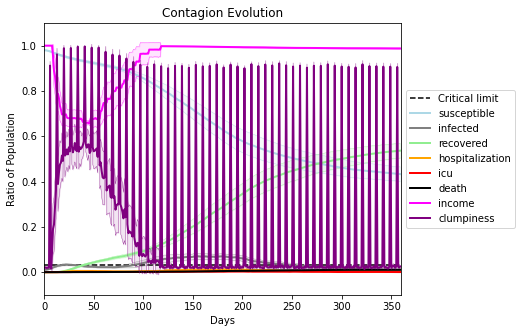

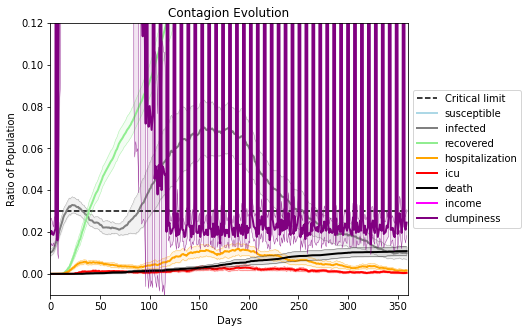

In [37]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.8
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[4155, 8698, 9163, 8254, 6380, 3481, 8787, 2153, 7257, 332, 6324, 7715, 6215, 9995, 3973, 5740, 9265, 5262, 6387, 9829]
Average similarity between family members is 0.3481411347258993 at temperature -0.7
Average similarity between family and home is 0.999865468741508 at temperature -1
Average similarity between students and their classroom is 0.1305253264481234 at temperature -0.7
Average classroom occupancy is 4.159420289855072 and number classrooms is 69
Average similarity between workers is 0.17375902795841305 at temperature -0.7
Average office occupancy is 3.218905472636816 and number offices is 201
Average friend similarity for adults: 0.43299931491178395 for kids: 0.28056510528931494
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
H

avg restaurant similarity 0.096846712354898
avg restaurant similarity 0.0615943958558215
avg restaurant similarity 0.06431556104883777
avg restaurant similarity 0.0656284648926657
avg restaurant similarity 0.06303401790570488
avg restaurant similarity 0.09044192201561094
avg restaurant similarity 0.0806714254566345
avg restaurant similarity 0.07629900376459237
avg restaurant similarity 0.11176109143187038
avg restaurant similarity 0.07317977599267231
avg restaurant similarity 0.011904945004223197
avg restaurant similarity 0.09395437213509633
avg restaurant similarity 0.09021273445482154
avg restaurant similarity 0.11981338879047243
avg restaurant similarity 0.08367197690552157
avg restaurant similarity 0.07276105366243792
avg restaurant similarity 0.08564620995892476
avg restaurant similarity 0.05545087255569913
avg restaurant similarity 0.13982725994838865
avg restaurant similarity 0.07634568404538386
avg restaurant similarity 0.0992846996467123
avg restaurant similarity 0.04961541481

avg restaurant similarity 0.10061042162068204
avg restaurant similarity 0.07536132162020785
avg restaurant similarity 0.08165625602772435
avg restaurant similarity 0.08029952047509366
avg restaurant similarity 0.10005019838054333
avg restaurant similarity 0.10417797667117688
avg restaurant similarity 0.08476531468611681
avg restaurant similarity 0.10475816673257354
avg restaurant similarity 0.06531933220647573
avg restaurant similarity 0.09289441433769086
avg restaurant similarity 0.10952854134765797
avg restaurant similarity 0.05508410769850923
avg restaurant similarity 0.03838813380686385
avg restaurant similarity 0.09963762056808087
avg restaurant similarity 0.04657492128296223
avg restaurant similarity 0.08563492164643037
avg restaurant similarity 0.15800992123830737
avg restaurant similarity 0.06146224778029987
avg restaurant similarity 0.09242354555080921
avg restaurant similarity 0.07239918459526375
avg restaurant similarity 0.03780961129130253
avg restaurant similarity 0.050476

avg restaurant similarity 0.12656681325849867
avg restaurant similarity 0.050591196570847374
avg restaurant similarity 0.08312164325062746
avg restaurant similarity 0.07563935806910378
avg restaurant similarity 0.06250453161922165
avg restaurant similarity 0.11678459596342447
avg restaurant similarity 0.04865775567693199
avg restaurant similarity 0.09803494365757176
avg restaurant similarity 0.13785219361416085
avg restaurant similarity 0.08719344117831172
avg restaurant similarity 0.0960355337028966
avg restaurant similarity 0.12141024674010431
avg restaurant similarity 0.02996905227438114
avg restaurant similarity 0.021256179778938504
avg restaurant similarity 0.07563625714475573
avg restaurant similarity 0.07019400815961524
avg restaurant similarity 0.05498125568626394
avg restaurant similarity 0.09918436035898377
avg restaurant similarity 0.09076525882495691
avg restaurant similarity 0.07604752145279287
avg restaurant similarity 0.15753657511076308
avg restaurant similarity 0.12602

avg restaurant similarity 0.06811704578599768
avg restaurant similarity 0.06299459676477333
avg restaurant similarity 0.07766411076614133
avg restaurant similarity 0.04184655534219706
avg restaurant similarity 0.09321686535112735
avg restaurant similarity 0.03152545147771341
avg restaurant similarity 0.15716612369626115
avg restaurant similarity 0.0718021193528249
avg restaurant similarity 0.09907641452390256
avg restaurant similarity 0.12059747429356156
avg restaurant similarity 0.14406404657600896
avg restaurant similarity 0.04497603375900898
avg restaurant similarity 0.09854387743235772
avg restaurant similarity 0.12852248685031972
avg restaurant similarity 0.12293495501189884
avg restaurant similarity 0.1016823140116214
avg restaurant similarity 0.09152197584907978
avg restaurant similarity 0.07681201127899119
avg restaurant similarity 0.08901399139798384
avg restaurant similarity 0.09540182914886698
avg restaurant similarity 0.10367183202403697
avg restaurant similarity 0.04293221

avg restaurant similarity 0.07692633344240239
avg restaurant similarity 0.06619791058081952
avg restaurant similarity 0.10184099613206508
avg restaurant similarity 0.08729206588707472
avg restaurant similarity 0.053492477760310596
avg restaurant similarity 0.11080754447993983
avg restaurant similarity 0.052046865849953286
avg restaurant similarity 0.09400813578502458
avg restaurant similarity 0.12538529396976397
avg restaurant similarity 0.11763805876923572
avg restaurant similarity 0.09000242981711502
avg restaurant similarity 0.12550934961734442
avg restaurant similarity 0.07495076304208435
avg restaurant similarity 0.04722628968877567
avg restaurant similarity 0.11939879907141103
avg restaurant similarity 0.047042499335754946
avg restaurant similarity 0.08010989666093331
avg restaurant similarity 0.09102563923984451
avg restaurant similarity 0.09796197118025782
avg restaurant similarity 0.014113042550645124
avg restaurant similarity 0.07400320559711247
avg restaurant similarity 0.12

avg restaurant similarity 0.08127708684396832
avg restaurant similarity 0.061637843992767914
avg restaurant similarity 0.16026860838341822
avg restaurant similarity 0.11426986201518663
avg restaurant similarity 0.040802773048995405
avg restaurant similarity 0.10770187704299297
avg restaurant similarity 0.06687024350464621
avg restaurant similarity 0.09498963170309134
avg restaurant similarity 0.0868346327934899
avg restaurant similarity 0.018159508689940554
avg restaurant similarity 0.09024083373106287
avg restaurant similarity 0.041278908142971714
avg restaurant similarity 0.07238037459404693
avg restaurant similarity 0.10866433198992312
avg restaurant similarity 0.11692647276967646
avg restaurant similarity 0.07980677801976756
avg restaurant similarity 0.08432089055772274
avg restaurant similarity 0.11145736029110447
avg restaurant similarity 0.11385246097382716
avg restaurant similarity 0.10318451614327505
avg restaurant similarity 0.09260687318377604
avg restaurant similarity 0.045

avg restaurant similarity 0.09453414928862601
avg restaurant similarity 0.009234601484585173
avg restaurant similarity 0.04789220632017544
avg restaurant similarity 0.0075948380658486785
avg restaurant similarity 0.010521071845586651
avg restaurant similarity 0.057026995108707144
avg restaurant similarity 0.019620553452039873
avg restaurant similarity 0.03931770645312414
avg restaurant similarity 0.06048959336089996
avg restaurant similarity 0.06641331965972912
avg restaurant similarity 0.07858110286499892
avg restaurant similarity 0.0424851049287223
avg restaurant similarity 0.07804084782624032
avg restaurant similarity -0.01776574006231201
avg restaurant similarity 0.06965439429952507
avg restaurant similarity 0.05076264407685305
avg restaurant similarity 0.07055974101705682
avg restaurant similarity 0.1436206460781016
avg restaurant similarity 0.03286444141630508
avg restaurant similarity 0.04552590227861228
avg restaurant similarity 0.0253144023878861
avg restaurant similarity 0.09

avg restaurant similarity 0.024156916671483463
avg restaurant similarity 0.007102343262588661
avg restaurant similarity 0.0174465477417564
avg restaurant similarity 0.002122790875791971
avg restaurant similarity 0.06354543571895369
avg restaurant similarity -0.008398043819415007
avg restaurant similarity 0.08526000886133385
avg restaurant similarity 0.053511126463176205
avg restaurant similarity -0.0005702165339287843
avg restaurant similarity 0.05205382308006526
avg restaurant similarity 0.02329649618295549
avg restaurant similarity 0.13735711488223104
avg restaurant similarity 0.0828815085647132
avg restaurant similarity 0.08414886970518971
avg restaurant similarity 0.06808206996743126
avg restaurant similarity 0.07405807144987636
avg restaurant similarity 0.031650560084892414
avg restaurant similarity 0.05573991790831473
avg restaurant similarity 0.050842837115434275
avg restaurant similarity 0.06353666187190429
avg restaurant similarity 0.07324948375847519
avg restaurant similarity

avg restaurant similarity 0.15546546226841193
avg restaurant similarity 0.12659768477027297
avg restaurant similarity 0.11919572403029306
avg restaurant similarity 0.1337231818015073
avg restaurant similarity 0.10878528994539688
avg restaurant similarity 0.07089145872545295
avg restaurant similarity 0.09281687865532268
avg restaurant similarity 0.11154344126565537
avg restaurant similarity 0.07895842923838708
avg restaurant similarity 0.13414476220344174
avg restaurant similarity 0.12815644299572612
avg restaurant similarity 0.038392171964760524
avg restaurant similarity 0.09596579089472508
avg restaurant similarity 0.06786504186551788
avg restaurant similarity 0.047275012129168216
avg restaurant similarity 0.07133922269365503
avg restaurant similarity 0.021588093585532125
avg restaurant similarity 0.04362991542659252
avg restaurant similarity 0.16861914080717177
avg restaurant similarity 0.139590175266997
avg restaurant similarity 0.10641112989473517
avg restaurant similarity 0.108316

avg restaurant similarity 0.05762365745959909
avg restaurant similarity 0.061329803434395605
avg restaurant similarity 0.17176655761645274
avg restaurant similarity 0.14915974347508482
avg restaurant similarity 0.14297281235444878
avg restaurant similarity 0.0640872211821012
avg restaurant similarity 0.06280306602809718
avg restaurant similarity 0.0908026390072184
avg restaurant similarity 0.1136212782256111
avg restaurant similarity 0.11038391370293428
avg restaurant similarity 0.13895774022399351
avg restaurant similarity 0.07837305003552894
avg restaurant similarity 0.08163868343890221
avg restaurant similarity 0.10670337561185977
avg restaurant similarity 0.10284561363489138
avg restaurant similarity 0.1767701877240538
avg restaurant similarity 0.0683794390808794
avg restaurant similarity 0.12704300132654586
avg restaurant similarity 0.09242197487309158
avg restaurant similarity 0.1366603997385101
avg restaurant similarity 0.12352730146833305
avg restaurant similarity 0.06175401397

avg restaurant similarity 0.068810849423772
avg restaurant similarity 0.08218940587475582
avg restaurant similarity 0.05576088024611318
avg restaurant similarity 0.1118143414903911
avg restaurant similarity 0.09526781962518581
avg restaurant similarity 0.10960896438275296
avg restaurant similarity 0.03523888959795117
avg restaurant similarity 0.0621830162806644
avg restaurant similarity 0.06638591366968741
avg restaurant similarity 0.0904139576063572
avg restaurant similarity 0.12738014719099097
avg restaurant similarity 0.11482953166143081
avg restaurant similarity 0.08396100734948143
avg restaurant similarity 0.11764394149274655
avg restaurant similarity 0.11609564404612933
avg restaurant similarity 0.12344703168363183
avg restaurant similarity 0.06946703719314616
avg restaurant similarity 0.10043341584199236
avg restaurant similarity 0.06545460014106126
avg restaurant similarity 0.06915386372023195
avg restaurant similarity 0.09331735580738902
avg restaurant similarity 0.11667937575

avg restaurant similarity 0.13376528068476431
avg restaurant similarity 0.07928023978538926
avg restaurant similarity 0.14188803056187024
avg restaurant similarity 0.039707162366068964
avg restaurant similarity 0.08720405828107619
avg restaurant similarity 0.133144059327119
avg restaurant similarity 0.14871310033815213
avg restaurant similarity 0.12436310051220235
avg restaurant similarity 0.11393871849387037
avg restaurant similarity 0.04571816157568058
avg restaurant similarity 0.12578326552727556
avg restaurant similarity 0.06909210989751484
avg restaurant similarity 0.07625421370411566
avg restaurant similarity 0.10861562046295137
avg restaurant similarity 0.05166172736855287
avg restaurant similarity 0.12359218231329182
avg restaurant similarity 0.07374560075020277
avg restaurant similarity 0.10621202946214194
avg restaurant similarity 0.08772118977312966
avg restaurant similarity 0.09775373378397077
avg restaurant similarity 0.0464722887843445
avg restaurant similarity 0.08202914

avg restaurant similarity 0.07429009548158562
avg restaurant similarity 0.02180206824863665
avg restaurant similarity 0.11028560447301344
avg restaurant similarity 0.054859030908140656
avg restaurant similarity 0.11953152956921644
avg restaurant similarity 0.1045667706184748
avg restaurant similarity 0.06436285225122709
avg restaurant similarity 0.11687872493951676
avg restaurant similarity 0.1319923295672306
avg restaurant similarity 0.08123791959530624
avg restaurant similarity 0.12085501658786653
avg restaurant similarity 0.06347560088502671
avg restaurant similarity 0.09647118981604952
avg restaurant similarity 0.09565974957537483
avg restaurant similarity 0.1062546555328195
avg restaurant similarity 0.09099776424610619
avg restaurant similarity 0.1334216709294522
avg restaurant similarity 0.040374387981307214
avg restaurant similarity 0.11140394437560407
avg restaurant similarity 0.05894234744056932
avg restaurant similarity 0.08631055561464614
avg restaurant similarity 0.08631314

avg restaurant similarity 0.10709056802254342
avg restaurant similarity 0.06848871223464131
avg restaurant similarity 0.06651881193015088
avg restaurant similarity 0.11167422386275844
avg restaurant similarity 0.06866417731113883
avg restaurant similarity 0.13090960306218316
avg restaurant similarity 0.04887020281140686
avg restaurant similarity 0.08352793324039626
avg restaurant similarity 0.07928891979379686
avg restaurant similarity 0.0928765069729517
avg restaurant similarity 0.1493015069871616
avg restaurant similarity 0.078696377721053
avg restaurant similarity 0.06750470552081227
avg restaurant similarity 0.047250849632831285
avg restaurant similarity 0.07592601390395781
avg restaurant similarity 0.12811360549902562
avg restaurant similarity 0.1222807693929685
avg restaurant similarity 0.1306157696438482
avg restaurant similarity 0.07573801795801478
avg restaurant similarity 0.1231763381297815
avg restaurant similarity 0.11698576527332752
avg restaurant similarity 0.091291188361

avg restaurant similarity 0.11534731559698845
avg restaurant similarity 0.0858201040708855
avg restaurant similarity 0.07441369939183656
avg restaurant similarity 0.07751453986746387
avg restaurant similarity 0.09770538333784497
avg restaurant similarity 0.087861349817693
avg restaurant similarity 0.066738916692097
avg restaurant similarity 0.029311611538748526
avg restaurant similarity 0.08943706021603756
avg restaurant similarity 0.08431403244437106
avg restaurant similarity 0.07668258297170137
avg restaurant similarity 0.09439900502719593
avg restaurant similarity 0.11771309619018407
avg restaurant similarity 0.055722942824335674
avg restaurant similarity 0.1139225277406666
avg restaurant similarity 0.04927370252299337
avg restaurant similarity 0.09331530056007915
avg restaurant similarity 0.07259991073973934
avg restaurant similarity 0.11280255971951016
avg restaurant similarity 0.14436271209860946
avg restaurant similarity 0.09588732383337183
avg restaurant similarity 0.0753193400

avg restaurant similarity 0.07873395419174807
avg restaurant similarity 0.08866235845249355
avg restaurant similarity 0.060324797560760375
avg restaurant similarity 0.05308255211792294
avg restaurant similarity 0.08031325467734457
avg restaurant similarity 0.10735135620204367
avg restaurant similarity 0.09502210691603957
avg restaurant similarity 0.05297239019110007
avg restaurant similarity 0.13369419456103332
avg restaurant similarity 0.05098479510723468
avg restaurant similarity 0.07139697400950551
avg restaurant similarity 0.0873351880718446
avg restaurant similarity 0.059942838928578476
avg restaurant similarity 0.0656916797460786
avg restaurant similarity 0.11799260886491796
avg restaurant similarity 0.09916407490674663
avg restaurant similarity 0.05616999423638191
avg restaurant similarity 0.11150448166979898
avg restaurant similarity 0.06857406756946191
avg restaurant similarity 0.1310854222140589
avg restaurant similarity 0.09873926501124906
avg restaurant similarity 0.0776674

avg restaurant similarity 0.13201868566368816
avg restaurant similarity 0.11108769099300222
avg restaurant similarity 0.09735845415070334
avg restaurant similarity 0.04940341857023587
avg restaurant similarity 0.07776794450602899
avg restaurant similarity 0.09131050217120724
avg restaurant similarity 0.10011078096417193
avg restaurant similarity 0.10039089641605549
avg restaurant similarity 0.08138589119086541
avg restaurant similarity 0.040222958684436115
avg restaurant similarity 0.12169067129339593
avg restaurant similarity 0.07838882625097622
avg restaurant similarity 0.0687756402308589
avg restaurant similarity 0.149734108362876
avg restaurant similarity 0.08827365065138368
avg restaurant similarity 0.09313845397872159
avg restaurant similarity 0.03640896357527129
avg restaurant similarity 0.10529857022875361
avg restaurant similarity 0.11229013604068563
avg restaurant similarity 0.14202136594131184
avg restaurant similarity 0.12201381117923307
avg restaurant similarity 0.15031246

avg restaurant similarity 0.13934047707985656
avg restaurant similarity 0.1223176575120614
avg restaurant similarity 0.09148431906861682
avg restaurant similarity 0.07010790186903357
avg restaurant similarity 0.030841485996744182
avg restaurant similarity 0.09474732385405608
avg restaurant similarity 0.054281500664955275
avg restaurant similarity 0.04765791698845313
avg restaurant similarity 0.06968739347885333
avg restaurant similarity 0.06279207267623896
avg restaurant similarity 0.05801410521217822
avg restaurant similarity 0.10357123283485749
avg restaurant similarity 0.13731972169456644
avg restaurant similarity 0.10995382915308563
avg restaurant similarity 0.1477871856824232
avg restaurant similarity 0.07279420103493513
avg restaurant similarity 0.09440986541965671
avg restaurant similarity 0.04863875857526942
avg restaurant similarity 0.04405690197973942
avg restaurant similarity 0.11537634734937735
avg restaurant similarity 0.11330313608093534
avg restaurant similarity 0.072618

avg restaurant similarity 0.12360199960958217
avg restaurant similarity 0.12155081779470125
avg restaurant similarity 0.056899734426770425
avg restaurant similarity 0.0974566218060766
avg restaurant similarity 0.04639197833722732
avg restaurant similarity 0.06179844950703325
avg restaurant similarity 0.05036022047528343
avg restaurant similarity 0.07943431703858198
avg restaurant similarity 0.10749192393820091
avg restaurant similarity 0.11839321031778223
avg restaurant similarity 0.12861206404490272
avg restaurant similarity 0.08063915954443189
avg restaurant similarity 0.07234669055790259
avg restaurant similarity 0.08851521529709769
avg restaurant similarity 0.07698814162259286
avg restaurant similarity 0.14775341113577883
avg restaurant similarity 0.09122740650994444
avg restaurant similarity 0.11025755369295083
avg restaurant similarity 0.06245896876080095
avg restaurant similarity 0.07473550999491721
avg restaurant similarity 0.08319201565951263
avg restaurant similarity 0.059169

avg restaurant similarity 0.08177673427923153
avg restaurant similarity 0.052531286921838144
avg restaurant similarity 0.09748762721179023
avg restaurant similarity 0.0768533671799679
avg restaurant similarity 0.089441885528317
avg restaurant similarity 0.07704452308128909
avg restaurant similarity 0.03752051416118602
avg restaurant similarity 0.08842632197717816
avg restaurant similarity 0.07374536634798134
avg restaurant similarity 0.1439479501285805
avg restaurant similarity 0.0921133503555336
avg restaurant similarity 0.05006762857233756
avg restaurant similarity 0.10102576828941981
avg restaurant similarity 0.12340077183373692
avg restaurant similarity 0.10842192516507143
avg restaurant similarity 0.1663437427305494
avg restaurant similarity 0.08633652502274212
avg restaurant similarity 0.054346122047083195
avg restaurant similarity 0.1268540723746683
avg restaurant similarity 0.10714035539525463
avg restaurant similarity 0.11369638014713088
avg restaurant similarity 0.09338988584

avg restaurant similarity 0.07643019822165809
avg restaurant similarity 0.09966416019076069
avg restaurant similarity 0.07565656610704478
avg restaurant similarity 0.12442662161488016
avg restaurant similarity 0.13342180062981215
avg restaurant similarity 0.14061648550570793
avg restaurant similarity 0.06686504138689808
avg restaurant similarity 0.10542241303820118
avg restaurant similarity 0.038132106335557484
avg restaurant similarity 0.08484050764608775
avg restaurant similarity 0.10050694639429544
avg restaurant similarity 0.1227040658480686
avg restaurant similarity 0.07916795977376352
avg restaurant similarity 0.0767838428142763
avg restaurant similarity 0.04564683904407762
avg restaurant similarity 0.111684774290868
avg restaurant similarity 0.05103767576995938
avg restaurant similarity 0.11639187455570568
avg restaurant similarity 0.09026700594635324
avg restaurant similarity 0.09247686615466064
avg restaurant similarity 0.1766110134293655
avg restaurant similarity 0.0558442706

avg restaurant similarity 0.0898123497944362
avg restaurant similarity 0.054375329177770756
avg restaurant similarity 0.10055489146347314
avg restaurant similarity 0.0824666602314084
avg restaurant similarity 0.06970836871473915
avg restaurant similarity 0.09419343498010473
avg restaurant similarity 0.13134075673509493
avg restaurant similarity 0.051776767332002385
avg restaurant similarity 0.07835658943869114
avg restaurant similarity 0.14276886796289234
avg restaurant similarity 0.16912641689371039
avg restaurant similarity 0.12044749143937448
avg restaurant similarity 0.09532390440421008
avg restaurant similarity 0.1261973465398851
avg restaurant similarity 0.08644141296146471
avg restaurant similarity 0.127564746199174
avg restaurant similarity 0.12756782713431708
avg restaurant similarity 0.056687836970699665
avg restaurant similarity 0.0879471436880201
avg restaurant similarity 0.05516145049352528
avg restaurant similarity 0.11084627144343694
avg restaurant similarity 0.049173302

avg restaurant similarity 0.0909697565717718
avg restaurant similarity 0.037292542637817436
avg restaurant similarity 0.06417388363033168
avg restaurant similarity 0.059681600297923854
avg restaurant similarity 0.034157362404826634
avg restaurant similarity 0.044257372936672354
avg restaurant similarity 0.04129067996594612
avg restaurant similarity 0.05526724286520265
avg restaurant similarity 0.0714439301314728
avg restaurant similarity 0.03890297023842406
avg restaurant similarity 0.04247142923542006
avg restaurant similarity 0.06300312969196852
avg restaurant similarity 0.09932524467911986
avg restaurant similarity 0.053960702906775265
avg restaurant similarity 0.04759610543745898
avg restaurant similarity 0.042796627362337615
avg restaurant similarity 0.1406988039390867
avg restaurant similarity 0.09567224076202054
avg restaurant similarity 0.04861845648979458
avg restaurant similarity 0.06327346808181834
avg restaurant similarity 0.00626177281493434
avg restaurant similarity 0.065

avg restaurant similarity 0.05684681693801698
avg restaurant similarity 0.05902490438226591
avg restaurant similarity 0.06988259608362679
avg restaurant similarity 0.07151065421032869
avg restaurant similarity 0.023094000639627937
avg restaurant similarity 0.07344447525834051
avg restaurant similarity 0.07295688762571839
avg restaurant similarity 0.04662579629272496
avg restaurant similarity 0.059928717832914105
avg restaurant similarity 0.10929741097255222
avg restaurant similarity 0.0575547400385458
avg restaurant similarity 0.06753578640881822
avg restaurant similarity 0.03649070494504699
avg restaurant similarity 0.064915245586822
avg restaurant similarity 0.07819950467955289
avg restaurant similarity 0.04859987678297566
avg restaurant similarity 0.055234274269733485
avg restaurant similarity 0.02681210855819618
avg restaurant similarity 0.10724889661044999
avg restaurant similarity 0.00913003773240391
avg restaurant similarity -0.0064576091839105626
avg restaurant similarity 0.049

avg restaurant similarity 0.08560879944807503
avg restaurant similarity 0.07688395622477927
avg restaurant similarity 0.030007429154385444
avg restaurant similarity 0.10701404547465561
avg restaurant similarity 0.1305610940852563
avg restaurant similarity 0.04743697231989715
avg restaurant similarity 0.03573449139397305
avg restaurant similarity 0.10590275856275257
avg restaurant similarity 0.059192139235879154
avg restaurant similarity 0.0458918983624805
avg restaurant similarity 0.07013567016588813
avg restaurant similarity 0.07977949772965126
avg restaurant similarity 0.05226309549372334
avg restaurant similarity 0.08022231711583797
avg restaurant similarity 0.10701491088195567
avg restaurant similarity 0.10828797526480191
avg restaurant similarity 0.09600931650461687
avg restaurant similarity 0.0886148666051812
avg restaurant similarity 0.1137224934128632
avg restaurant similarity 0.0540987670791534
avg restaurant similarity 0.09500989026154757
avg restaurant similarity 0.066235230

avg restaurant similarity 0.06478163013022555
avg restaurant similarity 0.0339451722100052
avg restaurant similarity 0.0628601016264062
avg restaurant similarity 0.09201282235003677
avg restaurant similarity 0.05334305298406418
avg restaurant similarity 0.10292870560153988
avg restaurant similarity 0.10747635915883996
avg restaurant similarity 0.07106740578444268
avg restaurant similarity 0.09132208254323505
avg restaurant similarity 0.03385139149942822
avg restaurant similarity 0.0701442368880155
avg restaurant similarity 0.0708927491917678
avg restaurant similarity 0.09295600880103554
avg restaurant similarity 0.04465914202466566
avg restaurant similarity 0.08270906033324882
avg restaurant similarity 0.06774491231411897
avg restaurant similarity 0.09144654288322175
avg restaurant similarity 0.11019676751449185
avg restaurant similarity 0.05267732352566535
avg restaurant similarity 0.08543693047062631
avg restaurant similarity 0.09820631911446702
avg restaurant similarity 0.0255206045

avg restaurant similarity 0.10859646876347068
avg restaurant similarity 0.16397717378899332
avg restaurant similarity 0.20255121429000808
avg restaurant similarity 0.09226962243077379
avg restaurant similarity 0.054711698879119953
avg restaurant similarity 0.0924294086633333
avg restaurant similarity 0.043514735932282764
avg restaurant similarity 0.10945058025695595
avg restaurant similarity 0.1232631973354203
avg restaurant similarity 0.13027921931999067
avg restaurant similarity 0.11422035460947905
avg restaurant similarity 0.058790401934871436
avg restaurant similarity 0.07270002613873046
avg restaurant similarity 0.03660110463917552
avg restaurant similarity 0.08015171703972077
avg restaurant similarity -0.009778084091671854
avg restaurant similarity 0.05964858953351457
avg restaurant similarity 0.11225852458448511
avg restaurant similarity 0.12883242021198274
avg restaurant similarity 0.07049511564387892
avg restaurant similarity 0.08789456740585405
avg restaurant similarity 0.089

avg restaurant similarity 0.10431592090511325
avg restaurant similarity 0.07759054481332778
avg restaurant similarity 0.14727682097532405
avg restaurant similarity 0.08492950513153191
avg restaurant similarity 0.11000523834692717
avg restaurant similarity 0.09834082810447364
avg restaurant similarity 0.060006402798265995
avg restaurant similarity 0.08881309514989559
avg restaurant similarity 0.09482736733914301
avg restaurant similarity 0.11563785968383256
avg restaurant similarity 0.11243100207345819
avg restaurant similarity 0.042575850772557454
avg restaurant similarity 0.053840928233979166
avg restaurant similarity 0.10915660115623052
avg restaurant similarity 0.08262513630644877
avg restaurant similarity 0.14415172415751443
avg restaurant similarity 0.11030668894895018
avg restaurant similarity 0.0030083815719483937
avg restaurant similarity 0.1249663926251239
avg restaurant similarity 0.11441551915016702
avg restaurant similarity 0.13688630494824772
avg restaurant similarity 0.14

avg restaurant similarity 0.1059475545498727
avg restaurant similarity 0.08384194001048342
avg restaurant similarity 0.046849913087711505
avg restaurant similarity 0.039514564132928406
avg restaurant similarity 0.024738913833114398
avg restaurant similarity 0.11816358020368366
avg restaurant similarity 0.07452717014392113
avg restaurant similarity 0.10774687796257065
avg restaurant similarity 0.13917210922310738
avg restaurant similarity 0.09645405629436307
avg restaurant similarity 0.05984673018747704
avg restaurant similarity 0.09385858859803463
avg restaurant similarity 0.07800602446159724
avg restaurant similarity 0.1733456602358095
avg restaurant similarity 0.062103897396415156
avg restaurant similarity 0.10067504989041483
avg restaurant similarity 0.06816310430224409
avg restaurant similarity 0.11566235286304202
avg restaurant similarity 0.13894718661717903
avg restaurant similarity 0.138013945020311
avg restaurant similarity 0.057428948595718024
avg restaurant similarity 0.09519

avg restaurant similarity 0.052177193427806856
avg restaurant similarity 0.06749254921013481
avg restaurant similarity 0.12957309394946784
avg restaurant similarity 0.05003638401021667
avg restaurant similarity 0.12663388263374697
avg restaurant similarity 0.11366191149825407
avg restaurant similarity 0.08882549653102557
avg restaurant similarity 0.07996601079655595
avg restaurant similarity 0.12179190508812188
avg restaurant similarity 0.07079158594980361
avg restaurant similarity 0.11134232210318054
avg restaurant similarity 0.08197733030125051
avg restaurant similarity 0.1166237049943605
avg restaurant similarity 0.07363918495391829
avg restaurant similarity 0.09300363982990224
avg restaurant similarity 0.12866117093045307
avg restaurant similarity 0.07765741444157057
avg restaurant similarity 0.09288309265481269
avg restaurant similarity 0.05678802091386925
avg restaurant similarity 0.1347827953158999
avg restaurant similarity 0.07939231691569412
avg restaurant similarity 0.0972578

avg restaurant similarity 0.047355486839099854
avg restaurant similarity 0.11348146659370167
avg restaurant similarity 0.11820564940945415
avg restaurant similarity 0.10852322129002213
avg restaurant similarity 0.07105342217873913
avg restaurant similarity 0.07359872568868893
avg restaurant similarity 0.043834536062054064
avg restaurant similarity 0.11079605743632752
avg restaurant similarity 0.09913732264486493
avg restaurant similarity 0.1106752822355083
avg restaurant similarity 0.0783109225152723
avg restaurant similarity 0.10690325928715706
avg restaurant similarity 0.10199427888610156
avg restaurant similarity 0.09794010423783496
avg restaurant similarity 0.13648412299020296
avg restaurant similarity 0.11551084783811619
avg restaurant similarity 0.12763879035955414
avg restaurant similarity 0.04424747309313129
avg restaurant similarity 0.11863832877479621
avg restaurant similarity 0.06380385517290874
avg restaurant similarity 0.072102671369982
avg restaurant similarity 0.08545639

avg restaurant similarity 0.07034653393194423
avg restaurant similarity 0.12390384874236635
avg restaurant similarity 0.068397756899358
avg restaurant similarity 0.10083308132417886
avg restaurant similarity 0.09345757010951804
avg restaurant similarity 0.11818006685620834
avg restaurant similarity 0.06695814110460159
avg restaurant similarity 0.08637515986661679
avg restaurant similarity 0.10106129951509622
avg restaurant similarity 0.06928161435762116
avg restaurant similarity 0.06854208509781928
avg restaurant similarity 0.12145626694755235
avg restaurant similarity 0.11786176503038162
avg restaurant similarity 0.04441265683584562
avg restaurant similarity 0.13947031812078378
avg restaurant similarity 0.06683071710841819
avg restaurant similarity 0.08115783445094335
avg restaurant similarity 0.03622855882454539
avg restaurant similarity 0.09967651881186873
avg restaurant similarity 0.13926125094207087
avg restaurant similarity 0.06783722623218122
avg restaurant similarity 0.07889684

avg restaurant similarity 0.14210275275589834
avg restaurant similarity 0.10796816485538878
avg restaurant similarity 0.1282837621832611
avg restaurant similarity 0.08415043513807342
avg restaurant similarity 0.08551951686456816
avg restaurant similarity 0.06531377127832584
avg restaurant similarity 0.045998439136791046
avg restaurant similarity 0.03236057134563758
avg restaurant similarity 0.09611009336903478
avg restaurant similarity 0.10128160514773395
avg restaurant similarity 0.02198362941850652
avg restaurant similarity 0.030637104425152127
avg restaurant similarity 0.09156414757426212
avg restaurant similarity 0.08711244501851916
avg restaurant similarity 0.11352913766630479
avg restaurant similarity 0.08680478238849226
avg restaurant similarity 0.07809752289735478
avg restaurant similarity 0.11080313653392919
avg restaurant similarity 0.015190100460860582
avg restaurant similarity 0.06181562978274987
avg restaurant similarity 0.07879274099367144
avg restaurant similarity 0.0333

avg restaurant similarity 0.08691107961985664
avg restaurant similarity 0.07671843240046326
avg restaurant similarity 0.09822193985004349
avg restaurant similarity 0.15310393134477346
avg restaurant similarity 0.0873442413209666
avg restaurant similarity 0.13179655232682952
avg restaurant similarity 0.06763310162402957
avg restaurant similarity 0.08596799282828912
avg restaurant similarity 0.15790221472179214
avg restaurant similarity 0.10841343365461915
avg restaurant similarity -0.00026034869838639476
avg restaurant similarity 0.056450327919037806
avg restaurant similarity 0.050471648339498576
avg restaurant similarity 0.10698354714973732
avg restaurant similarity 0.07147613661636561
avg restaurant similarity 0.13499239876652822
avg restaurant similarity 0.15332640205913198
avg restaurant similarity 0.08486640973310818
avg restaurant similarity 0.09759721444338322
avg restaurant similarity 0.069680393958438
avg restaurant similarity 0.04384101300523562
avg restaurant similarity 0.050

avg restaurant similarity 0.13224617127270322
avg restaurant similarity 0.12374857007121853
avg restaurant similarity 0.0804727444703034
avg restaurant similarity 0.07771025099321731
avg restaurant similarity 0.08313075930219868
avg restaurant similarity 0.13783145965978771
avg restaurant similarity 0.054466963205971
avg restaurant similarity 0.015378440308648284
avg restaurant similarity 0.07969826368714436
avg restaurant similarity 0.09723246082548315
avg restaurant similarity 0.03826804431597659
avg restaurant similarity 0.09469092862107079
avg restaurant similarity 0.07005496162549303
avg restaurant similarity 0.049194028877213046
avg restaurant similarity 0.04202508765156655
avg restaurant similarity 0.06395551111684922
avg restaurant similarity 0.038353140605910274
avg restaurant similarity 0.025096443738317015
avg restaurant similarity 0.061851686112775035
avg restaurant similarity 0.06984379889715818
avg restaurant similarity 0.09953468531427818
avg restaurant similarity 0.0407

avg restaurant similarity 0.06251892444671273
avg restaurant similarity 0.06509776875225792
avg restaurant similarity 0.10225803495543863
avg restaurant similarity 0.05401941810825776
avg restaurant similarity 0.09444406759546838
avg restaurant similarity 0.09895810080702114
avg restaurant similarity 0.0415643019601159
avg restaurant similarity 0.1146705389493369
avg restaurant similarity 0.0613114776845003
avg restaurant similarity 0.08389974375659044
avg restaurant similarity 0.02471004103042374
avg restaurant similarity 0.08096110761985223
avg restaurant similarity 0.07977481680818244
avg restaurant similarity 0.0452759575067385
avg restaurant similarity 0.13800178969186166
avg restaurant similarity 0.06323259371768827
avg restaurant similarity 0.08848773636610566
avg restaurant similarity 0.07215921973237965
avg restaurant similarity 0.06215942533348728
avg restaurant similarity 0.10808977817940887
avg restaurant similarity 0.09209583388672121
avg restaurant similarity 0.0468165536

avg restaurant similarity 0.130768456212867
avg restaurant similarity 0.09741873074558532
avg restaurant similarity 0.07072800256326249
avg restaurant similarity 0.1509759603086688
avg restaurant similarity 0.05064038079550254
avg restaurant similarity 0.08872827075537465
avg restaurant similarity 0.12515822950475658
avg restaurant similarity 0.08755551305447888
avg restaurant similarity 0.012968388957943788
avg restaurant similarity 0.10097881329105238
avg restaurant similarity 0.1336325465328758
avg restaurant similarity 0.08107276073256871
avg restaurant similarity 0.13119990534732714
avg restaurant similarity 0.12004903621744321
avg restaurant similarity 0.06870138700692698
avg restaurant similarity 0.09798312846160795
avg restaurant similarity 0.09965333065789254
avg restaurant similarity 0.08580401750302057
avg restaurant similarity 0.008632813608567403
avg restaurant similarity 0.08559044344419836
avg restaurant similarity 0.14369169166281426
avg restaurant similarity 0.07511296

avg restaurant similarity 0.07212341751952962
avg restaurant similarity 0.12299925501601745
avg restaurant similarity 0.11066555706529609
avg restaurant similarity 0.0931363572747061
avg restaurant similarity 0.07888710374125117
avg restaurant similarity 0.135729971605687
avg restaurant similarity 0.12717420814903532
avg restaurant similarity 0.09160777934666009
avg restaurant similarity 0.07930048272766874
avg restaurant similarity 0.08562440595382387
avg restaurant similarity 0.11806245521141008
avg restaurant similarity 0.08113401136293191
avg restaurant similarity 0.06197160179723472
avg restaurant similarity 0.11705807191715764
avg restaurant similarity 0.13920678947330778
avg restaurant similarity 0.10757434780428093
avg restaurant similarity 0.17036816962101972
avg restaurant similarity 0.14377865488514152
avg restaurant similarity 0.0750572193470402
avg restaurant similarity 0.07527915785503524
avg restaurant similarity 0.1139343516124399
avg restaurant similarity 0.15243846494

avg restaurant similarity 0.05828146668094742
avg restaurant similarity 0.0971492092681427
avg restaurant similarity 0.12026909863454827
avg restaurant similarity 0.08913139117022983
avg restaurant similarity 0.1131374992948477
avg restaurant similarity 0.08159328509581612
avg restaurant similarity 0.021715844537472342
avg restaurant similarity 0.08336962269220992
avg restaurant similarity 0.07087554907764734
avg restaurant similarity 0.11173430441175994
avg restaurant similarity 0.07135832420066446
avg restaurant similarity 0.07744492658525089
avg restaurant similarity 0.03602519271191256
avg restaurant similarity 0.11483746533921467
avg restaurant similarity 0.08779557366167759
avg restaurant similarity 0.09129621162686581
avg restaurant similarity 0.07484934509531521
avg restaurant similarity 0.06825018940465268
avg restaurant similarity 0.0672193858832503
avg restaurant similarity 0.07511770604470007
avg restaurant similarity 0.09610512575332085
avg restaurant similarity 0.10407667

avg restaurant similarity 0.08052799867804279
avg restaurant similarity 0.05653843238868243
avg restaurant similarity 0.021630369974861258
avg restaurant similarity 0.04302333201085859
avg restaurant similarity 0.058898834093704694
avg restaurant similarity 0.11871167600412072
avg restaurant similarity 0.12959141138808924
avg restaurant similarity 0.07709119034941289
avg restaurant similarity 0.11687254533188784
avg restaurant similarity 0.0988246835585031
avg restaurant similarity 0.03950868595596162
avg restaurant similarity 0.05369007981643379
avg restaurant similarity 0.10814505316852707
avg restaurant similarity 0.10095894704804652
avg restaurant similarity 0.14150684357098203
avg restaurant similarity 0.13936088330089547
avg restaurant similarity 0.052878010467836724
avg restaurant similarity 0.07067476979128008
avg restaurant similarity 0.054167262933143494
avg restaurant similarity 0.10758196299508878
avg restaurant similarity 0.06418940304975218
avg restaurant similarity 0.072

(<function dict.items>, <function dict.items>, <function dict.items>)

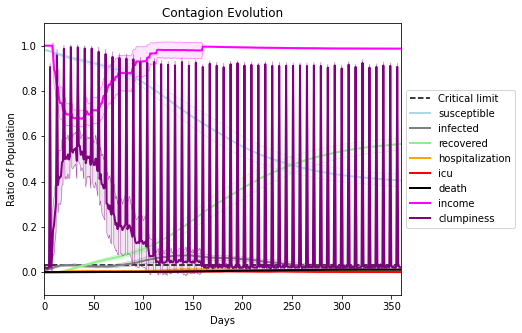

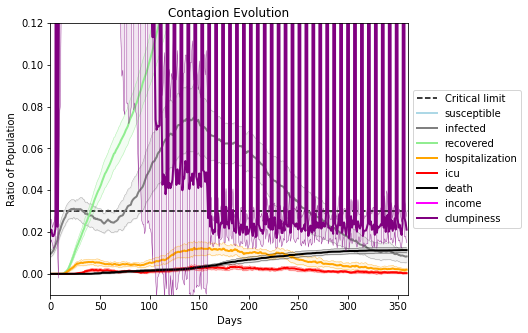

In [38]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.7
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
              [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
], listeners = listeners)

Save these seeds if you want to rerun a scenario
[4237, 7319, 5899, 7483, 3193, 3389, 7833, 2343, 2444, 4121, 5464, 7061, 6968, 2741, 2930, 4419, 1757, 3461, 3803, 7972]
Average similarity between family members is 0.29346681749526604 at temperature -0.6
Average similarity between family and home is 0.9998539032792652 at temperature -1
Average similarity between students and their classroom is 0.16478212158205247 at temperature -0.6
Average classroom occupancy is 3.9130434782608696 and number classrooms is 69
Average similarity between workers is 0.15098384804066908 at temperature -0.6
Average office occupancy is 3.4494949494949494 and number offices is 198
Average friend similarity for adults: 0.3792095164811753 for kids: 0.215013300891864
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) district with 1 Building

avg restaurant similarity 0.0911179424445978
avg restaurant similarity 0.08575595114499496
avg restaurant similarity 0.08710020768011675
avg restaurant similarity 0.06748521562224107
avg restaurant similarity 0.1302250416017632
avg restaurant similarity 0.08821052505806724
avg restaurant similarity 0.07224354870423073
avg restaurant similarity 0.07374540322826349
avg restaurant similarity 0.060597317785443104
avg restaurant similarity 0.067578235389174
avg restaurant similarity 0.0960456821811986
avg restaurant similarity 0.08127545594909766
avg restaurant similarity 0.039974665299953374
avg restaurant similarity 0.12824938583323556
avg restaurant similarity 0.0723401807479269
avg restaurant similarity 0.10747364800812678
avg restaurant similarity 0.07603311809804558
avg restaurant similarity 0.08949692404462785
avg restaurant similarity 0.009609240048529652
avg restaurant similarity 0.09064865672661852
avg restaurant similarity 0.11240655778566194
avg restaurant similarity 0.102781411

avg restaurant similarity 0.09448416418851611
avg restaurant similarity 0.08889893466499998
avg restaurant similarity 0.07032053490246448
avg restaurant similarity 0.07771552442951409
avg restaurant similarity 0.088068858603746
avg restaurant similarity 0.12062302168300791
avg restaurant similarity 0.028659473558726136
avg restaurant similarity 0.06814865098242252
avg restaurant similarity 0.0828029404512119
avg restaurant similarity 0.03932319544656976
avg restaurant similarity 0.07629360320190955
avg restaurant similarity 0.05878184444198952
avg restaurant similarity 0.07384179385601893
avg restaurant similarity 0.10713861238445181
avg restaurant similarity 0.11677188451684693
avg restaurant similarity 0.11092986352846634
avg restaurant similarity 0.06910851818606757
avg restaurant similarity 0.08089713340933184
avg restaurant similarity 0.06230414627930154
avg restaurant similarity 0.09545038622150862
avg restaurant similarity 0.06790360770174313
avg restaurant similarity 0.07447686

avg restaurant similarity 0.08909608668460849
avg restaurant similarity 0.0709732542157545
avg restaurant similarity 0.03766055394826015
avg restaurant similarity 0.06750509720385364
avg restaurant similarity 0.07903199577541659
avg restaurant similarity 0.12124221161356286
avg restaurant similarity 0.05694949422328587
avg restaurant similarity 0.06254075619631416
avg restaurant similarity 0.04146206643248178
avg restaurant similarity 0.10259054059360048
avg restaurant similarity 0.0547187244816762
avg restaurant similarity 0.04701575677661163
avg restaurant similarity 0.06715058642915797
avg restaurant similarity 0.046732623514987776
avg restaurant similarity 0.06294255948619912
avg restaurant similarity 0.10302399254924696
avg restaurant similarity 0.11409406431482687
avg restaurant similarity 0.06931084322030265
avg restaurant similarity 0.11501529952857943
avg restaurant similarity 0.053765284345615054
avg restaurant similarity 0.026558579803064506
avg restaurant similarity 0.06701

avg restaurant similarity 0.06240066885402774
avg restaurant similarity 0.10054841109652939
avg restaurant similarity 0.0548776778474104
avg restaurant similarity 0.05153238092189759
avg restaurant similarity 0.07508971121504812
avg restaurant similarity 0.028957646287176033
avg restaurant similarity 0.08995364387492572
avg restaurant similarity 0.11677119603300949
avg restaurant similarity -0.0016355053514859324
avg restaurant similarity 0.08007239120747961
avg restaurant similarity 0.10583364626142026
avg restaurant similarity 0.09401485267657463
avg restaurant similarity 0.09581589143783574
avg restaurant similarity 0.08341026947664525
avg restaurant similarity 0.10714140730713967
avg restaurant similarity 0.030493530842599426
avg restaurant similarity -0.04328962190489853
avg restaurant similarity 0.09591301437807855
avg restaurant similarity 0.09654145548968998
avg restaurant similarity 0.06016427935970603
avg restaurant similarity 0.0942101294049262
avg restaurant similarity 0.03

avg restaurant similarity 0.07290268628302182
avg restaurant similarity 0.017929882470750648
avg restaurant similarity 0.04145514383491057
avg restaurant similarity 0.07086021472074705
avg restaurant similarity 0.07512670330121449
avg restaurant similarity 0.03351493127532539
avg restaurant similarity -0.009263509873607894
avg restaurant similarity 0.05166734077885776
avg restaurant similarity 0.07412542321052891
avg restaurant similarity 0.07757957419004063
avg restaurant similarity 0.0980263829803841
avg restaurant similarity 0.026372386192868424
avg restaurant similarity 0.06180618909589212
avg restaurant similarity 0.051032215750421404
avg restaurant similarity 0.078723503874879
avg restaurant similarity 0.0700409599749089
avg restaurant similarity 0.023521841112016422
avg restaurant similarity 0.0674823876549823
avg restaurant similarity 0.06691925239708374
avg restaurant similarity 0.09636563179189402
avg restaurant similarity 0.09633300484172272
avg restaurant similarity 0.01448

avg restaurant similarity 0.04660765140107463
avg restaurant similarity 0.03343963094101025
avg restaurant similarity 0.06466969047110208
avg restaurant similarity 0.042509339733998605
avg restaurant similarity 0.052923957395739955
avg restaurant similarity 0.05392737692944394
avg restaurant similarity 0.08266736830416224
avg restaurant similarity 0.05946793304829675
avg restaurant similarity 0.08651847182605701
avg restaurant similarity 0.02155287342979119
avg restaurant similarity 0.043060836786056385
avg restaurant similarity 0.05336972521874129
avg restaurant similarity 0.020156148382858282
avg restaurant similarity 0.08533412821247292
avg restaurant similarity 0.0665095741174298
avg restaurant similarity 0.07990852708400589
avg restaurant similarity 0.028974920085336538
avg restaurant similarity 0.12059878325209045
avg restaurant similarity 0.050349608625056726
avg restaurant similarity 0.032346449479033076
avg restaurant similarity 0.034586022236481356
avg restaurant similarity 0

avg restaurant similarity -0.028567663948988575
avg restaurant similarity 0.09379807387072614
avg restaurant similarity 0.06828653113702005
avg restaurant similarity 0.06271911213629529
avg restaurant similarity 0.07723339299769649
avg restaurant similarity 0.06949483017195002
avg restaurant similarity 0.07292948068506583
avg restaurant similarity 0.0526948863619075
avg restaurant similarity 0.09846864814855844
avg restaurant similarity 0.042918846063069546
avg restaurant similarity 0.04702366331327585
avg restaurant similarity 0.09289876007953513
avg restaurant similarity 0.09200613165081441
avg restaurant similarity 0.0775711992479756
avg restaurant similarity 0.042111077932911
avg restaurant similarity 0.041051975641642945
avg restaurant similarity 0.09971485175273845
avg restaurant similarity 0.1206359252991059
avg restaurant similarity 0.08290021650271315
avg restaurant similarity 0.0729417448548998
avg restaurant similarity 0.07330802117150781
avg restaurant similarity 0.08301982

avg restaurant similarity 0.09282081604623504
avg restaurant similarity 0.09633704705395289
avg restaurant similarity 0.07250860949405406
avg restaurant similarity 0.096207201011666
avg restaurant similarity 0.07116592082112677
avg restaurant similarity 0.08336935778667177
avg restaurant similarity 0.1002289163804606
avg restaurant similarity 0.09442438696016854
avg restaurant similarity 0.09569622311202539
avg restaurant similarity 0.08627954657326035
avg restaurant similarity 0.0929076576650542
avg restaurant similarity 0.08241405360138082
avg restaurant similarity 0.032820790208810256
avg restaurant similarity 0.003350629001089897
avg restaurant similarity 0.06026887055283597
avg restaurant similarity 0.09862466696783329
avg restaurant similarity 0.08113175422559074
avg restaurant similarity 0.08614008121259698
avg restaurant similarity 0.11748228300840781
avg restaurant similarity 0.0654793472673402
avg restaurant similarity 0.0828724598645965
avg restaurant similarity 0.0820227805

avg restaurant similarity 0.09400983538794279
avg restaurant similarity 0.034046391078866055
avg restaurant similarity 0.02768357966103675
avg restaurant similarity 0.07041233597996165
avg restaurant similarity 0.053690027579337184
avg restaurant similarity 0.0861631407231846
avg restaurant similarity 0.06483323846531748
avg restaurant similarity 0.07377058777442722
avg restaurant similarity 0.07149267313997336
avg restaurant similarity 0.04062283831705827
avg restaurant similarity 0.053914193411708
avg restaurant similarity 0.05528683193168094
avg restaurant similarity 0.07318450574328471
avg restaurant similarity 0.054538010109691816
avg restaurant similarity 0.024323678418689057
avg restaurant similarity 0.025276116747228246
avg restaurant similarity 0.0381540948211448
avg restaurant similarity 0.028458977360615943
avg restaurant similarity 0.08007578816846608
avg restaurant similarity 0.06813268639098459
avg restaurant similarity 0.08025885691251211
avg restaurant similarity 0.0460

avg restaurant similarity 0.03973205552148156
avg restaurant similarity 0.07604633578024689
avg restaurant similarity -0.0034114616709457076
avg restaurant similarity 0.06137143432136378
avg restaurant similarity 0.03890433673853998
avg restaurant similarity 0.13833325346614356
avg restaurant similarity 0.0906257893857182
avg restaurant similarity 0.0567481049953669
avg restaurant similarity 0.04506317295912829
avg restaurant similarity 0.07145630040243257
avg restaurant similarity -0.00030822765773300424
avg restaurant similarity 0.04977794839307142
avg restaurant similarity 0.00846705248809223
avg restaurant similarity 0.09092887250296493
avg restaurant similarity 0.1018784377215072
avg restaurant similarity 0.09543193647320032
avg restaurant similarity 0.07582797748558538
avg restaurant similarity 0.05084066991169921
avg restaurant similarity 0.09411134352699506
avg restaurant similarity 0.07924795886887143
avg restaurant similarity 0.05085141733479067
avg restaurant similarity 0.02

avg restaurant similarity 0.12371425018903554
avg restaurant similarity 0.09063793387861437
avg restaurant similarity 0.11268328864855152
avg restaurant similarity 0.09279592915502716
avg restaurant similarity 0.12367373213716763
avg restaurant similarity 0.10708620751939985
avg restaurant similarity 0.09393132910551383
avg restaurant similarity 0.14029739357935092
avg restaurant similarity 0.11164692588396535
avg restaurant similarity 0.12964960202212492
avg restaurant similarity 0.09282724221299683
avg restaurant similarity 0.1231911075915624
avg restaurant similarity 0.14289280014712955
avg restaurant similarity 0.1414913698001657
avg restaurant similarity 0.1123399457001012
avg restaurant similarity 0.054535151988044074
avg restaurant similarity 0.10031132633370263
avg restaurant similarity 0.10836253017986248
avg restaurant similarity 0.05586084940080125
avg restaurant similarity 0.13948539325908244
avg restaurant similarity 0.09806469518550157
avg restaurant similarity 0.07027350

avg restaurant similarity 0.06986967085891937
avg restaurant similarity 0.13645037786973224
avg restaurant similarity 0.11002449146565772
avg restaurant similarity 0.07316374439554249
avg restaurant similarity 0.10225436133106708
avg restaurant similarity 0.1432093475848702
avg restaurant similarity 0.13512912466804583
avg restaurant similarity 0.09708552695487009
avg restaurant similarity 0.10386274548399081
avg restaurant similarity 0.09912105903467473
avg restaurant similarity 0.1412368461348487
avg restaurant similarity 0.13442572021151125
avg restaurant similarity 0.09155722641736934
avg restaurant similarity 0.06416734006488023
avg restaurant similarity 0.06117586882908382
avg restaurant similarity 0.05292328551033354
avg restaurant similarity 0.15566013608710916
avg restaurant similarity 0.14133838800452672
avg restaurant similarity 0.07816697297682292
avg restaurant similarity 0.13941525038376384
avg restaurant similarity 0.07292640048710962
avg restaurant similarity 0.09085804

avg restaurant similarity 0.13170882798561018
avg restaurant similarity 0.07582752085750512
avg restaurant similarity 0.06526329695163763
avg restaurant similarity 0.1316193155209801
avg restaurant similarity 0.08551443645181141
avg restaurant similarity 0.06274334587383709
avg restaurant similarity 0.08688411650926621
avg restaurant similarity 0.06093871748346874
avg restaurant similarity 0.09241509593018968
avg restaurant similarity 0.07180447499168598
avg restaurant similarity 0.06025423648378095
avg restaurant similarity 0.08563166197707396
avg restaurant similarity 0.034378478273262646
avg restaurant similarity 0.08654006049931279
avg restaurant similarity 0.10043018622831255
avg restaurant similarity 0.1015405165093279
avg restaurant similarity 0.07927845451632479
avg restaurant similarity 0.029500202135184953
avg restaurant similarity 0.07598769781561487
avg restaurant similarity 0.041371710932866484
avg restaurant similarity 0.06892759291459848
avg restaurant similarity 0.05581

avg restaurant similarity 0.034829296218320316
avg restaurant similarity 0.08532474833810988
avg restaurant similarity 0.10604753937876878
avg restaurant similarity 0.07721487562505022
avg restaurant similarity 0.05424704163824522
avg restaurant similarity 0.10183201690635454
avg restaurant similarity 0.1285060968000133
avg restaurant similarity 0.10070200022330762
avg restaurant similarity 0.050326192913765076
avg restaurant similarity 0.03404424995093712
avg restaurant similarity 0.027922807646804375
avg restaurant similarity 0.06943762824817445
avg restaurant similarity 0.05969208655968604
avg restaurant similarity 0.04704464629221055
avg restaurant similarity 0.06087919973563896
avg restaurant similarity 0.02275030509105096
avg restaurant similarity 0.11991505596149785
avg restaurant similarity 0.06707022434214396
avg restaurant similarity 0.03907319700544506
avg restaurant similarity 0.05914893638922991
avg restaurant similarity 0.09225632102054347
avg restaurant similarity 0.0646

avg restaurant similarity 0.10096397643480301
avg restaurant similarity 0.023523010911023146
avg restaurant similarity 0.04054728798878063
avg restaurant similarity 0.01754272802088135
avg restaurant similarity 0.06287184374134551
avg restaurant similarity -0.010311904197886582
avg restaurant similarity 0.03819818008117582
avg restaurant similarity 0.02899021508312798
avg restaurant similarity 0.014523590785842045
avg restaurant similarity 0.03335763454471024
avg restaurant similarity 0.04082924927548546
avg restaurant similarity 0.09389109767283722
avg restaurant similarity 0.05308505881204027
avg restaurant similarity 0.07353605310521837
avg restaurant similarity 0.06839205002645897
avg restaurant similarity 0.042674598076143454
avg restaurant similarity 0.03106000607027942
avg restaurant similarity 0.07816313783519954
avg restaurant similarity 0.037963772421824665
avg restaurant similarity 0.04831439807230691
avg restaurant similarity 0.1240027624627743
avg restaurant similarity 0.0

avg restaurant similarity 0.06753224713468133
avg restaurant similarity 0.03172119951903671
avg restaurant similarity 0.07351683295341979
avg restaurant similarity 0.0714583636870103
avg restaurant similarity 0.07158810310046534
avg restaurant similarity 0.015609031296595167
avg restaurant similarity 0.0384305011107317
avg restaurant similarity 0.060077959806461065
avg restaurant similarity 0.07643373230161717
avg restaurant similarity 0.05249066127159055
avg restaurant similarity 0.08050188768298208
avg restaurant similarity 0.07700046288504088
avg restaurant similarity 0.07105414034826667
avg restaurant similarity 0.013375827517735554
avg restaurant similarity 0.05551593577307866
avg restaurant similarity 0.015470992898416034
avg restaurant similarity 0.06271546290246909
avg restaurant similarity 0.0771832973720583
avg restaurant similarity 0.08330738597525975
avg restaurant similarity 0.08369424174761532
avg restaurant similarity 0.04258888455029435
avg restaurant similarity 0.02924

avg restaurant similarity 0.08297070458020529
avg restaurant similarity 0.027382284161897336
avg restaurant similarity 0.1061113341511654
avg restaurant similarity 0.13246193501740314
avg restaurant similarity 0.08137838323342354
avg restaurant similarity 0.07717607070187686
avg restaurant similarity 0.10944998506479174
avg restaurant similarity 0.12108089265001827
avg restaurant similarity 0.09844959690076635
avg restaurant similarity 0.11680183805610646
avg restaurant similarity 0.05047686498632011
avg restaurant similarity 0.11020986285387252
avg restaurant similarity 0.037286997838040854
avg restaurant similarity 0.06145952218714473
avg restaurant similarity 0.03355905927564239
avg restaurant similarity 0.08610641889170695
avg restaurant similarity 0.053108859754291776
avg restaurant similarity 0.0515964994793134
avg restaurant similarity 0.16806363124837478
avg restaurant similarity 0.09354863387479669
avg restaurant similarity 0.09757313829347891
avg restaurant similarity 0.11490

avg restaurant similarity 0.055537219531691114
avg restaurant similarity 0.08605112637517072
avg restaurant similarity 0.09467972782906679
avg restaurant similarity 0.14213675086912797
avg restaurant similarity 0.07907011215102923
avg restaurant similarity 0.06251156347081703
avg restaurant similarity 0.047234188268682566
avg restaurant similarity 0.02689723436032783
avg restaurant similarity 0.097905176230847
avg restaurant similarity 0.07048622870567355
avg restaurant similarity 0.09497386044261234
avg restaurant similarity 0.12714317696223715
avg restaurant similarity 0.08352064451219907
avg restaurant similarity 0.04908454079386931
avg restaurant similarity 0.07957377480080324
avg restaurant similarity 0.07975081810936567
avg restaurant similarity 0.07944658045748938
avg restaurant similarity 0.10531331950186633
avg restaurant similarity 0.10107476172175987
avg restaurant similarity 0.08165316213051882
avg restaurant similarity 0.058656686181957254
avg restaurant similarity 0.12737

avg restaurant similarity 0.07284641589096522
avg restaurant similarity 0.046590590522304104
avg restaurant similarity 0.0708448582922424
avg restaurant similarity 0.10311651685755914
avg restaurant similarity 0.08754255629244678
avg restaurant similarity 0.0764539027034076
avg restaurant similarity 0.057525527409531145
avg restaurant similarity 0.045767824727166465
avg restaurant similarity 0.113491513318906
avg restaurant similarity 0.06673354307503636
avg restaurant similarity 0.048037965360248056
avg restaurant similarity 0.062326702921888154
avg restaurant similarity 0.09201845217129424
avg restaurant similarity 0.0841351386785135
avg restaurant similarity 0.11059389189811968
avg restaurant similarity 0.04382988903936486
avg restaurant similarity 0.06502395053163891
avg restaurant similarity 0.06849614026919652
avg restaurant similarity 0.0706834617007728
avg restaurant similarity 0.06549575699689131
avg restaurant similarity 0.023044394830694256
avg restaurant similarity 0.068495

avg restaurant similarity 0.09135803081725431
avg restaurant similarity 0.05263953862353408
avg restaurant similarity 0.03243660518785664
avg restaurant similarity 0.10939877664805496
avg restaurant similarity 0.028620275995027648
avg restaurant similarity 0.06520750955202248
avg restaurant similarity 0.10241680178143169
avg restaurant similarity 0.06308955900022954
avg restaurant similarity 0.11817455968863674
avg restaurant similarity 0.05813617012173988
avg restaurant similarity 0.08067872366704593
avg restaurant similarity 0.07396320725193815
avg restaurant similarity 0.09640776383175088
avg restaurant similarity 0.044988896694560486
avg restaurant similarity 0.08336663078258659
avg restaurant similarity 0.08075456929033278
avg restaurant similarity 0.059219255184982555
avg restaurant similarity 0.09914695468330677
avg restaurant similarity 0.0888222281658258
avg restaurant similarity 0.09506804382375497
avg restaurant similarity 0.12050084386353653
avg restaurant similarity 0.0791

avg restaurant similarity 0.08498724160650385
avg restaurant similarity 0.080261648985764
avg restaurant similarity 0.07958388868690919
avg restaurant similarity 0.013347433735793106
avg restaurant similarity 0.06357612903223724
avg restaurant similarity 0.06909536898685545
avg restaurant similarity 0.108010658638646
avg restaurant similarity 0.08083200313333322
avg restaurant similarity 0.09361779503108221
avg restaurant similarity 0.07343794032669522
avg restaurant similarity 0.08417685557516592
avg restaurant similarity 0.06758819095538665
avg restaurant similarity 0.08740241384567256
avg restaurant similarity 0.029277298496848767
avg restaurant similarity 0.08077414029770401
avg restaurant similarity 0.02042922758203939
avg restaurant similarity 0.11467872729089455
avg restaurant similarity 0.03274520236519362
avg restaurant similarity 0.08919044461261925
avg restaurant similarity 0.08065571830956379
avg restaurant similarity 0.04894287314041048
avg restaurant similarity 0.04098087

avg restaurant similarity 0.11080393349339761
avg restaurant similarity 0.11187005069391964
avg restaurant similarity 0.05871980166166893
avg restaurant similarity 0.07759390478137222
avg restaurant similarity 0.09982976931360896
avg restaurant similarity 0.04842733443618183
avg restaurant similarity 0.07243407070186035
avg restaurant similarity 0.1057510595717157
avg restaurant similarity 0.06895275184746585
avg restaurant similarity 0.14031270322109327
avg restaurant similarity 0.10582469898958273
avg restaurant similarity 0.12791528373251598
avg restaurant similarity 0.06721578849146706
avg restaurant similarity 0.07290716542855866
avg restaurant similarity 0.09944487180107199
avg restaurant similarity 0.02455428000819903
avg restaurant similarity 0.06522564217217677
avg restaurant similarity 0.09904976699712972
avg restaurant similarity 0.043021932092529254
avg restaurant similarity 0.06574407513517114
avg restaurant similarity 0.02611805519153432
avg restaurant similarity 0.102924

avg restaurant similarity 0.04698246704176245
avg restaurant similarity 0.08517574316582287
avg restaurant similarity 0.08357302140433724
avg restaurant similarity 0.009621043857442115
avg restaurant similarity 0.048578341300894015
avg restaurant similarity 0.0497135989567608
avg restaurant similarity 0.11922556683387123
avg restaurant similarity 0.06482082031051006
avg restaurant similarity 0.050481736877019415
avg restaurant similarity 0.07079043615628125
avg restaurant similarity 0.09489559041384164
avg restaurant similarity 0.03365544652193692
avg restaurant similarity 0.055448584956028744
avg restaurant similarity 0.11015500269932492
avg restaurant similarity 0.09996954374238973
avg restaurant similarity 0.07034994464362193
avg restaurant similarity 0.06127668473169332
avg restaurant similarity 0.039824893385135986
avg restaurant similarity 0.06741701825590829
avg restaurant similarity 0.05358202428890964
avg restaurant similarity 0.0225906166290164
avg restaurant similarity 0.031

avg restaurant similarity -0.016817520818034344
avg restaurant similarity 0.03815444721699234
avg restaurant similarity 0.02836535328817124
avg restaurant similarity 0.04562240677862048
avg restaurant similarity 0.03566343586584245
avg restaurant similarity 0.05631544908678804
avg restaurant similarity 0.09052056342885911
avg restaurant similarity 0.08240825710251978
avg restaurant similarity 0.07908097300109757
avg restaurant similarity 0.032281007072826134
avg restaurant similarity 0.03221311383032448
avg restaurant similarity 0.08430588056994884
avg restaurant similarity 0.07905599878082091
avg restaurant similarity 0.055649002812331254
avg restaurant similarity 0.10374132212227519
avg restaurant similarity 0.04766467691228555
avg restaurant similarity 0.08408723241883073
avg restaurant similarity 0.053837510653484286
avg restaurant similarity 0.003243876602200858
avg restaurant similarity 0.06657329032331187
avg restaurant similarity 0.045514395105202866
avg restaurant similarity 0

avg restaurant similarity 0.07354335284163853
avg restaurant similarity 0.04693008460816822
avg restaurant similarity 0.0497635469016359
avg restaurant similarity 0.05834617865233658
avg restaurant similarity 0.06942854107062442
avg restaurant similarity 0.09609424901016411
avg restaurant similarity 0.06871574361620587
avg restaurant similarity 0.05610694364004715
avg restaurant similarity 0.08256120164861623
avg restaurant similarity 0.029259247011760338
avg restaurant similarity 0.07309240657148804
avg restaurant similarity 0.06051437565683931
avg restaurant similarity 0.0921670073492075
avg restaurant similarity 0.08328505556980387
avg restaurant similarity 0.07169195383765951
avg restaurant similarity 0.07260883860184357
avg restaurant similarity 0.07974738543368771
avg restaurant similarity 0.053056790564261956
avg restaurant similarity 0.06650750219315457
avg restaurant similarity 0.051920476878281406
avg restaurant similarity 0.0857884846977462
avg restaurant similarity 0.068816

avg restaurant similarity 0.11176183864303849
avg restaurant similarity 0.04413727025205109
avg restaurant similarity 0.05433243400152993
avg restaurant similarity 0.02293364381436876
avg restaurant similarity 0.08890099287600454
avg restaurant similarity 0.057865808448777485
avg restaurant similarity 0.07955869084292469
avg restaurant similarity 0.09755328996936909
avg restaurant similarity 0.09908712444973035
avg restaurant similarity 0.06617626941488929
avg restaurant similarity 0.08612083105592087
avg restaurant similarity 0.09310283495421681
avg restaurant similarity 0.049019756595808706
avg restaurant similarity 0.06685270633945715
avg restaurant similarity 0.030723012599635054
avg restaurant similarity 0.04484141554674544
avg restaurant similarity 0.10667294171214917
avg restaurant similarity 0.0661010531956268
avg restaurant similarity 0.04903391535659698
avg restaurant similarity 0.12488780636263018
avg restaurant similarity 0.08041192095553262
avg restaurant similarity 0.0868

avg restaurant similarity 0.03895528949062014
avg restaurant similarity 0.05538600089585382
avg restaurant similarity 0.0367468857979703
avg restaurant similarity 0.04759877450544891
avg restaurant similarity 0.06500990397929651
avg restaurant similarity 0.07373448776108779
avg restaurant similarity 0.06708902060574096
avg restaurant similarity 0.05932288265246848
avg restaurant similarity 0.04787030861719506
avg restaurant similarity 0.07662811333011871
avg restaurant similarity 0.05959598218915253
avg restaurant similarity 0.06183551685412891
avg restaurant similarity 0.04741066888557739
avg restaurant similarity 0.03690129297346417
avg restaurant similarity 0.058871091135190755
avg restaurant similarity -0.0007763828700864047
avg restaurant similarity 0.1062304956425567
avg restaurant similarity 0.07683548343832061
avg restaurant similarity 0.10980460750120721
avg restaurant similarity 0.0968108697467925
avg restaurant similarity 0.09077340878289648
avg restaurant similarity 0.08937

avg restaurant similarity 0.08581138301458595
avg restaurant similarity 0.06380085529397723
avg restaurant similarity 0.0455143378294603
avg restaurant similarity 0.057605048452392095
avg restaurant similarity 0.05582584059938198
avg restaurant similarity 0.047417639641453714
avg restaurant similarity 0.027247483104429857
avg restaurant similarity 0.07509098049900198
avg restaurant similarity 0.10679684033280029
avg restaurant similarity 0.048313110141357724
avg restaurant similarity 0.07965536138727443
avg restaurant similarity 0.07768973785549477
avg restaurant similarity 0.10494307449993019
avg restaurant similarity 0.05175244084702204
avg restaurant similarity -0.007608009698760579
avg restaurant similarity 0.08349328789766548
avg restaurant similarity 0.039083945612698665
avg restaurant similarity 0.07532459702527157
avg restaurant similarity -0.011106246335564422
avg restaurant similarity 0.019744417103837685
avg restaurant similarity 0.058895857676092886
avg restaurant similarit

avg restaurant similarity 0.08466406152849953
avg restaurant similarity 0.04461167949119064
avg restaurant similarity 0.09148377032816687
avg restaurant similarity 0.11854091610541637
avg restaurant similarity 0.08748527818205244
avg restaurant similarity 0.09732725572975505
avg restaurant similarity 0.10597617921132922
avg restaurant similarity 0.09261868994475686
avg restaurant similarity 0.050554969116962535
avg restaurant similarity 0.046269436542860434
avg restaurant similarity 0.07014582158073221
avg restaurant similarity 0.08716710451911613
avg restaurant similarity 0.045132252233557164
avg restaurant similarity 0.11563632946181773
avg restaurant similarity 0.06609076420899185
avg restaurant similarity 0.09986345373387914
avg restaurant similarity 0.04406596080519769
avg restaurant similarity 0.12358895616520983
avg restaurant similarity 0.077539009242627
avg restaurant similarity 0.03342449714920945
avg restaurant similarity 0.10339842215728424
avg restaurant similarity 0.07958

avg restaurant similarity 0.10102116863601579
avg restaurant similarity 0.05116689942501788
avg restaurant similarity 0.07535282345390762
avg restaurant similarity 0.09259631788977134
avg restaurant similarity 0.02803878497587666
avg restaurant similarity 0.0913459483005491
avg restaurant similarity 0.04217745109820988
avg restaurant similarity 0.03227721123891458
avg restaurant similarity 0.13349060873328553
avg restaurant similarity 0.06275482457084407
avg restaurant similarity 0.062018924507819546
avg restaurant similarity 0.04215459833687743
avg restaurant similarity 0.051326528995416926
avg restaurant similarity -0.01637307045007505
avg restaurant similarity 0.04803440724274805
avg restaurant similarity 0.03460105065963203
avg restaurant similarity 0.0885094345463824
avg restaurant similarity 0.10514915411050105
avg restaurant similarity 0.04950132148570472
avg restaurant similarity 0.03192694596686062
avg restaurant similarity 0.07227739086891377
avg restaurant similarity 0.09810

avg restaurant similarity 0.034582331058359686
avg restaurant similarity 0.06356595909255813
avg restaurant similarity 0.0900321351469149
avg restaurant similarity 0.05939482194631991
avg restaurant similarity 0.0935741926756673
avg restaurant similarity 0.07685392257387426
avg restaurant similarity 0.05340635160637602
avg restaurant similarity 0.06129102254337303
avg restaurant similarity 0.07156657349948993
avg restaurant similarity 0.03081086083588722
avg restaurant similarity 0.06726690512740868
avg restaurant similarity 0.05858948439209912
avg restaurant similarity 0.07757515167696676
avg restaurant similarity 0.07055898799178459
avg restaurant similarity 0.06890385993078793
avg restaurant similarity 0.02800987632846723
avg restaurant similarity 0.01161002671539461
avg restaurant similarity 0.037373772724456834
avg restaurant similarity 0.07655579546052306
avg restaurant similarity 0.07577032053533618
avg restaurant similarity 0.06378720254213804
avg restaurant similarity 0.043834

avg restaurant similarity 0.10756806464175424
avg restaurant similarity 0.061813844558925524
avg restaurant similarity 0.11966862004658192
avg restaurant similarity 0.03741087380841051
avg restaurant similarity 0.04404804543898253
avg restaurant similarity 0.041437176525894154
avg restaurant similarity 0.06809213692841973
avg restaurant similarity 0.049351169157372664
avg restaurant similarity 0.05600659473144958
avg restaurant similarity 0.0787844710065193
avg restaurant similarity 0.022355555559199245
avg restaurant similarity 0.041731778309290785
avg restaurant similarity 0.017575674840726217
avg restaurant similarity 0.06336550422986695
avg restaurant similarity 0.02570540009067235
avg restaurant similarity 0.013874528296366448
avg restaurant similarity 0.06624940479680799
avg restaurant similarity 0.14183933120690537
avg restaurant similarity 0.009703873376634
avg restaurant similarity 0.04253195161104119
avg restaurant similarity 0.07174982816602525
avg restaurant similarity 0.09

avg restaurant similarity 0.05022358837448194
avg restaurant similarity 0.08207543800287263
avg restaurant similarity 0.09344448721902865
avg restaurant similarity 0.06076954600470941
avg restaurant similarity 0.08263342402240538
avg restaurant similarity 0.06688049066807103
avg restaurant similarity 0.08667479375944687
avg restaurant similarity 0.0832406775541002
avg restaurant similarity 0.11070668158187263
avg restaurant similarity 0.13251769951376197
avg restaurant similarity 0.14353570449870534
avg restaurant similarity 0.104170491075947
avg restaurant similarity 0.10861011876251285
avg restaurant similarity 0.11949950059220929
avg restaurant similarity 0.07554532600978087
avg restaurant similarity 0.0751782321329406
avg restaurant similarity 0.04087312151638959
avg restaurant similarity 0.0877828933925018
avg restaurant similarity 0.08161362287399666
avg restaurant similarity 0.06730316081029118
avg restaurant similarity 0.08471785881631803
avg restaurant similarity 0.08866162765

avg restaurant similarity 0.10452532544350962
avg restaurant similarity 0.08507449716757404
avg restaurant similarity 0.047995440981764316
avg restaurant similarity 0.0773693510326278
avg restaurant similarity 0.06360514788987379
avg restaurant similarity 0.061887041036002136
avg restaurant similarity 0.08651578332130813
avg restaurant similarity 0.06312861327880386
avg restaurant similarity 0.09868767790133319
avg restaurant similarity 0.07723916502881646
avg restaurant similarity 0.04632082409152327
avg restaurant similarity 0.04695248297533336
avg restaurant similarity 0.08543580480835278
avg restaurant similarity 0.10202742851770975
avg restaurant similarity 0.09537240282475865
avg restaurant similarity 0.08522056225159648
avg restaurant similarity 0.0680761458188484
avg restaurant similarity 0.07713639517304831
avg restaurant similarity 0.1271990298451142
avg restaurant similarity 0.06242748369326306
avg restaurant similarity 0.09756084431153389
avg restaurant similarity 0.0751330

avg restaurant similarity 0.02958369236346706
avg restaurant similarity 0.06481983585527548
avg restaurant similarity 0.043768279344243495
avg restaurant similarity 0.03930872192758155
avg restaurant similarity 0.0791929115972772
avg restaurant similarity 0.08904814584179757
avg restaurant similarity 0.04403947153121049
avg restaurant similarity 0.12746898935496243
avg restaurant similarity 0.051556266038649684
avg restaurant similarity 0.033778104945226095
avg restaurant similarity 0.07372773464437476
avg restaurant similarity 0.02482225759251712
avg restaurant similarity 0.08571266342799445
avg restaurant similarity 0.059610277481908745
avg restaurant similarity 0.01447854656038841
avg restaurant similarity 0.09569573328778426
avg restaurant similarity 0.10779113937739176
avg restaurant similarity 0.07950721131909562
avg restaurant similarity 0.0965660772513917
avg restaurant similarity 0.03759637297686838
avg restaurant similarity 0.03698437343084529
avg restaurant similarity 0.0405

avg restaurant similarity 0.09693646707890984
avg restaurant similarity 0.06270523330357089
avg restaurant similarity 0.09649211164061995
avg restaurant similarity 0.08864374822985896
avg restaurant similarity 0.10393071750313138
avg restaurant similarity 0.07188842354555094
avg restaurant similarity 0.08212767691413835
avg restaurant similarity 0.08229335727166236
avg restaurant similarity 0.09330941439796278
avg restaurant similarity 0.07314682212872278
avg restaurant similarity 0.1396862088061884
avg restaurant similarity 0.10267382780389504
avg restaurant similarity 0.06495499136603847
avg restaurant similarity 0.10428740711094837
avg restaurant similarity 0.09351131168904275
avg restaurant similarity 0.06282791401911182
avg restaurant similarity 0.0631588830490269
avg restaurant similarity 0.08215027054446661
avg restaurant similarity 0.04406949001620057
avg restaurant similarity 0.06320552805851595
avg restaurant similarity 0.09916629283129474
avg restaurant similarity 0.10512676

avg restaurant similarity -0.007723917652923491
avg restaurant similarity 0.07336492079811273
avg restaurant similarity 0.058239848481901925
avg restaurant similarity 0.04836932383123803
avg restaurant similarity 0.03876610449984114
avg restaurant similarity 0.09377039432921802
avg restaurant similarity -0.015145161522306213
avg restaurant similarity 0.047531578140770234
avg restaurant similarity 0.06592269219057727
avg restaurant similarity 0.06314791071713503
avg restaurant similarity 0.11012246246202838
avg restaurant similarity 0.06908379014872322
avg restaurant similarity 0.11814901087030646
avg restaurant similarity 0.05783621141898647
avg restaurant similarity 0.05657026167280809
avg restaurant similarity 0.022647157540342397
avg restaurant similarity 0.049141321667237496
avg restaurant similarity 0.049481713109192395
avg restaurant similarity 0.025183942237431194
avg restaurant similarity 0.0843290502103225
avg restaurant similarity 0.04660824007541924
avg restaurant similarity

avg restaurant similarity 0.05159896232024724
avg restaurant similarity 0.020282253888043354
avg restaurant similarity 0.02802876523661104
avg restaurant similarity 0.0784009312655831
avg restaurant similarity 0.05108608024150179
avg restaurant similarity 0.10691547246229277
avg restaurant similarity 0.05492623741525772
avg restaurant similarity 0.05824184288513703
avg restaurant similarity 0.058470120144806834
avg restaurant similarity 0.040806954750768704
avg restaurant similarity 0.052435070239443465
avg restaurant similarity 0.012242936695567402
avg restaurant similarity 0.0654550464800329
avg restaurant similarity 0.07657553592982301
avg restaurant similarity 0.05111410854507131
avg restaurant similarity 0.033643430238710775
avg restaurant similarity -0.0034075809209540868
avg restaurant similarity 0.03331633261422234
avg restaurant similarity 0.0023533734982771524
avg restaurant similarity 0.06393221129023496
avg restaurant similarity 0.014208711769335493
avg restaurant similarit

avg restaurant similarity 0.044008350513782976
avg restaurant similarity 0.11642897550091733
avg restaurant similarity 0.0391300392227776
avg restaurant similarity 0.07438198318454338
avg restaurant similarity 0.05748203755731994
avg restaurant similarity 0.12648557959855697
avg restaurant similarity 0.11961573548507877
avg restaurant similarity 0.04352976338522632
avg restaurant similarity 0.08679901236962217
avg restaurant similarity 0.0866146031507147
avg restaurant similarity 0.08051172232827354
avg restaurant similarity 0.08449659285178246
avg restaurant similarity 0.0680220023136882
avg restaurant similarity 0.043456785625297284
avg restaurant similarity 0.09012211999994571
avg restaurant similarity 0.07005663712290153
avg restaurant similarity 0.08423535346191977
avg restaurant similarity 0.1345823641536673
avg restaurant similarity 0.048179900272140086
avg restaurant similarity 0.04978184467353988
avg restaurant similarity 0.124841493232402
avg restaurant similarity 0.056109982

avg restaurant similarity 0.0782540315788685
avg restaurant similarity 0.08511268692042852
avg restaurant similarity 0.0180991958071949
avg restaurant similarity 0.100348486120368
avg restaurant similarity 0.0959808743554794
avg restaurant similarity 0.07488858228679962
avg restaurant similarity 0.05890958181825572
avg restaurant similarity 0.012174515325138203
avg restaurant similarity 0.08490987247007199
avg restaurant similarity 0.08455534501597081
avg restaurant similarity 0.10659289714490179
avg restaurant similarity 0.01994301742048128
avg restaurant similarity 0.06348304638466364
avg restaurant similarity 0.1135354437001129
avg restaurant similarity 0.16682293496015813
avg restaurant similarity 0.1112903927840469
avg restaurant similarity 0.06630060803549051
avg restaurant similarity 0.12290137788799953
avg restaurant similarity 0.1036902629023134
avg restaurant similarity 0.12265324554879685
avg restaurant similarity 0.025634557299730826
avg restaurant similarity 0.054401562911

(<function dict.items>, <function dict.items>, <function dict.items>)

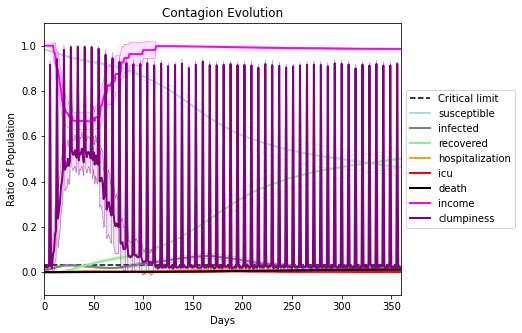

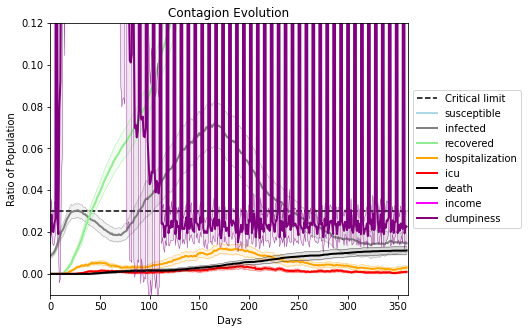

In [39]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.6
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[3795, 1544, 6394, 7954, 8106, 8441, 8796, 5635, 3183, 5749, 374, 293, 7760, 6298, 6515, 9486, 7762, 1930, 6053, 5639]
Average similarity between family members is 0.25885157120161195 at temperature -0.5
Average similarity between family and home is 0.9998572289866222 at temperature -1
Average similarity between students and their classroom is 0.14046316522404656 at temperature -0.5
Average classroom occupancy is 4.028169014084507 and number classrooms is 71
Average similarity between workers is 0.15956324500875485 at temperature -0.5
Average office occupancy is 3.3034825870646767 and number offices is 201
Average friend similarity for adults: 0.32917628668892607 for kids: 0.1963130083543727
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
H

avg restaurant similarity 0.1135892250113024
avg restaurant similarity 0.06980835503971203
avg restaurant similarity 0.07692878077546612
avg restaurant similarity 0.027073948444775536
avg restaurant similarity 0.05245376397568583
avg restaurant similarity 0.09135579659082188
avg restaurant similarity 0.058933520201378264
avg restaurant similarity 0.0811320281998708
avg restaurant similarity 0.08507918476762662
avg restaurant similarity 0.05659047230686947
avg restaurant similarity 0.0806838355472776
avg restaurant similarity 0.035788302160786455
avg restaurant similarity 0.028697446271420127
avg restaurant similarity 0.02197865196171797
avg restaurant similarity 0.06355984576162266
avg restaurant similarity 0.054595276453089404
avg restaurant similarity 0.0550641975493317
avg restaurant similarity 0.024177863835270333
avg restaurant similarity -0.024591655020651654
avg restaurant similarity 0.022567117371961258
avg restaurant similarity 0.05456537222338859
avg restaurant similarity 0.0

avg restaurant similarity 0.10341654263426069
avg restaurant similarity 0.06930846433269104
avg restaurant similarity 0.061549075004801175
avg restaurant similarity 0.06802246815570533
avg restaurant similarity 0.053751415959841585
avg restaurant similarity 0.060258057943179934
avg restaurant similarity 0.05022672378673526
avg restaurant similarity 0.11013286463439753
avg restaurant similarity 0.030844570514153617
avg restaurant similarity 0.11225609468680665
avg restaurant similarity 0.08183493226775261
avg restaurant similarity 0.09110351684527938
avg restaurant similarity 0.06931512056016569
avg restaurant similarity 0.045980543743654456
avg restaurant similarity 0.07816728609421225
avg restaurant similarity 0.0576501652513868
avg restaurant similarity 0.06432497736492157
avg restaurant similarity 0.1232498648077004
avg restaurant similarity 0.06190732871044646
avg restaurant similarity 0.07689523175283461
avg restaurant similarity 0.07667938458675219
avg restaurant similarity 0.028

avg restaurant similarity 0.0673197877721207
avg restaurant similarity 0.0805727526265232
avg restaurant similarity 0.014790803710780205
avg restaurant similarity 0.05844788427097263
avg restaurant similarity 0.0365428801648711
avg restaurant similarity 0.004304119177858249
avg restaurant similarity 0.15282629454555274
avg restaurant similarity 0.014906887104773944
avg restaurant similarity 0.03879672499465507
avg restaurant similarity 0.048914371964711205
avg restaurant similarity 0.07725551408564639
avg restaurant similarity 0.08284357645074232
avg restaurant similarity 0.11604301923132698
avg restaurant similarity 0.03594829572337306
avg restaurant similarity 0.09279471338285826
avg restaurant similarity 0.08874969794951641
avg restaurant similarity 0.06228744259071162
avg restaurant similarity 0.037156811174017874
avg restaurant similarity 0.042256475775041616
avg restaurant similarity 0.0728493505601381
avg restaurant similarity 0.030928880678262573
avg restaurant similarity 0.041

avg restaurant similarity 0.10344715337099124
avg restaurant similarity 0.02923702277573072
avg restaurant similarity 0.04247467250356955
avg restaurant similarity -0.0008811088741245616
avg restaurant similarity 0.08116266820849694
avg restaurant similarity 0.09551772840907488
avg restaurant similarity 0.061769812188926736
avg restaurant similarity 0.024118693643452763
avg restaurant similarity 0.0965766402547449
avg restaurant similarity 0.05435815314578508
avg restaurant similarity 0.020383602194883405
avg restaurant similarity 0.09684326179198889
avg restaurant similarity 0.0689855003287862
avg restaurant similarity 0.06879226804108676
avg restaurant similarity 0.09199713278518624
avg restaurant similarity 0.060218793855740235
avg restaurant similarity 0.005003543972619127
avg restaurant similarity 0.11765615752715455
avg restaurant similarity 0.0848923629391191
avg restaurant similarity 0.06819748047053455
avg restaurant similarity 0.08209397475164716
avg restaurant similarity 0.1

avg restaurant similarity 0.07692029149257155
avg restaurant similarity 0.07045154422456971
avg restaurant similarity 0.08643906163065888
avg restaurant similarity 0.11754706484465931
avg restaurant similarity 0.0597572358065172
avg restaurant similarity 0.02700987682934169
avg restaurant similarity 0.09388307094654345
avg restaurant similarity 0.12217558212122596
avg restaurant similarity 0.05123679365049959
avg restaurant similarity 0.051990129947436854
avg restaurant similarity 0.05915211277454704
avg restaurant similarity 0.025041616248621123
avg restaurant similarity 0.023658136625266092
avg restaurant similarity 0.030632402530903578
avg restaurant similarity 0.06995618279089533
avg restaurant similarity 0.04423851243009852
avg restaurant similarity 0.05340575718083505
avg restaurant similarity 0.06639903032949103
avg restaurant similarity 0.012093599756636264
avg restaurant similarity 0.058927688901341514
avg restaurant similarity 0.10753509455395861
avg restaurant similarity 0.0

avg restaurant similarity 0.022673078081374844
avg restaurant similarity 0.08322661105439663
avg restaurant similarity 0.1042856784884258
avg restaurant similarity 0.05129946071822474
avg restaurant similarity 0.11289572385782697
avg restaurant similarity 0.06382315170621868
avg restaurant similarity 0.05944470992067137
avg restaurant similarity 0.06328501215003436
avg restaurant similarity 0.052155086085839845
avg restaurant similarity 0.0800541931718245
avg restaurant similarity 0.07008459310736549
avg restaurant similarity -0.003220341937598812
avg restaurant similarity 0.054174918938727716
avg restaurant similarity 0.04528928431050556
avg restaurant similarity 0.054171475767891955
avg restaurant similarity 0.07078160657610888
avg restaurant similarity 0.10465086125098019
avg restaurant similarity 0.06540990590611133
avg restaurant similarity 0.08452937696172498
avg restaurant similarity 0.051759041196189584
avg restaurant similarity 0.012490185243687744
avg restaurant similarity 0.

avg restaurant similarity 0.07269419551471713
avg restaurant similarity 0.0732067995629587
avg restaurant similarity 0.04289077165529967
avg restaurant similarity 0.07035517795585458
avg restaurant similarity 0.08679012872735767
avg restaurant similarity 0.04269004737578204
avg restaurant similarity 0.10949549103335866
avg restaurant similarity 0.09206917014432621
avg restaurant similarity 0.08363154197251216
avg restaurant similarity 0.06931940953875948
avg restaurant similarity 0.08587104249784949
avg restaurant similarity 0.05950756665038091
avg restaurant similarity 0.06788426904487219
avg restaurant similarity 0.06696824397453151
avg restaurant similarity 0.12587262643576463
avg restaurant similarity 0.05761508022802673
avg restaurant similarity 0.11061545067050094
avg restaurant similarity 0.05775005219697668
avg restaurant similarity 0.05133181760268557
avg restaurant similarity 0.06024098250469269
avg restaurant similarity -0.0017325417811514708
avg restaurant similarity 0.0654

avg restaurant similarity 0.09608040146873191
avg restaurant similarity 0.0587679952659442
avg restaurant similarity 0.0681496831657136
avg restaurant similarity 0.056421350929498786
avg restaurant similarity 0.11528465698436353
avg restaurant similarity 0.08265935803750156
avg restaurant similarity 0.06240892265051368
avg restaurant similarity 0.05300448256814594
avg restaurant similarity 0.06028676472456649
avg restaurant similarity 0.10478614105115892
avg restaurant similarity 0.13514235996222443
avg restaurant similarity 0.06381857800293127
avg restaurant similarity 0.09535968820353918
avg restaurant similarity 0.06713036069487673
avg restaurant similarity 0.08201979643726916
avg restaurant similarity 0.062268872353308864
avg restaurant similarity 0.06307505853578127
avg restaurant similarity 0.0690747680863412
avg restaurant similarity 0.05494431121081999
avg restaurant similarity 0.0771426593319108
avg restaurant similarity 0.07087840019877295
avg restaurant similarity 0.02830118

avg restaurant similarity 0.04648594220789694
avg restaurant similarity 0.09278449071045633
avg restaurant similarity 0.037907448402905566
avg restaurant similarity 0.05890955627292203
avg restaurant similarity -0.010203894032416885
avg restaurant similarity 0.030687574924507226
avg restaurant similarity 0.013786785738643345
avg restaurant similarity 0.055285087560315506
avg restaurant similarity 0.026521178119788866
avg restaurant similarity 0.07996264490704004
avg restaurant similarity -0.01053951626551715
avg restaurant similarity 0.04036326663001294
avg restaurant similarity 0.037923063684118366
avg restaurant similarity 0.09830167370747177
avg restaurant similarity 0.10611394034602854
avg restaurant similarity 0.044157877777715904
avg restaurant similarity -0.0229206661279329
avg restaurant similarity 0.005505369108258988
avg restaurant similarity 0.03153248154335551
avg restaurant similarity 0.11567143488014499
avg restaurant similarity 0.06199125708052588
avg restaurant similari

avg restaurant similarity -0.03286451547151802
avg restaurant similarity 0.04280037730224791
avg restaurant similarity 0.07331230155670186
avg restaurant similarity 0.08327799972814486
avg restaurant similarity 0.11444437159578573
avg restaurant similarity 0.06207001511197771
avg restaurant similarity 0.04874064725925589
avg restaurant similarity 0.05843614204404997
avg restaurant similarity 0.07715076438973856
avg restaurant similarity 0.09133001689680505
avg restaurant similarity 0.04671734227626389
avg restaurant similarity 0.08375730838474106
avg restaurant similarity -0.007194644981861645
avg restaurant similarity 0.06293922484900523
avg restaurant similarity 0.0565073135911796
avg restaurant similarity 0.03512000275407594
avg restaurant similarity 0.034405434163261514
avg restaurant similarity 0.04836381170715639
avg restaurant similarity 0.05195167798223332
avg restaurant similarity 0.025059869116877607
avg restaurant similarity 0.02129906469013906
avg restaurant similarity 0.08

avg restaurant similarity 0.06647783198861164
avg restaurant similarity 0.05759051042726251
avg restaurant similarity 0.07738079261052179
avg restaurant similarity 0.0988564469578028
avg restaurant similarity 0.0968117183969119
avg restaurant similarity 0.0628921603509839
avg restaurant similarity 0.07508174017900394
avg restaurant similarity 0.07236303120629774
avg restaurant similarity 0.039169115944396704
avg restaurant similarity 0.0668310155640136
avg restaurant similarity 0.0933596463028771
avg restaurant similarity 0.08614642822747699
avg restaurant similarity 0.0649043848903324
avg restaurant similarity 0.10634006775320125
avg restaurant similarity 0.040980225528028
avg restaurant similarity 0.07823098505944837
avg restaurant similarity 0.08693431396693709
avg restaurant similarity 0.09482930798703246
avg restaurant similarity 0.14337620075808002
avg restaurant similarity 0.048291650906913126
avg restaurant similarity 0.09914772607016781
avg restaurant similarity 0.072909371546

avg restaurant similarity 0.02309617802108418
avg restaurant similarity 0.04991640155209272
avg restaurant similarity 0.06470657398791534
avg restaurant similarity 0.0493920447187377
avg restaurant similarity 0.06431369021366704
avg restaurant similarity 0.09420773558451204
avg restaurant similarity 0.12394979738396107
avg restaurant similarity 0.06571973303861947
avg restaurant similarity 0.05202284150498862
avg restaurant similarity 0.0548699612107385
avg restaurant similarity 0.08362073633048402
avg restaurant similarity 0.052757030371682126
avg restaurant similarity 0.03819943835763773
avg restaurant similarity 0.1295637640542234
avg restaurant similarity 0.07005123542651145
avg restaurant similarity 0.10684576320788118
avg restaurant similarity 0.13141172835049852
avg restaurant similarity 0.08201154957338544
avg restaurant similarity 0.05380118913876066
avg restaurant similarity 0.0842908743245591
avg restaurant similarity 0.0986399313956958
avg restaurant similarity 0.0494784944

avg restaurant similarity 0.10310392365240517
avg restaurant similarity 0.05892619957567121
avg restaurant similarity 0.029693489946429973
avg restaurant similarity 0.0657205936454562
avg restaurant similarity 0.07063103081021313
avg restaurant similarity 0.04222948261820631
avg restaurant similarity 0.10327986185795625
avg restaurant similarity 0.08853058714042578
avg restaurant similarity 0.06934065860523009
avg restaurant similarity 0.06652247864147574
avg restaurant similarity 0.019543217060145737
avg restaurant similarity 0.032193784441621985
avg restaurant similarity 0.06520485583431611
avg restaurant similarity 0.056795714898350544
avg restaurant similarity 0.0727094556094895
avg restaurant similarity 0.05357273269061633
avg restaurant similarity 0.07256979307576204
avg restaurant similarity 0.060451575517198035
avg restaurant similarity 0.08057997475802045
avg restaurant similarity 0.05752787045425391
avg restaurant similarity 0.05079568280545471
avg restaurant similarity 0.105

avg restaurant similarity 0.03991237480123684
avg restaurant similarity 0.06715058113039196
avg restaurant similarity 0.04639681960391292
avg restaurant similarity 0.09099917614843256
avg restaurant similarity 0.0408155568854988
avg restaurant similarity 0.04773273937730451
avg restaurant similarity 0.1130184610580211
avg restaurant similarity 0.08815473820849731
avg restaurant similarity 0.05385108852920268
avg restaurant similarity 0.03617729707465712
avg restaurant similarity 0.013030152656084627
avg restaurant similarity 0.08564161025938229
avg restaurant similarity 0.015335255419613742
avg restaurant similarity 0.03227709932916261
avg restaurant similarity 0.04345758081792436
avg restaurant similarity 0.06492778305025056
avg restaurant similarity 0.08259203700871619
avg restaurant similarity 0.051090322894247905
avg restaurant similarity 0.0896867556905573
avg restaurant similarity 0.06065623832827939
avg restaurant similarity 0.04331057210944699
avg restaurant similarity 0.109304

avg restaurant similarity 0.03850961129973918
avg restaurant similarity 0.10093179613416682
avg restaurant similarity 0.049914306093717
avg restaurant similarity 0.0713115736083092
avg restaurant similarity 0.0385846735586752
avg restaurant similarity 0.04027138379007679
avg restaurant similarity 0.08277248154244733
avg restaurant similarity 0.03445758963771616
avg restaurant similarity 0.10305737393377364
avg restaurant similarity 0.06958721614210828
avg restaurant similarity 0.06483769285217467
avg restaurant similarity 0.016425645830478883
avg restaurant similarity 0.0922350496052806
avg restaurant similarity 0.11038020339500901
avg restaurant similarity 0.058097893195112195
avg restaurant similarity 0.03936905961405678
avg restaurant similarity 0.09578659438661381
avg restaurant similarity 0.09232361386043567
avg restaurant similarity 0.07618772353789914
avg restaurant similarity 0.12516847528054945
avg restaurant similarity 0.07865025856509635
avg restaurant similarity 0.077471644

avg restaurant similarity 0.06602871833872716
avg restaurant similarity 0.015827362921058075
avg restaurant similarity 0.07855033479458627
avg restaurant similarity 0.046691821183550884
avg restaurant similarity 0.0010635916735108977
avg restaurant similarity 0.01032083602190538
avg restaurant similarity 0.04280549108747906
avg restaurant similarity 0.03262870089150559
avg restaurant similarity 0.11436748265943292
avg restaurant similarity 0.04164566475128313
avg restaurant similarity 0.0620808733077605
avg restaurant similarity 0.10525701146727898
avg restaurant similarity 0.07215580795888162
avg restaurant similarity 0.01196870148395146
avg restaurant similarity 0.04429564247792077
avg restaurant similarity 0.03803879940771521
avg restaurant similarity 0.0767240973368055
avg restaurant similarity 0.08573232844082071
avg restaurant similarity 0.05978066452858669
avg restaurant similarity 0.064955651491244
avg restaurant similarity 0.044878191884768825
avg restaurant similarity 0.07024

avg restaurant similarity 0.07037325605677988
avg restaurant similarity 0.06298303440395413
avg restaurant similarity 0.07191543823654682
avg restaurant similarity 0.04149318874954487
avg restaurant similarity 0.0694696065284425
avg restaurant similarity 0.09559757401988134
avg restaurant similarity 0.055773958317086134
avg restaurant similarity 0.08144544140161354
avg restaurant similarity 0.053390642097408465
avg restaurant similarity 0.07201891185862547
avg restaurant similarity 0.0710164092942619
avg restaurant similarity 0.09665384819314453
avg restaurant similarity 0.08577995278076585
avg restaurant similarity 0.05665571703645623
avg restaurant similarity 0.08449076339814507
avg restaurant similarity 0.053867857409861726
avg restaurant similarity 0.06754753688946062
avg restaurant similarity 0.06879005661521494
avg restaurant similarity 0.0863321924745462
avg restaurant similarity 0.03415691728380086
avg restaurant similarity 0.02118457655447159
avg restaurant similarity 0.070203

avg restaurant similarity 0.09785021181623882
avg restaurant similarity 0.08827296252446865
avg restaurant similarity 0.06556532567750331
avg restaurant similarity 0.07591778954426442
avg restaurant similarity 0.0960054765525336
avg restaurant similarity 0.045061121491700024
avg restaurant similarity 0.0770545502300758
avg restaurant similarity 0.10768591435864429
avg restaurant similarity 0.03067736997345807
avg restaurant similarity 0.06349853855050305
avg restaurant similarity 0.08266992308917408
avg restaurant similarity 0.03512449295002923
avg restaurant similarity 0.018636924744274818
avg restaurant similarity 0.07044019593984738
avg restaurant similarity 0.05249227020585383
avg restaurant similarity 0.05545706236243682
avg restaurant similarity 0.06476421278389223
avg restaurant similarity 0.021208764460479965
avg restaurant similarity 0.06489146917712586
avg restaurant similarity 0.05281323797671442
avg restaurant similarity 0.09159841280413639
avg restaurant similarity 0.08934

avg restaurant similarity 0.06548875004282768
avg restaurant similarity 0.09942906957276054
avg restaurant similarity 0.08440705626041776
avg restaurant similarity 0.015583816327027074
avg restaurant similarity 0.06986332953378295
avg restaurant similarity 0.08989800834144934
avg restaurant similarity 0.074659329244022
avg restaurant similarity 0.06643557477070332
avg restaurant similarity 0.06646102446742677
avg restaurant similarity 0.0805690079522263
avg restaurant similarity 0.07490305775369291
avg restaurant similarity 0.0871492103494343
avg restaurant similarity 0.0607261953873381
avg restaurant similarity 0.09156053894689475
avg restaurant similarity 0.07991774932546275
avg restaurant similarity 0.07732704678937523
avg restaurant similarity 0.08219906430452428
avg restaurant similarity 0.06939649247389675
avg restaurant similarity 0.05872663340371248
avg restaurant similarity 0.08121375910363003
avg restaurant similarity 0.07876688689208966
avg restaurant similarity 0.0997428735

avg restaurant similarity 0.05515254591200652
avg restaurant similarity 0.09953668441458083
avg restaurant similarity 0.026612500998548
avg restaurant similarity 0.06505492421373056
avg restaurant similarity 0.10931630515171241
avg restaurant similarity 0.060268796520066205
avg restaurant similarity 0.10493274094149611
avg restaurant similarity 0.10985148082774926
avg restaurant similarity 0.0376238650415058
avg restaurant similarity 0.029136903601559353
avg restaurant similarity 0.05228020656997613
avg restaurant similarity 0.07862285969880155
avg restaurant similarity 0.06285831493897968
avg restaurant similarity 0.06219772525798938
avg restaurant similarity 0.09083560852333444
avg restaurant similarity 0.04315491445077436
avg restaurant similarity 0.049396966755968094
avg restaurant similarity 0.06469809975913705
avg restaurant similarity 0.06788520501376531
avg restaurant similarity 0.11517720115249411
avg restaurant similarity 0.08314435364468174
avg restaurant similarity 0.078279

avg restaurant similarity 0.06572373804935845
avg restaurant similarity 0.09217963251967852
avg restaurant similarity 0.06655851447148267
avg restaurant similarity 0.11637245883383647
avg restaurant similarity 0.03617832149293453
avg restaurant similarity 0.09687989886252449
avg restaurant similarity 0.06960338283350832
avg restaurant similarity 0.09222129659004633
avg restaurant similarity 0.09625945535916501
avg restaurant similarity 0.09300018008049273
avg restaurant similarity 0.06775386016389172
avg restaurant similarity 0.12654076306971127
avg restaurant similarity 0.11724031679656195
avg restaurant similarity 0.11540975706550317
avg restaurant similarity 0.09206799769942842
avg restaurant similarity 0.0828734416919371
avg restaurant similarity 0.0895741105312194
avg restaurant similarity 0.13115447814924389
avg restaurant similarity 0.1296890840086975
avg restaurant similarity 0.09484739633799057
avg restaurant similarity 0.1085452833060294
avg restaurant similarity 0.0730925352

avg restaurant similarity 0.03674217277061957
avg restaurant similarity 0.062405072182051005
avg restaurant similarity 0.11975454264240484
avg restaurant similarity 0.10793946514125358
avg restaurant similarity 0.09871894961464078
avg restaurant similarity 0.10774208528269381
avg restaurant similarity 0.05153444567971001
avg restaurant similarity 0.10938683683600524
avg restaurant similarity 0.10452878428884405
avg restaurant similarity 0.1059601878065742
avg restaurant similarity 0.08920084853755565
avg restaurant similarity 0.08983608149122942
avg restaurant similarity 0.10039909249866247
avg restaurant similarity 0.05390688745521524
avg restaurant similarity 0.0738067317123753
avg restaurant similarity 0.03899753741636476
avg restaurant similarity 0.09768895457884755
avg restaurant similarity 0.07145086210496294
avg restaurant similarity 0.08600659370673719
avg restaurant similarity 0.10728718548607001
avg restaurant similarity 0.10998519038829552
avg restaurant similarity 0.0936792

avg restaurant similarity 0.09110748794579061
avg restaurant similarity 0.08276203608306644
avg restaurant similarity 0.1180944551797843
avg restaurant similarity 0.04073052473891046
avg restaurant similarity 0.03709900392523161
avg restaurant similarity 0.06823352586114778
avg restaurant similarity 0.05546979412778935
avg restaurant similarity 0.11608905144971576
avg restaurant similarity 0.05811986071941109
avg restaurant similarity 0.05315718406489853
avg restaurant similarity 0.07101354962362427
avg restaurant similarity 0.07254170204509439
avg restaurant similarity 0.10460356786031867
avg restaurant similarity 0.10551958492508486
avg restaurant similarity 0.10618702298901316
avg restaurant similarity 0.08993440044246553
avg restaurant similarity 0.1083359636970209
avg restaurant similarity 0.0656642265931427
avg restaurant similarity 0.0805483603976427
avg restaurant similarity 0.09840624816581124
avg restaurant similarity 0.04990701480950348
avg restaurant similarity 0.1031655904

avg restaurant similarity 0.05197734744649958
avg restaurant similarity 0.12339277928172848
avg restaurant similarity 0.0855949873249563
avg restaurant similarity 0.08528641828750798
avg restaurant similarity 0.1554774603931262
avg restaurant similarity 0.10765080227159836
avg restaurant similarity 0.07069376614487373
avg restaurant similarity 0.08458936589008603
avg restaurant similarity 0.10981853711598417
avg restaurant similarity 0.13298993480177027
avg restaurant similarity 0.08866276311649725
avg restaurant similarity 0.0960372062182008
avg restaurant similarity 0.08306674965146817
avg restaurant similarity 0.11085894988686239
avg restaurant similarity 0.049507882860007374
avg restaurant similarity 0.08751972704802242
avg restaurant similarity 0.12732401188131626
avg restaurant similarity 0.07199835710476526
avg restaurant similarity 0.0607514914401575
avg restaurant similarity 0.12821621987451937
avg restaurant similarity 0.028754494554321056
avg restaurant similarity 0.08123152

avg restaurant similarity 0.10610295047680553
avg restaurant similarity 0.13044091380491962
avg restaurant similarity 0.12345495981057023
avg restaurant similarity 0.16259632876388283
avg restaurant similarity 0.14892119950428434
avg restaurant similarity 0.06547446662759863
avg restaurant similarity 0.08896613144588404
avg restaurant similarity 0.12066031753157473
avg restaurant similarity 0.13262708904030812
avg restaurant similarity 0.12136634875100856
avg restaurant similarity 0.11436703646506853
avg restaurant similarity 0.0620418256467307
avg restaurant similarity 0.08222225613213988
avg restaurant similarity 0.0719327655367231
avg restaurant similarity 0.13674822885134003
avg restaurant similarity 0.027566087131120874
avg restaurant similarity 0.1240879248017418
avg restaurant similarity 0.09009061102672433
avg restaurant similarity 0.09108216016564302
avg restaurant similarity 0.1330840174987302
avg restaurant similarity 0.11549725214636485
avg restaurant similarity 0.080563610

avg restaurant similarity 0.10632663445710878
avg restaurant similarity 0.1359314978702103
avg restaurant similarity 0.11766390140679145
avg restaurant similarity 0.09927171333133515
avg restaurant similarity 0.12990728825326042
avg restaurant similarity 0.08616922987345906
avg restaurant similarity 0.104217303206214
avg restaurant similarity 0.0634959818062955
avg restaurant similarity 0.08278271148791529
avg restaurant similarity 0.15157086846393505
avg restaurant similarity 0.12323801507402901
avg restaurant similarity 0.1032336887771502
avg restaurant similarity 0.14645857073980914
avg restaurant similarity 0.11042525613904028
avg restaurant similarity 0.09924516997437866
avg restaurant similarity 0.0686531283292017
avg restaurant similarity 0.08687575381155171
avg restaurant similarity 0.0953059752792258
avg restaurant similarity 0.11303501064164649
avg restaurant similarity 0.09002238840104936
avg restaurant similarity 0.07499816631615393
avg restaurant similarity 0.0719850136220

avg restaurant similarity 0.11044123641345119
avg restaurant similarity 0.05878093987920381
avg restaurant similarity 0.06598146402235766
avg restaurant similarity 0.09875902795002388
avg restaurant similarity 0.07737984801477772
avg restaurant similarity 0.07070515352443907
avg restaurant similarity 0.03290132886013611
avg restaurant similarity 0.06146168231636223
avg restaurant similarity 0.06028880560051559
avg restaurant similarity 0.04157453861531055
avg restaurant similarity 0.08705687242520037
avg restaurant similarity 0.03696140738440051
avg restaurant similarity 0.07613861808361617
avg restaurant similarity 0.05334320221960915
avg restaurant similarity 0.07696517694858994
avg restaurant similarity 0.06288123020415849
avg restaurant similarity 0.09944372812957389
avg restaurant similarity 0.10470208619217007
avg restaurant similarity 0.06777307107495051
avg restaurant similarity 0.04931074625827087
avg restaurant similarity 0.07419798001331392
avg restaurant similarity 0.058167

avg restaurant similarity 0.06827805175274582
avg restaurant similarity 0.06988945554497018
avg restaurant similarity 0.05125672914864717
avg restaurant similarity 0.07704808320061343
avg restaurant similarity 0.06100296700892448
avg restaurant similarity 0.06685536047334475
avg restaurant similarity 0.09125054646772703
avg restaurant similarity 0.037334137587301565
avg restaurant similarity 0.06840351139529324
avg restaurant similarity 0.028361258065835112
avg restaurant similarity 0.05045220857180771
avg restaurant similarity 0.07200649137830005
avg restaurant similarity 0.0662338335154414
avg restaurant similarity 0.09588266826243494
avg restaurant similarity 0.11173994052812858
avg restaurant similarity 0.07267692282957666
avg restaurant similarity 0.06319615235758494
avg restaurant similarity 0.06301705890958507
avg restaurant similarity 0.07042252528791487
avg restaurant similarity 0.0763902514381774
avg restaurant similarity 0.008001984482287111
avg restaurant similarity -0.0106

avg restaurant similarity 0.09123943937239709
avg restaurant similarity 0.021839813813559407
avg restaurant similarity 0.11394256685543729
avg restaurant similarity 0.05400446197181413
avg restaurant similarity 0.07620016775100716
avg restaurant similarity 0.06904462015321054
avg restaurant similarity 0.08720137196534626
avg restaurant similarity 0.05836831846547705
avg restaurant similarity 0.04035946617786193
avg restaurant similarity 0.04308442810681051
avg restaurant similarity 0.05544425978754674
avg restaurant similarity 0.048590888710697736
avg restaurant similarity 0.06837629968786986
avg restaurant similarity 0.07444125829441357
avg restaurant similarity 0.07711332817442113
avg restaurant similarity 0.06773907099001823
avg restaurant similarity 0.07214281137527676
avg restaurant similarity 0.06206474821362703
avg restaurant similarity 0.05997512797835359
avg restaurant similarity 0.050843857839540485
avg restaurant similarity 0.04898034775591112
avg restaurant similarity 0.058

avg restaurant similarity 0.052819875737211204
avg restaurant similarity 0.09942079905128862
avg restaurant similarity 0.07078353239872623
avg restaurant similarity 0.055494202496727436
avg restaurant similarity 0.09011928796700795
avg restaurant similarity 0.059976069688616636
avg restaurant similarity 0.07109583598906748
avg restaurant similarity 0.07119792760699886
avg restaurant similarity 0.07161770480000962
avg restaurant similarity 0.047006429303433024
avg restaurant similarity 0.04034702593297447
avg restaurant similarity 0.03828223073592927
avg restaurant similarity 0.09068431996941195
avg restaurant similarity 0.06434715256376018
avg restaurant similarity 0.0811861197956834
avg restaurant similarity 0.0909773925745194
avg restaurant similarity 0.057401703234715155
avg restaurant similarity 0.07301885857444657
avg restaurant similarity 0.06061704232859094
avg restaurant similarity 0.06325373454247891
avg restaurant similarity 0.08351219653377613
avg restaurant similarity 0.017

avg restaurant similarity 0.10620454389206944
avg restaurant similarity 0.08115760840379953
avg restaurant similarity 0.1186216062787224
avg restaurant similarity 0.09121878810246646
avg restaurant similarity 0.09508762157586124
avg restaurant similarity 0.05463260292219105
avg restaurant similarity 0.09004407598241085
avg restaurant similarity 0.06022699401297812
avg restaurant similarity 0.11861546249466315
avg restaurant similarity 0.06861577869219986
avg restaurant similarity 0.09466761820433714
avg restaurant similarity 0.08695808726192734
avg restaurant similarity 0.07747699924428043
avg restaurant similarity -0.0054775758333231485
avg restaurant similarity 0.014415071862637546
avg restaurant similarity 0.07760419059295888
avg restaurant similarity 0.06920260223821502
avg restaurant similarity 0.0661479024061836
avg restaurant similarity 0.10285448480112123
avg restaurant similarity 0.0932530886505097
avg restaurant similarity 0.10057308533869269
avg restaurant similarity 0.05073

avg restaurant similarity 0.1110085482886621
avg restaurant similarity 0.056052093670626475
avg restaurant similarity 0.0824705479854796
avg restaurant similarity 0.06153711984383941
avg restaurant similarity 0.07504573819935234
avg restaurant similarity 0.04317763415026367
avg restaurant similarity 0.09037342317970794
avg restaurant similarity 0.057724070363489956
avg restaurant similarity 0.05229865669813973
avg restaurant similarity 0.05772721787196897
avg restaurant similarity 0.026115416776357463
avg restaurant similarity 0.10215998535019045
avg restaurant similarity 0.1508222269192528
avg restaurant similarity 0.06281276700848454
avg restaurant similarity 0.09262983812181987
avg restaurant similarity 0.05801507767224561
avg restaurant similarity 0.09679484035372522
avg restaurant similarity 0.11934973574602319
avg restaurant similarity 0.10195725872108309
avg restaurant similarity 0.04602462262259832
avg restaurant similarity 0.10724012822077207
avg restaurant similarity 0.034990

avg restaurant similarity 0.03633733521684129
avg restaurant similarity 0.08455084486437063
avg restaurant similarity 0.03204950302219136
avg restaurant similarity 0.09455459659943963
avg restaurant similarity 0.09265182783581578
avg restaurant similarity 0.07192667668543819
avg restaurant similarity 0.07033763163506068
avg restaurant similarity 0.08637166432270967
avg restaurant similarity 0.07731020591879581
avg restaurant similarity 0.0820147164786634
avg restaurant similarity 0.12004577030558676
avg restaurant similarity 0.09130062018329116
avg restaurant similarity 0.01391192857371772
avg restaurant similarity 0.08865268429316939
avg restaurant similarity 0.10685289936327418
avg restaurant similarity 0.08424700161214857
avg restaurant similarity 0.11535358347275924
avg restaurant similarity 0.06250660122963292
avg restaurant similarity 0.06929005860247726
avg restaurant similarity 0.13448385064406965
avg restaurant similarity 0.08039274789947852
avg restaurant similarity 0.0995154

avg restaurant similarity 0.0616810661078528
avg restaurant similarity 0.07495948134160146
avg restaurant similarity 0.08113508472625759
avg restaurant similarity 0.07042528033370196
avg restaurant similarity 0.08119575191672306
avg restaurant similarity 0.060993637621304185
avg restaurant similarity 0.07227299303935085
avg restaurant similarity 0.05542398043573878
avg restaurant similarity 0.07288661184724227
avg restaurant similarity 0.07322558838847242
avg restaurant similarity 0.11808539176519647
avg restaurant similarity 0.08327902571452098
avg restaurant similarity 0.12648079845662857
avg restaurant similarity 0.08580098200758149
avg restaurant similarity 0.0809176755462377
avg restaurant similarity 0.09711604857450067
avg restaurant similarity 0.023084969734303917
avg restaurant similarity 0.08344044509215827
avg restaurant similarity 0.05340932447906647
avg restaurant similarity 0.06725273410215771
avg restaurant similarity 0.054357117587781854
avg restaurant similarity 0.03860

avg restaurant similarity 0.07574822490249998
avg restaurant similarity 0.08776518500379284
avg restaurant similarity 0.11461009215523187
avg restaurant similarity 0.07077814136253015
avg restaurant similarity 0.12241415412835135
avg restaurant similarity 0.11650434971891874
avg restaurant similarity 0.07467061284310363
avg restaurant similarity 0.13243998890324762
avg restaurant similarity 0.10171193955000264
avg restaurant similarity 0.05220425564646454
avg restaurant similarity 0.07195373503773356
avg restaurant similarity 0.042004445538954126
avg restaurant similarity 0.10062056686510475
avg restaurant similarity 0.06278199773216431
avg restaurant similarity 0.08679792075583825
avg restaurant similarity 0.05201034405084242
avg restaurant similarity 0.0756372434174515
avg restaurant similarity 0.05154675875262823
avg restaurant similarity 0.06399440170899026
avg restaurant similarity 0.05580050483397904
avg restaurant similarity 0.09058940171571081
avg restaurant similarity 0.055769

avg restaurant similarity 0.049585009168784756
avg restaurant similarity 0.11015562705624551
avg restaurant similarity 0.12536745861591309
avg restaurant similarity 0.10299696904455195
avg restaurant similarity 0.12229990227361877
avg restaurant similarity 0.0814465896196915
avg restaurant similarity 0.06420494858942738
avg restaurant similarity 0.07748142681789277
avg restaurant similarity 0.045723509791329116
avg restaurant similarity 0.04417814699266419
avg restaurant similarity 0.09922538533147043
avg restaurant similarity 0.09243013400023103
avg restaurant similarity 0.05970590015891707
avg restaurant similarity 0.09255654510718643
avg restaurant similarity 0.11004230346857649
avg restaurant similarity 0.09196585999961826
avg restaurant similarity 0.10376337997508184
avg restaurant similarity 0.09610854088912833
avg restaurant similarity 0.11332002258241713
avg restaurant similarity 0.055220481578492714
avg restaurant similarity 0.06007165921687934
avg restaurant similarity 0.0728

avg restaurant similarity 0.04799681052874682
avg restaurant similarity 0.07609165266027157
avg restaurant similarity 0.04135543752904663
avg restaurant similarity 0.09290597276808511
avg restaurant similarity 0.05157045816566986
avg restaurant similarity 0.08921833887456904
avg restaurant similarity 0.08937597553236379
avg restaurant similarity 0.05279804737856135
avg restaurant similarity 0.0955714878273884
avg restaurant similarity 0.11172515752825125
avg restaurant similarity 0.07146716323563976
avg restaurant similarity 0.12953650769706668
avg restaurant similarity 0.07922600760103904
avg restaurant similarity 0.0858109388032992
avg restaurant similarity 0.07983427570803278
avg restaurant similarity 0.11104198177396096
avg restaurant similarity 0.10470679547498347
avg restaurant similarity 0.10779373632639919
avg restaurant similarity 0.1018347151752152
avg restaurant similarity 0.07750378847033082
avg restaurant similarity 0.09090043160843575
avg restaurant similarity 0.042659296

avg restaurant similarity 0.1271281111003426
avg restaurant similarity 0.13350628850715132
avg restaurant similarity 0.07260956139873785
avg restaurant similarity 0.07932566471374415
avg restaurant similarity 0.06712088330952301
avg restaurant similarity 0.03132507508300677
avg restaurant similarity 0.06116298284302847
avg restaurant similarity 0.0825653417746398
avg restaurant similarity 0.05926194400176689
avg restaurant similarity 0.024402267760819975
avg restaurant similarity 0.10030212257267414
avg restaurant similarity 0.11474616529262781
avg restaurant similarity 0.10911881207587563
avg restaurant similarity 0.1156769483116483
avg restaurant similarity 0.08503320445085662
avg restaurant similarity 0.07135087948568919
avg restaurant similarity 0.10232582760312944
avg restaurant similarity 0.11802333840973929
avg restaurant similarity 0.09975784912683072
avg restaurant similarity 0.11282423932382513
avg restaurant similarity 0.11796372600463577
avg restaurant similarity 0.04481936

avg restaurant similarity 0.10300405634737445
avg restaurant similarity 0.10550260769956556
avg restaurant similarity 0.08563736741061584
avg restaurant similarity 0.06462794892198774
avg restaurant similarity 0.07570220802050477
avg restaurant similarity 0.04724229999170458
avg restaurant similarity 0.10385741040717239
avg restaurant similarity 0.024473535352641806
avg restaurant similarity 0.0605571740834011
avg restaurant similarity 0.1036935088769095
avg restaurant similarity 0.0918350928804874
avg restaurant similarity 0.05940281956636426
avg restaurant similarity 0.08438157378090083
avg restaurant similarity 0.07529357695552794
avg restaurant similarity 0.08731557924872754
avg restaurant similarity 0.08406072540626927
avg restaurant similarity 0.11283866310947532
avg restaurant similarity 0.06957869277324699
avg restaurant similarity 0.12286002548111737
avg restaurant similarity 0.039443504684636234
avg restaurant similarity 0.12097513533116586
avg restaurant similarity 0.0400387

avg restaurant similarity 0.05626916246482171
avg restaurant similarity 0.059519444376359955
avg restaurant similarity 0.08439556841102862
avg restaurant similarity 0.10963762511032708
avg restaurant similarity 0.1316987389558543
avg restaurant similarity 0.06346659676713086
avg restaurant similarity 0.11374107240903933
avg restaurant similarity 0.08303155088966402
avg restaurant similarity 0.1045117398038208
avg restaurant similarity 0.09171871683891428
avg restaurant similarity 0.07711459807482643
avg restaurant similarity 0.07663287787097517
avg restaurant similarity 0.08789090810465848
avg restaurant similarity 0.05859152806319535
avg restaurant similarity 0.08418673062514077
avg restaurant similarity 0.08224300639672294
avg restaurant similarity 0.12597556687721115
avg restaurant similarity 0.046935340043623056
avg restaurant similarity 0.026904757308354135
avg restaurant similarity 0.08150156190253875
avg restaurant similarity 0.07570782362858847
avg restaurant similarity 0.08742

(<function dict.items>, <function dict.items>, <function dict.items>)

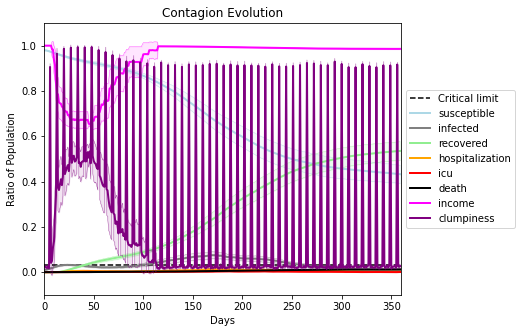

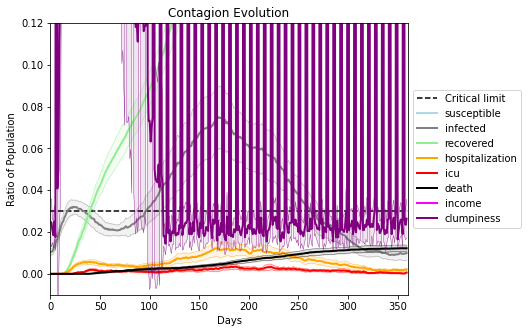

In [40]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.5
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[2500, 8379, 351, 4923, 2888, 948, 1808, 2002, 8776, 7908, 9797, 4701, 7749, 7443, 5355, 142, 1138, 6144, 2778, 8404]
Average similarity between family members is 0.23823784197612552 at temperature -0.4
Average similarity between family and home is 0.9998588596274732 at temperature -1
Average similarity between students and their classroom is 0.16104387370772552 at temperature -0.4
Average classroom occupancy is 4.208333333333333 and number classrooms is 72
Average similarity between workers is 0.16579101827347884 at temperature -0.4
Average office occupancy is 3.235 and number offices is 200
Average friend similarity for adults: 0.2860179399339432 for kids: 0.20683119482909906
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBu

avg restaurant similarity 0.0594361757932745
avg restaurant similarity 0.08697756358974297
avg restaurant similarity 0.09204232586539841
avg restaurant similarity 0.1182686877683982
avg restaurant similarity 0.1215974943338514
avg restaurant similarity 0.03542042052711563
avg restaurant similarity 0.06683215007282178
avg restaurant similarity 0.09928369188870424
avg restaurant similarity 0.06678346373658298
avg restaurant similarity 0.09482925898669406
avg restaurant similarity 0.04820380761180638
avg restaurant similarity 0.03548481153889856
avg restaurant similarity 0.02770233008144584
avg restaurant similarity 0.08110980949242445
avg restaurant similarity 0.09884244513470446
avg restaurant similarity 0.05081054930142645
avg restaurant similarity 0.10000986217745393
avg restaurant similarity 0.07009826471931167
avg restaurant similarity 0.0633190497899137
avg restaurant similarity 0.07792480648304655
avg restaurant similarity 0.03199820582342477
avg restaurant similarity 0.0094985182

avg restaurant similarity 0.05639699846951456
avg restaurant similarity 0.0964929280459661
avg restaurant similarity 0.13534591221880546
avg restaurant similarity 0.04896763165132713
avg restaurant similarity 0.06931248233388547
avg restaurant similarity 0.0673976134011353
avg restaurant similarity 0.04843227862838926
avg restaurant similarity 0.10579660124899833
avg restaurant similarity 0.09428442058976072
avg restaurant similarity 0.026875773407420207
avg restaurant similarity 0.04279176503424136
avg restaurant similarity 0.012715338996592362
avg restaurant similarity 0.11957076133588697
avg restaurant similarity 0.05166010528877836
avg restaurant similarity 0.0669763784997616
avg restaurant similarity 0.052626015893704664
avg restaurant similarity 0.08366892132572677
avg restaurant similarity 0.057326787627099585
avg restaurant similarity 0.05336356868199196
avg restaurant similarity 0.05426017840337856
avg restaurant similarity 0.11028964930658249
avg restaurant similarity 0.06114

avg restaurant similarity 0.0410882177101338
avg restaurant similarity 0.07613274633757083
avg restaurant similarity 0.06618144492069021
avg restaurant similarity 0.07143273550558453
avg restaurant similarity 0.09561651469617934
avg restaurant similarity 0.11253073380985588
avg restaurant similarity 0.04813737525432746
avg restaurant similarity 0.06988930761619755
avg restaurant similarity 0.08722956691695706
avg restaurant similarity 0.0940836171918916
avg restaurant similarity 0.12995856903116584
avg restaurant similarity 0.10661578061512723
avg restaurant similarity 0.005679233998737703
avg restaurant similarity 0.055353514757556205
avg restaurant similarity 0.0804264867340758
avg restaurant similarity 0.0008593915666631911
avg restaurant similarity 0.10456348993595148
avg restaurant similarity 0.05091084662003571
avg restaurant similarity 0.09224536336100637
avg restaurant similarity 0.08693602921534478
avg restaurant similarity 0.09468547520571603
avg restaurant similarity 0.14907

avg restaurant similarity 0.06096796496655692
avg restaurant similarity 0.03803645914682393
avg restaurant similarity 0.04455335846394503
avg restaurant similarity 0.07808245491941576
avg restaurant similarity 0.07121993394215008
avg restaurant similarity 0.07551018667318472
avg restaurant similarity 0.03622002243371547
avg restaurant similarity 0.09666924279682473
avg restaurant similarity 0.08310354781318327
avg restaurant similarity 0.06893032370707214
avg restaurant similarity 0.06417132200357915
avg restaurant similarity 0.11495151149508785
avg restaurant similarity 0.09147174095053333
avg restaurant similarity 0.06508023330644923
avg restaurant similarity 0.08335920693221335
avg restaurant similarity 0.07569557465573223
avg restaurant similarity 0.03798589123768855
avg restaurant similarity 0.07443188913914793
avg restaurant similarity 0.03659568233112743
avg restaurant similarity 0.11665570197307239
avg restaurant similarity 0.06949328399819574
avg restaurant similarity 0.026279

avg restaurant similarity 0.06879881440147301
avg restaurant similarity 0.052231079319652464
avg restaurant similarity 0.08400122742448754
avg restaurant similarity 0.07279668294163107
avg restaurant similarity 0.1141844465290475
avg restaurant similarity 0.07345413075289023
avg restaurant similarity 0.14317370363685056
avg restaurant similarity 0.06260755040425636
avg restaurant similarity 0.029960988022393494
avg restaurant similarity 0.10222176846522352
avg restaurant similarity 0.06686410585789422
avg restaurant similarity 0.10216356965459586
avg restaurant similarity 0.06876918325718712
avg restaurant similarity 0.0846183969868047
avg restaurant similarity 0.04809356774815265
avg restaurant similarity 0.04141327605988631
avg restaurant similarity 0.09332279794087125
avg restaurant similarity 0.054754626186041225
avg restaurant similarity 0.07218817429292557
avg restaurant similarity 0.03683158143319184
avg restaurant similarity 0.08060866010406138
avg restaurant similarity 0.09067

avg restaurant similarity 0.10843490321430702
avg restaurant similarity 0.09519311470769991
avg restaurant similarity 0.08639826427301203
avg restaurant similarity 0.07434890415065498
avg restaurant similarity 0.06902632645373746
avg restaurant similarity 0.12199200048406504
avg restaurant similarity 0.09721371111155397
avg restaurant similarity 0.06258034845403236
avg restaurant similarity 0.09084958914958513
avg restaurant similarity 0.12409342037330531
avg restaurant similarity 0.08874672538616303
avg restaurant similarity 0.09919654457454007
avg restaurant similarity 0.06798892698835926
avg restaurant similarity 0.09271129802963497
avg restaurant similarity 0.051432517153873356
avg restaurant similarity 0.07302082294458116
avg restaurant similarity 0.13750172755334308
avg restaurant similarity 0.1250251969269168
avg restaurant similarity 0.08521533723388904
avg restaurant similarity 0.09891357649123193
avg restaurant similarity 0.10362453501191297
avg restaurant similarity 0.096520

avg restaurant similarity 0.024786204390754917
avg restaurant similarity 0.0799150004811233
avg restaurant similarity 0.051426067520562016
avg restaurant similarity 0.09281580140278317
avg restaurant similarity 0.09749877174146503
avg restaurant similarity 0.09842621693084323
avg restaurant similarity 0.0696621238383845
avg restaurant similarity 0.10611916538265695
avg restaurant similarity 0.05366326825857986
avg restaurant similarity 0.07685213316485147
avg restaurant similarity 0.04903811693191775
avg restaurant similarity 0.10949541303751804
avg restaurant similarity 0.07065696346144781
avg restaurant similarity 0.11811759972527838
avg restaurant similarity 0.027667668696992456
avg restaurant similarity 0.07886871077600466
avg restaurant similarity 0.06546775596587519
avg restaurant similarity 0.06139122185883843
avg restaurant similarity 0.05461017502304554
avg restaurant similarity 0.08061326291027533
avg restaurant similarity 0.04729345836713136
avg restaurant similarity 0.08220

avg restaurant similarity 0.08915708529831672
avg restaurant similarity 0.08915868150500506
avg restaurant similarity 0.05624661105721594
avg restaurant similarity 0.08170778718215874
avg restaurant similarity 0.08507804526738318
avg restaurant similarity 0.09792495736663391
avg restaurant similarity 0.05462063004866767
avg restaurant similarity 0.08087908433670403
avg restaurant similarity 0.07780235088564073
avg restaurant similarity 0.06937129879189805
avg restaurant similarity 0.040654571789250714
avg restaurant similarity 0.06326757413348223
avg restaurant similarity 0.04937916468661432
avg restaurant similarity 0.03888609689958193
avg restaurant similarity 0.05875675277103381
avg restaurant similarity 0.11972338620207872
avg restaurant similarity 0.114054380780833
avg restaurant similarity 0.08800208240655158
avg restaurant similarity 0.04581657114915943
avg restaurant similarity 0.08657235650587347
avg restaurant similarity 0.09677306021909726
avg restaurant similarity 0.0913420

avg restaurant similarity 0.04082094618433312
avg restaurant similarity 0.03358131903766746
avg restaurant similarity 0.06881007709461275
avg restaurant similarity 0.06400321983486801
avg restaurant similarity 0.08420496147945786
avg restaurant similarity 0.07337959579439243
avg restaurant similarity 0.04237991143904743
avg restaurant similarity 0.05704892564926365
avg restaurant similarity 0.08018478554935063
avg restaurant similarity 0.014686962480982188
avg restaurant similarity 0.025240006003036577
avg restaurant similarity 0.048013718253621565
avg restaurant similarity 0.0055509758030049235
avg restaurant similarity 0.01694760062555865
avg restaurant similarity 9.582710662998247e-06
avg restaurant similarity 0.013288994827197193
avg restaurant similarity 0.03652319622625124
avg restaurant similarity 0.030269242875512813
avg restaurant similarity 0.07469973329752484
avg restaurant similarity 0.06420293726043565
avg restaurant similarity 0.05020214914898104
avg restaurant similarity

avg restaurant similarity 0.04313077907500091
avg restaurant similarity 0.06522338443578563
avg restaurant similarity 0.06058947033702255
avg restaurant similarity 0.08897906429650698
avg restaurant similarity 0.051230813241748184
avg restaurant similarity 0.03191090785778632
avg restaurant similarity 0.015813897821444215
avg restaurant similarity 0.07400668625107558
avg restaurant similarity 0.02877871445859236
avg restaurant similarity -0.00371881700948726
avg restaurant similarity 0.04080855165419898
avg restaurant similarity 0.04245085201856195
avg restaurant similarity 0.03836243316870209
avg restaurant similarity 0.07232255025145706
avg restaurant similarity 0.09787620794687428
avg restaurant similarity 0.05628954009165719
avg restaurant similarity 0.04636515303889555
avg restaurant similarity 0.04676204680092741
avg restaurant similarity 0.05721014832883641
avg restaurant similarity 0.06850159026818037
avg restaurant similarity 0.07333964851082395
avg restaurant similarity 0.049

avg restaurant similarity 0.07068026492171735
avg restaurant similarity 0.09606550228739727
avg restaurant similarity 0.054692301587179894
avg restaurant similarity 0.05001675720120689
avg restaurant similarity 0.07183964136124414
avg restaurant similarity 0.034641023614391225
avg restaurant similarity 0.04866550584321446
avg restaurant similarity 0.051002193084916235
avg restaurant similarity 0.06341399186114316
avg restaurant similarity 0.05253621686631505
avg restaurant similarity 0.09658247805355269
avg restaurant similarity 0.06392229847106
avg restaurant similarity 0.03530775841376939
avg restaurant similarity 0.07134259052465719
avg restaurant similarity 0.07434470018779803
avg restaurant similarity 0.11065776887579805
avg restaurant similarity 0.043250677104422784
avg restaurant similarity 0.02773403819799683
avg restaurant similarity 0.005095670941905644
avg restaurant similarity 0.06877903174211726
avg restaurant similarity 0.085859260743078
avg restaurant similarity 0.122865

avg restaurant similarity 0.06145777053939724
avg restaurant similarity 0.08611429313211118
avg restaurant similarity 0.04252426013333836
avg restaurant similarity 0.12489626477115322
avg restaurant similarity 0.11345608695583617
avg restaurant similarity 0.07366685926465504
avg restaurant similarity 0.09891934216000785
avg restaurant similarity 0.054456106746735414
avg restaurant similarity 0.036208588892072895
avg restaurant similarity 0.034022473366276014
avg restaurant similarity 0.05091620780703183
avg restaurant similarity 0.07906405686361079
avg restaurant similarity 0.10184826138129272
avg restaurant similarity 0.08949223112238046
avg restaurant similarity 0.01905969505124323
avg restaurant similarity 0.05950590921560769
avg restaurant similarity 0.08280197565338947
avg restaurant similarity 0.05629507859732402
avg restaurant similarity 0.05960437564650517
avg restaurant similarity 0.026002275891296826
avg restaurant similarity 0.05045637797173509
avg restaurant similarity 0.06

avg restaurant similarity 0.08564948911231976
avg restaurant similarity 0.048956823672025716
avg restaurant similarity 0.07000738156005273
avg restaurant similarity 0.05924970559967878
avg restaurant similarity 0.11504910247890672
avg restaurant similarity 0.07212553264806465
avg restaurant similarity 0.06267893029961287
avg restaurant similarity 0.08110371267702304
avg restaurant similarity 0.04363086438147428
avg restaurant similarity 0.10347465306891458
avg restaurant similarity 0.08843637489547819
avg restaurant similarity 0.062430692172139264
avg restaurant similarity 0.05657310222238613
avg restaurant similarity 0.06827661163575265
avg restaurant similarity 0.11469715495480416
avg restaurant similarity 0.045063653347924906
avg restaurant similarity 0.054521905139427625
avg restaurant similarity 0.09963181146308145
avg restaurant similarity 0.04153372487660597
avg restaurant similarity 0.03470959503667749
avg restaurant similarity 0.0646228045082692
avg restaurant similarity 0.064

avg restaurant similarity 0.06662649914437284
avg restaurant similarity 0.027531962794272318
avg restaurant similarity 0.055839617487342806
avg restaurant similarity 0.04322297551622861
avg restaurant similarity 0.12643948155260282
avg restaurant similarity 0.12011901432820646
avg restaurant similarity 0.0609589308433847
avg restaurant similarity 0.040079090431786264
avg restaurant similarity 0.041498290502278386
avg restaurant similarity 0.0537892496680962
avg restaurant similarity 0.08707797445136231
avg restaurant similarity 0.07249283604134338
avg restaurant similarity 0.07568251306505963
avg restaurant similarity 0.024340647371377182
avg restaurant similarity 0.06009131981990772
avg restaurant similarity 0.11370995856869925
avg restaurant similarity 0.09279356862541663
avg restaurant similarity 0.05064125629818686
avg restaurant similarity 0.07355394855554243
avg restaurant similarity 0.03787130045204684
avg restaurant similarity 0.12740928652714162
avg restaurant similarity 0.039

avg restaurant similarity -0.0008733642259652487
avg restaurant similarity 0.012781446348657376
avg restaurant similarity 0.07510402489247577
avg restaurant similarity 0.06274519706514334
avg restaurant similarity 0.11797463776299476
avg restaurant similarity 0.04493995827435886
avg restaurant similarity 0.02281098248449032
avg restaurant similarity 0.04424959421240633
avg restaurant similarity 0.06145512967800888
avg restaurant similarity 0.07443062712479968
avg restaurant similarity 0.0335885400751925
avg restaurant similarity 0.0035544606730410692
avg restaurant similarity 0.04050938312229504
avg restaurant similarity 0.07353955374656154
avg restaurant similarity 0.029291549966762448
avg restaurant similarity 0.03891417440134993
avg restaurant similarity 0.010728109600434582
avg restaurant similarity 0.06016244675512619
avg restaurant similarity 0.04527723999502453
avg restaurant similarity 0.07895633800334347
avg restaurant similarity 0.05515995734627373
avg restaurant similarity 0

avg restaurant similarity 0.04316060254231492
avg restaurant similarity 0.05714273351219162
avg restaurant similarity -0.003422628587535412
avg restaurant similarity 0.08490279204063879
avg restaurant similarity 0.02796361273108215
avg restaurant similarity 0.07458305496680666
avg restaurant similarity 0.01982016220222805
avg restaurant similarity 0.01183097001737803
avg restaurant similarity 0.0004043819980846253
avg restaurant similarity 0.03993468998891811
avg restaurant similarity 0.07223998435315951
avg restaurant similarity 0.0574909731183922
avg restaurant similarity 0.04993928347703072
avg restaurant similarity 0.01746891040743912
avg restaurant similarity 0.0070223749125324164
avg restaurant similarity 0.04719876988234837
avg restaurant similarity 0.060742479956322495
avg restaurant similarity 0.05675822924434696
avg restaurant similarity 0.07727392213732073
avg restaurant similarity 0.01795957002006352
avg restaurant similarity 0.0916888745004601
avg restaurant similarity 0.0

avg restaurant similarity 0.023467286222662434
avg restaurant similarity 0.0393485140375254
avg restaurant similarity 0.04057393900227593
avg restaurant similarity 0.0657679480752693
avg restaurant similarity 0.07309316362333827
avg restaurant similarity 0.10630193688340271
avg restaurant similarity 0.08642062359554124
avg restaurant similarity 0.05227549137161795
avg restaurant similarity 0.07077807936459238
avg restaurant similarity 0.07005668775526647
avg restaurant similarity 0.026554528377839327
avg restaurant similarity 0.06458660564087851
avg restaurant similarity 0.062004209292289114
avg restaurant similarity 0.05376080506080791
avg restaurant similarity 0.08917998811931305
avg restaurant similarity 0.053721027338847815
avg restaurant similarity 0.06256076210156017
avg restaurant similarity 0.05098618900910227
avg restaurant similarity 0.05229496766441276
avg restaurant similarity 0.05226177793311615
avg restaurant similarity 0.0913767855252793
avg restaurant similarity 0.07490

avg restaurant similarity 0.11408659392994731
avg restaurant similarity 0.06445632804505429
avg restaurant similarity 0.07125691742286858
avg restaurant similarity 0.10143792943271855
avg restaurant similarity 0.051899633148130335
avg restaurant similarity 0.030928504597068123
avg restaurant similarity 0.05769152162466497
avg restaurant similarity 0.07214362670568647
avg restaurant similarity 0.045356632685735386
avg restaurant similarity 0.05591215596118981
avg restaurant similarity 0.07336201603221246
avg restaurant similarity 0.06450041194167452
avg restaurant similarity 0.0572065062196676
avg restaurant similarity 0.0996496333678564
avg restaurant similarity 0.08786538241988613
avg restaurant similarity 0.0892058784310214
avg restaurant similarity 0.05182202895421443
avg restaurant similarity 0.08232702028326103
avg restaurant similarity 0.057638402673038894
avg restaurant similarity 0.05180927289426862
avg restaurant similarity 0.04089789257981594
avg restaurant similarity 0.04878

avg restaurant similarity 0.014417995539399237
avg restaurant similarity 0.05301273508934268
avg restaurant similarity 0.05803060686930736
avg restaurant similarity -0.0021138215591373693
avg restaurant similarity 0.0527488885886264
avg restaurant similarity 0.034341048863037175
avg restaurant similarity 0.014657564428775114
avg restaurant similarity 0.058200182203608286
avg restaurant similarity 0.11914703612653064
avg restaurant similarity 0.041740647845807326
avg restaurant similarity 0.04937961282523924
avg restaurant similarity 0.048851946271674024
avg restaurant similarity 0.05147637565839481
avg restaurant similarity 0.03426923781746805
avg restaurant similarity 0.04408123895686978
avg restaurant similarity 0.049561300069888306
avg restaurant similarity 0.02500878675271841
avg restaurant similarity 0.04739438743503087
avg restaurant similarity 0.058535727489950506
avg restaurant similarity 0.042008837054375046
avg restaurant similarity 0.027272223788356278
avg restaurant similar

avg restaurant similarity 0.027352523038552543
avg restaurant similarity 0.016107368857291738
avg restaurant similarity 0.02164448773612595
avg restaurant similarity 0.021883081108895447
avg restaurant similarity 0.05037055970001658
avg restaurant similarity 0.023231578089604184
avg restaurant similarity 0.06610755273674548
avg restaurant similarity 0.056020886144002045
avg restaurant similarity 0.07121792754743671
avg restaurant similarity 0.1065888764677506
avg restaurant similarity 0.0671657581531072
avg restaurant similarity 0.052146232613118744
avg restaurant similarity 0.08564097108100988
avg restaurant similarity 0.05266714718293896
avg restaurant similarity 0.03824142445421465
avg restaurant similarity 0.0968975206699638
avg restaurant similarity 0.022937343804250537
avg restaurant similarity 0.09516454847250451
avg restaurant similarity 0.07576484800562705
avg restaurant similarity 0.018579216842633892
avg restaurant similarity 0.05824101591102928
avg restaurant similarity 0.0

avg restaurant similarity 0.05033919340173319
avg restaurant similarity 0.05327366457367925
avg restaurant similarity 0.0037445618105594494
avg restaurant similarity 0.030529304175362915
avg restaurant similarity 0.06367613179046636
avg restaurant similarity 0.07406971795649343
avg restaurant similarity 0.054702576551901055
avg restaurant similarity 0.09620737531812591
avg restaurant similarity 0.07491453229341659
avg restaurant similarity 0.041845376876531906
avg restaurant similarity 0.08940020606062697
avg restaurant similarity 0.10133141281143421
avg restaurant similarity 0.05231289374566985
avg restaurant similarity 0.02770923161378935
avg restaurant similarity 0.032158063702207876
avg restaurant similarity 0.049911629546421685
avg restaurant similarity 0.08315746008115797
avg restaurant similarity 0.1182969802678043
avg restaurant similarity 0.07975191009502053
avg restaurant similarity 0.04798401471547447
avg restaurant similarity 0.03838423417290416
avg restaurant similarity 0.

avg restaurant similarity -0.0070218583478728926
avg restaurant similarity 0.05862569415063064
avg restaurant similarity 0.06473597308300483
avg restaurant similarity 0.02958901721451109
avg restaurant similarity 0.051368335490357006
avg restaurant similarity 0.030260332667072242
avg restaurant similarity 0.05436583192443136
avg restaurant similarity 0.06381744727985618
avg restaurant similarity 0.06168657218830698
avg restaurant similarity 0.04839738129508874
avg restaurant similarity 0.08768691137148586
avg restaurant similarity 0.07028996830474268
avg restaurant similarity 0.1268380342487214
avg restaurant similarity 0.03671217886670542
avg restaurant similarity 0.05343374133730174
avg restaurant similarity 0.03633601509474272
avg restaurant similarity 0.08194464621939276
avg restaurant similarity 0.11328855650194762
avg restaurant similarity 0.07412288196855128
avg restaurant similarity 0.067803369214577
avg restaurant similarity 0.0554118847655413
avg restaurant similarity 0.05750

avg restaurant similarity 0.10353888813963986
avg restaurant similarity 0.056925558312440165
avg restaurant similarity 0.09730542871317387
avg restaurant similarity 0.08169902107616457
avg restaurant similarity 0.051003194965927715
avg restaurant similarity 0.12293170787897136
avg restaurant similarity 0.12299892864014167
avg restaurant similarity 0.056274203658867976
avg restaurant similarity 0.055442502708241484
avg restaurant similarity 0.0887150686209781
avg restaurant similarity 0.05244254397927107
avg restaurant similarity 0.07148000728377585
avg restaurant similarity 0.07081472760706453
avg restaurant similarity 0.08718948439316368
avg restaurant similarity 0.10383529781290939
avg restaurant similarity 0.04455251777210476
avg restaurant similarity 0.09536422460925911
avg restaurant similarity 0.08791917737461374
avg restaurant similarity 0.17146955230957742
avg restaurant similarity 0.06646865998392602
avg restaurant similarity 0.03535810400854555
avg restaurant similarity 0.095

avg restaurant similarity 0.03679289054338024
avg restaurant similarity 0.024723326204149097
avg restaurant similarity 0.06279489416505873
avg restaurant similarity 0.06887005313434391
avg restaurant similarity 0.08531774783432709
avg restaurant similarity 0.07085086159662003
avg restaurant similarity 0.09841507461013649
avg restaurant similarity 0.01967810135630508
avg restaurant similarity 0.11384605581618919
avg restaurant similarity 0.10528052013612701
avg restaurant similarity 0.10652469498799437
avg restaurant similarity 0.032464606070892014
avg restaurant similarity 0.013555163645823863
avg restaurant similarity 0.0637541224944561
avg restaurant similarity 0.06576062117814951
avg restaurant similarity 0.07890112341829593
avg restaurant similarity 0.07925349720638984
avg restaurant similarity 0.12227927771159174
avg restaurant similarity 0.07117856152570151
avg restaurant similarity 0.08569142915411088
avg restaurant similarity 0.10808534474843934
avg restaurant similarity 0.0697

avg restaurant similarity 0.023904337803382313
avg restaurant similarity 0.0381150234649646
avg restaurant similarity 0.04247521471057568
avg restaurant similarity 0.11975212111275178
avg restaurant similarity 0.025053826034624155
avg restaurant similarity 0.07438100183084775
avg restaurant similarity 0.11500725815028692
avg restaurant similarity 0.10596236219189457
avg restaurant similarity 0.09541908782449737
avg restaurant similarity 0.07277389009868308
avg restaurant similarity 0.07856192654717713
avg restaurant similarity 0.075950407080853
avg restaurant similarity 0.1562419755830031
avg restaurant similarity 0.15331898975083277
avg restaurant similarity 0.07189529559701055
avg restaurant similarity 0.037818517545088755
avg restaurant similarity 0.09229480431332024
avg restaurant similarity 0.0581611999395007
avg restaurant similarity 0.050615155798005525
avg restaurant similarity 0.06128339554195586
avg restaurant similarity 0.08207681865522319
avg restaurant similarity 0.1325112

avg restaurant similarity 0.07257991346649995
avg restaurant similarity 0.034303883588270884
avg restaurant similarity 0.08921118575204978
avg restaurant similarity 0.04866271091818006
avg restaurant similarity 0.08292663971379476
avg restaurant similarity 0.007775831070596036
avg restaurant similarity 0.07377316693169166
avg restaurant similarity 0.07969048358612625
avg restaurant similarity 0.05734268865617031
avg restaurant similarity 0.11538004390892145
avg restaurant similarity 0.0551775386058713
avg restaurant similarity 0.06921578902960093
avg restaurant similarity 0.07797426962486696
avg restaurant similarity 0.09534095297351242
avg restaurant similarity 0.11350037304118905
avg restaurant similarity 0.0899420391431159
avg restaurant similarity 0.08161763897011624
avg restaurant similarity 0.09594471217618032
avg restaurant similarity 0.07939318980272138
avg restaurant similarity 0.07733164070181556
avg restaurant similarity 0.10135397460144015
avg restaurant similarity 0.052602

avg restaurant similarity 0.04748083674473765
avg restaurant similarity 0.06696425842617577
avg restaurant similarity 0.07355330170231732
avg restaurant similarity 0.046654212565515274
avg restaurant similarity 0.03776462849203915
avg restaurant similarity 0.0525079540160398
avg restaurant similarity 0.07805031695035425
avg restaurant similarity 0.030479189896965034
avg restaurant similarity 0.06081997798565112
avg restaurant similarity 0.10571425861972267
avg restaurant similarity 0.1271022048688157
avg restaurant similarity 0.06392894497494261
avg restaurant similarity 0.0638096122308094
avg restaurant similarity 0.10795573016347496
avg restaurant similarity 0.06629456861821413
avg restaurant similarity 0.06722029080187404
avg restaurant similarity 0.05094027377425059
avg restaurant similarity 0.052290081759091174
avg restaurant similarity 0.04012505414773911
avg restaurant similarity 0.07924236229608182
avg restaurant similarity 0.03855278816046015
avg restaurant similarity 0.041201

avg restaurant similarity 0.05294300011918385
avg restaurant similarity 0.08530458474770183
avg restaurant similarity 0.07416533955843234
avg restaurant similarity 0.05824261340222147
avg restaurant similarity 0.03859719037437502
avg restaurant similarity 0.05747306868984315
avg restaurant similarity 0.03935747476129929
avg restaurant similarity 0.08751833505883913
avg restaurant similarity 0.03424164074427076
avg restaurant similarity 0.05857035602132509
avg restaurant similarity 0.06121707636891713
avg restaurant similarity 0.049621665634083406
avg restaurant similarity 0.09193336614346342
avg restaurant similarity 0.02558376493720132
avg restaurant similarity 0.04902090059287085
avg restaurant similarity 0.07502357646245834
avg restaurant similarity 0.06520081243495177
avg restaurant similarity 0.08976366636775991
avg restaurant similarity 0.06206418731428861
avg restaurant similarity 0.07018756812500285
avg restaurant similarity 0.07550775821570078
avg restaurant similarity 0.06802

avg restaurant similarity 0.0681310104043101
avg restaurant similarity 0.04502101024706347
avg restaurant similarity 0.005871875813199805
avg restaurant similarity 0.030288153206633438
avg restaurant similarity -0.032064834123617166
avg restaurant similarity 0.08577229520417162
avg restaurant similarity 0.038086930873332724
avg restaurant similarity 0.07049033453737898
avg restaurant similarity 0.08380879686600505
avg restaurant similarity 0.04833916227100925
avg restaurant similarity 0.07184040553775466
avg restaurant similarity 0.036963233972673024
avg restaurant similarity 0.08773101928286568
avg restaurant similarity 0.11198677412321094
avg restaurant similarity 0.08147171058617005
avg restaurant similarity 0.05378293229922646
avg restaurant similarity 0.023188615747241813
avg restaurant similarity 0.0346683752604699
avg restaurant similarity 0.04504320653416345
avg restaurant similarity 0.034281231074683574
avg restaurant similarity 0.03091556877714301
avg restaurant similarity 0.

avg restaurant similarity -0.07122525826473865
avg restaurant similarity 0.022140451645253266
avg restaurant similarity 0.047435023802319946
avg restaurant similarity 0.08297710561094342
avg restaurant similarity 0.07694427797564259
avg restaurant similarity 0.03355396514703914
avg restaurant similarity 0.10358703593462092
avg restaurant similarity 0.06932806134111506
avg restaurant similarity 0.1140293929655742
avg restaurant similarity 0.039973133847024826
avg restaurant similarity 0.05974397442279194
avg restaurant similarity 0.10845222903898552
avg restaurant similarity 0.08501356749872405
avg restaurant similarity 0.010001266330908608
avg restaurant similarity 0.07813072322122169
avg restaurant similarity 0.07860873874698136
avg restaurant similarity 0.1036530737818177
avg restaurant similarity 0.032390096854573024
avg restaurant similarity 0.019264402170277358
avg restaurant similarity 0.050239346792109715
avg restaurant similarity 0.05515556612848417
avg restaurant similarity 0.

avg restaurant similarity 0.09482534055172906
avg restaurant similarity 0.0760954530436296
avg restaurant similarity 0.10231748177387806
avg restaurant similarity 0.015714058663059093
avg restaurant similarity 0.02910769349794244
avg restaurant similarity 0.01862904322916184
avg restaurant similarity 0.04378048246136677
avg restaurant similarity 0.06382967037495549
avg restaurant similarity -0.005637764745532213
avg restaurant similarity 0.02238941787429769
avg restaurant similarity 0.052904161572750276
avg restaurant similarity 0.009219889569789223
avg restaurant similarity 0.020049748601826112
avg restaurant similarity 0.052149126677813525
avg restaurant similarity 0.10494924485868251
avg restaurant similarity 0.005214670763621795
avg restaurant similarity 0.0889808848877108
avg restaurant similarity 0.06964881679993418
avg restaurant similarity 0.014814283132284646
avg restaurant similarity 0.02992263208173984
avg restaurant similarity 0.04162668926101003
avg restaurant similarity 0

avg restaurant similarity 0.03766548754928204
avg restaurant similarity 0.03787930765420331
avg restaurant similarity 0.10433550424921974
avg restaurant similarity 0.031354713581852815
avg restaurant similarity 0.0843781927308213
avg restaurant similarity 0.08913847599849199
avg restaurant similarity 0.07372764785724727
avg restaurant similarity 0.05170408119230067
avg restaurant similarity 0.014916253664459497
avg restaurant similarity 0.09713395649409333
avg restaurant similarity 0.08315422697784718
avg restaurant similarity 0.058393395078644654
avg restaurant similarity 0.03995034105662376
avg restaurant similarity 0.04004810355890819
avg restaurant similarity 0.07786802511612412
avg restaurant similarity -0.00524806761926488
avg restaurant similarity 0.051575556623839794
avg restaurant similarity 0.07614467248194534
avg restaurant similarity 0.06327235595716338
avg restaurant similarity 0.04134639013349234
avg restaurant similarity 0.07197291422235053
avg restaurant similarity 0.06

avg restaurant similarity 0.06322731393979264
avg restaurant similarity 0.08202497843386937
avg restaurant similarity 0.08368119600658089
avg restaurant similarity 0.07084676168176123
avg restaurant similarity 0.05417581057265971
avg restaurant similarity 0.1068460714974747
avg restaurant similarity 0.08198741770749034
avg restaurant similarity 0.04978360886372065
avg restaurant similarity 0.0406193117903956
avg restaurant similarity 0.06753085355837501
avg restaurant similarity 0.041868406722499724
avg restaurant similarity 0.07915773001421576
avg restaurant similarity 0.06515221458979409
avg restaurant similarity 0.05664624316697891
avg restaurant similarity 0.11037664918399522
avg restaurant similarity 0.06819360344677358
avg restaurant similarity 0.023048699492744976
avg restaurant similarity 0.0736716171300047
avg restaurant similarity 0.06659621441378889
avg restaurant similarity 0.06099911566556368
avg restaurant similarity 0.07676299684661184
avg restaurant similarity 0.0565444

avg restaurant similarity 0.033890426199093784
avg restaurant similarity 0.07830418087718072
avg restaurant similarity 0.06617148442622077
avg restaurant similarity 0.054467564705264725
avg restaurant similarity 0.05340760696820122
avg restaurant similarity 0.07030149511433632
avg restaurant similarity 0.08395845587824517
avg restaurant similarity 0.04469949825094677
avg restaurant similarity 0.04691938372074317
avg restaurant similarity 0.07261222363104104
avg restaurant similarity 0.061733945213706565
avg restaurant similarity 0.07100649729205062
avg restaurant similarity 0.0635416951599759
avg restaurant similarity 0.030479334720096535
avg restaurant similarity 0.12457016763876187
avg restaurant similarity 0.07471467426678598
avg restaurant similarity 0.0794161775479936
avg restaurant similarity 0.10452138400209839
avg restaurant similarity 0.08647778816872713
avg restaurant similarity 0.08925387839282743
avg restaurant similarity 0.01708843292950299
avg restaurant similarity 0.0688

avg restaurant similarity 0.03644257608533078
avg restaurant similarity 0.0694318378938392
avg restaurant similarity 0.07898640113640105
avg restaurant similarity 0.05978405398625245
avg restaurant similarity 0.05824925737252403
avg restaurant similarity 0.0867581066703973
avg restaurant similarity 0.03447636186268324
avg restaurant similarity 0.021182081136468977
avg restaurant similarity 0.04168628904102991
avg restaurant similarity 0.07298390196152904
avg restaurant similarity 0.06815939983495671
avg restaurant similarity 0.10439883739970952
avg restaurant similarity 0.053712006459035136
avg restaurant similarity 0.07579656471183593
avg restaurant similarity 0.0651610692858283
avg restaurant similarity 0.007652797672706748
avg restaurant similarity 0.07939512819964839
avg restaurant similarity 0.056843236526446
avg restaurant similarity 0.06264556633570462
avg restaurant similarity 0.09384788944845551
avg restaurant similarity 0.05989016920238705
avg restaurant similarity 0.11076041

avg restaurant similarity 0.12528563866932385
avg restaurant similarity 0.08290890594542294
avg restaurant similarity 0.10932107509324315
avg restaurant similarity 0.010882778165671682
avg restaurant similarity 0.057687499003502195
avg restaurant similarity 0.07734174507010028
avg restaurant similarity 0.025394626213699617
avg restaurant similarity -0.01009208667729852
avg restaurant similarity 0.07173380203584197
avg restaurant similarity 0.08655232802373662
avg restaurant similarity 0.048948817074433486
avg restaurant similarity -0.00956733606773073
avg restaurant similarity 0.13560924430966217
avg restaurant similarity 0.041625014691717165
avg restaurant similarity 0.12587760685056631
avg restaurant similarity 0.04781650630058009
avg restaurant similarity 0.09232719692010449
avg restaurant similarity 0.0020554513735345867
avg restaurant similarity 0.09167669707013017
avg restaurant similarity 0.04073547033148442
avg restaurant similarity 0.06577315419344303
avg restaurant similarity

avg restaurant similarity 0.09343600992021649
avg restaurant similarity 0.13070234328852365
avg restaurant similarity 0.0703244074645871
avg restaurant similarity 0.10402453912101751
avg restaurant similarity 0.06503401129836082
avg restaurant similarity 0.07015439868150578
avg restaurant similarity 0.04944728984973873
avg restaurant similarity 0.06483323955730905
avg restaurant similarity 0.06671146092803894
avg restaurant similarity 0.003577741665331071
avg restaurant similarity 0.04461192178166871
avg restaurant similarity 0.051322476625243335
avg restaurant similarity 0.09642016361751993
avg restaurant similarity 0.11183908584137378
avg restaurant similarity 0.10820023896431588
avg restaurant similarity 0.05240461813693185
avg restaurant similarity 0.08408715358788574
avg restaurant similarity 0.046210493443993333
avg restaurant similarity 0.11517101200178631
avg restaurant similarity 0.029716348871618847
avg restaurant similarity 0.14487030170092785
avg restaurant similarity 0.179

avg restaurant similarity 0.0989038353626924
avg restaurant similarity 0.13808921598158633
avg restaurant similarity 0.07177825520624087
avg restaurant similarity 0.0512893173166753
avg restaurant similarity 0.08761246324085473
avg restaurant similarity 0.04694193306665689
avg restaurant similarity 0.07749862310957518
avg restaurant similarity 0.07989836539393735
avg restaurant similarity 0.0982568456493455
avg restaurant similarity 0.09095855779265939
avg restaurant similarity 0.051471122557981315
avg restaurant similarity 0.08449418355950615
avg restaurant similarity 0.08095347695401717
avg restaurant similarity 0.11505676203222583
avg restaurant similarity 0.14931817711710935
avg restaurant similarity 0.11038919236275997
avg restaurant similarity 0.1398600736034852
avg restaurant similarity 0.07269470387813162
avg restaurant similarity 0.05406773148669382
avg restaurant similarity 0.04260073562290402
avg restaurant similarity 0.030788211286978902
avg restaurant similarity 0.05373088

avg restaurant similarity 0.058208874178876456
avg restaurant similarity 0.08592369169292559
avg restaurant similarity 0.04736778855155969
avg restaurant similarity 0.09334381422251838
avg restaurant similarity 0.11090543089069534
avg restaurant similarity 0.12764470035619765
avg restaurant similarity 0.04569112493877166
avg restaurant similarity 0.08009251933448955
avg restaurant similarity 0.042274820498613905
avg restaurant similarity 0.08628938511083982
avg restaurant similarity 0.10722370181062638
avg restaurant similarity 0.08401047758043077
avg restaurant similarity 0.010882163263979132
avg restaurant similarity 0.03530882031785047
avg restaurant similarity 0.1028582819529239
avg restaurant similarity 0.06260007330779409
avg restaurant similarity 0.0947586060124475
avg restaurant similarity 0.1018284103842328
avg restaurant similarity 0.10812506038978247
avg restaurant similarity 0.07897292157566728
avg restaurant similarity 0.1119092369869551
avg restaurant similarity 0.0611697

avg restaurant similarity 0.12335157438461967
avg restaurant similarity 0.07700474921508187
avg restaurant similarity 0.032473311025564645
avg restaurant similarity 0.11511986148388267
avg restaurant similarity 0.017471631122191512
avg restaurant similarity 0.07334923741400334
avg restaurant similarity 0.0837540588188659
avg restaurant similarity 0.051482179508953806
avg restaurant similarity 0.05971565875886995
avg restaurant similarity 0.055895672848241956
avg restaurant similarity 0.05811664032688108
avg restaurant similarity 0.07911481225420054
avg restaurant similarity 0.09610072991748353
avg restaurant similarity 0.06472250559887352
avg restaurant similarity 0.1316159795966889
avg restaurant similarity 0.05806318100357514
avg restaurant similarity 0.1024858143322757
avg restaurant similarity 0.05041202514849036
avg restaurant similarity 0.07764538202944014
avg restaurant similarity 0.06862443400055729
avg restaurant similarity 0.04541386871522526
avg restaurant similarity 0.02798

(<function dict.items>, <function dict.items>, <function dict.items>)

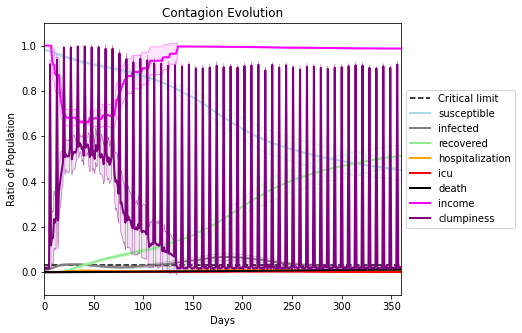

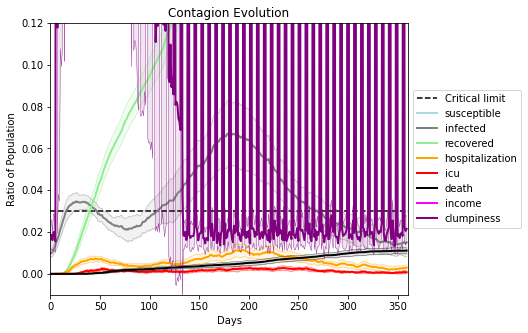

In [41]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.4
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[5458, 6820, 2533, 9695, 7031, 523, 5130, 1234, 5761, 8269, 6951, 7106, 1784, 4845, 3370, 9232, 220, 1044, 7055, 6821]
Average similarity between family members is 0.1920703776195036 at temperature -0.3
Average similarity between family and home is 0.9998604549916326 at temperature -1
Average similarity between students and their classroom is 0.18693536288317036 at temperature -0.3
Average classroom occupancy is 3.5774647887323945 and number classrooms is 71
Average similarity between workers is 0.1576772497849637 at temperature -0.3
Average office occupancy is 3.392156862745098 and number offices is 204
Average friend similarity for adults: 0.25574464226858246 for kids: 0.19301423324766467
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Ho

avg restaurant similarity 0.03950033189069926
avg restaurant similarity 0.10993827288766686
avg restaurant similarity 0.11430976906794703
avg restaurant similarity 0.06669785411376286
avg restaurant similarity 0.059104711463145505
avg restaurant similarity 0.04242895351757027
avg restaurant similarity 0.10093181879562488
avg restaurant similarity 0.06450351376352177
avg restaurant similarity 0.08409703564995011
avg restaurant similarity 0.08679850471642557
avg restaurant similarity 0.0512598427706088
avg restaurant similarity 0.05592144361658456
avg restaurant similarity 0.04209181442821027
avg restaurant similarity 0.08955566252402017
avg restaurant similarity 0.07352446164385519
avg restaurant similarity 0.1035782537904025
avg restaurant similarity 0.04469377602744272
avg restaurant similarity 0.11694638417987648
avg restaurant similarity 0.0855105219389814
avg restaurant similarity 0.05356933757334561
avg restaurant similarity 0.08213786908594108
avg restaurant similarity 0.02095169

avg restaurant similarity 0.0804072379301584
avg restaurant similarity 0.031796269189141614
avg restaurant similarity 0.07274266464957072
avg restaurant similarity 0.11038687959449558
avg restaurant similarity 0.10362333030925582
avg restaurant similarity 0.12589418737608538
avg restaurant similarity 0.11390730026116355
avg restaurant similarity 0.052299678387207615
avg restaurant similarity 0.06096632269985236
avg restaurant similarity 0.1206200069827802
avg restaurant similarity 0.1527085575639466
avg restaurant similarity 0.10547322629639228
avg restaurant similarity 0.08997616379707586
avg restaurant similarity 0.04214301695890949
avg restaurant similarity 0.12848697492031677
avg restaurant similarity 0.12461688257170583
avg restaurant similarity 0.07094882752208699
avg restaurant similarity 0.08565613454229686
avg restaurant similarity 0.13451420423862373
avg restaurant similarity 0.11907738252969177
avg restaurant similarity 0.11421966418105102
avg restaurant similarity 0.0506698

avg restaurant similarity 0.07168160929916226
avg restaurant similarity 0.033585104105227165
avg restaurant similarity 0.019764460792473248
avg restaurant similarity 0.04459159755735362
avg restaurant similarity 0.08100593597559068
avg restaurant similarity 0.029065990056631286
avg restaurant similarity 0.09661992833108585
avg restaurant similarity 0.09534992697473678
avg restaurant similarity 0.08025117813561126
avg restaurant similarity 0.07897026424189058
avg restaurant similarity -0.01766604289615062
avg restaurant similarity 0.030649786574161907
avg restaurant similarity 0.02142379894322967
avg restaurant similarity 0.04750482632206058
avg restaurant similarity 0.06958726457233728
avg restaurant similarity 0.06450757372362323
avg restaurant similarity 0.07295860565111353
avg restaurant similarity 0.06151963386913819
avg restaurant similarity 0.0995226787701709
avg restaurant similarity 0.09954310317914188
avg restaurant similarity 0.14224333796414335
avg restaurant similarity 0.10

avg restaurant similarity 0.056151794297896
avg restaurant similarity 0.0895919814068787
avg restaurant similarity 0.056554246133288
avg restaurant similarity 0.08732750729874253
avg restaurant similarity 0.07415864865920804
avg restaurant similarity 0.05544654657009149
avg restaurant similarity 0.10574130818479653
avg restaurant similarity 0.06180706400599987
avg restaurant similarity 0.08725264776944901
avg restaurant similarity 0.03616750292310855
avg restaurant similarity 0.0768308546835149
avg restaurant similarity 0.07361890918436298
avg restaurant similarity 0.02794622454258169
avg restaurant similarity 0.08957943918307541
avg restaurant similarity 0.03142286005225583
avg restaurant similarity 0.08599802986426909
avg restaurant similarity 0.031842268215395805
avg restaurant similarity 0.08313231175587656
avg restaurant similarity 0.06203170521934497
avg restaurant similarity 0.07909239590646788
avg restaurant similarity 0.059793155396389755
avg restaurant similarity 0.0456472822

avg restaurant similarity 0.01317347120789
avg restaurant similarity 0.04625414858310397
avg restaurant similarity 0.08946459120884172
avg restaurant similarity 0.10132874089695953
avg restaurant similarity 0.036238101470979826
avg restaurant similarity -0.008854742387430531
avg restaurant similarity 0.06832324490056066
avg restaurant similarity 0.015824148585449064
avg restaurant similarity 0.07116918565083845
avg restaurant similarity 0.0527899877182018
avg restaurant similarity 0.07562992460969883
avg restaurant similarity 0.05407613232045504
avg restaurant similarity 0.026848408014397255
avg restaurant similarity 0.021747175551202827
avg restaurant similarity 0.08175604105431977
avg restaurant similarity 0.05871491969532091
avg restaurant similarity 0.0939578798379328
avg restaurant similarity 0.1042354645622161
avg restaurant similarity 0.00899084330350273
avg restaurant similarity 0.07918092185854686
avg restaurant similarity 0.04838659130326157
avg restaurant similarity 0.089961

avg restaurant similarity 0.09983571353103202
avg restaurant similarity 0.11364058228982643
avg restaurant similarity 0.04673308658815302
avg restaurant similarity 0.011217084277896212
avg restaurant similarity 0.06422428747305947
avg restaurant similarity 0.06364449838610306
avg restaurant similarity 0.02061784999165889
avg restaurant similarity 0.0724680805092689
avg restaurant similarity 0.02078129930945251
avg restaurant similarity 0.07018813333056358
avg restaurant similarity 0.02276960252037503
avg restaurant similarity 0.07328452765331758
avg restaurant similarity -0.0011976308284888694
avg restaurant similarity 0.08165300919830526
avg restaurant similarity 0.058980938509227115
avg restaurant similarity 0.07798891290742782
avg restaurant similarity 0.10444960582909457
avg restaurant similarity 0.05167426834134327
avg restaurant similarity 0.06818102800260754
avg restaurant similarity 0.05757497101778974
avg restaurant similarity 0.0124626318949087
avg restaurant similarity 0.107

avg restaurant similarity 0.08805242098973605
avg restaurant similarity 0.054874283222662704
avg restaurant similarity 0.05644155469194572
avg restaurant similarity 0.08550926834781818
avg restaurant similarity 0.07014609050861682
avg restaurant similarity 0.09178757265263873
avg restaurant similarity 0.045033638753317326
avg restaurant similarity 0.10725006529759383
avg restaurant similarity 0.055868953327684115
avg restaurant similarity 0.0915155053063109
avg restaurant similarity 0.12529316229031107
avg restaurant similarity 0.022228763387107175
avg restaurant similarity 0.037878588397253325
avg restaurant similarity 0.0482298391652826
avg restaurant similarity 0.10140880753461236
avg restaurant similarity 0.058518822787357816
avg restaurant similarity 0.04798186961661938
avg restaurant similarity 0.03137932859812534
avg restaurant similarity 0.09150082693852159
avg restaurant similarity 0.12334360279259696
avg restaurant similarity 0.1106471173303469
avg restaurant similarity 0.067

avg restaurant similarity 0.03238747744776389
avg restaurant similarity 0.06979429675412191
avg restaurant similarity 0.09432361652563452
avg restaurant similarity 0.07204792043338433
avg restaurant similarity 0.07456699898283255
avg restaurant similarity 0.09240346320231815
avg restaurant similarity 0.04872656313467987
avg restaurant similarity 0.07811592739148152
avg restaurant similarity 0.06618524389438618
avg restaurant similarity 0.06875606809782588
avg restaurant similarity 0.06129493990629243
avg restaurant similarity 0.04465292595639598
avg restaurant similarity 0.04832628035299805
avg restaurant similarity 0.023338631915167198
avg restaurant similarity 0.07124197612678339
avg restaurant similarity 0.06162223385277714
avg restaurant similarity 0.05330815409151789
avg restaurant similarity 0.04532777186437263
avg restaurant similarity 0.05009971342845952
avg restaurant similarity 0.08694053638664766
avg restaurant similarity 0.05840764402225569
avg restaurant similarity 0.08836

avg restaurant similarity 0.05628652813740828
avg restaurant similarity 0.08250180926186813
avg restaurant similarity 0.07138490198434055
avg restaurant similarity 0.11321477337339672
avg restaurant similarity 0.08896818086059727
avg restaurant similarity 0.09147553077457034
avg restaurant similarity 0.09513563704452581
avg restaurant similarity 0.07815682293057365
avg restaurant similarity 0.06949248809271322
avg restaurant similarity 0.09383890917445753
avg restaurant similarity 0.05530332132032309
avg restaurant similarity 0.07440651566152112
avg restaurant similarity 0.053009142395799326
avg restaurant similarity 0.0938000917722075
avg restaurant similarity 0.0548898819216193
avg restaurant similarity 0.11239293448031612
avg restaurant similarity 0.08816459564044395
avg restaurant similarity 0.05083642212059017
avg restaurant similarity 0.08573701677618915
avg restaurant similarity 0.04747087876564737
avg restaurant similarity 0.07174425897098557
avg restaurant similarity 0.1036480

avg restaurant similarity 0.10249394435220598
avg restaurant similarity 0.062256494185508354
avg restaurant similarity 0.07215032737819156
avg restaurant similarity 0.1062654274554905
avg restaurant similarity 0.04510766916753636
avg restaurant similarity 0.06760001315146573
avg restaurant similarity 0.04592728854753661
avg restaurant similarity 0.07413848205491086
avg restaurant similarity 0.1058212374536583
avg restaurant similarity 0.09234903444468573
avg restaurant similarity 0.07818061390658715
avg restaurant similarity 0.09357049420278617
avg restaurant similarity 0.06690210074007841
avg restaurant similarity 0.11640786919120841
avg restaurant similarity 0.12726383772430302
avg restaurant similarity 0.09952595636624131
avg restaurant similarity 0.05639656904281519
avg restaurant similarity 0.0932285054707017
avg restaurant similarity 0.08694470799680246
avg restaurant similarity 0.10498849948828733
avg restaurant similarity 0.0748356115987733
avg restaurant similarity 0.062544106

avg restaurant similarity 0.08756897944598947
avg restaurant similarity 0.08298069788496795
avg restaurant similarity 0.07773535455642692
avg restaurant similarity 0.08865218313671493
avg restaurant similarity 0.08721929348178806
avg restaurant similarity 0.08179310915028795
avg restaurant similarity 0.046486161639229154
avg restaurant similarity 0.04439135239490462
avg restaurant similarity 0.09067492959872742
avg restaurant similarity 0.06963914065019478
avg restaurant similarity 0.0793503541142644
avg restaurant similarity 0.08700221395944366
avg restaurant similarity 0.056951579140001866
avg restaurant similarity 0.07164901812758766
avg restaurant similarity 0.03362058187958461
avg restaurant similarity 0.034879864703230186
avg restaurant similarity 0.0917437810078681
avg restaurant similarity 0.0802212166712691
avg restaurant similarity 0.0930652101713544
avg restaurant similarity 0.09211996678844413
avg restaurant similarity 0.0764603760925923
avg restaurant similarity 0.06908632

avg restaurant similarity 0.08054406603078168
avg restaurant similarity 0.11783534088626309
avg restaurant similarity 0.031006539731169843
avg restaurant similarity 0.09609989848379526
avg restaurant similarity 0.08167609216221772
avg restaurant similarity 0.08957849140327252
avg restaurant similarity 0.07912566885670562
avg restaurant similarity 0.03379304486471163
avg restaurant similarity 0.08373322621961128
avg restaurant similarity 0.06823447781985395
avg restaurant similarity 0.07440608041820149
avg restaurant similarity 0.09824679936082574
avg restaurant similarity 0.06525332542704325
avg restaurant similarity 0.10380344064621994
avg restaurant similarity 0.07129086875441423
avg restaurant similarity 0.10749345310559187
avg restaurant similarity 0.06739847661947528
avg restaurant similarity 0.0601059209767353
avg restaurant similarity 0.04496824799386794
avg restaurant similarity 0.07659524933333017
avg restaurant similarity 0.04675392964232155
avg restaurant similarity 0.068971

avg restaurant similarity 0.0010376721793058702
avg restaurant similarity 0.030061783148194784
avg restaurant similarity 0.017783468099264774
avg restaurant similarity 0.027418754770750224
avg restaurant similarity 0.04428618243567359
avg restaurant similarity 0.04343614186786013
avg restaurant similarity 0.05956824767969576
avg restaurant similarity 0.019608865717238525
avg restaurant similarity 0.0229474144633027
avg restaurant similarity 0.01393603801460896
avg restaurant similarity 0.03275510815610623
avg restaurant similarity 0.040804002127951794
avg restaurant similarity 0.042885229397680795
avg restaurant similarity 0.06674537313576906
avg restaurant similarity 0.09016903228665263
avg restaurant similarity 0.06913969789741187
avg restaurant similarity 0.021105998871545687
avg restaurant similarity 0.07655591870572932
avg restaurant similarity 0.0655088246477901
avg restaurant similarity 0.05744755739033
avg restaurant similarity 0.040722045654289676
avg restaurant similarity 0.0

avg restaurant similarity 0.03118598026997609
avg restaurant similarity 0.0743980940937584
avg restaurant similarity 0.06327127093034925
avg restaurant similarity 0.07989792474379245
avg restaurant similarity 0.08551690024262881
avg restaurant similarity 0.02330077756855792
avg restaurant similarity 0.0585229102360343
avg restaurant similarity 0.06074861198824889
avg restaurant similarity 0.008893030030359201
avg restaurant similarity 0.044053546610149846
avg restaurant similarity 0.07348625708236366
avg restaurant similarity 0.07893509857627005
avg restaurant similarity 0.061619832239817034
avg restaurant similarity 0.05039694920700237
avg restaurant similarity 0.06852902235420398
avg restaurant similarity 0.04123799548469157
avg restaurant similarity 0.08376315277350047
avg restaurant similarity 0.06882624555741575
avg restaurant similarity 0.09077541104992957
avg restaurant similarity 0.06893971439670199
avg restaurant similarity 0.08287582556220742
avg restaurant similarity 0.14845

avg restaurant similarity 0.06347993900837202
avg restaurant similarity 0.06665955060204543
avg restaurant similarity 0.03371383814145687
avg restaurant similarity 0.06342244005416148
avg restaurant similarity -0.00223341689547843
avg restaurant similarity 0.055751878446632895
avg restaurant similarity 0.00943832382677417
avg restaurant similarity 0.017644242814443066
avg restaurant similarity 0.0593712899577374
avg restaurant similarity -0.008783565469894427
avg restaurant similarity -3.5046156386857955e-05
avg restaurant similarity 0.03867714484171025
avg restaurant similarity 0.047440686350557204
avg restaurant similarity 0.03337330850852545
avg restaurant similarity 0.027803890774532068
avg restaurant similarity 0.08652362400426054
avg restaurant similarity 0.02450271942551757
avg restaurant similarity 0.010477134584404333
avg restaurant similarity 0.06884377270026287
avg restaurant similarity 0.06483508412414393
avg restaurant similarity 0.01244217810144444
avg restaurant similari

avg restaurant similarity 0.016744531895469632
avg restaurant similarity 0.05142952484283813
avg restaurant similarity 0.023062016609681053
avg restaurant similarity 0.06924182471169947
avg restaurant similarity 0.05685717177057704
avg restaurant similarity -0.015735140348714094
avg restaurant similarity -0.014198311671169939
avg restaurant similarity -0.0007478314702097736
avg restaurant similarity 0.13818062393322741
avg restaurant similarity 0.07078268190895345
avg restaurant similarity 0.023307292902289216
avg restaurant similarity 0.023682000037816703
avg restaurant similarity 0.07529231597122214
avg restaurant similarity 0.016085103124304414
avg restaurant similarity 0.11182395949251911
avg restaurant similarity 0.09617633578111345
avg restaurant similarity 0.013242068166625381
avg restaurant similarity 0.11348054716207502
avg restaurant similarity 0.05961850640340364
avg restaurant similarity 0.0944894741823999
avg restaurant similarity 0.019065568820078448
avg restaurant simila

avg restaurant similarity 0.062390422360408246
avg restaurant similarity 0.0866145793670844
avg restaurant similarity 0.10481649551630767
avg restaurant similarity 0.11000400857113693
avg restaurant similarity 0.07959846160881137
avg restaurant similarity 0.10959969464622919
avg restaurant similarity 0.06316677336875125
avg restaurant similarity 0.04649554660329268
avg restaurant similarity 0.14469640288916016
avg restaurant similarity 0.060122805838823755
avg restaurant similarity 0.04673520739509557
avg restaurant similarity 0.08520659244933634
avg restaurant similarity 0.1101686791553595
avg restaurant similarity 0.029485407773003788
avg restaurant similarity 0.031010342995617397
avg restaurant similarity 0.06210251280886952
avg restaurant similarity 0.06479008957665887
avg restaurant similarity 0.08738270953583004
avg restaurant similarity 0.10048204763674863
avg restaurant similarity 0.07781337363952369
avg restaurant similarity 0.05143746359113781
avg restaurant similarity 0.0853

avg restaurant similarity 0.053356503477072006
avg restaurant similarity 0.05228137500162166
avg restaurant similarity 0.0892469180138868
avg restaurant similarity 0.06946293507070068
avg restaurant similarity 0.10732168123152173
avg restaurant similarity 0.06063518547174567
avg restaurant similarity 0.07544775288778717
avg restaurant similarity 0.07594135514824021
avg restaurant similarity 0.09678836702939066
avg restaurant similarity 0.05223553309843706
avg restaurant similarity 0.13212963618940665
avg restaurant similarity 0.07701822985243247
avg restaurant similarity 0.07115709783050639
avg restaurant similarity 0.10699510005488144
avg restaurant similarity 0.0693476009402225
avg restaurant similarity 0.07828198187921936
avg restaurant similarity 0.07020960277039359
avg restaurant similarity 0.10237392188180028
avg restaurant similarity 0.0809613022629727
avg restaurant similarity 0.10608960899128342
avg restaurant similarity 0.0976089651176084
avg restaurant similarity 0.100519574

avg restaurant similarity 0.08265662716713433
avg restaurant similarity 0.08195357601076268
avg restaurant similarity -0.006176294972978436
avg restaurant similarity 0.05819354062396037
avg restaurant similarity 0.06961902968168752
avg restaurant similarity 0.04448483017257773
avg restaurant similarity 0.08178538124647879
avg restaurant similarity 0.03467332292694149
avg restaurant similarity 0.04809521605775623
avg restaurant similarity 0.06246162485078955
avg restaurant similarity 0.05408794819195914
avg restaurant similarity 0.0490674717829165
avg restaurant similarity 0.09226579609419001
avg restaurant similarity 0.0673979980836652
avg restaurant similarity 0.017182717506630623
avg restaurant similarity 0.11161258998696463
avg restaurant similarity 0.04786891968020869
avg restaurant similarity 0.09031961904237489
avg restaurant similarity 0.03285308009708334
avg restaurant similarity 0.06746402554158377
avg restaurant similarity 0.027918932632503685
avg restaurant similarity 0.1043

avg restaurant similarity 0.045417655310177815
avg restaurant similarity 0.06627315530319815
avg restaurant similarity 0.08417308408898984
avg restaurant similarity 0.06756673778010745
avg restaurant similarity 0.008372032438888719
avg restaurant similarity 0.09972538398503401
avg restaurant similarity 0.05131993775633633
avg restaurant similarity 0.06389055349837547
avg restaurant similarity 0.05872118424931233
avg restaurant similarity 0.0814126401054309
avg restaurant similarity 0.07772300497146742
avg restaurant similarity 0.07340200035551235
avg restaurant similarity 0.05244902980063683
avg restaurant similarity 0.07280865091369129
avg restaurant similarity 0.09946373797639191
avg restaurant similarity 0.024257897216526294
avg restaurant similarity 0.04941172543537853
avg restaurant similarity 0.02870471887482804
avg restaurant similarity 0.051183688566356474
avg restaurant similarity 0.06591882840047313
avg restaurant similarity 0.059407570236510915
avg restaurant similarity 0.08

avg restaurant similarity 0.05874848637871326
avg restaurant similarity 0.05441450014681876
avg restaurant similarity 0.0722861698792628
avg restaurant similarity 0.07385768733283485
avg restaurant similarity 0.05670481883398508
avg restaurant similarity 0.01772340994642362
avg restaurant similarity 0.09856259040905098
avg restaurant similarity 0.05297021511793485
avg restaurant similarity 0.10151064672844148
avg restaurant similarity 0.05078498936704426
avg restaurant similarity 0.07865205415494289
avg restaurant similarity 0.07306240007580257
avg restaurant similarity 0.05343433720839171
avg restaurant similarity 0.04235474906650994
avg restaurant similarity 0.05191579666813218
avg restaurant similarity 0.09223656933365955
avg restaurant similarity 0.0795799001299094
avg restaurant similarity 0.10565318529303865
avg restaurant similarity 0.04469349410604793
avg restaurant similarity 0.050876970890736575
avg restaurant similarity 0.08379212974575183
avg restaurant similarity 0.0868992

avg restaurant similarity 0.08578801517245743
avg restaurant similarity 0.041911019103577224
avg restaurant similarity 0.028010983628166716
avg restaurant similarity 0.06486342966166289
avg restaurant similarity 0.026221186495698996
avg restaurant similarity 0.05901748122067326
avg restaurant similarity 0.0904916426231075
avg restaurant similarity 0.06727196690168621
avg restaurant similarity 0.11008789340403723
avg restaurant similarity -0.003131439100483741
avg restaurant similarity 0.05931673006611786
avg restaurant similarity 0.11417127609109763
avg restaurant similarity 0.0676839865781024
avg restaurant similarity 0.06302651986960335
avg restaurant similarity 0.0554319416854707
avg restaurant similarity 0.05289051068130287
avg restaurant similarity 0.05592706618402838
avg restaurant similarity 0.04821918703882414
avg restaurant similarity 0.03756945211501107
avg restaurant similarity 0.07931152235499382
avg restaurant similarity 0.081946411990947
avg restaurant similarity 0.029931

avg restaurant similarity 0.0661413110760888
avg restaurant similarity 0.06397416280853192
avg restaurant similarity 0.03007005292339061
avg restaurant similarity 0.03746150253142453
avg restaurant similarity 0.022837786192968036
avg restaurant similarity 0.07401198592179875
avg restaurant similarity 0.09419066658618727
avg restaurant similarity 0.12599681060685913
avg restaurant similarity 0.10827471192511517
avg restaurant similarity 0.06215601521507907
avg restaurant similarity 0.09186897624824793
avg restaurant similarity 0.07037846061950001
avg restaurant similarity 0.10905875114763286
avg restaurant similarity 0.0798299856762312
avg restaurant similarity 0.019802702806122896
avg restaurant similarity 0.04275054305462115
avg restaurant similarity 0.09308141051420078
avg restaurant similarity 0.07761348999324832
avg restaurant similarity 0.07611248187471979
avg restaurant similarity 0.06575356647482072
avg restaurant similarity 0.08772589681650962
avg restaurant similarity 0.090937

avg restaurant similarity 0.0531417457909467
avg restaurant similarity 0.062307147626187595
avg restaurant similarity 0.020728531548683295
avg restaurant similarity 0.07566789373341835
avg restaurant similarity 0.04932831815007498
avg restaurant similarity 0.08136395605834976
avg restaurant similarity 0.09432824039476394
avg restaurant similarity 0.0772400941064019
avg restaurant similarity 0.06892124945146333
avg restaurant similarity 0.08675368146523729
avg restaurant similarity 0.08600536971675421
avg restaurant similarity 0.05293315851418152
avg restaurant similarity 0.02873290228823361
avg restaurant similarity 0.017587225267784765
avg restaurant similarity 0.053700543738362375
avg restaurant similarity 0.03158175343266075
avg restaurant similarity 0.037851231954818834
avg restaurant similarity 0.06712443322665346
avg restaurant similarity 0.06333963773656823
avg restaurant similarity 0.04202571476747458
avg restaurant similarity 0.08047621897729938
avg restaurant similarity 0.072

avg restaurant similarity 0.07558466725861536
avg restaurant similarity 0.049497518991675746
avg restaurant similarity 0.07382484326428404
avg restaurant similarity 0.0408890392107227
avg restaurant similarity 0.08137444684854545
avg restaurant similarity 0.11177131578272156
avg restaurant similarity 0.032449218810038066
avg restaurant similarity 0.05390675080120384
avg restaurant similarity 0.07821406174266136
avg restaurant similarity 0.019407096437365025
avg restaurant similarity 0.0645336927181859
avg restaurant similarity 0.09920559129862813
avg restaurant similarity 0.037340810168533224
avg restaurant similarity 0.042242856138543027
avg restaurant similarity 0.07737889429758169
avg restaurant similarity 0.05515952342292225
avg restaurant similarity 0.11231178630208985
avg restaurant similarity 0.04780319421565005
avg restaurant similarity 0.07071784374369548
avg restaurant similarity 0.03899909245498384
avg restaurant similarity 0.015242318795997224
avg restaurant similarity 0.05

avg restaurant similarity 0.08338891889886549
avg restaurant similarity 0.021461318541262087
avg restaurant similarity 0.04959368784285571
avg restaurant similarity 0.0759319568595959
avg restaurant similarity 0.08319342977710255
avg restaurant similarity 0.05059810216172183
avg restaurant similarity 0.05276768585554818
avg restaurant similarity 0.050934601965308815
avg restaurant similarity 0.050693580940990864
avg restaurant similarity 0.06876876725886212
avg restaurant similarity 0.06525475360397157
avg restaurant similarity 0.07650668103720482
avg restaurant similarity 0.013260449453060173
avg restaurant similarity 0.06579110661523378
avg restaurant similarity 0.05606669884883805
avg restaurant similarity 0.0701550908808064
avg restaurant similarity 0.03904316550389276
avg restaurant similarity 0.10620201058011342
avg restaurant similarity 0.046775994197618874
avg restaurant similarity 0.054027905440818924
avg restaurant similarity 0.06481134409299116
avg restaurant similarity 0.06

avg restaurant similarity 0.04688462736516338
avg restaurant similarity 0.07346637696837356
avg restaurant similarity 0.04779437386084816
avg restaurant similarity 0.019871236099307264
avg restaurant similarity 0.018805488344136836
avg restaurant similarity 0.1051771812335241
avg restaurant similarity 0.07167781797396376
avg restaurant similarity 0.06351705492335412
avg restaurant similarity 0.05878262747051781
avg restaurant similarity 0.050935920953865996
avg restaurant similarity 0.04940239257320974
avg restaurant similarity 0.039473153632454266
avg restaurant similarity 0.08728630216615954
avg restaurant similarity 0.056967409205427304
avg restaurant similarity 0.06900857036428952
avg restaurant similarity 0.04446785142499146
avg restaurant similarity 0.05550821762372909
avg restaurant similarity 0.14309204936077366
avg restaurant similarity 0.04457581578750661
avg restaurant similarity 0.04130107306492881
avg restaurant similarity 0.058298094492792676
avg restaurant similarity 0.0

avg restaurant similarity 0.06640574686794509
avg restaurant similarity 0.09249227708637413
avg restaurant similarity 0.06114427501085602
avg restaurant similarity 0.08119704445369426
avg restaurant similarity 0.08461993028270279
avg restaurant similarity 0.05848467086562165
avg restaurant similarity 0.08977190608558043
avg restaurant similarity 0.08708207041398973
avg restaurant similarity 0.11300260657078093
avg restaurant similarity 0.05498243834144364
avg restaurant similarity 0.007585775133847749
avg restaurant similarity 0.05797889392318146
avg restaurant similarity 0.046242307858700565
avg restaurant similarity 0.058117538692781155
avg restaurant similarity 0.08285601727338726
avg restaurant similarity 0.0007145163671303399
avg restaurant similarity 0.03907548456717312
avg restaurant similarity 0.05971637441564663
avg restaurant similarity 0.02276284670254591
avg restaurant similarity 0.08052470267066861
avg restaurant similarity 0.07234984486506624
avg restaurant similarity 0.0

avg restaurant similarity 0.08728009060987632
avg restaurant similarity 0.09449683094688004
avg restaurant similarity 0.1117215341500412
avg restaurant similarity 0.1269964436033199
avg restaurant similarity 0.11009666921522437
avg restaurant similarity 0.10636683216598776
avg restaurant similarity 0.09999782892614441
avg restaurant similarity 0.06941051557445216
avg restaurant similarity 0.07310368637275386
avg restaurant similarity 0.12903492750899873
avg restaurant similarity 0.11689811669989601
avg restaurant similarity 0.12020746704231924
avg restaurant similarity 0.13699597144716627
avg restaurant similarity 0.10077324178260642
avg restaurant similarity 0.12068202158930416
avg restaurant similarity 0.10222445917781531
avg restaurant similarity 0.09723315456383524
avg restaurant similarity 0.10747874301149168
avg restaurant similarity 0.07837710493669797
avg restaurant similarity 0.1019491446801112
avg restaurant similarity 0.08658090366990544
avg restaurant similarity 0.113425469

avg restaurant similarity 0.09628087056802072
avg restaurant similarity 0.15340163233560428
avg restaurant similarity 0.09562085866775955
avg restaurant similarity 0.07927046675785096
avg restaurant similarity 0.08071520655985033
avg restaurant similarity 0.11543418772379871
avg restaurant similarity 0.08824776069111626
avg restaurant similarity 0.08369061702283845
avg restaurant similarity 0.09135407752754943
avg restaurant similarity 0.10612199320012197
avg restaurant similarity 0.11271261521494409
avg restaurant similarity 0.11805215377150734
avg restaurant similarity 0.11779758197760931
avg restaurant similarity 0.09494821452552697
avg restaurant similarity 0.10457374279773574
avg restaurant similarity 0.0811268842645447
avg restaurant similarity 0.12154681329564508
avg restaurant similarity 0.09700567268860136
avg restaurant similarity 0.06794996338840105
avg restaurant similarity 0.10833763076563695
avg restaurant similarity 0.0862677776329521
avg restaurant similarity 0.10114820

avg restaurant similarity 0.05581109585455175
avg restaurant similarity 0.0638432073790433
avg restaurant similarity 0.10729988824929526
avg restaurant similarity 0.052785405689788324
avg restaurant similarity 0.0279184772398995
avg restaurant similarity 0.026768366303880346
avg restaurant similarity 0.017230715381354126
avg restaurant similarity 0.04259112499489976
avg restaurant similarity 0.05717541923113304
avg restaurant similarity 0.03016433827384327
avg restaurant similarity 0.04686016027811898
avg restaurant similarity 0.049841375749030706
avg restaurant similarity 0.026372183794902544
avg restaurant similarity 0.030820032334990276
avg restaurant similarity 0.06114589901023535
avg restaurant similarity 0.04743092604642226
avg restaurant similarity 0.045255728565272046
avg restaurant similarity 0.06064831650930476
avg restaurant similarity 0.02304631762700112
avg restaurant similarity 0.09145983516355895
avg restaurant similarity 0.005611367239480287
avg restaurant similarity 0.

avg restaurant similarity 0.034761650625669445
avg restaurant similarity 0.06127843655376133
avg restaurant similarity 0.03997215555531007
avg restaurant similarity 0.0514466297522287
avg restaurant similarity 0.05678805256492163
avg restaurant similarity 0.06774890743321706
avg restaurant similarity 0.03551197063564551
avg restaurant similarity 0.07049938387492401
avg restaurant similarity 0.054487691143158955
avg restaurant similarity 0.07796074627368764
avg restaurant similarity 0.02379468590740036
avg restaurant similarity 0.06334600421399289
avg restaurant similarity 0.10884015096202211
avg restaurant similarity 0.060004939351990375
avg restaurant similarity 0.04178792771278917
avg restaurant similarity 0.09629976397132974
avg restaurant similarity -0.014212101377698795
avg restaurant similarity 0.037333335054863546
avg restaurant similarity 0.0757778131153028
avg restaurant similarity 0.06847956331777488
avg restaurant similarity 0.0550376226913226
avg restaurant similarity 0.006

avg restaurant similarity 0.054365800919701654
avg restaurant similarity 0.07251090090501129
avg restaurant similarity 0.07644623702893379
avg restaurant similarity 0.08883609315515348
avg restaurant similarity 0.056051174861935095
avg restaurant similarity 0.0939535022309028
avg restaurant similarity 0.05327010057093287
avg restaurant similarity 0.10604680574449073
avg restaurant similarity 0.10190648489400912
avg restaurant similarity 0.07386831700722298
avg restaurant similarity 0.04301852710222176
avg restaurant similarity 0.03556040955560853
avg restaurant similarity 0.08556263138870726
avg restaurant similarity 0.09170814465319874
avg restaurant similarity 0.06935038873175306
avg restaurant similarity 0.012611606875608472
avg restaurant similarity -0.02732469274802493
avg restaurant similarity 0.05778985932725404
avg restaurant similarity 0.0731433909245528
avg restaurant similarity 0.07198278251004116
avg restaurant similarity 0.04847096693242101
avg restaurant similarity 0.0627

avg restaurant similarity 0.09135965093732568
avg restaurant similarity 0.08989060066687758
avg restaurant similarity 0.0512210335855193
avg restaurant similarity 0.029885880930544593
avg restaurant similarity 0.057988325217560796
avg restaurant similarity 0.11895236475799477
avg restaurant similarity 0.07118604248503262
avg restaurant similarity 0.04451865179534781
avg restaurant similarity 0.055119711911462546
avg restaurant similarity 0.13145052887089284
avg restaurant similarity 0.05914018128425158
avg restaurant similarity 0.07040432826697778
avg restaurant similarity 0.037912110143238545
avg restaurant similarity 0.08033396230736581
avg restaurant similarity 0.08176338318689788
avg restaurant similarity 0.05230937943590831
avg restaurant similarity 0.046278906588589575
avg restaurant similarity 0.028314686800680038
avg restaurant similarity 0.0557546044735733
avg restaurant similarity 0.026951765623018268
avg restaurant similarity 0.1277991987391456
avg restaurant similarity 0.08

avg restaurant similarity 0.07610417758709082
avg restaurant similarity 0.07215935595114285
avg restaurant similarity 0.1172717375297326
avg restaurant similarity 0.01456485357699053
avg restaurant similarity 0.06835325379347618
avg restaurant similarity 0.006813044407664383
avg restaurant similarity 0.09976670369543444
avg restaurant similarity 0.05794589099856922
avg restaurant similarity 0.06623151984395621
avg restaurant similarity 0.0642674195424353
avg restaurant similarity 0.10621327542198404
avg restaurant similarity 0.05681890449622492
avg restaurant similarity 0.04470560409101427
avg restaurant similarity 0.10555602513426325
avg restaurant similarity 0.11479213665036629
avg restaurant similarity 0.0562714682881186
avg restaurant similarity 0.07389269152342594
avg restaurant similarity 0.0311798315937903
avg restaurant similarity 0.07191770119427938
avg restaurant similarity 0.004157153301492781
avg restaurant similarity 0.07506807484945512
avg restaurant similarity 0.09011451

avg restaurant similarity 0.03373122037311974
avg restaurant similarity 0.07421869721069009
avg restaurant similarity 0.08159701829014938
avg restaurant similarity 0.09710692576915324
avg restaurant similarity 0.01449615636537593
avg restaurant similarity 0.08926970250767655
avg restaurant similarity 0.04133806077900985
avg restaurant similarity 0.06950867197999934
avg restaurant similarity 0.13535538762389066
avg restaurant similarity 0.08083766238962328
avg restaurant similarity 0.058204107747421095
avg restaurant similarity 0.06967571226463036
avg restaurant similarity 0.09646341749006385
avg restaurant similarity 0.1276892447494677
avg restaurant similarity 0.03783793230206874
avg restaurant similarity 0.1079912853531559
avg restaurant similarity 0.06712902458594079
avg restaurant similarity 0.07938326538662017
avg restaurant similarity 0.10349185687299539
avg restaurant similarity 0.06396853038564611
avg restaurant similarity 0.057302427363143484
avg restaurant similarity 0.066219

avg restaurant similarity 0.0794464814312448
avg restaurant similarity 0.09868201879043116
avg restaurant similarity 0.09727196657611509
avg restaurant similarity 0.07850369837714924
avg restaurant similarity 0.03415085705900164
avg restaurant similarity 0.02220575736018906
avg restaurant similarity 0.053424913569363026
avg restaurant similarity 0.09479106934719961
avg restaurant similarity 0.11515000771102483
avg restaurant similarity 0.06090705637449055
avg restaurant similarity 0.06011376623725147
avg restaurant similarity 0.05268631895348414
avg restaurant similarity 0.10452787204386627
avg restaurant similarity 0.07031064485058572
avg restaurant similarity 0.08323079151820957
avg restaurant similarity 0.08581895359602583
avg restaurant similarity 0.07848432828181684
avg restaurant similarity 0.037442414227934734
avg restaurant similarity 0.09845721490873584
avg restaurant similarity 0.07549196661552975
avg restaurant similarity 0.042235090004684034
avg restaurant similarity 0.1454

avg restaurant similarity 0.0830385397635795
avg restaurant similarity 0.14036060240143072
avg restaurant similarity 0.056590739562307354
avg restaurant similarity 0.021122655666667472
avg restaurant similarity 0.06497187497624514
avg restaurant similarity 0.064827049345627
avg restaurant similarity 0.06387135154910592
avg restaurant similarity 0.08875281728587604
avg restaurant similarity 0.06521327015680026
avg restaurant similarity 0.05525713944088785
avg restaurant similarity 0.13446312807935298
avg restaurant similarity 0.06222784191564542
avg restaurant similarity 0.08245862007037778
avg restaurant similarity 0.07580891031583391
avg restaurant similarity 0.08754548626099558
avg restaurant similarity 0.06926316345703079
avg restaurant similarity 0.06692080491374883
avg restaurant similarity 0.08036497654145067
avg restaurant similarity 0.030780589864337016
avg restaurant similarity 0.07876091339101284
avg restaurant similarity 0.04718289817597191
avg restaurant similarity 0.045815

avg restaurant similarity 0.06357968057154224
avg restaurant similarity 0.09764734242108694
avg restaurant similarity 0.08349670435908647
avg restaurant similarity 0.08828086761569516
avg restaurant similarity 0.06320465898736236
avg restaurant similarity 0.06601775207037885
avg restaurant similarity 0.08355956374257732
avg restaurant similarity 0.10824704508115102
avg restaurant similarity 0.07740439514250219
avg restaurant similarity 0.08276880317425682
avg restaurant similarity 0.08902123309576272
avg restaurant similarity 0.09806884930929062
avg restaurant similarity 0.08220845248731536
avg restaurant similarity 0.09603493505522584
avg restaurant similarity 0.07075076840763952
avg restaurant similarity 0.05989606973762857
avg restaurant similarity 0.07523542950260952
avg restaurant similarity 0.0620427036603143
avg restaurant similarity 0.09561677663006435
avg restaurant similarity 0.09190415873230891
avg restaurant similarity 0.060542931516207515
avg restaurant similarity 0.037126

avg restaurant similarity 0.08285657331669963
avg restaurant similarity 0.06833917483099672
avg restaurant similarity 0.09754367671340025
avg restaurant similarity 0.06442712263481312
avg restaurant similarity 0.09994251935909285
avg restaurant similarity 0.0952164805160781
avg restaurant similarity 0.08352213679491058
avg restaurant similarity 0.10797776279310016
avg restaurant similarity 0.1236913063343297
avg restaurant similarity 0.11358489855479949
avg restaurant similarity 0.09532414690254395
avg restaurant similarity 0.06917836441603142
avg restaurant similarity 0.12137897875250324
avg restaurant similarity 0.061196877940595085
avg restaurant similarity 0.06385417612878674
avg restaurant similarity 0.11753488702474858
avg restaurant similarity 0.07318434646108421
avg restaurant similarity 0.04987939312742926
avg restaurant similarity 0.0990930018821471
avg restaurant similarity 0.04837293715442345
avg restaurant similarity 0.07512411662984138
avg restaurant similarity 0.08171992

(<function dict.items>, <function dict.items>, <function dict.items>)

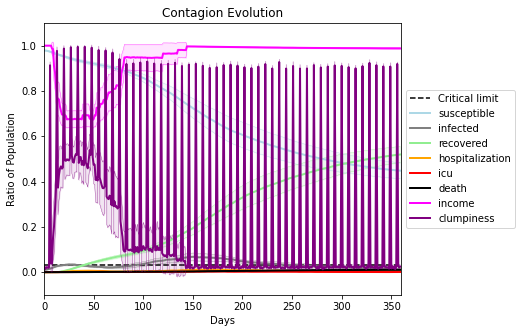

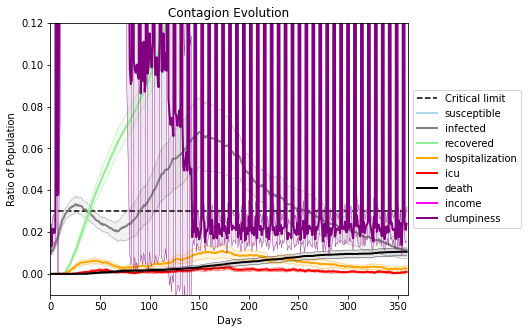

In [42]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.3
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[8962, 4672, 930, 102, 5494, 6489, 3206, 961, 6383, 5105, 3730, 7001, 9846, 426, 5868, 5252, 9449, 3518, 1512, 8922]
Average similarity between family members is 0.15998388455992177 at temperature -0.2
Average similarity between family and home is 0.9998459054565474 at temperature -1
Average similarity between students and their classroom is 0.15644363195325356 at temperature -0.2
Average classroom occupancy is 4.042857142857143 and number classrooms is 70
Average similarity between workers is 0.1500691497479241 at temperature -0.2
Average office occupancy is 3.1813725490196076 and number offices is 204
Average friend similarity for adults: 0.22000163771664188 for kids: 0.20330778441100644
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
H

avg restaurant similarity 0.0878097935334897
avg restaurant similarity 0.056541519652291504
avg restaurant similarity 0.0693226827802294
avg restaurant similarity 0.0791816996177946
avg restaurant similarity 0.07475719923591939
avg restaurant similarity 0.07628038335627814
avg restaurant similarity 0.10628854365592204
avg restaurant similarity 0.04236138034591117
avg restaurant similarity 0.057856097031314724
avg restaurant similarity 0.08408456257863833
avg restaurant similarity 0.04880732272860256
avg restaurant similarity 0.031357043673408906
avg restaurant similarity 0.042179599567310724
avg restaurant similarity 0.0758188299823823
avg restaurant similarity 0.06381218799027631
avg restaurant similarity 0.06749039170128467
avg restaurant similarity 0.08389731046435318
avg restaurant similarity 0.0894662295838041
avg restaurant similarity 0.07003851213398778
avg restaurant similarity 0.09932870034458312
avg restaurant similarity 0.1117537600401247
avg restaurant similarity 0.09855472

avg restaurant similarity 0.10465515960332349
avg restaurant similarity 0.09615883524903271
avg restaurant similarity -0.0068020462667051544
avg restaurant similarity 0.062167301304255164
avg restaurant similarity 0.11685838803933318
avg restaurant similarity 0.08139941790438722
avg restaurant similarity 0.030407674314795567
avg restaurant similarity 0.07667587184107372
avg restaurant similarity 0.021104412960798253
avg restaurant similarity 0.09369986675614562
avg restaurant similarity 0.018877956433976398
avg restaurant similarity 0.09918366840800052
avg restaurant similarity 0.036288805284746053
avg restaurant similarity 0.04266360485744843
avg restaurant similarity 0.0972449938318754
avg restaurant similarity 0.11981856187867623
avg restaurant similarity 0.0665744558314578
avg restaurant similarity 0.06330085146571666
avg restaurant similarity 0.06997845410429099
avg restaurant similarity 0.07189824741710292
avg restaurant similarity 0.1091813545234038
avg restaurant similarity 0.0

avg restaurant similarity 0.006502040083772515
avg restaurant similarity 0.024044669830572067
avg restaurant similarity 0.06083028355655948
avg restaurant similarity 0.0720982004419179
avg restaurant similarity -0.0012517618460572114
avg restaurant similarity 0.037199206002968645
avg restaurant similarity 0.01822430417288945
avg restaurant similarity 0.04956295499415186
avg restaurant similarity 0.025387759623529817
avg restaurant similarity 0.07213908979480338
avg restaurant similarity -0.004287490824266111
avg restaurant similarity 0.038617604467537724
avg restaurant similarity 0.04087247507420357
avg restaurant similarity 0.022552585188420314
avg restaurant similarity 0.04988977620760788
avg restaurant similarity 0.0257641497704832
avg restaurant similarity 0.04343653111851129
avg restaurant similarity 0.03946325643947827
avg restaurant similarity 0.004378746445856116
avg restaurant similarity -0.01105379778972777
avg restaurant similarity 0.05732470859855829
avg restaurant similari

avg restaurant similarity 0.04354550850716183
avg restaurant similarity 0.0034787731443385256
avg restaurant similarity 0.034807048191559165
avg restaurant similarity 0.02219412342792308
avg restaurant similarity 0.04608077487025293
avg restaurant similarity -0.014056489835793396
avg restaurant similarity 0.07637872592690484
avg restaurant similarity 0.03215248478898673
avg restaurant similarity 0.03446157896997398
avg restaurant similarity -0.0042798964421814824
avg restaurant similarity 0.06206645171481194
avg restaurant similarity 0.057071924204733795
avg restaurant similarity 0.03673915577292303
avg restaurant similarity 0.00986505997180069
avg restaurant similarity 0.01027258920687533
avg restaurant similarity 0.03275186369023296
avg restaurant similarity 0.04228284765713445
avg restaurant similarity 0.036512012141039024
avg restaurant similarity 0.009511629571923159
avg restaurant similarity 0.03020448192049174
avg restaurant similarity 0.01498722683791641
avg restaurant similari

avg restaurant similarity 0.060269890458800324
avg restaurant similarity 0.062253313470125256
avg restaurant similarity 0.03526007934519513
avg restaurant similarity 0.05306253039370843
avg restaurant similarity 0.06575862308202417
avg restaurant similarity 0.04569130342688248
avg restaurant similarity 0.06087564748281378
avg restaurant similarity 0.10453329928154381
avg restaurant similarity 0.055271789746772756
avg restaurant similarity 0.05959043961491819
avg restaurant similarity 0.04957266553537003
avg restaurant similarity 0.02994156303461083
avg restaurant similarity 0.05997909875623785
avg restaurant similarity 0.03794294091867883
avg restaurant similarity 0.0808458961122164
avg restaurant similarity 0.038480441692105134
avg restaurant similarity 0.022464833246256064
avg restaurant similarity 0.09606069090225938
avg restaurant similarity 0.07995982382346517
avg restaurant similarity 0.07336121205183688
avg restaurant similarity 0.05908112331678781
avg restaurant similarity 0.05

avg restaurant similarity 0.09738943635088597
avg restaurant similarity 0.08230606180526624
avg restaurant similarity 0.0694473908211692
avg restaurant similarity 0.10424302268875069
avg restaurant similarity 0.043540208019122464
avg restaurant similarity 0.0662707760876441
avg restaurant similarity 0.08619895020757172
avg restaurant similarity 0.07059339231836817
avg restaurant similarity 0.06773400414759076
avg restaurant similarity 0.05532235962885087
avg restaurant similarity 0.07303080398417684
avg restaurant similarity 0.0916461740990978
avg restaurant similarity 0.059828780228298656
avg restaurant similarity 0.05754640708682708
avg restaurant similarity 0.06057669705231565
avg restaurant similarity 0.08690807616719663
avg restaurant similarity 0.08852050208381633
avg restaurant similarity 0.07752663605555145
avg restaurant similarity 0.07788858020693597
avg restaurant similarity 0.09112129906964792
avg restaurant similarity 0.044265472561370325
avg restaurant similarity 0.031939

avg restaurant similarity 0.04645004697829717
avg restaurant similarity 0.09173539103849686
avg restaurant similarity 0.06574441653725689
avg restaurant similarity 0.05202284360209383
avg restaurant similarity 0.053060528618700524
avg restaurant similarity 0.038088460536792164
avg restaurant similarity 0.03628383886968715
avg restaurant similarity 0.05504975071689072
avg restaurant similarity 0.0488526005009573
avg restaurant similarity 0.05796987348503062
avg restaurant similarity 0.06284684235497451
avg restaurant similarity 0.033592811226655236
avg restaurant similarity 0.0696876009594342
avg restaurant similarity 0.05809609590878837
avg restaurant similarity 0.04270624250228324
avg restaurant similarity 0.050487538972838066
avg restaurant similarity 0.05315023023522038
avg restaurant similarity 0.08184227682276903
avg restaurant similarity 0.08611551307111098
avg restaurant similarity 0.0678866267033707
avg restaurant similarity 0.0757302577268428
avg restaurant similarity 0.093324

avg restaurant similarity 0.033312717474451685
avg restaurant similarity 0.08597343185004457
avg restaurant similarity 0.06470662688848394
avg restaurant similarity 0.052835095763971336
avg restaurant similarity 0.09169942623199276
avg restaurant similarity 0.03032522133120926
avg restaurant similarity 0.05443737908513906
avg restaurant similarity 0.05577406129557817
avg restaurant similarity 0.06591219003541841
avg restaurant similarity 0.09961295503680388
avg restaurant similarity 0.07094758270480954
avg restaurant similarity 0.008561581066807088
avg restaurant similarity 0.03573162975756086
avg restaurant similarity 0.0626827769550602
avg restaurant similarity 0.030090598792964475
avg restaurant similarity 0.03415902271301462
avg restaurant similarity 0.016795739486540784
avg restaurant similarity 0.06243382496683412
avg restaurant similarity 0.05210041030826566
avg restaurant similarity 0.07087290448919516
avg restaurant similarity 0.046274682691448306
avg restaurant similarity 0.0

avg restaurant similarity 0.05289130693591555
avg restaurant similarity 0.08573960348741533
avg restaurant similarity 0.0575648115057463
avg restaurant similarity 0.057247297187767006
avg restaurant similarity 0.04586748645575159
avg restaurant similarity 0.03537224248967192
avg restaurant similarity 0.06853450287641581
avg restaurant similarity 0.04020619036669075
avg restaurant similarity 0.025136758610403934
avg restaurant similarity 0.05002963469028002
avg restaurant similarity 0.023345840487821318
avg restaurant similarity 0.10005906639561657
avg restaurant similarity 0.012903764061575522
avg restaurant similarity 0.02839882986787388
avg restaurant similarity 0.07634225347377062
avg restaurant similarity 0.12216499826296975
avg restaurant similarity 0.06368582406294668
avg restaurant similarity 0.08418253464746502
avg restaurant similarity 0.06117957908890798
avg restaurant similarity 0.07289267416641143
avg restaurant similarity 0.0376364313591493
avg restaurant similarity 0.0264

avg restaurant similarity 0.08545710609507527
avg restaurant similarity 0.06205879402092869
avg restaurant similarity 0.05325824180336598
avg restaurant similarity 0.024126765597988466
avg restaurant similarity 0.0625656196335702
avg restaurant similarity -0.004584474112106033
avg restaurant similarity 0.05614598452830453
avg restaurant similarity 0.051661676418197626
avg restaurant similarity 0.06478791131536484
avg restaurant similarity 0.06895865680521732
avg restaurant similarity 0.07519209507068851
avg restaurant similarity 0.035657406916758526
avg restaurant similarity 0.04582657560577417
avg restaurant similarity -0.020833567504905136
avg restaurant similarity 0.0031055781071689667
avg restaurant similarity 0.04965034031774649
avg restaurant similarity 0.07215287108030363
avg restaurant similarity 0.07638697086488856
avg restaurant similarity 0.07027501516971044
avg restaurant similarity 0.060156657420802416
avg restaurant similarity 0.05203094169510639
avg restaurant similarity

avg restaurant similarity 0.06915018727125587
avg restaurant similarity 0.05351232595102593
avg restaurant similarity 0.057150262035390385
avg restaurant similarity 0.047362708212691194
avg restaurant similarity 0.010069728837689812
avg restaurant similarity 0.06343576832870702
avg restaurant similarity 0.040182811229790935
avg restaurant similarity 0.06010559261607685
avg restaurant similarity 0.026531362451751212
avg restaurant similarity 0.029765798443580162
avg restaurant similarity 0.01883825901814788
avg restaurant similarity 0.05717534623455442
avg restaurant similarity 0.036213557774086434
avg restaurant similarity 0.022044582229356246
avg restaurant similarity -0.0014996088343941754
avg restaurant similarity 0.028610595502132286
avg restaurant similarity 0.06748540779494916
avg restaurant similarity 0.049093198602641164
avg restaurant similarity 0.05574268595921894
avg restaurant similarity 0.09231089875655536
avg restaurant similarity 0.12085177549158443
avg restaurant simila

avg restaurant similarity 0.07330240580109305
avg restaurant similarity 0.07735417609138344
avg restaurant similarity 0.0767604140484326
avg restaurant similarity 0.03758209447464822
avg restaurant similarity 0.021865883814672527
avg restaurant similarity 0.09852041358469828
avg restaurant similarity 0.037629730572170304
avg restaurant similarity 0.06145286254585706
avg restaurant similarity 0.03629016913153573
avg restaurant similarity 0.023443644368669574
avg restaurant similarity 0.04224109179554653
avg restaurant similarity 0.032867078654915616
avg restaurant similarity 0.04949392537238033
avg restaurant similarity 0.046934078732994954
avg restaurant similarity 0.04856368815522778
avg restaurant similarity 0.03715385013603432
avg restaurant similarity 0.056913690224553254
avg restaurant similarity 0.0701238593174063
avg restaurant similarity 0.07187151894012958
avg restaurant similarity 0.04308929432776497
avg restaurant similarity 0.02286818582674987
avg restaurant similarity -0.0

avg restaurant similarity 0.04269164350933568
avg restaurant similarity 0.05404406752135556
avg restaurant similarity 0.010336003098258478
avg restaurant similarity 0.055021319776101967
avg restaurant similarity 0.07198482165575279
avg restaurant similarity 0.02541047620892763
avg restaurant similarity 0.034347645192297716
avg restaurant similarity 0.03384382505109184
avg restaurant similarity 0.06066079235626445
avg restaurant similarity 0.06176662829032073
avg restaurant similarity 0.09836617366215099
avg restaurant similarity 0.069470001912213
avg restaurant similarity 0.03415050807178814
avg restaurant similarity 0.051771274180554015
avg restaurant similarity 0.07855051285913695
avg restaurant similarity 0.0601773888570503
avg restaurant similarity -0.0016825636744966616
avg restaurant similarity 0.016029003208294795
avg restaurant similarity 0.0467436811660077
avg restaurant similarity 0.03343538748629155
avg restaurant similarity 0.02402425783660488
avg restaurant similarity 0.08

avg restaurant similarity 0.044899686670147744
avg restaurant similarity 0.054493220134588065
avg restaurant similarity 0.052026100778164
avg restaurant similarity 0.027644090565145097
avg restaurant similarity 0.06795677402197399
avg restaurant similarity 0.05624964641042155
avg restaurant similarity 0.039091122600486944
avg restaurant similarity 0.04078326719178337
avg restaurant similarity 0.055419312133264335
avg restaurant similarity 0.04438241135685115
avg restaurant similarity 0.09060592620751728
avg restaurant similarity 0.05785655994855802
avg restaurant similarity 0.021593661768280856
avg restaurant similarity 0.0227943652053268
avg restaurant similarity 0.08535572489678342
avg restaurant similarity 0.04212118771959497
avg restaurant similarity 0.06013918394245901
avg restaurant similarity 0.04025653045676538
avg restaurant similarity 0.04942851248660321
avg restaurant similarity 0.05671582880355836
avg restaurant similarity 0.045175277974236525
avg restaurant similarity 0.07

avg restaurant similarity 0.054597099156302044
avg restaurant similarity 0.05790099774809948
avg restaurant similarity 0.0644346793893097
avg restaurant similarity 0.08434576014044692
avg restaurant similarity 0.06192535857877824
avg restaurant similarity 0.0748144615210589
avg restaurant similarity 0.030343868524039082
avg restaurant similarity 0.10892563104828462
avg restaurant similarity 0.05556053144726839
avg restaurant similarity 0.08666633185768806
avg restaurant similarity 0.05239200409172586
avg restaurant similarity 0.0033420481416325406
avg restaurant similarity 0.05763911609500725
avg restaurant similarity 0.03278823459588357
avg restaurant similarity 0.048409599316314826
avg restaurant similarity 0.02691010731513508
avg restaurant similarity 0.0839616022801952
avg restaurant similarity 0.05722578761062673
avg restaurant similarity 0.09241506726424233
avg restaurant similarity 0.00505059349495188
avg restaurant similarity 0.041844739839366395
avg restaurant similarity 0.053

avg restaurant similarity 0.0574118017950367
avg restaurant similarity 0.13502257242056306
avg restaurant similarity 0.06850846954844292
avg restaurant similarity 0.042428513779239924
avg restaurant similarity -0.018210796914248376
avg restaurant similarity 0.03421088895244964
avg restaurant similarity 0.020522137457256867
avg restaurant similarity 0.03869841860185423
avg restaurant similarity 0.026433792389944713
avg restaurant similarity 0.03803977374831788
avg restaurant similarity 0.038174077387232684
avg restaurant similarity 0.047940400647329566
avg restaurant similarity 0.05527465960108353
avg restaurant similarity 0.09007051517418556
avg restaurant similarity 0.019861913527472373
avg restaurant similarity 0.08107373940174795
avg restaurant similarity 0.07214627234698741
avg restaurant similarity 0.07911346179872923
avg restaurant similarity 0.10173740478672146
avg restaurant similarity 0.08371450775462952
avg restaurant similarity 0.05293929507332237
avg restaurant similarity 0

avg restaurant similarity 0.09097071874957877
avg restaurant similarity 0.08170922551335119
avg restaurant similarity 0.08057519846200481
avg restaurant similarity 0.09093805216276833
avg restaurant similarity 0.03877296676414375
avg restaurant similarity 0.036767679280268646
avg restaurant similarity 0.06731843289761417
avg restaurant similarity 0.017317171182801655
avg restaurant similarity 0.021543033250331807
avg restaurant similarity 0.0759800428568337
avg restaurant similarity 0.06169942043376092
avg restaurant similarity -0.012222500916196347
avg restaurant similarity 0.03932583475810363
avg restaurant similarity 0.043467696884268964
avg restaurant similarity 0.10391072481211454
avg restaurant similarity 0.02513667621159252
avg restaurant similarity 0.03175863644111362
avg restaurant similarity 0.06732732693639823
avg restaurant similarity 0.06408853465475392
avg restaurant similarity 0.08183735349993848
avg restaurant similarity 0.024138390506295695
avg restaurant similarity 0.

avg restaurant similarity 0.0674702181399457
avg restaurant similarity 0.01567803486153797
avg restaurant similarity 0.05024906919810231
avg restaurant similarity 0.008744310041662364
avg restaurant similarity 0.03635571722367178
avg restaurant similarity 0.06854119428353465
avg restaurant similarity -0.011553059203497062
avg restaurant similarity 0.0645782137778219
avg restaurant similarity 0.06160745496749331
avg restaurant similarity 0.04455714576108561
avg restaurant similarity 0.0735140352641869
avg restaurant similarity 0.06672910406813318
avg restaurant similarity 0.06498780593515813
avg restaurant similarity 0.02601443085289444
avg restaurant similarity 0.05884814375420269
avg restaurant similarity 0.06485467741238621
avg restaurant similarity 0.016143294780567564
avg restaurant similarity -0.006091952560713381
avg restaurant similarity 0.11719217447880192
avg restaurant similarity 0.06697248404719004
avg restaurant similarity 0.0761349653393333
avg restaurant similarity 0.0278

avg restaurant similarity 0.0661826829171445
avg restaurant similarity 0.06967043993603228
avg restaurant similarity 0.054747338325153334
avg restaurant similarity 0.05638814265203253
avg restaurant similarity 0.0683776265256179
avg restaurant similarity 0.03558220196761132
avg restaurant similarity 0.10475483589609601
avg restaurant similarity 0.03690769119549667
avg restaurant similarity 0.09653894982394731
avg restaurant similarity 0.030990224419229426
avg restaurant similarity 0.09796286861318233
avg restaurant similarity 0.06614890974156626
avg restaurant similarity 0.06719423334589919
avg restaurant similarity 0.08145027489340007
avg restaurant similarity 0.014557482346727914
avg restaurant similarity 0.07066802458441626
avg restaurant similarity 0.0441166686965632
avg restaurant similarity 0.019938952358748877
avg restaurant similarity 0.04630244452713784
avg restaurant similarity 0.08718945173696456
avg restaurant similarity 0.0241178757869564
avg restaurant similarity 0.104679

avg restaurant similarity 0.05567622982649446
avg restaurant similarity 0.054773312545618416
avg restaurant similarity 0.07667722879313779
avg restaurant similarity 0.040153996954500434
avg restaurant similarity 0.10304399228566719
avg restaurant similarity 0.05946780059793996
avg restaurant similarity 0.051265584114010734
avg restaurant similarity 0.05741528893011917
avg restaurant similarity 0.03240751037144137
avg restaurant similarity 0.0596273354986046
avg restaurant similarity 0.08331326561245656
avg restaurant similarity 0.06856279905378782
avg restaurant similarity 0.01992580178067146
avg restaurant similarity 0.08869338025731865
avg restaurant similarity 0.0203082977046775
avg restaurant similarity 0.03589382267973292
avg restaurant similarity 0.051182324159278314
avg restaurant similarity 0.057906482099135216
avg restaurant similarity 0.03300795969740739
avg restaurant similarity 0.003704672456548003
avg restaurant similarity 0.06695562677184223
avg restaurant similarity 0.04

avg restaurant similarity 0.04589722130172947
avg restaurant similarity 0.13323596671485
avg restaurant similarity 0.020708591057168355
avg restaurant similarity 0.04020159818070956
avg restaurant similarity 0.07117952256998263
avg restaurant similarity 0.04273771491757291
avg restaurant similarity 0.06868470782742225
avg restaurant similarity 0.0783742366798502
avg restaurant similarity 0.08475866243973271
avg restaurant similarity 0.032390903681905385
avg restaurant similarity 0.026838279472096112
avg restaurant similarity 0.05331501792288278
avg restaurant similarity 0.0673575517641346
avg restaurant similarity 0.0526985859816338
avg restaurant similarity 0.025388586706033948
avg restaurant similarity 0.058485660438293036
avg restaurant similarity 0.09407204539641568
avg restaurant similarity 0.05398099049038569
avg restaurant similarity 0.024605406239156864
avg restaurant similarity 0.02073513968638187
avg restaurant similarity 0.032977094285944274
avg restaurant similarity 0.04576

avg restaurant similarity 0.053976716395303694
avg restaurant similarity 0.06800408650639787
avg restaurant similarity 0.0017198259145190541
avg restaurant similarity 0.05863815336253227
avg restaurant similarity 0.028612715080850698
avg restaurant similarity 0.024988416610882462
avg restaurant similarity 0.04010025835603776
avg restaurant similarity 0.019666161292409733
avg restaurant similarity 0.019629314581904738
avg restaurant similarity 0.04235600063028444
avg restaurant similarity 0.07083992477761171
avg restaurant similarity 0.04977885028879183
avg restaurant similarity 0.07791561892003934
avg restaurant similarity 0.07204614045900502
avg restaurant similarity 0.03785095737165189
avg restaurant similarity 0.08995329635205741
avg restaurant similarity 0.0313641187983317
avg restaurant similarity 0.07651531407080243
avg restaurant similarity 0.0511364113055468
avg restaurant similarity 0.06679781055410589
avg restaurant similarity 0.060092708627528094
avg restaurant similarity 0.

avg restaurant similarity 0.10945908378785661
avg restaurant similarity 0.06261275057941704
avg restaurant similarity 0.09023115544153965
avg restaurant similarity 0.08723686901040623
avg restaurant similarity 0.06928451999193552
avg restaurant similarity 0.07328551231631782
avg restaurant similarity 0.08017573572247347
avg restaurant similarity 0.04328233361993252
avg restaurant similarity 0.07101341207317707
avg restaurant similarity 0.03133249897624649
avg restaurant similarity 0.09676357209797093
avg restaurant similarity 0.08479137046500454
avg restaurant similarity 0.131886562545761
avg restaurant similarity 0.06113715355062255
avg restaurant similarity 0.11985946367991994
avg restaurant similarity 0.05905914307177479
avg restaurant similarity 0.1178475763596475
avg restaurant similarity 0.06124802733210601
avg restaurant similarity 0.08616542057923894
avg restaurant similarity 0.0594706291282614
avg restaurant similarity 0.04751332110923857
avg restaurant similarity 0.0862744252

avg restaurant similarity 0.025218983314451444
avg restaurant similarity 0.09964563616392105
avg restaurant similarity 0.05786420722906152
avg restaurant similarity 0.06196994962967049
avg restaurant similarity 0.059679823403353593
avg restaurant similarity 0.0893494038731352
avg restaurant similarity 0.05761910172502896
avg restaurant similarity 0.07813140822844503
avg restaurant similarity 0.0876575835960399
avg restaurant similarity 0.10089576527982591
avg restaurant similarity 0.008014065384045768
avg restaurant similarity 0.07365963207659544
avg restaurant similarity 0.055628858775590616
avg restaurant similarity 0.09134996322999538
avg restaurant similarity 0.058812268583838034
avg restaurant similarity 0.09769247422426293
avg restaurant similarity 0.11224746012245924
avg restaurant similarity 0.132267934627996
avg restaurant similarity 0.06057949936225855
avg restaurant similarity 0.02852359150002802
avg restaurant similarity 0.0780731324391229
avg restaurant similarity 0.081241

avg restaurant similarity 0.029362310933762455
avg restaurant similarity 0.03122761674320441
avg restaurant similarity 0.07449319282338662
avg restaurant similarity 0.09694026590232135
avg restaurant similarity 0.030751854057699413
avg restaurant similarity 0.027871523405337793
avg restaurant similarity 0.08993477657364009
avg restaurant similarity 0.09220513619117182
avg restaurant similarity 0.07737624200329338
avg restaurant similarity 0.0687459011101136
avg restaurant similarity 0.03644083149584467
avg restaurant similarity 0.037797292792216636
avg restaurant similarity 0.03710103545812923
avg restaurant similarity 0.07149903631819707
avg restaurant similarity 0.056918610157818975
avg restaurant similarity 0.0067787264600867045
avg restaurant similarity 0.0561067362447699
avg restaurant similarity 0.13136004459512277
avg restaurant similarity 0.061543941255833595
avg restaurant similarity 0.04308195794227157
avg restaurant similarity 0.06108266193408487
avg restaurant similarity 0.

avg restaurant similarity 0.06687279599328037
avg restaurant similarity 0.06030481857590231
avg restaurant similarity 0.018647202858742124
avg restaurant similarity 0.036973499428430444
avg restaurant similarity 0.09586164908658205
avg restaurant similarity 0.03622862476125753
avg restaurant similarity 0.07688773228060063
avg restaurant similarity 0.04109166238305192
avg restaurant similarity 0.09724243175035
avg restaurant similarity 0.06385103800221871
avg restaurant similarity 0.03957579161446558
avg restaurant similarity 0.008116779979763573
avg restaurant similarity 0.04493542284362957
avg restaurant similarity 0.09756871852621635
avg restaurant similarity 0.029857105186711183
avg restaurant similarity 0.0925079830945772
avg restaurant similarity 0.07238511668381489
avg restaurant similarity 0.0713779292163639
avg restaurant similarity 0.03682160340195194
avg restaurant similarity 0.08757681180374083
avg restaurant similarity 0.08612010223102054
avg restaurant similarity 0.0433137

avg restaurant similarity 0.037159736818033126
avg restaurant similarity 0.0042742455692355704
avg restaurant similarity 0.048265687174666255
avg restaurant similarity 0.07404849781093777
avg restaurant similarity 0.09362914584791687
avg restaurant similarity 0.050481029174679865
avg restaurant similarity 0.09280485922513293
avg restaurant similarity 0.0273048860389873
avg restaurant similarity 0.045936794797862314
avg restaurant similarity 0.03982554385259687
avg restaurant similarity 0.08324702144325008
avg restaurant similarity 0.05573335460927512
avg restaurant similarity 0.03653859681999134
avg restaurant similarity -0.020292284800573258
avg restaurant similarity 0.05741831185438148
avg restaurant similarity 0.0758189311899566
avg restaurant similarity -0.023611287004549855
avg restaurant similarity 0.02684030692546859
avg restaurant similarity 0.03179296157915598
avg restaurant similarity 0.03821664464165208
avg restaurant similarity 0.09335549191576473
avg restaurant similarity 

avg restaurant similarity 0.04728752025538517
avg restaurant similarity 0.03901078953297049
avg restaurant similarity 0.07591723870761702
avg restaurant similarity 0.057725442026133236
avg restaurant similarity 0.05209564398295305
avg restaurant similarity 0.01823325958279128
avg restaurant similarity 0.03569934968584276
avg restaurant similarity 0.054540346997592026
avg restaurant similarity 0.042815319877847924
avg restaurant similarity 0.055610870916956545
avg restaurant similarity 0.05771657228456208
avg restaurant similarity -0.0013415411933784505
avg restaurant similarity 0.09325385176714841
avg restaurant similarity 0.09577376620299588
avg restaurant similarity 0.05682900188878722
avg restaurant similarity 0.05981808160227417
avg restaurant similarity 0.022903878360003873
avg restaurant similarity 0.06383788877491336
avg restaurant similarity 0.06820403243199458
avg restaurant similarity 0.08789826627338262
avg restaurant similarity 0.06200185728112191
avg restaurant similarity 

avg restaurant similarity 0.03539593742704605
avg restaurant similarity 0.05680004304631084
avg restaurant similarity 0.07365527064807813
avg restaurant similarity 0.06028430995039543
avg restaurant similarity 0.09365591761818746
avg restaurant similarity 0.04878636452924992
avg restaurant similarity 0.08746999604960165
avg restaurant similarity 0.10584867528671676
avg restaurant similarity 0.009769452926071428
avg restaurant similarity 0.07372490166076709
avg restaurant similarity 0.08379643920162133
avg restaurant similarity 0.07131682214002964
avg restaurant similarity 0.040095472773507945
avg restaurant similarity 0.05793466912893716
avg restaurant similarity 0.06747475814136263
avg restaurant similarity 0.08567769736125147
avg restaurant similarity 0.07962702360711499
avg restaurant similarity 0.0494465366439579
avg restaurant similarity 0.11101706381952584
avg restaurant similarity 0.08514017711793978
avg restaurant similarity 0.0774403069124075
avg restaurant similarity 0.088959

avg restaurant similarity 0.06390014970010305
avg restaurant similarity 0.08766982133757208
avg restaurant similarity 0.05012520391747779
avg restaurant similarity 0.07747802394257929
avg restaurant similarity 0.05641251863612773
avg restaurant similarity 0.0879621615094484
avg restaurant similarity 0.06861862014651747
avg restaurant similarity 0.061387301273291985
avg restaurant similarity 0.0630389340750862
avg restaurant similarity 0.08376931821071526
avg restaurant similarity 0.06846091602344441
avg restaurant similarity 0.07511384347004271
avg restaurant similarity 0.05542100118587321
avg restaurant similarity 0.09239975992228441
avg restaurant similarity 0.12553716895323824
avg restaurant similarity 0.1026887467927432
avg restaurant similarity 0.0528428741336092
avg restaurant similarity 0.07180880503940684
avg restaurant similarity 0.11140620441694729
avg restaurant similarity 0.05489547046977457
avg restaurant similarity 0.04745174658957632
avg restaurant similarity 0.069679207

avg restaurant similarity 0.01815264913482191
avg restaurant similarity 0.026777035424116663
avg restaurant similarity 0.03931752618711981
avg restaurant similarity 0.07767134449106461
avg restaurant similarity 0.02729205729385525
avg restaurant similarity 0.04561070716881039
avg restaurant similarity 0.031789095381226984
avg restaurant similarity 0.020847062388947665
avg restaurant similarity 0.10969074409488444
avg restaurant similarity 0.10010357539072944
avg restaurant similarity 0.08156121791714954
avg restaurant similarity 0.04642992809253365
avg restaurant similarity 0.01792482596768119
avg restaurant similarity 0.04825192982028221
avg restaurant similarity 0.03293503314534164
avg restaurant similarity 0.026596238470941936
avg restaurant similarity 0.019655138117260478
avg restaurant similarity 0.03406995535558042
avg restaurant similarity 0.034521219603899256
avg restaurant similarity 0.05886937516233711
avg restaurant similarity 0.07309016888520915
avg restaurant similarity 0.

avg restaurant similarity 0.023619814273059682
avg restaurant similarity 0.016884482903353377
avg restaurant similarity 0.03845790456377911
avg restaurant similarity 0.04721370706343409
avg restaurant similarity 0.07391684539966398
avg restaurant similarity -0.0374912546630138
avg restaurant similarity 0.06288438667798249
avg restaurant similarity 0.027921019195509742
avg restaurant similarity 0.008501310720212162
avg restaurant similarity 0.036312133921777165
avg restaurant similarity 0.027543097683326506
avg restaurant similarity 0.06703525110649419
avg restaurant similarity 0.034807270099410884
avg restaurant similarity 0.04737494975451212
avg restaurant similarity 0.06490704717103292
avg restaurant similarity 0.04904626716139127
avg restaurant similarity 0.07609986603239371
avg restaurant similarity 0.05665772929185497
avg restaurant similarity 0.039364282193780985
avg restaurant similarity -0.006625375920307167
avg restaurant similarity 0.06445358889825287
avg restaurant similarit

avg restaurant similarity 0.03347972279438389
avg restaurant similarity 0.018553857635886087
avg restaurant similarity 0.10869230715247423
avg restaurant similarity 0.04765940980898486
avg restaurant similarity 0.08442648181750864
avg restaurant similarity 0.09294530334008103
avg restaurant similarity 0.05546014879285126
avg restaurant similarity 0.051414688639970736
avg restaurant similarity 0.0377894391309098
avg restaurant similarity -0.006610531610212715
avg restaurant similarity 0.019980800747657106
avg restaurant similarity 0.02413359331914794
avg restaurant similarity 0.05955095025230587
avg restaurant similarity 0.016209191551026
avg restaurant similarity 0.0327113338091884
avg restaurant similarity 0.05811247028543406
avg restaurant similarity 0.07704910039968733
avg restaurant similarity 0.06437064803965856
avg restaurant similarity -0.02189035242546291
avg restaurant similarity 0.04876521940934472
avg restaurant similarity 0.07363001572626399
avg restaurant similarity 0.0444

avg restaurant similarity 0.052721910813452136
avg restaurant similarity 0.03487750771990673
avg restaurant similarity 0.03324991607409189
avg restaurant similarity 0.04194024469843865
avg restaurant similarity 0.040359217398884054
avg restaurant similarity 0.051345467980102054
avg restaurant similarity 0.047482035493261285
avg restaurant similarity 0.028846473543610307
avg restaurant similarity 0.019785985641801243
avg restaurant similarity 0.06680684681598284
avg restaurant similarity 0.0465954885262282
avg restaurant similarity 0.04748544324632648
avg restaurant similarity 0.05956136081090989
avg restaurant similarity 0.09664872768337332
avg restaurant similarity 0.06690638116857979
avg restaurant similarity 0.03705959822355505
avg restaurant similarity 0.051759628843550634
avg restaurant similarity 0.0523116584827181
avg restaurant similarity 0.06956520817395663
avg restaurant similarity 0.041352032304355676
avg restaurant similarity 0.005923725059972606
avg restaurant similarity 0

avg restaurant similarity 0.036873972296781736
avg restaurant similarity 0.03991659989539865
avg restaurant similarity 0.02401595231964051
avg restaurant similarity 0.04905261663880935
avg restaurant similarity 0.09965013072482301
avg restaurant similarity 0.06374937157132433
avg restaurant similarity 0.06825347801984691
avg restaurant similarity 0.03769915527132403
avg restaurant similarity 0.04328456239168875
avg restaurant similarity 0.07256214738183138
avg restaurant similarity 0.042393697897198206
avg restaurant similarity 0.04711014374335383
avg restaurant similarity 0.04411476782271734
avg restaurant similarity 0.018889471153292658
avg restaurant similarity 0.05548021511034964
avg restaurant similarity 0.05630772456636597
avg restaurant similarity 0.10208622872711388
avg restaurant similarity 0.06981408535251375
avg restaurant similarity 0.08136736523588027
avg restaurant similarity 0.05460598745399325
avg restaurant similarity 0.08134653952122639
avg restaurant similarity 0.029

avg restaurant similarity 0.05970199481569363
avg restaurant similarity 0.03692138603712728
avg restaurant similarity 0.06884462057635073
avg restaurant similarity 0.05867223904123928
avg restaurant similarity 0.053320235750599576
avg restaurant similarity 0.017733578699222523
avg restaurant similarity 0.0253781902154767
avg restaurant similarity 0.07583523718594978
avg restaurant similarity 0.016647787142922164
avg restaurant similarity 0.056170372198921875
avg restaurant similarity 0.10052502171462095
avg restaurant similarity 0.07679225101096812
avg restaurant similarity 0.05378214492662242
avg restaurant similarity 0.05810573852999703
avg restaurant similarity 0.06127132559738949
avg restaurant similarity 0.04631828417549117
avg restaurant similarity 0.035847124921010824
avg restaurant similarity 0.06547657117933521
avg restaurant similarity 0.07807212547984413
avg restaurant similarity 0.03245973981280427
avg restaurant similarity 0.09459987089439979
avg restaurant similarity 0.05

avg restaurant similarity 0.10036198667667252
avg restaurant similarity 0.06515628801759428
avg restaurant similarity 0.07462751316899403
avg restaurant similarity 0.10044947314424593
avg restaurant similarity 0.07140840413030036
avg restaurant similarity 0.044693758540209676
avg restaurant similarity 0.08980628296914818
avg restaurant similarity 0.034251890644723684
avg restaurant similarity 0.05515714599358198
avg restaurant similarity 0.08577441747872176
avg restaurant similarity 0.03910487539109209
avg restaurant similarity 0.08899229295549925
avg restaurant similarity 0.041835019444900506
avg restaurant similarity 0.05172112085768413
avg restaurant similarity 0.01625933121302275
avg restaurant similarity 0.13130128412464906
avg restaurant similarity 0.05856713191366539
avg restaurant similarity 0.08043373091730767
avg restaurant similarity 0.09660614100965431
avg restaurant similarity 0.0879687643780239
avg restaurant similarity 0.07189575528697417
avg restaurant similarity 0.0814

avg restaurant similarity 0.08447874915466033
avg restaurant similarity 0.06886796938694588
avg restaurant similarity 0.06751425584098891
avg restaurant similarity 0.08524165630226176
avg restaurant similarity 0.06368919771870277
avg restaurant similarity 0.026557542568385953
avg restaurant similarity 0.12459840036833449
avg restaurant similarity 0.05871491059337364
avg restaurant similarity 0.08358244946579442
avg restaurant similarity 0.04972639977502744
avg restaurant similarity 0.1244439505939345
avg restaurant similarity 0.11921341905143185
avg restaurant similarity 0.06590463965176895
avg restaurant similarity 0.0767951404745675
avg restaurant similarity 0.10036942703788453
avg restaurant similarity 0.10430661172018708
avg restaurant similarity 0.09867183156081888
avg restaurant similarity 0.0478631288186233
avg restaurant similarity 0.04759397869152533
avg restaurant similarity 0.06048025345961763
avg restaurant similarity 0.059394266547372614
avg restaurant similarity 0.1157909

avg restaurant similarity 0.04250931565013448
avg restaurant similarity 0.06120631266265609
avg restaurant similarity 0.06538991175773622
avg restaurant similarity 0.09195862219519653
avg restaurant similarity 0.03275656228934243
avg restaurant similarity 0.037286775194206596
avg restaurant similarity 0.05157331744564576
avg restaurant similarity 0.024547858695633893
avg restaurant similarity 0.018679275743902258
avg restaurant similarity 0.04552559077687795
avg restaurant similarity 0.04956361812735723
avg restaurant similarity 0.04322982356181948
avg restaurant similarity 0.04679878382866302
avg restaurant similarity 0.06313194048793204
avg restaurant similarity 0.07196102632124615
avg restaurant similarity 0.0617298333334339
avg restaurant similarity 0.07031592492881225
avg restaurant similarity 0.029883411792852716
avg restaurant similarity 0.010886952745277814
avg restaurant similarity 0.032706412523677474
avg restaurant similarity 0.04025577823149388
avg restaurant similarity 0.0

avg restaurant similarity 0.057207941270238184
avg restaurant similarity 0.02178411509693112
avg restaurant similarity 0.06595647888738645
avg restaurant similarity 0.06009127285367238
avg restaurant similarity 0.07233776485062628
avg restaurant similarity 0.012105376711693034
avg restaurant similarity 0.051105242540674466
avg restaurant similarity 0.053323546508107535
avg restaurant similarity 0.03834699121990718
avg restaurant similarity 0.08812845500115928
avg restaurant similarity 0.059966282338871385
avg restaurant similarity 0.031305724754460786
avg restaurant similarity 0.05177172340179303
avg restaurant similarity 0.0373847629080072
avg restaurant similarity -0.00597751589907153
avg restaurant similarity 0.0450177834201691
avg restaurant similarity 0.04688262863896142
avg restaurant similarity 0.013516372066767502
avg restaurant similarity 0.005770689992903712
avg restaurant similarity 0.06656269480932478
avg restaurant similarity 0.059741259047179876
avg restaurant similarity 

(<function dict.items>, <function dict.items>, <function dict.items>)

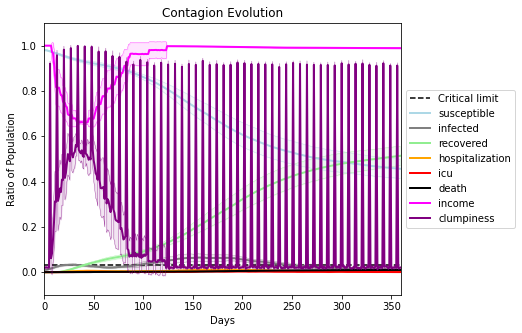

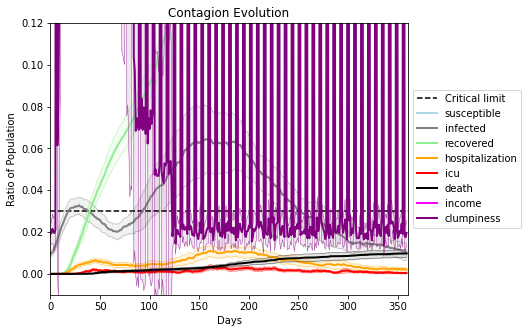

In [43]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.2
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[1841, 1981, 5209, 7746, 7575, 3590, 7839, 3708, 5058, 991, 108, 4010, 9655, 3450, 1341, 8503, 9894, 4369, 1156, 1175]
Average similarity between family members is 0.15284546200976362 at temperature -0.1
Average similarity between family and home is 0.9998433109195836 at temperature -1
Average similarity between students and their classroom is 0.17367563588656534 at temperature -0.1
Average classroom occupancy is 4.097222222222222 and number classrooms is 72
Average similarity between workers is 0.1511433069130945 at temperature -0.1
Average office occupancy is 3.2019704433497536 and number offices is 203
Average friend similarity for adults: 0.21228979184301386 for kids: 0.19982752936570622
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings

avg restaurant similarity 0.1095817099974376
avg restaurant similarity 0.08325643124843835
avg restaurant similarity 0.12024415605491419
avg restaurant similarity 0.10782158493630446
avg restaurant similarity 0.11078943855672223
avg restaurant similarity 0.07289328817426562
avg restaurant similarity 0.052496381935064396
avg restaurant similarity 0.0018724100899377115
avg restaurant similarity 0.02945274756259617
avg restaurant similarity 0.09514497229685592
avg restaurant similarity 0.08824789212802422
avg restaurant similarity 0.006919744320886999
avg restaurant similarity 0.02903872540780493
avg restaurant similarity 0.06938630320286403
avg restaurant similarity 0.03016425746409838
avg restaurant similarity 0.08816227096488922
avg restaurant similarity 0.10716791257110578
avg restaurant similarity 0.06925104596922119
avg restaurant similarity 0.13374908445417352
avg restaurant similarity 0.07508485957924621
avg restaurant similarity 0.060145226164412924
avg restaurant similarity 0.03

avg restaurant similarity 0.051868897304959465
avg restaurant similarity 0.10023983244897504
avg restaurant similarity 0.07367203908421605
avg restaurant similarity 0.08306483572827442
avg restaurant similarity 0.07490075784261624
avg restaurant similarity 0.06772172576410661
avg restaurant similarity 0.05855211665402483
avg restaurant similarity 0.10721293557481595
avg restaurant similarity 0.12244409750141697
avg restaurant similarity 0.056994963654866976
avg restaurant similarity 0.023360901472227125
avg restaurant similarity 0.046657434455221886
avg restaurant similarity 0.0993597698025488
avg restaurant similarity 0.0956495920307399
avg restaurant similarity 0.0633588895995085
avg restaurant similarity 0.050106885216548123
avg restaurant similarity 0.12114921301332743
avg restaurant similarity 0.047323171282358266
avg restaurant similarity 0.10185245749443135
avg restaurant similarity 0.10621140989807382
avg restaurant similarity 0.07438541003870869
avg restaurant similarity 0.067

avg restaurant similarity 0.03917198151305335
avg restaurant similarity 0.025715370862725313
avg restaurant similarity 0.03209669006003297
avg restaurant similarity 0.08306674457475108
avg restaurant similarity 0.06992686370983633
avg restaurant similarity 0.044859333842902124
avg restaurant similarity 0.02966051757741861
avg restaurant similarity 0.06450506063799716
avg restaurant similarity 0.0773570092875037
avg restaurant similarity 0.05115864042787202
avg restaurant similarity 0.06746887473231795
avg restaurant similarity 0.04589868533684242
avg restaurant similarity 0.02386335848411702
avg restaurant similarity 0.021334737878814472
avg restaurant similarity 0.07974948961468961
avg restaurant similarity 0.09545286960687147
avg restaurant similarity 0.002714380498467603
avg restaurant similarity 0.02571012693932523
avg restaurant similarity 0.06417038690865005
avg restaurant similarity 0.0517082662122915
avg restaurant similarity 0.06295923189178693
avg restaurant similarity 0.0529

avg restaurant similarity 0.10628143254475803
avg restaurant similarity 0.05699326296618904
avg restaurant similarity 0.06227102129351913
avg restaurant similarity 0.03023112646538549
avg restaurant similarity 0.061440419134489374
avg restaurant similarity 0.052036695969075
avg restaurant similarity 0.01420608808906687
avg restaurant similarity 0.07173505646156404
avg restaurant similarity 0.05151357293942204
avg restaurant similarity 0.030153802869329623
avg restaurant similarity 0.06626926364442544
avg restaurant similarity 0.026750683880343545
avg restaurant similarity 0.061142396820313465
avg restaurant similarity 0.03781328406822918
avg restaurant similarity 0.052815843878914435
avg restaurant similarity 0.04869103951508067
avg restaurant similarity 0.09415942318214335
avg restaurant similarity 0.07037433347800733
avg restaurant similarity 0.0576465711569847
avg restaurant similarity 0.013198039195227804
avg restaurant similarity 0.03583679827181826
avg restaurant similarity 0.118

avg restaurant similarity 0.05534391825482544
avg restaurant similarity 0.039226859492725925
avg restaurant similarity 0.06324420209712436
avg restaurant similarity 0.035982756578002144
avg restaurant similarity 0.06988002151795535
avg restaurant similarity 0.0737886870000119
avg restaurant similarity 0.06431681975979969
avg restaurant similarity 0.04508881171260484
avg restaurant similarity 0.014950303852419184
avg restaurant similarity 0.057749277076595426
avg restaurant similarity 0.07021668489764396
avg restaurant similarity 0.06929542594441894
avg restaurant similarity 0.04343721710698856
avg restaurant similarity 0.04029131383396506
avg restaurant similarity 0.00865121036664383
avg restaurant similarity 0.08974622099561216
avg restaurant similarity 0.07741591106799031
avg restaurant similarity 0.07592596339148888
avg restaurant similarity 0.0617132316972743
avg restaurant similarity 0.06291072820266591
avg restaurant similarity -0.007481930202282078
avg restaurant similarity 0.06

avg restaurant similarity 0.07825759235509874
avg restaurant similarity 0.062211267812304405
avg restaurant similarity 0.0666837583859612
avg restaurant similarity 0.0020680690756617226
avg restaurant similarity 0.017256698640504376
avg restaurant similarity -0.026430071144222505
avg restaurant similarity 0.018121596321119274
avg restaurant similarity 0.037323429535351935
avg restaurant similarity 0.011144921944587684
avg restaurant similarity 0.0433529043012622
avg restaurant similarity 0.06646891087421784
avg restaurant similarity 0.02279110445826295
avg restaurant similarity 0.06365154793879547
avg restaurant similarity 0.047441026485311025
avg restaurant similarity 0.011919871723030252
avg restaurant similarity 0.017133920696458187
avg restaurant similarity 0.08857557253641751
avg restaurant similarity 0.03347915669413214
avg restaurant similarity 0.08544725858855312
avg restaurant similarity 0.037206935010325605
avg restaurant similarity 0.08982748863637105
avg restaurant similari

avg restaurant similarity 0.06246431403952261
avg restaurant similarity 0.02034484363985845
avg restaurant similarity 0.08098293840664844
avg restaurant similarity 0.07065482064736472
avg restaurant similarity 0.0608650673089427
avg restaurant similarity 0.087814824991898
avg restaurant similarity 0.05481856081739936
avg restaurant similarity 0.08419572883802474
avg restaurant similarity 0.1023869755657569
avg restaurant similarity 0.03403343961847448
avg restaurant similarity 0.028100018533864346
avg restaurant similarity 0.03481528656317259
avg restaurant similarity 0.012024889584969538
avg restaurant similarity 0.06381268992656912
avg restaurant similarity 0.06711842718241189
avg restaurant similarity 0.021644925914510955
avg restaurant similarity 0.07996863819891037
avg restaurant similarity 0.10440258186976833
avg restaurant similarity 0.1004763969195999
avg restaurant similarity 0.03286140291500173
avg restaurant similarity 0.03274613104931104
avg restaurant similarity 0.05094492

avg restaurant similarity 0.006935678239097659
avg restaurant similarity 0.042033607220498155
avg restaurant similarity 0.028464002483596873
avg restaurant similarity 0.028320294360232808
avg restaurant similarity 0.07231750970616183
avg restaurant similarity -0.0027848606902379698
avg restaurant similarity 0.05411643413368337
avg restaurant similarity 0.06160422230003708
avg restaurant similarity 0.040814645824885296
avg restaurant similarity 0.015520904068681646
avg restaurant similarity 0.04726717744717879
avg restaurant similarity 0.07244364910784216
avg restaurant similarity 0.04481010146562487
avg restaurant similarity 0.0804535124763269
avg restaurant similarity 0.06840836707354539
avg restaurant similarity 0.03696413682088076
avg restaurant similarity 0.10089957749345595
avg restaurant similarity 0.052377468093452804
avg restaurant similarity 0.06348394562632338
avg restaurant similarity 0.05037736363287759
avg restaurant similarity 0.09345975651240082
avg restaurant similarity

avg restaurant similarity 0.013905050389158671
avg restaurant similarity 0.010826164392507063
avg restaurant similarity 0.021137286983477315
avg restaurant similarity 0.08844534788157593
avg restaurant similarity 0.02108905809711234
avg restaurant similarity 0.05699172392393076
avg restaurant similarity 0.05034428526952958
avg restaurant similarity 0.013325980063254313
avg restaurant similarity 0.0569132854099043
avg restaurant similarity 0.03855823740700903
avg restaurant similarity 0.05438020090835583
avg restaurant similarity 0.09438046316112356
avg restaurant similarity 0.08234433929832642
avg restaurant similarity 0.022611309125024903
avg restaurant similarity 0.05051330984011831
avg restaurant similarity 0.027033674627001913
avg restaurant similarity 0.07718727058891688
avg restaurant similarity 0.054858564945596315
avg restaurant similarity 0.027702398148564015
avg restaurant similarity 0.05492635317386247
avg restaurant similarity 0.06428630327140865
avg restaurant similarity 0

avg restaurant similarity 0.0384249978107815
avg restaurant similarity 0.08018073167519169
avg restaurant similarity 0.051790738717428855
avg restaurant similarity 0.05113036492919509
avg restaurant similarity 0.06089510597427985
avg restaurant similarity 0.0358619060956193
avg restaurant similarity 0.04494475632311291
avg restaurant similarity 0.07179723855740557
avg restaurant similarity 0.01283973735082794
avg restaurant similarity 0.05440333304249694
avg restaurant similarity 0.01037979714762179
avg restaurant similarity 0.0494021185473069
avg restaurant similarity 0.009123678543814694
avg restaurant similarity -0.003025265521562148
avg restaurant similarity 0.0438509731985147
avg restaurant similarity 0.05861127736611232
avg restaurant similarity 0.029056012097996162
avg restaurant similarity 0.09552921630505089
avg restaurant similarity 0.08153889793076259
avg restaurant similarity 0.023092254090571165
avg restaurant similarity 0.01678437676736153
avg restaurant similarity 0.0272

avg restaurant similarity 0.0643225965204005
avg restaurant similarity 0.03853064870403576
avg restaurant similarity 0.09127641809705302
avg restaurant similarity 0.03005030689498621
avg restaurant similarity 0.09217375874557404
avg restaurant similarity 0.02091018122199328
avg restaurant similarity 0.08394453628991776
avg restaurant similarity 0.03625360785071829
avg restaurant similarity 0.036459737619715694
avg restaurant similarity 0.06338699514272071
avg restaurant similarity 0.05636742699177159
avg restaurant similarity 0.05879706486205227
avg restaurant similarity 0.04782473682860615
avg restaurant similarity 0.05978105781385911
avg restaurant similarity 0.06278001966683057
avg restaurant similarity 0.0842289000159971
avg restaurant similarity 0.06869645904280071
avg restaurant similarity 0.05624888886292111
avg restaurant similarity 0.06840371133124992
avg restaurant similarity 0.05232904694032781
avg restaurant similarity 0.03728684451446223
avg restaurant similarity 0.0469814

avg restaurant similarity 0.049347895732021335
avg restaurant similarity 0.0538739203308297
avg restaurant similarity 0.07393226819307362
avg restaurant similarity 0.07821327253218982
avg restaurant similarity 0.05420607699015501
avg restaurant similarity 0.08716067057115727
avg restaurant similarity 0.07098072290938143
avg restaurant similarity 0.07959700265738315
avg restaurant similarity 0.05916698774483353
avg restaurant similarity 0.05417374922189788
avg restaurant similarity 0.03898862290955679
avg restaurant similarity 0.0520339073101154
avg restaurant similarity 0.05989842572595593
avg restaurant similarity 0.058226681424188936
avg restaurant similarity 0.05187214900290731
avg restaurant similarity 0.08454106930661151
avg restaurant similarity 0.045945942757549096
avg restaurant similarity 0.029940642576412022
avg restaurant similarity 0.05235712964597888
avg restaurant similarity 0.03571027246495941
avg restaurant similarity 0.060340034610857685
avg restaurant similarity 0.095

avg restaurant similarity 0.08644049606100945
avg restaurant similarity 0.06884724509370818
avg restaurant similarity 0.05118473665363248
avg restaurant similarity 0.08062716633339718
avg restaurant similarity 0.03348854917969769
avg restaurant similarity 0.058248343704563936
avg restaurant similarity 0.06293024601736465
avg restaurant similarity 0.04055408469048228
avg restaurant similarity -0.012823699931484325
avg restaurant similarity 0.015340130042467828
avg restaurant similarity 0.03177838175101014
avg restaurant similarity 0.06468844774588085
avg restaurant similarity 0.046605031786567254
avg restaurant similarity 0.02937087912553388
avg restaurant similarity 0.03537161115208821
avg restaurant similarity 0.0775015146283549
avg restaurant similarity 0.07130118256978643
avg restaurant similarity 0.06126898340171628
avg restaurant similarity 0.10499129520180465
avg restaurant similarity 0.07084566020590366
avg restaurant similarity 0.0972484056391225
avg restaurant similarity 0.052

avg restaurant similarity 0.025955114398742648
avg restaurant similarity 0.05391560435383747
avg restaurant similarity 0.07990642591373626
avg restaurant similarity 0.06580839236454016
avg restaurant similarity 0.0704788928972041
avg restaurant similarity 0.04714468572436555
avg restaurant similarity 0.04662354325201162
avg restaurant similarity 0.07771072088334
avg restaurant similarity 0.05050769391899125
avg restaurant similarity 0.015705281210225863
avg restaurant similarity 0.08843287625038433
avg restaurant similarity 0.013911084259101775
avg restaurant similarity 0.069909841707903
avg restaurant similarity 0.10720898192986406
avg restaurant similarity 0.04856625304472624
avg restaurant similarity 0.036964948954830476
avg restaurant similarity 0.08698643354096447
avg restaurant similarity 0.05274139101466804
avg restaurant similarity 0.06308404547481725
avg restaurant similarity 0.08051016865792723
avg restaurant similarity 0.08313138432200717
avg restaurant similarity 0.03812211

avg restaurant similarity 0.09595711224775039
avg restaurant similarity 0.058832585285580795
avg restaurant similarity 0.0533786892715207
avg restaurant similarity 0.0675707858719643
avg restaurant similarity 0.05474489156651065
avg restaurant similarity 0.08054908241132903
avg restaurant similarity 0.07639757587035721
avg restaurant similarity 0.09215072321425138
avg restaurant similarity 0.03031272818428677
avg restaurant similarity 0.07028448493371124
avg restaurant similarity 0.12182681507017629
avg restaurant similarity 0.10354377553217045
avg restaurant similarity 0.09034740929446267
avg restaurant similarity 0.06948207054299743
avg restaurant similarity 0.06975491398789158
avg restaurant similarity 0.08270753764151817
avg restaurant similarity 0.028567613632174756
avg restaurant similarity 0.08649733928069664
avg restaurant similarity 0.04115720679959396
avg restaurant similarity 0.026201668615618786
avg restaurant similarity 0.05137122386577562
avg restaurant similarity 0.09632

avg restaurant similarity 0.07470546779412587
avg restaurant similarity 0.09675745331366514
avg restaurant similarity 0.04724569446300745
avg restaurant similarity 0.12055614563680195
avg restaurant similarity 0.05018376427519064
avg restaurant similarity 0.029568953485538504
avg restaurant similarity 0.034489688596963206
avg restaurant similarity 0.08802566014659895
avg restaurant similarity 0.05724656233945729
avg restaurant similarity 0.05474567242305875
avg restaurant similarity 0.09822029495311747
avg restaurant similarity 0.09732142011429015
avg restaurant similarity 0.05931240314386191
avg restaurant similarity 0.027125515294758165
avg restaurant similarity 0.06332508913117108
avg restaurant similarity 0.04456910897997428
avg restaurant similarity 0.07384020612953879
avg restaurant similarity 0.11543335953101908
avg restaurant similarity 0.07086575136284293
avg restaurant similarity 0.06176321962065149
avg restaurant similarity 0.09508469836935547
avg restaurant similarity 0.052

avg restaurant similarity 0.0919194947727628
avg restaurant similarity 0.035591661326566666
avg restaurant similarity 0.030316708692729195
avg restaurant similarity 0.020345254973891714
avg restaurant similarity 0.06101860284341036
avg restaurant similarity -0.0006688436937633346
avg restaurant similarity 0.05412997611892561
avg restaurant similarity -0.013009248990365735
avg restaurant similarity 0.032964133778324106
avg restaurant similarity 0.029494347844947467
avg restaurant similarity 0.011241975707473654
avg restaurant similarity 0.015995524852720565
avg restaurant similarity 0.036374247710303745
avg restaurant similarity -0.00245021640779998
avg restaurant similarity 0.07995068994291775
avg restaurant similarity 0.0717036401669219
avg restaurant similarity 0.0701327706952142
avg restaurant similarity 0.02086605500577319
avg restaurant similarity 0.07892005315885298
avg restaurant similarity 0.07632356959943261
avg restaurant similarity 0.08044812060508265
avg restaurant similari

avg restaurant similarity 0.09007977669557649
avg restaurant similarity 0.03412102665189008
avg restaurant similarity 0.004853382084729637
avg restaurant similarity 0.09507649824322878
avg restaurant similarity 0.08879176120423457
avg restaurant similarity 0.0670259323786041
avg restaurant similarity 0.06880639173152144
avg restaurant similarity 0.06754268493181859
avg restaurant similarity 0.0629180287309068
avg restaurant similarity 0.04086145325704443
avg restaurant similarity 0.07364248865344644
avg restaurant similarity 0.009529243448548096
avg restaurant similarity 0.043464463759353054
avg restaurant similarity 0.07728246689615856
avg restaurant similarity 0.05717772874416948
avg restaurant similarity 0.05899980763892004
avg restaurant similarity 0.06102032172650688
avg restaurant similarity 0.05735070691863081
avg restaurant similarity 0.053154067533092424
avg restaurant similarity 0.05702566774661333
avg restaurant similarity 0.06511893856150054
avg restaurant similarity 0.0542

avg restaurant similarity 0.14480243841541812
avg restaurant similarity 0.035416468907205116
avg restaurant similarity 0.04983288173553562
avg restaurant similarity 0.014928553810488465
avg restaurant similarity 0.06692833660868974
avg restaurant similarity 0.08745575255272765
avg restaurant similarity 0.04527758620607453
avg restaurant similarity 0.052100084816954384
avg restaurant similarity 0.018391518428021843
avg restaurant similarity 0.10681983578844305
avg restaurant similarity 0.000718141343061933
avg restaurant similarity 0.049894937122628116
avg restaurant similarity 0.05731273695873963
avg restaurant similarity 0.005621041779176477
avg restaurant similarity 0.05154099921640974
avg restaurant similarity 0.046880966843987674
avg restaurant similarity 0.07983945892331878
avg restaurant similarity 0.04658546152774146
avg restaurant similarity 0.03885049871731229
avg restaurant similarity 0.09096276362486738
avg restaurant similarity 0.07692736111985078
avg restaurant similarity 

avg restaurant similarity 0.05393629531599744
avg restaurant similarity 0.02247805171745289
avg restaurant similarity 0.09190758044198284
avg restaurant similarity 0.049166567807828285
avg restaurant similarity 0.07533400873864347
avg restaurant similarity -0.014795979836293724
avg restaurant similarity 0.015138446468030779
avg restaurant similarity 0.08603529975272908
avg restaurant similarity 0.09326185651335187
avg restaurant similarity 0.07465700835884427
avg restaurant similarity 0.10424111023854148
avg restaurant similarity 0.05328653203353266
avg restaurant similarity 0.06013465664438609
avg restaurant similarity 0.05957405675673579
avg restaurant similarity 0.08569794691851705
avg restaurant similarity 0.030754357786086674
avg restaurant similarity 0.025718757900211782
avg restaurant similarity 0.06344131026806181
avg restaurant similarity 0.10617200936520466
avg restaurant similarity 0.05945272467731335
avg restaurant similarity 0.08016798095945794
avg restaurant similarity 0.

avg restaurant similarity 0.07501379430199988
avg restaurant similarity 0.10308803320341423
avg restaurant similarity 0.08784673677283811
avg restaurant similarity 0.06873545442182044
avg restaurant similarity 0.055469672639636855
avg restaurant similarity 0.07667962094781947
avg restaurant similarity 0.08053391373010153
avg restaurant similarity 0.06187820360595321
avg restaurant similarity 0.10006502832793397
avg restaurant similarity 0.11883362759269003
avg restaurant similarity 0.053210165119785824
avg restaurant similarity 0.09659540072012539
avg restaurant similarity 0.038217391787251746
avg restaurant similarity 0.03837852988301223
avg restaurant similarity 0.1288654018622754
avg restaurant similarity 0.081666598520401
avg restaurant similarity 0.08951905236989084
avg restaurant similarity 0.09936057600842856
avg restaurant similarity 0.06770652632842429
avg restaurant similarity 0.12320548725913293
avg restaurant similarity 0.11871831999773756
avg restaurant similarity 0.127121

avg restaurant similarity 0.11036151130272262
avg restaurant similarity 0.05244402081959009
avg restaurant similarity 0.07657857856621259
avg restaurant similarity 0.11512373791837997
avg restaurant similarity 0.09559574541179837
avg restaurant similarity 0.05086116483520213
avg restaurant similarity 0.09520853792281667
avg restaurant similarity 0.06482453808624208
avg restaurant similarity 0.05891748279167284
avg restaurant similarity 0.08334628027150431
avg restaurant similarity 0.09766574909858358
avg restaurant similarity 0.046597948168137907
avg restaurant similarity 0.07406282368915935
avg restaurant similarity 0.04185530815707299
avg restaurant similarity 0.07126213913877688
avg restaurant similarity 0.10587741698254552
avg restaurant similarity 0.11821542247282289
avg restaurant similarity 0.04524725606407265
avg restaurant similarity 0.05740737871794375
avg restaurant similarity 0.03553214861014266
avg restaurant similarity 0.06522533094338921
avg restaurant similarity 0.07102

avg restaurant similarity 0.1180959988539802
avg restaurant similarity 0.08620605808826484
avg restaurant similarity 0.09573011021217598
avg restaurant similarity 0.11828028477030358
avg restaurant similarity 0.07626916040803397
avg restaurant similarity 0.08666864513711606
avg restaurant similarity 0.01883680645557723
avg restaurant similarity 0.0974480996485389
avg restaurant similarity 0.02097133813621503
avg restaurant similarity 0.048426790892046497
avg restaurant similarity 0.08063778982217525
avg restaurant similarity 0.057621426145586414
avg restaurant similarity 0.06571594628548284
avg restaurant similarity 0.04365077761200157
avg restaurant similarity 0.10600116833462367
avg restaurant similarity 0.0684387334801175
avg restaurant similarity 0.08404868285787465
avg restaurant similarity 0.03336567696178854
avg restaurant similarity 0.056526789209965435
avg restaurant similarity 0.07110324795062983
avg restaurant similarity 0.07058343558350368
avg restaurant similarity 0.032825

avg restaurant similarity 0.07655904365063187
avg restaurant similarity 0.10717670687946
avg restaurant similarity 0.05528648213161691
avg restaurant similarity 0.13657474728057245
avg restaurant similarity 0.10011985380251871
avg restaurant similarity 0.07175632059168084
avg restaurant similarity 0.03640334619538603
avg restaurant similarity 0.0818796235775553
avg restaurant similarity 0.10010136192414672
avg restaurant similarity 0.07510389331893619
avg restaurant similarity 0.013273778566952601
avg restaurant similarity 0.05384953141811856
avg restaurant similarity 0.07484382857438866
avg restaurant similarity 0.09479973268127923
avg restaurant similarity 0.10065188663065393
avg restaurant similarity 0.07354049383044156
avg restaurant similarity 0.0653761423511263
avg restaurant similarity 0.03791133080815525
avg restaurant similarity 0.06492271705091827
avg restaurant similarity 0.05615230204727033
avg restaurant similarity 0.049411169873169236
avg restaurant similarity 0.088134687

avg restaurant similarity 0.030141496583920714
avg restaurant similarity 0.016733807268560365
avg restaurant similarity 0.05335438817562273
avg restaurant similarity 0.027573571275276283
avg restaurant similarity 0.057418869812575345
avg restaurant similarity 0.04369055975164964
avg restaurant similarity 0.031304721134988854
avg restaurant similarity 0.05075173637105775
avg restaurant similarity 0.03630432650089444
avg restaurant similarity 0.04306168466136697
avg restaurant similarity 0.08017053036015583
avg restaurant similarity 0.07344640215773633
avg restaurant similarity 0.08302577316579447
avg restaurant similarity 0.0410279285661746
avg restaurant similarity 0.039233585095423316
avg restaurant similarity 0.040784101364366956
avg restaurant similarity 0.05394076641507501
avg restaurant similarity -0.0005543057805469363
avg restaurant similarity 0.040147218931925376
avg restaurant similarity 0.05925142707404034
avg restaurant similarity 0.06500488382134025
avg restaurant similarit

avg restaurant similarity 0.07589550674804346
avg restaurant similarity 0.12085719446967533
avg restaurant similarity 0.02362770897922719
avg restaurant similarity 0.04182434145772043
avg restaurant similarity 0.07829960209589162
avg restaurant similarity 0.06195469319430953
avg restaurant similarity 0.0756541845114797
avg restaurant similarity 0.05652614647508473
avg restaurant similarity 0.09593833188335414
avg restaurant similarity 0.10293009181160358
avg restaurant similarity 0.04447264544046624
avg restaurant similarity 0.007888280721896594
avg restaurant similarity 0.09176809878649465
avg restaurant similarity 0.055132360605931525
avg restaurant similarity 0.041160721179750864
avg restaurant similarity 0.08562744033746654
avg restaurant similarity 0.030656902290740345
avg restaurant similarity 0.06098531314558377
avg restaurant similarity 0.060796098169188725
avg restaurant similarity 0.09286456493174786
avg restaurant similarity 0.05992048538516369
avg restaurant similarity 0.06

avg restaurant similarity 0.06404979060148575
avg restaurant similarity 0.07704019912241848
avg restaurant similarity 0.02965866183520554
avg restaurant similarity 0.026442284276839353
avg restaurant similarity 0.10747082751346021
avg restaurant similarity 0.05472152328811759
avg restaurant similarity 0.0686912125786858
avg restaurant similarity 0.0722899596344756
avg restaurant similarity 0.09008902843709188
avg restaurant similarity 0.0680290334553933
avg restaurant similarity 0.03381194179552236
avg restaurant similarity -0.0155590890440836
avg restaurant similarity 0.0445359894032658
avg restaurant similarity 0.07750169621928114
avg restaurant similarity 0.06067267846501738
avg restaurant similarity 0.06638518378252656
avg restaurant similarity 0.09061923703892404
avg restaurant similarity 0.11641080610965421
avg restaurant similarity 0.04350329439446313
avg restaurant similarity 0.034545579261892015
avg restaurant similarity 0.08945463840711573
avg restaurant similarity 0.06117724

avg restaurant similarity -0.0004229504985450328
avg restaurant similarity 0.10586702751385568
avg restaurant similarity 0.09229630568549196
avg restaurant similarity 0.1139818210504977
avg restaurant similarity 0.011724614223417352
avg restaurant similarity 0.06031943215451722
avg restaurant similarity 0.015489977280058385
avg restaurant similarity 0.12579985242391775
avg restaurant similarity 0.05100209386727944
avg restaurant similarity 0.06613021262138645
avg restaurant similarity 0.05574742359638551
avg restaurant similarity 0.02149806837091313
avg restaurant similarity 0.012002470099386068
avg restaurant similarity 0.05831207149599779
avg restaurant similarity 0.047686758203400854
avg restaurant similarity 0.0550161718039383
avg restaurant similarity 0.07431455524394119
avg restaurant similarity 0.0754266725861213
avg restaurant similarity 0.04334137557994451
avg restaurant similarity 0.02814319368927203
avg restaurant similarity 0.08473018430555244
avg restaurant similarity 0.09

avg restaurant similarity 0.05244318021025668
avg restaurant similarity 0.006312881220270491
avg restaurant similarity 0.0551131961822092
avg restaurant similarity 0.11541477725564307
avg restaurant similarity 0.046425603264627156
avg restaurant similarity 0.07870950138606155
avg restaurant similarity 0.07283179555311167
avg restaurant similarity 0.03269129250185564
avg restaurant similarity 0.09174696683049796
avg restaurant similarity 0.048410155263541296
avg restaurant similarity 0.08738920911585982
avg restaurant similarity 0.07459663299408369
avg restaurant similarity 0.09317434005735596
avg restaurant similarity 0.07044521651404674
avg restaurant similarity 0.043037406111399876
avg restaurant similarity 0.019972371230963765
avg restaurant similarity 0.09055337025929668
avg restaurant similarity 0.0446611046070443
avg restaurant similarity 0.018891706777686475
avg restaurant similarity 0.08723774497368836
avg restaurant similarity 0.04775508195388405
avg restaurant similarity 0.03

avg restaurant similarity 0.08343000337562698
avg restaurant similarity 0.027364247384546812
avg restaurant similarity 0.03880827823775773
avg restaurant similarity 0.07536364704076878
avg restaurant similarity 0.05306193822984618
avg restaurant similarity 0.02295780108519563
avg restaurant similarity 0.05191184278264736
avg restaurant similarity 0.08062271425630699
avg restaurant similarity 0.020418511118798482
avg restaurant similarity 0.0401742413097939
avg restaurant similarity 0.10768595121603232
avg restaurant similarity 0.026566986349185508
avg restaurant similarity 0.05039466921100414
avg restaurant similarity 0.10447060128590129
avg restaurant similarity 0.027457773015373832
avg restaurant similarity 0.06310886473425857
avg restaurant similarity 0.0243190074288124
avg restaurant similarity 0.054607863964383316
avg restaurant similarity 0.06419175549475098
avg restaurant similarity 0.07151986262825237
avg restaurant similarity 0.05865986055305655
avg restaurant similarity 0.061

avg restaurant similarity 0.0208266117941357
avg restaurant similarity 0.07717542313056203
avg restaurant similarity 0.06859935196453977
avg restaurant similarity 0.033079040598925885
avg restaurant similarity 0.05677457084699786
avg restaurant similarity 0.08219808058196482
avg restaurant similarity 0.04246727321797038
avg restaurant similarity 0.1158491616007005
avg restaurant similarity 0.07371205169818752
avg restaurant similarity 0.06934097496654616
avg restaurant similarity 0.06700307764376043
avg restaurant similarity 0.06080222550903632
avg restaurant similarity 0.07497773494121943
avg restaurant similarity 0.02562843624250921
avg restaurant similarity 0.06440537549908919
avg restaurant similarity 0.08014366151011777
avg restaurant similarity 0.022383677539694738
avg restaurant similarity 0.03999008463542697
avg restaurant similarity 0.07492283015158403
avg restaurant similarity 0.0309683551967261
avg restaurant similarity 0.044721397216729894
avg restaurant similarity 0.061626

avg restaurant similarity 0.04891092758809237
avg restaurant similarity 0.06324180622213926
avg restaurant similarity 0.09989961570646001
avg restaurant similarity 0.08567981295098732
avg restaurant similarity 0.07931876274261619
avg restaurant similarity 0.06645132457322014
avg restaurant similarity 0.053641734767003256
avg restaurant similarity 0.07736340047172778
avg restaurant similarity 0.047635325611252916
avg restaurant similarity 0.02469165256832167
avg restaurant similarity 0.006372251783601064
avg restaurant similarity 0.07263263605352582
avg restaurant similarity 0.08277840198082159
avg restaurant similarity 0.05096471699689807
avg restaurant similarity 0.05669592092371388
avg restaurant similarity 0.0324343262217228
avg restaurant similarity 0.07559454938453776
avg restaurant similarity 0.08898219996824296
avg restaurant similarity 0.0403059775078785
avg restaurant similarity 0.06376074882957007
avg restaurant similarity 0.06796434264545477
avg restaurant similarity 0.01172

avg restaurant similarity 0.04065629530552421
avg restaurant similarity 0.03493601209581233
avg restaurant similarity 0.048933693178250165
avg restaurant similarity 0.0006908609429197365
avg restaurant similarity 0.09527586856331592
avg restaurant similarity 0.06709571978332246
avg restaurant similarity 0.05713667505614716
avg restaurant similarity 0.07408149927988925
avg restaurant similarity 0.08884707897235414
avg restaurant similarity 0.07870549468483545
avg restaurant similarity 0.050969571916533375
avg restaurant similarity 0.0598416513707825
avg restaurant similarity 0.035664404781501326
avg restaurant similarity 0.07292540895363764
avg restaurant similarity 0.06940479799332168
avg restaurant similarity 0.08151905200766622
avg restaurant similarity 0.11427272117243978
avg restaurant similarity 0.10360507304989154
avg restaurant similarity 0.10110334955365499
avg restaurant similarity 0.04780363537264489
avg restaurant similarity 0.02964198085389756
avg restaurant similarity 0.06

avg restaurant similarity 0.024101998246631527
avg restaurant similarity 0.0913656188860504
avg restaurant similarity 0.06120385665263825
avg restaurant similarity -0.004822038516345567
avg restaurant similarity 0.08386762426252162
avg restaurant similarity 0.05127185464632942
avg restaurant similarity 0.07805577669897666
avg restaurant similarity 0.03238305468241837
avg restaurant similarity 0.006549354513274687
avg restaurant similarity 0.05546236689822327
avg restaurant similarity 0.04020861238297733
avg restaurant similarity 0.0787395932350749
avg restaurant similarity 0.06224808963648377
avg restaurant similarity 0.07114143166939595
avg restaurant similarity 0.07958901207397645
avg restaurant similarity 0.0571386015613907
avg restaurant similarity 0.06720898825303186
avg restaurant similarity 0.025125803968521987
avg restaurant similarity 0.07874976703562263
avg restaurant similarity 0.08887248570514342
avg restaurant similarity 0.036284165359087725
avg restaurant similarity -0.00

avg restaurant similarity 0.009658315731604632
avg restaurant similarity 0.09884882323179474
avg restaurant similarity 0.04030946272603177
avg restaurant similarity 0.0069318248916560915
avg restaurant similarity 0.04859878129493058
avg restaurant similarity 0.039980165598165744
avg restaurant similarity 0.009656440883060757
avg restaurant similarity 0.04004185642971524
avg restaurant similarity 0.02964571774888404
avg restaurant similarity 0.05846874969380335
avg restaurant similarity 0.044372712527692246
avg restaurant similarity 0.05993968358985658
avg restaurant similarity 0.09951014330538571
avg restaurant similarity 0.05341507432613081
avg restaurant similarity 0.07596986168989857
avg restaurant similarity 0.03834874371061144
avg restaurant similarity 0.09767862278905978
avg restaurant similarity 0.04566913305204801
avg restaurant similarity 0.06261950310656209
avg restaurant similarity 0.08595070163541588
avg restaurant similarity 0.01287398449917919
avg restaurant similarity 0.

avg restaurant similarity 0.09880424207106034
avg restaurant similarity 0.12199790355140891
avg restaurant similarity 0.07561816488473909
avg restaurant similarity 0.03428384124535831
avg restaurant similarity 0.030681355160639495
avg restaurant similarity 0.0701048970884789
avg restaurant similarity 0.041808552397290415
avg restaurant similarity 0.04725667907896163
avg restaurant similarity 0.08002356591590211
avg restaurant similarity 0.07412878915735106
avg restaurant similarity 0.07339850438898925
avg restaurant similarity 0.0936577861460834
avg restaurant similarity 0.12182929151663502
avg restaurant similarity 0.07330901829667719
avg restaurant similarity 0.037434477134628164
avg restaurant similarity 0.0770513928733336
avg restaurant similarity 0.05403315513016965
avg restaurant similarity 0.09581453885597954
avg restaurant similarity 0.01614325309313114
avg restaurant similarity 0.01510193595702716
avg restaurant similarity 0.06153856706829994
avg restaurant similarity 0.060863

avg restaurant similarity 0.08396236835759
avg restaurant similarity 0.043042595018965374
avg restaurant similarity 0.05624106260265865
avg restaurant similarity 0.030822069277388474
avg restaurant similarity 0.07208325549641462
avg restaurant similarity 0.02874068941887333
avg restaurant similarity 0.05757147586397369
avg restaurant similarity 0.0642528212747234
avg restaurant similarity 0.09049327974490821
avg restaurant similarity 0.062299548415081334
avg restaurant similarity 0.101418346300698
avg restaurant similarity 0.04318510029853531
avg restaurant similarity 0.07319300895139377
avg restaurant similarity 0.014330653721501918
avg restaurant similarity 0.048474840315134354
avg restaurant similarity 0.07029991299191754
avg restaurant similarity 0.075608349824924
avg restaurant similarity 0.05772372057214757
avg restaurant similarity 0.051214610662067554
avg restaurant similarity 0.05536450215542219
avg restaurant similarity 0.08733088380054138
avg restaurant similarity 0.04711254

avg restaurant similarity 0.06638357241263908
avg restaurant similarity 0.07410641188627491
avg restaurant similarity 0.0650159839451578
avg restaurant similarity 0.08458334402703477
avg restaurant similarity 0.06775865395082989
avg restaurant similarity 0.0618719393797322
avg restaurant similarity 0.09883020688339748
avg restaurant similarity 0.08226381043769877
avg restaurant similarity 0.05760799033114885
avg restaurant similarity 0.029349507846359407
avg restaurant similarity 0.05009633364547505
avg restaurant similarity 0.0241719971835784
avg restaurant similarity 0.07342584626102777
avg restaurant similarity 0.07059585528415518
avg restaurant similarity 0.04460881045945137
avg restaurant similarity 0.07344431528592159
avg restaurant similarity 0.04111659542434113
avg restaurant similarity 0.09339400713382032
avg restaurant similarity 0.07705594014828689
avg restaurant similarity 0.04914271880504452
avg restaurant similarity 0.059114957810999756
avg restaurant similarity 0.0566503

avg restaurant similarity 0.0717619222478716
avg restaurant similarity 0.11669241635514281
avg restaurant similarity 0.10447913201310755
avg restaurant similarity 0.09883824853450093
avg restaurant similarity 0.08102274536265898
avg restaurant similarity 0.1006886924845259
avg restaurant similarity 0.09625346221649347
avg restaurant similarity 0.06504915072770293
avg restaurant similarity 0.06882762666818504
avg restaurant similarity 0.09975018104036332
avg restaurant similarity 0.08284813598993251
avg restaurant similarity 0.1268809851128748
avg restaurant similarity 0.1381306179054754
avg restaurant similarity 0.10641317710572756
avg restaurant similarity 0.09645411006722202
avg restaurant similarity 0.045492021554526335
avg restaurant similarity 0.06752266104493178
avg restaurant similarity 0.06939886330635253
avg restaurant similarity 0.07469696222525665
avg restaurant similarity 0.06485697464795548
avg restaurant similarity 0.11335040302257672
avg restaurant similarity 0.079282795

avg restaurant similarity 0.08651383478218073
avg restaurant similarity 0.050646431522186015
avg restaurant similarity 0.07191111232339573
avg restaurant similarity 0.1119357565438153
avg restaurant similarity 0.0814623043315784
avg restaurant similarity 0.027018894880937155
avg restaurant similarity 0.07062730157960354
avg restaurant similarity 0.05320392725319843
avg restaurant similarity 0.04742389398270314
avg restaurant similarity 0.09087093855718643
avg restaurant similarity 0.06957196372224335
avg restaurant similarity 0.07195841618136023
avg restaurant similarity 0.0607177612689133
avg restaurant similarity 0.06014302929729907
avg restaurant similarity 0.0816872886187226
avg restaurant similarity 0.060468305358270434
avg restaurant similarity 0.12320768778973401
avg restaurant similarity 0.0576282896608388
avg restaurant similarity 0.08178169014946707
avg restaurant similarity 0.06656772526979703
avg restaurant similarity 0.05213861013125667
avg restaurant similarity 0.08288664

(<function dict.items>, <function dict.items>, <function dict.items>)

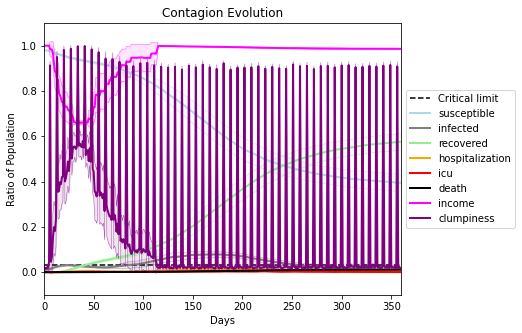

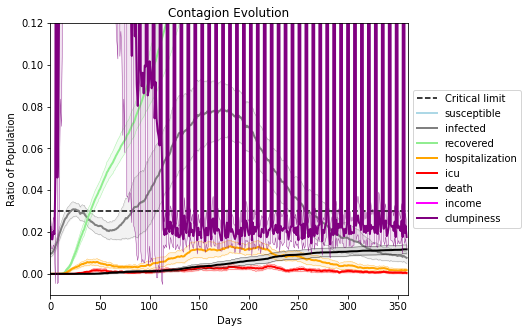

In [44]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.1
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[2019, 5888, 3793, 6071, 4475, 7735, 1644, 7943, 6304, 911, 3463, 1138, 926, 9147, 6274, 4108, 1230, 4101, 903, 9905]
Average similarity between family members is 0.16006532204877355 at temperature 0
Average similarity between family and home is 0.9998647217592679 at temperature -1
Average similarity between students and their classroom is 0.19130469653503732 at temperature 0
Average classroom occupancy is 4.057142857142857 and number classrooms is 70
Average similarity between workers is 0.13521086075902988 at temperature 0
Average office occupancy is 3.2610837438423643 and number offices is 203
Average friend similarity for adults: 0.2099792922445856 for kids: 0.19542930589670876
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homogeneous

avg restaurant similarity 0.005755652814121611
avg restaurant similarity 0.050546298063884346
avg restaurant similarity 0.0488651444801057
avg restaurant similarity 0.0637054596692286
avg restaurant similarity 0.08449588767951155
avg restaurant similarity 0.014844499235034093
avg restaurant similarity 0.089301958660663
avg restaurant similarity 0.014191946290710992
avg restaurant similarity 0.02005933732881465
avg restaurant similarity 0.04915653739460634
avg restaurant similarity 0.03854419467251125
avg restaurant similarity 0.025443748232552247
avg restaurant similarity -0.00038931118606777917
avg restaurant similarity 0.0757266872005213
avg restaurant similarity 0.005077412265906172
avg restaurant similarity 0.029628880471393483
avg restaurant similarity 0.031061844363284893
avg restaurant similarity 0.029044062033988686
avg restaurant similarity 0.06564248152311378
avg restaurant similarity -0.018872480231222316
avg restaurant similarity 0.07494108163747475
avg restaurant similarit

avg restaurant similarity 0.034228487777037346
avg restaurant similarity -0.006551552918155991
avg restaurant similarity 0.0485835032396367
avg restaurant similarity 0.0382960540640337
avg restaurant similarity 0.035184880035991344
avg restaurant similarity 0.03443699468058696
avg restaurant similarity -0.010349840066635457
avg restaurant similarity 0.05072972316793494
avg restaurant similarity 0.03165036354947089
avg restaurant similarity 0.04558584067409959
avg restaurant similarity 0.027466842066774872
avg restaurant similarity -0.019942045625077964
avg restaurant similarity 0.03914176021859559
avg restaurant similarity 0.06652706586774625
avg restaurant similarity 0.0446823894978319
avg restaurant similarity 0.018753800897383658
avg restaurant similarity 0.06312222941173679
avg restaurant similarity 0.08837586791511488
avg restaurant similarity 0.041605539549007205
avg restaurant similarity 0.02472957993356358
avg restaurant similarity 0.043876622378982225
avg restaurant similarity

avg restaurant similarity 0.045788187266586206
avg restaurant similarity 0.06768659437588516
avg restaurant similarity 0.08015808817304425
avg restaurant similarity 0.0547264647498322
avg restaurant similarity 0.035518530953509875
avg restaurant similarity 0.05906972767414026
avg restaurant similarity -0.015069456036398567
avg restaurant similarity 0.028872000095600113
avg restaurant similarity 0.08267257678635888
avg restaurant similarity 0.0404989368087144
avg restaurant similarity 0.07247933263650883
avg restaurant similarity 0.05048595904365023
avg restaurant similarity 0.02234720713163912
avg restaurant similarity 0.02085927578357604
avg restaurant similarity 0.07281155833169002
avg restaurant similarity 0.10988498904464204
avg restaurant similarity 0.08607812576199073
avg restaurant similarity 0.044459156316731405
avg restaurant similarity 0.05178729037678737
avg restaurant similarity 0.04144954033198819
avg restaurant similarity 0.0478996352263982
avg restaurant similarity 0.083

avg restaurant similarity 0.09967790172239181
avg restaurant similarity 0.07213241287391552
avg restaurant similarity 0.015223595348095061
avg restaurant similarity 0.021681460011502333
avg restaurant similarity 0.0635318629109222
avg restaurant similarity 0.11156099443865111
avg restaurant similarity 0.0028223432914504807
avg restaurant similarity 0.04283950840925598
avg restaurant similarity 0.06462478507268912
avg restaurant similarity 0.0454504804772915
avg restaurant similarity 0.051485214488527914
avg restaurant similarity 0.04334808146512464
avg restaurant similarity 0.039896897673693976
avg restaurant similarity 0.044692833283600304
avg restaurant similarity 0.033057126996464556
avg restaurant similarity 0.053511703626352894
avg restaurant similarity 0.02611833243708429
avg restaurant similarity 0.0440368399168576
avg restaurant similarity 0.030237590074000176
avg restaurant similarity 0.04674139744908126
avg restaurant similarity 0.06467398928007102
avg restaurant similarity 0

avg restaurant similarity 0.08794157681608311
avg restaurant similarity 0.09964489311152716
avg restaurant similarity 0.04889424097651394
avg restaurant similarity 0.06379104412404187
avg restaurant similarity 0.07827948293099839
avg restaurant similarity 0.0629909234050271
avg restaurant similarity 0.09608671198850678
avg restaurant similarity 0.06740488656186196
avg restaurant similarity 0.03148638697640529
avg restaurant similarity 0.07666063881897543
avg restaurant similarity 0.04963033779068102
avg restaurant similarity 0.022612498229968362
avg restaurant similarity 0.061047241661723754
avg restaurant similarity 0.07195860572361204
avg restaurant similarity 0.053516234624785594
avg restaurant similarity 0.05642676859404955
avg restaurant similarity 0.045963961291024015
avg restaurant similarity 0.05933013413054805
avg restaurant similarity 0.049302987527140955
avg restaurant similarity 0.09692869348689905
avg restaurant similarity 0.07385803210944565
avg restaurant similarity 0.16

avg restaurant similarity 0.08921211593683426
avg restaurant similarity 0.08381146902583006
avg restaurant similarity 0.10992879187703279
avg restaurant similarity 0.05844585089271786
avg restaurant similarity 0.0733605185687053
avg restaurant similarity 0.0341113717955214
avg restaurant similarity 0.058864604713642084
avg restaurant similarity 0.056525938329658784
avg restaurant similarity 0.0699239734948095
avg restaurant similarity 0.0767115312289218
avg restaurant similarity 0.08038636745191825
avg restaurant similarity 0.07181635700149785
avg restaurant similarity 0.047894075592029045
avg restaurant similarity 0.04596440796534077
avg restaurant similarity 0.0396556393395669
avg restaurant similarity 0.03783979843584554
avg restaurant similarity 0.059721635513361966
avg restaurant similarity 0.08639635377193121
avg restaurant similarity 0.13945057505896521
avg restaurant similarity 0.11418947951757612
avg restaurant similarity 0.09805961189815879
avg restaurant similarity 0.0694046

avg restaurant similarity 0.041941643081359274
avg restaurant similarity 0.10463821037560725
avg restaurant similarity 0.06509264498649227
avg restaurant similarity 0.09892712454482339
avg restaurant similarity 0.04852931381028093
avg restaurant similarity 0.049385472000899516
avg restaurant similarity 0.08896717959020024
avg restaurant similarity 0.026577817586392296
avg restaurant similarity 0.02691192408843329
avg restaurant similarity 0.06485323052165547
avg restaurant similarity 0.010665789977704905
avg restaurant similarity 0.06255951516870044
avg restaurant similarity 0.08682346886807896
avg restaurant similarity 0.0176480714339281
avg restaurant similarity 0.06254252983192504
avg restaurant similarity 0.08568174246736009
avg restaurant similarity 0.09802621848016434
avg restaurant similarity 0.08328289222259724
avg restaurant similarity 0.051403282003445364
avg restaurant similarity 0.06899149767610585
avg restaurant similarity 0.025013863183514635
avg restaurant similarity 0.0

avg restaurant similarity 0.08571894663932705
avg restaurant similarity 0.026792942381217853
avg restaurant similarity 0.05130788007479855
avg restaurant similarity 0.06700076631990504
avg restaurant similarity 0.06278320926175279
avg restaurant similarity 0.033039412096526055
avg restaurant similarity 0.010023979092218235
avg restaurant similarity -0.004073858878988459
avg restaurant similarity 0.059361555820188906
avg restaurant similarity 0.08143130591879678
avg restaurant similarity 0.06131818937456069
avg restaurant similarity -0.005843417452758181
avg restaurant similarity 0.07761675940789275
avg restaurant similarity 0.08641443597489668
avg restaurant similarity 0.07834139525180356
avg restaurant similarity 0.04469035046158696
avg restaurant similarity 0.021298069786487683
avg restaurant similarity 0.03738799205955664
avg restaurant similarity 0.08125646803948476
avg restaurant similarity 0.05047714479101086
avg restaurant similarity 0.022198475943775588
avg restaurant similarit

avg restaurant similarity 0.08529229931025377
avg restaurant similarity 0.02986210822975354
avg restaurant similarity 0.05392558925725264
avg restaurant similarity 0.0584429166016353
avg restaurant similarity 0.03393366642369422
avg restaurant similarity 0.03686137142011513
avg restaurant similarity 0.04115661636689743
avg restaurant similarity 0.10036097743276097
avg restaurant similarity 0.0902274086678856
avg restaurant similarity 0.05821841350922874
avg restaurant similarity 0.030675217743611764
avg restaurant similarity 0.08552390938456272
avg restaurant similarity 0.05706787747089279
avg restaurant similarity 0.09664162187054351
avg restaurant similarity 0.08655657254368719
avg restaurant similarity 0.028026288639225194
avg restaurant similarity 0.045771956664472556
avg restaurant similarity 0.022135181424059923
avg restaurant similarity 0.061270671676049174
avg restaurant similarity 0.028776015865921857
avg restaurant similarity 0.031780966886739634
avg restaurant similarity 0.0

avg restaurant similarity 0.08988193987515972
avg restaurant similarity 0.045414905529550124
avg restaurant similarity 0.03651829104805251
avg restaurant similarity 0.022233376890846167
avg restaurant similarity 0.06600669675334768
avg restaurant similarity 0.053667018984608066
avg restaurant similarity 0.08081179449469347
avg restaurant similarity 0.07261990269610467
avg restaurant similarity 0.02993074644004856
avg restaurant similarity 0.03080157247205976
avg restaurant similarity 0.1268762044858173
avg restaurant similarity 0.09385957512777601
avg restaurant similarity 0.09133362000815273
avg restaurant similarity 0.07030431535142323
avg restaurant similarity 0.0829127219212086
avg restaurant similarity 0.06238781787561068
avg restaurant similarity 0.07465702895789214
avg restaurant similarity 0.09862319621930245
avg restaurant similarity 0.07964374519620854
avg restaurant similarity 0.04620507285225673
avg restaurant similarity 0.10319790200792527
avg restaurant similarity 0.03398

avg restaurant similarity 0.025635952627100476
avg restaurant similarity 0.06714872140244142
avg restaurant similarity 0.04230649747663351
avg restaurant similarity 0.036152392725279245
avg restaurant similarity 0.052317202647337496
avg restaurant similarity 0.040643078845471955
avg restaurant similarity 0.014715168810678128
avg restaurant similarity 0.02736098895443898
avg restaurant similarity 0.047690911511886445
avg restaurant similarity 0.06513941248849602
avg restaurant similarity 0.04496712327873232
avg restaurant similarity 0.011593974801998138
avg restaurant similarity 0.013656670090316575
avg restaurant similarity 0.045268976949387155
avg restaurant similarity 0.044121635639215985
avg restaurant similarity 0.041856739686505814
avg restaurant similarity 0.03970160456886727
avg restaurant similarity 0.08327299309007238
avg restaurant similarity 0.05639958687659963
avg restaurant similarity 0.07077502668628904
avg restaurant similarity 0.0443544669632467
avg restaurant similarit

avg restaurant similarity 0.0480188830096588
avg restaurant similarity 0.052990744678289375
avg restaurant similarity 0.06480675389393244
avg restaurant similarity 0.05049456255570788
avg restaurant similarity -0.0062875348420009655
avg restaurant similarity -0.006774026445588727
avg restaurant similarity 0.03749435283979036
avg restaurant similarity 0.012597241632899629
avg restaurant similarity 0.02584546378416752
avg restaurant similarity 0.006349366911983721
avg restaurant similarity 0.028415218543214806
avg restaurant similarity 0.0521165996387503
avg restaurant similarity 0.003750357445372978
avg restaurant similarity 0.015120467731934038
avg restaurant similarity 0.0544183547647513
avg restaurant similarity 0.09282434500645435
avg restaurant similarity 0.018475875365492205
avg restaurant similarity 0.1061979264391522
avg restaurant similarity 0.031045843593944293
avg restaurant similarity 0.03163740480574879
avg restaurant similarity 0.054718492033386114
avg restaurant similarit

avg restaurant similarity 0.07586433323465414
avg restaurant similarity 0.08411185376559537
avg restaurant similarity 0.03765649844956495
avg restaurant similarity 0.021102288676077077
avg restaurant similarity 0.07226143112241076
avg restaurant similarity 0.08576633648243447
avg restaurant similarity 0.0565570006699106
avg restaurant similarity 0.06740066822241537
avg restaurant similarity 0.04785080183256275
avg restaurant similarity 0.04561094106673135
avg restaurant similarity 0.06226527783678733
avg restaurant similarity 0.059366782474440036
avg restaurant similarity 0.0355770345152207
avg restaurant similarity 0.07465731764343173
avg restaurant similarity 0.051871401349359685
avg restaurant similarity 0.05234529962045619
avg restaurant similarity 0.0597049528833335
avg restaurant similarity 0.08473495539399693
avg restaurant similarity 0.01938259423319105
avg restaurant similarity 0.07096776597561157
avg restaurant similarity 0.027513037048750907
avg restaurant similarity 0.06898

avg restaurant similarity 0.03147129324873728
avg restaurant similarity 0.09411022825105284
avg restaurant similarity 0.10232128890403652
avg restaurant similarity 0.05832717164400951
avg restaurant similarity 0.05363332984552995
avg restaurant similarity 0.03593301685988081
avg restaurant similarity 0.08065847510461603
avg restaurant similarity 0.06421725341748634
avg restaurant similarity 0.08496439573042915
avg restaurant similarity -0.0027775628735835474
avg restaurant similarity 0.05387267247948245
avg restaurant similarity 0.08373550185118123
avg restaurant similarity 0.04940594858401216
avg restaurant similarity 0.09792901636600156
avg restaurant similarity 0.11302881719586162
avg restaurant similarity 0.09033295709564754
avg restaurant similarity 0.05819658033542563
avg restaurant similarity 0.050686702246734126
avg restaurant similarity 0.07152138819425165
avg restaurant similarity 0.054695904441903136
avg restaurant similarity 0.055178956131220355
avg restaurant similarity 0.

avg restaurant similarity 0.05914235900710894
avg restaurant similarity 0.049767751718437704
avg restaurant similarity 0.07120924630338839
avg restaurant similarity 0.0894442801638453
avg restaurant similarity 0.04951839870691584
avg restaurant similarity 0.0924336763681964
avg restaurant similarity 0.015895632893030087
avg restaurant similarity 0.08601106862167306
avg restaurant similarity 0.013052786654982761
avg restaurant similarity 0.08093961291948172
avg restaurant similarity 0.05875344609744854
avg restaurant similarity 0.07807351988824777
avg restaurant similarity 0.04171578005857554
avg restaurant similarity 0.03426718668327706
avg restaurant similarity 0.05679614735755159
avg restaurant similarity 0.10985435626356115
avg restaurant similarity 0.04500155129252234
avg restaurant similarity 0.04763631097951553
avg restaurant similarity 0.06053898588780158
avg restaurant similarity 0.05566496440988498
avg restaurant similarity 0.06448863260114295
avg restaurant similarity 0.05345

avg restaurant similarity 0.07640647480942199
avg restaurant similarity 0.04445848663144077
avg restaurant similarity 0.06441235504326175
avg restaurant similarity 0.07639045343708725
avg restaurant similarity 0.07122964181447335
avg restaurant similarity 0.0478371878895521
avg restaurant similarity 0.07612927476448347
avg restaurant similarity 0.08472601545991558
avg restaurant similarity 0.06887768251998576
avg restaurant similarity 0.10485417358155448
avg restaurant similarity 0.08410430695255577
avg restaurant similarity 0.06819595053143625
avg restaurant similarity 0.06658561696014931
avg restaurant similarity 0.07284132272972378
avg restaurant similarity 0.09939587696273436
avg restaurant similarity 0.042955192994077594
avg restaurant similarity 0.05530667790115274
avg restaurant similarity 0.05647613659863615
avg restaurant similarity 0.09754102534441407
avg restaurant similarity 0.043781285288447824
avg restaurant similarity 0.04399047154653909
avg restaurant similarity 0.05655

avg restaurant similarity 0.0907648430770068
avg restaurant similarity 0.0615568074460578
avg restaurant similarity 0.010803744240493391
avg restaurant similarity 0.04223635568797823
avg restaurant similarity 0.08447732001523847
avg restaurant similarity 0.06815478688299324
avg restaurant similarity 0.0842898513980091
avg restaurant similarity 0.09336710191217852
avg restaurant similarity 0.08912886141023234
avg restaurant similarity 0.06984217808118753
avg restaurant similarity 0.07490297575453433
avg restaurant similarity 0.07120646706949814
avg restaurant similarity 0.05427287183998521
avg restaurant similarity 0.062082955744592994
avg restaurant similarity 0.030394561340132766
avg restaurant similarity 0.06321049120831577
avg restaurant similarity 0.04705287463507347
avg restaurant similarity 0.04137226805744989
avg restaurant similarity 0.07485929054750283
avg restaurant similarity 0.08063898743427515
avg restaurant similarity 0.059281383715733785
avg restaurant similarity 0.00294

avg restaurant similarity 0.02870927138874572
avg restaurant similarity 0.07952765271942291
avg restaurant similarity 0.04759078720159916
avg restaurant similarity 0.08569896356508962
avg restaurant similarity 0.032312931544059356
avg restaurant similarity 0.055803491400529405
avg restaurant similarity 0.1005861093733543
avg restaurant similarity 0.07716728469287927
avg restaurant similarity 0.09878410128289383
avg restaurant similarity 0.07587192240632601
avg restaurant similarity 0.03677110662462502
avg restaurant similarity 0.1062212960173679
avg restaurant similarity 0.0973596221863559
avg restaurant similarity 0.030416010365237972
avg restaurant similarity 0.05510250754274167
avg restaurant similarity 0.05366375222737354
avg restaurant similarity 0.07245570661881691
avg restaurant similarity 0.12032086339177575
avg restaurant similarity 0.013884790643841138
avg restaurant similarity 0.06303895527367166
avg restaurant similarity 0.0727658601468039
avg restaurant similarity 0.070353

avg restaurant similarity 0.016903670087859306
avg restaurant similarity 0.09790250308749014
avg restaurant similarity 0.13174827298079925
avg restaurant similarity 0.12907133165743162
avg restaurant similarity 0.09189860327687661
avg restaurant similarity 0.05445524995356557
avg restaurant similarity 0.03660492939318839
avg restaurant similarity 0.080632052616084
avg restaurant similarity 0.07001648001350802
avg restaurant similarity 0.047901891525697765
avg restaurant similarity 0.08388933298257217
avg restaurant similarity 0.07074706767281738
avg restaurant similarity 0.04895923108307886
avg restaurant similarity 0.07896380436269115
avg restaurant similarity 0.050021938697555814
avg restaurant similarity -0.0033842332490085962
avg restaurant similarity 0.07014972021790553
avg restaurant similarity 0.06634813411220128
avg restaurant similarity 0.06340770010284856
avg restaurant similarity 0.11883986878566022
avg restaurant similarity 0.10680025579800487
avg restaurant similarity 0.08

avg restaurant similarity 0.10045176604645492
avg restaurant similarity 0.08477483016286973
avg restaurant similarity 0.060215978383827445
avg restaurant similarity 0.06825744610531946
avg restaurant similarity 0.08104826256999827
avg restaurant similarity 0.04019195113049836
avg restaurant similarity 0.04556968052560527
avg restaurant similarity 0.03843633967867262
avg restaurant similarity 0.037518902983273074
avg restaurant similarity 0.07553263947337457
avg restaurant similarity 0.06926060693923876
avg restaurant similarity 0.07850909183350616
avg restaurant similarity 0.06752632093005871
avg restaurant similarity 0.07389043338970083
avg restaurant similarity 0.06330818933836406
avg restaurant similarity 0.08864378596045498
avg restaurant similarity 0.0838402083746748
avg restaurant similarity 0.10491061240166057
avg restaurant similarity 0.04538153077292109
avg restaurant similarity 0.07764769652395388
avg restaurant similarity 0.02180087569326746
avg restaurant similarity 0.11186

avg restaurant similarity 0.0490590362348462
avg restaurant similarity 0.0887713479866775
avg restaurant similarity 0.07079209067004952
avg restaurant similarity 0.07442072284570526
avg restaurant similarity 0.029516052343762606
avg restaurant similarity 0.05077142263591661
avg restaurant similarity 0.05922968257121439
avg restaurant similarity 0.06601650817090744
avg restaurant similarity 0.038024645231745896
avg restaurant similarity 0.07666924440222143
avg restaurant similarity 0.05235421790938625
avg restaurant similarity 0.0445128732866348
avg restaurant similarity 0.04017525903929303
avg restaurant similarity 0.06419970062516558
avg restaurant similarity 0.03292625497333686
avg restaurant similarity 0.05723887069092355
avg restaurant similarity 0.11782314444153194
avg restaurant similarity 0.08342342892980874
avg restaurant similarity 0.026824538852496083
avg restaurant similarity 0.019627026992219535
avg restaurant similarity 0.0767876704007965
avg restaurant similarity 0.066829

avg restaurant similarity 0.06360490141888907
avg restaurant similarity 0.10570583289946166
avg restaurant similarity 0.08154299971549042
avg restaurant similarity 0.05518626333097516
avg restaurant similarity 0.041848865904569474
avg restaurant similarity 0.04942966233424379
avg restaurant similarity 0.130461968899064
avg restaurant similarity 0.05768063892060226
avg restaurant similarity 0.04417499088118448
avg restaurant similarity 0.07658733475432204
avg restaurant similarity 0.04136197892698538
avg restaurant similarity 0.08254521312150441
avg restaurant similarity 0.06941745370238855
avg restaurant similarity 0.06418471484653067
avg restaurant similarity 0.03919077921351022
avg restaurant similarity 0.04123289320401429
avg restaurant similarity 0.05142673748671859
avg restaurant similarity 0.06513493710449361
avg restaurant similarity 0.07428972572648562
avg restaurant similarity 0.07464175259909205
avg restaurant similarity 0.030096129358152472
avg restaurant similarity 0.074673

avg restaurant similarity 0.003312376540644449
avg restaurant similarity 0.005859652542512918
avg restaurant similarity 0.06957369379760756
avg restaurant similarity 0.08248032442280927
avg restaurant similarity 0.025742665230632813
avg restaurant similarity 0.0641137546041154
avg restaurant similarity 0.07161751765868554
avg restaurant similarity 0.049804480213838986
avg restaurant similarity 0.04748976114307586
avg restaurant similarity 0.04797433920020178
avg restaurant similarity 0.023495112226202545
avg restaurant similarity 0.029775947057933478
avg restaurant similarity 0.037682207889177616
avg restaurant similarity 0.07677762273339167
avg restaurant similarity -0.0031629623129278413
avg restaurant similarity 0.04243568377839428
avg restaurant similarity 0.05358630100174789
avg restaurant similarity -0.0011281375605584247
avg restaurant similarity 0.05607679267853938
avg restaurant similarity 0.03201685487474355
avg restaurant similarity 0.04875647650732793
avg restaurant similar

avg restaurant similarity 0.061551382465473856
avg restaurant similarity 0.024750692654503713
avg restaurant similarity 0.06474699902684146
avg restaurant similarity 0.012288872986483344
avg restaurant similarity 0.04707430762724653
avg restaurant similarity 0.03938375336939754
avg restaurant similarity 0.09183886780162875
avg restaurant similarity 0.0958685498386568
avg restaurant similarity 0.07365313409320418
avg restaurant similarity 0.017444834635856235
avg restaurant similarity -0.020875653582832734
avg restaurant similarity 0.060790754768029025
avg restaurant similarity 0.014570212729468145
avg restaurant similarity 0.07283669532645046
avg restaurant similarity 0.030938553023628537
avg restaurant similarity 0.08326667703509279
avg restaurant similarity 0.030404278629088857
avg restaurant similarity 0.0623684429588983
avg restaurant similarity 0.03369406513406953
avg restaurant similarity 0.038403753480350925
avg restaurant similarity -0.003124532163606052
avg restaurant similari

avg restaurant similarity 0.07618780962787082
avg restaurant similarity 0.06169683644121999
avg restaurant similarity 0.046610612635711875
avg restaurant similarity 0.08215941102321404
avg restaurant similarity 0.064447533837795
avg restaurant similarity 0.09021632679840436
avg restaurant similarity 0.03558694748261625
avg restaurant similarity 0.028189331146728988
avg restaurant similarity 0.07666214403498155
avg restaurant similarity 0.052590754094855835
avg restaurant similarity 0.04207895923348343
avg restaurant similarity 0.04525478222180963
avg restaurant similarity 0.0675309999267491
avg restaurant similarity 0.050106741531820584
avg restaurant similarity 0.01254317024766317
avg restaurant similarity 0.04670561750264936
avg restaurant similarity 0.04672760975334766
avg restaurant similarity 0.03584922671639274
avg restaurant similarity 0.07774834809859726
avg restaurant similarity 0.09002776595985
avg restaurant similarity 0.03705889259266552
avg restaurant similarity 0.06512189

avg restaurant similarity 0.04460299766444767
avg restaurant similarity 0.06085685906705599
avg restaurant similarity 0.04607765135786375
avg restaurant similarity 0.09756909355656863
avg restaurant similarity 0.03239273389258115
avg restaurant similarity 0.08216597455224794
avg restaurant similarity 0.08839509615743968
avg restaurant similarity 0.09154628717316894
avg restaurant similarity 0.06538627436083187
avg restaurant similarity 0.034444530301565295
avg restaurant similarity 0.01953313121798442
avg restaurant similarity 0.06419643293516679
avg restaurant similarity 0.0250842033677187
avg restaurant similarity 0.06611912373955209
avg restaurant similarity 0.050032095486303475
avg restaurant similarity 0.08578542294635975
avg restaurant similarity 0.05854965964141093
avg restaurant similarity 0.0468251339672278
avg restaurant similarity 0.040975649242150115
avg restaurant similarity 0.03828103061492589
avg restaurant similarity 0.0742461515148905
avg restaurant similarity 0.088292

avg restaurant similarity 0.060790261420323365
avg restaurant similarity 0.058012580708264545
avg restaurant similarity 0.11197969411825194
avg restaurant similarity 0.09664467213936122
avg restaurant similarity 0.03809408561637116
avg restaurant similarity 0.09904893306621576
avg restaurant similarity 0.04097051310063285
avg restaurant similarity 0.03398094085489474
avg restaurant similarity 0.049435109036937395
avg restaurant similarity 0.04114055180001841
avg restaurant similarity 0.09593561249350323
avg restaurant similarity 0.06050151686133583
avg restaurant similarity 0.07847299388962388
avg restaurant similarity 0.09371882978529661
avg restaurant similarity 0.11052042013170829
avg restaurant similarity 0.07841719184120466
avg restaurant similarity 0.08350848409424216
avg restaurant similarity 0.07831616502852595
avg restaurant similarity 0.10254439540321414
avg restaurant similarity 0.10635112871356563
avg restaurant similarity 0.08444019923843356
avg restaurant similarity 0.071

avg restaurant similarity 0.057243955741823324
avg restaurant similarity 0.06577940579815798
avg restaurant similarity 0.05590892696295946
avg restaurant similarity 0.08600331343077733
avg restaurant similarity 0.08766727779754327
avg restaurant similarity 0.040310623392221585
avg restaurant similarity 0.0291936224288286
avg restaurant similarity 0.05583183371767411
avg restaurant similarity 0.08971213913881053
avg restaurant similarity 0.025914749267333236
avg restaurant similarity 0.006834895744657271
avg restaurant similarity 0.0752801922418583
avg restaurant similarity 0.039532772623394774
avg restaurant similarity 0.10572027253826434
avg restaurant similarity 0.06799760929494221
avg restaurant similarity 0.08856974551855788
avg restaurant similarity 0.08466341906690299
avg restaurant similarity 0.060636387492076754
avg restaurant similarity 0.04220650510060207
avg restaurant similarity 0.032213745843919984
avg restaurant similarity 0.06200449416880686
avg restaurant similarity 0.0

avg restaurant similarity 0.08512840349330257
avg restaurant similarity 0.06203824244068433
avg restaurant similarity 0.08733726952867568
avg restaurant similarity 0.09793905582080518
avg restaurant similarity 0.12828339822723805
avg restaurant similarity 0.022989392059270492
avg restaurant similarity 0.08803908810554766
avg restaurant similarity 0.06142809540983565
avg restaurant similarity 0.029116370455939716
avg restaurant similarity 0.08472650308396654
avg restaurant similarity 0.09258429528369873
avg restaurant similarity 0.05030547285663151
avg restaurant similarity 0.05949403017383958
avg restaurant similarity 0.05892697565988258
avg restaurant similarity 0.08500753509625321
avg restaurant similarity 0.09418219029092005
avg restaurant similarity 0.10766679272309757
avg restaurant similarity 0.07848372699953499
avg restaurant similarity 0.06605587682740603
avg restaurant similarity 0.07679470106029442
avg restaurant similarity 0.03976415856273241
avg restaurant similarity 0.1141

avg restaurant similarity 0.06362167155581902
avg restaurant similarity 0.10688865784519147
avg restaurant similarity 0.056702791979425377
avg restaurant similarity 0.029339261224700385
avg restaurant similarity 0.08797988005211181
avg restaurant similarity 0.09774234738751146
avg restaurant similarity 0.11892744598622937
avg restaurant similarity 0.06965454160750495
avg restaurant similarity 0.05949587733147765
avg restaurant similarity 0.08203326475865454
avg restaurant similarity 0.12416433409485769
avg restaurant similarity 0.08846291421019321
avg restaurant similarity 0.12410984908924483
avg restaurant similarity 0.08592677711413571
avg restaurant similarity 0.05983876937600625
avg restaurant similarity 0.0381938952870347
avg restaurant similarity 0.0423155741509002
avg restaurant similarity 0.09133268756602721
avg restaurant similarity 0.06591390283197637
avg restaurant similarity 0.10688671835389436
avg restaurant similarity 0.058304689715383023
avg restaurant similarity 0.09500

avg restaurant similarity 0.07041007569970435
avg restaurant similarity 0.04214610295520791
avg restaurant similarity 0.05915174572706137
avg restaurant similarity 0.03423208622322932
avg restaurant similarity 0.07546041543661383
avg restaurant similarity 0.11298024324145384
avg restaurant similarity 0.10447442890107275
avg restaurant similarity 0.07325698156473374
avg restaurant similarity 0.0925694179052877
avg restaurant similarity 0.09549983775299187
avg restaurant similarity 0.05483699748826503
avg restaurant similarity 0.0470156640216631
avg restaurant similarity 0.07188965033465501
avg restaurant similarity 0.08644676874376012
avg restaurant similarity 0.0894156813662914
avg restaurant similarity 0.11343123071918827
avg restaurant similarity 0.07936507735663322
avg restaurant similarity 0.09649581180948838
avg restaurant similarity 0.0716152164743188
avg restaurant similarity 0.061155310581997975
avg restaurant similarity 0.0469379867598201
avg restaurant similarity 0.0893323035

avg restaurant similarity 0.05243760345977327
avg restaurant similarity 0.06562992144046058
avg restaurant similarity 0.07448637743747924
avg restaurant similarity 0.07370272330017924
avg restaurant similarity 0.08903924920678784
avg restaurant similarity 0.05890126795702352
avg restaurant similarity 0.07409358310736779
avg restaurant similarity 0.06965145856735175
avg restaurant similarity 0.049928758280464336
avg restaurant similarity 0.07886665297880696
avg restaurant similarity 0.0645391663200148
avg restaurant similarity 0.05290717270085978
avg restaurant similarity 0.06670040195060505
avg restaurant similarity 0.04658591258187676
avg restaurant similarity 0.03958996448517365
avg restaurant similarity 0.10873949497335482
avg restaurant similarity 0.05618457605186203
avg restaurant similarity 0.0864869951729384
avg restaurant similarity 0.08693676991663324
avg restaurant similarity 0.09017756137294416
avg restaurant similarity 0.07640577269756622
avg restaurant similarity 0.0716957

avg restaurant similarity -0.007571020828352357
avg restaurant similarity 0.04534577287072202
avg restaurant similarity 0.05702336883808537
avg restaurant similarity 0.08406337959019476
avg restaurant similarity 0.04611073036731078
avg restaurant similarity 0.02117317720091632
avg restaurant similarity 0.004784254548966445
avg restaurant similarity 0.012092075462506692
avg restaurant similarity 0.0963108809515768
avg restaurant similarity 0.04082743305335013
avg restaurant similarity 0.056612274732715545
avg restaurant similarity 0.06142645080657091
avg restaurant similarity 0.06417076002863138
avg restaurant similarity 0.099674206844914
avg restaurant similarity 0.07215750834145235
avg restaurant similarity 0.024244885430128024
avg restaurant similarity 0.053064737878112625
avg restaurant similarity 0.054831449659690404
avg restaurant similarity -0.0025269317156949066
avg restaurant similarity 0.07367976752860834
avg restaurant similarity 0.0755294429578862
avg restaurant similarity -

avg restaurant similarity -0.02752523880226331
avg restaurant similarity 0.05849154658277264
avg restaurant similarity 0.051137808422680855
avg restaurant similarity 0.02170905876752345
avg restaurant similarity 0.11901294621445808
avg restaurant similarity 0.06490260128934551
avg restaurant similarity 0.05178481927959085
avg restaurant similarity 0.040237928751252545
avg restaurant similarity 0.03799739471033887
avg restaurant similarity 0.06668663006763662
avg restaurant similarity 0.05270425412124462
avg restaurant similarity 0.059900514805449244
avg restaurant similarity 0.060986769561829066
avg restaurant similarity 0.11119771358063908
avg restaurant similarity 0.05069704867586467
avg restaurant similarity 0.037162237116879715
avg restaurant similarity 0.04652836314105122
avg restaurant similarity 0.04097397064928217
avg restaurant similarity 0.06568972162567525
avg restaurant similarity -0.003432279339383264
avg restaurant similarity 0.04900689419271827
avg restaurant similarity 

avg restaurant similarity 0.043120488317099644
avg restaurant similarity 0.12453008391636523
avg restaurant similarity 0.08184331139065547
avg restaurant similarity 0.06254573807791558
avg restaurant similarity 0.10915141221761225
avg restaurant similarity 0.07510319154848426
avg restaurant similarity 0.09951797294287996
avg restaurant similarity 0.09799813796168746
avg restaurant similarity 0.14634558202382694
avg restaurant similarity 0.052202197951686964
avg restaurant similarity 0.10123116239032065
avg restaurant similarity 0.08624036834371734
avg restaurant similarity 0.08393722320808676
avg restaurant similarity 0.08636055841395221
avg restaurant similarity 0.08489964088981955
avg restaurant similarity 0.06960632772095927
avg restaurant similarity 0.07297467942639436
avg restaurant similarity 0.09661192071422205
avg restaurant similarity 0.10260792564283124
avg restaurant similarity 0.0679930655447861
avg restaurant similarity 0.07647583971667142
avg restaurant similarity 0.08212

avg restaurant similarity 0.12703573617929392
avg restaurant similarity 0.07960010766805119
avg restaurant similarity 0.08713039390050388
avg restaurant similarity 0.09107259210031897
avg restaurant similarity 0.08723498873293578
avg restaurant similarity 0.1265615381711836
avg restaurant similarity 0.09966223570082242
avg restaurant similarity 0.10412682257313471
avg restaurant similarity 0.098734790594408
avg restaurant similarity 0.06050382091403176
avg restaurant similarity 0.1215917657210634
avg restaurant similarity 0.06613730119929709
avg restaurant similarity 0.09793661481113958
avg restaurant similarity 0.09257450847798328
avg restaurant similarity 0.05922806533257934
avg restaurant similarity 0.06527498970420677
avg restaurant similarity 0.07189176497050201
avg restaurant similarity 0.09908036662455476
avg restaurant similarity 0.07737432049595157
avg restaurant similarity 0.13620988290671665
avg restaurant similarity 0.06484608763485308
avg restaurant similarity 0.0732546495

avg restaurant similarity 0.06679249626539663
avg restaurant similarity 0.07028045582290506
avg restaurant similarity 0.0345339367332937
avg restaurant similarity 0.05036343118134008
avg restaurant similarity 0.06210522956325246
avg restaurant similarity 0.06419623387604177
avg restaurant similarity 0.04817480522620691
avg restaurant similarity 0.05389722260859313
avg restaurant similarity 0.03246003480565397
avg restaurant similarity 0.0701683989317836
avg restaurant similarity 0.061040331661535385
avg restaurant similarity 0.05214143381302466
avg restaurant similarity 0.04365888134149191
avg restaurant similarity 0.09118902918532572
avg restaurant similarity 0.04191826250945801
avg restaurant similarity 0.05395915628177043
avg restaurant similarity 0.03185843331064122
avg restaurant similarity 0.010723965511670703
avg restaurant similarity 0.07850032056311614
avg restaurant similarity 0.0564538631091793
avg restaurant similarity 0.06880319084988545
avg restaurant similarity 0.0586779

avg restaurant similarity 0.06336533406044567
avg restaurant similarity 0.004914751712228489
avg restaurant similarity 0.022863407499304687
avg restaurant similarity 0.06916087119279735
avg restaurant similarity 0.03987091450207051
avg restaurant similarity 0.08299238439938551
avg restaurant similarity 0.05949712476983726
avg restaurant similarity 0.09215702380025903
avg restaurant similarity 0.008160833368239827
avg restaurant similarity 0.030169296134845994
avg restaurant similarity 0.0600753773225065
avg restaurant similarity 0.0685101036134257
avg restaurant similarity 0.07792559144465475
avg restaurant similarity 0.028658156354384776
avg restaurant similarity 0.050442491637585414
avg restaurant similarity 0.09308345513547554
avg restaurant similarity 0.006932695701048655
avg restaurant similarity 0.05087372302682768
avg restaurant similarity 0.03553195735188454
avg restaurant similarity 0.06922423733014794
avg restaurant similarity 0.04381182554322743
avg restaurant similarity 0.0

avg restaurant similarity 0.0869917869139475
avg restaurant similarity 0.10771392919864499
avg restaurant similarity 0.08681733247222197
avg restaurant similarity 0.07840650852424925
avg restaurant similarity 0.1132531660307933
avg restaurant similarity 0.09191106048630424
avg restaurant similarity 0.06497749762294446
avg restaurant similarity 0.15197927718015697
avg restaurant similarity 0.04150294501943653
avg restaurant similarity 0.09748382731699928
avg restaurant similarity 0.06315533409428457
avg restaurant similarity 0.08236113215487746
avg restaurant similarity 0.10619567220633944
avg restaurant similarity 0.06396142412313525
avg restaurant similarity 0.054914865332013264
avg restaurant similarity 0.08491434317431348
avg restaurant similarity 0.09050327940517992
avg restaurant similarity 0.11056363218226163
avg restaurant similarity 0.0544358990814089
avg restaurant similarity 0.10250365514287174
avg restaurant similarity 0.03781049089653528
avg restaurant similarity 0.11658160

avg restaurant similarity 0.10975380028585877
avg restaurant similarity 0.06659698401994729
avg restaurant similarity 0.14778920759845468
avg restaurant similarity 0.07621615602887905
avg restaurant similarity 0.09207402283630475
avg restaurant similarity 0.09256188516310346
avg restaurant similarity 0.10049609801776259
avg restaurant similarity 0.06896457723752833
avg restaurant similarity 0.08034828065325066
avg restaurant similarity 0.10362050693843518
avg restaurant similarity 0.04431800205760815
avg restaurant similarity 0.10532031268560928
avg restaurant similarity 0.07394227367781077
avg restaurant similarity 0.13757791479496967
avg restaurant similarity 0.08121864033021364
avg restaurant similarity 0.0405436302625031
avg restaurant similarity 0.05648354261652374
avg restaurant similarity 0.06229237067819802
avg restaurant similarity 0.05439391765496945
avg restaurant similarity 0.08538475549207133
avg restaurant similarity 0.053372444501025816
avg restaurant similarity 0.082371

(<function dict.items>, <function dict.items>, <function dict.items>)

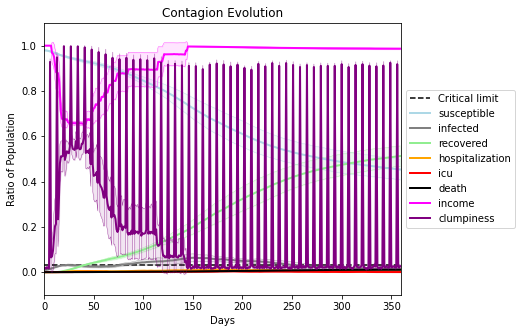

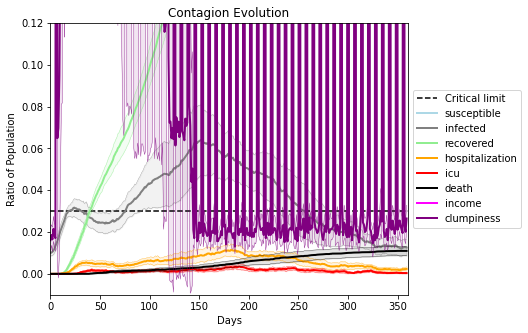

In [45]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 0
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[659, 309, 7882, 2942, 8230, 5591, 6694, 7780, 653, 774, 9199, 1402, 1404, 5747, 5780, 4296, 5228, 2332, 69, 2873]
Average similarity between family members is 0.09762549203270211 at temperature 0.33
Average similarity between family and home is 0.9998500244874925 at temperature -1
Average similarity between students and their classroom is 0.09681044671104393 at temperature 0.33
Average classroom occupancy is 3.9857142857142858 and number classrooms is 70
Average similarity between workers is 0.11301684735051196 at temperature 0.33
Average office occupancy is 3.299019607843137 and number offices is 204
Average friend similarity for adults: 0.15625973209682492 for kids: 0.15547968015893204
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Ho

avg restaurant similarity 0.05841524844667855
avg restaurant similarity 0.06064200746593107
avg restaurant similarity 0.023597422972794258
avg restaurant similarity 0.04391056190224315
avg restaurant similarity 0.016984684183474284
avg restaurant similarity 0.08300178192780268
avg restaurant similarity 0.04831681356644437
avg restaurant similarity 0.048022455471350756
avg restaurant similarity 0.10259417958417281
avg restaurant similarity 0.04927407242791185
avg restaurant similarity 0.037798653259719484
avg restaurant similarity 0.005812589895142291
avg restaurant similarity 0.04465705482492756
avg restaurant similarity 0.0004694345079315306
avg restaurant similarity 0.06641151804028654
avg restaurant similarity 0.015906799268927064
avg restaurant similarity 0.043689849591445715
avg restaurant similarity 0.06876664367824939
avg restaurant similarity 0.035004785288367174
avg restaurant similarity 0.06929619269265162
avg restaurant similarity 0.03199780127426976
avg restaurant similarit

avg restaurant similarity 0.029149151764524563
avg restaurant similarity 0.07684711695753844
avg restaurant similarity 0.061468332039984634
avg restaurant similarity 0.06727160424448289
avg restaurant similarity 0.004975856736729594
avg restaurant similarity 0.07014040543596232
avg restaurant similarity 0.004982614678656193
avg restaurant similarity 0.0330121880409856
avg restaurant similarity 0.03241303861534115
avg restaurant similarity -0.004978332562161823
avg restaurant similarity 0.08698586470828937
avg restaurant similarity 0.05624955513383207
avg restaurant similarity 0.023496843032558848
avg restaurant similarity 0.03117331941747734
avg restaurant similarity 0.027845767638011023
avg restaurant similarity 0.0495975504949777
avg restaurant similarity 0.018988861963596518
avg restaurant similarity 0.05354859195826753
avg restaurant similarity 0.10590912212604983
avg restaurant similarity 0.07142427099585769
avg restaurant similarity 0.07398879635330768
avg restaurant similarity 0

avg restaurant similarity 0.10201447291667783
avg restaurant similarity 0.059537322422079465
avg restaurant similarity 0.02483218653052403
avg restaurant similarity 0.07797660002677377
avg restaurant similarity 0.10626699690811803
avg restaurant similarity 0.058874740322240576
avg restaurant similarity 0.03530016379141113
avg restaurant similarity 0.05199311843048936
avg restaurant similarity 0.05332036017320221
avg restaurant similarity 0.09170007009266858
avg restaurant similarity 0.014449145213702408
avg restaurant similarity 0.051101285174787056
avg restaurant similarity 0.051452964387170334
avg restaurant similarity 0.0731032131421194
avg restaurant similarity 0.07206730912575818
avg restaurant similarity 0.07856192825958237
avg restaurant similarity 0.07388286607453014
avg restaurant similarity 0.039286144220480844
avg restaurant similarity 0.10612909139266163
avg restaurant similarity 0.0688364686418296
avg restaurant similarity 0.06026385751449643
avg restaurant similarity 0.08

avg restaurant similarity 0.0365177486272701
avg restaurant similarity 0.03316441012016018
avg restaurant similarity 0.03226038695831105
avg restaurant similarity 0.05063954969832782
avg restaurant similarity 0.08586493682413873
avg restaurant similarity 0.10129217676704708
avg restaurant similarity 0.02935754606475799
avg restaurant similarity 0.00923673192645875
avg restaurant similarity 0.07696867517035662
avg restaurant similarity 0.08786443210717565
avg restaurant similarity 0.043958730661050834
avg restaurant similarity 0.06881810906616762
avg restaurant similarity 0.08871849023739362
avg restaurant similarity 0.08203623370453124
avg restaurant similarity 0.08329635418586669
avg restaurant similarity 0.0834674075228748
avg restaurant similarity 0.025932287492448084
avg restaurant similarity 0.0673814067472056
avg restaurant similarity 0.09943589898060112
avg restaurant similarity 0.07818703166501324
avg restaurant similarity 0.06231471722599398
avg restaurant similarity 0.0883658

avg restaurant similarity 0.06450323947594798
avg restaurant similarity -0.01462510952825501
avg restaurant similarity 0.0063072181490679705
avg restaurant similarity 0.0001622553784851739
avg restaurant similarity 0.06618208295187335
avg restaurant similarity 0.09034777508640542
avg restaurant similarity 0.016638376438854602
avg restaurant similarity 0.00801654448191742
avg restaurant similarity 0.008896492560286223
avg restaurant similarity 0.033247800592238155
avg restaurant similarity 0.04944303939333712
avg restaurant similarity 0.012511328503366654
avg restaurant similarity 0.048799092777495334
avg restaurant similarity 0.046697576910604215
avg restaurant similarity 0.04176426309712466
avg restaurant similarity 0.06592510380368205
avg restaurant similarity -0.020960003895593084
avg restaurant similarity 0.021139954635032106
avg restaurant similarity 0.010277171583085755
avg restaurant similarity 0.051297174682017346
avg restaurant similarity -4.905176062258807e-05
avg restaurant 

avg restaurant similarity 0.037480197274470065
avg restaurant similarity -0.014479619305786751
avg restaurant similarity 0.0005156427614962634
avg restaurant similarity 0.014258821656260067
avg restaurant similarity 0.004295328359041419
avg restaurant similarity 0.0005962965229967819
avg restaurant similarity 0.041891801272458645
avg restaurant similarity 0.03908187131023143
avg restaurant similarity 0.025460863931481056
avg restaurant similarity 0.06908502709013511
avg restaurant similarity 0.068783861296801
avg restaurant similarity 0.03336240023651024
avg restaurant similarity 0.028073113909115568
avg restaurant similarity 0.03360187874338891
avg restaurant similarity -0.008471434379662388
avg restaurant similarity 0.05142002567340633
avg restaurant similarity 0.013140769546085142
avg restaurant similarity 0.02946450244977976
avg restaurant similarity 0.06309795531624932
avg restaurant similarity -0.04252684561351807
avg restaurant similarity 0.0005584368424337618
avg restaurant sim

avg restaurant similarity -0.014139333254120399
avg restaurant similarity 0.10031165754269909
avg restaurant similarity 0.06187540569790308
avg restaurant similarity 0.025201802775074746
avg restaurant similarity 0.059106123931915035
avg restaurant similarity 0.02059206263473836
avg restaurant similarity 0.024728378824928437
avg restaurant similarity 0.032504517923290496
avg restaurant similarity 0.09015989337423395
avg restaurant similarity 0.08997861325198561
avg restaurant similarity 0.052487962198115794
avg restaurant similarity 0.04599743155256904
avg restaurant similarity 0.018769621706806204
avg restaurant similarity 0.06223154046586127
avg restaurant similarity 0.021365919264501487
avg restaurant similarity 0.020431804312160934
avg restaurant similarity 0.05804660500859729
avg restaurant similarity 0.06242611996235693
avg restaurant similarity 0.03320804969187699
avg restaurant similarity 0.03315886733215452
avg restaurant similarity 0.06615829666960686
avg restaurant similarit

avg restaurant similarity 0.062058918708289834
avg restaurant similarity 0.0598997296786172
avg restaurant similarity 0.05229454824625556
avg restaurant similarity 0.0667535570953845
avg restaurant similarity 0.08958956252333246
avg restaurant similarity 0.0055906324967275114
avg restaurant similarity 0.032195084693469905
avg restaurant similarity 0.061600038392172214
avg restaurant similarity 0.06852368618539832
avg restaurant similarity 0.0754241961740799
avg restaurant similarity 0.05869416290148979
avg restaurant similarity 0.04747466791981521
avg restaurant similarity 0.020023658245783834
avg restaurant similarity 0.06694945920044033
avg restaurant similarity 0.04473668921543669
avg restaurant similarity 0.0630211257845888
avg restaurant similarity 0.07954266793214132
avg restaurant similarity 0.05564594797720604
avg restaurant similarity 0.037004654948825134
avg restaurant similarity 0.040484523809227485
avg restaurant similarity 0.05109160008281852
avg restaurant similarity 0.04

avg restaurant similarity 0.02033176510346953
avg restaurant similarity 0.03294998833786662
avg restaurant similarity -0.009307564684342011
avg restaurant similarity 0.006408545546560755
avg restaurant similarity 0.026368662088861912
avg restaurant similarity -0.0019032275596578385
avg restaurant similarity 0.01877058942502891
avg restaurant similarity -0.006550186965346748
avg restaurant similarity 0.023597394689038514
avg restaurant similarity 0.053882540365269585
avg restaurant similarity 0.02100846426464564
avg restaurant similarity 0.012961423055993595
avg restaurant similarity 0.003374727754064526
avg restaurant similarity 0.02269921660979695
avg restaurant similarity 0.06443726903524528
avg restaurant similarity 0.025039896562292146
avg restaurant similarity -0.026888773276883545
avg restaurant similarity 0.01673088801630415
avg restaurant similarity -0.011273392087578544
avg restaurant similarity 0.03489883072695897
avg restaurant similarity 0.03383124249448228
avg restaurant s

avg restaurant similarity 0.04395021012353801
avg restaurant similarity 0.04326530485517788
avg restaurant similarity 0.012384297875126493
avg restaurant similarity 0.040495493830949275
avg restaurant similarity 0.014384655647859136
avg restaurant similarity 0.020820426014293396
avg restaurant similarity 0.06342672820698873
avg restaurant similarity 0.030283701891028733
avg restaurant similarity 0.01902601170934644
avg restaurant similarity 0.02794202670136401
avg restaurant similarity 0.011639129320277813
avg restaurant similarity 0.030584460134777506
avg restaurant similarity 0.030582009494236784
avg restaurant similarity 0.025632362142495375
avg restaurant similarity 0.03856345728309955
avg restaurant similarity 0.03300062194373782
avg restaurant similarity -0.01951714222806037
avg restaurant similarity 0.012222786437962985
avg restaurant similarity -0.001634218016496246
avg restaurant similarity 0.07265402359515923
avg restaurant similarity 0.027957043009825735
avg restaurant simil

avg restaurant similarity 0.08875230733520426
avg restaurant similarity 0.08512011947171066
avg restaurant similarity 0.05521859315687552
avg restaurant similarity -0.0005633404994178902
avg restaurant similarity 0.036335132647228055
avg restaurant similarity 0.015352339031281996
avg restaurant similarity 0.03648385359722546
avg restaurant similarity 0.03462853503580057
avg restaurant similarity 0.0510189350347501
avg restaurant similarity 0.05356800804912099
avg restaurant similarity 0.0370149050174963
avg restaurant similarity 0.03568480399213837
avg restaurant similarity 0.043055837096408825
avg restaurant similarity 0.04168335211959034
avg restaurant similarity 0.08348413759859022
avg restaurant similarity 0.07928442286379665
avg restaurant similarity 0.049846098899458464
avg restaurant similarity 0.029589890861925375
avg restaurant similarity 0.08478768006702721
avg restaurant similarity 0.04979055959437492
avg restaurant similarity 0.07578516414887164
avg restaurant similarity 0.

avg restaurant similarity 0.006001451485310361
avg restaurant similarity 0.08964373141394101
avg restaurant similarity 0.05277856977333829
avg restaurant similarity 0.026336242251842792
avg restaurant similarity 0.050667054266641275
avg restaurant similarity 0.008795720438350413
avg restaurant similarity 0.045811678878089894
avg restaurant similarity 0.1063395255531848
avg restaurant similarity 0.05820552200736626
avg restaurant similarity 0.04746793471509875
avg restaurant similarity 0.02096070817223237
avg restaurant similarity 0.052510667715033814
avg restaurant similarity 0.06079100055520827
avg restaurant similarity 0.05707501686902437
avg restaurant similarity -0.009159806481891129
avg restaurant similarity 0.04319649307262845
avg restaurant similarity 0.05190905920105871
avg restaurant similarity 0.03226983560291959
avg restaurant similarity 0.028345927455912624
avg restaurant similarity 0.027395901592404834
avg restaurant similarity 0.03692524689592225
avg restaurant similarity

avg restaurant similarity 0.008229773300487327
avg restaurant similarity 0.04999447668226898
avg restaurant similarity 0.02506950113507186
avg restaurant similarity 0.05852895162839064
avg restaurant similarity 0.05055465324342497
avg restaurant similarity 0.044730678825982466
avg restaurant similarity 0.02164907361943483
avg restaurant similarity 0.09668239161834424
avg restaurant similarity 0.014567239013348615
avg restaurant similarity 0.04703060901562875
avg restaurant similarity 0.030471604457850552
avg restaurant similarity 0.027584733157066506
avg restaurant similarity 0.049302382652066185
avg restaurant similarity 0.06805336756563796
avg restaurant similarity -0.010475782604503426
avg restaurant similarity -0.010562517062844086
avg restaurant similarity -0.003000504534161125
avg restaurant similarity 0.02458776328853588
avg restaurant similarity 0.014095772815185417
avg restaurant similarity 0.0033507182245937003
avg restaurant similarity 0.04221744636421863
avg restaurant simi

avg restaurant similarity 0.04161245233936982
avg restaurant similarity 0.03089019102777377
avg restaurant similarity 0.054128547362450354
avg restaurant similarity 0.03641498922691894
avg restaurant similarity 0.07171863180589998
avg restaurant similarity 0.03082255104320455
avg restaurant similarity 0.006453958035998655
avg restaurant similarity 0.006554243732599934
avg restaurant similarity 0.0001835723257325191
avg restaurant similarity 0.045504489383117276
avg restaurant similarity 0.01383740074437251
avg restaurant similarity 0.06916778158806257
avg restaurant similarity 0.04673864773821948
avg restaurant similarity 0.010359915034179292
avg restaurant similarity 0.011604210885251593
avg restaurant similarity 0.02055216778459134
avg restaurant similarity 0.03862871896407467
avg restaurant similarity 0.052833143206799424
avg restaurant similarity 0.024471653238533217
avg restaurant similarity 0.0315323645682555
avg restaurant similarity 0.010767522173986856
avg restaurant similarit

avg restaurant similarity 0.04207477937989795
avg restaurant similarity 0.05086938809984326
avg restaurant similarity 0.006922595844385051
avg restaurant similarity 0.04867259634566829
avg restaurant similarity -0.036751448614272264
avg restaurant similarity -0.0024184790146727416
avg restaurant similarity -0.007734595865187508
avg restaurant similarity -0.0068330893712465115
avg restaurant similarity 0.04419257522474485
avg restaurant similarity 0.027367366730433718
avg restaurant similarity 0.022977801806848108
avg restaurant similarity 0.06437190357766588
avg restaurant similarity 0.0702920944252136
avg restaurant similarity 0.09023339408983472
avg restaurant similarity 0.058555143639566154
avg restaurant similarity 0.030778251884838816
avg restaurant similarity 0.05738183106494512
avg restaurant similarity 0.031219043310577572
avg restaurant similarity 0.053519540637512165
avg restaurant similarity 0.02017605570915779
avg restaurant similarity 0.024711084819053084
avg restaurant si

avg restaurant similarity 0.026406672352697648
avg restaurant similarity -0.018325267607038637
avg restaurant similarity -0.007356410900871251
avg restaurant similarity 0.06476331076388295
avg restaurant similarity -0.0389567569353199
avg restaurant similarity 0.0012476199048457517
avg restaurant similarity 0.01812975289774744
avg restaurant similarity 0.04370264841308889
avg restaurant similarity 0.017972990932064607
avg restaurant similarity -0.003652580499522325
avg restaurant similarity 0.028419901296573822
avg restaurant similarity 0.0019589308498232957
avg restaurant similarity -0.007836972629244857
avg restaurant similarity 0.017681960238207645
avg restaurant similarity -0.0015784587618956857
avg restaurant similarity 0.0011457016255535567
avg restaurant similarity -0.019846201353228014
avg restaurant similarity 0.0003759373463962723
avg restaurant similarity 0.025908810251595568
avg restaurant similarity 0.01833588520096236
avg restaurant similarity 0.06358116588703754
avg rest

avg restaurant similarity 0.04115497630534366
avg restaurant similarity -0.005077376441233959
avg restaurant similarity -0.02369164841006571
avg restaurant similarity -0.02531380540513481
avg restaurant similarity -0.007691836810927364
avg restaurant similarity 0.008832198336716937
avg restaurant similarity 0.02327638800940739
avg restaurant similarity -0.007074245822568487
avg restaurant similarity 0.04394553358962645
avg restaurant similarity 0.0020015792526797854
avg restaurant similarity -0.006569730194806861
avg restaurant similarity 0.018028558413762642
avg restaurant similarity 0.06669687147208644
avg restaurant similarity -0.04776310506547317
avg restaurant similarity 0.036847951896576275
avg restaurant similarity 0.005098672893844033
avg restaurant similarity 0.05383967782996656
avg restaurant similarity 0.023654647136496693
avg restaurant similarity 0.005900779619128307
avg restaurant similarity 3.792263858520863e-05
avg restaurant similarity 0.014406494286775982
avg restaura

avg restaurant similarity 0.017743958020074876
avg restaurant similarity -0.005604387322328232
avg restaurant similarity -0.008622445477446157
avg restaurant similarity 0.049392060224186574
avg restaurant similarity 0.0406033504331509
avg restaurant similarity -0.01015238199617779
avg restaurant similarity 0.04626469265729273
avg restaurant similarity 0.07273969920992293
avg restaurant similarity 0.02020074372643842
avg restaurant similarity 0.015482987506075685
avg restaurant similarity 0.04445265534963142
avg restaurant similarity 0.04492871652920293
avg restaurant similarity 0.045544980187861836
avg restaurant similarity -0.026005039402330375
avg restaurant similarity 0.01694214016138951
avg restaurant similarity 0.012723010552040285
avg restaurant similarity 0.04158256374168681
avg restaurant similarity 0.04454416394301914
avg restaurant similarity 0.06001216619987979
avg restaurant similarity 0.00806306113590875
avg restaurant similarity 0.018981982085511856
avg restaurant similar

avg restaurant similarity 0.0637511323160388
avg restaurant similarity 0.09108111060077852
avg restaurant similarity 0.0415808098730316
avg restaurant similarity 0.04964343273156194
avg restaurant similarity 0.02087636918145784
avg restaurant similarity -0.01354765039829257
avg restaurant similarity 0.06834613838760921
avg restaurant similarity 0.07697440090034374
avg restaurant similarity 0.06976090076874382
avg restaurant similarity 0.04044855753000844
avg restaurant similarity 0.04508659289438884
avg restaurant similarity 0.09857361937849639
avg restaurant similarity 0.029279043620789827
avg restaurant similarity 0.06529067878435171
avg restaurant similarity 0.03473563067712964
avg restaurant similarity 0.017860470623293122
avg restaurant similarity 0.04284038193660906
avg restaurant similarity 0.05469322016270699
avg restaurant similarity 0.06859615034731413
avg restaurant similarity 0.018665986390927616
avg restaurant similarity 0.09136951166966602
avg restaurant similarity 0.0367

avg restaurant similarity 0.018377667785315244
avg restaurant similarity 0.03922884292513881
avg restaurant similarity 0.06086083230983965
avg restaurant similarity 0.035410869639445015
avg restaurant similarity 0.06552313434597519
avg restaurant similarity 0.05096287170674048
avg restaurant similarity 0.07216161449892275
avg restaurant similarity 0.04044345920604108
avg restaurant similarity 0.06052355502632573
avg restaurant similarity 0.03653393546383296
avg restaurant similarity 0.026898938646235986
avg restaurant similarity 0.07412306209999546
avg restaurant similarity 0.02066736807379333
avg restaurant similarity 0.10332884318951159
avg restaurant similarity 0.06786372099016726
avg restaurant similarity 0.03673582460919957
avg restaurant similarity 0.03193604782444755
avg restaurant similarity 0.06293468483744753
avg restaurant similarity 0.06373573487344417
avg restaurant similarity 0.017215392744444964
avg restaurant similarity 0.04217067184563347
avg restaurant similarity 0.06

avg restaurant similarity 0.0501493659721006
avg restaurant similarity 0.04061256586105215
avg restaurant similarity 0.05198669385844728
avg restaurant similarity 0.015238892578053598
avg restaurant similarity 0.015574529966999024
avg restaurant similarity 0.02719098040066059
avg restaurant similarity 0.034681898968741735
avg restaurant similarity 0.05598989206567813
avg restaurant similarity 0.0334661512061523
avg restaurant similarity 0.05497971923372208
avg restaurant similarity 0.0028264161242691033
avg restaurant similarity 0.0006668116512397186
avg restaurant similarity 0.0669209456131895
avg restaurant similarity 0.04693135462486632
avg restaurant similarity 0.029711826570872384
avg restaurant similarity 0.030399538029363706
avg restaurant similarity 0.0637536805475521
avg restaurant similarity 0.030183332980888697
avg restaurant similarity 0.05330518900825671
avg restaurant similarity 0.03183495916049969
avg restaurant similarity 0.06714996539579973
avg restaurant similarity 0.

avg restaurant similarity 0.05954184996737128
avg restaurant similarity 0.058704100313204687
avg restaurant similarity 0.08731267892836306
avg restaurant similarity 0.06861962643929242
avg restaurant similarity 0.038815743810457576
avg restaurant similarity 0.04967889139081717
avg restaurant similarity 0.040588268474675164
avg restaurant similarity 0.008995521158621244
avg restaurant similarity 0.010926825721647281
avg restaurant similarity 0.0380625013736383
avg restaurant similarity 0.0782276814228843
avg restaurant similarity 0.023537807624741978
avg restaurant similarity 0.027242860939036127
avg restaurant similarity 0.022404101896626213
avg restaurant similarity 0.051189916210751335
avg restaurant similarity 0.02107121435212061
avg restaurant similarity 0.029115825739380506
avg restaurant similarity 0.023559636519747133
avg restaurant similarity -0.010885230772882663
avg restaurant similarity 0.05794860226215694
avg restaurant similarity 0.04165760370205392
avg restaurant similari

avg restaurant similarity 0.022801343875763786
avg restaurant similarity 0.03575389654159381
avg restaurant similarity 0.029376636940516815
avg restaurant similarity 0.006951458586229407
avg restaurant similarity 0.04681197636965608
avg restaurant similarity 0.06972345001927747
avg restaurant similarity 0.020174477443189134
avg restaurant similarity 0.07357306151880431
avg restaurant similarity 0.06904942656993229
avg restaurant similarity 0.04778789550910029
avg restaurant similarity 0.04533305891124667
avg restaurant similarity 0.09329638607746178
avg restaurant similarity 0.03033482262998047
avg restaurant similarity 0.03798559760000085
avg restaurant similarity 0.0205890759417949
avg restaurant similarity 0.032657536393249365
avg restaurant similarity 0.06130129562228903
avg restaurant similarity 0.007442608375892508
avg restaurant similarity -0.014863733844006051
avg restaurant similarity 0.03137496785347746
avg restaurant similarity 0.03255849571904755
avg restaurant similarity 0

avg restaurant similarity 0.033295264859354044
avg restaurant similarity 0.04357771819907656
avg restaurant similarity 0.07155214928713981
avg restaurant similarity 0.04980409958659423
avg restaurant similarity 0.05018040657131896
avg restaurant similarity 0.03299109037368224
avg restaurant similarity 0.02019434092952349
avg restaurant similarity 0.09194209630126109
avg restaurant similarity 0.011784172584397044
avg restaurant similarity 0.0644992694809708
avg restaurant similarity 0.02201788145952245
avg restaurant similarity 0.04773006427989399
avg restaurant similarity 0.032210639026197405
avg restaurant similarity 0.043664141570220256
avg restaurant similarity 0.052022969704577114
avg restaurant similarity 0.019323489330022006
avg restaurant similarity 0.0480726159863818
avg restaurant similarity 0.06650552538191551
avg restaurant similarity 0.03260986814911699
avg restaurant similarity 0.02381051509681135
avg restaurant similarity 0.049158255608778664
avg restaurant similarity 0.0

avg restaurant similarity 0.04501881645587709
avg restaurant similarity 0.02817613109855119
avg restaurant similarity 0.01699025187391124
avg restaurant similarity 0.06060412744622921
avg restaurant similarity 0.026223823705645178
avg restaurant similarity 0.03696169879744242
avg restaurant similarity 0.022977430294683025
avg restaurant similarity 0.043892651668502786
avg restaurant similarity 0.017198745262855628
avg restaurant similarity 0.033470199549236204
avg restaurant similarity 0.055804032984435946
avg restaurant similarity 0.03457724342082119
avg restaurant similarity 0.053125511203279865
avg restaurant similarity 0.020802382346279222
avg restaurant similarity 0.031321636499003394
avg restaurant similarity 0.014199720646550031
avg restaurant similarity 0.03474929530235356
avg restaurant similarity 0.051567644761673456
avg restaurant similarity 0.04102514192939351
avg restaurant similarity 0.05756506181921319
avg restaurant similarity 0.040564450235967796
avg restaurant similar

avg restaurant similarity 0.011473334232877162
avg restaurant similarity 0.04709048840794747
avg restaurant similarity 0.04256719997685131
avg restaurant similarity 0.028357309791931004
avg restaurant similarity 0.03936584679074861
avg restaurant similarity 0.0641139264530018
avg restaurant similarity 0.04259063624576656
avg restaurant similarity 0.04939083458268257
avg restaurant similarity 0.07234396243862559
avg restaurant similarity 0.012567228333648397
avg restaurant similarity 0.012540769843722191
avg restaurant similarity 0.05660036465157493
avg restaurant similarity 0.08555744451882194
avg restaurant similarity 0.05083535697197691
avg restaurant similarity 0.006971081569872801
avg restaurant similarity 0.054361114015543756
avg restaurant similarity 0.06849513103458206
avg restaurant similarity 0.03674550629618961
avg restaurant similarity 0.02773874669770615
avg restaurant similarity 0.02965314712076246
avg restaurant similarity 0.011013903126256157
avg restaurant similarity 0.

avg restaurant similarity 0.028438826974596595
avg restaurant similarity 0.027697188113926324
avg restaurant similarity 0.014638087268779854
avg restaurant similarity 0.0375903132720512
avg restaurant similarity 0.09576355179377379
avg restaurant similarity 0.021795440243569435
avg restaurant similarity 0.01951227237008521
avg restaurant similarity 0.00745919206923383
avg restaurant similarity 0.09067016154649946
avg restaurant similarity 0.03737256399729576
avg restaurant similarity 0.03239921369428914
avg restaurant similarity 0.043014024344770946
avg restaurant similarity 0.044347784228057775
avg restaurant similarity 0.08542658018600832
avg restaurant similarity 0.035019346255342414
avg restaurant similarity -0.0022800997783415282
avg restaurant similarity 0.01364034927712023
avg restaurant similarity 0.09277903567327099
avg restaurant similarity 0.07270856524962453
avg restaurant similarity 0.022745789388566855
avg restaurant similarity 0.02356987211067458
avg restaurant similarit

avg restaurant similarity 0.052558854784943064
avg restaurant similarity 0.04282216803501096
avg restaurant similarity 0.06311936114711465
avg restaurant similarity 0.0359480273686605
avg restaurant similarity 0.06498770552445657
avg restaurant similarity 0.010023219176568551
avg restaurant similarity 0.059973883739313
avg restaurant similarity 0.0012136546173812253
avg restaurant similarity 0.05677287706127417
avg restaurant similarity 0.040009147318300395
avg restaurant similarity 0.048757504533830306
avg restaurant similarity 0.05116691098280578
avg restaurant similarity 0.09490324425370944
avg restaurant similarity 0.0669448904735375
avg restaurant similarity 0.04962937565581755
avg restaurant similarity 0.04238729894122403
avg restaurant similarity 0.039476592251337685
avg restaurant similarity 0.054741276405781567
avg restaurant similarity 0.05737829823180189
avg restaurant similarity 0.08251941611467783
avg restaurant similarity 0.0538123022464345
avg restaurant similarity 0.057

avg restaurant similarity 0.02299244135047011
avg restaurant similarity 0.06603565282545436
avg restaurant similarity -0.022205254314491572
avg restaurant similarity -0.02060670690645877
avg restaurant similarity -0.03752477372042184
avg restaurant similarity 0.05852257049303105
avg restaurant similarity 0.052941932913022946
avg restaurant similarity 0.03971924580697025
avg restaurant similarity 0.03519561893247845
avg restaurant similarity 0.024420599023312516
avg restaurant similarity 0.04211110551593231
avg restaurant similarity -0.027737959520994376
avg restaurant similarity 0.000796065622789529
avg restaurant similarity -0.033305487050355596
avg restaurant similarity 0.013910722302260623
avg restaurant similarity -0.002784394030689576
avg restaurant similarity 0.06315610719412619
avg restaurant similarity 0.009919709609103922
avg restaurant similarity 0.04064402292321623
avg restaurant similarity 0.05398014823250288
avg restaurant similarity 0.019190852582430525
avg restaurant sim

avg restaurant similarity 0.04025177721883746
avg restaurant similarity -0.007319757202901147
avg restaurant similarity 0.026720220311190184
avg restaurant similarity 0.003377659396943073
avg restaurant similarity -0.003963944406665686
avg restaurant similarity -0.02011963395932566
avg restaurant similarity 0.00773724109876431
avg restaurant similarity 0.02354694505811018
avg restaurant similarity 0.039155296982714326
avg restaurant similarity 0.024982164865358474
avg restaurant similarity 0.024700759435583645
avg restaurant similarity -0.01859680261050844
avg restaurant similarity 0.049812189499004976
avg restaurant similarity 0.021328462978691624
avg restaurant similarity -0.014435814131776305
avg restaurant similarity -0.030468178641375358
avg restaurant similarity 0.016223275599393884
avg restaurant similarity 0.04852559633443883
avg restaurant similarity 0.0070658748904616495
avg restaurant similarity 0.003254353956168163
avg restaurant similarity 0.04412508919235144
avg restauran

avg restaurant similarity 0.042425649974200424
avg restaurant similarity 0.10535921948325906
avg restaurant similarity 0.13883449956887786
avg restaurant similarity 0.01630421473543908
avg restaurant similarity 0.00985964071405958
avg restaurant similarity 0.039223220550392665
avg restaurant similarity -0.023941162944049625
avg restaurant similarity 0.04264701192423943
avg restaurant similarity 0.02726372730681839
avg restaurant similarity 0.10378967481758315
avg restaurant similarity 0.03901722686037242
avg restaurant similarity 0.06043185356110004
avg restaurant similarity 0.011212879298485277
avg restaurant similarity 0.020131375010071985
avg restaurant similarity 0.047856423700680634
avg restaurant similarity 0.11803760119925723
avg restaurant similarity 0.04276463420657008
avg restaurant similarity 0.02055802252866631
avg restaurant similarity 0.014265712275048097
avg restaurant similarity 0.021061135515117613
avg restaurant similarity 0.06098638619528963
avg restaurant similarity

avg restaurant similarity 0.03904580522527346
avg restaurant similarity 0.09037376796413421
avg restaurant similarity 0.008240798916295176
avg restaurant similarity 0.014216849438401364
avg restaurant similarity 0.056478834830861455
avg restaurant similarity 0.01654937225663381
avg restaurant similarity 0.07245342378891716
avg restaurant similarity 0.055480481082371774
avg restaurant similarity 0.04973196186908627
avg restaurant similarity 0.03038265146934682
avg restaurant similarity 0.10326214087384131
avg restaurant similarity 0.08248372809016716
avg restaurant similarity 0.09271116387724432
avg restaurant similarity 0.055077869290958814
avg restaurant similarity 0.04352363446363759
avg restaurant similarity 0.035045298080536066
avg restaurant similarity 0.05319132617030847
avg restaurant similarity 0.013580734368982423
avg restaurant similarity 0.020212220285290256
avg restaurant similarity 0.026522153100326035
avg restaurant similarity 0.07866178404526142
avg restaurant similarity

avg restaurant similarity 0.002248567159627323
avg restaurant similarity 0.023682150750512942
avg restaurant similarity 0.048332658356902564
avg restaurant similarity 0.01846845694024661
avg restaurant similarity 0.017206111705250247
avg restaurant similarity 0.03894277950647297
avg restaurant similarity 0.05387359459608766
avg restaurant similarity 0.01074194201549373
avg restaurant similarity 0.04964847572799767
avg restaurant similarity 0.05065495397090418
avg restaurant similarity 0.03403808804248081
avg restaurant similarity 0.07934298071124311
avg restaurant similarity 0.05825880908755607
avg restaurant similarity 0.05506633279480699
avg restaurant similarity 0.004844302179367359
avg restaurant similarity 0.07075223908086903
avg restaurant similarity 0.09344550159707309
avg restaurant similarity 0.012890590314580088
avg restaurant similarity 0.13679992399067445
avg restaurant similarity 0.060994329671062435
avg restaurant similarity 0.06957288775203008
avg restaurant similarity 0

avg restaurant similarity 0.01728784706031481
avg restaurant similarity 0.09171579559641653
avg restaurant similarity 0.0016993485769375796
avg restaurant similarity 0.05656167130979399
avg restaurant similarity 0.02034957318786302
avg restaurant similarity 0.06973395311747006
avg restaurant similarity 0.05106981538877113
avg restaurant similarity 0.059355904116534505
avg restaurant similarity 0.0730982075253926
avg restaurant similarity 0.04430899194350908
avg restaurant similarity 0.03250091026943791
avg restaurant similarity -0.004349156479998425
avg restaurant similarity 0.025304266495441603
avg restaurant similarity 0.013566557342490798
avg restaurant similarity 0.04118233705703491
avg restaurant similarity 0.039006743862681215
avg restaurant similarity 0.043562341530187856
avg restaurant similarity 0.05552949062498176
avg restaurant similarity 0.00838989213478918
avg restaurant similarity 0.006032094604031521
avg restaurant similarity 0.007736583848443189
avg restaurant similarit

avg restaurant similarity 0.06214759427486396
avg restaurant similarity 0.020028124010605112
avg restaurant similarity 0.02291572435664505
avg restaurant similarity 0.07426177286355384
avg restaurant similarity 0.061369206645283274
avg restaurant similarity 0.07565797510544932
avg restaurant similarity 0.030695309203059223
avg restaurant similarity 0.03733215829710817
avg restaurant similarity 0.08547334071919573
avg restaurant similarity 0.06694087840955235
avg restaurant similarity 0.08354031267072941
avg restaurant similarity 0.074136098062564
avg restaurant similarity 0.04850321108575022
avg restaurant similarity 0.057056209119760046
avg restaurant similarity 0.11477408406089469
avg restaurant similarity 0.05901818368310506
avg restaurant similarity 0.058952311340625535
avg restaurant similarity 0.060788880295709745
avg restaurant similarity 0.02832804038218232
avg restaurant similarity 0.05867770213545488
avg restaurant similarity 0.03958030382677292
avg restaurant similarity 0.09

avg restaurant similarity 0.09911916224207068
avg restaurant similarity 0.020099240450068143
avg restaurant similarity 0.045477682471069376
avg restaurant similarity 0.037385743722255504
avg restaurant similarity 0.07833612062210987
avg restaurant similarity 0.07666646462521867
avg restaurant similarity 0.07037663670164125
avg restaurant similarity 0.05787021745473693
avg restaurant similarity 0.05682599914826718
avg restaurant similarity 0.06562867710579828
avg restaurant similarity 0.042905759552944955
avg restaurant similarity 0.06017321160187595
avg restaurant similarity 0.07536158784120035
avg restaurant similarity 0.022277602953049355
avg restaurant similarity 0.06611096310359248
avg restaurant similarity 0.08901302434031048
avg restaurant similarity 0.03644576176768536
avg restaurant similarity 0.037901777191077624
avg restaurant similarity 0.04343115586013405
avg restaurant similarity 0.06612007405194303
avg restaurant similarity 0.05597191431758911
avg restaurant similarity 0.

avg restaurant similarity 0.04902455710909616
avg restaurant similarity 0.03513558771314995
avg restaurant similarity 0.04947473378545806
avg restaurant similarity -0.011099137542864864
avg restaurant similarity 0.04487736982992871
avg restaurant similarity 0.02703148009474808
avg restaurant similarity 0.04444071790681084
avg restaurant similarity 0.06179031180487432
avg restaurant similarity 0.053608191426584434
avg restaurant similarity 0.03908195854417834
avg restaurant similarity 0.04378976657216881
avg restaurant similarity 0.019840593031728332
avg restaurant similarity 0.016012266322311695
avg restaurant similarity 0.01242477233407767
avg restaurant similarity 0.04973604943263006
avg restaurant similarity 0.042132837099186644
avg restaurant similarity 0.006334602387976179
avg restaurant similarity 0.06156961456400641
avg restaurant similarity 0.09405849183466881
avg restaurant similarity 0.03394723536939508
avg restaurant similarity 0.010704312682313696
avg restaurant similarity 

avg restaurant similarity 0.03704681748633769
avg restaurant similarity 0.02060672945773919
avg restaurant similarity 0.02975653680221176
avg restaurant similarity 0.006100534357474723
avg restaurant similarity 0.048981684637151024
avg restaurant similarity 0.033545636399811396
avg restaurant similarity 0.07777924692012676
avg restaurant similarity 0.033163784515290354
avg restaurant similarity -0.024790242823550752
avg restaurant similarity 0.023960289381486505
avg restaurant similarity -0.004088829989807257
avg restaurant similarity 0.04936953365971717
avg restaurant similarity 0.07979959353763086
avg restaurant similarity 0.037297273969967536
avg restaurant similarity 0.036130836329993934
avg restaurant similarity 0.022926750019041035
avg restaurant similarity 0.0544713688572084
avg restaurant similarity 0.03449624868979669
avg restaurant similarity 0.008626663669347693
avg restaurant similarity 0.08074222332288879
avg restaurant similarity 0.04487061354502593
avg restaurant similar

avg restaurant similarity 0.044196160399533474
avg restaurant similarity 0.042745483870962234
avg restaurant similarity 0.084026972474528
avg restaurant similarity 0.0473544351135132
avg restaurant similarity 0.05765672475658923
avg restaurant similarity 0.07720268920554145
avg restaurant similarity 0.04550222715558671
avg restaurant similarity 0.010728779089864651
avg restaurant similarity 0.03144448402088481
avg restaurant similarity 0.04808423538330724
avg restaurant similarity 0.042387352765569375
avg restaurant similarity 0.07669598613877297
avg restaurant similarity 0.038204882260081216
avg restaurant similarity 0.06400230499669345
avg restaurant similarity 0.06257555231938786
avg restaurant similarity 0.006469661342030743
avg restaurant similarity 0.07647167904271135
avg restaurant similarity 0.002718235320537096
avg restaurant similarity 0.024369271255901777
avg restaurant similarity 0.028920638776048606
avg restaurant similarity 0.06232682105912013
avg restaurant similarity 0.

avg restaurant similarity 0.07519805261461678
avg restaurant similarity 0.03590006537685702
avg restaurant similarity 0.06549950344114394
avg restaurant similarity 0.11207934716901821
avg restaurant similarity 0.045051542772068666
avg restaurant similarity 0.050265458452124566
avg restaurant similarity 0.08752657786242941
avg restaurant similarity 0.08182983012846382
avg restaurant similarity 0.031189397461059313
avg restaurant similarity 0.06431163459617724
avg restaurant similarity 0.08131466837003862
avg restaurant similarity 0.011469309407297838
avg restaurant similarity 0.11061050475815824
avg restaurant similarity 0.08148436500946302
avg restaurant similarity 0.055012139333135916
avg restaurant similarity 0.03851862029612805
avg restaurant similarity 0.05372091908757921
avg restaurant similarity 0.04967709603353086
avg restaurant similarity 0.04241774531539501
avg restaurant similarity 0.055808936290586864
avg restaurant similarity 0.06496316771389722
avg restaurant similarity 0.

(<function dict.items>, <function dict.items>, <function dict.items>)

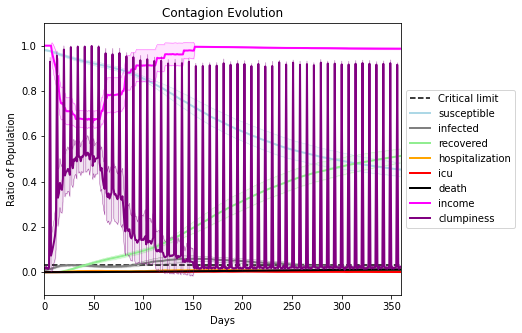

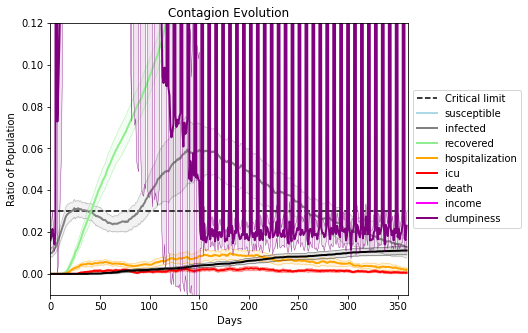

In [46]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 0.33
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[529, 368, 1817, 658, 7139, 9920, 7377, 2781, 9200, 4700, 1944, 4770, 4300, 3870, 5627, 7749, 2328, 8499, 7880, 2936]
Average similarity between family members is 0.057884981181251294 at temperature 0.66
Average similarity between family and home is 0.9998550181162779 at temperature -1
Average similarity between students and their classroom is 0.01657918164111748 at temperature 0.66
Average classroom occupancy is 4.014285714285714 and number classrooms is 70
Average similarity between workers is 0.04434383038578283 at temperature 0.66
Average office occupancy is 3.203883495145631 and number offices is 206
Average friend similarity for adults: 0.1273712975635205 for kids: 0.11329314788495796
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 20 people.
Total of 20 people allocated in this district.
, 
Home (1,0) district with 1 Buildings


avg restaurant similarity 0.032545687680313566
avg restaurant similarity 0.011796218568308913
avg restaurant similarity -0.010672915676318956
avg restaurant similarity -0.03062395705528347
avg restaurant similarity -0.043145133507788515
avg restaurant similarity -0.05716604950706832
avg restaurant similarity -0.029939564536660093
avg restaurant similarity 0.0009926930048973982
avg restaurant similarity -0.001902375258508279
avg restaurant similarity 0.009140591000583462
avg restaurant similarity 0.013160620139032677
avg restaurant similarity 0.017666220840636872
avg restaurant similarity -0.051991712470872684
avg restaurant similarity 0.022335277164980943
avg restaurant similarity -0.04534450036937876
avg restaurant similarity 0.0369536165485978
avg restaurant similarity 0.021309565998374625
avg restaurant similarity 0.030813805991818342
avg restaurant similarity 0.019287094730844265
avg restaurant similarity 0.030053513535986665
avg restaurant similarity 0.009771197430566939
avg resta

avg restaurant similarity -0.019183194274034695
avg restaurant similarity 0.03873175168726733
avg restaurant similarity 0.028529728210211856
avg restaurant similarity 0.0033995425265072113
avg restaurant similarity -0.020610177475942557
avg restaurant similarity -0.017186649041082608
avg restaurant similarity -0.007725895211663436
avg restaurant similarity 0.008810283304971495
avg restaurant similarity 0.012921092919126657
avg restaurant similarity 0.005641430379128892
avg restaurant similarity 0.009210410924960393
avg restaurant similarity 0.002395955153755585
avg restaurant similarity 0.08575753706643993
avg restaurant similarity 0.018468615856148052
avg restaurant similarity -0.023130416305518115
avg restaurant similarity -0.0016207450868663635
avg restaurant similarity 0.00926177710281744
avg restaurant similarity -0.020213439432555283
avg restaurant similarity 0.02461930909627682
avg restaurant similarity 0.03234805659233492
avg restaurant similarity -0.018664449280573817
avg rest

avg restaurant similarity 0.044681092616595655
avg restaurant similarity -0.006929017449534299
avg restaurant similarity 0.0071737529800122764
avg restaurant similarity 0.03495833901738151
avg restaurant similarity 0.026653144242689775
avg restaurant similarity 0.030820497616781548
avg restaurant similarity 0.06101995463376616
avg restaurant similarity 0.040630366852047094
avg restaurant similarity 0.017495966925078238
avg restaurant similarity 0.03300007507449453
avg restaurant similarity 0.060472936941070345
avg restaurant similarity 0.081753265730402
avg restaurant similarity 0.027128463968887885
avg restaurant similarity 0.028572271134293958
avg restaurant similarity 0.0326193466059065
avg restaurant similarity 0.019380069929963772
avg restaurant similarity 0.04084052974377597
avg restaurant similarity 0.026455397025203192
avg restaurant similarity 0.05002637942489945
avg restaurant similarity -0.0063029111448112095
avg restaurant similarity 0.04888705715590742
avg restaurant simil

avg restaurant similarity 0.023168043858340915
avg restaurant similarity -0.012272448374583255
avg restaurant similarity 0.04505616823990532
avg restaurant similarity 0.030703440916675866
avg restaurant similarity 0.031454855544763384
avg restaurant similarity 0.06848411660521564
avg restaurant similarity 0.025253701424249625
avg restaurant similarity 0.06433375822309022
avg restaurant similarity 0.017558540785020633
avg restaurant similarity 0.0679137662087788
avg restaurant similarity 0.001243956896719116
avg restaurant similarity 0.02585289164538555
avg restaurant similarity 0.024100575967586378
avg restaurant similarity 0.03680753824415652
avg restaurant similarity 0.0389358446275863
avg restaurant similarity 0.010406422715419332
avg restaurant similarity 0.056290175610730846
avg restaurant similarity -0.027752926268080343
avg restaurant similarity 0.03427265550366278
avg restaurant similarity 0.07477165725283237
avg restaurant similarity 0.009626018769237101
avg restaurant similar

avg restaurant similarity 0.044285134422068294
avg restaurant similarity 0.03777695799976189
avg restaurant similarity 0.031573005066156574
avg restaurant similarity 0.043326466338636384
avg restaurant similarity 0.06322962794550542
avg restaurant similarity 0.057585600041716194
avg restaurant similarity 0.03291964160935405
avg restaurant similarity 0.04593809278636702
avg restaurant similarity 0.05286531674053047
avg restaurant similarity 0.04485074378579205
avg restaurant similarity 0.00951445285446696
avg restaurant similarity 0.004256806389554937
avg restaurant similarity 0.02019587686497802
avg restaurant similarity 0.007850100125583067
avg restaurant similarity 0.02488483351097807
avg restaurant similarity -0.008166858449724023
avg restaurant similarity 0.020057165234378296
avg restaurant similarity 0.05068643208506019
avg restaurant similarity 0.05363597143460727
avg restaurant similarity 0.05271812243389776
avg restaurant similarity 0.0464572005549299
avg restaurant similarity 

avg restaurant similarity 0.04415627691452633
avg restaurant similarity 0.05162013143881271
avg restaurant similarity 0.053744327598745624
avg restaurant similarity 0.026997268982587554
avg restaurant similarity 0.010293230314319156
avg restaurant similarity 0.030136420896630614
avg restaurant similarity 0.025567652660911135
avg restaurant similarity 0.03578210663685911
avg restaurant similarity 0.05526590977725794
avg restaurant similarity 0.06308070132051231
avg restaurant similarity -0.013233768587107302
avg restaurant similarity 0.05826386154307862
avg restaurant similarity 0.02875696558360546
avg restaurant similarity 0.05729475120601475
avg restaurant similarity 0.07852457628285103
avg restaurant similarity 0.05081864749733077
avg restaurant similarity -0.011451039505794383
avg restaurant similarity 0.017360617599617753
avg restaurant similarity 0.05964893296518778
avg restaurant similarity 0.03008257989993958
avg restaurant similarity 0.0052602804314947176
avg restaurant similar

avg restaurant similarity 0.02268467383960465
avg restaurant similarity 0.03500428793908517
avg restaurant similarity 0.05967419833662439
avg restaurant similarity 0.028893946074967328
avg restaurant similarity 0.04751354381270486
avg restaurant similarity 0.030450829161267495
avg restaurant similarity 0.010627922467700905
avg restaurant similarity 0.03033373152962048
avg restaurant similarity 0.026183743932449613
avg restaurant similarity 0.05260687540865528
avg restaurant similarity 0.0249475522270774
avg restaurant similarity 0.046085107883016174
avg restaurant similarity 0.05678845769116479
avg restaurant similarity 0.004794302248183908
avg restaurant similarity 0.04945122532781247
avg restaurant similarity 0.018209201735447128
avg restaurant similarity 0.04789476128749573
avg restaurant similarity 0.0506126806507206
avg restaurant similarity 0.04662479404689086
avg restaurant similarity 0.021400527218674362
avg restaurant similarity 0.008080863022516954
avg restaurant similarity 0

avg restaurant similarity 0.030242487487658346
avg restaurant similarity 0.021145705805655186
avg restaurant similarity 0.004924614903038638
avg restaurant similarity 0.01931394157001118
avg restaurant similarity 0.032919314452047224
avg restaurant similarity 0.035953886349068306
avg restaurant similarity 0.03525996690415403
avg restaurant similarity -0.017657218806033957
avg restaurant similarity 0.04520883970873078
avg restaurant similarity 0.044171481077023365
avg restaurant similarity 0.019857892362874847
avg restaurant similarity 0.006721066357956929
avg restaurant similarity 0.06588787986989586
avg restaurant similarity 0.03748989295822536
avg restaurant similarity 0.006090235514160157
avg restaurant similarity 0.01632751389593772
avg restaurant similarity 0.048505274914310004
avg restaurant similarity 0.020106252325326437
avg restaurant similarity 0.022740990354698575
avg restaurant similarity 0.018341795764567008
avg restaurant similarity 0.02155543615624267
avg restaurant simi

avg restaurant similarity 0.02188658491253083
avg restaurant similarity 0.03514646655269912
avg restaurant similarity 0.08028498400792561
avg restaurant similarity 0.012908144969662192
avg restaurant similarity 0.015497106867528984
avg restaurant similarity 0.013868919527786861
avg restaurant similarity 0.011614263754428686
avg restaurant similarity 0.03558893462641263
avg restaurant similarity -0.03454594642091303
avg restaurant similarity 0.03126859259936078
avg restaurant similarity 0.012983743079961798
avg restaurant similarity 0.051011133278070955
avg restaurant similarity 0.03205605336683503
avg restaurant similarity 0.010365725943193816
avg restaurant similarity 0.01783554864247826
avg restaurant similarity 0.0428927151860403
avg restaurant similarity 0.027168533289495388
avg restaurant similarity -0.001472994543246067
avg restaurant similarity 0.0134736700786419
avg restaurant similarity -0.005040652817241862
avg restaurant similarity 0.02328828053092881
avg restaurant similari

avg restaurant similarity 0.026350824375159048
avg restaurant similarity 0.044154219009698605
avg restaurant similarity 0.002100723085848665
avg restaurant similarity 0.05372169629828039
avg restaurant similarity 0.032538027871066216
avg restaurant similarity 0.02855403311306234
avg restaurant similarity 0.03548795727519805
avg restaurant similarity 0.04063336181051698
avg restaurant similarity 0.05033012050759567
avg restaurant similarity 0.013012883139184844
avg restaurant similarity 0.019422081024258856
avg restaurant similarity -3.752192429070992e-05
avg restaurant similarity 0.019244579965582844
avg restaurant similarity 0.028327266466748435
avg restaurant similarity 0.05203535633747874
avg restaurant similarity -0.003368306976539159
avg restaurant similarity -0.026638783191160635
avg restaurant similarity 0.03032773123832651
avg restaurant similarity 0.01376548606402254
avg restaurant similarity -0.015277871781902286
avg restaurant similarity 0.016750830139043587
avg restaurant s

avg restaurant similarity 0.05049890950699785
avg restaurant similarity -0.0045235735913378245
avg restaurant similarity 0.019780623966325774
avg restaurant similarity 0.027192958526639385
avg restaurant similarity 0.006506796590654118
avg restaurant similarity 0.050079957638632114
avg restaurant similarity 0.017677337905570963
avg restaurant similarity 0.05668171500181031
avg restaurant similarity 0.032487022166416385
avg restaurant similarity 0.013586829783274077
avg restaurant similarity 0.02367212771265643
avg restaurant similarity 0.029197237875749307
avg restaurant similarity 0.01989157641263825
avg restaurant similarity 0.06459148573135658
avg restaurant similarity 0.004928920782745038
avg restaurant similarity 0.005454057418890427
avg restaurant similarity 0.048589178052529304
avg restaurant similarity 0.029429522797802435
avg restaurant similarity 0.020016474293474487
avg restaurant similarity 0.012142189345505087
avg restaurant similarity 0.044310831687489984
avg restaurant s

avg restaurant similarity 0.04118764939275383
avg restaurant similarity 0.03688606478333473
avg restaurant similarity 0.057237944108718866
avg restaurant similarity -0.018584706036972168
avg restaurant similarity 0.004622541256902752
avg restaurant similarity -0.0020503655633066276
avg restaurant similarity 0.0647021988432261
avg restaurant similarity 0.03904897527643005
avg restaurant similarity 0.01453504468783667
avg restaurant similarity 0.053766610825154784
avg restaurant similarity 0.01921377467533452
avg restaurant similarity 0.048131161749166304
avg restaurant similarity 0.031586702634373034
avg restaurant similarity 0.03526298047306389
avg restaurant similarity 0.039882938701214336
avg restaurant similarity 0.04601340832042938
avg restaurant similarity 0.02229161330614955
avg restaurant similarity 0.05899287866631731
avg restaurant similarity 0.02259805263596049
avg restaurant similarity 0.09121828647402246
avg restaurant similarity 0.015499620386944274
avg restaurant similari

avg restaurant similarity 0.07042566882800982
avg restaurant similarity 0.013506503771271378
avg restaurant similarity 0.020311631360751727
avg restaurant similarity 0.04600730607951926
avg restaurant similarity 0.05032350183117702
avg restaurant similarity 0.0190085736580534
avg restaurant similarity 0.025351898459480132
avg restaurant similarity 0.028019406873234724
avg restaurant similarity 0.021685149167315964
avg restaurant similarity 0.012910730448670079
avg restaurant similarity -0.0036019505571439733
avg restaurant similarity 0.041433486056057074
avg restaurant similarity 0.015536162982178638
avg restaurant similarity 0.06535153200489907
avg restaurant similarity 0.052142920997708196
avg restaurant similarity 0.04863107336265933
avg restaurant similarity 0.031109631110499296
avg restaurant similarity 0.03674530782693867
avg restaurant similarity 0.04038659920274935
avg restaurant similarity 0.04531028930810137
avg restaurant similarity 0.05077293515707657
avg restaurant similar

avg restaurant similarity 0.05324810780141659
avg restaurant similarity 0.0344843090894098
avg restaurant similarity 0.02525203447750295
avg restaurant similarity 0.050272517669470544
avg restaurant similarity 0.019653356546544914
avg restaurant similarity 0.008956096345969746
avg restaurant similarity 0.02631874455116201
avg restaurant similarity 0.003053322733044567
avg restaurant similarity 0.07540491408272706
avg restaurant similarity 0.06084029032268925
avg restaurant similarity 0.027797331952267867
avg restaurant similarity 0.01438122523950437
avg restaurant similarity 0.05403368698906544
avg restaurant similarity 0.02142353871476592
avg restaurant similarity 0.044510941806541755
avg restaurant similarity 0.03345777720487566
avg restaurant similarity 0.012150962595676914
avg restaurant similarity 0.030890273578660688
avg restaurant similarity 0.008498649760220378
avg restaurant similarity 0.06968391975519224
avg restaurant similarity 0.07052440525587514
avg restaurant similarity 

avg restaurant similarity 0.018876440827012182
avg restaurant similarity 0.012533550329886078
avg restaurant similarity 0.06938746626542755
avg restaurant similarity -0.008764329877699789
avg restaurant similarity 0.014409378728421197
avg restaurant similarity -0.017924595045008606
avg restaurant similarity 0.057370837681310675
avg restaurant similarity 0.02724631110880916
avg restaurant similarity -0.0160930350606906
avg restaurant similarity 0.047058308560625164
avg restaurant similarity 0.008805455720086805
avg restaurant similarity 0.007645866218184714
avg restaurant similarity 0.012774350838926668
avg restaurant similarity 0.045359618626727334
avg restaurant similarity 0.011323629369582708
avg restaurant similarity 0.02670932801191592
avg restaurant similarity 0.047567548876595936
avg restaurant similarity -0.006168214933063262
avg restaurant similarity 0.04583820289618627
avg restaurant similarity 0.007393628831982869
avg restaurant similarity 0.02909221926021072
avg restaurant s

avg restaurant similarity 0.05436683746744505
avg restaurant similarity 0.01732862839569817
avg restaurant similarity -0.02415875268528516
avg restaurant similarity 0.022249363746872076
avg restaurant similarity 0.0020371627536902998
avg restaurant similarity -0.006509343846683614
avg restaurant similarity 0.04326669734922099
avg restaurant similarity 0.012289680049586844
avg restaurant similarity 0.02832298495091581
avg restaurant similarity 0.03238213225273869
avg restaurant similarity 0.002870042365579562
avg restaurant similarity 0.04097760409590844
avg restaurant similarity 0.01274643914059798
avg restaurant similarity 0.004487889870651194
avg restaurant similarity 0.0014782979687978759
avg restaurant similarity -0.02089338177304185
avg restaurant similarity 0.04049069498842966
avg restaurant similarity 0.06805227701980385
avg restaurant similarity 0.04802337213768118
avg restaurant similarity 0.026765865468664916
avg restaurant similarity 0.034913857343223484
avg restaurant simil

avg restaurant similarity 0.016652786257830756
avg restaurant similarity 0.022902308245723597
avg restaurant similarity 0.0013797419826778793
avg restaurant similarity 0.04847682274667399
avg restaurant similarity -0.017868574201201425
avg restaurant similarity 0.03351600900339393
avg restaurant similarity -0.0019896458088439714
avg restaurant similarity 0.03324055659041518
avg restaurant similarity 0.03400848587794099
avg restaurant similarity 0.005253203650966946
avg restaurant similarity 0.01695242593277196
avg restaurant similarity 0.02378444266583307
avg restaurant similarity 0.04708569020737871
avg restaurant similarity 0.05680948653294114
avg restaurant similarity 0.05342903283667675
avg restaurant similarity 0.012070326645620431
avg restaurant similarity 0.047909871694519685
avg restaurant similarity 0.07170527817145998
avg restaurant similarity 0.030415742237754954
avg restaurant similarity 0.03210535627828542
avg restaurant similarity 0.010374281056905858
avg restaurant simil

avg restaurant similarity -0.019807002455480612
avg restaurant similarity 0.034556893564530185
avg restaurant similarity 0.0039016215014661343
avg restaurant similarity 0.03490364043876696
avg restaurant similarity 0.0188113454019147
avg restaurant similarity 0.00025160629352214656
avg restaurant similarity 0.027918920822385607
avg restaurant similarity 0.04345415232623703
avg restaurant similarity 0.04110104389786709
avg restaurant similarity 0.007977342350436498
avg restaurant similarity -0.011490299512497758
avg restaurant similarity -0.01865059295722416
avg restaurant similarity -0.014083428187981079
avg restaurant similarity -0.029268525970795385
avg restaurant similarity 0.019465241846703178
avg restaurant similarity -0.016095083977809906
avg restaurant similarity -0.008901847980207784
avg restaurant similarity 0.034549043503710325
avg restaurant similarity -0.02099534506342343
avg restaurant similarity 0.023445808821183915
avg restaurant similarity 0.08031782644868121
avg restau

avg restaurant similarity 0.10178015898056945
avg restaurant similarity 0.05799625971169046
avg restaurant similarity 0.05000704593948705
avg restaurant similarity 0.07891781838758123
avg restaurant similarity 0.008968985253012601
avg restaurant similarity 0.04567404971457376
avg restaurant similarity 0.052578687361374325
avg restaurant similarity 0.027001855044379238
avg restaurant similarity 0.044612205176176326
avg restaurant similarity 0.06518102808131414
avg restaurant similarity 0.031713729192871166
avg restaurant similarity 0.06172086132745184
avg restaurant similarity 0.0532287300389975
avg restaurant similarity 0.07440180661887325
avg restaurant similarity 0.05431878549369636
avg restaurant similarity 0.09615165996872471
avg restaurant similarity 0.03336220332291621
avg restaurant similarity 0.06412449655138042
avg restaurant similarity 0.0263690127967316
avg restaurant similarity 0.010895711212145682
avg restaurant similarity -0.028769150130319047
avg restaurant similarity 0.

avg restaurant similarity 0.034137935517987196
avg restaurant similarity 0.0600825818452059
avg restaurant similarity 0.06457048470724473
avg restaurant similarity 0.05873190537045881
avg restaurant similarity 0.05315114011379043
avg restaurant similarity 0.02679042881883427
avg restaurant similarity 0.061588822240793754
avg restaurant similarity 0.0033397481153683776
avg restaurant similarity 0.04820283269706355
avg restaurant similarity 0.06933838755738089
avg restaurant similarity 0.03991822337971836
avg restaurant similarity 0.05525191045508299
avg restaurant similarity 0.037926924172793024
avg restaurant similarity 0.09006855919307985
avg restaurant similarity 0.006767271957150147
avg restaurant similarity 0.06010526731611241
avg restaurant similarity 0.041517739941454836
avg restaurant similarity 0.03032583336661279
avg restaurant similarity 0.047832103813625654
avg restaurant similarity 0.09927859484972681
avg restaurant similarity 0.03711554715988795
avg restaurant similarity 0

avg restaurant similarity 0.04166812244812839
avg restaurant similarity 0.0021276957469412348
avg restaurant similarity 0.01544975784584376
avg restaurant similarity 0.018591855850981963
avg restaurant similarity -0.08392026931760746
avg restaurant similarity 0.011628526791545458
avg restaurant similarity 0.01876734471953415
avg restaurant similarity -0.028841703743153802
avg restaurant similarity -0.030281710990287838
avg restaurant similarity -0.014447027280159149
avg restaurant similarity 0.004587242916154216
avg restaurant similarity -0.002263540272678733
avg restaurant similarity 0.03404189143770888
avg restaurant similarity 0.016063652338845037
avg restaurant similarity 0.020841427772927388
avg restaurant similarity 0.0028588173131637623
avg restaurant similarity -0.029029757447572614
avg restaurant similarity 0.011511480969428915
avg restaurant similarity 0.002040550641137304
avg restaurant similarity 0.0035831011253451466
avg restaurant similarity 0.028518347705260596
avg resta

avg restaurant similarity 0.023300134974511756
avg restaurant similarity 0.00946875026553245
avg restaurant similarity 0.025200309244639608
avg restaurant similarity -0.026928794895846746
avg restaurant similarity 0.049719682052587116
avg restaurant similarity 0.06321657478690255
avg restaurant similarity 0.02869291320740681
avg restaurant similarity 0.00835077278885716
avg restaurant similarity 0.06755958976386749
avg restaurant similarity 0.017621231308916734
avg restaurant similarity 0.011464676088301559
avg restaurant similarity 0.044337967624037126
avg restaurant similarity 0.010429867337125401
avg restaurant similarity 0.010827755786408584
avg restaurant similarity 0.004412933182182853
avg restaurant similarity 0.018277736348603423
avg restaurant similarity -0.03810167229560951
avg restaurant similarity 0.022859112767304002
avg restaurant similarity -0.026429336147436734
avg restaurant similarity 0.005712777081362495
avg restaurant similarity -0.019417228111223088
avg restaurant 

avg restaurant similarity 0.021371819858842723
avg restaurant similarity 0.05005730446084207
avg restaurant similarity -0.005464271529720616
avg restaurant similarity -0.010995133011153692
avg restaurant similarity -0.04408583939275378
avg restaurant similarity -5.559076062632753e-05
avg restaurant similarity 0.020435697205142923
avg restaurant similarity 0.023284261168086257
avg restaurant similarity 0.031112272630571213
avg restaurant similarity 0.031688859266302404
avg restaurant similarity 0.05240022243065422
avg restaurant similarity 0.027985628106599925
avg restaurant similarity -0.02287333809684024
avg restaurant similarity -0.02285154663106729
avg restaurant similarity 0.046952086668557075
avg restaurant similarity -0.02350921222037209
avg restaurant similarity 0.06127111681591529
avg restaurant similarity 0.0037181911355648493
avg restaurant similarity -0.014585881846289521
avg restaurant similarity 0.04694434464190826
avg restaurant similarity 0.04716452356597374
avg restaura

avg restaurant similarity 0.004410246292488199
avg restaurant similarity 0.030843544912248277
avg restaurant similarity 0.05227696060180244
avg restaurant similarity 0.011290931131212746
avg restaurant similarity 0.007026430422311977
avg restaurant similarity 0.005613077565603257
avg restaurant similarity 0.030716714038557576
avg restaurant similarity 0.04992440942328785
avg restaurant similarity -0.009787974537466057
avg restaurant similarity 0.02239375763023162
avg restaurant similarity 0.03029623879434074
avg restaurant similarity 0.04729672427006952
avg restaurant similarity 0.04136164288703808
avg restaurant similarity 0.009322508617878564
avg restaurant similarity 0.06572622040806672
avg restaurant similarity 0.03426167441129063
avg restaurant similarity 0.00919866118502482
avg restaurant similarity 0.008206921287135517
avg restaurant similarity 0.0016202899334082281
avg restaurant similarity 0.06215160378558849
avg restaurant similarity 0.06279838272896156
avg restaurant similar

avg restaurant similarity -0.023140735374579665
avg restaurant similarity 0.035084017382414664
avg restaurant similarity 0.07801630443638846
avg restaurant similarity 0.045657748771291105
avg restaurant similarity 0.01983579914894028
avg restaurant similarity 0.014267403910356129
avg restaurant similarity 0.039593037460797995
avg restaurant similarity 0.03496994956158744
avg restaurant similarity 0.021050109271943392
avg restaurant similarity 0.07480103985822263
avg restaurant similarity 0.029584211693017774
avg restaurant similarity 0.011445214194048025
avg restaurant similarity 0.03369789703793188
avg restaurant similarity 0.010285082375387599
avg restaurant similarity 0.03738654917326421
avg restaurant similarity 0.045563622608823864
avg restaurant similarity 0.0031613675724891724
avg restaurant similarity 0.046042491697586896
avg restaurant similarity 0.0021363428909337017
avg restaurant similarity 0.05095605826999328
avg restaurant similarity 0.010836561248403572
avg restaurant si

avg restaurant similarity 0.04339755230651423
avg restaurant similarity 0.05378085380020257
avg restaurant similarity -0.004099416934766441
avg restaurant similarity -0.021865738224896125
avg restaurant similarity 0.014384619895365233
avg restaurant similarity 0.014442114849248617
avg restaurant similarity 0.019012366931384275
avg restaurant similarity 0.027810521718986708
avg restaurant similarity 0.046792709771962156
avg restaurant similarity 0.015829322793161526
avg restaurant similarity 0.003623023751474575
avg restaurant similarity 0.020885001936987502
avg restaurant similarity 0.04246387911289444
avg restaurant similarity 0.06975560037632707
avg restaurant similarity 0.0013060190511933114
avg restaurant similarity -0.012730652164076983
avg restaurant similarity 0.00678252412667046
avg restaurant similarity 0.0039983977334730435
avg restaurant similarity 0.040755706234628285
avg restaurant similarity -0.0006553705030938488
avg restaurant similarity -0.05555401269705562
avg restaur

avg restaurant similarity -0.04133577054801786
avg restaurant similarity -0.04023443165641722
avg restaurant similarity 0.005096438466513832
avg restaurant similarity 0.008947127106092237
avg restaurant similarity 0.028330862974102682
avg restaurant similarity 0.049195295921581415
avg restaurant similarity 0.005837462683400229
avg restaurant similarity 0.01917298901297393
avg restaurant similarity 0.014665761596400291
avg restaurant similarity 0.022362665759105383
avg restaurant similarity -0.03588865065728252
avg restaurant similarity -0.02242110049953079
avg restaurant similarity 0.0008584375614228895
avg restaurant similarity -0.056105615239395216
avg restaurant similarity 0.03379188499157544
avg restaurant similarity -0.018743401035965848
avg restaurant similarity -0.007954447582151884
avg restaurant similarity 0.035474108931261086
avg restaurant similarity 0.01391288351216386
avg restaurant similarity -0.009224888780056315
avg restaurant similarity -0.016372605141317036
avg restau

avg restaurant similarity -0.028381156414873793
avg restaurant similarity -0.014211924951881897
avg restaurant similarity 0.046375383849699255
avg restaurant similarity 0.021331259198221347
avg restaurant similarity 0.005634809780306526
avg restaurant similarity -0.03568858898471168
avg restaurant similarity 0.005789035509950584
avg restaurant similarity 0.003783013313897369
avg restaurant similarity -0.004903828587964186
avg restaurant similarity -0.019568283750851602
avg restaurant similarity 0.03148685833470005
avg restaurant similarity 0.01123536808494629
avg restaurant similarity -0.012415130714421893
avg restaurant similarity -0.018559821606175694
avg restaurant similarity 0.017154438629232247
avg restaurant similarity -0.0857872650836164
avg restaurant similarity 0.036985965005275824
avg restaurant similarity -0.022623715004697936
avg restaurant similarity -0.002329136864264903
avg restaurant similarity -0.041420593481255756
avg restaurant similarity -0.02405725803681713
avg res

avg restaurant similarity 0.028662338520674437
avg restaurant similarity 0.03823612198377038
avg restaurant similarity 0.029250700602781454
avg restaurant similarity 0.024344103159333854
avg restaurant similarity 0.011807579822271912
avg restaurant similarity 0.011803875752151274
avg restaurant similarity 0.06601977462225624
avg restaurant similarity 0.050664352681768436
avg restaurant similarity 0.026998532320598845
avg restaurant similarity 0.026209815721839027
avg restaurant similarity 0.027990409562039697
avg restaurant similarity 0.05385757252986133
avg restaurant similarity 0.027413839251919543
avg restaurant similarity -0.005644146589592357
avg restaurant similarity 0.02011714416813028
avg restaurant similarity 0.054338547767715094
avg restaurant similarity 0.014070010268023314
avg restaurant similarity 0.05218296802945091
avg restaurant similarity 0.038916575280284804
avg restaurant similarity 0.0034630871169017753
avg restaurant similarity 0.03411559633246554
avg restaurant si

avg restaurant similarity 0.016361270675422618
avg restaurant similarity 0.03310688275048001
avg restaurant similarity 0.045947793612190715
avg restaurant similarity 0.012076802938961363
avg restaurant similarity 0.027702135431840958
avg restaurant similarity 0.057911363075204635
avg restaurant similarity 0.018412265519365863
avg restaurant similarity 0.04014961973144675
avg restaurant similarity 0.06146467006153948
avg restaurant similarity 0.02974034376672406
avg restaurant similarity 0.025686059284519763
avg restaurant similarity 0.025949950955773408
avg restaurant similarity 0.06271283899972319
avg restaurant similarity 0.021898477428144936
avg restaurant similarity 0.01005819151075455
avg restaurant similarity -0.01939514844616918
avg restaurant similarity 0.02398421770359435
avg restaurant similarity 0.0029603274277555385
avg restaurant similarity 0.009647521874526402
avg restaurant similarity 0.021299726477327283
avg restaurant similarity 0.020281426076064347
avg restaurant simi

avg restaurant similarity -0.015145703893582364
avg restaurant similarity 0.03880383625995162
avg restaurant similarity 0.028492518662750925
avg restaurant similarity 0.01891712591334755
avg restaurant similarity 0.061255368139633753
avg restaurant similarity 0.026990140485022022
avg restaurant similarity 0.0031862606868700303
avg restaurant similarity 0.030433470679796088
avg restaurant similarity -0.009196505769266679
avg restaurant similarity 0.02637282703002602
avg restaurant similarity 0.004993213950851311
avg restaurant similarity -0.006024498058216742
avg restaurant similarity 0.06065893615389473
avg restaurant similarity 0.01608742302308976
avg restaurant similarity -0.02419387501732182
avg restaurant similarity 0.0285297405561231
avg restaurant similarity 0.028583241857701162
avg restaurant similarity 0.011031809717020424
avg restaurant similarity 0.026756142185206205
avg restaurant similarity 0.02067236845184847
avg restaurant similarity 0.025430140814984438
avg restaurant si

avg restaurant similarity 0.04526260130324455
avg restaurant similarity 0.01414882515095351
avg restaurant similarity -0.007711838638243613
avg restaurant similarity -0.003036316317740856
avg restaurant similarity 0.02475979982066964
avg restaurant similarity 0.03808652531403141
avg restaurant similarity -0.022957383127010095
avg restaurant similarity 0.008497531619759453
avg restaurant similarity -0.01878334051379912
avg restaurant similarity 0.00251268745691903
avg restaurant similarity -0.020159114105611404
avg restaurant similarity -0.01974517762957973
avg restaurant similarity -0.01855212214452066
avg restaurant similarity -0.013970106953560175
avg restaurant similarity 0.013512232648434989
avg restaurant similarity 0.004994094343478382
avg restaurant similarity 0.004547129058478675
avg restaurant similarity 0.024844172536322564
avg restaurant similarity -0.036720081156760516
avg restaurant similarity 0.0012704693071503668
avg restaurant similarity 0.026175191685389912
avg restaur

avg restaurant similarity -0.003464658803538157
avg restaurant similarity 0.013689221324221765
avg restaurant similarity -0.01790592374760646
avg restaurant similarity -0.049530946209374586
avg restaurant similarity -0.015469718034339533
avg restaurant similarity 0.03906007679484913
avg restaurant similarity -0.022244063277445707
avg restaurant similarity 0.013305884294016121
avg restaurant similarity 0.022654119550468945
avg restaurant similarity 0.02627895688317352
avg restaurant similarity 0.0203436858678946
avg restaurant similarity -0.010433197126904274
avg restaurant similarity -0.007424327548194313
avg restaurant similarity 0.015733211698475393
avg restaurant similarity 0.025050654954872638
avg restaurant similarity 0.00616352420737559
avg restaurant similarity 0.0050935039766715744
avg restaurant similarity -0.0004145047916208021
avg restaurant similarity 0.03934793565581657
avg restaurant similarity 0.013898124950645376
avg restaurant similarity 0.019380079466910432
avg restau

avg restaurant similarity 0.0544712725220091
avg restaurant similarity 0.03690905546112832
avg restaurant similarity 0.009810457070832196
avg restaurant similarity 0.017413976190906365
avg restaurant similarity 0.008997794686662746
avg restaurant similarity -0.04284138872295606
avg restaurant similarity -0.03006336862757799
avg restaurant similarity 0.010849404777276736
avg restaurant similarity 0.01003609158839313
avg restaurant similarity -0.03516595280277491
avg restaurant similarity 0.010562397134080742
avg restaurant similarity 0.02679554277206081
avg restaurant similarity 0.04104622651873246
avg restaurant similarity -0.005694412779738101
avg restaurant similarity 0.031299808705219326
avg restaurant similarity -0.058250961274171585
avg restaurant similarity 0.03398900635193617
avg restaurant similarity -0.00987559940983464
avg restaurant similarity -0.02374329899357
avg restaurant similarity -0.009893749075094696
avg restaurant similarity -0.01948601309713741
avg restaurant simil

avg restaurant similarity 0.03434992147429188
avg restaurant similarity 0.028122301856631712
avg restaurant similarity 0.053335179360870066
avg restaurant similarity 0.016252037356802296
avg restaurant similarity 0.055007149434035445
avg restaurant similarity -0.03234996082554129
avg restaurant similarity 0.021641630175178648
avg restaurant similarity -0.012674668682024421
avg restaurant similarity -0.025866895166365676
avg restaurant similarity 0.049692500884569
avg restaurant similarity 0.034841579953944435
avg restaurant similarity 0.04407078477014879
avg restaurant similarity -0.005086433972334057
avg restaurant similarity 0.0302705077589006
avg restaurant similarity 0.01608026854696038
avg restaurant similarity -0.0066470214703645055
avg restaurant similarity 0.031181270093613257
avg restaurant similarity 0.059580582726236654
avg restaurant similarity 0.054169975124728854
avg restaurant similarity 0.012487720325975797
avg restaurant similarity 0.057073139456484234
avg restaurant s

avg restaurant similarity 0.006953086738146718
avg restaurant similarity -0.015114240090422719
avg restaurant similarity 0.003975490579919744
avg restaurant similarity 0.07289361197296029
avg restaurant similarity 0.052004039670833314
avg restaurant similarity -0.00937547168776382
avg restaurant similarity 0.05352369622546207
avg restaurant similarity 0.003229410820841048
avg restaurant similarity -0.014525125545112622
avg restaurant similarity 0.01197880135507689
avg restaurant similarity 0.019097731500264954
avg restaurant similarity 0.03142440687793611
avg restaurant similarity 0.030094200691858097
avg restaurant similarity 0.002840712426127648
avg restaurant similarity 0.05053069522821655
avg restaurant similarity 0.041141195162089354
avg restaurant similarity 0.07736120636452579
avg restaurant similarity 0.04411451205497791
avg restaurant similarity 0.023826393144758196
avg restaurant similarity -0.024691464898183333
avg restaurant similarity -0.019710823665950946
avg restaurant s

avg restaurant similarity -0.02725701648857828
avg restaurant similarity -0.03002056734053735
avg restaurant similarity 0.033383968875162186
avg restaurant similarity -0.024430474955498393
avg restaurant similarity -0.03122648399118073
avg restaurant similarity -0.02020054747729249
avg restaurant similarity -0.028925322794294897
avg restaurant similarity -0.04518002199056927
avg restaurant similarity -0.02079219410694636
avg restaurant similarity -0.05805610438380268
avg restaurant similarity -0.027738263555569846
avg restaurant similarity 0.027481855479112267
avg restaurant similarity -0.07258099350993497
avg restaurant similarity 0.02573920373720728
avg restaurant similarity 0.017148010817620248
avg restaurant similarity 0.01277435576736976
avg restaurant similarity -0.026223080652461216
avg restaurant similarity 0.028764007253711647
avg restaurant similarity 0.021740442540527573
avg restaurant similarity -0.06483339405918052
avg restaurant similarity 0.007047554271089653
avg restaur

avg restaurant similarity -0.02361022755529536
avg restaurant similarity 0.023616654690959627
avg restaurant similarity 0.009168356589680732
avg restaurant similarity 0.013207484080509539
avg restaurant similarity -0.037701632099032385
avg restaurant similarity 0.021522921893455445
avg restaurant similarity -0.014100425129248586
avg restaurant similarity -0.0019673946486452034
avg restaurant similarity 0.04563515745437031
avg restaurant similarity 0.02439466975133208
avg restaurant similarity 0.020589863691896915
avg restaurant similarity -0.03199746166184928
avg restaurant similarity 0.005135338298126211
avg restaurant similarity 0.04027206728801424
avg restaurant similarity 0.06471989938889901
avg restaurant similarity 0.019728154135631545
avg restaurant similarity -0.04118102079651035
avg restaurant similarity -0.01574485571773303
avg restaurant similarity 0.03403784237479477
avg restaurant similarity 0.01167037852669458
avg restaurant similarity 0.034588025132384896
avg restaurant 

avg restaurant similarity -0.0045708000612280425
avg restaurant similarity 0.030238106359971637
avg restaurant similarity 0.0013490831971725598
avg restaurant similarity 0.003458746078090359
avg restaurant similarity 0.0006178645312920699
avg restaurant similarity 0.04566032677137467
avg restaurant similarity 0.05035085408870411
avg restaurant similarity 0.05240584784643582
avg restaurant similarity 0.009304692098001614
avg restaurant similarity 0.04447363595293227
avg restaurant similarity 0.04026531233895832
avg restaurant similarity 0.028763015016176462
avg restaurant similarity -0.019131913889308818
avg restaurant similarity 0.05308233986482428
avg restaurant similarity 0.003058139041768573
avg restaurant similarity -0.011194034050816794
avg restaurant similarity 0.024666170196992927
avg restaurant similarity 0.0173932133629678
avg restaurant similarity 0.003499171594643001
avg restaurant similarity -0.017545671517693345
avg restaurant similarity 0.08939044182998969
avg restaurant 

avg restaurant similarity 0.03863515037495963
avg restaurant similarity -0.0025410596878846117
avg restaurant similarity -0.005252742595587367
avg restaurant similarity 0.0456045556783949
avg restaurant similarity 0.014092554771195693
avg restaurant similarity 0.048337531247484605
avg restaurant similarity 0.05321244469469872
avg restaurant similarity 0.034833648204250965
avg restaurant similarity 0.004271171354419082
avg restaurant similarity 0.04091065783292622
avg restaurant similarity 0.022562215360985783
avg restaurant similarity 0.006009985918934486
avg restaurant similarity 0.01450886853456044
avg restaurant similarity 0.03587092161818874
avg restaurant similarity -0.01541508199165829
avg restaurant similarity -0.020677731609754006
avg restaurant similarity 0.042025157455680376
avg restaurant similarity -0.004451726304707174
avg restaurant similarity 0.003203857603183908
avg restaurant similarity 0.03729094450960282
avg restaurant similarity 0.04878583334244133
avg restaurant si

(<function dict.items>, <function dict.items>, <function dict.items>)

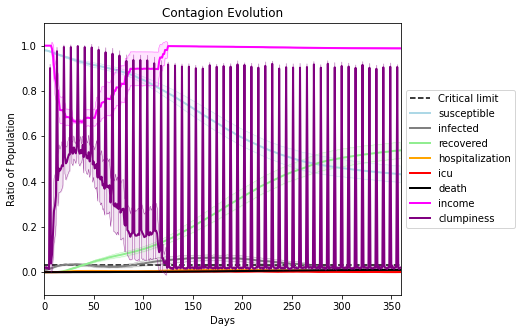

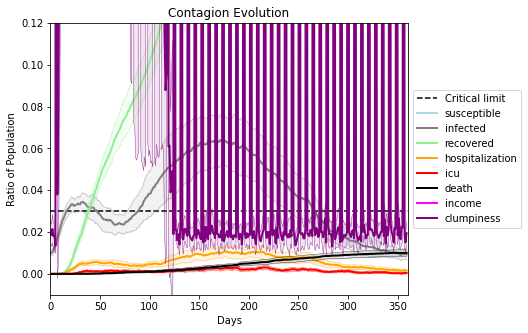

In [47]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 0.66
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[4531, 6881, 2697, 1842, 2850, 8323, 463, 9876, 9618, 3720, 3270, 7694, 5971, 4871, 4816, 6122, 9612, 3766, 6792, 1504]
Average similarity between family members is 0.012308290530805637 at temperature 1
Average similarity between family and home is 0.9998606553946359 at temperature -1
Average similarity between students and their classroom is 0.017224043568211455 at temperature 1
Average classroom occupancy is 4.180555555555555 and number classrooms is 72
Average similarity between workers is 0.01812140699210149 at temperature 1
Average office occupancy is 3.2311557788944723 and number offices is 199
Average friend similarity for adults: 0.08741479827180931 for kids: 0.08177859338261727
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homo

avg restaurant similarity 0.014209887328787574
avg restaurant similarity 0.032680445207333486
avg restaurant similarity 0.007078454688146255
avg restaurant similarity -0.02806190318109895
avg restaurant similarity -0.002496774939129348
avg restaurant similarity 0.018547483333122627
avg restaurant similarity 0.041810848177458226
avg restaurant similarity 0.03878995987271501
avg restaurant similarity 0.004175741540159016
avg restaurant similarity 0.011554995996741976
avg restaurant similarity 0.011767473541760798
avg restaurant similarity 0.005172107929112745
avg restaurant similarity 0.007745861654676958
avg restaurant similarity 0.0030141531449174946
avg restaurant similarity 0.004175069096954343
avg restaurant similarity 0.037545698293812546
avg restaurant similarity -0.019445359342367737
avg restaurant similarity 0.008985165744305608
avg restaurant similarity 0.04942170704396745
avg restaurant similarity 0.037098903046819495
avg restaurant similarity 0.024272309130965793
avg restaura

avg restaurant similarity -0.016756940410417854
avg restaurant similarity 0.01724753940715867
avg restaurant similarity -0.020873729674956425
avg restaurant similarity 0.028523406284655595
avg restaurant similarity 0.039358985831681355
avg restaurant similarity -0.020141368669948322
avg restaurant similarity 0.0018720606967442051
avg restaurant similarity 0.012443989181726747
avg restaurant similarity -0.017714688699216226
avg restaurant similarity -0.022712465019382077
avg restaurant similarity 0.011178956790017429
avg restaurant similarity -0.015223024263533143
avg restaurant similarity 0.03225827015611325
avg restaurant similarity -0.03074404888716598
avg restaurant similarity 0.047945266901595986
avg restaurant similarity 0.03529395537711002
avg restaurant similarity 0.04965005243029009
avg restaurant similarity -0.0062599044144873986
avg restaurant similarity -0.01007313113555662
avg restaurant similarity 0.03519838133151773
avg restaurant similarity 0.025881846350473938
avg resta

avg restaurant similarity 0.02929513235544172
avg restaurant similarity 0.017590857232922166
avg restaurant similarity -0.0019225488752240595
avg restaurant similarity 0.014407293314080017
avg restaurant similarity 0.01584501215979737
avg restaurant similarity -0.018203890661392344
avg restaurant similarity 0.002626664682151768
avg restaurant similarity -0.03836975515873672
avg restaurant similarity -0.025357604952662635
avg restaurant similarity -0.052260767649600866
avg restaurant similarity 0.004387901433503998
avg restaurant similarity -0.020003436611541126
avg restaurant similarity -0.019347259702927028
avg restaurant similarity 0.007588514147844096
avg restaurant similarity 0.0052059317773697775
avg restaurant similarity -0.04662077991543672
avg restaurant similarity 0.006527864916086398
avg restaurant similarity -0.008868944841410334
avg restaurant similarity -0.03153410333774005
avg restaurant similarity 0.006870375441845986
avg restaurant similarity -0.05082085337532889
avg re

avg restaurant similarity -0.02068696225523516
avg restaurant similarity -0.005497181192066829
avg restaurant similarity -0.0009022603637595303
avg restaurant similarity 0.022664933027040236
avg restaurant similarity -0.02013651997894834
avg restaurant similarity -0.007419795376004913
avg restaurant similarity -0.02598350420849866
avg restaurant similarity 0.004910719925402659
avg restaurant similarity -0.016241873430994928
avg restaurant similarity 0.0009466177047675618
avg restaurant similarity -0.013031655998014922
avg restaurant similarity -0.044079247467134035
avg restaurant similarity 0.0009425441489767346
avg restaurant similarity 0.005008854384970596
avg restaurant similarity -0.013471847830373515
avg restaurant similarity -0.02010357426341548
avg restaurant similarity 0.011007512552081693
avg restaurant similarity -0.03995728493266039
avg restaurant similarity -0.008154487012431572
avg restaurant similarity -0.0014838851334836361
avg restaurant similarity -0.02258474409980655


avg restaurant similarity 0.00860083770049999
avg restaurant similarity 0.02814687638125466
avg restaurant similarity -0.027729813384870405
avg restaurant similarity 0.029048532008472256
avg restaurant similarity -0.01399812876099958
avg restaurant similarity -0.0005139988084536451
avg restaurant similarity -0.02208656467527525
avg restaurant similarity -0.01904168885767906
avg restaurant similarity 0.00960554266389156
avg restaurant similarity 0.005679383763979564
avg restaurant similarity 0.00414809063363606
avg restaurant similarity -0.011069532976091612
avg restaurant similarity -0.005144923743344969
avg restaurant similarity 0.0073308645654338945
avg restaurant similarity -0.04351573038007108
avg restaurant similarity -0.014656847068228718
avg restaurant similarity 0.012384141601900482
avg restaurant similarity 0.032684476512765986
avg restaurant similarity 0.002140920750039445
avg restaurant similarity -0.004882981201614196
avg restaurant similarity -0.007171056218123718
avg rest

avg restaurant similarity 0.02054841603467052
avg restaurant similarity -0.0063556843951696786
avg restaurant similarity 0.005318785401984274
avg restaurant similarity -0.03565004128199915
avg restaurant similarity -0.01055210752604792
avg restaurant similarity 0.044779389554305
avg restaurant similarity -0.027297805094877916
avg restaurant similarity 0.029891562385805332
avg restaurant similarity -0.014623424184553455
avg restaurant similarity 0.025040398792466657
avg restaurant similarity 0.003623488823326648
avg restaurant similarity 0.01087734017434384
avg restaurant similarity -0.015914655877125598
avg restaurant similarity -0.03126010243652417
avg restaurant similarity -0.00403332597014829
avg restaurant similarity 0.018027898640217175
avg restaurant similarity 0.018516538424765167
avg restaurant similarity 0.004586032455576027
avg restaurant similarity 0.04340190016656014
avg restaurant similarity -0.0019931050524821213
avg restaurant similarity 0.003065222926590751
avg restaura

avg restaurant similarity 0.011241748431571994
avg restaurant similarity 0.021088896930461377
avg restaurant similarity 0.011535141450974541
avg restaurant similarity 0.054670287592009426
avg restaurant similarity -0.015606028711169262
avg restaurant similarity 0.011219435158907554
avg restaurant similarity -0.02298212618520401
avg restaurant similarity 0.024287579761321322
avg restaurant similarity -0.017543683884153366
avg restaurant similarity -0.01616497343754235
avg restaurant similarity -0.004447027211900487
avg restaurant similarity -0.01433030097097535
avg restaurant similarity -0.04616289007338926
avg restaurant similarity 1.0451369893629612e-05
avg restaurant similarity 0.000579787379471759
avg restaurant similarity 0.019315646845674862
avg restaurant similarity 0.019649082547565803
avg restaurant similarity 0.03766274831411029
avg restaurant similarity 0.019854665533119608
avg restaurant similarity -0.0032448553996494212
avg restaurant similarity -0.015888571928155824
avg re

avg restaurant similarity 0.004672757378177118
avg restaurant similarity 0.018719467385303563
avg restaurant similarity -0.0190737332653871
avg restaurant similarity -0.025004863088101723
avg restaurant similarity 0.022664776087101574
avg restaurant similarity -0.02260139592810078
avg restaurant similarity -0.001138715860363083
avg restaurant similarity 0.028343052143152695
avg restaurant similarity 0.015170053380693556
avg restaurant similarity 0.0043752909658709375
avg restaurant similarity 0.024413170455176013
avg restaurant similarity 0.02568584712623979
avg restaurant similarity 0.040742465942020335
avg restaurant similarity 0.01809284909157458
avg restaurant similarity 0.01870887374498963
avg restaurant similarity -0.003210628244425716
avg restaurant similarity 0.0022677244504509505
avg restaurant similarity -0.03335684173973806
avg restaurant similarity 0.05211691407424061
avg restaurant similarity -0.024560886845041544
avg restaurant similarity 0.027319149158703076
avg restaura

avg restaurant similarity 0.034810091406091925
avg restaurant similarity -0.026930608375797176
avg restaurant similarity 0.03738589229552397
avg restaurant similarity 0.009068349404432904
avg restaurant similarity 0.012089509861504687
avg restaurant similarity 0.00927831168989875
avg restaurant similarity 0.002218165067669498
avg restaurant similarity -0.030960029484745313
avg restaurant similarity 0.015478153878552153
avg restaurant similarity -0.011605214373597591
avg restaurant similarity 1.4445327843168713e-05
avg restaurant similarity -0.0038419395930658668
avg restaurant similarity -0.011675533505836704
avg restaurant similarity 0.03672782698097832
avg restaurant similarity 0.056071800573541004
avg restaurant similarity 0.01636168394951784
avg restaurant similarity -0.016463979112227505
avg restaurant similarity -0.012703428396687078
avg restaurant similarity 0.012854834727697467
avg restaurant similarity 0.014880899141424228
avg restaurant similarity 0.017495308831080185
avg res

avg restaurant similarity 0.030761418481528767
avg restaurant similarity 0.020056011633979194
avg restaurant similarity 0.030896803547450225
avg restaurant similarity 0.00705845410300349
avg restaurant similarity -0.014224572762423658
avg restaurant similarity 0.002167039948817099
avg restaurant similarity -0.02436078251780634
avg restaurant similarity 0.01443713949406533
avg restaurant similarity -0.013190888524057134
avg restaurant similarity -0.01182875561940228
avg restaurant similarity 0.018369755699150715
avg restaurant similarity 0.04393454984481297
avg restaurant similarity 0.0006790312192828014
avg restaurant similarity -0.0015767916976447487
avg restaurant similarity 0.006442913566524299
avg restaurant similarity 0.0012184658387140413
avg restaurant similarity 0.01648120343538581
avg restaurant similarity -0.04854826834406592
avg restaurant similarity -0.04734274714409093
avg restaurant similarity -0.011774613840688768
avg restaurant similarity -0.03544203198770749
avg restau

avg restaurant similarity 0.008705156299568974
avg restaurant similarity -0.0011660089569530932
avg restaurant similarity -0.034824280956178844
avg restaurant similarity 0.008845954702514721
avg restaurant similarity -0.018512193744712035
avg restaurant similarity 0.021393798179124564
avg restaurant similarity -0.0010438875758793226
avg restaurant similarity -0.007975486064110757
avg restaurant similarity 0.03514827488468394
avg restaurant similarity -0.004358405843816235
avg restaurant similarity -0.03738002905903222
avg restaurant similarity -0.01211218380039758
avg restaurant similarity -0.015913909370264764
avg restaurant similarity -0.029691821930521407
avg restaurant similarity 0.0024535776647012274
avg restaurant similarity -0.03030494570154902
avg restaurant similarity -0.017405424643775935
avg restaurant similarity -0.034405315040014456
avg restaurant similarity 0.03523132005412338
avg restaurant similarity 0.015613496168938241
avg restaurant similarity -0.06556134062029732
av

avg restaurant similarity -0.0301720333447242
avg restaurant similarity -0.05469973695162542
avg restaurant similarity -0.006929416357923711
avg restaurant similarity -0.017206831679212237
avg restaurant similarity -0.005394947468969581
avg restaurant similarity 0.015370168867346845
avg restaurant similarity 0.01772409836955726
avg restaurant similarity -0.05413226114540744
avg restaurant similarity -0.009453504372065677
avg restaurant similarity -0.010960516403340744
avg restaurant similarity -0.015452281367684402
avg restaurant similarity -0.014809608433761239
avg restaurant similarity 0.020858514987264657
avg restaurant similarity -0.036160392552249815
avg restaurant similarity 0.014447411070788561
avg restaurant similarity 0.02434855861454812
avg restaurant similarity -0.03505635374035163
avg restaurant similarity -0.02582278405643588
avg restaurant similarity 0.02310231852916962
avg restaurant similarity -0.001250874224544394
avg restaurant similarity 0.010855586030481335
avg rest

avg restaurant similarity 0.015520681413507731
avg restaurant similarity 0.013061459496384424
avg restaurant similarity 0.014950567213244304
avg restaurant similarity 0.047397426860310427
avg restaurant similarity 0.01970768824619704
avg restaurant similarity 0.05543533697623237
avg restaurant similarity -0.008298270711679394
avg restaurant similarity 0.0038532747232023603
avg restaurant similarity -0.0022499503977926175
avg restaurant similarity -0.01981155132584883
avg restaurant similarity 0.02837052065087068
avg restaurant similarity 0.013852662594561615
avg restaurant similarity -0.03319182058076408
avg restaurant similarity 0.04401887124906307
avg restaurant similarity 0.039327009807508376
avg restaurant similarity 0.02742221690474999
avg restaurant similarity 0.02023162522039674
avg restaurant similarity 0.0013988577163817628
avg restaurant similarity 0.03642947394577504
avg restaurant similarity -0.007941107705014498
avg restaurant similarity 0.03696144832088016
avg restaurant 

avg restaurant similarity 0.012029124389383947
avg restaurant similarity -0.014175687404622267
avg restaurant similarity 0.0019467594459719162
avg restaurant similarity 0.0217803843440524
avg restaurant similarity 0.02269519033015482
avg restaurant similarity 0.02051238454369635
avg restaurant similarity 0.02324372182636498
avg restaurant similarity 0.012669573276224597
avg restaurant similarity 0.0005895479640545914
avg restaurant similarity 0.046050318684193944
avg restaurant similarity 0.011867614408970282
avg restaurant similarity -0.002562462762636852
avg restaurant similarity 0.0015875472585788397
avg restaurant similarity -0.002469866391458336
avg restaurant similarity -0.0021243255007073634
avg restaurant similarity -0.02523700527698078
avg restaurant similarity -0.012435833417961369
avg restaurant similarity 0.041452842880872566
avg restaurant similarity -0.020150375500172946
avg restaurant similarity 0.0450936046812943
avg restaurant similarity -0.028754463369257972
avg resta

avg restaurant similarity -0.01503076812998227
avg restaurant similarity 0.05928428374571055
avg restaurant similarity -0.0345611283773659
avg restaurant similarity -0.0020427818996914837
avg restaurant similarity 0.016376638784776593
avg restaurant similarity 0.006236944324586916
avg restaurant similarity 0.0303137459472683
avg restaurant similarity 0.004428612504167294
avg restaurant similarity -0.019609147196308678
avg restaurant similarity -0.011691885195708586
avg restaurant similarity 0.009473875160862068
avg restaurant similarity -0.02028019134427356
avg restaurant similarity -0.008895693996217915
avg restaurant similarity 0.002749062963614352
avg restaurant similarity 0.02285013310197729
avg restaurant similarity -0.03639329959832117
avg restaurant similarity 0.005382486627447423
avg restaurant similarity 0.009416544267260503
avg restaurant similarity 0.016645794918343608
avg restaurant similarity -0.006712708046538257
avg restaurant similarity 0.03292382585503863
avg restauran

avg restaurant similarity -0.003629259665288138
avg restaurant similarity 0.02685761160624271
avg restaurant similarity -0.031503074579653984
avg restaurant similarity -0.002799304444714297
avg restaurant similarity -0.051051753546851826
avg restaurant similarity 0.006043215884975562
avg restaurant similarity 0.016351249789346586
avg restaurant similarity 0.02152878008387822
avg restaurant similarity -0.03627223846245809
avg restaurant similarity 0.004043016575643645
avg restaurant similarity 0.05664421242536637
avg restaurant similarity -0.0039784531235089
avg restaurant similarity -0.0007223618119519164
avg restaurant similarity -0.012764755214843323
avg restaurant similarity 0.007721407099677763
avg restaurant similarity -0.009738595043528359
avg restaurant similarity 0.0011754533153478866
avg restaurant similarity 0.02892637664247068
avg restaurant similarity -0.0013623616714045414
avg restaurant similarity 0.016557894769734578
avg restaurant similarity -0.03488125874945416
avg res

avg restaurant similarity -0.007353333132240953
avg restaurant similarity 0.02148186455797297
avg restaurant similarity 0.03772347711379092
avg restaurant similarity 0.04274732059894485
avg restaurant similarity 0.03809860828950042
avg restaurant similarity 0.06388501859511428
avg restaurant similarity 0.0917472450811677
avg restaurant similarity 0.03352574920064993
avg restaurant similarity 0.030256231347260968
avg restaurant similarity 0.0006294270073062396
avg restaurant similarity 0.03564544858745858
avg restaurant similarity 0.043900328896790644
avg restaurant similarity 0.05123097491834636
avg restaurant similarity 0.014943350678458535
avg restaurant similarity 0.023540877004150074
avg restaurant similarity 0.04118089432176777
avg restaurant similarity 0.036116777033781175
avg restaurant similarity 0.022880276339670644
avg restaurant similarity 0.017976285315084394
avg restaurant similarity 0.001756312134314317
avg restaurant similarity 0.05224950608814255
avg restaurant similari

avg restaurant similarity 0.00933715306237588
avg restaurant similarity 0.020329262013286758
avg restaurant similarity 0.05376390158802934
avg restaurant similarity 0.05200369514080729
avg restaurant similarity 0.016860164860914118
avg restaurant similarity 0.012303273655800862
avg restaurant similarity 0.03651281602069986
avg restaurant similarity -0.04416612884881747
avg restaurant similarity 0.0015494974301964001
avg restaurant similarity 0.010203180572974426
avg restaurant similarity 0.09175329927869648
avg restaurant similarity 0.05393747035867871
avg restaurant similarity 0.04747267151063833
avg restaurant similarity 0.03326769431065405
avg restaurant similarity 0.013687245560809537
avg restaurant similarity 0.005272924221429152
avg restaurant similarity 0.04761196391473928
avg restaurant similarity 0.04781117220113096
avg restaurant similarity 0.03536891877062557
avg restaurant similarity 0.047560064710648144
avg restaurant similarity 0.009504118208317888
avg restaurant similari

avg restaurant similarity 0.017158304565234518
avg restaurant similarity -0.009061802380436024
avg restaurant similarity 0.0008711133977091422
avg restaurant similarity 0.03838292655623631
avg restaurant similarity 0.08119701547538699
avg restaurant similarity 0.037207065006225136
avg restaurant similarity 0.01960645090886863
avg restaurant similarity -0.017829597892308886
avg restaurant similarity -0.008052226022689376
avg restaurant similarity 0.037364075252560115
avg restaurant similarity 0.05082916140841928
avg restaurant similarity 0.02745436842396769
avg restaurant similarity 0.0445293381748482
avg restaurant similarity 0.011791394162770712
avg restaurant similarity -0.007812375016014797
avg restaurant similarity -0.01764425025703879
avg restaurant similarity -0.04695397203645744
avg restaurant similarity 0.023458729510057407
avg restaurant similarity 0.02948956844863148
avg restaurant similarity -0.029362308519905175
avg restaurant similarity -0.003930230586052878
avg restaurant

avg restaurant similarity 0.014279482118022607
avg restaurant similarity -0.025507721946158114
avg restaurant similarity 0.025126453899736906
avg restaurant similarity -0.03168568154587153
avg restaurant similarity -0.02981994617954214
avg restaurant similarity -0.014552955958539717
avg restaurant similarity -0.015558906686515531
avg restaurant similarity 0.009415532473824609
avg restaurant similarity -0.001167181410902133
avg restaurant similarity 0.025225671661254983
avg restaurant similarity -0.045937217933704214
avg restaurant similarity 0.008973225735004527
avg restaurant similarity 0.017260121118660647
avg restaurant similarity 0.021176767608144208
avg restaurant similarity 0.05095931776661459
avg restaurant similarity 0.0032227784817752004
avg restaurant similarity 0.03296113018381751
avg restaurant similarity 0.037763431236209406
avg restaurant similarity -0.056135903045285866
avg restaurant similarity 0.004910513920683281
avg restaurant similarity -0.027623061989629157
avg res

avg restaurant similarity -0.013369067116271147
avg restaurant similarity -0.029072022814306465
avg restaurant similarity 0.02277274978753842
avg restaurant similarity -0.0031502523813309456
avg restaurant similarity 0.012546301795383243
avg restaurant similarity 0.013036257926130343
avg restaurant similarity -0.02044545362818782
avg restaurant similarity -0.017823403534584066
avg restaurant similarity -0.019775767103842327
avg restaurant similarity -0.02512908443243822
avg restaurant similarity 0.012070510825103187
avg restaurant similarity 0.0033918333261853738
avg restaurant similarity 0.03166135760096909
avg restaurant similarity -0.038194604902880534
avg restaurant similarity -0.03588906101833384
avg restaurant similarity -0.01292933129855449
avg restaurant similarity 0.019894240083759507
avg restaurant similarity 0.03033874721942381
avg restaurant similarity 0.0012330552689445635
avg restaurant similarity -0.024884470787423275
avg restaurant similarity 0.03475311382966126
avg res

avg restaurant similarity -0.026108659002901075
avg restaurant similarity -0.00424073714544749
avg restaurant similarity 0.0020807324546591793
avg restaurant similarity 0.012055316264529744
avg restaurant similarity -0.03376613935915007
avg restaurant similarity -0.010438460986763142
avg restaurant similarity -0.00913931320391682
avg restaurant similarity -0.013184478424135792
avg restaurant similarity 0.003848530312722342
avg restaurant similarity -0.011356642029545307
avg restaurant similarity 0.0069796929939820425
avg restaurant similarity -0.012252832668737758
avg restaurant similarity 0.019165956176007068
avg restaurant similarity -0.013287003458945462
avg restaurant similarity 0.0019043439291088896
avg restaurant similarity 0.04466720647710047
avg restaurant similarity 0.0016055389052080794
avg restaurant similarity -0.003136556401603063
avg restaurant similarity 0.03790760978218901
avg restaurant similarity -0.03339372932192641
avg restaurant similarity 0.0022968231442086103
avg

avg restaurant similarity -0.011453940238872687
avg restaurant similarity 0.015114372926782107
avg restaurant similarity -0.0026555245255995862
avg restaurant similarity -0.004360531646102425
avg restaurant similarity 0.0275114688531491
avg restaurant similarity 0.02975658094866991
avg restaurant similarity 0.016416348941528464
avg restaurant similarity 0.04085281536593072
avg restaurant similarity 0.016210506876243033
avg restaurant similarity 0.048411826921230645
avg restaurant similarity -0.003291922592890297
avg restaurant similarity -0.012789591232061833
avg restaurant similarity -0.017877957688345734
avg restaurant similarity 0.06238450754531142
avg restaurant similarity 0.023948642790029333
avg restaurant similarity 0.009309322837064735
avg restaurant similarity 0.030395629250888415
avg restaurant similarity -0.005987353411837531
avg restaurant similarity -0.02144301697131306
avg restaurant similarity 0.04822352742903689
avg restaurant similarity 0.019081270268185523
avg restaur

avg restaurant similarity -0.006800179462825667
avg restaurant similarity 0.013295382348309985
avg restaurant similarity 0.03438901202912973
avg restaurant similarity -0.012211306067384542
avg restaurant similarity 0.04024196409933395
avg restaurant similarity 0.012563007714102395
avg restaurant similarity 0.012556993014593272
avg restaurant similarity 0.018444677502954553
avg restaurant similarity -0.014713695649261236
avg restaurant similarity 0.025905735813289407
avg restaurant similarity 0.040681590610036414
avg restaurant similarity -0.02929186488879984
avg restaurant similarity 0.03685577405449848
avg restaurant similarity -0.013724630389611095
avg restaurant similarity 0.008361650173512062
avg restaurant similarity 0.009161550443652529
avg restaurant similarity 0.01820372922944808
avg restaurant similarity 0.01885690475318905
avg restaurant similarity 0.0038965950296931764
avg restaurant similarity 0.005194332767628573
avg restaurant similarity 0.04535200653804376
avg restaurant

avg restaurant similarity 0.06350781501935564
avg restaurant similarity 0.010352464734605427
avg restaurant similarity 0.013195212065418566
avg restaurant similarity 0.00646851613840137
avg restaurant similarity 0.09013696239020079
avg restaurant similarity 0.043987183764916976
avg restaurant similarity 0.03865724158917375
avg restaurant similarity 0.04267557486645485
avg restaurant similarity -0.03240624812379379
avg restaurant similarity 0.037336887529500394
avg restaurant similarity 0.040808563525734996
avg restaurant similarity 0.03305150098425525
avg restaurant similarity 0.039065955495229565
avg restaurant similarity 0.05308322642500179
avg restaurant similarity 0.022003858353296393
avg restaurant similarity 0.001604978123051084
avg restaurant similarity -0.00584726060195731
avg restaurant similarity 0.04959500237220321
avg restaurant similarity -0.012786776489973967
avg restaurant similarity 0.006919043703392963
avg restaurant similarity 0.05379766969996452
avg restaurant simila

avg restaurant similarity 0.017590908349924786
avg restaurant similarity 0.03552585800229283
avg restaurant similarity 0.008669856223368804
avg restaurant similarity 0.024222453059195983
avg restaurant similarity 0.020198571959912752
avg restaurant similarity 0.00111137325612403
avg restaurant similarity -0.02033006080941974
avg restaurant similarity 0.023830497233949526
avg restaurant similarity 0.020817836770664153
avg restaurant similarity 0.022631285942645008
avg restaurant similarity 0.051934249887878474
avg restaurant similarity 0.04855164407838234
avg restaurant similarity 0.016994566858683963
avg restaurant similarity 0.007979536447386847
avg restaurant similarity 0.03401740539851387
avg restaurant similarity -0.010140770625243746
avg restaurant similarity 0.07779740312453903
avg restaurant similarity -0.0028832269861591847
avg restaurant similarity 0.029659478882211356
avg restaurant similarity 0.05020151444557102
avg restaurant similarity 0.0031199834800481265
avg restaurant 

avg restaurant similarity -0.006927942475908839
avg restaurant similarity 0.02600188424431994
avg restaurant similarity 0.004223063344450136
avg restaurant similarity 0.08088648417161126
avg restaurant similarity -0.032646480731949694
avg restaurant similarity 0.00017637751315048897
avg restaurant similarity -0.012729310558351891
avg restaurant similarity -0.034277515018421884
avg restaurant similarity -0.01758160042735222
avg restaurant similarity -0.022932710392433588
avg restaurant similarity -0.008649454191371848
avg restaurant similarity 0.014787322420403176
avg restaurant similarity 0.02708863906091587
avg restaurant similarity -0.023672666963453173
avg restaurant similarity 0.018278959863050188
avg restaurant similarity -0.005454500449559217
avg restaurant similarity 0.008056007902753813
avg restaurant similarity -0.013000603591944849
avg restaurant similarity -0.01104669332094523
avg restaurant similarity -0.0029267647577616513
avg restaurant similarity -0.0284517722385003
avg 

avg restaurant similarity 0.028636455705781133
avg restaurant similarity -0.01717593371096752
avg restaurant similarity -0.03650122872569373
avg restaurant similarity -0.020535893701712122
avg restaurant similarity 0.004132467078106302
avg restaurant similarity -0.014126923675975374
avg restaurant similarity -0.0012110911676689012
avg restaurant similarity 0.038282652485507045
avg restaurant similarity 2.6126872001293527e-05
avg restaurant similarity -0.014844358076360684
avg restaurant similarity -0.005094835419290192
avg restaurant similarity -0.024823358147988177
avg restaurant similarity -0.02494945848000738
avg restaurant similarity 0.00101267440542555
avg restaurant similarity -0.036882896303656154
avg restaurant similarity -0.01118121102292545
avg restaurant similarity 0.04107065060612044
avg restaurant similarity -0.03993483554528286
avg restaurant similarity 0.011134954931627947
avg restaurant similarity -0.04340312207870555
avg restaurant similarity -0.03424171197060757
avg r

avg restaurant similarity -0.015796824715484683
avg restaurant similarity -0.007505641790083835
avg restaurant similarity -0.017730339883238237
avg restaurant similarity 0.005114135892923092
avg restaurant similarity 0.0053415000971565275
avg restaurant similarity 0.0192309950142053
avg restaurant similarity 0.024606621440066145
avg restaurant similarity -0.028135990288428083
avg restaurant similarity 0.0292358472712555
avg restaurant similarity -0.0039710883416206695
avg restaurant similarity -0.010360654087730275
avg restaurant similarity -0.03139960793525032
avg restaurant similarity 0.01930455123185655
avg restaurant similarity -0.0378574054658055
avg restaurant similarity -0.0038652215950731733
avg restaurant similarity 0.017964545015706452
avg restaurant similarity 0.0022884021050203086
avg restaurant similarity -0.007558953020416455
avg restaurant similarity 0.006470682123759665
avg restaurant similarity -0.01788005834496754
avg restaurant similarity 0.0003994834612458839
avg re

avg restaurant similarity -0.025585210390494946
avg restaurant similarity 0.02739447059947074
avg restaurant similarity -0.005787482486491775
avg restaurant similarity -0.02276180080220523
avg restaurant similarity 0.032826085253424384
avg restaurant similarity -0.028116329029076955
avg restaurant similarity -0.008811844087059846
avg restaurant similarity 0.002483203252845414
avg restaurant similarity -0.01353920606343118
avg restaurant similarity -0.004314158842772061
avg restaurant similarity -0.033407038338693566
avg restaurant similarity 0.020927192377316734
avg restaurant similarity -0.008825684137989218
avg restaurant similarity 0.045736286827198776
avg restaurant similarity -0.02079491875892087
avg restaurant similarity -0.02561253002600959
avg restaurant similarity -0.020387214727088366
avg restaurant similarity 0.028018763021198198
avg restaurant similarity -0.009280264747541764
avg restaurant similarity 0.0037735897840680713
avg restaurant similarity 0.030239942324315826
avg 

avg restaurant similarity 0.0379739618979057
avg restaurant similarity 0.001282389954476726
avg restaurant similarity -0.0036964349423009774
avg restaurant similarity 0.036062315100715586
avg restaurant similarity -0.007600344814030983
avg restaurant similarity 0.022676167932168624
avg restaurant similarity 0.01129335213561623
avg restaurant similarity -0.0414665915136223
avg restaurant similarity 0.02282086414644552
avg restaurant similarity -0.0024338372329457255
avg restaurant similarity 0.0016535748943828238
avg restaurant similarity -0.01431337524037803
avg restaurant similarity 0.0424905953219376
avg restaurant similarity 0.0018608091078669477
avg restaurant similarity 0.03862315303551795
avg restaurant similarity 0.003959345783203835
avg restaurant similarity -0.02427486393883491
avg restaurant similarity -0.014166043791186385
avg restaurant similarity 0.0049590713445922955
avg restaurant similarity 0.02864317480294491
avg restaurant similarity 0.008637590389410574
avg restauran

avg restaurant similarity -0.005313511722389899
avg restaurant similarity 0.030437452756998145
avg restaurant similarity 0.06023898014079302
avg restaurant similarity 0.00240939426608333
avg restaurant similarity 0.011576200165780873
avg restaurant similarity -0.02343856000932617
avg restaurant similarity 0.04296458581647522
avg restaurant similarity 0.012511825868032398
avg restaurant similarity 0.02348719529855114
avg restaurant similarity -0.001795739042228654
avg restaurant similarity 0.02092015624364682
avg restaurant similarity 0.047025927478602035
avg restaurant similarity 0.06930032165018372
avg restaurant similarity 0.047406944539285435
avg restaurant similarity -0.005434841106555063
avg restaurant similarity -0.0173164270339099
avg restaurant similarity 0.04771892667885878
avg restaurant similarity 0.048549527191828895
avg restaurant similarity 0.007504732008099894
avg restaurant similarity 0.05317563552913951
avg restaurant similarity 0.03385152248145941
avg restaurant simil

avg restaurant similarity 0.02898980046559998
avg restaurant similarity -0.019318413429195203
avg restaurant similarity 0.013243311133134998
avg restaurant similarity 0.04457445987141523
avg restaurant similarity -0.03448261347038681
avg restaurant similarity 0.024189923857823793
avg restaurant similarity 0.05188744370353574
avg restaurant similarity 0.02641176586825632
avg restaurant similarity 0.01164938195926024
avg restaurant similarity -0.02554574594801533
avg restaurant similarity -0.031158438936957883
avg restaurant similarity 0.016240360853357325
avg restaurant similarity -0.00622736902781505
avg restaurant similarity -0.022842528198342173
avg restaurant similarity -0.018687756715960003
avg restaurant similarity -0.04332688747210154
avg restaurant similarity -0.009160870341644735
avg restaurant similarity 0.01882193342107266
avg restaurant similarity -0.03224938819332751
avg restaurant similarity -0.023317027915279082
avg restaurant similarity -0.023256663175972435
avg restaura

avg restaurant similarity 5.7894082730954384e-06
avg restaurant similarity -0.04585804249781814
avg restaurant similarity 0.0007725442748505365
avg restaurant similarity -0.01161035746113139
avg restaurant similarity -0.008729621006877025
avg restaurant similarity -0.03386709622640354
avg restaurant similarity -0.019193148408965893
avg restaurant similarity -0.012367055390935288
avg restaurant similarity 0.032137330616190264
avg restaurant similarity 0.07189160383699393
avg restaurant similarity 0.036305261097098515
avg restaurant similarity 0.053153338819461084
avg restaurant similarity -0.007110045456470454
avg restaurant similarity 0.010434029400709794
avg restaurant similarity 0.00661713184945913
avg restaurant similarity -0.015137214409775097
avg restaurant similarity 0.0033961203426801814
avg restaurant similarity 0.01824227421580056
avg restaurant similarity 0.021011068964055996
avg restaurant similarity 0.032377792185537296
avg restaurant similarity 0.04059302983132405
avg rest

avg restaurant similarity 0.009751338893182976
avg restaurant similarity 0.029231862277516302
avg restaurant similarity -0.029602913831458237
avg restaurant similarity 0.02966814537421313
avg restaurant similarity 0.01426899703071634
avg restaurant similarity 0.028819007392758788
avg restaurant similarity 0.0437721051300653
avg restaurant similarity 0.00045215673701215703
avg restaurant similarity -0.008837804584579041
avg restaurant similarity 0.048487408332199826
avg restaurant similarity 0.0660136133853704
avg restaurant similarity 0.04961177728271906
avg restaurant similarity 0.02834637396559515
avg restaurant similarity 0.06253465278922392
avg restaurant similarity -0.012612133573078646
avg restaurant similarity 0.026224886725128068
avg restaurant similarity 0.03463388149844706
avg restaurant similarity 0.024938305070954746
avg restaurant similarity 0.030959460441531764
avg restaurant similarity 0.029695326036624024
avg restaurant similarity 0.044739559052606945
avg restaurant sim

avg restaurant similarity 0.03451346830161042
avg restaurant similarity 0.0372722865030826
avg restaurant similarity 0.01579521149211596
avg restaurant similarity 0.03377182184150865
avg restaurant similarity 0.0010357659541616784
avg restaurant similarity 0.04298540159747984
avg restaurant similarity 0.023456165764210425
avg restaurant similarity 0.03982393851801686
avg restaurant similarity 0.03562828662999596
avg restaurant similarity 0.013608169983406214
avg restaurant similarity 0.033085406247744
avg restaurant similarity 0.056111008289440774
avg restaurant similarity 0.035590002903574385
avg restaurant similarity 7.830447321738382e-05
avg restaurant similarity 0.05050738606720373
avg restaurant similarity 0.010243398148037184
avg restaurant similarity 0.024659040578399856
avg restaurant similarity 0.015160428232521641
avg restaurant similarity -0.01175051110273405
avg restaurant similarity 0.005809598533269181
avg restaurant similarity 0.0360985190087004
avg restaurant similarity

avg restaurant similarity -0.013517592205659158
avg restaurant similarity 0.00017187302804416103
avg restaurant similarity -0.036965802591336
avg restaurant similarity -0.0060408419450697715
avg restaurant similarity -0.014456492352695124
avg restaurant similarity -0.03711491763557929
avg restaurant similarity -0.011189519944775642
avg restaurant similarity 6.169096029859519e-06
avg restaurant similarity 0.009865651139684028
avg restaurant similarity -0.053084303280540944
avg restaurant similarity -0.03811218966675985
avg restaurant similarity -0.0011708326866312375
avg restaurant similarity -0.0012535635844801343
avg restaurant similarity 0.050137810355737486
avg restaurant similarity -0.028794962316000153
avg restaurant similarity 0.04253014322748632
avg restaurant similarity -0.037408987343517094
avg restaurant similarity 0.006410655312671096
avg restaurant similarity -0.048053583995060996
avg restaurant similarity -0.013149693056456057
avg restaurant similarity 0.024974449959256243

avg restaurant similarity -0.024403548460870995
avg restaurant similarity 0.0022954800507124598
avg restaurant similarity 0.0188112398626596
avg restaurant similarity -0.015182105494228163
avg restaurant similarity 0.009449970040422308
avg restaurant similarity -0.017109337154014772
avg restaurant similarity -0.033290577171619914
avg restaurant similarity -0.009647881856243533
avg restaurant similarity -0.008036554606758263
avg restaurant similarity -0.00036022120179574134
avg restaurant similarity 0.02833409161061606
avg restaurant similarity -0.035455739849697146
avg restaurant similarity -0.02780815629644954
avg restaurant similarity -0.022876008897100005
avg restaurant similarity 0.014954463911610366
avg restaurant similarity 0.008328205497159298
avg restaurant similarity 0.03207158164273792
avg restaurant similarity 0.0038185655685876525
avg restaurant similarity -0.033271999398629674
avg restaurant similarity -0.0350937461846693
avg restaurant similarity -0.011690649388880512
avg

avg restaurant similarity -0.012835142411617165
avg restaurant similarity -0.05405402760297864
avg restaurant similarity 0.02103649044923592
avg restaurant similarity -0.0027665992871526556
avg restaurant similarity -0.031222796790806542
avg restaurant similarity -0.03674697408653704
avg restaurant similarity -0.016943663786749927
avg restaurant similarity -0.06778274500308896
avg restaurant similarity -0.06697777557985309
avg restaurant similarity -0.028052356754867835
avg restaurant similarity 0.040997402817059846
avg restaurant similarity -0.006011171518059113
avg restaurant similarity -0.016103411759036155
avg restaurant similarity -0.018438219018685514
avg restaurant similarity 0.013065616822703548
avg restaurant similarity -0.012423758898701995
avg restaurant similarity -0.028904812195908226
avg restaurant similarity 0.0055755546876626715
avg restaurant similarity 0.04047801616930496
avg restaurant similarity 0.0205729745938342
avg restaurant similarity -0.038326904174910206
avg 

avg restaurant similarity 0.06531957404668416
avg restaurant similarity -0.05613360358696373
avg restaurant similarity -0.009881251998763219
avg restaurant similarity -0.023314897589139336
avg restaurant similarity 0.05327458619388647
avg restaurant similarity -0.007796202644430152
avg restaurant similarity 0.02960407050417096
avg restaurant similarity -0.04520507542296359
avg restaurant similarity 0.014145488646056375
avg restaurant similarity 0.06136626213799857
avg restaurant similarity -0.01887835232235511
avg restaurant similarity -0.00993591595648215
avg restaurant similarity -0.013814778655062252
avg restaurant similarity 0.010307690908424299
avg restaurant similarity -0.007429235366854409
avg restaurant similarity 0.011466348461878677
avg restaurant similarity -0.049909540148887224
avg restaurant similarity 0.039610989967263706
avg restaurant similarity -0.048087866068882275
avg restaurant similarity -0.003291932293242922
avg restaurant similarity 0.033377483638846635
avg resta

(<function dict.items>, <function dict.items>, <function dict.items>)

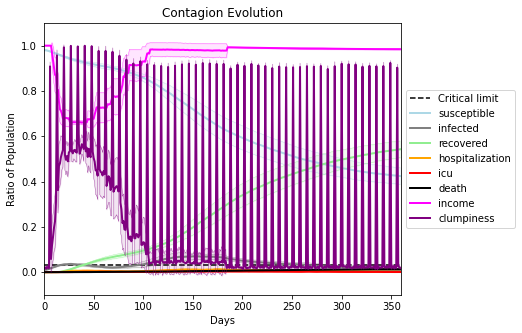

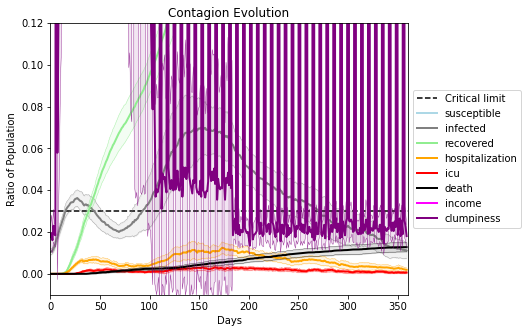

In [48]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 1
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)